### RNN with LSTM cell
* Architecture reference from https://arxiv.org/pdf/2004.00959.pdf
* Country-specific network (with only non-zero data)

(Something new: Maybe decrease number of classifier by grouping countries in the same GDP/ bracket)

#### Data partition
* Test data is the last 10 days
* Validation 10 days before last 10 days
* Data logged
* Noise added is smaller compared to Offline-3
* Also optimize momentum of SGD
* Some countries kicked out for having too many zeros
* Version 5 learns the difference! Instead of the data itself
* Version 6 is the same as 5 but lite (in case it doesn't finish training)
* Version 7 is copy of 6 (but with logged data (after clear 0)
* As well, a ReLu is added 
* v8 does not use log

#### What to change between different versions
* offlinex directory name (network output)
* graph directory
* output json file
* line by line progress track country file

In [1]:
import torch
import pandas as pd
import numpy as np
import os
import copy
#import writer
import random
from sklearn.preprocessing import normalize
import seaborn as sns
import matplotlib.pyplot as plt
#import 
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Assuming that we are on a CUDA machine, this should print a CUDA device:

print(device)

cuda:0


In [2]:
# read data in
csse_country = "CPSC540_Covid/active_data/csse_world_normalized.csv"
df_csse = pd.read_csv(csse_country)
df_csse.head(10)
#list(df_csse.columns.values.tolist()) 
countries = df_csse["Country/Region"].tolist()

In [3]:
countries
df_csse.shape

(172, 86)

#### What if use grouping from k-means? or hierarchical clustering to decide which countries are in the same bracket


In [4]:
validation_d = 5
test_d = 5

# Convert to numpy array

cases = df_csse.loc[:,'1/22/20':]
casesA = cases.to_numpy()
casesA
count, days = casesA.shape

print(days)
# last 10 days for test

case_test = casesA[:,-test_d:]
case_validation = casesA[:,days-validation_d-test_d:days-test_d]
case_train = casesA[:,:days-validation_d-test_d]

print(case_test.shape)
print(case_validation.shape)
print(case_train.shape)

84
(172, 5)
(172, 5)
(172, 74)


In [5]:
def find_zero(lst):
    numzero = 0
    for i in lst:
        if i ==0:
            numzero += 1
    return(numzero)

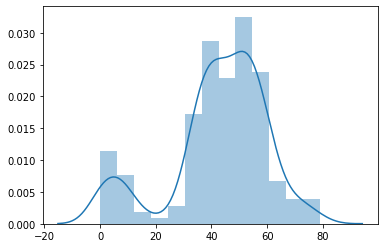

In [6]:
# graph number of days zero
cutoff = 25 # at most = 0
lstzero = []
skip_countries = []
for i in range(len(countries)):
    numz = find_zero(casesA[i,:].tolist())
    lstzero.append(numz)
    if numz > cutoff:
        skip_countries.append(i)

sns.distplot(np.array(lstzero));

In [7]:
len(skip_countries)

149

From the distribution, 30 seems a reasonable cutoff (most countries still present)

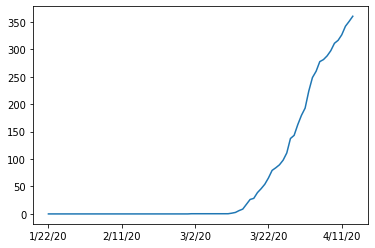

In [8]:
# plot 
#epoch = np.linspace(1, len(trainErr), len(trainErr))

cases.loc[50,:].plot.line()


In [9]:
case_train

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        2.52296317e-01, 2.52296317e-01, 2.52296317e-01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        4.04858300e+01, 4.95951417e+01, 5.06072874e+01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        6.20342147e+00, 6.20342147e+00, 8.17723739e+00],
       ...,
       [3.02112385e-03, 3.02112385e-03, 6.04224770e-03, ...,
        7.36435192e+02, 8.32579437e+02, 9.33083164e+02],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.91862032e+05, 1.91862032e+05, 1.91862032e+05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        4.39667807e+03, 4.39667807e+03, 4.39667807e+03]])

In [10]:
# log transform
case_test_log = np.log(case_test)
case_validation_log = np.log(case_validation)
case_train_log = np.log(case_train)
case_train_log

/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log
  after removing the cwd from sys.path.


array([[       -inf,        -inf,        -inf, ..., -1.37715102,
        -1.37715102, -1.37715102],
       [       -inf,        -inf,        -inf, ...,  3.70095204,
         3.90389288,  3.92409559],
       [       -inf,        -inf,        -inf, ...,  1.82510099,
         1.82510099,  2.10135437],
       ...,
       [-5.80212638, -5.80212638, -5.1089792 , ...,  6.60182124,
         6.72452864,  6.83849433],
       [       -inf,        -inf,        -inf, ..., 12.16453181,
        12.16453181, 12.16453181],
       [       -inf,        -inf,        -inf, ...,  8.38860455,
         8.38860455,  8.38860455]])

### Divide data into training sets
* specify number of days for train and prediction
* offset the dataset so for example: [1,2,3,4] then get [1,2],[2,3] which predicts 3 and 4 respectively

In [11]:
# test 
np.array(case_train[3,:])
#total_days-pred_days-t_days
case_train[3,5:8]

array([0., 0., 0.])

In [12]:
def clear_zero(nparray):
    # return the np array that contains only 1 0:
    lst = nparray.tolist()
    #print(len(lst))
    ind = 0
    splitInd = 0
    while(lst[ind]==0):
        splitInd += 1
        ind += 1
    #print(splitInd)
    return(np.array(lst[splitInd:]))

In [13]:
clear_zero(case_train[169,:]).shape[0]

74

In [14]:
def get_diff(arr):
    lst = arr.tolist()
    difflst = []
    for i in range(len(lst)):
        if i == 0:
            continue
        # start
        difflst.append(lst[i]-lst[i-1])
    return(np.array(difflst))

In [15]:
t_days = 25 # number of days used to test 
pred_days = test_d
total_days = case_train.shape[1]

country_train_X = []
country_train_Y = []

country_valid_X = []
country_valid_Y = []

country_test_X = []
country_test_Y = []

diffData = []
for i in range(len(countries)):
    print(countries[i] + " "+ str(i))
    
    if i in skip_countries:
        country_train_X.append(0)
        country_train_Y.append(0)

        country_valid_X.append(0)
        country_valid_Y.append(0)

        country_test_X.append(0)
        country_test_Y.append(0)
        diffData.append(0)
        continue # too little data 
        
    # split dataset
    cur_c = [] # current country 
    out = []
    
    cur_v = [] # current country 
    out_v = []
    
    cur_t = [] # current country 
    out_t = []
    
    newcase1 = clear_zero(case_train[i,:])
    #newcase = np.log(get_diff(newcase1)+1)
    newcase = get_diff(newcase1)
    total_days = newcase.shape[0]
    diffData.append(newcase)
    print(total_days)
    for j in range(total_days-pred_days*2-t_days): 
        
        #print(j)
        #print(case_train[i,j:j+t_days].shape)
        #print(len(case_train[i,j+t_days]))
        cur_c.append(newcase[j:j+t_days])
        #print(str(j))
        out.append(newcase[j+t_days:j+t_days+pred_days])
        #print(len(cur_c))
    
    country_train_X.append(cur_c)
    country_train_Y.append(out)
    
    country_valid_X.append(newcase[total_days-t_days-test_d*2:total_days-test_d*2])
    print(newcase[total_days-t_days-test_d*2:total_days-test_d*2].shape)
    country_valid_Y.append(newcase[total_days-test_d*2:total_days-test_d])
    print(newcase[total_days-test_d*2:total_days-test_d].shape)
    
    country_test_X.append(newcase[total_days-test_d-t_days:total_days-test_d])
    country_test_Y.append(newcase[total_days-test_d:])
    
    # the best way to check this
    #testlist = 


Burundi 0
Djibouti 1
Eritrea 2
Ethiopia 3
Kenya 4
Madagascar 5
Malawi 6
Mauritius 7
Mozambique 8
Rwanda 9
Seychelles 10
Somalia 11
South Sudan 12
Uganda 13
Tanzania 14
Zambia 15
Zimbabwe 16
Angola 17
Cameroon 18
Central African Republic 19
Chad 20
Equatorial Guinea 21
Gabon 22
Sao Tome and Principe 23
Botswana 24
Eswatini 25
Namibia 26
South Africa 27
Benin 28
Burkina Faso 29
Cabo Verde 30
Gambia 31
Ghana 32
Guinea 33
Guinea-Bissau 34
Liberia 35
Mali 36
Mauritania 37
Niger 38
Nigeria 39
Senegal 40
Sierra Leone 41
Togo 42
Algeria 43
Egypt 44
50
(25,)
(5,)
Libya 45
Morocco 46
Sudan 47
Tunisia 48
Western Sahara 49
Armenia 50
Azerbaijan 51
Bahrain 52
Cyprus 53
Georgia 54
Iraq 55
Israel 56
Jordan 57
Kuwait 58
Lebanon 59
Oman 60
Qatar 61
Saudi Arabia 62
Syria 63
Turkey 64
United Arab Emirates 65
66
(25,)
(5,)
Yemen 66
Kazakhstan 67
Kyrgyzstan 68
Uzbekistan 69
Afghanistan 70
Bangladesh 71
Bhutan 72
India 73
65
(25,)
(5,)
Iran 74
Maldives 75
Nepal 76
70
(25,)
(5,)
Pakistan 77
Sri Lanka 78
68
(

In [16]:
country_train_X[88][0].shape
country_train_X[81][0].shape

(25,)

In [17]:

diffData[81]

array([0.        , 0.        , 0.        , 0.01581322, 0.        ,
       0.02371983, 0.        , 0.03162644, 0.03162644, 0.03953305,
       0.        , 0.        , 0.01581322, 0.        , 0.        ,
       0.02371983, 0.        , 0.00790661, 0.        , 0.        ,
       0.01581322, 0.        , 0.00790661, 0.11069254, 0.12650575,
       0.05534627, 0.06325288, 0.0790661 , 0.0790661 , 0.08697271,
       0.13441236, 0.19766524, 0.09487932, 0.08697271, 0.15022558,
       0.19766524, 0.11069254, 0.10278593, 0.11859914, 0.14231897,
       0.15022558, 0.30045117, 0.22929168, 0.47439658, 0.324171  ,
       0.324171  , 0.07115949, 0.55346268, 0.45858336, 0.        ,
       0.4902098 , 0.5692759 , 0.52183624, 0.        , 0.30835778,
       0.08697271, 0.27673134, 0.30835778, 0.34789082, 0.74322131,
       0.21347846, 0.51392963, 0.9013535 , 0.63252877, 0.64043538,
       1.77898717, 1.36784347, 0.        , 0.68787504, 1.77898717,
       2.50639526, 0.96460638, 4.12725024])

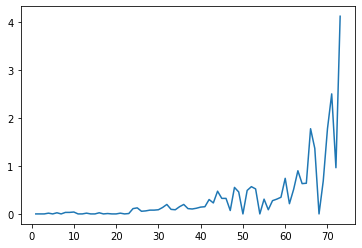

In [18]:
import matplotlib.pyplot as plt
x = np.linspace(1, len(diffData[81].tolist()), len(diffData[81].tolist()))
plt.plot(x, diffData[81])
plt.show()

In [19]:
len(country_train_X)

172

In [20]:
# check dimension

#len(country_test_X[33])
total_days-pred_days-test_d
pred_days
test_d
total_days
case_train[0,29:64].shape
case_train[0,0:40].shape

(40,)

#### Data size & index
The first axis is the sequence itself, the second indexes instances in the mini-batch, and the third indexes elements of the input. We haven’t discussed mini-batching, so lets just ignore that and assume we will always have just 1 dimension on the second axis.

In [21]:
#import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

torch.manual_seed(1)

### Optimized hyperparameters
|Parameter |Description|Distribution/Selection|Values|
|----------|------------|----------------------|---------|
|Learning rate|Minimum learning rate| Discrete|1e-1 to 1e-7|
|Hidden layers|Number of layers in the network|Discrete numeric|1 to 5|
|Hidden state|Number of memory cell in each layer|Discrete numeric|1 to 200|
|Momentum|SGD optimizer parameter for overshoot direction|Discrete numeric|0.1 to 0.9|

In [22]:
# Parameter
num_epochs = 50 # max
batch_size = 1
# Loss and optimizer
criterion = torch.nn.MSELoss()
#optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
learning_rate = 0.01 # to be changed/optimized 
#optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
output_directory = "mock/"
output_file_path = "mock/Train"
input_dim = t_days
hidden_dim = 2
hidden_state = 100
output_dim= pred_days
num_layers=2
lstm_input_size = t_days
#model = LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)

model_name = "mock"
output_file_path = "./outputs/" + model_name + "/training/"
directory = os.path.dirname(output_file_path)
if not os.path.exists(directory):
    print("Creating directory %s" % output_file_path)
    os.makedirs(directory)
else:
     print("Directory %s exists" % output_file_path)


Directory ./outputs/mock/training/ exists


In [23]:
# RNN structure

class RNN(nn.Module):

    # you can also accept arguments in your model constructor
    def __init__(self, data_size, hidden_size, output_size):
        super(RNN, self).__init__()

        self.hidden_size = hidden_size
        input_size = data_size + hidden_size

        self.i2h = nn.Linear(input_size, hidden_size)
        self.h2o = nn.Linear(hidden_size, output_size)

    def forward(self, data, last_hidden):
        input = torch.cat((data, last_hidden), 1)
        hidden = self.i2h(input)
        output = self.h2o(hidden)
        return hidden, output
    
    def initHidden(self):
        return torch.zeros(1, self.hidden_size)


In [24]:
# LSTM structure

class LSTM(nn.Module):
 
    def __init__(self, input_dim, hidden_dim, batch_size, output_dim=pred_days,
                    num_layers=2):
        super(LSTM, self).__init__()
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.batch_size = batch_size
        self.num_layers = num_layers
 
        # Define the LSTM layer
        self.lstm = nn.LSTM(self.input_dim, self.hidden_dim, self.num_layers,dropout=0)
 
        # Define the output layer
        self.linear = nn.Linear(self.hidden_dim, output_dim)
 
    def init_hidden(self):
        # This is what we'll initialise our hidden state as
        return (torch.zeros(self.num_layers, self.batch_size, self.hidden_dim),
                torch.zeros(self.num_layers, self.batch_size, self.hidden_dim))
 
    def forward(self, input):
        # Forward pass through LSTM layer
        # shape of lstm_out: [input_size, batch_size, hidden_dim]
        # shape of self.hidden: (a, b), where a and b both 
        # have shape (num_layers, batch_size, hidden_dim).
        lstm_out, self.hidden = self.lstm(input.view(len(input), self.batch_size, -1))
        
        # Only take the output from the final timetep
        # Can pass on the entirety of lstm_out to the next layer if it is a seq2seq prediction
        y_pred = F.relu(self.linear(lstm_out[-1].view(self.batch_size, -1)))
        
        return y_pred.view(-1)

#model = LSTM(lstm_input_size, h1, batch_size=num_train, output_dim=output_dim, num_layers=num_layers)

In [25]:
# training function
def train_model(train_loader, test_loader, model, device, criterion, optimizer, num_epochs, output_directory,learning_rate,hidden_dim,num_layers,momentum):
    
    total_step = len(train_loader)
    model.train()
    model.hidden = model.init_hidden() # LSTM hidden reinitialization
    
    #open files to log error
    train_error = open(output_directory + "training_error"+ "_"+str(learning_rate)+ "_"+ str(hidden_dim) + "_"+ str(num_layers)+ "_"+ str(momentum) +".txt", "a")
    test_error = open(output_directory + "validation_error"+ "_"+str(learning_rate)+ "_"+ str(hidden_dim) + "_"+ str(num_layers) + "_"+ str(momentum)+".txt", "a")

    #best_model_wts = copy.deepcopy(model.state_dict())
    best_loss_valid = float('inf')
    best_epoch = 1

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for i, (seqs, labels) in enumerate(train_loader):
            #print(seqs.shape)
            # add gaussian noise to sequence
            noiselevel = torch.max(torch.tensor(country_train_X[2])).item()/1000
            noise = torch.abs(torch.randn(seqs.shape[0],seqs.shape[1],seqs.shape[2],seqs.shape[3])*noiselevel)
            #print(noise.shape)
            seqs += noise # add gaussian noise
            #print(seqs.shape)
            seqs = seqs.to(device)
            labels = labels.to(device)

            # Forward pass
            #seqs = seqs.squeeze()
            #print(seqs.shape)
            #print(model(seqs))
            outputs = model(seqs) # error 
            loss = criterion(outputs.squeeze(), labels.squeeze()) # change input to 
            running_loss += loss.item()
        
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #if (i+1) % 100 == 0:
            #    print ('Epoch [{}/{}], Step [{}/{}], Loss: {:.4f}'
            #           .format(epoch+1, num_epochs, i+1, total_step, loss.item()))

        #save training loss to file
        epoch_loss = running_loss / len(train_loader.dataset)
        print("%s, %s" % (epoch, epoch_loss), file=train_error)
        
        #calculate test loss for epoch
        test_loss = 0.0
        with torch.no_grad():
            model.eval()
            for i, (seqs, labels) in enumerate(test_loader):
                x = seqs.to(device)
                y = labels.to(device)
                outputs = model(x)
                #print(outputs.shape)
                #print(y.shape)
                loss = criterion(outputs.squeeze(), y.squeeze())
                test_loss += loss.item() 
                
                # for metrics
                #updateYlist(outputs,y)
                

        test_loss = test_loss / len(test_loader.dataset)
        
        #save outputs for epoch
        print("%s, %s" % (epoch, test_loss), file=test_error)
        
        # for each epoch, calculate metrics (f1, pr)
        #calculateMetrics(outputs,y)
        
        if test_loss < best_loss_valid:
            best_loss_valid = test_loss
            best_epoch = epoch
            best_model_wts = copy.deepcopy(model.state_dict())
            print ('Saving the best model weights at Epoch [{}], Best Valid Loss: {:.4f}' 
                       .format(epoch+1, best_loss_valid))

        
    train_error.close()
    test_error.close()

    #model.load_state_dict(best_model_wts)
    print("train error:", epoch_loss)
    return model, best_loss_valid


In [26]:
def test_model(test_loader, model, device,criterion):
    #predictions = torch.zeros(0, numClass)
    test_loss = 0.0
    
    with torch.no_grad():
        model.eval()
        for i, (seqs, labels) in enumerate(test_loader):            
            seqs = seqs.to(device)
            y = labels.to(device).float()
            print(y)
            pred = model(seqs).float()
            print(pred)
            loss = criterion(pred.squeeze(), y.squeeze())
            test_loss += loss.item() 
            
    return pred,test_loss

In [27]:
#dimension check
a = torch.tensor(country_train_X[81]) #torch.Size([19, 30, 1, 1])
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# #torch.tensor(country_train_Y[0])
# torch.tensor(country_train_X[0])
# a.size(-1)
# torch.tensor(country_test_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_train_Y[0]).unsqueeze_(1).shape
# #torch.tensor(country_valid_Y[0]).unsqueeze_(0).unsqueeze_(0).shape
# torch.tensor(country_train_Y[0]).unsqueeze_(1).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape
# torch.tensor(country_train_X[0]).unsqueeze_(2).unsqueeze_(2).shape
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape

In [28]:
import matplotlib.pyplot as plt

graph_dir = "./graph_Offline8/"
directory = os.path.dirname(graph_dir)
if not os.path.exists(directory):
    print("Creating directory %s" % graph_dir)
    os.makedirs(directory)
else:
     print("Directory %s exists" % graph_dir)

def graph_country(index,prediction,outdir):
    
    # produce projection closeup & general graph
    # with label & title
    #print(prediction)
    data = diffData[index]
    newpred = prediction#.tolist()
    days = data.shape[0]
    
    # general trend
    x = np.linspace(1, len(data.tolist()), len(data.tolist()))
    y_real = data
    y_pred = data[:days-test_d].tolist()
    #print(len(y_pred))
    y_pred.extend(newpred)
    #print(len(y_pred))
    #print(len(y_real))
    y_pred = np.array(y_pred)
    plt.figure(index)
    plt.plot(x, y_real, label = "real")
    plt.plot(x, y_pred, label = "prediction")
    
    plt.xlabel('Days')
    plt.title(countries[index]+" trend")
    plt.savefig(outdir+countries[i]+"_general")
    plt.show()
    # specific plot
    
    x = np.linspace(1, len(data[days-test_d:].tolist()), len(data[days-test_d:].tolist()))
    y_real = data[days-test_d:]
    y_pred = newpred
    plt.figure(index*2)
    plt.plot(x, y_real, label = "real")
    plt.plot(x, y_pred, label = "prediction")
    
    plt.xlabel('Days')
    plt.title(countries[index]+" 5 days prediction")
    plt.savefig(outdir+countries[i]+"_specific")    
    plt.show()

Creating directory ./graph_Offline8/


In [29]:
# test if it runs
learning_rate = 0.01 # to be changed/optimized 
num_layers = 2
hidden_dim = 100
momentum = 0.1

net =  LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)
print(net)
model = net.to(device)
optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)

train_dataset = torch.utils.data.TensorDataset(torch.tensor(country_train_X[81]).unsqueeze_(2).unsqueeze_(2).float(), torch.tensor(country_train_Y[81]).unsqueeze_(1).float())
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)

# load validation
valid_dataset = torch.utils.data.TensorDataset(torch.tensor(country_valid_X[81]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_valid_Y[81]).unsqueeze_(0).float())
valid_loader = torch.utils.data.DataLoader(dataset=valid_dataset, batch_size=batch_size, shuffle=False)

# load test
test_dataset = torch.utils.data.TensorDataset(torch.tensor(country_test_X[81]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_test_Y[81]).unsqueeze_(0).float())
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)


# mock trial
err = train_model(train_loader, valid_loader, model, device, criterion,  optimizer, num_epochs, output_file_path,learning_rate,hidden_dim, num_layers,momentum)



LSTM(
  (lstm): LSTM(25, 100, num_layers=2)
  (linear): Linear(in_features=100, out_features=5, bias=True)
)
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9757
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9531
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9527
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9389
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9383
train error: 0.13399442701943612


tensor([[0.6879, 1.7790, 2.5064, 0.9646, 4.1273]], device='cuda:0')
tensor([0.2775, 0.0000, 0.0000, 0.3625, 0.0000], device='cuda:0')


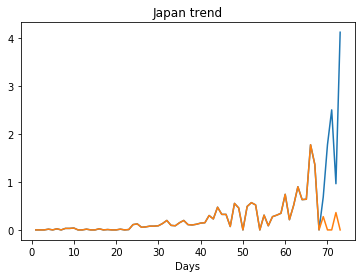

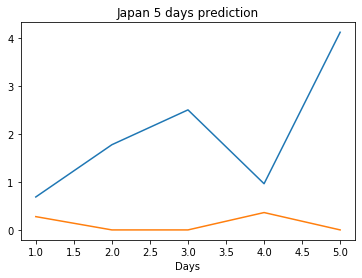

In [30]:
pred, loss = test_model(test_loader,model,device,criterion)
graph_country(81,pred.tolist(),graph_dir)

In [31]:
diffData[81].shape

(73,)

Directory ./offline8/Egypt/training/ exists
Egypt
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [22], Best Valid Los

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0555
train error: 0.06773166606823604
0.05545545369386673
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0599
train error: 0.056741636556883655
0.05994433909654617
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1047
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0938
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0861
Savin

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0553
train error: 0.06605173262457052
0.05525531992316246
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1020
train error: 0.08560600814719994
0.10203112661838531
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1130
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1076
Saving

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0694
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0694
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0684
train error: 0.07399136970440547
0.06842445582151413
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0926
train error: 0.08190089613199233
0.09261232614517212
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0613
Saving th

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1381
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1369
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1356
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1353
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1348
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1344
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1029
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0943
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0930
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0673
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0643
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0586
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1076
train error: 0.08626476985712846
0.10759534686803818
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1240
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1067
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1006
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0975
train error: 0.08760902980963389
0.09746294468641281
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1124
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1070
Savi

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0705
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0704
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0703
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0699
train error: 0.06518502309918403
0.06993661820888519
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1008
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1006
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1001
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1000
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0997
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0996
Saving the best model weights at E

train error: 0.06472596898674965
0.057555414736270905
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1211
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0977
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0957
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0954
train error: 0.0860167163113753
0.09538601338863373
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1026
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0996
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0946
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0925
Saving the

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0927
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0904
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0888
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0108
train error: 0.03059297731767098
0.010772104375064373
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1254
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1046
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1042
train error: 0.08109036640574535
0.10420836508274078
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1248
Sa

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0938
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0927
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0903
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0897
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0895
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1073
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1037
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1010
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0988
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0955
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0916
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0902
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0869
train error: 0.08075165270517269
0.0869111567735672
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1038
train error: 0.08381030081460873
0.1037626639008522
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1262
Saving t

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0698
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0683
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0677
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0647
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1130
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1045
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0916
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0703
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0659
train error: 0.06251250974213084
0.06588643044233322
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1057
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1048
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1043
train error: 0.08114753548676769
0.10426397621631622
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1470
Sav

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0848
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0798
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0785
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0402
train error: 0.04868184644728899
0.04017399623990059
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1207
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1131
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1072
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1052
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1045
Saving the best model weights at Epoch

Saving the best model weights at Epoch [29], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1072
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1065
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1051
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1044
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1038
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1008
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1002
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1048
train error: 0.08352576829493046
0.1048426628112793
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1233
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1210
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1310
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1304
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1297
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1294
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1274
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0698
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0698
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0697
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0697
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0695
train error: 0.06503286386529604
0.06949508190155029
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1439
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1438
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1436
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1434
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1073
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1067
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1055
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1050
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1045
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1043
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1028
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1024
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1224
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1221
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1218
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1215
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1213
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1210
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1207
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1199
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1207
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1015
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0862
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0841
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1241
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1210
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1205
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1199
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1194
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1168
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0705
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0699
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0681
train error: 0.05837340404589971
0.06808271259069443
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1068
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1274
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1255
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0743
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0738
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0733
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0730
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0728
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0723
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0722
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.1088
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1076
train error: 0.09080344761411349
0.10764160007238388
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1442
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1403
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1298
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1225
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1343
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1343
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1343
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1343
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0884
train error: 0.06994598925424118
0.0883861631155014
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1269
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0985
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0951
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0944
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0938
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0906
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1339
train error: 0.09970900425687432
0

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1067
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1057
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1050
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1046
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1043
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1037
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1033
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1030
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0664
train error: 0.06243945425376296
0.06636376678943634
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1209
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1198
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1193
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0464
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0841
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0745
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0987
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1280
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.1149
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1147
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1143
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1135
train error: 0.0878936264043053
0.11347190290689468
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1148
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1148
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1147
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1147
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1146
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1509
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1507
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1505
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1502
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1500
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1498
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1494
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1492
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1489
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1488
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1482
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1401
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1400
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1394
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1389
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1449
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1449
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1448
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1448
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1448
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1427
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1427
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1185
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1182
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1180
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1175
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1166
train error: 0.0972359744211038
0.1165611520409584
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1418
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1407
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1403
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1394
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1369
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1237
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1235
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1233
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1230
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1226
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1224
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1223
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1221
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1219
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1216
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0668
train error: 0.059893137340744335
0.0667664036154747
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1267
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1257
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1322
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1317
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1211
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1206
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1201
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1197
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1192
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1161
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1314
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1312
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1311
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1310
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1308
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1323
train error: 0.10462812917927901
0.13232314586639404
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1519
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1519
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1519
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1519
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1517
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1517
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1118
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1074
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1378
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1378
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1377
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1376
train error: 0.10518621516724427
0.13756386935710907
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1438
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1436
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1435
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1433
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1382
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1381
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1380
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1378
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1377
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1375
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1373
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1334
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.1044
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1044
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1043
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1043
train error: 0.08424809239804745
0.10429663956165314
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1175
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1276
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1276
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1276
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0953
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0947
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0935
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0889
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1221
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1215
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1209
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1196
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1190
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1184
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1155
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1149
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0656
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1090
train error: 0.08969278130680322
0

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1353
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1352
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1527
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1527
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1527
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1525
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1525
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1524
train error: 0.11867946945130825
0.15244050323963165
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1260
Saving the best model weights at Epo

Saving the best model weights at Epoch [31], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1244
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.1370
train error: 0.10820626008013884
0.1370178759098053
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1413
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1413
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1413
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1258
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0996
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0995
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0995
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0992
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0992
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0991
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0991
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0990
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0990
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0989
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1262
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1023
train error: 0.08182058352977037
0.10231943428516388
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1346
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1480
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1480
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1479
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1479
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1479
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1476
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1234
train error: 0.10449684460957845
0.12339828163385391
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1385
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1002
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1481
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1481
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1481
train error: 0.11599335273106894
0.1481180340051651
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0924
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1073
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1073
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1073
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1289
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1332
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1477
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1313
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1383
train error: 0.1089991162220637
0.1382586807012558
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1163
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1499
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0970
train error: 0.08233151050905387
0.09704553335905075
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1468
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1244
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1247
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1471
train error: 0.11561095702151457
0.14710457623004913
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1280
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1476
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1051
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1051
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1051
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1051
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1051
train error: 0.08202604549005628
0.10509929805994034
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1335
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1216
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1112
train error: 0.08556796330958605
0.1111755520105362
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1251
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1260
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1160
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0839
train error: 0.07448791886369387
0.08385361731052399
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1277
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1076
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1399
train error: 0.11032554643849532
0.1399022787809372
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [7], Best Valid Lo

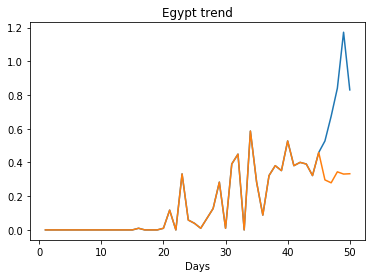

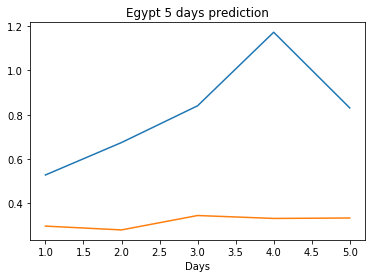

Creating directory ./offline8/United Arab Emirates/training/
United Arab Emirates
Saving the best model weights at Epoch [1], Best Valid Loss: 41.6195
Saving the best model weights at Epoch [2], Best Valid Loss: 41.1917
Saving the best model weights at Epoch [3], Best Valid Loss: 39.9439
Saving the best model weights at Epoch [4], Best Valid Loss: 37.5130
Saving the best model weights at Epoch [5], Best Valid Loss: 33.1217
Saving the best model weights at Epoch [7], Best Valid Loss: 31.8725
Saving the best model weights at Epoch [10], Best Valid Loss: 25.2128
Saving the best model weights at Epoch [11], Best Valid Loss: 24.8411
Saving the best model weights at Epoch [12], Best Valid Loss: 22.6612
Saving the best model weights at Epoch [13], Best Valid Loss: 19.3069
Saving the best model weights at Epoch [15], Best Valid Loss: 19.1961
Saving the best model weights at Epoch [19], Best Valid Loss: 14.1276
train error: 0.19367500550992367
14.127580642700195
Saving the best model weights at

Saving the best model weights at Epoch [2], Best Valid Loss: 31.9279
Saving the best model weights at Epoch [3], Best Valid Loss: 31.7389
Saving the best model weights at Epoch [4], Best Valid Loss: 31.3048
Saving the best model weights at Epoch [5], Best Valid Loss: 28.1026
Saving the best model weights at Epoch [6], Best Valid Loss: 22.6407
Saving the best model weights at Epoch [7], Best Valid Loss: 20.3412
Saving the best model weights at Epoch [13], Best Valid Loss: 20.0228
Saving the best model weights at Epoch [14], Best Valid Loss: 17.3563
Saving the best model weights at Epoch [16], Best Valid Loss: 13.5365
Saving the best model weights at Epoch [24], Best Valid Loss: 7.9329
train error: 0.32644233436534004
7.932904243469238
Saving the best model weights at Epoch [1], Best Valid Loss: 43.5861
Saving the best model weights at Epoch [8], Best Valid Loss: 43.4498
Saving the best model weights at Epoch [9], Best Valid Loss: 40.8889
Saving the best model weights at Epoch [10], Best

train error: 6.964338148313184
42.0716438293457
Saving the best model weights at Epoch [1], Best Valid Loss: 38.8240
Saving the best model weights at Epoch [2], Best Valid Loss: 38.5256
Saving the best model weights at Epoch [3], Best Valid Loss: 38.4727
Saving the best model weights at Epoch [5], Best Valid Loss: 38.3697
Saving the best model weights at Epoch [7], Best Valid Loss: 38.0463
Saving the best model weights at Epoch [22], Best Valid Loss: 37.2361
Saving the best model weights at Epoch [23], Best Valid Loss: 35.7438
Saving the best model weights at Epoch [24], Best Valid Loss: 26.9091
Saving the best model weights at Epoch [25], Best Valid Loss: 26.6805
Saving the best model weights at Epoch [27], Best Valid Loss: 25.3186
Saving the best model weights at Epoch [28], Best Valid Loss: 23.7719
Saving the best model weights at Epoch [30], Best Valid Loss: 17.6931
Saving the best model weights at Epoch [32], Best Valid Loss: 17.2809
Saving the best model weights at Epoch [33], Be

Saving the best model weights at Epoch [46], Best Valid Loss: 28.1497
train error: 5.260787588934744
28.14969253540039
Saving the best model weights at Epoch [1], Best Valid Loss: 40.6040
Saving the best model weights at Epoch [2], Best Valid Loss: 40.1840
Saving the best model weights at Epoch [12], Best Valid Loss: 40.1014
Saving the best model weights at Epoch [14], Best Valid Loss: 39.8379
train error: 6.5255582616213825
39.83786392211914
Saving the best model weights at Epoch [1], Best Valid Loss: 38.4610
Saving the best model weights at Epoch [2], Best Valid Loss: 35.1447
train error: 6.964338148313184
35.144657135009766
Saving the best model weights at Epoch [1], Best Valid Loss: 39.6622
Saving the best model weights at Epoch [2], Best Valid Loss: 38.9414
Saving the best model weights at Epoch [3], Best Valid Loss: 38.2462
Saving the best model weights at Epoch [4], Best Valid Loss: 37.8364
Saving the best model weights at Epoch [5], Best Valid Loss: 37.7900
Saving the best mode

train error: 0.1481552486037535
8.87909984588623
Saving the best model weights at Epoch [1], Best Valid Loss: 42.0552
Saving the best model weights at Epoch [2], Best Valid Loss: 39.9526
Saving the best model weights at Epoch [3], Best Valid Loss: 37.9193
Saving the best model weights at Epoch [4], Best Valid Loss: 35.8105
Saving the best model weights at Epoch [5], Best Valid Loss: 33.7924
Saving the best model weights at Epoch [6], Best Valid Loss: 31.6996
Saving the best model weights at Epoch [7], Best Valid Loss: 29.0283
Saving the best model weights at Epoch [8], Best Valid Loss: 26.4707
Saving the best model weights at Epoch [9], Best Valid Loss: 24.2128
Saving the best model weights at Epoch [10], Best Valid Loss: 22.1090
Saving the best model weights at Epoch [11], Best Valid Loss: 20.2320
Saving the best model weights at Epoch [12], Best Valid Loss: 18.6228
Saving the best model weights at Epoch [13], Best Valid Loss: 17.1764
Saving the best model weights at Epoch [14], Best 

train error: 0.4599082318825661
14.12609577178955
Saving the best model weights at Epoch [1], Best Valid Loss: 42.1078
Saving the best model weights at Epoch [2], Best Valid Loss: 41.0587
Saving the best model weights at Epoch [3], Best Valid Loss: 40.1507
Saving the best model weights at Epoch [4], Best Valid Loss: 39.3739
Saving the best model weights at Epoch [5], Best Valid Loss: 38.7510
Saving the best model weights at Epoch [6], Best Valid Loss: 38.1734
Saving the best model weights at Epoch [7], Best Valid Loss: 37.7155
Saving the best model weights at Epoch [8], Best Valid Loss: 37.3231
Saving the best model weights at Epoch [9], Best Valid Loss: 36.9969
Saving the best model weights at Epoch [10], Best Valid Loss: 36.7009
Saving the best model weights at Epoch [11], Best Valid Loss: 36.4263
Saving the best model weights at Epoch [12], Best Valid Loss: 36.2088
Saving the best model weights at Epoch [13], Best Valid Loss: 36.0514
Saving the best model weights at Epoch [14], Best

train error: 1.0397605351623027
12.728946685791016
Saving the best model weights at Epoch [1], Best Valid Loss: 41.1291
Saving the best model weights at Epoch [2], Best Valid Loss: 39.8321
Saving the best model weights at Epoch [3], Best Valid Loss: 38.7154
Saving the best model weights at Epoch [4], Best Valid Loss: 37.7536
Saving the best model weights at Epoch [5], Best Valid Loss: 36.9519
Saving the best model weights at Epoch [6], Best Valid Loss: 36.2715
Saving the best model weights at Epoch [7], Best Valid Loss: 35.7101
Saving the best model weights at Epoch [8], Best Valid Loss: 35.1668
Saving the best model weights at Epoch [9], Best Valid Loss: 34.7663
Saving the best model weights at Epoch [10], Best Valid Loss: 34.3973
Saving the best model weights at Epoch [11], Best Valid Loss: 34.0363
Saving the best model weights at Epoch [12], Best Valid Loss: 33.7504
Saving the best model weights at Epoch [13], Best Valid Loss: 33.5053
Saving the best model weights at Epoch [14], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 38.8123
Saving the best model weights at Epoch [11], Best Valid Loss: 38.6617
Saving the best model weights at Epoch [12], Best Valid Loss: 38.5249
Saving the best model weights at Epoch [13], Best Valid Loss: 38.4255
Saving the best model weights at Epoch [14], Best Valid Loss: 38.3364
Saving the best model weights at Epoch [15], Best Valid Loss: 38.2249
Saving the best model weights at Epoch [16], Best Valid Loss: 38.1397
Saving the best model weights at Epoch [17], Best Valid Loss: 38.0585
Saving the best model weights at Epoch [18], Best Valid Loss: 37.9982
Saving the best model weights at Epoch [19], Best Valid Loss: 37.9193
Saving the best model weights at Epoch [20], Best Valid Loss: 37.8830
Saving the best model weights at Epoch [21], Best Valid Loss: 37.8358
Saving the best model weights at Epoch [22], Best Valid Loss: 37.8180
Saving the best model weights at Epoch [23], Best Valid Loss: 37.7638
Saving the best mode

Saving the best model weights at Epoch [19], Best Valid Loss: 34.8498
Saving the best model weights at Epoch [20], Best Valid Loss: 34.7614
Saving the best model weights at Epoch [21], Best Valid Loss: 34.6673
Saving the best model weights at Epoch [22], Best Valid Loss: 34.5400
Saving the best model weights at Epoch [23], Best Valid Loss: 34.4641
Saving the best model weights at Epoch [24], Best Valid Loss: 34.3636
Saving the best model weights at Epoch [25], Best Valid Loss: 34.2409
Saving the best model weights at Epoch [26], Best Valid Loss: 34.1695
Saving the best model weights at Epoch [27], Best Valid Loss: 34.0707
Saving the best model weights at Epoch [28], Best Valid Loss: 33.9861
Saving the best model weights at Epoch [29], Best Valid Loss: 33.8766
Saving the best model weights at Epoch [30], Best Valid Loss: 33.7550
Saving the best model weights at Epoch [31], Best Valid Loss: 33.6206
Saving the best model weights at Epoch [32], Best Valid Loss: 33.5147
Saving the best mode

Saving the best model weights at Epoch [12], Best Valid Loss: 30.0882
Saving the best model weights at Epoch [13], Best Valid Loss: 30.0788
Saving the best model weights at Epoch [14], Best Valid Loss: 29.8955
Saving the best model weights at Epoch [15], Best Valid Loss: 29.8537
Saving the best model weights at Epoch [16], Best Valid Loss: 29.7970
Saving the best model weights at Epoch [19], Best Valid Loss: 29.7918
Saving the best model weights at Epoch [20], Best Valid Loss: 29.7517
Saving the best model weights at Epoch [21], Best Valid Loss: 29.7487
Saving the best model weights at Epoch [23], Best Valid Loss: 29.7328
Saving the best model weights at Epoch [37], Best Valid Loss: 29.7173
Saving the best model weights at Epoch [38], Best Valid Loss: 29.6462
Saving the best model weights at Epoch [39], Best Valid Loss: 29.6073
Saving the best model weights at Epoch [40], Best Valid Loss: 29.5730
train error: 5.131070015891906
29.572965621948242
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 38.0997
Saving the best model weights at Epoch [23], Best Valid Loss: 38.0660
Saving the best model weights at Epoch [24], Best Valid Loss: 38.0530
Saving the best model weights at Epoch [25], Best Valid Loss: 38.0264
Saving the best model weights at Epoch [26], Best Valid Loss: 38.0048
Saving the best model weights at Epoch [27], Best Valid Loss: 37.9857
Saving the best model weights at Epoch [28], Best Valid Loss: 37.9808
Saving the best model weights at Epoch [30], Best Valid Loss: 37.9734
Saving the best model weights at Epoch [32], Best Valid Loss: 37.9684
Saving the best model weights at Epoch [36], Best Valid Loss: 37.9643
Saving the best model weights at Epoch [37], Best Valid Loss: 37.9531
Saving the best model weights at Epoch [41], Best Valid Loss: 37.9512
Saving the best model weights at Epoch [42], Best Valid Loss: 37.9437
train error: 6.312903773490219
37.943729400634766
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [6], Best Valid Loss: 41.6140
Saving the best model weights at Epoch [7], Best Valid Loss: 41.4909
Saving the best model weights at Epoch [8], Best Valid Loss: 41.3902
Saving the best model weights at Epoch [9], Best Valid Loss: 41.3145
Saving the best model weights at Epoch [10], Best Valid Loss: 41.2352
Saving the best model weights at Epoch [11], Best Valid Loss: 41.1789
Saving the best model weights at Epoch [12], Best Valid Loss: 41.1287
Saving the best model weights at Epoch [13], Best Valid Loss: 41.0929
Saving the best model weights at Epoch [14], Best Valid Loss: 41.0562
Saving the best model weights at Epoch [15], Best Valid Loss: 41.0257
Saving the best model weights at Epoch [16], Best Valid Loss: 40.9904
Saving the best model weights at Epoch [17], Best Valid Loss: 40.9641
Saving the best model weights at Epoch [18], Best Valid Loss: 40.9458
Saving the best model weights at Epoch [19], Best Valid Loss: 40.9194
Saving the best model we

Saving the best model weights at Epoch [14], Best Valid Loss: 37.9324
train error: 5.789632370395045
37.9323844909668
Saving the best model weights at Epoch [1], Best Valid Loss: 41.6932
Saving the best model weights at Epoch [2], Best Valid Loss: 40.6824
Saving the best model weights at Epoch [3], Best Valid Loss: 39.8416
Saving the best model weights at Epoch [4], Best Valid Loss: 39.1456
Saving the best model weights at Epoch [5], Best Valid Loss: 38.5254
Saving the best model weights at Epoch [6], Best Valid Loss: 38.0068
Saving the best model weights at Epoch [7], Best Valid Loss: 37.5783
Saving the best model weights at Epoch [8], Best Valid Loss: 37.2086
Saving the best model weights at Epoch [9], Best Valid Loss: 36.8737
Saving the best model weights at Epoch [10], Best Valid Loss: 36.6006
Saving the best model weights at Epoch [11], Best Valid Loss: 36.3754
Saving the best model weights at Epoch [12], Best Valid Loss: 36.1835
Saving the best model weights at Epoch [13], Best V

Saving the best model weights at Epoch [9], Best Valid Loss: 34.3266
Saving the best model weights at Epoch [10], Best Valid Loss: 33.9906
Saving the best model weights at Epoch [11], Best Valid Loss: 33.7110
Saving the best model weights at Epoch [12], Best Valid Loss: 33.4798
Saving the best model weights at Epoch [13], Best Valid Loss: 33.2961
Saving the best model weights at Epoch [14], Best Valid Loss: 33.1228
Saving the best model weights at Epoch [15], Best Valid Loss: 32.9800
Saving the best model weights at Epoch [16], Best Valid Loss: 32.8542
Saving the best model weights at Epoch [17], Best Valid Loss: 32.7246
Saving the best model weights at Epoch [18], Best Valid Loss: 32.6128
Saving the best model weights at Epoch [19], Best Valid Loss: 32.5318
Saving the best model weights at Epoch [20], Best Valid Loss: 32.4628
Saving the best model weights at Epoch [21], Best Valid Loss: 32.4014
Saving the best model weights at Epoch [22], Best Valid Loss: 32.3492
Saving the best model

Saving the best model weights at Epoch [37], Best Valid Loss: 32.5779
train error: 5.352409806943709
32.577857971191406
Saving the best model weights at Epoch [1], Best Valid Loss: 35.3850
Saving the best model weights at Epoch [2], Best Valid Loss: 30.9498
Saving the best model weights at Epoch [3], Best Valid Loss: 30.1155
Saving the best model weights at Epoch [4], Best Valid Loss: 29.9240
Saving the best model weights at Epoch [5], Best Valid Loss: 28.8329
train error: 5.281110277098994
28.832910537719727
Saving the best model weights at Epoch [1], Best Valid Loss: 41.8423
Saving the best model weights at Epoch [2], Best Valid Loss: 40.8785
Saving the best model weights at Epoch [3], Best Valid Loss: 40.0737
Saving the best model weights at Epoch [4], Best Valid Loss: 39.3843
Saving the best model weights at Epoch [5], Best Valid Loss: 38.8206
Saving the best model weights at Epoch [6], Best Valid Loss: 38.3473
Saving the best model weights at Epoch [7], Best Valid Loss: 37.9584
Sa

Saving the best model weights at Epoch [15], Best Valid Loss: 39.7760
Saving the best model weights at Epoch [16], Best Valid Loss: 39.5926
Saving the best model weights at Epoch [17], Best Valid Loss: 39.4135
Saving the best model weights at Epoch [18], Best Valid Loss: 39.2373
Saving the best model weights at Epoch [19], Best Valid Loss: 39.0619
Saving the best model weights at Epoch [20], Best Valid Loss: 38.8899
Saving the best model weights at Epoch [21], Best Valid Loss: 38.7188
Saving the best model weights at Epoch [22], Best Valid Loss: 38.5507
Saving the best model weights at Epoch [23], Best Valid Loss: 38.3840
Saving the best model weights at Epoch [24], Best Valid Loss: 38.2194
Saving the best model weights at Epoch [25], Best Valid Loss: 38.0566
Saving the best model weights at Epoch [26], Best Valid Loss: 37.8974
Saving the best model weights at Epoch [27], Best Valid Loss: 37.7354
Saving the best model weights at Epoch [28], Best Valid Loss: 37.5782
Saving the best mode

Saving the best model weights at Epoch [7], Best Valid Loss: 39.9940
Saving the best model weights at Epoch [8], Best Valid Loss: 39.7407
Saving the best model weights at Epoch [9], Best Valid Loss: 39.4890
Saving the best model weights at Epoch [10], Best Valid Loss: 39.2373
Saving the best model weights at Epoch [11], Best Valid Loss: 38.9907
Saving the best model weights at Epoch [12], Best Valid Loss: 38.7393
Saving the best model weights at Epoch [13], Best Valid Loss: 38.4910
Saving the best model weights at Epoch [14], Best Valid Loss: 38.2449
Saving the best model weights at Epoch [15], Best Valid Loss: 38.0009
Saving the best model weights at Epoch [16], Best Valid Loss: 37.7594
Saving the best model weights at Epoch [17], Best Valid Loss: 37.5206
Saving the best model weights at Epoch [18], Best Valid Loss: 37.2878
Saving the best model weights at Epoch [19], Best Valid Loss: 37.0467
Saving the best model weights at Epoch [20], Best Valid Loss: 36.8131
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 12.1821
Saving the best model weights at Epoch [24], Best Valid Loss: 11.7196
Saving the best model weights at Epoch [25], Best Valid Loss: 11.0950
Saving the best model weights at Epoch [26], Best Valid Loss: 10.9019
Saving the best model weights at Epoch [27], Best Valid Loss: 10.5633
Saving the best model weights at Epoch [28], Best Valid Loss: 10.5284
Saving the best model weights at Epoch [29], Best Valid Loss: 10.3667
Saving the best model weights at Epoch [30], Best Valid Loss: 9.8871
Saving the best model weights at Epoch [31], Best Valid Loss: 9.7865
Saving the best model weights at Epoch [32], Best Valid Loss: 9.4674
Saving the best model weights at Epoch [33], Best Valid Loss: 9.2902
Saving the best model weights at Epoch [34], Best Valid Loss: 8.7332
Saving the best model weights at Epoch [35], Best Valid Loss: 8.6291
train error: 1.4946836909699825
8.629051208496094
Saving the best model weights at Epoch [1], Be

Saving the best model weights at Epoch [4], Best Valid Loss: 36.8777
Saving the best model weights at Epoch [5], Best Valid Loss: 35.6815
Saving the best model weights at Epoch [6], Best Valid Loss: 34.4914
Saving the best model weights at Epoch [7], Best Valid Loss: 33.6362
Saving the best model weights at Epoch [8], Best Valid Loss: 32.4681
Saving the best model weights at Epoch [9], Best Valid Loss: 31.7031
Saving the best model weights at Epoch [10], Best Valid Loss: 31.2714
Saving the best model weights at Epoch [11], Best Valid Loss: 30.7983
Saving the best model weights at Epoch [12], Best Valid Loss: 30.3539
Saving the best model weights at Epoch [13], Best Valid Loss: 30.3224
Saving the best model weights at Epoch [14], Best Valid Loss: 30.1527
train error: 2.4959524073788235
30.152740478515625
Saving the best model weights at Epoch [1], Best Valid Loss: 42.3897
Saving the best model weights at Epoch [2], Best Valid Loss: 42.0900
Saving the best model weights at Epoch [3], Bes

Saving the best model weights at Epoch [7], Best Valid Loss: 22.6681
Saving the best model weights at Epoch [8], Best Valid Loss: 20.6592
Saving the best model weights at Epoch [9], Best Valid Loss: 17.7626
Saving the best model weights at Epoch [10], Best Valid Loss: 16.1536
Saving the best model weights at Epoch [11], Best Valid Loss: 15.1112
Saving the best model weights at Epoch [12], Best Valid Loss: 14.1807
Saving the best model weights at Epoch [13], Best Valid Loss: 13.5847
Saving the best model weights at Epoch [14], Best Valid Loss: 12.7013
train error: 1.3180585688640993
12.701324462890625
Saving the best model weights at Epoch [1], Best Valid Loss: 42.7231
Saving the best model weights at Epoch [2], Best Valid Loss: 42.6449
Saving the best model weights at Epoch [3], Best Valid Loss: 42.5675
Saving the best model weights at Epoch [4], Best Valid Loss: 42.4920
Saving the best model weights at Epoch [5], Best Valid Loss: 42.4178
Saving the best model weights at Epoch [6], Bes

Saving the best model weights at Epoch [9], Best Valid Loss: 39.2837
Saving the best model weights at Epoch [10], Best Valid Loss: 39.0703
Saving the best model weights at Epoch [11], Best Valid Loss: 39.0609
Saving the best model weights at Epoch [12], Best Valid Loss: 38.9794
Saving the best model weights at Epoch [13], Best Valid Loss: 38.8460
Saving the best model weights at Epoch [14], Best Valid Loss: 38.8246
Saving the best model weights at Epoch [15], Best Valid Loss: 38.6130
Saving the best model weights at Epoch [16], Best Valid Loss: 38.5689
Saving the best model weights at Epoch [20], Best Valid Loss: 38.5209
Saving the best model weights at Epoch [21], Best Valid Loss: 38.4748
Saving the best model weights at Epoch [22], Best Valid Loss: 38.4225
Saving the best model weights at Epoch [24], Best Valid Loss: 38.4136
Saving the best model weights at Epoch [27], Best Valid Loss: 38.3879
Saving the best model weights at Epoch [30], Best Valid Loss: 38.2810
Saving the best model

Saving the best model weights at Epoch [3], Best Valid Loss: 43.0181
Saving the best model weights at Epoch [4], Best Valid Loss: 42.9473
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8718
Saving the best model weights at Epoch [6], Best Valid Loss: 42.8040
Saving the best model weights at Epoch [7], Best Valid Loss: 42.7393
Saving the best model weights at Epoch [8], Best Valid Loss: 42.6748
Saving the best model weights at Epoch [9], Best Valid Loss: 42.6222
Saving the best model weights at Epoch [10], Best Valid Loss: 42.5547
Saving the best model weights at Epoch [11], Best Valid Loss: 42.4985
Saving the best model weights at Epoch [12], Best Valid Loss: 42.4424
Saving the best model weights at Epoch [13], Best Valid Loss: 42.3884
Saving the best model weights at Epoch [14], Best Valid Loss: 42.3449
Saving the best model weights at Epoch [15], Best Valid Loss: 42.2875
Saving the best model weights at Epoch [16], Best Valid Loss: 42.2408
Saving the best model weigh

Saving the best model weights at Epoch [22], Best Valid Loss: 39.9059
Saving the best model weights at Epoch [23], Best Valid Loss: 39.7804
Saving the best model weights at Epoch [24], Best Valid Loss: 39.6585
Saving the best model weights at Epoch [25], Best Valid Loss: 39.5359
Saving the best model weights at Epoch [26], Best Valid Loss: 39.4165
Saving the best model weights at Epoch [27], Best Valid Loss: 39.2993
Saving the best model weights at Epoch [28], Best Valid Loss: 39.1845
Saving the best model weights at Epoch [29], Best Valid Loss: 39.0708
Saving the best model weights at Epoch [30], Best Valid Loss: 38.9589
Saving the best model weights at Epoch [31], Best Valid Loss: 38.8495
Saving the best model weights at Epoch [32], Best Valid Loss: 38.7411
Saving the best model weights at Epoch [33], Best Valid Loss: 38.6376
Saving the best model weights at Epoch [34], Best Valid Loss: 38.5320
Saving the best model weights at Epoch [35], Best Valid Loss: 38.4300
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 28.0747
Saving the best model weights at Epoch [45], Best Valid Loss: 27.8305
Saving the best model weights at Epoch [46], Best Valid Loss: 27.6258
Saving the best model weights at Epoch [47], Best Valid Loss: 26.9964
Saving the best model weights at Epoch [48], Best Valid Loss: 26.5785
Saving the best model weights at Epoch [49], Best Valid Loss: 26.2743
Saving the best model weights at Epoch [50], Best Valid Loss: 25.6328
train error: 5.302833057218982
25.632755279541016
Saving the best model weights at Epoch [1], Best Valid Loss: 41.8606
Saving the best model weights at Epoch [2], Best Valid Loss: 41.7505
Saving the best model weights at Epoch [3], Best Valid Loss: 41.6442
Saving the best model weights at Epoch [4], Best Valid Loss: 41.5394
Saving the best model weights at Epoch [5], Best Valid Loss: 41.4366
Saving the best model weights at Epoch [6], Best Valid Loss: 41.3355
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 34.3920
Saving the best model weights at Epoch [11], Best Valid Loss: 34.2172
Saving the best model weights at Epoch [12], Best Valid Loss: 33.9612
Saving the best model weights at Epoch [13], Best Valid Loss: 33.7168
Saving the best model weights at Epoch [14], Best Valid Loss: 33.5937
Saving the best model weights at Epoch [15], Best Valid Loss: 33.4188
Saving the best model weights at Epoch [16], Best Valid Loss: 33.2867
Saving the best model weights at Epoch [17], Best Valid Loss: 33.2440
Saving the best model weights at Epoch [18], Best Valid Loss: 33.0167
Saving the best model weights at Epoch [19], Best Valid Loss: 32.9586
Saving the best model weights at Epoch [20], Best Valid Loss: 32.7733
Saving the best model weights at Epoch [21], Best Valid Loss: 32.6857
Saving the best model weights at Epoch [23], Best Valid Loss: 32.6596
Saving the best model weights at Epoch [25], Best Valid Loss: 32.6139
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 34.9426
train error: 5.509890922615605
34.942623138427734
Saving the best model weights at Epoch [1], Best Valid Loss: 42.9184
Saving the best model weights at Epoch [2], Best Valid Loss: 42.6407
Saving the best model weights at Epoch [3], Best Valid Loss: 42.4055
Saving the best model weights at Epoch [4], Best Valid Loss: 42.1924
Saving the best model weights at Epoch [5], Best Valid Loss: 42.0048
Saving the best model weights at Epoch [6], Best Valid Loss: 41.9206
Saving the best model weights at Epoch [7], Best Valid Loss: 41.7702
Saving the best model weights at Epoch [8], Best Valid Loss: 41.6538
Saving the best model weights at Epoch [9], Best Valid Loss: 41.5756
Saving the best model weights at Epoch [10], Best Valid Loss: 41.4874
Saving the best model weights at Epoch [11], Best Valid Loss: 41.4592
Saving the best model weights at Epoch [12], Best Valid Loss: 41.4022
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [39], Best Valid Loss: 39.5298
Saving the best model weights at Epoch [40], Best Valid Loss: 39.4884
Saving the best model weights at Epoch [41], Best Valid Loss: 39.4386
Saving the best model weights at Epoch [42], Best Valid Loss: 39.4005
Saving the best model weights at Epoch [43], Best Valid Loss: 39.3567
Saving the best model weights at Epoch [44], Best Valid Loss: 39.3183
Saving the best model weights at Epoch [45], Best Valid Loss: 39.2798
Saving the best model weights at Epoch [46], Best Valid Loss: 39.2408
Saving the best model weights at Epoch [47], Best Valid Loss: 39.2090
Saving the best model weights at Epoch [48], Best Valid Loss: 39.1691
Saving the best model weights at Epoch [49], Best Valid Loss: 39.1356
Saving the best model weights at Epoch [50], Best Valid Loss: 39.1069
train error: 6.344004648166798
39.10691452026367
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0041
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [32], Best Valid Loss: 36.6624
Saving the best model weights at Epoch [33], Best Valid Loss: 36.5438
Saving the best model weights at Epoch [34], Best Valid Loss: 36.4294
Saving the best model weights at Epoch [35], Best Valid Loss: 36.3179
Saving the best model weights at Epoch [36], Best Valid Loss: 36.2092
Saving the best model weights at Epoch [37], Best Valid Loss: 36.1037
Saving the best model weights at Epoch [38], Best Valid Loss: 36.0163
Saving the best model weights at Epoch [39], Best Valid Loss: 35.9151
Saving the best model weights at Epoch [40], Best Valid Loss: 35.8209
Saving the best model weights at Epoch [41], Best Valid Loss: 35.7261
Saving the best model weights at Epoch [42], Best Valid Loss: 35.6444
Saving the best model weights at Epoch [43], Best Valid Loss: 35.5458
Saving the best model weights at Epoch [44], Best Valid Loss: 35.4532
Saving the best model weights at Epoch [45], Best Valid Loss: 35.3771
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 34.8588
Saving the best model weights at Epoch [48], Best Valid Loss: 34.7970
Saving the best model weights at Epoch [49], Best Valid Loss: 34.7299
Saving the best model weights at Epoch [50], Best Valid Loss: 34.6898
train error: 5.397576601274552
34.68981170654297
Saving the best model weights at Epoch [1], Best Valid Loss: 41.8466
Saving the best model weights at Epoch [2], Best Valid Loss: 40.8480
Saving the best model weights at Epoch [3], Best Valid Loss: 40.1302
Saving the best model weights at Epoch [4], Best Valid Loss: 39.5047
Saving the best model weights at Epoch [5], Best Valid Loss: 38.8220
Saving the best model weights at Epoch [6], Best Valid Loss: 38.5189
Saving the best model weights at Epoch [7], Best Valid Loss: 38.1168
Saving the best model weights at Epoch [8], Best Valid Loss: 37.7823
Saving the best model weights at Epoch [9], Best Valid Loss: 37.3476
Saving the best model weights at Epoch [10], Best 

Saving the best model weights at Epoch [35], Best Valid Loss: 39.9220
Saving the best model weights at Epoch [36], Best Valid Loss: 39.8596
Saving the best model weights at Epoch [37], Best Valid Loss: 39.8120
Saving the best model weights at Epoch [38], Best Valid Loss: 39.7602
Saving the best model weights at Epoch [39], Best Valid Loss: 39.7058
Saving the best model weights at Epoch [40], Best Valid Loss: 39.6600
Saving the best model weights at Epoch [41], Best Valid Loss: 39.6109
Saving the best model weights at Epoch [42], Best Valid Loss: 39.5648
Saving the best model weights at Epoch [43], Best Valid Loss: 39.5215
Saving the best model weights at Epoch [44], Best Valid Loss: 39.4785
Saving the best model weights at Epoch [45], Best Valid Loss: 39.4466
Saving the best model weights at Epoch [46], Best Valid Loss: 39.3961
Saving the best model weights at Epoch [47], Best Valid Loss: 39.3604
Saving the best model weights at Epoch [48], Best Valid Loss: 39.3198
Saving the best mode

Saving the best model weights at Epoch [24], Best Valid Loss: 36.1635
Saving the best model weights at Epoch [25], Best Valid Loss: 35.9775
Saving the best model weights at Epoch [26], Best Valid Loss: 35.8035
Saving the best model weights at Epoch [27], Best Valid Loss: 35.6364
Saving the best model weights at Epoch [28], Best Valid Loss: 35.4699
Saving the best model weights at Epoch [29], Best Valid Loss: 35.3118
Saving the best model weights at Epoch [30], Best Valid Loss: 35.1698
Saving the best model weights at Epoch [31], Best Valid Loss: 35.0059
Saving the best model weights at Epoch [32], Best Valid Loss: 34.8792
Saving the best model weights at Epoch [33], Best Valid Loss: 34.7306
Saving the best model weights at Epoch [34], Best Valid Loss: 34.5992
Saving the best model weights at Epoch [35], Best Valid Loss: 34.4453
Saving the best model weights at Epoch [36], Best Valid Loss: 34.3151
Saving the best model weights at Epoch [37], Best Valid Loss: 34.1904
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 42.1677
Saving the best model weights at Epoch [18], Best Valid Loss: 42.1228
Saving the best model weights at Epoch [19], Best Valid Loss: 42.0730
Saving the best model weights at Epoch [20], Best Valid Loss: 42.0250
Saving the best model weights at Epoch [21], Best Valid Loss: 41.9810
Saving the best model weights at Epoch [22], Best Valid Loss: 41.9419
Saving the best model weights at Epoch [23], Best Valid Loss: 41.9009
Saving the best model weights at Epoch [24], Best Valid Loss: 41.8645
Saving the best model weights at Epoch [25], Best Valid Loss: 41.8170
Saving the best model weights at Epoch [26], Best Valid Loss: 41.7796
Saving the best model weights at Epoch [27], Best Valid Loss: 41.7447
Saving the best model weights at Epoch [28], Best Valid Loss: 41.7088
Saving the best model weights at Epoch [29], Best Valid Loss: 41.6727
Saving the best model weights at Epoch [30], Best Valid Loss: 41.6390
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 41.3973
Saving the best model weights at Epoch [7], Best Valid Loss: 41.2133
Saving the best model weights at Epoch [8], Best Valid Loss: 41.0326
Saving the best model weights at Epoch [9], Best Valid Loss: 40.8610
Saving the best model weights at Epoch [10], Best Valid Loss: 40.6929
Saving the best model weights at Epoch [11], Best Valid Loss: 40.5439
Saving the best model weights at Epoch [12], Best Valid Loss: 40.3860
Saving the best model weights at Epoch [13], Best Valid Loss: 40.2229
Saving the best model weights at Epoch [14], Best Valid Loss: 40.0756
Saving the best model weights at Epoch [15], Best Valid Loss: 39.9532
Saving the best model weights at Epoch [16], Best Valid Loss: 39.7884
Saving the best model weights at Epoch [17], Best Valid Loss: 39.6534
Saving the best model weights at Epoch [18], Best Valid Loss: 39.5239
Saving the best model weights at Epoch [19], Best Valid Loss: 39.3969
Saving the best model we

Saving the best model weights at Epoch [41], Best Valid Loss: 40.6169
Saving the best model weights at Epoch [42], Best Valid Loss: 40.5807
Saving the best model weights at Epoch [43], Best Valid Loss: 40.5456
Saving the best model weights at Epoch [44], Best Valid Loss: 40.5110
Saving the best model weights at Epoch [45], Best Valid Loss: 40.4766
Saving the best model weights at Epoch [46], Best Valid Loss: 40.4431
Saving the best model weights at Epoch [47], Best Valid Loss: 40.4101
Saving the best model weights at Epoch [48], Best Valid Loss: 40.3782
Saving the best model weights at Epoch [49], Best Valid Loss: 40.3467
Saving the best model weights at Epoch [50], Best Valid Loss: 40.3144
train error: 6.074519200911445
40.314353942871094
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8395
Saving the best model weights at Epoch [2], Best Valid Loss: 42.6140
Saving the best model weights at Epoch [3], Best Valid Loss: 42.3957
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [30], Best Valid Loss: 41.1126
Saving the best model weights at Epoch [31], Best Valid Loss: 41.0650
Saving the best model weights at Epoch [32], Best Valid Loss: 41.0192
Saving the best model weights at Epoch [33], Best Valid Loss: 40.9726
Saving the best model weights at Epoch [34], Best Valid Loss: 40.9281
Saving the best model weights at Epoch [35], Best Valid Loss: 40.8851
Saving the best model weights at Epoch [36], Best Valid Loss: 40.8405
Saving the best model weights at Epoch [37], Best Valid Loss: 40.7980
Saving the best model weights at Epoch [38], Best Valid Loss: 40.7564
Saving the best model weights at Epoch [39], Best Valid Loss: 40.7154
Saving the best model weights at Epoch [40], Best Valid Loss: 40.6754
Saving the best model weights at Epoch [41], Best Valid Loss: 40.6363
Saving the best model weights at Epoch [42], Best Valid Loss: 40.5973
Saving the best model weights at Epoch [43], Best Valid Loss: 40.5591
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 41.7463
Saving the best model weights at Epoch [18], Best Valid Loss: 41.6821
Saving the best model weights at Epoch [19], Best Valid Loss: 41.6185
Saving the best model weights at Epoch [20], Best Valid Loss: 41.5557
Saving the best model weights at Epoch [21], Best Valid Loss: 41.4945
Saving the best model weights at Epoch [22], Best Valid Loss: 41.4351
Saving the best model weights at Epoch [23], Best Valid Loss: 41.3748
Saving the best model weights at Epoch [24], Best Valid Loss: 41.3167
Saving the best model weights at Epoch [25], Best Valid Loss: 41.2590
Saving the best model weights at Epoch [26], Best Valid Loss: 41.2025
Saving the best model weights at Epoch [27], Best Valid Loss: 41.1469
Saving the best model weights at Epoch [28], Best Valid Loss: 41.0933
Saving the best model weights at Epoch [29], Best Valid Loss: 41.0384
Saving the best model weights at Epoch [30], Best Valid Loss: 40.9857
Saving the best mode

Saving the best model weights at Epoch [7], Best Valid Loss: 42.0568
Saving the best model weights at Epoch [8], Best Valid Loss: 42.0465
Saving the best model weights at Epoch [9], Best Valid Loss: 42.0355
Saving the best model weights at Epoch [10], Best Valid Loss: 42.0250
Saving the best model weights at Epoch [11], Best Valid Loss: 42.0144
Saving the best model weights at Epoch [12], Best Valid Loss: 42.0039
Saving the best model weights at Epoch [13], Best Valid Loss: 41.9934
Saving the best model weights at Epoch [14], Best Valid Loss: 41.9829
Saving the best model weights at Epoch [15], Best Valid Loss: 41.9724
Saving the best model weights at Epoch [16], Best Valid Loss: 41.9620
Saving the best model weights at Epoch [17], Best Valid Loss: 41.9516
Saving the best model weights at Epoch [18], Best Valid Loss: 41.9413
Saving the best model weights at Epoch [19], Best Valid Loss: 41.9309
Saving the best model weights at Epoch [20], Best Valid Loss: 41.9206
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 39.4909
Saving the best model weights at Epoch [25], Best Valid Loss: 39.3910
Saving the best model weights at Epoch [26], Best Valid Loss: 39.3058
Saving the best model weights at Epoch [27], Best Valid Loss: 39.2020
Saving the best model weights at Epoch [28], Best Valid Loss: 39.1460
Saving the best model weights at Epoch [29], Best Valid Loss: 39.0492
Saving the best model weights at Epoch [30], Best Valid Loss: 38.9584
Saving the best model weights at Epoch [31], Best Valid Loss: 38.8603
Saving the best model weights at Epoch [32], Best Valid Loss: 38.7928
Saving the best model weights at Epoch [33], Best Valid Loss: 38.6975
Saving the best model weights at Epoch [34], Best Valid Loss: 38.6273
Saving the best model weights at Epoch [35], Best Valid Loss: 38.5363
Saving the best model weights at Epoch [36], Best Valid Loss: 38.4588
Saving the best model weights at Epoch [37], Best Valid Loss: 38.3668
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 41.3816
Saving the best model weights at Epoch [41], Best Valid Loss: 41.3507
Saving the best model weights at Epoch [42], Best Valid Loss: 41.3194
Saving the best model weights at Epoch [43], Best Valid Loss: 41.2880
Saving the best model weights at Epoch [44], Best Valid Loss: 41.2557
Saving the best model weights at Epoch [45], Best Valid Loss: 41.2250
Saving the best model weights at Epoch [46], Best Valid Loss: 41.1933
Saving the best model weights at Epoch [47], Best Valid Loss: 41.1608
Saving the best model weights at Epoch [48], Best Valid Loss: 41.1292
Saving the best model weights at Epoch [49], Best Valid Loss: 41.0980
Saving the best model weights at Epoch [50], Best Valid Loss: 41.0667
train error: 6.492719709392516
41.06666946411133
Saving the best model weights at Epoch [1], Best Valid Loss: 42.1946
Saving the best model weights at Epoch [2], Best Valid Loss: 42.0369
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [16], Best Valid Loss: 43.3310
Saving the best model weights at Epoch [17], Best Valid Loss: 43.3131
Saving the best model weights at Epoch [18], Best Valid Loss: 43.2870
Saving the best model weights at Epoch [19], Best Valid Loss: 43.2540
Saving the best model weights at Epoch [20], Best Valid Loss: 43.2223
Saving the best model weights at Epoch [21], Best Valid Loss: 43.1912
Saving the best model weights at Epoch [22], Best Valid Loss: 43.1536
Saving the best model weights at Epoch [23], Best Valid Loss: 43.1158
Saving the best model weights at Epoch [24], Best Valid Loss: 43.0798
Saving the best model weights at Epoch [25], Best Valid Loss: 43.0415
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0028
Saving the best model weights at Epoch [27], Best Valid Loss: 42.9640
Saving the best model weights at Epoch [28], Best Valid Loss: 42.9264
Saving the best model weights at Epoch [29], Best Valid Loss: 42.8863
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 42.3423
Saving the best model weights at Epoch [35], Best Valid Loss: 42.3203
Saving the best model weights at Epoch [36], Best Valid Loss: 42.2984
Saving the best model weights at Epoch [37], Best Valid Loss: 42.2757
Saving the best model weights at Epoch [38], Best Valid Loss: 42.2522
Saving the best model weights at Epoch [39], Best Valid Loss: 42.2289
Saving the best model weights at Epoch [40], Best Valid Loss: 42.2053
Saving the best model weights at Epoch [41], Best Valid Loss: 42.1817
Saving the best model weights at Epoch [42], Best Valid Loss: 42.1580
Saving the best model weights at Epoch [43], Best Valid Loss: 42.1342
Saving the best model weights at Epoch [44], Best Valid Loss: 42.1100
Saving the best model weights at Epoch [45], Best Valid Loss: 42.0859
Saving the best model weights at Epoch [46], Best Valid Loss: 42.0623
Saving the best model weights at Epoch [47], Best Valid Loss: 42.0379
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 40.7222
Saving the best model weights at Epoch [3], Best Valid Loss: 40.7037
Saving the best model weights at Epoch [4], Best Valid Loss: 40.6854
Saving the best model weights at Epoch [5], Best Valid Loss: 40.6671
Saving the best model weights at Epoch [6], Best Valid Loss: 40.6489
Saving the best model weights at Epoch [7], Best Valid Loss: 40.6307
Saving the best model weights at Epoch [8], Best Valid Loss: 40.6128
Saving the best model weights at Epoch [9], Best Valid Loss: 40.5945
Saving the best model weights at Epoch [10], Best Valid Loss: 40.5765
Saving the best model weights at Epoch [11], Best Valid Loss: 40.5585
Saving the best model weights at Epoch [12], Best Valid Loss: 40.5403
Saving the best model weights at Epoch [13], Best Valid Loss: 40.5224
Saving the best model weights at Epoch [14], Best Valid Loss: 40.5044
Saving the best model weights at Epoch [15], Best Valid Loss: 40.4865
Saving the best model weight

Saving the best model weights at Epoch [15], Best Valid Loss: 43.0334
Saving the best model weights at Epoch [16], Best Valid Loss: 43.0259
Saving the best model weights at Epoch [17], Best Valid Loss: 43.0184
Saving the best model weights at Epoch [18], Best Valid Loss: 43.0111
Saving the best model weights at Epoch [19], Best Valid Loss: 43.0036
Saving the best model weights at Epoch [20], Best Valid Loss: 42.9963
Saving the best model weights at Epoch [21], Best Valid Loss: 42.9892
Saving the best model weights at Epoch [22], Best Valid Loss: 42.9815
Saving the best model weights at Epoch [23], Best Valid Loss: 42.9739
Saving the best model weights at Epoch [24], Best Valid Loss: 42.9666
Saving the best model weights at Epoch [25], Best Valid Loss: 42.9598
Saving the best model weights at Epoch [26], Best Valid Loss: 42.9521
Saving the best model weights at Epoch [27], Best Valid Loss: 42.9448
Saving the best model weights at Epoch [28], Best Valid Loss: 42.9376
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 42.9100
Saving the best model weights at Epoch [32], Best Valid Loss: 42.9017
Saving the best model weights at Epoch [33], Best Valid Loss: 42.8935
Saving the best model weights at Epoch [34], Best Valid Loss: 42.8853
Saving the best model weights at Epoch [35], Best Valid Loss: 42.8770
Saving the best model weights at Epoch [36], Best Valid Loss: 42.8689
Saving the best model weights at Epoch [37], Best Valid Loss: 42.8607
Saving the best model weights at Epoch [38], Best Valid Loss: 42.8525
Saving the best model weights at Epoch [39], Best Valid Loss: 42.8443
Saving the best model weights at Epoch [40], Best Valid Loss: 42.8362
Saving the best model weights at Epoch [41], Best Valid Loss: 42.8281
Saving the best model weights at Epoch [42], Best Valid Loss: 42.8200
Saving the best model weights at Epoch [43], Best Valid Loss: 42.8118
Saving the best model weights at Epoch [44], Best Valid Loss: 42.8038
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 42.0846
Saving the best model weights at Epoch [48], Best Valid Loss: 42.0706
Saving the best model weights at Epoch [49], Best Valid Loss: 42.0518
Saving the best model weights at Epoch [50], Best Valid Loss: 42.0346
train error: 6.304367159883822
42.034576416015625
Saving the best model weights at Epoch [1], Best Valid Loss: 43.3514
Saving the best model weights at Epoch [2], Best Valid Loss: 43.3407
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3299
Saving the best model weights at Epoch [4], Best Valid Loss: 43.3153
Saving the best model weights at Epoch [5], Best Valid Loss: 43.2990
Saving the best model weights at Epoch [6], Best Valid Loss: 43.2817
Saving the best model weights at Epoch [7], Best Valid Loss: 43.2644
Saving the best model weights at Epoch [8], Best Valid Loss: 43.2470
Saving the best model weights at Epoch [9], Best Valid Loss: 43.2292
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [13], Best Valid Loss: 42.1253
Saving the best model weights at Epoch [14], Best Valid Loss: 42.0642
Saving the best model weights at Epoch [15], Best Valid Loss: 41.9903
Saving the best model weights at Epoch [16], Best Valid Loss: 41.9358
Saving the best model weights at Epoch [17], Best Valid Loss: 41.8615
Saving the best model weights at Epoch [18], Best Valid Loss: 41.7944
Saving the best model weights at Epoch [19], Best Valid Loss: 41.7423
Saving the best model weights at Epoch [20], Best Valid Loss: 41.6882
Saving the best model weights at Epoch [21], Best Valid Loss: 41.6198
Saving the best model weights at Epoch [22], Best Valid Loss: 41.5592
Saving the best model weights at Epoch [23], Best Valid Loss: 41.5007
Saving the best model weights at Epoch [24], Best Valid Loss: 41.4423
Saving the best model weights at Epoch [25], Best Valid Loss: 41.3867
Saving the best model weights at Epoch [26], Best Valid Loss: 41.3405
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 42.3256
Saving the best model weights at Epoch [30], Best Valid Loss: 42.3205
Saving the best model weights at Epoch [31], Best Valid Loss: 42.3159
Saving the best model weights at Epoch [32], Best Valid Loss: 42.3114
Saving the best model weights at Epoch [33], Best Valid Loss: 42.3074
Saving the best model weights at Epoch [34], Best Valid Loss: 42.3024
Saving the best model weights at Epoch [35], Best Valid Loss: 42.2986
Saving the best model weights at Epoch [36], Best Valid Loss: 42.2940
Saving the best model weights at Epoch [37], Best Valid Loss: 42.2891
Saving the best model weights at Epoch [38], Best Valid Loss: 42.2857
Saving the best model weights at Epoch [39], Best Valid Loss: 42.2803
Saving the best model weights at Epoch [40], Best Valid Loss: 42.2759
Saving the best model weights at Epoch [41], Best Valid Loss: 42.2715
Saving the best model weights at Epoch [42], Best Valid Loss: 42.2673
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 42.1626
Saving the best model weights at Epoch [46], Best Valid Loss: 42.1514
Saving the best model weights at Epoch [47], Best Valid Loss: 42.1401
Saving the best model weights at Epoch [48], Best Valid Loss: 42.1289
Saving the best model weights at Epoch [49], Best Valid Loss: 42.1177
Saving the best model weights at Epoch [50], Best Valid Loss: 42.1066
train error: 6.609787471952938
42.106590270996094
Saving the best model weights at Epoch [1], Best Valid Loss: 42.9152
Saving the best model weights at Epoch [2], Best Valid Loss: 42.9091
Saving the best model weights at Epoch [3], Best Valid Loss: 42.9025
Saving the best model weights at Epoch [4], Best Valid Loss: 42.8961
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8894
Saving the best model weights at Epoch [6], Best Valid Loss: 42.8831
Saving the best model weights at Epoch [7], Best Valid Loss: 42.8768
Saving the best model weights at Epoch [8], Bes

Saving the best model weights at Epoch [11], Best Valid Loss: 43.2256
Saving the best model weights at Epoch [12], Best Valid Loss: 43.2210
Saving the best model weights at Epoch [13], Best Valid Loss: 43.2165
Saving the best model weights at Epoch [14], Best Valid Loss: 43.2121
Saving the best model weights at Epoch [15], Best Valid Loss: 43.2075
Saving the best model weights at Epoch [16], Best Valid Loss: 43.2030
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1985
Saving the best model weights at Epoch [18], Best Valid Loss: 43.1941
Saving the best model weights at Epoch [19], Best Valid Loss: 43.1896
Saving the best model weights at Epoch [20], Best Valid Loss: 43.1852
Saving the best model weights at Epoch [21], Best Valid Loss: 43.1807
Saving the best model weights at Epoch [22], Best Valid Loss: 43.1763
Saving the best model weights at Epoch [23], Best Valid Loss: 43.1719
Saving the best model weights at Epoch [24], Best Valid Loss: 43.1674
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 40.5064
Saving the best model weights at Epoch [28], Best Valid Loss: 40.4384
Saving the best model weights at Epoch [29], Best Valid Loss: 40.3532
Saving the best model weights at Epoch [30], Best Valid Loss: 40.2739
Saving the best model weights at Epoch [31], Best Valid Loss: 40.2014
Saving the best model weights at Epoch [32], Best Valid Loss: 40.1128
Saving the best model weights at Epoch [33], Best Valid Loss: 40.0484
Saving the best model weights at Epoch [34], Best Valid Loss: 39.9688
Saving the best model weights at Epoch [35], Best Valid Loss: 39.8869
Saving the best model weights at Epoch [36], Best Valid Loss: 39.8201
Saving the best model weights at Epoch [37], Best Valid Loss: 39.7506
Saving the best model weights at Epoch [38], Best Valid Loss: 39.6891
Saving the best model weights at Epoch [39], Best Valid Loss: 39.6220
Saving the best model weights at Epoch [40], Best Valid Loss: 39.5418
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 42.8793
Saving the best model weights at Epoch [46], Best Valid Loss: 42.8736
Saving the best model weights at Epoch [47], Best Valid Loss: 42.8663
Saving the best model weights at Epoch [48], Best Valid Loss: 42.8597
Saving the best model weights at Epoch [49], Best Valid Loss: 42.8534
Saving the best model weights at Epoch [50], Best Valid Loss: 42.8473
train error: 6.817130188307455
42.847259521484375
Saving the best model weights at Epoch [1], Best Valid Loss: 43.2696
Saving the best model weights at Epoch [2], Best Valid Loss: 43.2303
Saving the best model weights at Epoch [3], Best Valid Loss: 43.1928
Saving the best model weights at Epoch [4], Best Valid Loss: 43.1586
Saving the best model weights at Epoch [5], Best Valid Loss: 43.1204
Saving the best model weights at Epoch [6], Best Valid Loss: 43.0884
Saving the best model weights at Epoch [7], Best Valid Loss: 43.0528
Saving the best model weights at Epoch [8], Bes

Saving the best model weights at Epoch [11], Best Valid Loss: 41.8020
Saving the best model weights at Epoch [12], Best Valid Loss: 41.7824
Saving the best model weights at Epoch [13], Best Valid Loss: 41.7630
Saving the best model weights at Epoch [14], Best Valid Loss: 41.7435
Saving the best model weights at Epoch [15], Best Valid Loss: 41.7248
Saving the best model weights at Epoch [16], Best Valid Loss: 41.7053
Saving the best model weights at Epoch [17], Best Valid Loss: 41.6859
Saving the best model weights at Epoch [18], Best Valid Loss: 41.6663
Saving the best model weights at Epoch [19], Best Valid Loss: 41.6481
Saving the best model weights at Epoch [20], Best Valid Loss: 41.6280
Saving the best model weights at Epoch [21], Best Valid Loss: 41.6099
Saving the best model weights at Epoch [22], Best Valid Loss: 41.5903
Saving the best model weights at Epoch [23], Best Valid Loss: 41.5715
Saving the best model weights at Epoch [24], Best Valid Loss: 41.5530
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 41.8874
Saving the best model weights at Epoch [28], Best Valid Loss: 41.8767
Saving the best model weights at Epoch [29], Best Valid Loss: 41.8660
Saving the best model weights at Epoch [30], Best Valid Loss: 41.8552
Saving the best model weights at Epoch [31], Best Valid Loss: 41.8445
Saving the best model weights at Epoch [32], Best Valid Loss: 41.8338
Saving the best model weights at Epoch [33], Best Valid Loss: 41.8232
Saving the best model weights at Epoch [34], Best Valid Loss: 41.8125
Saving the best model weights at Epoch [35], Best Valid Loss: 41.8019
Saving the best model weights at Epoch [36], Best Valid Loss: 41.7912
Saving the best model weights at Epoch [37], Best Valid Loss: 41.7807
Saving the best model weights at Epoch [38], Best Valid Loss: 41.7701
Saving the best model weights at Epoch [39], Best Valid Loss: 41.7596
Saving the best model weights at Epoch [40], Best Valid Loss: 41.7490
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 42.1567
Saving the best model weights at Epoch [45], Best Valid Loss: 42.1321
Saving the best model weights at Epoch [46], Best Valid Loss: 42.1140
Saving the best model weights at Epoch [47], Best Valid Loss: 42.1059
Saving the best model weights at Epoch [48], Best Valid Loss: 42.0853
Saving the best model weights at Epoch [49], Best Valid Loss: 42.0671
Saving the best model weights at Epoch [50], Best Valid Loss: 42.0516
train error: 6.463804823136138
42.051605224609375
Saving the best model weights at Epoch [1], Best Valid Loss: 42.5625
Saving the best model weights at Epoch [2], Best Valid Loss: 42.5457
Saving the best model weights at Epoch [3], Best Valid Loss: 42.5286
Saving the best model weights at Epoch [4], Best Valid Loss: 42.5117
Saving the best model weights at Epoch [5], Best Valid Loss: 42.4948
Saving the best model weights at Epoch [6], Best Valid Loss: 42.4779
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 42.9729
Saving the best model weights at Epoch [11], Best Valid Loss: 42.9428
Saving the best model weights at Epoch [12], Best Valid Loss: 42.9149
Saving the best model weights at Epoch [13], Best Valid Loss: 42.8815
Saving the best model weights at Epoch [14], Best Valid Loss: 42.8539
Saving the best model weights at Epoch [15], Best Valid Loss: 42.8209
Saving the best model weights at Epoch [16], Best Valid Loss: 42.7969
Saving the best model weights at Epoch [17], Best Valid Loss: 42.7703
Saving the best model weights at Epoch [18], Best Valid Loss: 42.7369
Saving the best model weights at Epoch [19], Best Valid Loss: 42.7168
Saving the best model weights at Epoch [20], Best Valid Loss: 42.6895
Saving the best model weights at Epoch [21], Best Valid Loss: 42.6638
Saving the best model weights at Epoch [22], Best Valid Loss: 42.6355
Saving the best model weights at Epoch [23], Best Valid Loss: 42.6139
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 42.8147
Saving the best model weights at Epoch [27], Best Valid Loss: 42.8007
Saving the best model weights at Epoch [28], Best Valid Loss: 42.7868
Saving the best model weights at Epoch [29], Best Valid Loss: 42.7728
Saving the best model weights at Epoch [30], Best Valid Loss: 42.7593
Saving the best model weights at Epoch [31], Best Valid Loss: 42.7462
Saving the best model weights at Epoch [32], Best Valid Loss: 42.7321
Saving the best model weights at Epoch [33], Best Valid Loss: 42.7176
Saving the best model weights at Epoch [34], Best Valid Loss: 42.7041
Saving the best model weights at Epoch [35], Best Valid Loss: 42.6902
Saving the best model weights at Epoch [36], Best Valid Loss: 42.6760
Saving the best model weights at Epoch [37], Best Valid Loss: 42.6631
Saving the best model weights at Epoch [38], Best Valid Loss: 42.6492
Saving the best model weights at Epoch [39], Best Valid Loss: 42.6370
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 42.0945
Saving the best model weights at Epoch [43], Best Valid Loss: 42.0878
Saving the best model weights at Epoch [44], Best Valid Loss: 42.0811
Saving the best model weights at Epoch [45], Best Valid Loss: 42.0744
Saving the best model weights at Epoch [46], Best Valid Loss: 42.0677
Saving the best model weights at Epoch [47], Best Valid Loss: 42.0611
Saving the best model weights at Epoch [48], Best Valid Loss: 42.0544
Saving the best model weights at Epoch [49], Best Valid Loss: 42.0478
Saving the best model weights at Epoch [50], Best Valid Loss: 42.0412
train error: 6.5965442909228225
42.041168212890625
Saving the best model weights at Epoch [1], Best Valid Loss: 41.8926
Saving the best model weights at Epoch [2], Best Valid Loss: 41.8727
Saving the best model weights at Epoch [3], Best Valid Loss: 41.8530
Saving the best model weights at Epoch [4], Best Valid Loss: 41.8333
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [8], Best Valid Loss: 42.8079
Saving the best model weights at Epoch [9], Best Valid Loss: 42.7954
Saving the best model weights at Epoch [10], Best Valid Loss: 42.7829
Saving the best model weights at Epoch [11], Best Valid Loss: 42.7704
Saving the best model weights at Epoch [12], Best Valid Loss: 42.7580
Saving the best model weights at Epoch [13], Best Valid Loss: 42.7456
Saving the best model weights at Epoch [14], Best Valid Loss: 42.7332
Saving the best model weights at Epoch [15], Best Valid Loss: 42.7208
Saving the best model weights at Epoch [16], Best Valid Loss: 42.7084
Saving the best model weights at Epoch [17], Best Valid Loss: 42.6961
Saving the best model weights at Epoch [18], Best Valid Loss: 42.6839
Saving the best model weights at Epoch [19], Best Valid Loss: 42.6715
Saving the best model weights at Epoch [20], Best Valid Loss: 42.6592
Saving the best model weights at Epoch [21], Best Valid Loss: 42.6469
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 42.4703
Saving the best model weights at Epoch [25], Best Valid Loss: 42.4516
Saving the best model weights at Epoch [26], Best Valid Loss: 42.4287
Saving the best model weights at Epoch [27], Best Valid Loss: 42.4106
Saving the best model weights at Epoch [28], Best Valid Loss: 42.3886
Saving the best model weights at Epoch [29], Best Valid Loss: 42.3688
Saving the best model weights at Epoch [30], Best Valid Loss: 42.3488
Saving the best model weights at Epoch [31], Best Valid Loss: 42.3313
Saving the best model weights at Epoch [32], Best Valid Loss: 42.3126
Saving the best model weights at Epoch [33], Best Valid Loss: 42.2974
Saving the best model weights at Epoch [34], Best Valid Loss: 42.2763
Saving the best model weights at Epoch [35], Best Valid Loss: 42.2611
Saving the best model weights at Epoch [36], Best Valid Loss: 42.2459
Saving the best model weights at Epoch [37], Best Valid Loss: 42.2281
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 43.0497
Saving the best model weights at Epoch [41], Best Valid Loss: 43.0431
Saving the best model weights at Epoch [42], Best Valid Loss: 43.0354
Saving the best model weights at Epoch [43], Best Valid Loss: 43.0283
Saving the best model weights at Epoch [44], Best Valid Loss: 43.0217
Saving the best model weights at Epoch [45], Best Valid Loss: 43.0144
Saving the best model weights at Epoch [46], Best Valid Loss: 43.0074
Saving the best model weights at Epoch [47], Best Valid Loss: 43.0015
Saving the best model weights at Epoch [48], Best Valid Loss: 42.9939
Saving the best model weights at Epoch [49], Best Valid Loss: 42.9868
Saving the best model weights at Epoch [50], Best Valid Loss: 42.9798
train error: 6.905422365352992
42.979835510253906
Saving the best model weights at Epoch [1], Best Valid Loss: 42.7298
Saving the best model weights at Epoch [2], Best Valid Loss: 42.6232
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [6], Best Valid Loss: 43.0462
Saving the best model weights at Epoch [7], Best Valid Loss: 43.0300
Saving the best model weights at Epoch [8], Best Valid Loss: 43.0147
Saving the best model weights at Epoch [9], Best Valid Loss: 43.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 42.9841
Saving the best model weights at Epoch [11], Best Valid Loss: 42.9685
Saving the best model weights at Epoch [12], Best Valid Loss: 42.9537
Saving the best model weights at Epoch [13], Best Valid Loss: 42.9382
Saving the best model weights at Epoch [14], Best Valid Loss: 42.9230
Saving the best model weights at Epoch [15], Best Valid Loss: 42.9092
Saving the best model weights at Epoch [16], Best Valid Loss: 42.8933
Saving the best model weights at Epoch [17], Best Valid Loss: 42.8778
Saving the best model weights at Epoch [18], Best Valid Loss: 42.8641
Saving the best model weights at Epoch [19], Best Valid Loss: 42.8491
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 43.0187
Saving the best model weights at Epoch [23], Best Valid Loss: 43.0183
Saving the best model weights at Epoch [24], Best Valid Loss: 43.0178
Saving the best model weights at Epoch [25], Best Valid Loss: 43.0174
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0170
Saving the best model weights at Epoch [27], Best Valid Loss: 43.0166
Saving the best model weights at Epoch [28], Best Valid Loss: 43.0161
Saving the best model weights at Epoch [29], Best Valid Loss: 43.0157
Saving the best model weights at Epoch [30], Best Valid Loss: 43.0153
Saving the best model weights at Epoch [31], Best Valid Loss: 43.0149
Saving the best model weights at Epoch [32], Best Valid Loss: 43.0145
Saving the best model weights at Epoch [33], Best Valid Loss: 43.0140
Saving the best model weights at Epoch [34], Best Valid Loss: 43.0136
Saving the best model weights at Epoch [35], Best Valid Loss: 43.0132
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 41.7094
Saving the best model weights at Epoch [41], Best Valid Loss: 41.6979
Saving the best model weights at Epoch [42], Best Valid Loss: 41.6865
Saving the best model weights at Epoch [43], Best Valid Loss: 41.6748
Saving the best model weights at Epoch [44], Best Valid Loss: 41.6627
Saving the best model weights at Epoch [45], Best Valid Loss: 41.6526
Saving the best model weights at Epoch [46], Best Valid Loss: 41.6410
Saving the best model weights at Epoch [47], Best Valid Loss: 41.6310
Saving the best model weights at Epoch [48], Best Valid Loss: 41.6192
Saving the best model weights at Epoch [49], Best Valid Loss: 41.6078
Saving the best model weights at Epoch [50], Best Valid Loss: 41.5950
train error: 6.644741689065291
41.59500503540039
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0875
Saving the best model weights at Epoch [2], Best Valid Loss: 43.0866
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [7], Best Valid Loss: 43.1425
Saving the best model weights at Epoch [8], Best Valid Loss: 43.1416
Saving the best model weights at Epoch [9], Best Valid Loss: 43.1407
Saving the best model weights at Epoch [10], Best Valid Loss: 43.1398
Saving the best model weights at Epoch [11], Best Valid Loss: 43.1389
Saving the best model weights at Epoch [12], Best Valid Loss: 43.1380
Saving the best model weights at Epoch [13], Best Valid Loss: 43.1371
Saving the best model weights at Epoch [14], Best Valid Loss: 43.1362
Saving the best model weights at Epoch [15], Best Valid Loss: 43.1353
Saving the best model weights at Epoch [16], Best Valid Loss: 43.1344
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1334
Saving the best model weights at Epoch [18], Best Valid Loss: 43.1324
Saving the best model weights at Epoch [19], Best Valid Loss: 43.1314
Saving the best model weights at Epoch [20], Best Valid Loss: 43.1305
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 42.8242
Saving the best model weights at Epoch [25], Best Valid Loss: 42.8096
Saving the best model weights at Epoch [26], Best Valid Loss: 42.7879
Saving the best model weights at Epoch [27], Best Valid Loss: 42.7701
Saving the best model weights at Epoch [28], Best Valid Loss: 42.7542
Saving the best model weights at Epoch [29], Best Valid Loss: 42.7348
Saving the best model weights at Epoch [30], Best Valid Loss: 42.7112
Saving the best model weights at Epoch [31], Best Valid Loss: 42.6930
Saving the best model weights at Epoch [32], Best Valid Loss: 42.6726
Saving the best model weights at Epoch [33], Best Valid Loss: 42.6519
Saving the best model weights at Epoch [34], Best Valid Loss: 42.6272
Saving the best model weights at Epoch [35], Best Valid Loss: 42.6022
Saving the best model weights at Epoch [36], Best Valid Loss: 42.5736
Saving the best model weights at Epoch [37], Best Valid Loss: 42.5510
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 42.6016
Saving the best model weights at Epoch [41], Best Valid Loss: 42.5958
Saving the best model weights at Epoch [42], Best Valid Loss: 42.5894
Saving the best model weights at Epoch [43], Best Valid Loss: 42.5836
Saving the best model weights at Epoch [44], Best Valid Loss: 42.5773
Saving the best model weights at Epoch [45], Best Valid Loss: 42.5711
Saving the best model weights at Epoch [46], Best Valid Loss: 42.5651
Saving the best model weights at Epoch [47], Best Valid Loss: 42.5592
Saving the best model weights at Epoch [48], Best Valid Loss: 42.5529
Saving the best model weights at Epoch [49], Best Valid Loss: 42.5469
Saving the best model weights at Epoch [50], Best Valid Loss: 42.5408
train error: 6.760190550598406
42.540767669677734
Saving the best model weights at Epoch [1], Best Valid Loss: 42.3288
Saving the best model weights at Epoch [2], Best Valid Loss: 42.3166
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [4], Best Valid Loss: 42.1319
Saving the best model weights at Epoch [5], Best Valid Loss: 42.1219
Saving the best model weights at Epoch [6], Best Valid Loss: 42.1121
Saving the best model weights at Epoch [7], Best Valid Loss: 42.1020
Saving the best model weights at Epoch [8], Best Valid Loss: 42.0905
Saving the best model weights at Epoch [9], Best Valid Loss: 42.0809
Saving the best model weights at Epoch [10], Best Valid Loss: 42.0699
Saving the best model weights at Epoch [11], Best Valid Loss: 42.0588
Saving the best model weights at Epoch [12], Best Valid Loss: 42.0493
Saving the best model weights at Epoch [13], Best Valid Loss: 42.0384
Saving the best model weights at Epoch [14], Best Valid Loss: 42.0277
Saving the best model weights at Epoch [15], Best Valid Loss: 42.0184
Saving the best model weights at Epoch [16], Best Valid Loss: 42.0088
Saving the best model weights at Epoch [17], Best Valid Loss: 41.9970
Saving the best model weig

Saving the best model weights at Epoch [27], Best Valid Loss: 43.4235
Saving the best model weights at Epoch [28], Best Valid Loss: 43.4233
Saving the best model weights at Epoch [29], Best Valid Loss: 43.4231
Saving the best model weights at Epoch [30], Best Valid Loss: 43.4228
Saving the best model weights at Epoch [31], Best Valid Loss: 43.4226
Saving the best model weights at Epoch [32], Best Valid Loss: 43.4224
Saving the best model weights at Epoch [33], Best Valid Loss: 43.4222
Saving the best model weights at Epoch [34], Best Valid Loss: 43.4220
Saving the best model weights at Epoch [35], Best Valid Loss: 43.4217
Saving the best model weights at Epoch [36], Best Valid Loss: 43.4215
Saving the best model weights at Epoch [37], Best Valid Loss: 43.4213
Saving the best model weights at Epoch [38], Best Valid Loss: 43.4211
Saving the best model weights at Epoch [39], Best Valid Loss: 43.4208
Saving the best model weights at Epoch [40], Best Valid Loss: 43.4204
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 43.0065
Saving the best model weights at Epoch [44], Best Valid Loss: 43.0051
Saving the best model weights at Epoch [45], Best Valid Loss: 43.0038
Saving the best model weights at Epoch [46], Best Valid Loss: 43.0025
Saving the best model weights at Epoch [47], Best Valid Loss: 43.0012
Saving the best model weights at Epoch [48], Best Valid Loss: 42.9999
Saving the best model weights at Epoch [49], Best Valid Loss: 42.9986
Saving the best model weights at Epoch [50], Best Valid Loss: 42.9973
train error: 6.882457754905185
42.99726486206055
Saving the best model weights at Epoch [1], Best Valid Loss: 43.1822
Saving the best model weights at Epoch [2], Best Valid Loss: 43.1814
Saving the best model weights at Epoch [3], Best Valid Loss: 43.1807
Saving the best model weights at Epoch [4], Best Valid Loss: 43.1800
Saving the best model weights at Epoch [5], Best Valid Loss: 43.1793
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 42.9832
Saving the best model weights at Epoch [10], Best Valid Loss: 42.9819
Saving the best model weights at Epoch [11], Best Valid Loss: 42.9806
Saving the best model weights at Epoch [12], Best Valid Loss: 42.9793
Saving the best model weights at Epoch [13], Best Valid Loss: 42.9780
Saving the best model weights at Epoch [14], Best Valid Loss: 42.9767
Saving the best model weights at Epoch [15], Best Valid Loss: 42.9753
Saving the best model weights at Epoch [16], Best Valid Loss: 42.9740
Saving the best model weights at Epoch [17], Best Valid Loss: 42.9727
Saving the best model weights at Epoch [18], Best Valid Loss: 42.9714
Saving the best model weights at Epoch [19], Best Valid Loss: 42.9701
Saving the best model weights at Epoch [20], Best Valid Loss: 42.9688
Saving the best model weights at Epoch [21], Best Valid Loss: 42.9674
Saving the best model weights at Epoch [22], Best Valid Loss: 42.9661
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 42.5793
Saving the best model weights at Epoch [26], Best Valid Loss: 42.5642
Saving the best model weights at Epoch [27], Best Valid Loss: 42.5464
Saving the best model weights at Epoch [28], Best Valid Loss: 42.5328
Saving the best model weights at Epoch [29], Best Valid Loss: 42.5186
Saving the best model weights at Epoch [30], Best Valid Loss: 42.5024
Saving the best model weights at Epoch [31], Best Valid Loss: 42.4856
Saving the best model weights at Epoch [32], Best Valid Loss: 42.4708
Saving the best model weights at Epoch [33], Best Valid Loss: 42.4573
Saving the best model weights at Epoch [34], Best Valid Loss: 42.4420
Saving the best model weights at Epoch [35], Best Valid Loss: 42.4274
Saving the best model weights at Epoch [36], Best Valid Loss: 42.4128
Saving the best model weights at Epoch [37], Best Valid Loss: 42.3954
Saving the best model weights at Epoch [38], Best Valid Loss: 42.3804
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 41.9985
Saving the best model weights at Epoch [42], Best Valid Loss: 41.9963
Saving the best model weights at Epoch [43], Best Valid Loss: 41.9941
Saving the best model weights at Epoch [44], Best Valid Loss: 41.9920
Saving the best model weights at Epoch [45], Best Valid Loss: 41.9899
Saving the best model weights at Epoch [46], Best Valid Loss: 41.9878
Saving the best model weights at Epoch [47], Best Valid Loss: 41.9858
Saving the best model weights at Epoch [48], Best Valid Loss: 41.9836
Saving the best model weights at Epoch [49], Best Valid Loss: 41.9814
Saving the best model weights at Epoch [50], Best Valid Loss: 41.9792
train error: 6.6499648791167045
41.97922134399414
Saving the best model weights at Epoch [1], Best Valid Loss: 43.2943
Saving the best model weights at Epoch [2], Best Valid Loss: 43.2861
Saving the best model weights at Epoch [3], Best Valid Loss: 43.2793
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [7], Best Valid Loss: 43.0071
Saving the best model weights at Epoch [8], Best Valid Loss: 43.0055
Saving the best model weights at Epoch [9], Best Valid Loss: 43.0039
Saving the best model weights at Epoch [10], Best Valid Loss: 43.0025
Saving the best model weights at Epoch [11], Best Valid Loss: 43.0008
Saving the best model weights at Epoch [12], Best Valid Loss: 42.9992
Saving the best model weights at Epoch [13], Best Valid Loss: 42.9977
Saving the best model weights at Epoch [14], Best Valid Loss: 42.9961
Saving the best model weights at Epoch [15], Best Valid Loss: 42.9945
Saving the best model weights at Epoch [16], Best Valid Loss: 42.9930
Saving the best model weights at Epoch [17], Best Valid Loss: 42.9915
Saving the best model weights at Epoch [18], Best Valid Loss: 42.9900
Saving the best model weights at Epoch [19], Best Valid Loss: 42.9882
Saving the best model weights at Epoch [20], Best Valid Loss: 42.9867
Saving the best model w

Saving the best model weights at Epoch [25], Best Valid Loss: 43.0162
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0144
Saving the best model weights at Epoch [27], Best Valid Loss: 43.0126
Saving the best model weights at Epoch [28], Best Valid Loss: 43.0108
Saving the best model weights at Epoch [29], Best Valid Loss: 43.0091
Saving the best model weights at Epoch [30], Best Valid Loss: 43.0073
Saving the best model weights at Epoch [31], Best Valid Loss: 43.0055
Saving the best model weights at Epoch [32], Best Valid Loss: 43.0038
Saving the best model weights at Epoch [33], Best Valid Loss: 43.0020
Saving the best model weights at Epoch [34], Best Valid Loss: 43.0002
Saving the best model weights at Epoch [35], Best Valid Loss: 42.9984
Saving the best model weights at Epoch [36], Best Valid Loss: 42.9967
Saving the best model weights at Epoch [37], Best Valid Loss: 42.9949
Saving the best model weights at Epoch [38], Best Valid Loss: 42.9931
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 42.5637
Saving the best model weights at Epoch [42], Best Valid Loss: 42.5540
Saving the best model weights at Epoch [43], Best Valid Loss: 42.5401
Saving the best model weights at Epoch [44], Best Valid Loss: 42.5304
Saving the best model weights at Epoch [45], Best Valid Loss: 42.5201
Saving the best model weights at Epoch [46], Best Valid Loss: 42.5077
Saving the best model weights at Epoch [47], Best Valid Loss: 42.4985
Saving the best model weights at Epoch [48], Best Valid Loss: 42.4861
Saving the best model weights at Epoch [49], Best Valid Loss: 42.4750
Saving the best model weights at Epoch [50], Best Valid Loss: 42.4642
train error: 6.80577780991312
42.464229583740234
Saving the best model weights at Epoch [1], Best Valid Loss: 43.1557
Saving the best model weights at Epoch [2], Best Valid Loss: 43.1544
Saving the best model weights at Epoch [3], Best Valid Loss: 43.1531
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [7], Best Valid Loss: 42.6617
Saving the best model weights at Epoch [8], Best Valid Loss: 42.6500
Saving the best model weights at Epoch [9], Best Valid Loss: 42.6395
Saving the best model weights at Epoch [10], Best Valid Loss: 42.6273
Saving the best model weights at Epoch [11], Best Valid Loss: 42.6166
Saving the best model weights at Epoch [12], Best Valid Loss: 42.6055
Saving the best model weights at Epoch [13], Best Valid Loss: 42.5956
Saving the best model weights at Epoch [14], Best Valid Loss: 42.5833
Saving the best model weights at Epoch [15], Best Valid Loss: 42.5723
Saving the best model weights at Epoch [16], Best Valid Loss: 42.5606
Saving the best model weights at Epoch [17], Best Valid Loss: 42.5497
Saving the best model weights at Epoch [18], Best Valid Loss: 42.5380
Saving the best model weights at Epoch [19], Best Valid Loss: 42.5268
Saving the best model weights at Epoch [20], Best Valid Loss: 42.5153
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 41.7444
Saving the best model weights at Epoch [24], Best Valid Loss: 41.7415
Saving the best model weights at Epoch [25], Best Valid Loss: 41.7388
Saving the best model weights at Epoch [26], Best Valid Loss: 41.7359
Saving the best model weights at Epoch [27], Best Valid Loss: 41.7331
Saving the best model weights at Epoch [28], Best Valid Loss: 41.7303
Saving the best model weights at Epoch [29], Best Valid Loss: 41.7275
Saving the best model weights at Epoch [30], Best Valid Loss: 41.7247
Saving the best model weights at Epoch [31], Best Valid Loss: 41.7219
Saving the best model weights at Epoch [32], Best Valid Loss: 41.7192
Saving the best model weights at Epoch [33], Best Valid Loss: 41.7165
Saving the best model weights at Epoch [34], Best Valid Loss: 41.7135
Saving the best model weights at Epoch [35], Best Valid Loss: 41.7108
Saving the best model weights at Epoch [36], Best Valid Loss: 41.7079
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 42.4033
Saving the best model weights at Epoch [39], Best Valid Loss: 42.3993
Saving the best model weights at Epoch [40], Best Valid Loss: 42.3956
Saving the best model weights at Epoch [41], Best Valid Loss: 42.3916
Saving the best model weights at Epoch [42], Best Valid Loss: 42.3878
Saving the best model weights at Epoch [43], Best Valid Loss: 42.3839
Saving the best model weights at Epoch [44], Best Valid Loss: 42.3802
Saving the best model weights at Epoch [45], Best Valid Loss: 42.3764
Saving the best model weights at Epoch [46], Best Valid Loss: 42.3725
Saving the best model weights at Epoch [47], Best Valid Loss: 42.3684
Saving the best model weights at Epoch [48], Best Valid Loss: 42.3645
Saving the best model weights at Epoch [49], Best Valid Loss: 42.3608
Saving the best model weights at Epoch [50], Best Valid Loss: 42.3569
train error: 6.784422149821635
42.35688018798828
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [2], Best Valid Loss: 42.8669
Saving the best model weights at Epoch [3], Best Valid Loss: 42.8548
Saving the best model weights at Epoch [4], Best Valid Loss: 42.8442
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8329
Saving the best model weights at Epoch [6], Best Valid Loss: 42.8220
Saving the best model weights at Epoch [7], Best Valid Loss: 42.8097
Saving the best model weights at Epoch [8], Best Valid Loss: 42.7974
Saving the best model weights at Epoch [9], Best Valid Loss: 42.7868
Saving the best model weights at Epoch [10], Best Valid Loss: 42.7749
Saving the best model weights at Epoch [11], Best Valid Loss: 42.7630
Saving the best model weights at Epoch [12], Best Valid Loss: 42.7522
Saving the best model weights at Epoch [13], Best Valid Loss: 42.7401
Saving the best model weights at Epoch [14], Best Valid Loss: 42.7283
Saving the best model weights at Epoch [15], Best Valid Loss: 42.7175
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 43.0905
Saving the best model weights at Epoch [20], Best Valid Loss: 43.0882
Saving the best model weights at Epoch [21], Best Valid Loss: 43.0857
Saving the best model weights at Epoch [22], Best Valid Loss: 43.0835
Saving the best model weights at Epoch [23], Best Valid Loss: 43.0810
Saving the best model weights at Epoch [24], Best Valid Loss: 43.0788
Saving the best model weights at Epoch [25], Best Valid Loss: 43.0762
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0738
Saving the best model weights at Epoch [27], Best Valid Loss: 43.0715
Saving the best model weights at Epoch [28], Best Valid Loss: 43.0691
Saving the best model weights at Epoch [29], Best Valid Loss: 43.0667
Saving the best model weights at Epoch [30], Best Valid Loss: 43.0644
Saving the best model weights at Epoch [31], Best Valid Loss: 43.0619
Saving the best model weights at Epoch [32], Best Valid Loss: 43.0595
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 42.0556
Saving the best model weights at Epoch [36], Best Valid Loss: 42.0544
Saving the best model weights at Epoch [37], Best Valid Loss: 42.0532
Saving the best model weights at Epoch [38], Best Valid Loss: 42.0520
Saving the best model weights at Epoch [39], Best Valid Loss: 42.0509
Saving the best model weights at Epoch [40], Best Valid Loss: 42.0497
Saving the best model weights at Epoch [41], Best Valid Loss: 42.0485
Saving the best model weights at Epoch [42], Best Valid Loss: 42.0474
Saving the best model weights at Epoch [43], Best Valid Loss: 42.0462
Saving the best model weights at Epoch [44], Best Valid Loss: 42.0450
Saving the best model weights at Epoch [45], Best Valid Loss: 42.0438
Saving the best model weights at Epoch [46], Best Valid Loss: 42.0427
Saving the best model weights at Epoch [47], Best Valid Loss: 42.0415
Saving the best model weights at Epoch [48], Best Valid Loss: 42.0403
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 42.4339
Saving the best model weights at Epoch [2], Best Valid Loss: 42.4323
Saving the best model weights at Epoch [3], Best Valid Loss: 42.4306
Saving the best model weights at Epoch [4], Best Valid Loss: 42.4289
Saving the best model weights at Epoch [5], Best Valid Loss: 42.4272
Saving the best model weights at Epoch [6], Best Valid Loss: 42.4255
Saving the best model weights at Epoch [7], Best Valid Loss: 42.4239
Saving the best model weights at Epoch [8], Best Valid Loss: 42.4222
Saving the best model weights at Epoch [9], Best Valid Loss: 42.4205
Saving the best model weights at Epoch [10], Best Valid Loss: 42.4188
Saving the best model weights at Epoch [11], Best Valid Loss: 42.4172
Saving the best model weights at Epoch [12], Best Valid Loss: 42.4155
Saving the best model weights at Epoch [13], Best Valid Loss: 42.4138
Saving the best model weights at Epoch [14], Best Valid Loss: 42.4122
Saving the best model weights

Saving the best model weights at Epoch [16], Best Valid Loss: 43.0294
Saving the best model weights at Epoch [17], Best Valid Loss: 43.0281
Saving the best model weights at Epoch [18], Best Valid Loss: 43.0268
Saving the best model weights at Epoch [19], Best Valid Loss: 43.0255
Saving the best model weights at Epoch [20], Best Valid Loss: 43.0242
Saving the best model weights at Epoch [21], Best Valid Loss: 43.0229
Saving the best model weights at Epoch [22], Best Valid Loss: 43.0216
Saving the best model weights at Epoch [23], Best Valid Loss: 43.0203
Saving the best model weights at Epoch [24], Best Valid Loss: 43.0190
Saving the best model weights at Epoch [25], Best Valid Loss: 43.0177
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0164
Saving the best model weights at Epoch [27], Best Valid Loss: 43.0151
Saving the best model weights at Epoch [28], Best Valid Loss: 43.0138
Saving the best model weights at Epoch [29], Best Valid Loss: 43.0125
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 43.0971
Saving the best model weights at Epoch [33], Best Valid Loss: 43.0942
Saving the best model weights at Epoch [34], Best Valid Loss: 43.0908
Saving the best model weights at Epoch [35], Best Valid Loss: 43.0875
Saving the best model weights at Epoch [36], Best Valid Loss: 43.0840
Saving the best model weights at Epoch [37], Best Valid Loss: 43.0811
Saving the best model weights at Epoch [38], Best Valid Loss: 43.0775
Saving the best model weights at Epoch [39], Best Valid Loss: 43.0739
Saving the best model weights at Epoch [40], Best Valid Loss: 43.0707
Saving the best model weights at Epoch [41], Best Valid Loss: 43.0676
Saving the best model weights at Epoch [42], Best Valid Loss: 43.0646
Saving the best model weights at Epoch [43], Best Valid Loss: 43.0610
Saving the best model weights at Epoch [44], Best Valid Loss: 43.0577
Saving the best model weights at Epoch [45], Best Valid Loss: 43.0545
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 42.9638
Saving the best model weights at Epoch [49], Best Valid Loss: 42.9622
Saving the best model weights at Epoch [50], Best Valid Loss: 42.9608
train error: 6.892558489355348
42.96079635620117
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0251
Saving the best model weights at Epoch [2], Best Valid Loss: 43.0179
Saving the best model weights at Epoch [3], Best Valid Loss: 43.0103
Saving the best model weights at Epoch [4], Best Valid Loss: 43.0022
Saving the best model weights at Epoch [5], Best Valid Loss: 42.9942
Saving the best model weights at Epoch [6], Best Valid Loss: 42.9874
Saving the best model weights at Epoch [7], Best Valid Loss: 42.9796
Saving the best model weights at Epoch [8], Best Valid Loss: 42.9723
Saving the best model weights at Epoch [9], Best Valid Loss: 42.9659
Saving the best model weights at Epoch [10], Best Valid Loss: 42.9588
Saving the best model weights at Epoch [11], Best 

Saving the best model weights at Epoch [14], Best Valid Loss: 43.0328
Saving the best model weights at Epoch [15], Best Valid Loss: 43.0326
Saving the best model weights at Epoch [16], Best Valid Loss: 43.0324
Saving the best model weights at Epoch [17], Best Valid Loss: 43.0321
Saving the best model weights at Epoch [18], Best Valid Loss: 43.0319
Saving the best model weights at Epoch [19], Best Valid Loss: 43.0316
Saving the best model weights at Epoch [20], Best Valid Loss: 43.0314
Saving the best model weights at Epoch [21], Best Valid Loss: 43.0312
Saving the best model weights at Epoch [22], Best Valid Loss: 43.0309
Saving the best model weights at Epoch [23], Best Valid Loss: 43.0307
Saving the best model weights at Epoch [24], Best Valid Loss: 43.0305
Saving the best model weights at Epoch [25], Best Valid Loss: 43.0302
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0300
Saving the best model weights at Epoch [27], Best Valid Loss: 43.0298
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 43.0175
Saving the best model weights at Epoch [32], Best Valid Loss: 43.0175
Saving the best model weights at Epoch [33], Best Valid Loss: 43.0174
Saving the best model weights at Epoch [34], Best Valid Loss: 43.0173
Saving the best model weights at Epoch [35], Best Valid Loss: 43.0172
Saving the best model weights at Epoch [36], Best Valid Loss: 43.0171
Saving the best model weights at Epoch [37], Best Valid Loss: 43.0170
Saving the best model weights at Epoch [38], Best Valid Loss: 43.0170
Saving the best model weights at Epoch [39], Best Valid Loss: 43.0169
Saving the best model weights at Epoch [40], Best Valid Loss: 43.0168
Saving the best model weights at Epoch [41], Best Valid Loss: 43.0167
Saving the best model weights at Epoch [42], Best Valid Loss: 43.0166
Saving the best model weights at Epoch [43], Best Valid Loss: 43.0166
Saving the best model weights at Epoch [44], Best Valid Loss: 43.0165
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 42.6899
Saving the best model weights at Epoch [48], Best Valid Loss: 42.6887
Saving the best model weights at Epoch [49], Best Valid Loss: 42.6874
Saving the best model weights at Epoch [50], Best Valid Loss: 42.6862
train error: 6.800014538029509
42.686161041259766
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0795
Saving the best model weights at Epoch [2], Best Valid Loss: 43.0794
Saving the best model weights at Epoch [3], Best Valid Loss: 43.0793
Saving the best model weights at Epoch [4], Best Valid Loss: 43.0791
Saving the best model weights at Epoch [5], Best Valid Loss: 43.0790
Saving the best model weights at Epoch [6], Best Valid Loss: 43.0789
Saving the best model weights at Epoch [7], Best Valid Loss: 43.0788
Saving the best model weights at Epoch [8], Best Valid Loss: 43.0787
Saving the best model weights at Epoch [9], Best Valid Loss: 43.0786
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [21], Best Valid Loss: 43.4178
Saving the best model weights at Epoch [22], Best Valid Loss: 43.4175
Saving the best model weights at Epoch [23], Best Valid Loss: 43.4170
Saving the best model weights at Epoch [24], Best Valid Loss: 43.4166
Saving the best model weights at Epoch [25], Best Valid Loss: 43.4162
Saving the best model weights at Epoch [26], Best Valid Loss: 43.4158
Saving the best model weights at Epoch [27], Best Valid Loss: 43.4153
Saving the best model weights at Epoch [28], Best Valid Loss: 43.4148
Saving the best model weights at Epoch [29], Best Valid Loss: 43.4144
Saving the best model weights at Epoch [30], Best Valid Loss: 43.4139
Saving the best model weights at Epoch [31], Best Valid Loss: 43.4136
Saving the best model weights at Epoch [32], Best Valid Loss: 43.4131
Saving the best model weights at Epoch [33], Best Valid Loss: 43.4127
Saving the best model weights at Epoch [34], Best Valid Loss: 43.4123
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 42.4603
Saving the best model weights at Epoch [38], Best Valid Loss: 42.4599
Saving the best model weights at Epoch [39], Best Valid Loss: 42.4595
Saving the best model weights at Epoch [40], Best Valid Loss: 42.4591
Saving the best model weights at Epoch [41], Best Valid Loss: 42.4586
Saving the best model weights at Epoch [42], Best Valid Loss: 42.4582
Saving the best model weights at Epoch [43], Best Valid Loss: 42.4578
Saving the best model weights at Epoch [44], Best Valid Loss: 42.4574
Saving the best model weights at Epoch [45], Best Valid Loss: 42.4570
Saving the best model weights at Epoch [46], Best Valid Loss: 42.4565
Saving the best model weights at Epoch [47], Best Valid Loss: 42.4561
Saving the best model weights at Epoch [48], Best Valid Loss: 42.4557
Saving the best model weights at Epoch [49], Best Valid Loss: 42.4553
Saving the best model weights at Epoch [50], Best Valid Loss: 42.4548
train error: 6.82601

Saving the best model weights at Epoch [3], Best Valid Loss: 42.5341
Saving the best model weights at Epoch [4], Best Valid Loss: 42.5339
Saving the best model weights at Epoch [5], Best Valid Loss: 42.5337
Saving the best model weights at Epoch [6], Best Valid Loss: 42.5335
Saving the best model weights at Epoch [7], Best Valid Loss: 42.5332
Saving the best model weights at Epoch [8], Best Valid Loss: 42.5330
Saving the best model weights at Epoch [9], Best Valid Loss: 42.5328
Saving the best model weights at Epoch [10], Best Valid Loss: 42.5326
Saving the best model weights at Epoch [11], Best Valid Loss: 42.5324
Saving the best model weights at Epoch [12], Best Valid Loss: 42.5322
Saving the best model weights at Epoch [13], Best Valid Loss: 42.5319
Saving the best model weights at Epoch [14], Best Valid Loss: 42.5317
Saving the best model weights at Epoch [15], Best Valid Loss: 42.5315
Saving the best model weights at Epoch [16], Best Valid Loss: 42.5313
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 42.9956
Saving the best model weights at Epoch [20], Best Valid Loss: 42.9955
Saving the best model weights at Epoch [21], Best Valid Loss: 42.9954
Saving the best model weights at Epoch [22], Best Valid Loss: 42.9952
Saving the best model weights at Epoch [23], Best Valid Loss: 42.9951
Saving the best model weights at Epoch [24], Best Valid Loss: 42.9950
Saving the best model weights at Epoch [25], Best Valid Loss: 42.9948
Saving the best model weights at Epoch [26], Best Valid Loss: 42.9947
Saving the best model weights at Epoch [27], Best Valid Loss: 42.9946
Saving the best model weights at Epoch [28], Best Valid Loss: 42.9944
Saving the best model weights at Epoch [29], Best Valid Loss: 42.9943
Saving the best model weights at Epoch [30], Best Valid Loss: 42.9942
Saving the best model weights at Epoch [31], Best Valid Loss: 42.9940
Saving the best model weights at Epoch [32], Best Valid Loss: 42.9939
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 42.6263
Saving the best model weights at Epoch [36], Best Valid Loss: 42.6251
Saving the best model weights at Epoch [37], Best Valid Loss: 42.6240
Saving the best model weights at Epoch [38], Best Valid Loss: 42.6231
Saving the best model weights at Epoch [39], Best Valid Loss: 42.6219
Saving the best model weights at Epoch [40], Best Valid Loss: 42.6208
Saving the best model weights at Epoch [41], Best Valid Loss: 42.6198
Saving the best model weights at Epoch [42], Best Valid Loss: 42.6186
Saving the best model weights at Epoch [43], Best Valid Loss: 42.6175
Saving the best model weights at Epoch [44], Best Valid Loss: 42.6164
Saving the best model weights at Epoch [45], Best Valid Loss: 42.6155
Saving the best model weights at Epoch [46], Best Valid Loss: 42.6144
Saving the best model weights at Epoch [47], Best Valid Loss: 42.6131
Saving the best model weights at Epoch [48], Best Valid Loss: 42.6123
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 42.5295
Saving the best model weights at Epoch [2], Best Valid Loss: 42.5275
Saving the best model weights at Epoch [3], Best Valid Loss: 42.5253
Saving the best model weights at Epoch [4], Best Valid Loss: 42.5234
Saving the best model weights at Epoch [5], Best Valid Loss: 42.5215
Saving the best model weights at Epoch [6], Best Valid Loss: 42.5196
Saving the best model weights at Epoch [7], Best Valid Loss: 42.5172
Saving the best model weights at Epoch [8], Best Valid Loss: 42.5154
Saving the best model weights at Epoch [9], Best Valid Loss: 42.5137
Saving the best model weights at Epoch [10], Best Valid Loss: 42.5113
Saving the best model weights at Epoch [11], Best Valid Loss: 42.5094
Saving the best model weights at Epoch [12], Best Valid Loss: 42.5073
Saving the best model weights at Epoch [13], Best Valid Loss: 42.5053
Saving the best model weights at Epoch [14], Best Valid Loss: 42.5033
Saving the best model weights

Saving the best model weights at Epoch [17], Best Valid Loss: 43.0181
Saving the best model weights at Epoch [18], Best Valid Loss: 43.0178
Saving the best model weights at Epoch [19], Best Valid Loss: 43.0175
Saving the best model weights at Epoch [20], Best Valid Loss: 43.0173
Saving the best model weights at Epoch [21], Best Valid Loss: 43.0170
Saving the best model weights at Epoch [22], Best Valid Loss: 43.0168
Saving the best model weights at Epoch [23], Best Valid Loss: 43.0165
Saving the best model weights at Epoch [24], Best Valid Loss: 43.0163
Saving the best model weights at Epoch [25], Best Valid Loss: 43.0160
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0157
Saving the best model weights at Epoch [27], Best Valid Loss: 43.0155
Saving the best model weights at Epoch [28], Best Valid Loss: 43.0152
Saving the best model weights at Epoch [29], Best Valid Loss: 43.0150
Saving the best model weights at Epoch [30], Best Valid Loss: 43.0147
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 43.2848
Saving the best model weights at Epoch [34], Best Valid Loss: 43.2847
Saving the best model weights at Epoch [35], Best Valid Loss: 43.2846
Saving the best model weights at Epoch [36], Best Valid Loss: 43.2845
Saving the best model weights at Epoch [37], Best Valid Loss: 43.2844
Saving the best model weights at Epoch [38], Best Valid Loss: 43.2843
Saving the best model weights at Epoch [39], Best Valid Loss: 43.2842
Saving the best model weights at Epoch [40], Best Valid Loss: 43.2841
Saving the best model weights at Epoch [41], Best Valid Loss: 43.2841
Saving the best model weights at Epoch [42], Best Valid Loss: 43.2840
Saving the best model weights at Epoch [43], Best Valid Loss: 43.2839
Saving the best model weights at Epoch [44], Best Valid Loss: 43.2838
Saving the best model weights at Epoch [45], Best Valid Loss: 43.2837
Saving the best model weights at Epoch [46], Best Valid Loss: 43.2836
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 42.7163
Saving the best model weights at Epoch [50], Best Valid Loss: 42.7151
train error: 6.808948592793557
42.71505355834961
Saving the best model weights at Epoch [1], Best Valid Loss: 42.6127
Saving the best model weights at Epoch [2], Best Valid Loss: 42.6126
Saving the best model weights at Epoch [3], Best Valid Loss: 42.6125
Saving the best model weights at Epoch [4], Best Valid Loss: 42.6123
Saving the best model weights at Epoch [5], Best Valid Loss: 42.6122
Saving the best model weights at Epoch [6], Best Valid Loss: 42.6121
Saving the best model weights at Epoch [7], Best Valid Loss: 42.6120
Saving the best model weights at Epoch [8], Best Valid Loss: 42.6118
Saving the best model weights at Epoch [9], Best Valid Loss: 42.6117
Saving the best model weights at Epoch [10], Best Valid Loss: 42.6116
Saving the best model weights at Epoch [11], Best Valid Loss: 42.6115
Saving the best model weights at Epoch [12], Best 

Saving the best model weights at Epoch [16], Best Valid Loss: 42.3842
Saving the best model weights at Epoch [17], Best Valid Loss: 42.3828
Saving the best model weights at Epoch [18], Best Valid Loss: 42.3813
Saving the best model weights at Epoch [19], Best Valid Loss: 42.3799
Saving the best model weights at Epoch [20], Best Valid Loss: 42.3782
Saving the best model weights at Epoch [21], Best Valid Loss: 42.3766
Saving the best model weights at Epoch [22], Best Valid Loss: 42.3753
Saving the best model weights at Epoch [23], Best Valid Loss: 42.3736
Saving the best model weights at Epoch [24], Best Valid Loss: 42.3721
Saving the best model weights at Epoch [25], Best Valid Loss: 42.3706
Saving the best model weights at Epoch [26], Best Valid Loss: 42.3691
Saving the best model weights at Epoch [27], Best Valid Loss: 42.3676
Saving the best model weights at Epoch [28], Best Valid Loss: 42.3660
Saving the best model weights at Epoch [29], Best Valid Loss: 42.3647
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 43.0129
Saving the best model weights at Epoch [35], Best Valid Loss: 43.0127
Saving the best model weights at Epoch [36], Best Valid Loss: 43.0124
Saving the best model weights at Epoch [37], Best Valid Loss: 43.0122
Saving the best model weights at Epoch [38], Best Valid Loss: 43.0120
Saving the best model weights at Epoch [39], Best Valid Loss: 43.0117
Saving the best model weights at Epoch [40], Best Valid Loss: 43.0115
Saving the best model weights at Epoch [41], Best Valid Loss: 43.0113
Saving the best model weights at Epoch [42], Best Valid Loss: 43.0110
Saving the best model weights at Epoch [43], Best Valid Loss: 43.0108
Saving the best model weights at Epoch [44], Best Valid Loss: 43.0106
Saving the best model weights at Epoch [45], Best Valid Loss: 43.0103
Saving the best model weights at Epoch [46], Best Valid Loss: 43.0101
Saving the best model weights at Epoch [47], Best Valid Loss: 43.0099
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 43.3536
train error: 6.944067466643549
43.35355758666992
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0837
Saving the best model weights at Epoch [2], Best Valid Loss: 43.0834
Saving the best model weights at Epoch [3], Best Valid Loss: 43.0832
Saving the best model weights at Epoch [4], Best Valid Loss: 43.0830
Saving the best model weights at Epoch [5], Best Valid Loss: 43.0827
Saving the best model weights at Epoch [6], Best Valid Loss: 43.0825
Saving the best model weights at Epoch [7], Best Valid Loss: 43.0822
Saving the best model weights at Epoch [8], Best Valid Loss: 43.0820
Saving the best model weights at Epoch [9], Best Valid Loss: 43.0818
Saving the best model weights at Epoch [10], Best Valid Loss: 43.0816
Saving the best model weights at Epoch [11], Best Valid Loss: 43.0813
Saving the best model weights at Epoch [12], Best Valid Loss: 43.0811
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [16], Best Valid Loss: 42.8593
Saving the best model weights at Epoch [17], Best Valid Loss: 42.8592
Saving the best model weights at Epoch [18], Best Valid Loss: 42.8591
Saving the best model weights at Epoch [19], Best Valid Loss: 42.8590
Saving the best model weights at Epoch [20], Best Valid Loss: 42.8588
Saving the best model weights at Epoch [21], Best Valid Loss: 42.8587
Saving the best model weights at Epoch [22], Best Valid Loss: 42.8586
Saving the best model weights at Epoch [23], Best Valid Loss: 42.8584
Saving the best model weights at Epoch [24], Best Valid Loss: 42.8583
Saving the best model weights at Epoch [25], Best Valid Loss: 42.8582
Saving the best model weights at Epoch [26], Best Valid Loss: 42.8581
Saving the best model weights at Epoch [27], Best Valid Loss: 42.8579
Saving the best model weights at Epoch [28], Best Valid Loss: 42.8578
Saving the best model weights at Epoch [29], Best Valid Loss: 42.8577
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 43.1532
Saving the best model weights at Epoch [32], Best Valid Loss: 43.1532
Saving the best model weights at Epoch [33], Best Valid Loss: 43.1531
Saving the best model weights at Epoch [34], Best Valid Loss: 43.1531
Saving the best model weights at Epoch [35], Best Valid Loss: 43.1531
Saving the best model weights at Epoch [36], Best Valid Loss: 43.1530
Saving the best model weights at Epoch [37], Best Valid Loss: 43.1530
Saving the best model weights at Epoch [38], Best Valid Loss: 43.1529
Saving the best model weights at Epoch [39], Best Valid Loss: 43.1529
Saving the best model weights at Epoch [40], Best Valid Loss: 43.1529
Saving the best model weights at Epoch [41], Best Valid Loss: 43.1528
Saving the best model weights at Epoch [42], Best Valid Loss: 43.1528
Saving the best model weights at Epoch [43], Best Valid Loss: 43.1527
Saving the best model weights at Epoch [44], Best Valid Loss: 43.1527
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 43.3678
Saving the best model weights at Epoch [48], Best Valid Loss: 43.3674
Saving the best model weights at Epoch [49], Best Valid Loss: 43.3670
Saving the best model weights at Epoch [50], Best Valid Loss: 43.3666
train error: 6.953442797545464
43.36655044555664
Saving the best model weights at Epoch [1], Best Valid Loss: 43.4226
train error: 6.96136782198183
43.4226188659668
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8139
Saving the best model weights at Epoch [2], Best Valid Loss: 42.8136
Saving the best model weights at Epoch [3], Best Valid Loss: 42.8133
Saving the best model weights at Epoch [4], Best Valid Loss: 42.8129
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8126
Saving the best model weights at Epoch [6], Best Valid Loss: 42.8123
Saving the best model weights at Epoch [7], Best Valid Loss: 42.8120
Saving the best model weights at Epoch [8], Best Valid Loss: 42.8116
Sav

Saving the best model weights at Epoch [11], Best Valid Loss: 43.2136
Saving the best model weights at Epoch [12], Best Valid Loss: 43.2135
Saving the best model weights at Epoch [13], Best Valid Loss: 43.2134
Saving the best model weights at Epoch [14], Best Valid Loss: 43.2133
Saving the best model weights at Epoch [15], Best Valid Loss: 43.2132
Saving the best model weights at Epoch [16], Best Valid Loss: 43.2131
Saving the best model weights at Epoch [17], Best Valid Loss: 43.2130
Saving the best model weights at Epoch [18], Best Valid Loss: 43.2130
Saving the best model weights at Epoch [19], Best Valid Loss: 43.2129
Saving the best model weights at Epoch [20], Best Valid Loss: 43.2128
Saving the best model weights at Epoch [21], Best Valid Loss: 43.2127
Saving the best model weights at Epoch [22], Best Valid Loss: 43.2126
Saving the best model weights at Epoch [23], Best Valid Loss: 43.2125
Saving the best model weights at Epoch [24], Best Valid Loss: 43.2124
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 42.7209
Saving the best model weights at Epoch [28], Best Valid Loss: 42.7189
Saving the best model weights at Epoch [29], Best Valid Loss: 42.7170
Saving the best model weights at Epoch [30], Best Valid Loss: 42.7151
Saving the best model weights at Epoch [31], Best Valid Loss: 42.7132
Saving the best model weights at Epoch [32], Best Valid Loss: 42.7112
Saving the best model weights at Epoch [33], Best Valid Loss: 42.7093
Saving the best model weights at Epoch [34], Best Valid Loss: 42.7073
Saving the best model weights at Epoch [35], Best Valid Loss: 42.7052
Saving the best model weights at Epoch [36], Best Valid Loss: 42.7033
Saving the best model weights at Epoch [37], Best Valid Loss: 42.7014
Saving the best model weights at Epoch [38], Best Valid Loss: 42.6995
Saving the best model weights at Epoch [39], Best Valid Loss: 42.6976
Saving the best model weights at Epoch [40], Best Valid Loss: 42.6958
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 43.2525
Saving the best model weights at Epoch [44], Best Valid Loss: 43.2523
Saving the best model weights at Epoch [45], Best Valid Loss: 43.2521
Saving the best model weights at Epoch [46], Best Valid Loss: 43.2520
Saving the best model weights at Epoch [47], Best Valid Loss: 43.2518
Saving the best model weights at Epoch [48], Best Valid Loss: 43.2517
Saving the best model weights at Epoch [49], Best Valid Loss: 43.2515
Saving the best model weights at Epoch [50], Best Valid Loss: 43.2514
train error: 6.917180913590616
43.25136184692383
Saving the best model weights at Epoch [1], Best Valid Loss: 42.7423
Saving the best model weights at Epoch [2], Best Valid Loss: 42.7417
Saving the best model weights at Epoch [3], Best Valid Loss: 42.7410
Saving the best model weights at Epoch [4], Best Valid Loss: 42.7403
Saving the best model weights at Epoch [5], Best Valid Loss: 42.7396
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 42.7696
Saving the best model weights at Epoch [10], Best Valid Loss: 42.7694
Saving the best model weights at Epoch [11], Best Valid Loss: 42.7691
Saving the best model weights at Epoch [12], Best Valid Loss: 42.7689
Saving the best model weights at Epoch [13], Best Valid Loss: 42.7687
Saving the best model weights at Epoch [14], Best Valid Loss: 42.7684
Saving the best model weights at Epoch [15], Best Valid Loss: 42.7682
Saving the best model weights at Epoch [16], Best Valid Loss: 42.7679
Saving the best model weights at Epoch [17], Best Valid Loss: 42.7677
Saving the best model weights at Epoch [18], Best Valid Loss: 42.7675
Saving the best model weights at Epoch [19], Best Valid Loss: 42.7672
Saving the best model weights at Epoch [20], Best Valid Loss: 42.7670
Saving the best model weights at Epoch [21], Best Valid Loss: 42.7668
Saving the best model weights at Epoch [22], Best Valid Loss: 42.7665
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 42.7978
Saving the best model weights at Epoch [27], Best Valid Loss: 42.7976
Saving the best model weights at Epoch [28], Best Valid Loss: 42.7974
Saving the best model weights at Epoch [29], Best Valid Loss: 42.7973
Saving the best model weights at Epoch [30], Best Valid Loss: 42.7971
Saving the best model weights at Epoch [31], Best Valid Loss: 42.7969
Saving the best model weights at Epoch [32], Best Valid Loss: 42.7968
Saving the best model weights at Epoch [33], Best Valid Loss: 42.7966
Saving the best model weights at Epoch [34], Best Valid Loss: 42.7964
Saving the best model weights at Epoch [35], Best Valid Loss: 42.7962
Saving the best model weights at Epoch [36], Best Valid Loss: 42.7961
Saving the best model weights at Epoch [37], Best Valid Loss: 42.7959
Saving the best model weights at Epoch [38], Best Valid Loss: 42.7957
Saving the best model weights at Epoch [39], Best Valid Loss: 42.7956
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 42.8562
Saving the best model weights at Epoch [43], Best Valid Loss: 42.8551
Saving the best model weights at Epoch [44], Best Valid Loss: 42.8539
Saving the best model weights at Epoch [45], Best Valid Loss: 42.8528
Saving the best model weights at Epoch [46], Best Valid Loss: 42.8518
Saving the best model weights at Epoch [47], Best Valid Loss: 42.8504
Saving the best model weights at Epoch [48], Best Valid Loss: 42.8495
Saving the best model weights at Epoch [49], Best Valid Loss: 42.8484
Saving the best model weights at Epoch [50], Best Valid Loss: 42.8470
train error: 6.883971843988665
42.846961975097656
Saving the best model weights at Epoch [1], Best Valid Loss: 43.3960
Saving the best model weights at Epoch [2], Best Valid Loss: 43.3960
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3959
Saving the best model weights at Epoch [4], Best Valid Loss: 43.3959
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 43.1887
Saving the best model weights at Epoch [9], Best Valid Loss: 43.1875
Saving the best model weights at Epoch [10], Best Valid Loss: 43.1862
Saving the best model weights at Epoch [11], Best Valid Loss: 43.1851
Saving the best model weights at Epoch [12], Best Valid Loss: 43.1840
Saving the best model weights at Epoch [13], Best Valid Loss: 43.1828
Saving the best model weights at Epoch [14], Best Valid Loss: 43.1816
Saving the best model weights at Epoch [15], Best Valid Loss: 43.1804
Saving the best model weights at Epoch [16], Best Valid Loss: 43.1793
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1782
Saving the best model weights at Epoch [18], Best Valid Loss: 43.1768
Saving the best model weights at Epoch [19], Best Valid Loss: 43.1759
Saving the best model weights at Epoch [20], Best Valid Loss: 43.1746
Saving the best model weights at Epoch [21], Best Valid Loss: 43.1734
Saving the best model 

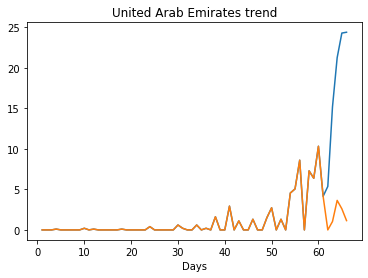

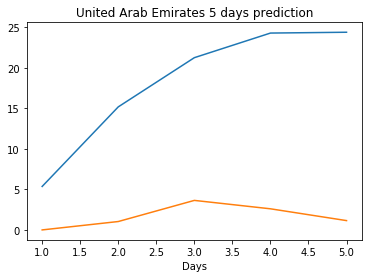

Creating directory ./offline8/India/training/
India
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0062
train error: 0.0010872444391376726
0.006177885457873344
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0077
train error: 0.0010804453447538739
0.007742566522210836
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0098
train error: 0.0011927705451379703
0.009808591566979885
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0084
train error: 0.0010634301937291941
0.008438161574304104
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0065
train error: 0.0008923305624193745
0.006453871726989746
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0098
train error: 0.0011927705451379703
0.009808591566979885
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0083
train error: 0.0011313118957597605
0.008329144679009914
Saving the b

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0071
train error: 0.0011927705451379703
0.007127617485821247
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0098
train error: 0.0011927705451379703
0.009808591566979885
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0077
train error: 0.0009542505036127598
0.007743106223642826
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0098
train error: 0.0011927705451379703
0.009808591566979885
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0076
train error: 0.0009044179816555698
0.0076155886054039
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0057
train error: 0.0008915683871236979
0.0056872800923883915
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0098
train error: 0.0011927705451379703
0.009808591566979885
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0082
train error: 0.0011366313724465726
0.008151515386998653
Saving th

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0091
train error: 0.001133983331340005
0.00

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0093
train error: 0.0011438554893478188
0.009296323172748089
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0097
train error: 0.0010905043225648114
0.009664828889071941
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0084
Sa

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0089
train error: 0.002690342627465725
0.008908654563128948
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0087
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0091
Saving the best model weights at E

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0090
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [

train error: 0.000991356388112763
0.005782017018646002
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0042
train error: 0.0014461338423037281
0.004226227756589651
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0071
Sa

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0048
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0082
train error: 0.0009288476091266299
0.008219546638429165
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0065
train error: 0.0012310533250759665
0.0064671896398067474
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0069
train error: 0.0011721345887053757
0.006865916308015585
Saving the bes

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0019
train error: 0.00089775856504275
0.0019217977533116937
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0045
train error: 0.001776028391517078
0.004482582677155733
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0088
train error: 0.0011264607152649357
0.008786343038082123
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0092
Saving the best mo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0230
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0101
train error: 0.007627113458390037
0.010076157748699188
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0096
Saving the best model weights at Ep

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0093
train error: 0.0013675501293619163
0.009293997660279274
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [2], Best

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0046
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0063
train error: 0.0034773927181959152
0.006263829302042723
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0092
Saving the best model weights at Epo

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0111
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0097
train error: 0.00806869858254989
0.009735836647450924
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0102
train error: 0.001649458199972287
0.010170496068894863
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0086
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0084
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0069
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0131
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0175
train error: 0.012552168965339661
0.017531782388687134
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0104
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0098
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0061
train error: 0.003393499126347403
0.006117044482380152
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0112
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0070
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0108
train error: 0.0033756256918422876
0.010818826965987682
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0042
train error: 0.00213840784272179
0.0042140306904911995
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0059
train error: 0.0020064198838857313
0.005890291184186935
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0068
Saving the

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0214
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0108
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0042
train error: 0.004395458979221682
0.004202204756438732
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0084
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0077
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0160
train error: 0.036644618523617584
0.015972057357430458
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0119
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0283
train error: 0.033163809403777125
0.02832549624145031
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0056
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0090
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0058
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0076
Saving the best model weights at E

train error: 0.004394011835878094
0.0014098206302151084
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [14], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0303
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0043
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0083
train error: 0.0057195407260830205
0.008252996951341629
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0028
train error: 0.0030927749583497645
0.0027698755729943514
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0051
train error: 0.001958675797019775
0.005103850271552801
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0082
Saving t

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0168
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0084
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0105
train error: 0.0051595055653403206
0.010489041917026043
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0086
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0086
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0111
train error: 0.007582526211626828
0.011149226687848568
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0106
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0074
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0071
train error: 0.002306489277786265
0.007076237350702286
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0046
train error: 0.002970643089308093
0.004608625546097755
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [3], Best Valid Loss: 0.01

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0083
Saving the best model weights at Epoch

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0033
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0092
train error: 0.002746983190687994
0.009207637049257755
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [3], Best V

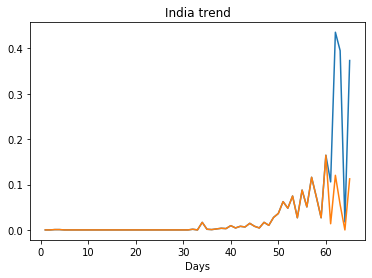

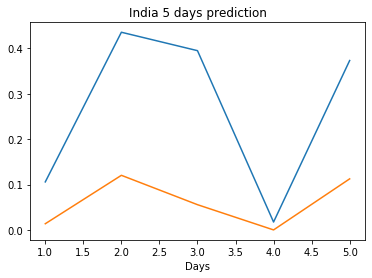

Creating directory ./offline8/Nepal/training/
Nepal
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0005
train error: 9.837974707644597e-05
0.00047319428995251656
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
train error: 9.821796413364479e-05
0.0004314969410188496
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
train error: 0.00010096461379102298
0.0004711681976914406
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
Saving the best model weig

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
train error: 9.788560744579756e-05
0.00041362197953276336
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0005
train error: 0.00010122963337327714
0.00047119110240601003
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
train error: 0.00010096461379102298
0.0004711681976914406
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Savin

train error: 9.986303813970413e-05
0.00047183511196635664
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
train error: 9.432402488788025e-05
0.00039439304964616895
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
train error: 9.827708200386302e-05
0.00047199364053085446
Saving th

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0005
train error: 9.729674265405006e-05
0.00047499057836830616
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [4], Best

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0004
train error: 9.763908624985821e-05
0.00044093243195675313
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0002
train error: 9.576078104406146e-05
0.00015861017163842916
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Ep

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [19

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0024
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0006
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0007
train error: 0.0004201846864556761
0.0006662405212409794
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [2], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0019
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0044
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
train error: 9.556043448485849e-05
0.0004357675206847489
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [13], Best Valid

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
train error: 9.34093917489268e-05
0.0004041228094138205
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [11], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0027
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0027
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 0.0004231690350154947
0.00041242424049414694
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [6], Best V

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0002
train error: 0.00013445009878653634


Saving the best model weights at Epoch [46], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0014
train error: 0.0011468423613613206
0.0013750930083915591
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [9], Best Valid

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0002
train error: 0.0004716695124183648
0.0001839311298681423
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
train error: 0.00010096461379102298
0.0004711681976914406
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [8], Best Valid Loss: 0.00

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 0.00021810461309671933
0.0003541430633049458
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0003
train error: 9.855034732026979e-05
0.00027223696815781295
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0092
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0006
train error: 0.0004931605304591358
0.0005507168243639171
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [9], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0029
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0081
train error: 0.008366165948765618
0.008067202754318714
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0069
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0038
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0212
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0052
train error: 0.005089072557166219
0.005197868682444096
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0021
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0010
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0023
train error: 0.003587693641228335
0.0023241890594363213
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [5], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0084
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0025
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0046
train error: 0.004058437674705471
0.004644565284252167
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0027
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0177
train error: 0.019332502888781685
0.017700275406241417
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0052
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0021
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0343
train error: 0.037171931192278865
0.03434009104967117
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0024
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0063
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0075
train error: 0.008968453774494784
0.007491108030080795
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0013
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0347
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0039
train error: 0.0034597149251827173
0.003931332845240831
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [11], Best Valid 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0044
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0023
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0074
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0119
train error: 0.012135053372808865
0.011908655054867268
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0051
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0041
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0018
train error: 0.00133657587243111
0.0018360101385042071
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0115
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0113
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0017
train error: 0.0013068247079250535
0.0017056772485375404
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [10], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0048
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0011
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0002
train error: 0.0012495950795710087
0.00019895598234143108
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [13], Best Vali

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0050
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0051
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0018
train error: 0.0017947489844768174
0.0018321126699447632
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [13], Best Valid

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0026
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0391
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0019
train error: 0.00255560643438782
0.0019161247182637453
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0012
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0028
train error: 0.0022939789541331786

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0011
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0097
train error: 0.00915001251601747
0.00968526303768158
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0091
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0090
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0036
train error: 0.005635864946192929
0.003610240761190653
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0025
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0207
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0131
train error: 0.013434665543692452
0.013118579983711243
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0011
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0017
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0016
train error: 0.0012574515529974763
0.0016416761791333556
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [10], Best Valid

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0034
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0015
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0037
Saving the best model weights at E

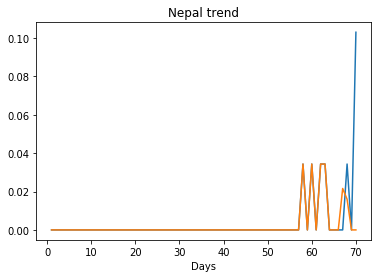

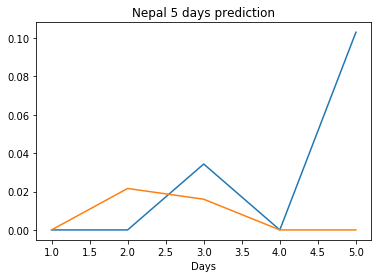

Creating directory ./offline8/Sri Lanka/training/
Sri Lanka
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0256
train error: 0.04341574097193326
0.025562971830368042
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0335
train error: 0.047836460938428485
0.03345007821917534
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0223
train error: 0

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0285
train error: 0.06285011510816262
0.028541196137666702
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0333
train error: 0.07128223511355111
0.033257972449064255
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0329
train error: 0.05758931193585423
0.03290022164583206
Saving the best 

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0224
train error: 0.0635227938464871
0.022398177534341812
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0201
train error: 0.06403702081209331
0.020088357850909233
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0228
train error: 0.07128223511355111
0.022806977853178978
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0119
train error: 0.0534289

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0113
train error: 0.035910187656003414
0.011315315961837769
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0121
train error: 0.04826431168299733
0.012067373842000961
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0177
train error: 0.05332447088916193
0.01770230568945408
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0127
Saving t

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0146
train error: 0.05754543081716155
0.014633421786129475
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0179
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0188
train error: 0.0522139681164514
0.01883234642446041
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0327
train error: 0.05706479110416363
0.03273021802306175
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0367
train error: 0.057888684483865895
0.036678701639175415
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0371
Savi

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0326
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0396
Saving the best model weights at E

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0430
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0430
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0427
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0324
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0204
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0310
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0267
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0147
train error: 0.0501599429372811
0.014663797803223133
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0351
Saving the best model weights at Epoch

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0337
train error: 0.06708317604903696
0.033693838864564896
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0278
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0236
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0235
Saving the best model weights at Epoc

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0364
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0331
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0152
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0233
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0364
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0309
train error: 0.06119767481559944
0.030902475118637085
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0211
train error: 0.05688040318306197
0

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0440
train error: 0.06964741212648347
0.044012900441884995
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0393
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0386
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0359
train error: 0.0636303518955229
0.035942528396844864
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0325
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0361
train error: 0.06054093290797689
0.03612769767642021
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0311
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0234
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0428
train error: 0.060652973892336544
0.04284611716866493
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0269
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0283
train error: 0.0636048587321332
0.028309941291809082
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0487
train error: 0.06694075600667433
0.04869803413748741
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0293
Sa

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0263
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0436
Saving the best model weights at E

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0461
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0349
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0201
Saving the best model weights at E

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0331
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0197
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0188
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0305
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0168
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0285
train error: 0.058464308876092684
0.028521111235022545
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0518
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0330
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0399
train error: 0.0601397736393141
0.03987548127770424
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0286
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0374
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0468
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0368
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0422
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0427
train error: 0.06869166711818031
0

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0451
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0457
train error: 0.07070687979795008
0.04571735858917236
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0288
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0195
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0475
train error: 0.06396266702336795
0.047482091933488846
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0329
train error: 0.06268497212140849
0.0328679233789444
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0207
train error: 0.061494021895200465
0.02069522999227047
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0490
Saving the best

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0449
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0458
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0255
train error: 0.0601669771977785
0.025524133816361427
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0428
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0411
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0205
train error: 0.05430600241842595
0.02052663080394268
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0385
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0504
train error: 0.06369547579776157
0.05038950964808464
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0356
train error: 0.06568881765071471
0.03559476137161255
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0315
S

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0296
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0411
train error: 0.06486741690473123
0.0410664826631546
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0355
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0355
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0423
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0040
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0437
train error: 0.05936952810170072
0.043724846094846725
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0474
Saving the best model weights at Ep

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0403
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0318
train error: 0.05523522827548511
0.031785931438207626
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0299
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0392
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0319
train error: 0.06015690806265356
0.03189779072999954
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0294
Saving the best model weights at E

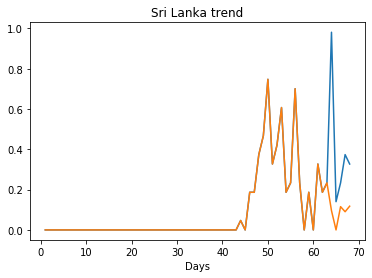

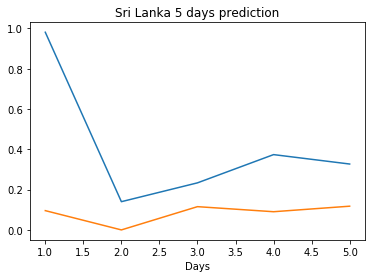

Creating directory ./offline8/Taiwan*/training/
Taiwan*
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1719
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1493
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1460
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1037
train error: 0.06961812562382731
0.10367859899997711
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2348
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2293
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2088
Saving

train error: 0.13343574303067535
0.18207895755767822
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2242
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1988
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1020
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0865
train error: 0.0643367940547729
0.08653353154659271
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2728
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2635
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2597
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2536
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2453
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2447
Savi

Saving the best model weights at Epoch [3], Best Valid Loss: 0.3195
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3083
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3029
train error: 0.17808340955525637
0.30292075872421265
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2869
train error: 0.19303104096386386
0.2868584990501404
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2698
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2561
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2522
train error: 0.1671305082762908
0.2521889805793762
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1626
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1598
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1446
train error: 0.1366748254207012
0.14464828372001648
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [7], Best Valid Loss: 0.2512
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2476
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2452
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2434
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2415
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2405
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2395
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2387
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2382
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2375
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2373
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2366
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2365
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2362
Saving the best model weights at Epoc

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1842
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1803
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1770
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1741
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1722
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1697
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1675
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1658
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1645
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1631
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1622
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1608
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1588
Saving the best model weights at Ep

Saving the best model weights at Epoch [49], Best Valid Loss: 0.2832
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2830
train error: 0.1534720399466
0.2830430269241333
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3618
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3318
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3095
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2944
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2834
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2766
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2699
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2661
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2578
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2347
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2177
Saving the best model weights at Epoch [12], Best Valid Loss: 0.

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3146
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2809
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2714
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2644
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2601
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2565
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2540
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2512
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2479
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2472
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2464
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2448
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1901
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1888
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1881
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1877
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1873
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1869
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1868
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1866
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1863
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1861
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1857
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.2684
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2628
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2581
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2543
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2510
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2485
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2464
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2447
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2434
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2422
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2414
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2407
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2401
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2398
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [6], Best Valid Loss: 0.2609
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2559
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2525
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2474
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2456
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2436
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2423
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2409
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2400
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2397
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2393
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2388
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2385
Saving the best model weights at Epoch

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1987
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1968
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1952
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1945
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1928
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1919
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1913
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1906
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1903
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1900
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1900
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1898
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1893
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1887
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1833
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1822
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1822
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1814
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1793
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1792
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1782
train error: 0.13317191664521633
0.1782243251800537
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2969
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2935
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2914
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [15], Best Vali

Saving the best model weights at Epoch [49], Best Valid Loss: 0.1787
train error: 0.15201061498373747
0.17865438759326935
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2603
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2563
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2529
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2501
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2480
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2464
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2447
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2438
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2428
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2424
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2417
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2412
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [25], Best Valid Loss: 0.2934
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2931
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2931
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2929
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2928
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2927
train error: 0.16026542465643664
0.2927266061306
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3282
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3169
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3096
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3056
Saving the best model weights at Epoch [5], Best Valid Los

Saving the best model weights at Epoch [33], Best Valid Loss: 0.2427
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2420
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2413
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2406
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2400
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2394
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2387
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2381
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2375
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2369
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2363
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2357
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2352
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2346
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.2821
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2814
train error: 0.1637046778831925
0.2814437448978424
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3147
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3130
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3112
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3093
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3073
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3053
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3030
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3006
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2980
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2954
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2929
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [35], Best Valid Loss: 0.2854
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2841
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2829
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2817
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2805
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2794
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2783
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2772
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2761
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2751
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2741
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2731
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2721
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2712
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 0.3131
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3107
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3083
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3061
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3038
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3016
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2995
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2974
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2954
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2934
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2914
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2895
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2877
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2858
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.2185
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2169
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2164
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2159
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2128
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2123
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2108
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2104
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2101
train error: 0.1373958498925755
0.21013222634792328
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [5], Best Valid Loss: 0.2462
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2389
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2336
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2306
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2252
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2218
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2215
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2169
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2143
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2132
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2120
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2115
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2105
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2086
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3305
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3179
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3080
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3009
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2937
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2896
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2812
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2788
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2768
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2756
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2732
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2707
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [45], Best Valid Loss: 0.2240
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2235
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2230
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2225
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2218
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2215
train error: 0.14933071917805232
0.22153063118457794
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2754
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2590
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2457
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2358
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2281
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2117
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [39], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2360
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2350
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2339
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2329
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2321
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2312
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2305
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2296
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2288
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2282
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2276
train error: 0.1500477945235999
0.22761347889900208
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2967
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3073
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3071
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3068
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3065
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3062
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3057
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3056
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3053
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3051
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3050
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3047
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3046
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3044
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.2807
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2800
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2793
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2787
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2780
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2773
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2767
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2761
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2756
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2751
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2746
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2741
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2736
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2732
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.2414
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2394
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2372
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2353
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2335
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2316
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2284
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2267
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2252
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2239
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2225
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2198
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 0.2807
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2780
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2728
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2704
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2682
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2639
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2617
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2598
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2579
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2563
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2543
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2527
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.2574
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2553
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2537
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2522
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2505
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2490
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2472
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2458
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2444
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2433
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2419
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2406
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2395
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2384
Saving the best model weights at Epoch

Saving the best model weights at Epoch [50], Best Valid Loss: 0.2510
train error: 0.14485411974601448
0.251045823097229
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3257
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3212
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3168
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3126
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3086
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3048
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3012
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2977
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2944
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2913
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2881
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2850
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [43], Best Valid Loss: 0.2767
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2758
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2742
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2734
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2726
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2718
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2711
train error: 0.14871927427961246
0.2710990309715271
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3057
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3032
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3009
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2987
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2966
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [33], Best Valid Loss: 0.3004
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2988
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2981
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2973
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2966
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2959
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2952
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2945
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2938
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2931
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2925
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2919
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2913
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.2251
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2243
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2236
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2229
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2222
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2215
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2208
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2202
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2195
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2189
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2183
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2177
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2171
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2165
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.3071
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3067
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3064
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3061
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3058
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3055
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3050
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3047
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3044
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3042
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3039
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3037
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3034
Saving the best model weights at E

Saving the best model weights at Epoch [17], Best Valid Loss: 0.3340
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3333
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3325
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3318
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3311
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3297
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3290
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3284
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3278
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3272
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3266
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3260
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3254
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.3309
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3288
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3268
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3248
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3210
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3174
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3156
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3139
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3123
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3106
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3075
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.2194
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2194
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2193
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2193
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2192
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2192
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2191
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2191
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2191
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2190
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2190
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2189
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2189
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2188
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2858
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2851
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2843
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2837
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2828
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2822
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2815
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2808
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2801
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2795
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2788
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2781
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2777
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2771
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.3113
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3111
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3109
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3107
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3105
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3102
train error: 0.16993510038714463
0.31023719906806946
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3171
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3164
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3156
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3151
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3145
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3136
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3130
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3497
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3491
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3485
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3482
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3479
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3476
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3473
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3470
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3468
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3465
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.3200
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3197
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3194
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3188
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3185
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3183
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3180
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3177
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3174
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3172
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3169
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3166
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3163
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.2791
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2791
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2791
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2790
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2790
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2790
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2790
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2789
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2789
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2789
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2788
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2788
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2788
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2788
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.2382
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2356
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2344
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2321
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2298
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2284
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2260
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2241
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2228
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2191
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2176
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2160
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2141
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.3427
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3421
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3416
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3411
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3405
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3400
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3395
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3389
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3384
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3379
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3374
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3369
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3364
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3359
train error: 0.17739141224209512
0

Saving the best model weights at Epoch [5], Best Valid Loss: 0.3552
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3543
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3535
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3529
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3520
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3514
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3507
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3493
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3474
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3468
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3462
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.3326
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3324
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3321
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3316
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3314
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3311
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3309
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3306
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3301
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3299
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3296
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3294
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.3322
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3321
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3318
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3317
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3316
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3315
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3314
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3313
train error: 0.1778524483701116
0.3313017785549164
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3734
train error: 0.19303104096386386
0.37338757514953613
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3210
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3205
Sa

Saving the best model weights at Epoch [7], Best Valid Loss: 0.3587
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3578
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3576
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3573
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3570
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3568
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3562
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3559
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3557
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3551
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.2965
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2963
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2961
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2959
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2957
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2954
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2952
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2950
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2948
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2946
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2945
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2941
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.2953
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2950
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2944
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2940
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2935
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2928
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2921
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2917
train error: 0.16825600817039804
0.29170385003089905
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3492
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3485
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3482
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3479
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.2848
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2808
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2790
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2772
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2753
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2736
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2718
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2700
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2683
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2667
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2650
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2636
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2621
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.3168
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3164
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3162
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3159
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3156
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3153
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3150
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3147
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3144
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3141
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3139
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3137
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3134
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3131
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.2875
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2873
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2869
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2867
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2864
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2861
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2858
train error: 0.16601790264432661
0.2857728600502014
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2910
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2892
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2868
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2844
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2825
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2807
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 0.3388
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3385
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3381
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3378
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3372
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3369
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3366
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3363
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3360
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3357
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3354
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3348
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3501
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3501
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3498
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3498
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3497
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3496
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3495
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3495
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3493
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3493
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.3184
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3181
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3176
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3173
train error: 0.16543350487604344
0.31727683544158936
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3734
train error: 0.19303104096386386
0.37338757514953613
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3355
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3354
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3352
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3350
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3349
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3347
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3345
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3343
Saving

Saving the best model weights at Epoch [14], Best Valid Loss: 0.2983
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2981
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2979
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2977
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2975
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2973
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2971
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2969
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2967
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2966
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2964
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2962
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2960
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2958
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.2949
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2946
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2939
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2933
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2927
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2923
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2917
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2914
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2907
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2903
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2894
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2889
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2886
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.2928
train error: 0.15844240673131457
0.2927960753440857
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3734
train error: 0.19303104096386386
0.37338757514953613
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3386
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3383
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3381
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3379
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3377
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3374
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3372
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3370
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3368
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3366
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3364
Saving t

Saving the best model weights at Epoch [16], Best Valid Loss: 0.3490
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3485
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3473
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3467
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3461
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3454
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3439
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3435
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3430
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3425
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3420
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3533
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3340
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3340
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3340
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3339
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3339
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3339
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3339
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3338
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3338
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3338
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3338
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3338
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3337
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3337
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.3555
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3555
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3552
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3552
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3552
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3551
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3551
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.3182
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3182
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3182
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3181
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3181
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3181
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3181
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3180
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3180
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3180
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3180
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3179
train error: 0.17398815040207027
0.3179377019405365
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3368
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3192
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.2789
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2788
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2787
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2786
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2785
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2784
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2783
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2782
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2781
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2780
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2779
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2777
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2776
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.3497
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3497
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3497
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3497
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3496
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3496
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3496
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3496
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3496
train error: 0.18445814007013964
0.34960660338401794
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2865
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2861
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2858
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3641
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3640
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3640
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3640
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3640
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3640
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3639
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3639
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3639
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3639
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3639
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3638
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3638
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3638
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.3100
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3099
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3099
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3098
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3098
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3098
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3097
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3097
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3096
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3096
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3095
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3095
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3095
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3094
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.3690
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3690
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3689
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3689
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3688
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3688
train error: 0.18898162564207605
0.36876553297042847
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3538
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3538
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3537
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3537
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3537
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3537
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3537
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.3054
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3050
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3048
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3045
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3042
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3038
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3035
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3033
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3031
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3028
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3026
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3024
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3335
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.3596
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3596
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3596
train error: 0.18138833325754508
0.35958969593048096
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3665
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3665
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3665
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3665
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3664
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3664
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3664
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3664
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3664
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3664
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3278
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3278
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3278
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3278
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3278
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.3103
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3100
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3097
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3095
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3087
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3084
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3082
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3080
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3077
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3074
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3072
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3069
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.2081
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2080
train error: 0.14406774656258917
0.2080308496952057
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3427
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3427
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3426
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3426
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3426
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3425
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3425
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3425
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3424
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3424
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3424
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3554
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3553
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3553
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3268
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3268
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3267
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3267
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3267
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3267
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3266
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3266
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3266
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3266
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3265
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3265
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3265
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3265
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3734
train error: 0.19303104096386386
0.37338757514953613
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3428
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3425
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3422
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3420
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3417
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3415
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3412
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3410
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3407
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3404
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3401
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3399
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.2021
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2021
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2021
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2021
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2018
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.3381
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3381
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3380
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3380
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3380
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3380
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3380
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3380
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3380
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3379
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3379
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3379
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3379
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3379
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3019
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3018
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3017
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3016
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3016
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3015
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3014
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3014
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3013
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3012
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3012
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3011
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3010
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3010
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.3286
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3286
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3286
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3285
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3285
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3285
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3285
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3284
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3284
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3284
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3283
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3283
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3283
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3283
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3060
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3060
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.2901
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2901
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2900
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2900
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2900
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2900
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2898
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2898
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2898
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2898
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3622
train error: 0.18771371379721372
0.36219629645347595
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3127
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3558
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3557
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2181
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.2699
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2699
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2699
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2699
train error: 0.1535167816144071
0.269853413105011
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3734
train error: 0.19303104096386386
0.37338757514953613
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3502
Saving th

Saving the best model weights at Epoch [11], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3540
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3192
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.3529
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3529
train error: 0.18421705658271859
0.35286831855773926
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3279
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3329
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3329
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3329
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3329
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3329
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3329
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3329
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3328
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3328
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3328
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3328
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3328
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3328
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3328
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3499
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3091
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3563
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3563
train error: 0.1866754084690719
0.

Saving the best model weights at Epoch [5], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3259
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3494
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2968
train error: 0.1680879134770581
0.29681578278541565
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3179
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3179
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3178
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3444
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3375
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2107
train error: 0.1456586736450462
0.21068024635314941
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3560
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3560
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3560
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3560
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3560
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3560
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3560
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 0.3055
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3054
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3054
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3054
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3054
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3053
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3053
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3053
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3053
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3051
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3418
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3418
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.3517
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3517
train error: 0.1780959097545986
0.35169824957847595
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [12], Best Valid Loss

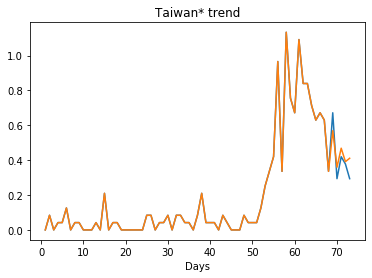

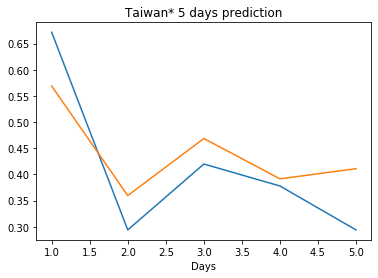

Creating directory ./offline8/Korea, South/training/
Korea, South
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1189
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2252
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9584
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8317
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8142
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7997
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7957
Saving the best model weights at Epoch [32], Best Valid Loss: 0.6767
train error: 38.96461068956476
0.6766676306724548
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5210
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2731
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0191
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9077
train error: 28.57484728725333
0.9076828360557556
Saving the 

Saving the best model weights at Epoch [6], Best Valid Loss: 1.1025
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3915
train error: 51.918048695514074
0.3914612829685211
Saving the best model weights at Epoch [1], Best Valid Loss: 20.6492
Saving the best model weights at Epoch [2], Best Valid Loss: 17.3116
train error: 163.34285581739326
17.311628341674805
Saving the best model weights at Epoch [1], Best Valid Loss: 20.6545
Saving the best model weights at Epoch [2], Best Valid Loss: 16.5016
Saving the best model weights at Epoch [3], Best Valid Loss: 13.1417
Saving the best model weights at Epoch [7], Best Valid Loss: 9.0683
Saving the best model weights at Epoch [12], Best Valid Loss: 6.8233
Saving the best model weights at Epoch [13], Best Valid Loss: 5.9585
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6043
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4930
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4614
Sav

train error: 163.34285581739326
17.311628341674805
Saving the best model weights at Epoch [1], Best Valid Loss: 17.3116
train error: 163.34285581739326
17.311628341674805
Saving the best model weights at Epoch [1], Best Valid Loss: 43.4545
Saving the best model weights at Epoch [4], Best Valid Loss: 17.7378
Saving the best model weights at Epoch [9], Best Valid Loss: 14.9110
Saving the best model weights at Epoch [29], Best Valid Loss: 13.5846
Saving the best model weights at Epoch [40], Best Valid Loss: 13.2166
train error: 163.34285581739326
13.216644287109375
Saving the best model weights at Epoch [1], Best Valid Loss: 18.9529
Saving the best model weights at Epoch [2], Best Valid Loss: 18.1839
Saving the best model weights at Epoch [3], Best Valid Loss: 15.5402
Saving the best model weights at Epoch [5], Best Valid Loss: 7.1499
Saving the best model weights at Epoch [7], Best Valid Loss: 1.8000
Saving the best model weights at Epoch [18], Best Valid Loss: 1.4499
Saving the best mod

Saving the best model weights at Epoch [1], Best Valid Loss: 0.6316
Saving the best model weights at Epoch [28], Best Valid Loss: 0.5425
train error: 8.970100306342111
0.5424502491950989
Saving the best model weights at Epoch [1], Best Valid Loss: 26.6828
Saving the best model weights at Epoch [2], Best Valid Loss: 9.5472
Saving the best model weights at Epoch [3], Best Valid Loss: 9.0078
Saving the best model weights at Epoch [6], Best Valid Loss: 1.6703
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2180
train error: 16.868592390888615
1.2179781198501587
Saving the best model weights at Epoch [1], Best Valid Loss: 6.5788
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3994
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3009
Saving the best model weights at Epoch [5], Best Valid Loss: 1.9306
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8540
Saving the best model weights at Epoch [7], Best Valid Loss: 0.5531
train error:

train error: 24.05650034076289
0.6950157284736633
Saving the best model weights at Epoch [1], Best Valid Loss: 19.9535
Saving the best model weights at Epoch [2], Best Valid Loss: 17.5481
Saving the best model weights at Epoch [5], Best Valid Loss: 2.3837
Saving the best model weights at Epoch [7], Best Valid Loss: 2.1640
Saving the best model weights at Epoch [10], Best Valid Loss: 2.0666
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1418
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9952
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3648
train error: 33.13624805212021
0.36481502652168274
Saving the best model weights at Epoch [1], Best Valid Loss: 6.6277
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8857
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8026
train error: 18.606272786071425
0.8025667071342468
Saving the best model weights at Epoch [1], Best Valid Loss: 4.7549
Saving the best model weig

Saving the best model weights at Epoch [7], Best Valid Loss: 0.9593
train error: 19.42322585614104
0.959251344203949
Saving the best model weights at Epoch [1], Best Valid Loss: 18.0956
Saving the best model weights at Epoch [5], Best Valid Loss: 11.9802
Saving the best model weights at Epoch [18], Best Valid Loss: 4.5586
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5945
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3782
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3182
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9773
train error: 22.959469114479266
0.9773320555686951
Saving the best model weights at Epoch [1], Best Valid Loss: 6.2452
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3111
train error: 74.2154616431186
1.311087727546692
Saving the best model weights at Epoch [1], Best Valid Loss: 11.7536
train error: 127.512822402151
11.753560066223145
Saving the best model weights at Epoch [1], Bes

Saving the best model weights at Epoch [2], Best Valid Loss: 1.2940
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7952
train error: 9.76447242576825
0.7951682209968567
Saving the best model weights at Epoch [1], Best Valid Loss: 16.1049
Saving the best model weights at Epoch [2], Best Valid Loss: 12.9180
Saving the best model weights at Epoch [3], Best Valid Loss: 8.6338
Saving the best model weights at Epoch [4], Best Valid Loss: 5.3078
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2863
Saving the best model weights at Epoch [6], Best Valid Loss: 1.5901
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2801
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9348
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7881
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7669
train error: 14.459580414781446
0.7669030427932739
Saving the best model weights at Epoch [1], Best Valid Loss: 11.1420
Saving the b

Saving the best model weights at Epoch [22], Best Valid Loss: 11.6023
Saving the best model weights at Epoch [23], Best Valid Loss: 11.1348
Saving the best model weights at Epoch [24], Best Valid Loss: 10.7028
Saving the best model weights at Epoch [25], Best Valid Loss: 10.3085
Saving the best model weights at Epoch [26], Best Valid Loss: 9.9581
Saving the best model weights at Epoch [27], Best Valid Loss: 9.6546
Saving the best model weights at Epoch [28], Best Valid Loss: 9.3881
Saving the best model weights at Epoch [29], Best Valid Loss: 9.1705
Saving the best model weights at Epoch [30], Best Valid Loss: 8.9878
Saving the best model weights at Epoch [31], Best Valid Loss: 8.8385
Saving the best model weights at Epoch [32], Best Valid Loss: 8.7143
Saving the best model weights at Epoch [33], Best Valid Loss: 8.6107
Saving the best model weights at Epoch [34], Best Valid Loss: 8.5281
Saving the best model weights at Epoch [35], Best Valid Loss: 8.4422
Saving the best model weights 

Saving the best model weights at Epoch [4], Best Valid Loss: 14.5844
Saving the best model weights at Epoch [5], Best Valid Loss: 13.9849
Saving the best model weights at Epoch [6], Best Valid Loss: 13.2648
Saving the best model weights at Epoch [7], Best Valid Loss: 12.3014
Saving the best model weights at Epoch [8], Best Valid Loss: 11.2890
Saving the best model weights at Epoch [9], Best Valid Loss: 10.2082
Saving the best model weights at Epoch [10], Best Valid Loss: 9.0564
Saving the best model weights at Epoch [11], Best Valid Loss: 7.8557
Saving the best model weights at Epoch [12], Best Valid Loss: 6.7115
Saving the best model weights at Epoch [13], Best Valid Loss: 5.7162
Saving the best model weights at Epoch [14], Best Valid Loss: 5.0111
Saving the best model weights at Epoch [15], Best Valid Loss: 4.6730
Saving the best model weights at Epoch [16], Best Valid Loss: 4.6370
train error: 74.07767498493195
4.637042045593262
Saving the best model weights at Epoch [1], Best Valid

Saving the best model weights at Epoch [41], Best Valid Loss: 9.8870
Saving the best model weights at Epoch [42], Best Valid Loss: 9.1534
Saving the best model weights at Epoch [43], Best Valid Loss: 8.5930
Saving the best model weights at Epoch [44], Best Valid Loss: 8.1129
Saving the best model weights at Epoch [45], Best Valid Loss: 7.7381
Saving the best model weights at Epoch [46], Best Valid Loss: 7.4121
Saving the best model weights at Epoch [47], Best Valid Loss: 7.1251
Saving the best model weights at Epoch [48], Best Valid Loss: 6.8756
Saving the best model weights at Epoch [49], Best Valid Loss: 6.6482
Saving the best model weights at Epoch [50], Best Valid Loss: 6.4471
train error: 53.768022283127436
6.447078227996826
Saving the best model weights at Epoch [1], Best Valid Loss: 17.3116
train error: 163.34285581739326
17.311628341674805
Saving the best model weights at Epoch [1], Best Valid Loss: 16.5973
Saving the best model weights at Epoch [2], Best Valid Loss: 16.1192
Sa

Saving the best model weights at Epoch [8], Best Valid Loss: 7.3805
Saving the best model weights at Epoch [9], Best Valid Loss: 6.3093
Saving the best model weights at Epoch [10], Best Valid Loss: 6.1970
Saving the best model weights at Epoch [12], Best Valid Loss: 4.1754
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7008
train error: 46.873823749391654
3.7008137702941895
Saving the best model weights at Epoch [1], Best Valid Loss: 15.9473
Saving the best model weights at Epoch [2], Best Valid Loss: 15.1595
Saving the best model weights at Epoch [3], Best Valid Loss: 14.4143
Saving the best model weights at Epoch [4], Best Valid Loss: 13.7113
Saving the best model weights at Epoch [5], Best Valid Loss: 13.0403
Saving the best model weights at Epoch [6], Best Valid Loss: 12.4085
Saving the best model weights at Epoch [7], Best Valid Loss: 11.8045
Saving the best model weights at Epoch [8], Best Valid Loss: 11.2364
Saving the best model weights at Epoch [9], Best Valid

Saving the best model weights at Epoch [22], Best Valid Loss: 3.8657
train error: 57.40794415615107
3.8656532764434814
Saving the best model weights at Epoch [1], Best Valid Loss: 16.4007
Saving the best model weights at Epoch [2], Best Valid Loss: 15.7947
Saving the best model weights at Epoch [3], Best Valid Loss: 15.2167
Saving the best model weights at Epoch [4], Best Valid Loss: 14.6709
Saving the best model weights at Epoch [5], Best Valid Loss: 14.1536
Saving the best model weights at Epoch [6], Best Valid Loss: 13.6629
Saving the best model weights at Epoch [7], Best Valid Loss: 13.1989
Saving the best model weights at Epoch [8], Best Valid Loss: 12.7575
Saving the best model weights at Epoch [9], Best Valid Loss: 12.3375
Saving the best model weights at Epoch [10], Best Valid Loss: 11.9410
Saving the best model weights at Epoch [11], Best Valid Loss: 11.5649
Saving the best model weights at Epoch [12], Best Valid Loss: 11.2096
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [11], Best Valid Loss: 11.3253
Saving the best model weights at Epoch [12], Best Valid Loss: 11.0456
Saving the best model weights at Epoch [13], Best Valid Loss: 10.7973
Saving the best model weights at Epoch [14], Best Valid Loss: 10.5789
Saving the best model weights at Epoch [15], Best Valid Loss: 10.3866
Saving the best model weights at Epoch [16], Best Valid Loss: 10.2246
Saving the best model weights at Epoch [17], Best Valid Loss: 10.0924
Saving the best model weights at Epoch [18], Best Valid Loss: 9.9905
Saving the best model weights at Epoch [19], Best Valid Loss: 9.9175
Saving the best model weights at Epoch [20], Best Valid Loss: 9.8744
Saving the best model weights at Epoch [21], Best Valid Loss: 9.8623
train error: 111.91353372523659
9.862292289733887
Saving the best model weights at Epoch [1], Best Valid Loss: 16.6753
Saving the best model weights at Epoch [2], Best Valid Loss: 16.4008
Saving the best model weights at Epoch [3], Be

Saving the best model weights at Epoch [24], Best Valid Loss: 14.0228
Saving the best model weights at Epoch [25], Best Valid Loss: 14.0053
Saving the best model weights at Epoch [26], Best Valid Loss: 13.7880
Saving the best model weights at Epoch [27], Best Valid Loss: 13.4875
Saving the best model weights at Epoch [28], Best Valid Loss: 13.2093
Saving the best model weights at Epoch [29], Best Valid Loss: 12.9566
Saving the best model weights at Epoch [30], Best Valid Loss: 12.7236
Saving the best model weights at Epoch [31], Best Valid Loss: 12.5152
Saving the best model weights at Epoch [32], Best Valid Loss: 12.3306
Saving the best model weights at Epoch [33], Best Valid Loss: 12.1694
Saving the best model weights at Epoch [34], Best Valid Loss: 12.0326
Saving the best model weights at Epoch [35], Best Valid Loss: 11.9197
Saving the best model weights at Epoch [36], Best Valid Loss: 11.8306
Saving the best model weights at Epoch [37], Best Valid Loss: 11.7685
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 9.6281
Saving the best model weights at Epoch [32], Best Valid Loss: 9.4804
Saving the best model weights at Epoch [33], Best Valid Loss: 9.3446
Saving the best model weights at Epoch [34], Best Valid Loss: 9.2282
Saving the best model weights at Epoch [35], Best Valid Loss: 9.1070
Saving the best model weights at Epoch [36], Best Valid Loss: 9.0142
Saving the best model weights at Epoch [37], Best Valid Loss: 8.9196
Saving the best model weights at Epoch [38], Best Valid Loss: 8.8381
Saving the best model weights at Epoch [39], Best Valid Loss: 8.7602
Saving the best model weights at Epoch [40], Best Valid Loss: 8.6926
Saving the best model weights at Epoch [41], Best Valid Loss: 8.5842
Saving the best model weights at Epoch [42], Best Valid Loss: 8.4792
Saving the best model weights at Epoch [43], Best Valid Loss: 8.3493
Saving the best model weights at Epoch [44], Best Valid Loss: 8.1672
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 8.6797
Saving the best model weights at Epoch [23], Best Valid Loss: 7.9583
Saving the best model weights at Epoch [24], Best Valid Loss: 7.2220
Saving the best model weights at Epoch [25], Best Valid Loss: 6.4957
Saving the best model weights at Epoch [26], Best Valid Loss: 5.7896
Saving the best model weights at Epoch [27], Best Valid Loss: 5.0975
Saving the best model weights at Epoch [28], Best Valid Loss: 4.4386
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8516
Saving the best model weights at Epoch [30], Best Valid Loss: 3.3462
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9268
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5900
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3118
Saving the best model weights at Epoch [34], Best Valid Loss: 2.0783
Saving the best model weights at Epoch [35], Best Valid Loss: 1.8775
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 10.9908
Saving the best model weights at Epoch [12], Best Valid Loss: 9.9420
Saving the best model weights at Epoch [13], Best Valid Loss: 8.7835
Saving the best model weights at Epoch [14], Best Valid Loss: 7.6394
Saving the best model weights at Epoch [15], Best Valid Loss: 6.5817
Saving the best model weights at Epoch [16], Best Valid Loss: 5.6543
Saving the best model weights at Epoch [17], Best Valid Loss: 4.8564
Saving the best model weights at Epoch [18], Best Valid Loss: 4.1666
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5638
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0510
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6292
Saving the best model weights at Epoch [22], Best Valid Loss: 2.2611
Saving the best model weights at Epoch [23], Best Valid Loss: 1.9427
Saving the best model weights at Epoch [24], Best Valid Loss: 1.6883
Saving the best model weights at 

Saving the best model weights at Epoch [3], Best Valid Loss: 17.1811
Saving the best model weights at Epoch [4], Best Valid Loss: 17.1321
Saving the best model weights at Epoch [5], Best Valid Loss: 17.0818
Saving the best model weights at Epoch [6], Best Valid Loss: 17.0318
Saving the best model weights at Epoch [7], Best Valid Loss: 16.9485
Saving the best model weights at Epoch [8], Best Valid Loss: 16.8601
Saving the best model weights at Epoch [9], Best Valid Loss: 16.7695
Saving the best model weights at Epoch [10], Best Valid Loss: 16.6817
Saving the best model weights at Epoch [11], Best Valid Loss: 16.5959
Saving the best model weights at Epoch [12], Best Valid Loss: 16.5112
Saving the best model weights at Epoch [13], Best Valid Loss: 16.4257
Saving the best model weights at Epoch [14], Best Valid Loss: 16.3442
Saving the best model weights at Epoch [15], Best Valid Loss: 16.2612
Saving the best model weights at Epoch [16], Best Valid Loss: 16.1808
Saving the best model weigh

Saving the best model weights at Epoch [46], Best Valid Loss: 13.4255
Saving the best model weights at Epoch [47], Best Valid Loss: 13.3577
Saving the best model weights at Epoch [48], Best Valid Loss: 13.2896
Saving the best model weights at Epoch [49], Best Valid Loss: 13.2220
Saving the best model weights at Epoch [50], Best Valid Loss: 13.1548
train error: 152.87152966072685
13.1548433303833
Saving the best model weights at Epoch [1], Best Valid Loss: 17.3116
train error: 163.34285581739326
17.311628341674805
Saving the best model weights at Epoch [1], Best Valid Loss: 16.0489
Saving the best model weights at Epoch [2], Best Valid Loss: 15.0023
Saving the best model weights at Epoch [3], Best Valid Loss: 14.0778
Saving the best model weights at Epoch [4], Best Valid Loss: 13.1426
Saving the best model weights at Epoch [5], Best Valid Loss: 12.3115
Saving the best model weights at Epoch [6], Best Valid Loss: 11.3981
Saving the best model weights at Epoch [7], Best Valid Loss: 10.580

Saving the best model weights at Epoch [40], Best Valid Loss: 14.2621
Saving the best model weights at Epoch [41], Best Valid Loss: 14.2071
Saving the best model weights at Epoch [42], Best Valid Loss: 14.1544
Saving the best model weights at Epoch [43], Best Valid Loss: 14.1034
Saving the best model weights at Epoch [44], Best Valid Loss: 14.0503
Saving the best model weights at Epoch [45], Best Valid Loss: 13.9990
Saving the best model weights at Epoch [46], Best Valid Loss: 13.9479
Saving the best model weights at Epoch [47], Best Valid Loss: 13.8978
Saving the best model weights at Epoch [48], Best Valid Loss: 13.8500
Saving the best model weights at Epoch [49], Best Valid Loss: 13.7992
Saving the best model weights at Epoch [50], Best Valid Loss: 13.7505
train error: 151.48271714386186
13.750534057617188
Saving the best model weights at Epoch [1], Best Valid Loss: 16.0505
Saving the best model weights at Epoch [2], Best Valid Loss: 14.9650
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [23], Best Valid Loss: 14.3686
Saving the best model weights at Epoch [24], Best Valid Loss: 14.2133
Saving the best model weights at Epoch [25], Best Valid Loss: 14.0518
Saving the best model weights at Epoch [26], Best Valid Loss: 13.8950
Saving the best model weights at Epoch [27], Best Valid Loss: 13.7394
Saving the best model weights at Epoch [28], Best Valid Loss: 13.5774
Saving the best model weights at Epoch [29], Best Valid Loss: 13.4223
Saving the best model weights at Epoch [30], Best Valid Loss: 13.2565
Saving the best model weights at Epoch [31], Best Valid Loss: 13.0945
Saving the best model weights at Epoch [32], Best Valid Loss: 12.9331
Saving the best model weights at Epoch [33], Best Valid Loss: 12.7608
Saving the best model weights at Epoch [34], Best Valid Loss: 12.6004
Saving the best model weights at Epoch [35], Best Valid Loss: 12.4235
Saving the best model weights at Epoch [36], Best Valid Loss: 12.2476
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 13.3239
Saving the best model weights at Epoch [27], Best Valid Loss: 13.2241
Saving the best model weights at Epoch [28], Best Valid Loss: 13.1245
Saving the best model weights at Epoch [29], Best Valid Loss: 13.0253
Saving the best model weights at Epoch [30], Best Valid Loss: 12.9260
Saving the best model weights at Epoch [31], Best Valid Loss: 12.8302
Saving the best model weights at Epoch [32], Best Valid Loss: 12.7365
Saving the best model weights at Epoch [33], Best Valid Loss: 12.6391
Saving the best model weights at Epoch [34], Best Valid Loss: 12.5450
Saving the best model weights at Epoch [35], Best Valid Loss: 12.4511
Saving the best model weights at Epoch [36], Best Valid Loss: 12.3595
Saving the best model weights at Epoch [37], Best Valid Loss: 12.2715
Saving the best model weights at Epoch [38], Best Valid Loss: 12.1811
Saving the best model weights at Epoch [39], Best Valid Loss: 12.0916
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 15.9461
Saving the best model weights at Epoch [9], Best Valid Loss: 15.8040
Saving the best model weights at Epoch [10], Best Valid Loss: 15.6644
Saving the best model weights at Epoch [11], Best Valid Loss: 15.5311
Saving the best model weights at Epoch [12], Best Valid Loss: 15.3937
Saving the best model weights at Epoch [13], Best Valid Loss: 15.2596
Saving the best model weights at Epoch [14], Best Valid Loss: 15.1292
Saving the best model weights at Epoch [15], Best Valid Loss: 14.9952
Saving the best model weights at Epoch [16], Best Valid Loss: 14.8652
Saving the best model weights at Epoch [17], Best Valid Loss: 14.7362
Saving the best model weights at Epoch [18], Best Valid Loss: 14.6092
Saving the best model weights at Epoch [19], Best Valid Loss: 14.4870
Saving the best model weights at Epoch [20], Best Valid Loss: 14.3586
Saving the best model weights at Epoch [21], Best Valid Loss: 14.2388
Saving the best model 

Saving the best model weights at Epoch [48], Best Valid Loss: 14.2704
Saving the best model weights at Epoch [49], Best Valid Loss: 14.1875
Saving the best model weights at Epoch [50], Best Valid Loss: 14.1052
train error: 153.99790418775459
14.105224609375
Saving the best model weights at Epoch [1], Best Valid Loss: 17.1973
Saving the best model weights at Epoch [2], Best Valid Loss: 17.1598
Saving the best model weights at Epoch [3], Best Valid Loss: 17.1243
Saving the best model weights at Epoch [4], Best Valid Loss: 17.0890
Saving the best model weights at Epoch [5], Best Valid Loss: 17.0545
Saving the best model weights at Epoch [6], Best Valid Loss: 17.0200
Saving the best model weights at Epoch [7], Best Valid Loss: 16.9863
Saving the best model weights at Epoch [8], Best Valid Loss: 16.9528
Saving the best model weights at Epoch [9], Best Valid Loss: 16.9205
Saving the best model weights at Epoch [10], Best Valid Loss: 16.8885
Saving the best model weights at Epoch [11], Best V

Saving the best model weights at Epoch [39], Best Valid Loss: 14.9491
Saving the best model weights at Epoch [40], Best Valid Loss: 14.9019
Saving the best model weights at Epoch [41], Best Valid Loss: 14.8550
Saving the best model weights at Epoch [42], Best Valid Loss: 14.8086
Saving the best model weights at Epoch [43], Best Valid Loss: 14.7621
Saving the best model weights at Epoch [44], Best Valid Loss: 14.7160
Saving the best model weights at Epoch [45], Best Valid Loss: 14.6701
Saving the best model weights at Epoch [46], Best Valid Loss: 14.6248
Saving the best model weights at Epoch [47], Best Valid Loss: 14.5792
Saving the best model weights at Epoch [48], Best Valid Loss: 14.5343
Saving the best model weights at Epoch [49], Best Valid Loss: 14.4894
Saving the best model weights at Epoch [50], Best Valid Loss: 14.4448
train error: 156.62029609554693
14.44480037689209
Saving the best model weights at Epoch [1], Best Valid Loss: 17.3116
train error: 163.34285581739326
17.311628

Saving the best model weights at Epoch [9], Best Valid Loss: 15.4303
Saving the best model weights at Epoch [10], Best Valid Loss: 15.2913
Saving the best model weights at Epoch [11], Best Valid Loss: 15.1572
Saving the best model weights at Epoch [12], Best Valid Loss: 15.0271
Saving the best model weights at Epoch [13], Best Valid Loss: 14.8910
Saving the best model weights at Epoch [14], Best Valid Loss: 14.7630
Saving the best model weights at Epoch [15], Best Valid Loss: 14.6327
Saving the best model weights at Epoch [16], Best Valid Loss: 14.5055
Saving the best model weights at Epoch [17], Best Valid Loss: 14.3798
Saving the best model weights at Epoch [18], Best Valid Loss: 14.2546
Saving the best model weights at Epoch [19], Best Valid Loss: 14.1338
Saving the best model weights at Epoch [20], Best Valid Loss: 14.0067
Saving the best model weights at Epoch [21], Best Valid Loss: 13.8854
Saving the best model weights at Epoch [22], Best Valid Loss: 13.7651
Saving the best model

Saving the best model weights at Epoch [4], Best Valid Loss: 16.8767
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8295
Saving the best model weights at Epoch [6], Best Valid Loss: 16.7838
Saving the best model weights at Epoch [7], Best Valid Loss: 16.7392
Saving the best model weights at Epoch [8], Best Valid Loss: 16.6934
Saving the best model weights at Epoch [9], Best Valid Loss: 16.6499
Saving the best model weights at Epoch [10], Best Valid Loss: 16.6071
Saving the best model weights at Epoch [11], Best Valid Loss: 16.5627
Saving the best model weights at Epoch [12], Best Valid Loss: 16.5198
Saving the best model weights at Epoch [13], Best Valid Loss: 16.4786
Saving the best model weights at Epoch [14], Best Valid Loss: 16.4352
Saving the best model weights at Epoch [15], Best Valid Loss: 16.3940
Saving the best model weights at Epoch [16], Best Valid Loss: 16.3528
Saving the best model weights at Epoch [17], Best Valid Loss: 16.3143
Saving the best model weig

Saving the best model weights at Epoch [44], Best Valid Loss: 13.1190
Saving the best model weights at Epoch [45], Best Valid Loss: 13.0254
Saving the best model weights at Epoch [46], Best Valid Loss: 12.9326
Saving the best model weights at Epoch [47], Best Valid Loss: 12.8403
Saving the best model weights at Epoch [48], Best Valid Loss: 12.7491
Saving the best model weights at Epoch [49], Best Valid Loss: 12.6572
Saving the best model weights at Epoch [50], Best Valid Loss: 12.5670
train error: 151.2815691985582
12.56696605682373
Saving the best model weights at Epoch [1], Best Valid Loss: 17.1447
Saving the best model weights at Epoch [2], Best Valid Loss: 17.0580
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9745
Saving the best model weights at Epoch [4], Best Valid Loss: 16.8905
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8087
Saving the best model weights at Epoch [6], Best Valid Loss: 16.7280
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [26], Best Valid Loss: 16.2275
Saving the best model weights at Epoch [27], Best Valid Loss: 16.1932
Saving the best model weights at Epoch [28], Best Valid Loss: 16.1590
Saving the best model weights at Epoch [29], Best Valid Loss: 16.1251
Saving the best model weights at Epoch [30], Best Valid Loss: 16.0912
Saving the best model weights at Epoch [31], Best Valid Loss: 16.0577
Saving the best model weights at Epoch [32], Best Valid Loss: 16.0242
Saving the best model weights at Epoch [33], Best Valid Loss: 15.9906
Saving the best model weights at Epoch [34], Best Valid Loss: 15.9573
Saving the best model weights at Epoch [35], Best Valid Loss: 15.9242
Saving the best model weights at Epoch [36], Best Valid Loss: 15.8914
Saving the best model weights at Epoch [37], Best Valid Loss: 15.8586
Saving the best model weights at Epoch [38], Best Valid Loss: 15.8260
Saving the best model weights at Epoch [39], Best Valid Loss: 15.7936
Saving the best mode

Saving the best model weights at Epoch [18], Best Valid Loss: 13.9418
Saving the best model weights at Epoch [19], Best Valid Loss: 13.8430
Saving the best model weights at Epoch [20], Best Valid Loss: 13.7442
Saving the best model weights at Epoch [21], Best Valid Loss: 13.6466
Saving the best model weights at Epoch [22], Best Valid Loss: 13.5488
Saving the best model weights at Epoch [23], Best Valid Loss: 13.4517
Saving the best model weights at Epoch [24], Best Valid Loss: 13.3555
Saving the best model weights at Epoch [25], Best Valid Loss: 13.2596
Saving the best model weights at Epoch [26], Best Valid Loss: 13.1639
Saving the best model weights at Epoch [27], Best Valid Loss: 13.0693
Saving the best model weights at Epoch [28], Best Valid Loss: 12.9750
Saving the best model weights at Epoch [29], Best Valid Loss: 12.8806
Saving the best model weights at Epoch [30], Best Valid Loss: 12.7872
Saving the best model weights at Epoch [31], Best Valid Loss: 12.6947
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 16.5367
Saving the best model weights at Epoch [7], Best Valid Loss: 16.4667
Saving the best model weights at Epoch [8], Best Valid Loss: 16.3954
Saving the best model weights at Epoch [9], Best Valid Loss: 16.3267
Saving the best model weights at Epoch [10], Best Valid Loss: 16.2594
Saving the best model weights at Epoch [11], Best Valid Loss: 16.1924
Saving the best model weights at Epoch [12], Best Valid Loss: 16.1249
Saving the best model weights at Epoch [13], Best Valid Loss: 16.0591
Saving the best model weights at Epoch [14], Best Valid Loss: 15.9957
Saving the best model weights at Epoch [15], Best Valid Loss: 15.9303
Saving the best model weights at Epoch [16], Best Valid Loss: 15.8685
Saving the best model weights at Epoch [17], Best Valid Loss: 15.8058
Saving the best model weights at Epoch [18], Best Valid Loss: 15.7459
Saving the best model weights at Epoch [19], Best Valid Loss: 15.6840
Saving the best model we

Saving the best model weights at Epoch [46], Best Valid Loss: 13.4129
Saving the best model weights at Epoch [47], Best Valid Loss: 13.3457
Saving the best model weights at Epoch [48], Best Valid Loss: 13.2788
Saving the best model weights at Epoch [49], Best Valid Loss: 13.2125
Saving the best model weights at Epoch [50], Best Valid Loss: 13.1465
train error: 153.47897035197207
13.146498680114746
Saving the best model weights at Epoch [1], Best Valid Loss: 16.8872
Saving the best model weights at Epoch [2], Best Valid Loss: 16.7315
Saving the best model weights at Epoch [3], Best Valid Loss: 16.5768
Saving the best model weights at Epoch [4], Best Valid Loss: 16.4234
Saving the best model weights at Epoch [5], Best Valid Loss: 16.2771
Saving the best model weights at Epoch [6], Best Valid Loss: 16.1294
Saving the best model weights at Epoch [7], Best Valid Loss: 15.9764
Saving the best model weights at Epoch [8], Best Valid Loss: 15.8309
Saving the best model weights at Epoch [9], Bes

Saving the best model weights at Epoch [35], Best Valid Loss: 13.4492
Saving the best model weights at Epoch [36], Best Valid Loss: 13.3628
Saving the best model weights at Epoch [37], Best Valid Loss: 13.2797
Saving the best model weights at Epoch [38], Best Valid Loss: 13.1914
Saving the best model weights at Epoch [39], Best Valid Loss: 13.1070
Saving the best model weights at Epoch [40], Best Valid Loss: 13.0248
Saving the best model weights at Epoch [41], Best Valid Loss: 12.9405
Saving the best model weights at Epoch [42], Best Valid Loss: 12.8603
Saving the best model weights at Epoch [43], Best Valid Loss: 12.7759
Saving the best model weights at Epoch [44], Best Valid Loss: 12.7000
Saving the best model weights at Epoch [45], Best Valid Loss: 12.6187
Saving the best model weights at Epoch [46], Best Valid Loss: 12.5392
Saving the best model weights at Epoch [47], Best Valid Loss: 12.4576
Saving the best model weights at Epoch [48], Best Valid Loss: 12.3789
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 15.9822
Saving the best model weights at Epoch [30], Best Valid Loss: 15.9738
Saving the best model weights at Epoch [31], Best Valid Loss: 15.9662
Saving the best model weights at Epoch [32], Best Valid Loss: 15.9577
Saving the best model weights at Epoch [33], Best Valid Loss: 15.9496
Saving the best model weights at Epoch [34], Best Valid Loss: 15.9419
Saving the best model weights at Epoch [35], Best Valid Loss: 15.9343
Saving the best model weights at Epoch [36], Best Valid Loss: 15.9265
Saving the best model weights at Epoch [37], Best Valid Loss: 15.9189
Saving the best model weights at Epoch [38], Best Valid Loss: 15.9110
Saving the best model weights at Epoch [39], Best Valid Loss: 15.9038
Saving the best model weights at Epoch [40], Best Valid Loss: 15.8968
Saving the best model weights at Epoch [41], Best Valid Loss: 15.8898
Saving the best model weights at Epoch [42], Best Valid Loss: 15.8834
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 16.7442
Saving the best model weights at Epoch [4], Best Valid Loss: 16.7350
Saving the best model weights at Epoch [5], Best Valid Loss: 16.7255
Saving the best model weights at Epoch [6], Best Valid Loss: 16.7166
Saving the best model weights at Epoch [7], Best Valid Loss: 16.7076
Saving the best model weights at Epoch [8], Best Valid Loss: 16.6991
Saving the best model weights at Epoch [9], Best Valid Loss: 16.6898
Saving the best model weights at Epoch [10], Best Valid Loss: 16.6805
Saving the best model weights at Epoch [11], Best Valid Loss: 16.6714
Saving the best model weights at Epoch [12], Best Valid Loss: 16.6624
Saving the best model weights at Epoch [13], Best Valid Loss: 16.6533
Saving the best model weights at Epoch [14], Best Valid Loss: 16.6444
Saving the best model weights at Epoch [15], Best Valid Loss: 16.6358
Saving the best model weights at Epoch [16], Best Valid Loss: 16.6267
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 16.6783
Saving the best model weights at Epoch [21], Best Valid Loss: 16.6682
Saving the best model weights at Epoch [22], Best Valid Loss: 16.6582
Saving the best model weights at Epoch [23], Best Valid Loss: 16.6477
Saving the best model weights at Epoch [24], Best Valid Loss: 16.6369
Saving the best model weights at Epoch [25], Best Valid Loss: 16.6259
Saving the best model weights at Epoch [26], Best Valid Loss: 16.6150
Saving the best model weights at Epoch [27], Best Valid Loss: 16.6033
Saving the best model weights at Epoch [28], Best Valid Loss: 16.5918
Saving the best model weights at Epoch [29], Best Valid Loss: 16.5803
Saving the best model weights at Epoch [30], Best Valid Loss: 16.5687
Saving the best model weights at Epoch [31], Best Valid Loss: 16.5568
Saving the best model weights at Epoch [32], Best Valid Loss: 16.5449
Saving the best model weights at Epoch [33], Best Valid Loss: 16.5332
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 3.7242
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4943
Saving the best model weights at Epoch [47], Best Valid Loss: 3.2684
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0679
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8875
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7122
train error: 90.8963450805137
2.712179183959961
Saving the best model weights at Epoch [1], Best Valid Loss: 16.9600
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9501
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9400
Saving the best model weights at Epoch [4], Best Valid Loss: 16.9296
Saving the best model weights at Epoch [5], Best Valid Loss: 16.9188
Saving the best model weights at Epoch [6], Best Valid Loss: 16.9077
Saving the best model weights at Epoch [7], Best Valid Loss: 16.8966
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 14.7188
Saving the best model weights at Epoch [12], Best Valid Loss: 14.3270
Saving the best model weights at Epoch [13], Best Valid Loss: 13.9378
Saving the best model weights at Epoch [14], Best Valid Loss: 13.5759
Saving the best model weights at Epoch [15], Best Valid Loss: 13.1559
Saving the best model weights at Epoch [16], Best Valid Loss: 12.7835
Saving the best model weights at Epoch [17], Best Valid Loss: 12.3911
Saving the best model weights at Epoch [18], Best Valid Loss: 12.0133
Saving the best model weights at Epoch [19], Best Valid Loss: 11.6438
Saving the best model weights at Epoch [20], Best Valid Loss: 11.2765
Saving the best model weights at Epoch [21], Best Valid Loss: 10.9483
Saving the best model weights at Epoch [22], Best Valid Loss: 10.5536
Saving the best model weights at Epoch [23], Best Valid Loss: 10.2088
Saving the best model weights at Epoch [24], Best Valid Loss: 9.8862
Saving the best model

Saving the best model weights at Epoch [28], Best Valid Loss: 16.5305
Saving the best model weights at Epoch [29], Best Valid Loss: 16.5203
Saving the best model weights at Epoch [30], Best Valid Loss: 16.5097
Saving the best model weights at Epoch [31], Best Valid Loss: 16.4993
Saving the best model weights at Epoch [32], Best Valid Loss: 16.4885
Saving the best model weights at Epoch [33], Best Valid Loss: 16.4780
Saving the best model weights at Epoch [34], Best Valid Loss: 16.4671
Saving the best model weights at Epoch [35], Best Valid Loss: 16.4566
Saving the best model weights at Epoch [36], Best Valid Loss: 16.4458
Saving the best model weights at Epoch [37], Best Valid Loss: 16.4354
Saving the best model weights at Epoch [38], Best Valid Loss: 16.4248
Saving the best model weights at Epoch [39], Best Valid Loss: 16.4139
Saving the best model weights at Epoch [40], Best Valid Loss: 16.4032
Saving the best model weights at Epoch [41], Best Valid Loss: 16.3922
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 17.1385
Saving the best model weights at Epoch [45], Best Valid Loss: 17.1361
Saving the best model weights at Epoch [46], Best Valid Loss: 17.1337
Saving the best model weights at Epoch [47], Best Valid Loss: 17.1314
Saving the best model weights at Epoch [48], Best Valid Loss: 17.1290
Saving the best model weights at Epoch [49], Best Valid Loss: 17.1266
Saving the best model weights at Epoch [50], Best Valid Loss: 17.1243
train error: 162.86122294476158
17.1242733001709
Saving the best model weights at Epoch [1], Best Valid Loss: 16.8629
Saving the best model weights at Epoch [2], Best Valid Loss: 16.8463
Saving the best model weights at Epoch [3], Best Valid Loss: 16.8302
Saving the best model weights at Epoch [4], Best Valid Loss: 16.8141
Saving the best model weights at Epoch [5], Best Valid Loss: 16.7979
Saving the best model weights at Epoch [6], Best Valid Loss: 16.7823
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 16.7730
Saving the best model weights at Epoch [11], Best Valid Loss: 16.7660
Saving the best model weights at Epoch [12], Best Valid Loss: 16.7590
Saving the best model weights at Epoch [13], Best Valid Loss: 16.7519
Saving the best model weights at Epoch [14], Best Valid Loss: 16.7449
Saving the best model weights at Epoch [15], Best Valid Loss: 16.7379
Saving the best model weights at Epoch [16], Best Valid Loss: 16.7309
Saving the best model weights at Epoch [17], Best Valid Loss: 16.7238
Saving the best model weights at Epoch [18], Best Valid Loss: 16.7168
Saving the best model weights at Epoch [19], Best Valid Loss: 16.7098
Saving the best model weights at Epoch [20], Best Valid Loss: 16.7029
Saving the best model weights at Epoch [21], Best Valid Loss: 16.6958
Saving the best model weights at Epoch [22], Best Valid Loss: 16.6889
Saving the best model weights at Epoch [23], Best Valid Loss: 16.6819
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 14.8597
Saving the best model weights at Epoch [27], Best Valid Loss: 14.7851
Saving the best model weights at Epoch [28], Best Valid Loss: 14.7055
Saving the best model weights at Epoch [29], Best Valid Loss: 14.6285
Saving the best model weights at Epoch [30], Best Valid Loss: 14.5572
Saving the best model weights at Epoch [31], Best Valid Loss: 14.4707
Saving the best model weights at Epoch [32], Best Valid Loss: 14.3955
Saving the best model weights at Epoch [33], Best Valid Loss: 14.3208
Saving the best model weights at Epoch [34], Best Valid Loss: 14.2476
Saving the best model weights at Epoch [35], Best Valid Loss: 14.1714
Saving the best model weights at Epoch [36], Best Valid Loss: 14.0938
Saving the best model weights at Epoch [37], Best Valid Loss: 14.0174
Saving the best model weights at Epoch [38], Best Valid Loss: 13.9465
Saving the best model weights at Epoch [39], Best Valid Loss: 13.8735
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 16.7171
Saving the best model weights at Epoch [43], Best Valid Loss: 16.7005
Saving the best model weights at Epoch [44], Best Valid Loss: 16.6841
Saving the best model weights at Epoch [45], Best Valid Loss: 16.6678
Saving the best model weights at Epoch [46], Best Valid Loss: 16.6519
Saving the best model weights at Epoch [47], Best Valid Loss: 16.6343
Saving the best model weights at Epoch [48], Best Valid Loss: 16.6175
Saving the best model weights at Epoch [49], Best Valid Loss: 16.5998
Saving the best model weights at Epoch [50], Best Valid Loss: 16.5816
train error: 161.1498685259568
16.581571578979492
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0590
Saving the best model weights at Epoch [2], Best Valid Loss: 17.0057
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9503
Saving the best model weights at Epoch [4], Best Valid Loss: 16.8943
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 16.9061
Saving the best model weights at Epoch [9], Best Valid Loss: 16.8930
Saving the best model weights at Epoch [10], Best Valid Loss: 16.8804
Saving the best model weights at Epoch [11], Best Valid Loss: 16.8676
Saving the best model weights at Epoch [12], Best Valid Loss: 16.8549
Saving the best model weights at Epoch [13], Best Valid Loss: 16.8427
Saving the best model weights at Epoch [14], Best Valid Loss: 16.8301
Saving the best model weights at Epoch [15], Best Valid Loss: 16.8172
Saving the best model weights at Epoch [16], Best Valid Loss: 16.8048
Saving the best model weights at Epoch [17], Best Valid Loss: 16.7922
Saving the best model weights at Epoch [18], Best Valid Loss: 16.7796
Saving the best model weights at Epoch [19], Best Valid Loss: 16.7673
Saving the best model weights at Epoch [20], Best Valid Loss: 16.7544
Saving the best model weights at Epoch [21], Best Valid Loss: 16.7421
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 16.7534
Saving the best model weights at Epoch [25], Best Valid Loss: 16.7480
Saving the best model weights at Epoch [26], Best Valid Loss: 16.7427
Saving the best model weights at Epoch [27], Best Valid Loss: 16.7373
Saving the best model weights at Epoch [28], Best Valid Loss: 16.7319
Saving the best model weights at Epoch [29], Best Valid Loss: 16.7266
Saving the best model weights at Epoch [30], Best Valid Loss: 16.7212
Saving the best model weights at Epoch [31], Best Valid Loss: 16.7158
Saving the best model weights at Epoch [32], Best Valid Loss: 16.7104
Saving the best model weights at Epoch [33], Best Valid Loss: 16.7051
Saving the best model weights at Epoch [34], Best Valid Loss: 16.6998
Saving the best model weights at Epoch [35], Best Valid Loss: 16.6944
Saving the best model weights at Epoch [36], Best Valid Loss: 16.6890
Saving the best model weights at Epoch [37], Best Valid Loss: 16.6837
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 13.1760
Saving the best model weights at Epoch [41], Best Valid Loss: 13.0848
Saving the best model weights at Epoch [42], Best Valid Loss: 13.0045
Saving the best model weights at Epoch [43], Best Valid Loss: 12.9167
Saving the best model weights at Epoch [44], Best Valid Loss: 12.8342
Saving the best model weights at Epoch [45], Best Valid Loss: 12.7499
Saving the best model weights at Epoch [46], Best Valid Loss: 12.6703
Saving the best model weights at Epoch [47], Best Valid Loss: 12.5762
Saving the best model weights at Epoch [48], Best Valid Loss: 12.4906
Saving the best model weights at Epoch [49], Best Valid Loss: 12.4118
Saving the best model weights at Epoch [50], Best Valid Loss: 12.3269
train error: 151.97625692267167
12.326865196228027
Saving the best model weights at Epoch [1], Best Valid Loss: 16.8974
Saving the best model weights at Epoch [2], Best Valid Loss: 16.8903
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [6], Best Valid Loss: 16.4191
Saving the best model weights at Epoch [7], Best Valid Loss: 16.3366
Saving the best model weights at Epoch [8], Best Valid Loss: 16.2564
Saving the best model weights at Epoch [9], Best Valid Loss: 16.1799
Saving the best model weights at Epoch [10], Best Valid Loss: 16.0932
Saving the best model weights at Epoch [11], Best Valid Loss: 16.0161
Saving the best model weights at Epoch [12], Best Valid Loss: 15.9388
Saving the best model weights at Epoch [13], Best Valid Loss: 15.8583
Saving the best model weights at Epoch [14], Best Valid Loss: 15.7791
Saving the best model weights at Epoch [15], Best Valid Loss: 15.7014
Saving the best model weights at Epoch [16], Best Valid Loss: 15.6219
Saving the best model weights at Epoch [17], Best Valid Loss: 15.5484
Saving the best model weights at Epoch [18], Best Valid Loss: 15.4645
Saving the best model weights at Epoch [19], Best Valid Loss: 15.3940
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 16.7007
Saving the best model weights at Epoch [23], Best Valid Loss: 16.6809
Saving the best model weights at Epoch [24], Best Valid Loss: 16.6612
Saving the best model weights at Epoch [25], Best Valid Loss: 16.6415
Saving the best model weights at Epoch [26], Best Valid Loss: 16.6221
Saving the best model weights at Epoch [27], Best Valid Loss: 16.6025
Saving the best model weights at Epoch [28], Best Valid Loss: 16.5830
Saving the best model weights at Epoch [29], Best Valid Loss: 16.5633
Saving the best model weights at Epoch [30], Best Valid Loss: 16.5438
Saving the best model weights at Epoch [31], Best Valid Loss: 16.5245
Saving the best model weights at Epoch [32], Best Valid Loss: 16.5050
Saving the best model weights at Epoch [33], Best Valid Loss: 16.4856
Saving the best model weights at Epoch [34], Best Valid Loss: 16.4661
Saving the best model weights at Epoch [35], Best Valid Loss: 16.4467
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 16.0060
Saving the best model weights at Epoch [39], Best Valid Loss: 15.9988
Saving the best model weights at Epoch [40], Best Valid Loss: 15.9917
Saving the best model weights at Epoch [41], Best Valid Loss: 15.9846
Saving the best model weights at Epoch [42], Best Valid Loss: 15.9775
Saving the best model weights at Epoch [43], Best Valid Loss: 15.9703
Saving the best model weights at Epoch [44], Best Valid Loss: 15.9632
Saving the best model weights at Epoch [45], Best Valid Loss: 15.9561
Saving the best model weights at Epoch [46], Best Valid Loss: 15.9490
Saving the best model weights at Epoch [47], Best Valid Loss: 15.9419
Saving the best model weights at Epoch [48], Best Valid Loss: 15.9348
Saving the best model weights at Epoch [49], Best Valid Loss: 15.9277
Saving the best model weights at Epoch [50], Best Valid Loss: 15.9206
train error: 159.90031597488806
15.920623779296875
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [2], Best Valid Loss: 17.1482
Saving the best model weights at Epoch [3], Best Valid Loss: 17.1374
Saving the best model weights at Epoch [4], Best Valid Loss: 17.1268
Saving the best model weights at Epoch [5], Best Valid Loss: 17.1162
Saving the best model weights at Epoch [6], Best Valid Loss: 17.1055
Saving the best model weights at Epoch [7], Best Valid Loss: 17.0950
Saving the best model weights at Epoch [8], Best Valid Loss: 17.0844
Saving the best model weights at Epoch [9], Best Valid Loss: 17.0738
Saving the best model weights at Epoch [10], Best Valid Loss: 17.0631
Saving the best model weights at Epoch [11], Best Valid Loss: 17.0529
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0420
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0315
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0213
Saving the best model weights at Epoch [15], Best Valid Loss: 17.0109
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 17.0064
Saving the best model weights at Epoch [19], Best Valid Loss: 16.9991
Saving the best model weights at Epoch [20], Best Valid Loss: 16.9919
Saving the best model weights at Epoch [21], Best Valid Loss: 16.9846
Saving the best model weights at Epoch [22], Best Valid Loss: 16.9774
Saving the best model weights at Epoch [23], Best Valid Loss: 16.9702
Saving the best model weights at Epoch [24], Best Valid Loss: 16.9630
Saving the best model weights at Epoch [25], Best Valid Loss: 16.9557
Saving the best model weights at Epoch [26], Best Valid Loss: 16.9485
Saving the best model weights at Epoch [27], Best Valid Loss: 16.9413
Saving the best model weights at Epoch [28], Best Valid Loss: 16.9341
Saving the best model weights at Epoch [29], Best Valid Loss: 16.9270
Saving the best model weights at Epoch [30], Best Valid Loss: 16.9197
Saving the best model weights at Epoch [31], Best Valid Loss: 16.9125
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 15.8153
Saving the best model weights at Epoch [35], Best Valid Loss: 15.7802
Saving the best model weights at Epoch [36], Best Valid Loss: 15.7457
Saving the best model weights at Epoch [37], Best Valid Loss: 15.7104
Saving the best model weights at Epoch [38], Best Valid Loss: 15.6780
Saving the best model weights at Epoch [39], Best Valid Loss: 15.6417
Saving the best model weights at Epoch [40], Best Valid Loss: 15.6109
Saving the best model weights at Epoch [41], Best Valid Loss: 15.5774
Saving the best model weights at Epoch [42], Best Valid Loss: 15.5412
Saving the best model weights at Epoch [43], Best Valid Loss: 15.5081
Saving the best model weights at Epoch [44], Best Valid Loss: 15.4785
Saving the best model weights at Epoch [45], Best Valid Loss: 15.4449
Saving the best model weights at Epoch [46], Best Valid Loss: 15.4103
Saving the best model weights at Epoch [47], Best Valid Loss: 15.3805
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 16.9939
train error: 162.58649980394463
16.9938907623291
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0866
Saving the best model weights at Epoch [2], Best Valid Loss: 17.0219
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9528
Saving the best model weights at Epoch [4], Best Valid Loss: 16.8891
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8302
Saving the best model weights at Epoch [6], Best Valid Loss: 16.7652
Saving the best model weights at Epoch [7], Best Valid Loss: 16.6993
Saving the best model weights at Epoch [8], Best Valid Loss: 16.6394
Saving the best model weights at Epoch [9], Best Valid Loss: 16.5784
Saving the best model weights at Epoch [10], Best Valid Loss: 16.5147
Saving the best model weights at Epoch [11], Best Valid Loss: 16.4568
Saving the best model weights at Epoch [12], Best Valid Loss: 16.3934
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [16], Best Valid Loss: 16.3810
Saving the best model weights at Epoch [17], Best Valid Loss: 16.3688
Saving the best model weights at Epoch [18], Best Valid Loss: 16.3564
Saving the best model weights at Epoch [19], Best Valid Loss: 16.3443
Saving the best model weights at Epoch [20], Best Valid Loss: 16.3316
Saving the best model weights at Epoch [21], Best Valid Loss: 16.3195
Saving the best model weights at Epoch [22], Best Valid Loss: 16.3068
Saving the best model weights at Epoch [23], Best Valid Loss: 16.2946
Saving the best model weights at Epoch [24], Best Valid Loss: 16.2824
Saving the best model weights at Epoch [25], Best Valid Loss: 16.2699
Saving the best model weights at Epoch [26], Best Valid Loss: 16.2575
Saving the best model weights at Epoch [27], Best Valid Loss: 16.2455
Saving the best model weights at Epoch [28], Best Valid Loss: 16.2332
Saving the best model weights at Epoch [29], Best Valid Loss: 16.2211
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 16.8334
Saving the best model weights at Epoch [33], Best Valid Loss: 16.8288
Saving the best model weights at Epoch [34], Best Valid Loss: 16.8243
Saving the best model weights at Epoch [35], Best Valid Loss: 16.8197
Saving the best model weights at Epoch [36], Best Valid Loss: 16.8151
Saving the best model weights at Epoch [37], Best Valid Loss: 16.8106
Saving the best model weights at Epoch [38], Best Valid Loss: 16.8060
Saving the best model weights at Epoch [39], Best Valid Loss: 16.8015
Saving the best model weights at Epoch [40], Best Valid Loss: 16.7969
Saving the best model weights at Epoch [41], Best Valid Loss: 16.7924
Saving the best model weights at Epoch [42], Best Valid Loss: 16.7878
Saving the best model weights at Epoch [43], Best Valid Loss: 16.7833
Saving the best model weights at Epoch [44], Best Valid Loss: 16.7788
Saving the best model weights at Epoch [45], Best Valid Loss: 16.7742
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 15.2144
Saving the best model weights at Epoch [49], Best Valid Loss: 15.1850
Saving the best model weights at Epoch [50], Best Valid Loss: 15.1538
train error: 157.01720337491287
15.153820991516113
Saving the best model weights at Epoch [1], Best Valid Loss: 16.9184
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9100
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9015
Saving the best model weights at Epoch [4], Best Valid Loss: 16.8930
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8845
Saving the best model weights at Epoch [6], Best Valid Loss: 16.8761
Saving the best model weights at Epoch [7], Best Valid Loss: 16.8676
Saving the best model weights at Epoch [8], Best Valid Loss: 16.8592
Saving the best model weights at Epoch [9], Best Valid Loss: 16.8507
Saving the best model weights at Epoch [10], Best Valid Loss: 16.8423
Saving the best model weights at Epoch [11], Bes

Saving the best model weights at Epoch [14], Best Valid Loss: 16.5893
Saving the best model weights at Epoch [15], Best Valid Loss: 16.5576
Saving the best model weights at Epoch [16], Best Valid Loss: 16.5231
Saving the best model weights at Epoch [17], Best Valid Loss: 16.4907
Saving the best model weights at Epoch [18], Best Valid Loss: 16.4598
Saving the best model weights at Epoch [19], Best Valid Loss: 16.4291
Saving the best model weights at Epoch [20], Best Valid Loss: 16.3945
Saving the best model weights at Epoch [21], Best Valid Loss: 16.3659
Saving the best model weights at Epoch [22], Best Valid Loss: 16.3354
Saving the best model weights at Epoch [23], Best Valid Loss: 16.3050
Saving the best model weights at Epoch [24], Best Valid Loss: 16.2725
Saving the best model weights at Epoch [25], Best Valid Loss: 16.2424
Saving the best model weights at Epoch [26], Best Valid Loss: 16.2094
Saving the best model weights at Epoch [27], Best Valid Loss: 16.1790
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 17.0806
Saving the best model weights at Epoch [31], Best Valid Loss: 17.0766
Saving the best model weights at Epoch [32], Best Valid Loss: 17.0724
Saving the best model weights at Epoch [33], Best Valid Loss: 17.0683
Saving the best model weights at Epoch [34], Best Valid Loss: 17.0643
Saving the best model weights at Epoch [35], Best Valid Loss: 17.0602
Saving the best model weights at Epoch [36], Best Valid Loss: 17.0563
Saving the best model weights at Epoch [37], Best Valid Loss: 17.0521
Saving the best model weights at Epoch [38], Best Valid Loss: 17.0481
Saving the best model weights at Epoch [39], Best Valid Loss: 17.0442
Saving the best model weights at Epoch [40], Best Valid Loss: 17.0400
Saving the best model weights at Epoch [41], Best Valid Loss: 17.0361
Saving the best model weights at Epoch [42], Best Valid Loss: 17.0320
Saving the best model weights at Epoch [43], Best Valid Loss: 17.0280
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 16.8524
Saving the best model weights at Epoch [47], Best Valid Loss: 16.8518
Saving the best model weights at Epoch [48], Best Valid Loss: 16.8512
Saving the best model weights at Epoch [49], Best Valid Loss: 16.8506
Saving the best model weights at Epoch [50], Best Valid Loss: 16.8500
train error: 162.03758010111358
16.849979400634766
Saving the best model weights at Epoch [1], Best Valid Loss: 17.3116
train error: 162.19593769625612
17.311628341674805
Saving the best model weights at Epoch [1], Best Valid Loss: 16.9381
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9291
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9211
Saving the best model weights at Epoch [4], Best Valid Loss: 16.9120
Saving the best model weights at Epoch [5], Best Valid Loss: 16.9032
Saving the best model weights at Epoch [6], Best Valid Loss: 16.8945
Saving the best model weights at Epoch [7], Best Valid Loss: 16.8

Saving the best model weights at Epoch [11], Best Valid Loss: 17.0542
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0535
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0528
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0521
Saving the best model weights at Epoch [15], Best Valid Loss: 17.0514
Saving the best model weights at Epoch [16], Best Valid Loss: 17.0508
Saving the best model weights at Epoch [17], Best Valid Loss: 17.0501
Saving the best model weights at Epoch [18], Best Valid Loss: 17.0494
Saving the best model weights at Epoch [19], Best Valid Loss: 17.0488
Saving the best model weights at Epoch [20], Best Valid Loss: 17.0482
Saving the best model weights at Epoch [21], Best Valid Loss: 17.0475
Saving the best model weights at Epoch [22], Best Valid Loss: 17.0469
Saving the best model weights at Epoch [23], Best Valid Loss: 17.0463
Saving the best model weights at Epoch [24], Best Valid Loss: 17.0457
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 16.5955
Saving the best model weights at Epoch [28], Best Valid Loss: 16.5946
Saving the best model weights at Epoch [29], Best Valid Loss: 16.5937
Saving the best model weights at Epoch [30], Best Valid Loss: 16.5927
Saving the best model weights at Epoch [31], Best Valid Loss: 16.5918
Saving the best model weights at Epoch [32], Best Valid Loss: 16.5908
Saving the best model weights at Epoch [33], Best Valid Loss: 16.5899
Saving the best model weights at Epoch [34], Best Valid Loss: 16.5890
Saving the best model weights at Epoch [35], Best Valid Loss: 16.5880
Saving the best model weights at Epoch [36], Best Valid Loss: 16.5871
Saving the best model weights at Epoch [37], Best Valid Loss: 16.5861
Saving the best model weights at Epoch [38], Best Valid Loss: 16.5852
Saving the best model weights at Epoch [39], Best Valid Loss: 16.5843
Saving the best model weights at Epoch [40], Best Valid Loss: 16.5833
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 17.2260
Saving the best model weights at Epoch [44], Best Valid Loss: 17.2259
Saving the best model weights at Epoch [45], Best Valid Loss: 17.2258
Saving the best model weights at Epoch [46], Best Valid Loss: 17.2256
Saving the best model weights at Epoch [47], Best Valid Loss: 17.2255
Saving the best model weights at Epoch [48], Best Valid Loss: 17.2253
Saving the best model weights at Epoch [49], Best Valid Loss: 17.2252
Saving the best model weights at Epoch [50], Best Valid Loss: 17.2251
train error: 158.59103536605835
17.22508430480957
Saving the best model weights at Epoch [1], Best Valid Loss: 16.1324
Saving the best model weights at Epoch [2], Best Valid Loss: 16.1310
Saving the best model weights at Epoch [3], Best Valid Loss: 16.1296
Saving the best model weights at Epoch [4], Best Valid Loss: 16.1281
Saving the best model weights at Epoch [5], Best Valid Loss: 16.1267
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [10], Best Valid Loss: 16.6945
Saving the best model weights at Epoch [11], Best Valid Loss: 16.6822
Saving the best model weights at Epoch [12], Best Valid Loss: 16.6692
Saving the best model weights at Epoch [13], Best Valid Loss: 16.6561
Saving the best model weights at Epoch [14], Best Valid Loss: 16.6438
Saving the best model weights at Epoch [15], Best Valid Loss: 16.6313
Saving the best model weights at Epoch [16], Best Valid Loss: 16.6184
Saving the best model weights at Epoch [17], Best Valid Loss: 16.6045
Saving the best model weights at Epoch [18], Best Valid Loss: 16.5898
Saving the best model weights at Epoch [19], Best Valid Loss: 16.5752
Saving the best model weights at Epoch [20], Best Valid Loss: 16.5608
Saving the best model weights at Epoch [21], Best Valid Loss: 16.5454
Saving the best model weights at Epoch [22], Best Valid Loss: 16.5282
Saving the best model weights at Epoch [23], Best Valid Loss: 16.5125
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 16.5562
Saving the best model weights at Epoch [29], Best Valid Loss: 16.5546
Saving the best model weights at Epoch [30], Best Valid Loss: 16.5529
Saving the best model weights at Epoch [31], Best Valid Loss: 16.5513
Saving the best model weights at Epoch [32], Best Valid Loss: 16.5496
Saving the best model weights at Epoch [33], Best Valid Loss: 16.5480
Saving the best model weights at Epoch [34], Best Valid Loss: 16.5463
Saving the best model weights at Epoch [35], Best Valid Loss: 16.5447
Saving the best model weights at Epoch [36], Best Valid Loss: 16.5430
Saving the best model weights at Epoch [37], Best Valid Loss: 16.5413
Saving the best model weights at Epoch [38], Best Valid Loss: 16.5396
Saving the best model weights at Epoch [39], Best Valid Loss: 16.5380
Saving the best model weights at Epoch [40], Best Valid Loss: 16.5363
Saving the best model weights at Epoch [41], Best Valid Loss: 16.5347
Saving the best mode

Saving the best model weights at Epoch [20], Best Valid Loss: 16.6465
Saving the best model weights at Epoch [21], Best Valid Loss: 16.6449
Saving the best model weights at Epoch [22], Best Valid Loss: 16.6434
Saving the best model weights at Epoch [23], Best Valid Loss: 16.6418
Saving the best model weights at Epoch [24], Best Valid Loss: 16.6403
Saving the best model weights at Epoch [25], Best Valid Loss: 16.6388
Saving the best model weights at Epoch [26], Best Valid Loss: 16.6372
Saving the best model weights at Epoch [27], Best Valid Loss: 16.6357
Saving the best model weights at Epoch [28], Best Valid Loss: 16.6342
Saving the best model weights at Epoch [29], Best Valid Loss: 16.6327
Saving the best model weights at Epoch [30], Best Valid Loss: 16.6311
Saving the best model weights at Epoch [31], Best Valid Loss: 16.6296
Saving the best model weights at Epoch [32], Best Valid Loss: 16.6280
Saving the best model weights at Epoch [33], Best Valid Loss: 16.6265
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 17.2002
Saving the best model weights at Epoch [37], Best Valid Loss: 17.1998
Saving the best model weights at Epoch [38], Best Valid Loss: 17.1994
Saving the best model weights at Epoch [39], Best Valid Loss: 17.1990
Saving the best model weights at Epoch [40], Best Valid Loss: 17.1987
Saving the best model weights at Epoch [41], Best Valid Loss: 17.1983
Saving the best model weights at Epoch [42], Best Valid Loss: 17.1979
Saving the best model weights at Epoch [43], Best Valid Loss: 17.1975
Saving the best model weights at Epoch [44], Best Valid Loss: 17.1971
Saving the best model weights at Epoch [45], Best Valid Loss: 17.1968
Saving the best model weights at Epoch [46], Best Valid Loss: 17.1964
Saving the best model weights at Epoch [47], Best Valid Loss: 17.1960
Saving the best model weights at Epoch [48], Best Valid Loss: 17.1956
Saving the best model weights at Epoch [49], Best Valid Loss: 17.1953
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 17.0118
Saving the best model weights at Epoch [3], Best Valid Loss: 17.0110
Saving the best model weights at Epoch [4], Best Valid Loss: 17.0102
Saving the best model weights at Epoch [5], Best Valid Loss: 17.0095
Saving the best model weights at Epoch [6], Best Valid Loss: 17.0087
Saving the best model weights at Epoch [7], Best Valid Loss: 17.0080
Saving the best model weights at Epoch [8], Best Valid Loss: 17.0072
Saving the best model weights at Epoch [9], Best Valid Loss: 17.0064
Saving the best model weights at Epoch [10], Best Valid Loss: 17.0057
Saving the best model weights at Epoch [11], Best Valid Loss: 17.0049
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0041
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0034
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0026
Saving the best model weights at Epoch [15], Best Valid Loss: 17.0018
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 16.8300
Saving the best model weights at Epoch [19], Best Valid Loss: 16.8198
Saving the best model weights at Epoch [20], Best Valid Loss: 16.8084
Saving the best model weights at Epoch [21], Best Valid Loss: 16.7982
Saving the best model weights at Epoch [22], Best Valid Loss: 16.7882
Saving the best model weights at Epoch [23], Best Valid Loss: 16.7774
Saving the best model weights at Epoch [24], Best Valid Loss: 16.7668
Saving the best model weights at Epoch [25], Best Valid Loss: 16.7572
Saving the best model weights at Epoch [26], Best Valid Loss: 16.7464
Saving the best model weights at Epoch [27], Best Valid Loss: 16.7358
Saving the best model weights at Epoch [28], Best Valid Loss: 16.7259
Saving the best model weights at Epoch [29], Best Valid Loss: 16.7146
Saving the best model weights at Epoch [30], Best Valid Loss: 16.7041
Saving the best model weights at Epoch [31], Best Valid Loss: 16.6940
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 16.8296
Saving the best model weights at Epoch [35], Best Valid Loss: 16.8286
Saving the best model weights at Epoch [36], Best Valid Loss: 16.8277
Saving the best model weights at Epoch [37], Best Valid Loss: 16.8267
Saving the best model weights at Epoch [38], Best Valid Loss: 16.8257
Saving the best model weights at Epoch [39], Best Valid Loss: 16.8248
Saving the best model weights at Epoch [40], Best Valid Loss: 16.8239
Saving the best model weights at Epoch [41], Best Valid Loss: 16.8229
Saving the best model weights at Epoch [42], Best Valid Loss: 16.8219
Saving the best model weights at Epoch [43], Best Valid Loss: 16.8210
Saving the best model weights at Epoch [44], Best Valid Loss: 16.8201
Saving the best model weights at Epoch [45], Best Valid Loss: 16.8191
Saving the best model weights at Epoch [46], Best Valid Loss: 16.8181
Saving the best model weights at Epoch [47], Best Valid Loss: 16.8172
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 16.9139
train error: 162.19542961371573
16.91389274597168
Saving the best model weights at Epoch [1], Best Valid Loss: 16.5592
Saving the best model weights at Epoch [2], Best Valid Loss: 16.5577
Saving the best model weights at Epoch [3], Best Valid Loss: 16.5561
Saving the best model weights at Epoch [4], Best Valid Loss: 16.5546
Saving the best model weights at Epoch [5], Best Valid Loss: 16.5531
Saving the best model weights at Epoch [6], Best Valid Loss: 16.5516
Saving the best model weights at Epoch [7], Best Valid Loss: 16.5501
Saving the best model weights at Epoch [8], Best Valid Loss: 16.5485
Saving the best model weights at Epoch [9], Best Valid Loss: 16.5470
Saving the best model weights at Epoch [10], Best Valid Loss: 16.5455
Saving the best model weights at Epoch [11], Best Valid Loss: 16.5440
Saving the best model weights at Epoch [12], Best Valid Loss: 16.5425
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 17.0267
Saving the best model weights at Epoch [15], Best Valid Loss: 17.0251
Saving the best model weights at Epoch [16], Best Valid Loss: 17.0235
Saving the best model weights at Epoch [17], Best Valid Loss: 17.0217
Saving the best model weights at Epoch [18], Best Valid Loss: 17.0200
Saving the best model weights at Epoch [19], Best Valid Loss: 17.0184
Saving the best model weights at Epoch [20], Best Valid Loss: 17.0167
Saving the best model weights at Epoch [21], Best Valid Loss: 17.0150
Saving the best model weights at Epoch [22], Best Valid Loss: 17.0134
Saving the best model weights at Epoch [23], Best Valid Loss: 17.0117
Saving the best model weights at Epoch [24], Best Valid Loss: 17.0100
Saving the best model weights at Epoch [25], Best Valid Loss: 17.0084
Saving the best model weights at Epoch [26], Best Valid Loss: 17.0067
Saving the best model weights at Epoch [27], Best Valid Loss: 17.0050
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 16.7667
Saving the best model weights at Epoch [30], Best Valid Loss: 16.7648
Saving the best model weights at Epoch [31], Best Valid Loss: 16.7627
Saving the best model weights at Epoch [32], Best Valid Loss: 16.7607
Saving the best model weights at Epoch [33], Best Valid Loss: 16.7588
Saving the best model weights at Epoch [34], Best Valid Loss: 16.7568
Saving the best model weights at Epoch [35], Best Valid Loss: 16.7548
Saving the best model weights at Epoch [36], Best Valid Loss: 16.7528
Saving the best model weights at Epoch [37], Best Valid Loss: 16.7508
Saving the best model weights at Epoch [38], Best Valid Loss: 16.7488
Saving the best model weights at Epoch [39], Best Valid Loss: 16.7469
Saving the best model weights at Epoch [40], Best Valid Loss: 16.7448
Saving the best model weights at Epoch [41], Best Valid Loss: 16.7428
Saving the best model weights at Epoch [42], Best Valid Loss: 16.7409
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 16.3410
Saving the best model weights at Epoch [46], Best Valid Loss: 16.3404
Saving the best model weights at Epoch [47], Best Valid Loss: 16.3397
Saving the best model weights at Epoch [48], Best Valid Loss: 16.3391
Saving the best model weights at Epoch [49], Best Valid Loss: 16.3384
Saving the best model weights at Epoch [50], Best Valid Loss: 16.3378
train error: 161.4483144910712
16.337793350219727
Saving the best model weights at Epoch [1], Best Valid Loss: 15.9883
Saving the best model weights at Epoch [2], Best Valid Loss: 15.9865
Saving the best model weights at Epoch [3], Best Valid Loss: 15.9848
Saving the best model weights at Epoch [4], Best Valid Loss: 15.9831
Saving the best model weights at Epoch [5], Best Valid Loss: 15.9814
Saving the best model weights at Epoch [6], Best Valid Loss: 15.9797
Saving the best model weights at Epoch [7], Best Valid Loss: 15.9780
Saving the best model weights at Epoch [8], Bes

Saving the best model weights at Epoch [11], Best Valid Loss: 16.8801
Saving the best model weights at Epoch [12], Best Valid Loss: 16.8792
Saving the best model weights at Epoch [13], Best Valid Loss: 16.8784
Saving the best model weights at Epoch [14], Best Valid Loss: 16.8775
Saving the best model weights at Epoch [15], Best Valid Loss: 16.8767
Saving the best model weights at Epoch [16], Best Valid Loss: 16.8758
Saving the best model weights at Epoch [17], Best Valid Loss: 16.8750
Saving the best model weights at Epoch [18], Best Valid Loss: 16.8741
Saving the best model weights at Epoch [19], Best Valid Loss: 16.8733
Saving the best model weights at Epoch [20], Best Valid Loss: 16.8724
Saving the best model weights at Epoch [21], Best Valid Loss: 16.8716
Saving the best model weights at Epoch [22], Best Valid Loss: 16.8707
Saving the best model weights at Epoch [23], Best Valid Loss: 16.8699
Saving the best model weights at Epoch [24], Best Valid Loss: 16.8690
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 16.4460
Saving the best model weights at Epoch [28], Best Valid Loss: 16.4350
Saving the best model weights at Epoch [29], Best Valid Loss: 16.4254
Saving the best model weights at Epoch [30], Best Valid Loss: 16.4146
Saving the best model weights at Epoch [31], Best Valid Loss: 16.4048
Saving the best model weights at Epoch [32], Best Valid Loss: 16.3945
Saving the best model weights at Epoch [33], Best Valid Loss: 16.3839
Saving the best model weights at Epoch [34], Best Valid Loss: 16.3745
Saving the best model weights at Epoch [35], Best Valid Loss: 16.3640
Saving the best model weights at Epoch [36], Best Valid Loss: 16.3538
Saving the best model weights at Epoch [37], Best Valid Loss: 16.3433
Saving the best model weights at Epoch [38], Best Valid Loss: 16.3325
Saving the best model weights at Epoch [39], Best Valid Loss: 16.3225
Saving the best model weights at Epoch [40], Best Valid Loss: 16.3123
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 16.8227
Saving the best model weights at Epoch [44], Best Valid Loss: 16.8214
Saving the best model weights at Epoch [45], Best Valid Loss: 16.8201
Saving the best model weights at Epoch [46], Best Valid Loss: 16.8188
Saving the best model weights at Epoch [47], Best Valid Loss: 16.8175
Saving the best model weights at Epoch [48], Best Valid Loss: 16.8162
Saving the best model weights at Epoch [49], Best Valid Loss: 16.8150
Saving the best model weights at Epoch [50], Best Valid Loss: 16.8137
train error: 162.03328824043274
16.813690185546875
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0058
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9955
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9859
Saving the best model weights at Epoch [4], Best Valid Loss: 16.9748
Saving the best model weights at Epoch [5], Best Valid Loss: 16.9642
Saving the best model weights at Epoch [6], 

Saving the best model weights at Epoch [9], Best Valid Loss: 16.9593
Saving the best model weights at Epoch [10], Best Valid Loss: 16.9578
Saving the best model weights at Epoch [11], Best Valid Loss: 16.9562
Saving the best model weights at Epoch [12], Best Valid Loss: 16.9547
Saving the best model weights at Epoch [13], Best Valid Loss: 16.9531
Saving the best model weights at Epoch [14], Best Valid Loss: 16.9515
Saving the best model weights at Epoch [15], Best Valid Loss: 16.9500
Saving the best model weights at Epoch [16], Best Valid Loss: 16.9485
Saving the best model weights at Epoch [17], Best Valid Loss: 16.9469
Saving the best model weights at Epoch [18], Best Valid Loss: 16.9453
Saving the best model weights at Epoch [19], Best Valid Loss: 16.9438
Saving the best model weights at Epoch [20], Best Valid Loss: 16.9422
Saving the best model weights at Epoch [21], Best Valid Loss: 16.9406
Saving the best model weights at Epoch [22], Best Valid Loss: 16.9391
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 16.9394
Saving the best model weights at Epoch [26], Best Valid Loss: 16.9389
Saving the best model weights at Epoch [27], Best Valid Loss: 16.9384
Saving the best model weights at Epoch [28], Best Valid Loss: 16.9379
Saving the best model weights at Epoch [29], Best Valid Loss: 16.9374
Saving the best model weights at Epoch [30], Best Valid Loss: 16.9369
Saving the best model weights at Epoch [31], Best Valid Loss: 16.9364
Saving the best model weights at Epoch [32], Best Valid Loss: 16.9360
Saving the best model weights at Epoch [33], Best Valid Loss: 16.9355
Saving the best model weights at Epoch [34], Best Valid Loss: 16.9350
Saving the best model weights at Epoch [35], Best Valid Loss: 16.9345
Saving the best model weights at Epoch [36], Best Valid Loss: 16.9340
Saving the best model weights at Epoch [37], Best Valid Loss: 16.9335
Saving the best model weights at Epoch [38], Best Valid Loss: 16.9330
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 16.2043
Saving the best model weights at Epoch [42], Best Valid Loss: 16.1978
Saving the best model weights at Epoch [43], Best Valid Loss: 16.1915
Saving the best model weights at Epoch [44], Best Valid Loss: 16.1852
Saving the best model weights at Epoch [45], Best Valid Loss: 16.1790
Saving the best model weights at Epoch [46], Best Valid Loss: 16.1727
Saving the best model weights at Epoch [47], Best Valid Loss: 16.1670
Saving the best model weights at Epoch [48], Best Valid Loss: 16.1600
Saving the best model weights at Epoch [49], Best Valid Loss: 16.1536
Saving the best model weights at Epoch [50], Best Valid Loss: 16.1478
train error: 160.2704117549093
16.14775276184082
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0307
Saving the best model weights at Epoch [2], Best Valid Loss: 17.0302
Saving the best model weights at Epoch [3], Best Valid Loss: 17.0297
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [7], Best Valid Loss: 16.8210
Saving the best model weights at Epoch [8], Best Valid Loss: 16.8121
Saving the best model weights at Epoch [9], Best Valid Loss: 16.8029
Saving the best model weights at Epoch [10], Best Valid Loss: 16.7935
Saving the best model weights at Epoch [11], Best Valid Loss: 16.7847
Saving the best model weights at Epoch [12], Best Valid Loss: 16.7754
Saving the best model weights at Epoch [13], Best Valid Loss: 16.7667
Saving the best model weights at Epoch [14], Best Valid Loss: 16.7577
Saving the best model weights at Epoch [15], Best Valid Loss: 16.7484
Saving the best model weights at Epoch [16], Best Valid Loss: 16.7395
Saving the best model weights at Epoch [17], Best Valid Loss: 16.7304
Saving the best model weights at Epoch [18], Best Valid Loss: 16.7214
Saving the best model weights at Epoch [19], Best Valid Loss: 16.7128
Saving the best model weights at Epoch [20], Best Valid Loss: 16.7037
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 17.0289
Saving the best model weights at Epoch [25], Best Valid Loss: 17.0280
Saving the best model weights at Epoch [26], Best Valid Loss: 17.0272
Saving the best model weights at Epoch [27], Best Valid Loss: 17.0263
Saving the best model weights at Epoch [28], Best Valid Loss: 17.0254
Saving the best model weights at Epoch [29], Best Valid Loss: 17.0246
Saving the best model weights at Epoch [30], Best Valid Loss: 17.0237
Saving the best model weights at Epoch [31], Best Valid Loss: 17.0228
Saving the best model weights at Epoch [32], Best Valid Loss: 17.0220
Saving the best model weights at Epoch [33], Best Valid Loss: 17.0211
Saving the best model weights at Epoch [34], Best Valid Loss: 17.0203
Saving the best model weights at Epoch [35], Best Valid Loss: 17.0194
Saving the best model weights at Epoch [36], Best Valid Loss: 17.0186
Saving the best model weights at Epoch [37], Best Valid Loss: 17.0177
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 17.0605
Saving the best model weights at Epoch [41], Best Valid Loss: 17.0600
Saving the best model weights at Epoch [42], Best Valid Loss: 17.0594
Saving the best model weights at Epoch [43], Best Valid Loss: 17.0589
Saving the best model weights at Epoch [44], Best Valid Loss: 17.0583
Saving the best model weights at Epoch [45], Best Valid Loss: 17.0578
Saving the best model weights at Epoch [46], Best Valid Loss: 17.0572
Saving the best model weights at Epoch [47], Best Valid Loss: 17.0567
Saving the best model weights at Epoch [48], Best Valid Loss: 17.0561
Saving the best model weights at Epoch [49], Best Valid Loss: 17.0556
Saving the best model weights at Epoch [50], Best Valid Loss: 17.0550
train error: 162.74321788235716
17.055036544799805
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0499
Saving the best model weights at Epoch [2], Best Valid Loss: 17.0482
Saving the best model weights at Epoch [3

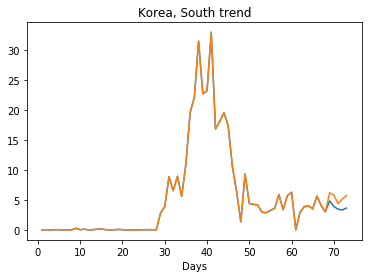

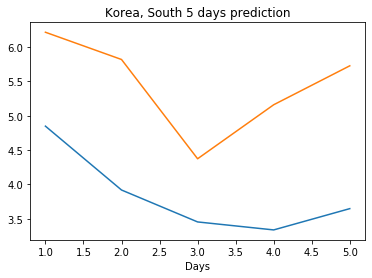

Creating directory ./offline8/Japan/training/
Japan
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8963
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8629
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8483
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8472
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8435
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8383
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8340
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8281
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8253
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8202
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8142
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8109
Saving the best model weights at Epoch [27], Best Valid L

Saving the best model weights at Epoch [18], Best Valid Loss: 1.1057
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1050
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1044
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1041
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1015
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1012
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1010
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0995
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0990
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0988
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0969
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0961
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0959
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0955
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.7534
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7512
train error: 0.07077953469400343
0.7512467503547668
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0135
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0119
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9967
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9958
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9953
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9935
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9925
train error: 0.12617950741887876
0.9924541711807251
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7357
Saving the best model weights at Epoch [8], Best Valid Loss: 0.6978
Saving the best model weights at Epoch [20], Best Valid Loss: 0.6874
Savi

train error: 0.14085224949705757
0.49570557475090027
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8910
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8674
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8332
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8242
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8234
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8159
train error: 0.10522712718107198
0.815946102142334
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1453
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1340
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1330
train error: 0.13049326229252314
1.1329764127731323
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7245
Saving the best model weights at Epoch [5], Best Valid Loss: 0.6152
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4899
train error: 0.1508344951

Saving the best model weights at Epoch [19], Best Valid Loss: 1.0144
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0135
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0131
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0122
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0121
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0111
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0106
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0101
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0099
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0095
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0092
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0091
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0085
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0083
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.7330
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7321
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7310
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7272
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7229
train error: 0.0784102063380966
0.7229320406913757
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9323
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9306
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9289
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9236
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9182
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9137
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9120
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9105
Saving the best model weights at Epoch [23], Best Vali

Saving the best model weights at Epoch [24], Best Valid Loss: 0.9380
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9324
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9310
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9297
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9256
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9242
train error: 0.07592264304893385
0.9242150187492371
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1363
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1302
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1251
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1207
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1171
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1075
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0776
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [33], Best Valid Loss: 0.5992
Saving the best model weights at Epoch [35], Best Valid Loss: 0.5975
Saving the best model weights at Epoch [36], Best Valid Loss: 0.5850
Saving the best model weights at Epoch [37], Best Valid Loss: 0.5803
Saving the best model weights at Epoch [38], Best Valid Loss: 0.5724
Saving the best model weights at Epoch [40], Best Valid Loss: 0.5643
Saving the best model weights at Epoch [41], Best Valid Loss: 0.5500
Saving the best model weights at Epoch [43], Best Valid Loss: 0.5440
Saving the best model weights at Epoch [46], Best Valid Loss: 0.5433
Saving the best model weights at Epoch [49], Best Valid Loss: 0.5401
Saving the best model weights at Epoch [50], Best Valid Loss: 0.5270
train error: 0.03895446534366592
0.5269798636436462
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9435
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9350
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [43], Best Valid Loss: 1.0604
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0604
train error: 0.14112469254943885
1.0604313611984253
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7675
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7135
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7123
Saving the best model weights at Epoch [4], Best Valid Loss: 0.6996
Saving the best model weights at Epoch [7], Best Valid Loss: 0.6852
Saving the best model weights at Epoch [28], Best Valid Loss: 0.6829
Saving the best model weights at Epoch [41], Best Valid Loss: 0.6783
train error: 0.10099296592862199
0.6783007979393005
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1745
train error: 0.14228851666772052
1.1744773387908936
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0203
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9855
Saving the best model we

Saving the best model weights at Epoch [18], Best Valid Loss: 1.1150
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1148
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1146
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1145
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1143
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1141
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1139
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1139
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1139
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1138
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1138
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1137
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1137
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1137
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.9869
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9845
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9835
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9820
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9820
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9803
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9803
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9800
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9800
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9798
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9794
train error: 0.10534511439159121
0.9793767929077148
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8077
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7563
Saving the best model weights at Epoch [3], Best Valid L

Saving the best model weights at Epoch [8], Best Valid Loss: 0.9357
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9330
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9303
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9286
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9274
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9253
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9242
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9233
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9229
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9229
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9223
train error: 0.13784163984421052
0.9223135113716125
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9970
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9894
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [1], Best Valid Loss: 1.0234
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0116
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9964
train error: 0.12583883817454702
0.9963647723197937
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1692
train error: 0.16963599217859537
1.1692084074020386
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8905
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8679
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8553
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8436
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8385
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8314
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8267
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8245
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8216
Saving the b

Saving the best model weights at Epoch [31], Best Valid Loss: 0.9243
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9242
train error: 0.13778827378624364
0.9242133498191833
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0442
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9808
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9650
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9539
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9471
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9418
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9373
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9359
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9338
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9313
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [6], Best Valid Loss: 1.1529
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1526
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1523
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1520
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1516
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1514
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1511
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1508
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1506
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1504
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1502
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1500
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1497
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1496
Saving the best model weights at Epoch

Saving the best model weights at Epoch [43], Best Valid Loss: 1.0124
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0106
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0090
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0073
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0057
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0042
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0026
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0011
train error: 0.1165359815533616
1.0011274814605713
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1006
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0937
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0872
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0812
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0753
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [29], Best Valid Loss: 0.9926
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9890
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9857
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9824
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9764
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9736
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9708
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9683
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9657
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9632
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9606
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9583
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9562
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.9209
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9178
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9148
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9115
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9087
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9060
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9032
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9007
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8983
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8961
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8935
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8916
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8892
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8871
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 1.0507
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0492
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0478
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0465
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0451
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0438
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0426
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0414
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0402
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0392
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0381
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0370
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0361
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0350
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.9633
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9600
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9567
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9538
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9507
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9451
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9425
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9398
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9374
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9350
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9327
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9303
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9282
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.9889
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9811
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9733
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9659
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9588
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9517
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9453
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9389
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9328
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9267
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9210
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9155
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9103
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9052
Saving the best model weights at Epoc

Saving the best model weights at Epoch [47], Best Valid Loss: 1.1314
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1311
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1308
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1306
train error: 0.15755914269309296
1.1305593252182007
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1713
train error: 0.14305815527117566
1.1713026762008667
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1425
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1346
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1309
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1286
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1267
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1254
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1237
Saving t

Saving the best model weights at Epoch [41], Best Valid Loss: 0.9926
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9915
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9903
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9893
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9880
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9870
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9860
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9850
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9841
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9832
train error: 0.13449192081431025
0.9832315444946289
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1389
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1351
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1322
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [32], Best Valid Loss: 0.9119
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9046
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8975
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8911
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8847
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8784
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8726
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8671
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8615
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8568
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8512
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8467
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8417
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8372
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 1.0740
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0737
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0732
train error: 0.14165283396447959
1.0732487440109253
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0685
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0477
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0311
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0167
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0041
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9964
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9892
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9822
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9792
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9742
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [39], Best Valid Loss: 1.1272
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1265
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1262
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1259
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1256
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1253
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1250
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1247
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1245
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1242
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1240
train error: 0.1565555523541805
1.123965859413147
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0488
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [31], Best Valid Loss: 1.0212
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0207
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0203
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0200
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0196
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0192
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0189
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0186
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0179
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0176
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0173
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0170
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0168
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 1.0250
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0242
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0236
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0231
train error: 0.1268796813674271
1.023073434829712
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0958
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0627
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0316
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9774
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9653
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9529
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9460
Saving the best model weights at Epoch [10], Best Valid Loss: 

Saving the best model weights at Epoch [36], Best Valid Loss: 0.8897
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8873
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8850
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8829
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8810
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8786
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8768
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8749
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8730
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8711
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8695
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8680
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8661
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8647
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.9593
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9571
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9550
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9529
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9492
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9474
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9454
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9439
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9423
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9408
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9391
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9377
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9364
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.9001
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8996
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8994
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8989
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8987
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8984
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8982
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8980
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8979
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8977
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8976
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8974
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8972
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8971
Saving the best model weights at E

Saving the best model weights at Epoch [23], Best Valid Loss: 1.0532
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0518
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0503
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0489
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0477
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0463
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0451
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0438
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0427
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0415
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0404
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0395
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0384
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0374
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 1.0304
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0262
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0224
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0185
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0150
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0117
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0083
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0051
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0022
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9994
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9966
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9941
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9915
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9892
Saving the best model weights at Epo

Saving the best model weights at Epoch [17], Best Valid Loss: 1.0429
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0405
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0369
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0326
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0284
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0245
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0207
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0172
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0136
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0103
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0071
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0041
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0012
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9984
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 1.0451
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0447
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0443
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0439
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0435
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0432
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0428
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0424
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0420
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0416
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0413
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0409
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0405
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0402
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.9890
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9884
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9878
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9872
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9866
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9861
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9855
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9849
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9843
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9837
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9831
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9825
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9820
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9814
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 1.0195
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0182
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0168
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0155
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0140
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0128
train error: 0.11881503766696704
1.0127770900726318
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0604
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0600
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0595
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0586
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0582
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0578
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 1.0180
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0148
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0119
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0079
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0050
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0016
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9988
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9957
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9923
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9896
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9870
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9841
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9813
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9785
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 1.0961
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0952
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0944
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0935
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0926
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0917
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0908
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0900
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0891
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0883
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0874
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0866
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0857
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0849
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.8840
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8838
train error: 0.09887396613454544
0.8837848901748657
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0567
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0564
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0561
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0557
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0554
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0551
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0548
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0545
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0542
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0539
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0536
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 1.0805
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0800
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0795
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0791
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0786
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0781
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0776
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0772
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0767
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0762
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0758
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0753
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0748
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0744
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.9521
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9490
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9456
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9427
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9398
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9364
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9335
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9308
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9279
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9252
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9225
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9200
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9174
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9143
train error: 0.12480263622771752
0

Saving the best model weights at Epoch [6], Best Valid Loss: 1.0541
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0508
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0479
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0446
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0414
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0382
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0356
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0324
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0294
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0267
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0240
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0213
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0186
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0160
Saving the best model weights at Epoch

Saving the best model weights at Epoch [22], Best Valid Loss: 1.1543
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1539
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1536
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1532
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1529
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1526
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1519
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1517
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1514
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1511
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1509
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1506
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1504
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 1.1226
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1225
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1224
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1221
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1220
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1219
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1219
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1217
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1217
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1216
train error: 0.15632937123116694
1.121589183807373
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [5], Best Valid Loss: 1.0659
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0600
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0533
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0476
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0417
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0358
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0249
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0196
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0142
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0090
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0038
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9988
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9941
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 1.1150
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1146
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1141
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1136
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1132
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1127
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1122
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1118
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1113
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1108
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1104
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1099
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1095
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1090
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 1.1357
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1353
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1349
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1345
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1341
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1337
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1333
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1329
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1325
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1321
train error: 0.14590158436667958
1.1321250200271606
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0909
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0896
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0882
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 0.9315
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9309
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9304
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9298
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9293
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9287
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9282
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9277
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9271
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9266
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9261
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9255
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9250
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9245
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 1.1413
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1409
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1405
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1402
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1398
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1395
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1391
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1388
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1384
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1380
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1373
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1370
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1366
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.9491
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9478
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9463
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9448
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9437
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9424
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9412
train error: 0.1301450449483175
0.9411989450454712
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1122
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1112
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1107
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1102
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1098
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 1.1332
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1308
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1286
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1265
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1243
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1221
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1204
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1183
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1162
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1142
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1122
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1104
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1086
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1068
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1188
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1186
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1184
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1182
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1179
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1177
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1175
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1173
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1171
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1169
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1166
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1164
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1162
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 1.0555
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0555
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0554
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0553
train error: 0.13961693112689413
1.0553150177001953
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0647
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0637
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0626
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0615
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0605
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0594
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0583
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0573
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0562
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 1.1429
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1428
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1424
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1422
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1420
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1419
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1417
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1415
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1413
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1411
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1410
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1408
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1406
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0777
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0765
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0753
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0743
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0731
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0721
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0709
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0699
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0690
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0678
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0667
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0656
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0649
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 1.1188
train error: 0.15148537631734812
1.1188039779663086
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1093
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1060
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1022
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0991
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0956
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0920
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0888
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0856
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0825
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0796
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0764
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0737
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 1.1445
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1444
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1443
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1442
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1441
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1440
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1439
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1438
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1437
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1436
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1435
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1434
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1433
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1432
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1477
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.9945
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9945
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9945
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9944
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9944
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9944
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9944
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9943
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9943
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9943
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9942
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9942
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9942
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9941
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 1.1375
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1372
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1369
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1367
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1364
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1361
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1359
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1356
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1353
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1350
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1345
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1342
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1339
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.0278
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0277
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0277
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0276
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0276
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0275
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0274
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0274
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0273
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0273
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0272
train error: 0.1392124941768615
1.0272005796432495
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1541
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 1.1550
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1550
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1549
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1549
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1548
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1548
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1548
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1547
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1547
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1546
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1546
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1546
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1545
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1545
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 1.1450
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1450
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1450
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1450
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1450
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1449
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.1185
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1182
train error: 0.13106381589252697
1.1182167530059814
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0555
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0554
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0554
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0554
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0553
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0553
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0553
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0552
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0552
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0552
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0551
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 1.0210
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0208
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0205
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0202
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0200
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0197
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0194
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0191
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0189
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0186
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0181
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0178
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0176
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 1.1221
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1220
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1220
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1219
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1219
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1218
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1217
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1217
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1216
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1215
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1215
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1214
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1214
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1213
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.1309
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1308
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1308
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1307
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1307
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1306
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1306
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1305
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1304
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1304
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1303
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1303
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1302
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1302
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 1.0756
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0756
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0755
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0755
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0755
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0755
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0754
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0754
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0754
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0754
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0753
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0753
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0753
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0753
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.9593
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9592
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9590
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9589
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9587
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9586
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9584
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9583
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9581
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9580
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9578
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9577
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9575
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9574
train error: 0.12854692477144694
0

Saving the best model weights at Epoch [4], Best Valid Loss: 1.0567
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0561
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0556
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0551
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0545
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0541
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0535
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0530
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0525
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0520
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0514
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0510
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0504
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0499
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 1.0574
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0573
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0572
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0572
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0571
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0570
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0569
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0568
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0567
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0567
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0566
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0565
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0564
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0563
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.1132
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1131
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1131
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1131
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1130
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1130
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1130
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1129
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1129
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1129
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1128
train error: 0.1511137788122716
1.1128344535827637
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1599
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 0.9471
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9471
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9470
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9470
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9470
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9470
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9469
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9469
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9469
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9469
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9469
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9468
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9468
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9468
Saving the best model weights at Epoc

Saving the best model weights at Epoch [23], Best Valid Loss: 1.1077
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1076
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1076
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1075
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1075
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1075
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1074
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1074
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1073
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1073
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1072
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1072
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1071
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1071
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 1.1071
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1070
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1070
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1069
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1069
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1068
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1068
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1067
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1067
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1066
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1065
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1065
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1064
train error: 0.15301349674547582
1.106429100036621
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [5], Best Valid Loss: 1.1195
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1192
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1192
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1191
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1191
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1189
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1189
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1188
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1188
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1187
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.9549
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9549
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9549
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9548
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9548
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9548
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9548
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9548
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9548
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9547
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9547
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9547
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9547
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9547
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.8277
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8276
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8275
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8272
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8271
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8270
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8268
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8266
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8265
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8263
train error: 0.08157897741215206
0.8263484835624695
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1051
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1051
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1051
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 1.0081
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0081
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0080
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0080
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0079
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0078
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0078
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0077
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0077
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0076
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0075
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0075
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0074
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0074
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 1.1023
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1022
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1020
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1019
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1017
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1016
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1014
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1013
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1011
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1010
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1008
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1007
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1005
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1004
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.1097
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1096
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1095
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1094
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1093
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1093
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1092
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1091
train error: 0.14750812290309878
1.109091877937317
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1104
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1101
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1098
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1095
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1093
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0127
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0127
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1190
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 1.0706
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0706
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0706
train error: 0.1456289280904457
1.070562481880188
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [11], Best Valid Loss: 

Saving the best model weights at Epoch [15], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1384
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1384
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1384
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1384
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1384
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1384
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0988
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0988
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0988
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0988
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.9322
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9322
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9321
train error: 0.1308036328685519
0.9320653080940247
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0196
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0196
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 0.9562
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9561
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9561
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9561
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9560
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9560
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9559
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9559
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9559
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9558
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9558
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9557
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9557
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9556
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 1.1345
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1344
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1344
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 1.1507
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1507
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1507
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1507
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1507
train error: 0.16237261991849855
1.1506855487823486
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1522
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [9], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8356
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8356
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0808
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0808
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0808
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0808
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 1.0892
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0892
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0891
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0891
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0890
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0890
train error: 0.14719752183085993
1.0889910459518433
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0915
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0915
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0915
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0915
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0915
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0915
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1425
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1425
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1425
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1425
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1425
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1425
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1424
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1424
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1424
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1424
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1600
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1600
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1426
train error: 0.15157958827790266
1.1425834894180298
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0063
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0063
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0062
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0061
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0061
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0060
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0060
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0059
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 1.0099
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0099
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0099
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0098
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0098
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0916
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.1631
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1630
train error: 0.16705721181719319
1.1630409955978394
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1349
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 1.0979
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0978
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0978
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0978
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0978
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0977
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0977
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0977
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0976
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0976
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0976
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0975
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0975
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0975
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1707
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1707
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1707
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1707
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1706
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1706
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1706
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1706
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.9547
train error: 0.1177989768391279
0.9546779990196228
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0721
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0721
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0721
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0721
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0720
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0720
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0720
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0720
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0720
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0719
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0719
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0719
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0789
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0789
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0789
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0789
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 1.1378
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1378
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1377
Saving the best model weights at E

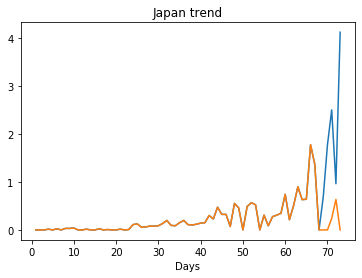

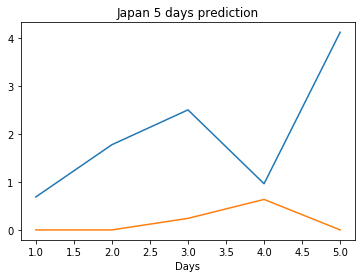

Creating directory ./offline8/Cambodia/training/
Cambodia
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0190
train error: 0.18307836710433054
0.019007429480552673
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0191
train error: 0.11871591879577009
0.019128087908029556
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0188
train error: 0.20745227631590696
0.01883288286626339
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0190
train error: 0.16193101333919913
0.01897246204316616
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0311
train error: 0.14641943339687935
0.0310718212276

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0146
train error: 0.19567246770373348
0.014586281962692738
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0293
train error: 0.20745227631590696
0.029335588216781616
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0212
train error: 0.19783738311944585
0.021193714812397957
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0128
train error: 0.1957555178581088
0.01279781199991703
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0293
train error: 0.20745227631590696
0.029335588216781616
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0125
train error: 0.18574705481472792
0.012455721385776997
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0306
train error: 0.19981543441077299
0.030610784888267

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0081
train error: 0.18243279742697874
0.008063209243118763
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0280
train error: 0.19605485112829643
0.02803626097738743
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0078
Savin

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0218
train error: 0.1968741799055627
0.021824073046445847
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [9], Best Valid Loss:

train error: 0.20255094804010834
0.03300904482603073
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [15], Best Valid Los

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0180
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0228
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0223
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0073
train error: 0.18244657253451418
0.007346111815422773
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0200
train error: 0.19488018205756266
0.020014209672808647
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0225
Savin

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0142
train error: 0.18863075796627637
0

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0180
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0012
train error: 0.18858151987307903
0.0012152785202488303
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0405
train error: 0.19059421534113813
0.040508002042770386
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0131
train error: 0.17666577553433
0.013064

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0250
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0232
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0279
train error: 0.1910581399922993
0.027909768745303154
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0307
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0184
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0182
train error: 0.18819939520449913
0.018185768276453018
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0208
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0174
train error: 0.19042654964141548
0.017358852550387383
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0134
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0250
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0175
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0367
train error: 0.19684474165974694
0.03674238175153732
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0191
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0282
train error: 0.199373690136285
0.02823277749121189
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0145
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0273
train error: 0.19423169620109326
0.02733423374593258
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0259
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0287
train error: 0.19660742937897643
0.02865312434732914
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0117
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0129
train error: 0.18910597884237315
0.01290637906640768
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [9], Best Valid Los

train error: 0.19009892425189415
0.02641415037214756
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [14], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0221
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0232
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0118
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0284
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0143
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0287
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0263
train error: 0.20551935736809604
0.026335084810853004
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0254
train error: 0.19013679249804805
0.025379717350006104
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0226
S

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0270
train error: 0.20067062887546577
0.026986008509993553
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0318
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0399
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0316
train error: 0.19661305922393998
0.03158188611268997
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0294
train error: 0.20451291349529516
0.029408453032374382
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0175
Savi

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0275
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0282
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0361
train error: 0.1980086678187504
0.03606275096535683
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0109
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0247
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0197
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0283
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0333
train error: 0.19732014319831223
0.033302925527095795
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0129
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0271
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0257
train error: 0.20470558264236333
0.025674480944871902
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0236
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0185
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0278
train error: 0.19958696002493415
0.02777114510536194
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0257
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0161
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0284
train error: 0.20703307853550126
0.028410453349351883
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0192
train error: 0.19970812471618762
0.019245963543653488
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0311
train error: 0.20283322025153955
0.031060531735420227
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0190
Saving the be

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0319
Saving the best model weights at Epoch

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0200
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0286
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0236
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0227
train error: 0.20174909351308914
0.022732321172952652
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0251
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0278
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0259
train error: 0.20420846539182644
0.025927025824785233
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0283
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0355
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0315
train error: 0.20154576318931172
0.031549859791994095
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0201
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0267
Saving the best model weights at E

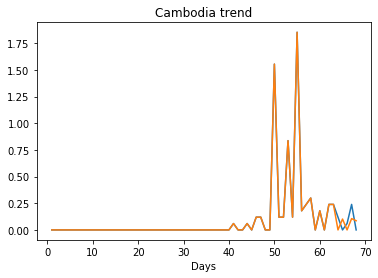

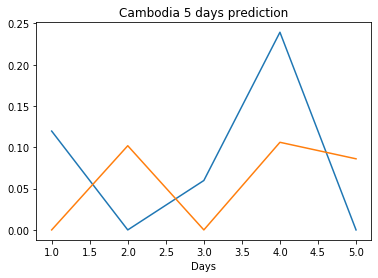

Creating directory ./offline8/Malaysia/training/
Malaysia
Saving the best model weights at Epoch [1], Best Valid Loss: 11.1262
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3822
Saving the best model weights at Epoch [5], Best Valid Loss: 1.7759
Saving the best model weights at Epoch [8], Best Valid Loss: 1.7512
Saving the best model weights at Epoch [9], Best Valid Loss: 1.6331
Saving the best model weights at Epoch [10], Best Valid Loss: 1.5386
train error: 0.148000375760187
1.5385793447494507
Saving the best model weights at Epoch [1], Best Valid Loss: 10.6439
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4228
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2281
Saving the best model weights at Epoch [32], Best Valid Loss: 1.7071
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2481
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0695
train error: 0.11420246849634817
1.069515585899353
Saving the best m

train error: 2.249748193440194
2.993910312652588
Saving the best model weights at Epoch [1], Best Valid Loss: 15.7100
Saving the best model weights at Epoch [2], Best Valid Loss: 1.7301
Saving the best model weights at Epoch [7], Best Valid Loss: 1.7296
Saving the best model weights at Epoch [8], Best Valid Loss: 1.5757
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0839
train error: 0.6157439671789429
1.0839102268218994
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3462
Saving the best model weights at Epoch [2], Best Valid Loss: 1.9968
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8334
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2686
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0955
train error: 0.5872524062928278
1.095462441444397
Saving the best model weights at Epoch [1], Best Valid Loss: 11.5729
train error: 8.42395671227631
11.57291316986084
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [9], Best Valid Loss: 18.5918
Saving the best model weights at Epoch [14], Best Valid Loss: 18.3492
Saving the best model weights at Epoch [38], Best Valid Loss: 18.2061
train error: 6.161552696568625
18.20606803894043
Saving the best model weights at Epoch [1], Best Valid Loss: 15.3066
Saving the best model weights at Epoch [3], Best Valid Loss: 13.5383
Saving the best model weights at Epoch [10], Best Valid Loss: 13.4351
Saving the best model weights at Epoch [31], Best Valid Loss: 11.8207
train error: 6.050955741746085
11.820721626281738
Saving the best model weights at Epoch [1], Best Valid Loss: 20.7798
train error: 8.42395671227631
20.77979278564453
Saving the best model weights at Epoch [1], Best Valid Loss: 24.1013
Saving the best model weights at Epoch [2], Best Valid Loss: 23.3603
Saving the best model weights at Epoch [7], Best Valid Loss: 23.0674
Saving the best model weights at Epoch [10], Best Valid Loss: 23.0376
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 7.6973
Saving the best model weights at Epoch [9], Best Valid Loss: 6.3801
Saving the best model weights at Epoch [10], Best Valid Loss: 5.3249
Saving the best model weights at Epoch [11], Best Valid Loss: 4.4546
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8526
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3692
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0116
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7390
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5329
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3668
Saving the best model weights at Epoch [18], Best Valid Loss: 2.2537
Saving the best model weights at Epoch [19], Best Valid Loss: 2.1664
Saving the best model weights at Epoch [20], Best Valid Loss: 2.1099
Saving the best model weights at Epoch [21], Best Valid Loss: 2.0740
Saving the best model weights at Epo

Saving the best model weights at Epoch [8], Best Valid Loss: 4.8373
Saving the best model weights at Epoch [9], Best Valid Loss: 4.7700
Saving the best model weights at Epoch [13], Best Valid Loss: 4.7361
Saving the best model weights at Epoch [20], Best Valid Loss: 4.6999
train error: 2.391649142173784
4.699883937835693
Saving the best model weights at Epoch [1], Best Valid Loss: 20.4224
Saving the best model weights at Epoch [2], Best Valid Loss: 14.8732
Saving the best model weights at Epoch [3], Best Valid Loss: 13.7564
Saving the best model weights at Epoch [4], Best Valid Loss: 13.6163
Saving the best model weights at Epoch [5], Best Valid Loss: 13.6129
Saving the best model weights at Epoch [6], Best Valid Loss: 13.5587
Saving the best model weights at Epoch [7], Best Valid Loss: 13.5279
Saving the best model weights at Epoch [11], Best Valid Loss: 13.4605
Saving the best model weights at Epoch [14], Best Valid Loss: 13.4560
Saving the best model weights at Epoch [48], Best Vali

Saving the best model weights at Epoch [47], Best Valid Loss: 13.4586
train error: 5.590569134309356
13.458612442016602
Saving the best model weights at Epoch [1], Best Valid Loss: 26.7484
Saving the best model weights at Epoch [2], Best Valid Loss: 26.1882
Saving the best model weights at Epoch [3], Best Valid Loss: 25.7291
Saving the best model weights at Epoch [4], Best Valid Loss: 25.3441
Saving the best model weights at Epoch [5], Best Valid Loss: 25.0261
Saving the best model weights at Epoch [6], Best Valid Loss: 24.7674
Saving the best model weights at Epoch [7], Best Valid Loss: 24.5453
Saving the best model weights at Epoch [8], Best Valid Loss: 24.3404
Saving the best model weights at Epoch [9], Best Valid Loss: 24.1775
Saving the best model weights at Epoch [10], Best Valid Loss: 24.0435
Saving the best model weights at Epoch [11], Best Valid Loss: 23.9262
Saving the best model weights at Epoch [12], Best Valid Loss: 23.8263
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [30], Best Valid Loss: 7.5241
Saving the best model weights at Epoch [31], Best Valid Loss: 7.0344
Saving the best model weights at Epoch [32], Best Valid Loss: 6.7340
Saving the best model weights at Epoch [33], Best Valid Loss: 6.5531
Saving the best model weights at Epoch [34], Best Valid Loss: 6.4490
Saving the best model weights at Epoch [35], Best Valid Loss: 6.4046
Saving the best model weights at Epoch [36], Best Valid Loss: 6.3829
Saving the best model weights at Epoch [37], Best Valid Loss: 6.3654
train error: 2.7259577044019743
6.3654093742370605
Saving the best model weights at Epoch [1], Best Valid Loss: 25.0594
Saving the best model weights at Epoch [2], Best Valid Loss: 23.4133
Saving the best model weights at Epoch [3], Best Valid Loss: 22.3044
Saving the best model weights at Epoch [4], Best Valid Loss: 21.4652
Saving the best model weights at Epoch [5], Best Valid Loss: 20.7179
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [35], Best Valid Loss: 20.5047
Saving the best model weights at Epoch [36], Best Valid Loss: 20.4978
Saving the best model weights at Epoch [38], Best Valid Loss: 20.4966
Saving the best model weights at Epoch [39], Best Valid Loss: 20.4919
Saving the best model weights at Epoch [45], Best Valid Loss: 20.4880
Saving the best model weights at Epoch [46], Best Valid Loss: 20.4780
Saving the best model weights at Epoch [47], Best Valid Loss: 20.4767
train error: 7.104025544439043
20.476741790771484
Saving the best model weights at Epoch [1], Best Valid Loss: 25.4197
Saving the best model weights at Epoch [2], Best Valid Loss: 24.2661
Saving the best model weights at Epoch [3], Best Valid Loss: 23.4121
Saving the best model weights at Epoch [4], Best Valid Loss: 22.8664
Saving the best model weights at Epoch [5], Best Valid Loss: 22.4246
Saving the best model weights at Epoch [6], Best Valid Loss: 22.2325
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [34], Best Valid Loss: 20.1362
Saving the best model weights at Epoch [39], Best Valid Loss: 20.0949
Saving the best model weights at Epoch [40], Best Valid Loss: 20.0394
Saving the best model weights at Epoch [41], Best Valid Loss: 20.0063
Saving the best model weights at Epoch [42], Best Valid Loss: 19.9106
Saving the best model weights at Epoch [43], Best Valid Loss: 19.8160
Saving the best model weights at Epoch [44], Best Valid Loss: 19.7689
Saving the best model weights at Epoch [45], Best Valid Loss: 19.7531
Saving the best model weights at Epoch [47], Best Valid Loss: 19.7337
Saving the best model weights at Epoch [48], Best Valid Loss: 19.6100
Saving the best model weights at Epoch [49], Best Valid Loss: 19.5803
Saving the best model weights at Epoch [50], Best Valid Loss: 19.4249
train error: 6.838416873557227
19.424909591674805
Saving the best model weights at Epoch [1], Best Valid Loss: 22.2604
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [50], Best Valid Loss: 4.6388
train error: 2.2188099063932896
4.6388163566589355
Saving the best model weights at Epoch [1], Best Valid Loss: 27.0619
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7254
Saving the best model weights at Epoch [3], Best Valid Loss: 26.4581
Saving the best model weights at Epoch [4], Best Valid Loss: 26.2472
Saving the best model weights at Epoch [5], Best Valid Loss: 26.0775
Saving the best model weights at Epoch [6], Best Valid Loss: 25.9385
Saving the best model weights at Epoch [7], Best Valid Loss: 25.8239
Saving the best model weights at Epoch [8], Best Valid Loss: 25.7362
Saving the best model weights at Epoch [9], Best Valid Loss: 25.6602
Saving the best model weights at Epoch [10], Best Valid Loss: 25.6000
Saving the best model weights at Epoch [11], Best Valid Loss: 25.5495
Saving the best model weights at Epoch [12], Best Valid Loss: 25.5046
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [40], Best Valid Loss: 14.2763
Saving the best model weights at Epoch [41], Best Valid Loss: 14.2493
train error: 5.485802439280919
14.249302864074707
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5387
train error: 8.42395671227631
27.538715362548828
Saving the best model weights at Epoch [1], Best Valid Loss: 16.5477
Saving the best model weights at Epoch [2], Best Valid Loss: 15.1633
Saving the best model weights at Epoch [3], Best Valid Loss: 14.9952
Saving the best model weights at Epoch [16], Best Valid Loss: 14.9212
Saving the best model weights at Epoch [18], Best Valid Loss: 14.7613
Saving the best model weights at Epoch [24], Best Valid Loss: 14.6426
Saving the best model weights at Epoch [30], Best Valid Loss: 14.2761
train error: 5.89653388091496
14.276144981384277
Saving the best model weights at Epoch [1], Best Valid Loss: 26.9181
Saving the best model weights at Epoch [2], Best Valid Loss: 26.4785
Saving the best mo

Saving the best model weights at Epoch [30], Best Valid Loss: 20.4535
train error: 7.12459089074816
20.453458786010742
Saving the best model weights at Epoch [1], Best Valid Loss: 22.0343
Saving the best model weights at Epoch [2], Best Valid Loss: 21.3122
Saving the best model weights at Epoch [3], Best Valid Loss: 20.5176
Saving the best model weights at Epoch [4], Best Valid Loss: 19.6195
Saving the best model weights at Epoch [5], Best Valid Loss: 18.5831
Saving the best model weights at Epoch [24], Best Valid Loss: 18.5231
Saving the best model weights at Epoch [29], Best Valid Loss: 18.1736
Saving the best model weights at Epoch [30], Best Valid Loss: 17.1765
Saving the best model weights at Epoch [31], Best Valid Loss: 14.6190
Saving the best model weights at Epoch [32], Best Valid Loss: 10.9375
Saving the best model weights at Epoch [33], Best Valid Loss: 10.6657
Saving the best model weights at Epoch [35], Best Valid Loss: 10.6492
Saving the best model weights at Epoch [37], B

Saving the best model weights at Epoch [13], Best Valid Loss: 19.2179
Saving the best model weights at Epoch [14], Best Valid Loss: 19.1839
Saving the best model weights at Epoch [18], Best Valid Loss: 19.1739
Saving the best model weights at Epoch [19], Best Valid Loss: 19.1057
Saving the best model weights at Epoch [26], Best Valid Loss: 19.0951
Saving the best model weights at Epoch [30], Best Valid Loss: 19.0754
train error: 6.063710344689233
19.075437545776367
Saving the best model weights at Epoch [1], Best Valid Loss: 20.1605
Saving the best model weights at Epoch [2], Best Valid Loss: 19.8866
Saving the best model weights at Epoch [3], Best Valid Loss: 19.7544
Saving the best model weights at Epoch [4], Best Valid Loss: 19.7025
Saving the best model weights at Epoch [5], Best Valid Loss: 19.2505
Saving the best model weights at Epoch [12], Best Valid Loss: 19.1868
Saving the best model weights at Epoch [16], Best Valid Loss: 19.1318
Saving the best model weights at Epoch [22], 

Saving the best model weights at Epoch [2], Best Valid Loss: 21.7370
Saving the best model weights at Epoch [3], Best Valid Loss: 21.3775
Saving the best model weights at Epoch [4], Best Valid Loss: 21.2150
Saving the best model weights at Epoch [11], Best Valid Loss: 21.2141
Saving the best model weights at Epoch [13], Best Valid Loss: 21.1147
Saving the best model weights at Epoch [23], Best Valid Loss: 21.0567
Saving the best model weights at Epoch [25], Best Valid Loss: 20.9840
Saving the best model weights at Epoch [34], Best Valid Loss: 20.9646
train error: 6.725848388671875
20.964570999145508
Saving the best model weights at Epoch [1], Best Valid Loss: 25.0715
Saving the best model weights at Epoch [2], Best Valid Loss: 23.2403
Saving the best model weights at Epoch [3], Best Valid Loss: 21.7885
Saving the best model weights at Epoch [4], Best Valid Loss: 20.5558
Saving the best model weights at Epoch [5], Best Valid Loss: 19.5835
Saving the best model weights at Epoch [6], Best

Saving the best model weights at Epoch [49], Best Valid Loss: 11.8013
Saving the best model weights at Epoch [50], Best Valid Loss: 11.6259
train error: 4.116319751739502
11.625879287719727
Saving the best model weights at Epoch [1], Best Valid Loss: 25.1759
Saving the best model weights at Epoch [2], Best Valid Loss: 24.7048
Saving the best model weights at Epoch [3], Best Valid Loss: 24.2301
Saving the best model weights at Epoch [4], Best Valid Loss: 23.7432
Saving the best model weights at Epoch [5], Best Valid Loss: 23.2411
Saving the best model weights at Epoch [6], Best Valid Loss: 22.7500
Saving the best model weights at Epoch [7], Best Valid Loss: 22.2703
Saving the best model weights at Epoch [8], Best Valid Loss: 21.7706
Saving the best model weights at Epoch [9], Best Valid Loss: 21.3130
Saving the best model weights at Epoch [10], Best Valid Loss: 20.8380
Saving the best model weights at Epoch [11], Best Valid Loss: 20.3800
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [29], Best Valid Loss: 17.1580
Saving the best model weights at Epoch [30], Best Valid Loss: 16.6979
Saving the best model weights at Epoch [31], Best Valid Loss: 16.2550
Saving the best model weights at Epoch [32], Best Valid Loss: 15.8350
Saving the best model weights at Epoch [33], Best Valid Loss: 15.4274
Saving the best model weights at Epoch [34], Best Valid Loss: 15.0420
Saving the best model weights at Epoch [35], Best Valid Loss: 14.6785
Saving the best model weights at Epoch [36], Best Valid Loss: 14.3344
Saving the best model weights at Epoch [37], Best Valid Loss: 14.0140
Saving the best model weights at Epoch [38], Best Valid Loss: 13.7061
Saving the best model weights at Epoch [39], Best Valid Loss: 13.4215
Saving the best model weights at Epoch [40], Best Valid Loss: 13.1560
Saving the best model weights at Epoch [41], Best Valid Loss: 12.9076
Saving the best model weights at Epoch [42], Best Valid Loss: 12.6806
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 7.8581
Saving the best model weights at Epoch [42], Best Valid Loss: 7.6778
Saving the best model weights at Epoch [43], Best Valid Loss: 7.5153
Saving the best model weights at Epoch [44], Best Valid Loss: 7.3702
Saving the best model weights at Epoch [45], Best Valid Loss: 7.2363
Saving the best model weights at Epoch [46], Best Valid Loss: 7.1179
Saving the best model weights at Epoch [47], Best Valid Loss: 7.0113
Saving the best model weights at Epoch [48], Best Valid Loss: 6.9154
Saving the best model weights at Epoch [49], Best Valid Loss: 6.8309
Saving the best model weights at Epoch [50], Best Valid Loss: 6.7563
train error: 3.2559819425855365
6.756274700164795
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8485
Saving the best model weights at Epoch [2], Best Valid Loss: 25.9089
Saving the best model weights at Epoch [3], Best Valid Loss: 24.7668
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [3], Best Valid Loss: 23.3664
Saving the best model weights at Epoch [4], Best Valid Loss: 21.7719
Saving the best model weights at Epoch [5], Best Valid Loss: 20.1255
Saving the best model weights at Epoch [6], Best Valid Loss: 18.2739
Saving the best model weights at Epoch [7], Best Valid Loss: 16.4138
Saving the best model weights at Epoch [8], Best Valid Loss: 14.4528
Saving the best model weights at Epoch [9], Best Valid Loss: 12.4990
Saving the best model weights at Epoch [10], Best Valid Loss: 10.6619
Saving the best model weights at Epoch [11], Best Valid Loss: 8.9246
Saving the best model weights at Epoch [12], Best Valid Loss: 7.3655
Saving the best model weights at Epoch [13], Best Valid Loss: 6.0547
Saving the best model weights at Epoch [14], Best Valid Loss: 5.0246
Saving the best model weights at Epoch [15], Best Valid Loss: 4.1096
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4633
Saving the best model weights at 

Saving the best model weights at Epoch [40], Best Valid Loss: 22.6601
Saving the best model weights at Epoch [41], Best Valid Loss: 22.6095
Saving the best model weights at Epoch [42], Best Valid Loss: 22.5676
Saving the best model weights at Epoch [43], Best Valid Loss: 22.5121
Saving the best model weights at Epoch [44], Best Valid Loss: 22.4709
Saving the best model weights at Epoch [45], Best Valid Loss: 22.4293
Saving the best model weights at Epoch [46], Best Valid Loss: 22.3783
Saving the best model weights at Epoch [47], Best Valid Loss: 22.3392
Saving the best model weights at Epoch [48], Best Valid Loss: 22.2985
Saving the best model weights at Epoch [49], Best Valid Loss: 22.2542
Saving the best model weights at Epoch [50], Best Valid Loss: 22.2200
train error: 6.8104215707097735
22.220008850097656
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8755
Saving the best model weights at Epoch [2], Best Valid Loss: 26.3791
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [11], Best Valid Loss: 24.1695
Saving the best model weights at Epoch [12], Best Valid Loss: 23.9160
Saving the best model weights at Epoch [13], Best Valid Loss: 23.6737
Saving the best model weights at Epoch [14], Best Valid Loss: 23.4504
Saving the best model weights at Epoch [15], Best Valid Loss: 23.2156
Saving the best model weights at Epoch [16], Best Valid Loss: 22.9971
Saving the best model weights at Epoch [17], Best Valid Loss: 22.7991
Saving the best model weights at Epoch [18], Best Valid Loss: 22.5847
Saving the best model weights at Epoch [19], Best Valid Loss: 22.3889
Saving the best model weights at Epoch [20], Best Valid Loss: 22.1973
Saving the best model weights at Epoch [21], Best Valid Loss: 22.0171
Saving the best model weights at Epoch [22], Best Valid Loss: 21.8442
Saving the best model weights at Epoch [23], Best Valid Loss: 21.6631
Saving the best model weights at Epoch [24], Best Valid Loss: 21.4963
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 21.9826
Saving the best model weights at Epoch [42], Best Valid Loss: 21.8957
Saving the best model weights at Epoch [43], Best Valid Loss: 21.8120
Saving the best model weights at Epoch [44], Best Valid Loss: 21.7288
Saving the best model weights at Epoch [45], Best Valid Loss: 21.6460
Saving the best model weights at Epoch [46], Best Valid Loss: 21.5653
Saving the best model weights at Epoch [47], Best Valid Loss: 21.4855
Saving the best model weights at Epoch [48], Best Valid Loss: 21.4072
Saving the best model weights at Epoch [49], Best Valid Loss: 21.3296
Saving the best model weights at Epoch [50], Best Valid Loss: 21.2534
train error: 6.836849996021816
21.25341033935547
Saving the best model weights at Epoch [1], Best Valid Loss: 26.5017
Saving the best model weights at Epoch [2], Best Valid Loss: 26.2015
Saving the best model weights at Epoch [3], Best Valid Loss: 25.9199
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [5], Best Valid Loss: 25.7297
Saving the best model weights at Epoch [6], Best Valid Loss: 25.4720
Saving the best model weights at Epoch [7], Best Valid Loss: 25.2107
Saving the best model weights at Epoch [8], Best Valid Loss: 24.9665
Saving the best model weights at Epoch [9], Best Valid Loss: 24.7310
Saving the best model weights at Epoch [10], Best Valid Loss: 24.5078
Saving the best model weights at Epoch [11], Best Valid Loss: 24.2821
Saving the best model weights at Epoch [12], Best Valid Loss: 24.0782
Saving the best model weights at Epoch [13], Best Valid Loss: 23.8625
Saving the best model weights at Epoch [14], Best Valid Loss: 23.6652
Saving the best model weights at Epoch [15], Best Valid Loss: 23.4622
Saving the best model weights at Epoch [16], Best Valid Loss: 23.2845
Saving the best model weights at Epoch [17], Best Valid Loss: 23.0984
Saving the best model weights at Epoch [18], Best Valid Loss: 22.9060
Saving the best model wei

Saving the best model weights at Epoch [50], Best Valid Loss: 21.2377
train error: 6.697373198611396
21.237712860107422
Saving the best model weights at Epoch [1], Best Valid Loss: 25.8746
Saving the best model weights at Epoch [2], Best Valid Loss: 25.4946
Saving the best model weights at Epoch [3], Best Valid Loss: 25.1155
Saving the best model weights at Epoch [4], Best Valid Loss: 24.7607
Saving the best model weights at Epoch [5], Best Valid Loss: 24.4371
Saving the best model weights at Epoch [6], Best Valid Loss: 24.1075
Saving the best model weights at Epoch [7], Best Valid Loss: 23.7901
Saving the best model weights at Epoch [8], Best Valid Loss: 23.4994
Saving the best model weights at Epoch [9], Best Valid Loss: 23.2144
Saving the best model weights at Epoch [10], Best Valid Loss: 22.9250
Saving the best model weights at Epoch [11], Best Valid Loss: 22.6806
Saving the best model weights at Epoch [12], Best Valid Loss: 22.4120
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [36], Best Valid Loss: 23.6663
Saving the best model weights at Epoch [37], Best Valid Loss: 23.6023
Saving the best model weights at Epoch [38], Best Valid Loss: 23.5383
Saving the best model weights at Epoch [39], Best Valid Loss: 23.4766
Saving the best model weights at Epoch [40], Best Valid Loss: 23.4158
Saving the best model weights at Epoch [41], Best Valid Loss: 23.3567
Saving the best model weights at Epoch [42], Best Valid Loss: 23.2982
Saving the best model weights at Epoch [43], Best Valid Loss: 23.2413
Saving the best model weights at Epoch [44], Best Valid Loss: 23.1863
Saving the best model weights at Epoch [45], Best Valid Loss: 23.1301
Saving the best model weights at Epoch [46], Best Valid Loss: 23.0764
Saving the best model weights at Epoch [47], Best Valid Loss: 23.0239
Saving the best model weights at Epoch [48], Best Valid Loss: 22.9715
Saving the best model weights at Epoch [49], Best Valid Loss: 22.9205
Saving the best mode

Saving the best model weights at Epoch [22], Best Valid Loss: 24.1020
Saving the best model weights at Epoch [23], Best Valid Loss: 24.0038
Saving the best model weights at Epoch [24], Best Valid Loss: 23.9091
Saving the best model weights at Epoch [25], Best Valid Loss: 23.8158
Saving the best model weights at Epoch [26], Best Valid Loss: 23.7241
Saving the best model weights at Epoch [27], Best Valid Loss: 23.6337
Saving the best model weights at Epoch [28], Best Valid Loss: 23.5463
Saving the best model weights at Epoch [29], Best Valid Loss: 23.4603
Saving the best model weights at Epoch [30], Best Valid Loss: 23.3764
Saving the best model weights at Epoch [31], Best Valid Loss: 23.2946
Saving the best model weights at Epoch [32], Best Valid Loss: 23.2140
Saving the best model weights at Epoch [33], Best Valid Loss: 23.1341
Saving the best model weights at Epoch [34], Best Valid Loss: 23.0568
Saving the best model weights at Epoch [35], Best Valid Loss: 22.9810
Saving the best mode

Saving the best model weights at Epoch [7], Best Valid Loss: 26.5774
Saving the best model weights at Epoch [8], Best Valid Loss: 26.4742
Saving the best model weights at Epoch [9], Best Valid Loss: 26.3717
Saving the best model weights at Epoch [10], Best Valid Loss: 26.2728
Saving the best model weights at Epoch [11], Best Valid Loss: 26.1755
Saving the best model weights at Epoch [12], Best Valid Loss: 26.0803
Saving the best model weights at Epoch [13], Best Valid Loss: 25.9874
Saving the best model weights at Epoch [14], Best Valid Loss: 25.8967
Saving the best model weights at Epoch [15], Best Valid Loss: 25.8065
Saving the best model weights at Epoch [16], Best Valid Loss: 25.7189
Saving the best model weights at Epoch [17], Best Valid Loss: 25.6330
Saving the best model weights at Epoch [18], Best Valid Loss: 25.5491
Saving the best model weights at Epoch [19], Best Valid Loss: 25.4668
Saving the best model weights at Epoch [20], Best Valid Loss: 25.3869
Saving the best model w

Saving the best model weights at Epoch [29], Best Valid Loss: 22.0554
Saving the best model weights at Epoch [30], Best Valid Loss: 22.0405
Saving the best model weights at Epoch [31], Best Valid Loss: 21.9978
Saving the best model weights at Epoch [38], Best Valid Loss: 21.4873
Saving the best model weights at Epoch [39], Best Valid Loss: 21.0654
Saving the best model weights at Epoch [40], Best Valid Loss: 20.7192
Saving the best model weights at Epoch [41], Best Valid Loss: 20.3890
Saving the best model weights at Epoch [42], Best Valid Loss: 20.0409
Saving the best model weights at Epoch [43], Best Valid Loss: 19.7959
Saving the best model weights at Epoch [44], Best Valid Loss: 19.6020
Saving the best model weights at Epoch [45], Best Valid Loss: 19.5177
Saving the best model weights at Epoch [46], Best Valid Loss: 19.3284
Saving the best model weights at Epoch [47], Best Valid Loss: 19.2878
Saving the best model weights at Epoch [48], Best Valid Loss: 19.1763
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 22.0742
Saving the best model weights at Epoch [3], Best Valid Loss: 20.6572
Saving the best model weights at Epoch [4], Best Valid Loss: 19.0583
Saving the best model weights at Epoch [5], Best Valid Loss: 17.9969
Saving the best model weights at Epoch [6], Best Valid Loss: 16.8587
Saving the best model weights at Epoch [7], Best Valid Loss: 16.0906
Saving the best model weights at Epoch [8], Best Valid Loss: 15.4045
Saving the best model weights at Epoch [9], Best Valid Loss: 14.8718
Saving the best model weights at Epoch [10], Best Valid Loss: 14.5201
Saving the best model weights at Epoch [11], Best Valid Loss: 13.9317
Saving the best model weights at Epoch [12], Best Valid Loss: 13.6376
Saving the best model weights at Epoch [13], Best Valid Loss: 13.4703
Saving the best model weights at Epoch [14], Best Valid Loss: 13.2785
Saving the best model weights at Epoch [15], Best Valid Loss: 13.1420
Saving the best model weight

Saving the best model weights at Epoch [11], Best Valid Loss: 24.6242
Saving the best model weights at Epoch [12], Best Valid Loss: 24.4410
Saving the best model weights at Epoch [13], Best Valid Loss: 24.2612
Saving the best model weights at Epoch [14], Best Valid Loss: 24.0857
Saving the best model weights at Epoch [15], Best Valid Loss: 23.9147
Saving the best model weights at Epoch [16], Best Valid Loss: 23.7440
Saving the best model weights at Epoch [17], Best Valid Loss: 23.5785
Saving the best model weights at Epoch [18], Best Valid Loss: 23.4161
Saving the best model weights at Epoch [19], Best Valid Loss: 23.2572
Saving the best model weights at Epoch [20], Best Valid Loss: 23.1023
Saving the best model weights at Epoch [21], Best Valid Loss: 22.9507
Saving the best model weights at Epoch [22], Best Valid Loss: 22.7996
Saving the best model weights at Epoch [23], Best Valid Loss: 22.6539
Saving the best model weights at Epoch [24], Best Valid Loss: 22.5092
Saving the best mode

train error: 7.308451397078378
21.215383529663086
Saving the best model weights at Epoch [1], Best Valid Loss: 26.9352
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7081
Saving the best model weights at Epoch [3], Best Valid Loss: 26.4870
Saving the best model weights at Epoch [4], Best Valid Loss: 26.2699
Saving the best model weights at Epoch [5], Best Valid Loss: 26.0575
Saving the best model weights at Epoch [6], Best Valid Loss: 25.8508
Saving the best model weights at Epoch [7], Best Valid Loss: 25.6486
Saving the best model weights at Epoch [8], Best Valid Loss: 25.4508
Saving the best model weights at Epoch [9], Best Valid Loss: 25.2574
Saving the best model weights at Epoch [10], Best Valid Loss: 25.0681
Saving the best model weights at Epoch [11], Best Valid Loss: 24.8842
Saving the best model weights at Epoch [12], Best Valid Loss: 24.7018
Saving the best model weights at Epoch [13], Best Valid Loss: 24.5262
Saving the best model weights at Epoch [14], Best

Saving the best model weights at Epoch [17], Best Valid Loss: 22.3602
Saving the best model weights at Epoch [18], Best Valid Loss: 22.2840
Saving the best model weights at Epoch [19], Best Valid Loss: 22.2727
Saving the best model weights at Epoch [20], Best Valid Loss: 22.2197
Saving the best model weights at Epoch [22], Best Valid Loss: 22.1114
Saving the best model weights at Epoch [28], Best Valid Loss: 22.0651
Saving the best model weights at Epoch [39], Best Valid Loss: 22.0334
train error: 6.864311128003257
22.03339385986328
Saving the best model weights at Epoch [1], Best Valid Loss: 26.4316
Saving the best model weights at Epoch [2], Best Valid Loss: 26.2610
Saving the best model weights at Epoch [3], Best Valid Loss: 26.0954
Saving the best model weights at Epoch [4], Best Valid Loss: 25.9346
Saving the best model weights at Epoch [5], Best Valid Loss: 25.7753
Saving the best model weights at Epoch [6], Best Valid Loss: 25.6189
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 21.5647
Saving the best model weights at Epoch [11], Best Valid Loss: 21.3061
Saving the best model weights at Epoch [12], Best Valid Loss: 21.0977
Saving the best model weights at Epoch [13], Best Valid Loss: 20.7961
Saving the best model weights at Epoch [14], Best Valid Loss: 20.2681
Saving the best model weights at Epoch [15], Best Valid Loss: 19.8969
Saving the best model weights at Epoch [16], Best Valid Loss: 19.4891
Saving the best model weights at Epoch [17], Best Valid Loss: 19.3247
Saving the best model weights at Epoch [18], Best Valid Loss: 19.0489
Saving the best model weights at Epoch [19], Best Valid Loss: 18.8944
Saving the best model weights at Epoch [20], Best Valid Loss: 18.7010
Saving the best model weights at Epoch [21], Best Valid Loss: 18.5496
Saving the best model weights at Epoch [22], Best Valid Loss: 18.4300
Saving the best model weights at Epoch [25], Best Valid Loss: 18.2680
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 25.0926
Saving the best model weights at Epoch [48], Best Valid Loss: 25.0737
Saving the best model weights at Epoch [49], Best Valid Loss: 25.0583
Saving the best model weights at Epoch [50], Best Valid Loss: 25.0399
train error: 7.742822407398905
25.039932250976562
Saving the best model weights at Epoch [1], Best Valid Loss: 26.0575
Saving the best model weights at Epoch [2], Best Valid Loss: 24.6853
Saving the best model weights at Epoch [3], Best Valid Loss: 23.4873
Saving the best model weights at Epoch [4], Best Valid Loss: 22.4425
Saving the best model weights at Epoch [5], Best Valid Loss: 21.6507
Saving the best model weights at Epoch [6], Best Valid Loss: 20.8678
Saving the best model weights at Epoch [7], Best Valid Loss: 20.2976
Saving the best model weights at Epoch [8], Best Valid Loss: 19.8738
Saving the best model weights at Epoch [9], Best Valid Loss: 19.6614
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [35], Best Valid Loss: 22.5092
Saving the best model weights at Epoch [36], Best Valid Loss: 22.4395
Saving the best model weights at Epoch [37], Best Valid Loss: 22.3746
Saving the best model weights at Epoch [38], Best Valid Loss: 22.3148
Saving the best model weights at Epoch [39], Best Valid Loss: 22.2501
Saving the best model weights at Epoch [40], Best Valid Loss: 22.1909
Saving the best model weights at Epoch [41], Best Valid Loss: 22.1411
Saving the best model weights at Epoch [42], Best Valid Loss: 22.0856
Saving the best model weights at Epoch [43], Best Valid Loss: 22.0263
Saving the best model weights at Epoch [44], Best Valid Loss: 21.9768
Saving the best model weights at Epoch [45], Best Valid Loss: 21.9367
Saving the best model weights at Epoch [46], Best Valid Loss: 21.8851
Saving the best model weights at Epoch [47], Best Valid Loss: 21.8363
Saving the best model weights at Epoch [48], Best Valid Loss: 21.7959
Saving the best mode

Saving the best model weights at Epoch [24], Best Valid Loss: 21.4723
Saving the best model weights at Epoch [25], Best Valid Loss: 21.2356
Saving the best model weights at Epoch [26], Best Valid Loss: 21.0053
Saving the best model weights at Epoch [27], Best Valid Loss: 20.7916
Saving the best model weights at Epoch [28], Best Valid Loss: 20.5836
Saving the best model weights at Epoch [29], Best Valid Loss: 20.3805
Saving the best model weights at Epoch [30], Best Valid Loss: 20.1860
Saving the best model weights at Epoch [31], Best Valid Loss: 19.9892
Saving the best model weights at Epoch [32], Best Valid Loss: 19.8135
Saving the best model weights at Epoch [33], Best Valid Loss: 19.6327
Saving the best model weights at Epoch [34], Best Valid Loss: 19.4624
Saving the best model weights at Epoch [35], Best Valid Loss: 19.3173
Saving the best model weights at Epoch [36], Best Valid Loss: 19.1409
Saving the best model weights at Epoch [37], Best Valid Loss: 18.9937
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 24.9854
Saving the best model weights at Epoch [18], Best Valid Loss: 24.9261
Saving the best model weights at Epoch [19], Best Valid Loss: 24.8679
Saving the best model weights at Epoch [20], Best Valid Loss: 24.8061
Saving the best model weights at Epoch [21], Best Valid Loss: 24.7439
Saving the best model weights at Epoch [22], Best Valid Loss: 24.6821
Saving the best model weights at Epoch [23], Best Valid Loss: 24.6112
Saving the best model weights at Epoch [24], Best Valid Loss: 24.5419
Saving the best model weights at Epoch [25], Best Valid Loss: 24.4688
Saving the best model weights at Epoch [26], Best Valid Loss: 24.3970
Saving the best model weights at Epoch [27], Best Valid Loss: 24.3245
Saving the best model weights at Epoch [28], Best Valid Loss: 24.2546
Saving the best model weights at Epoch [29], Best Valid Loss: 24.1813
Saving the best model weights at Epoch [30], Best Valid Loss: 24.1033
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 25.3039
Saving the best model weights at Epoch [34], Best Valid Loss: 25.2734
Saving the best model weights at Epoch [35], Best Valid Loss: 25.2432
Saving the best model weights at Epoch [36], Best Valid Loss: 25.2128
Saving the best model weights at Epoch [37], Best Valid Loss: 25.1827
Saving the best model weights at Epoch [38], Best Valid Loss: 25.1521
Saving the best model weights at Epoch [39], Best Valid Loss: 25.1219
Saving the best model weights at Epoch [40], Best Valid Loss: 25.0914
Saving the best model weights at Epoch [41], Best Valid Loss: 25.0610
Saving the best model weights at Epoch [42], Best Valid Loss: 25.0306
Saving the best model weights at Epoch [43], Best Valid Loss: 25.0002
Saving the best model weights at Epoch [44], Best Valid Loss: 24.9695
Saving the best model weights at Epoch [45], Best Valid Loss: 24.9390
Saving the best model weights at Epoch [46], Best Valid Loss: 24.9085
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 16.3584
Saving the best model weights at Epoch [50], Best Valid Loss: 16.2344
train error: 4.750477357421603
16.23436164855957
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2123
Saving the best model weights at Epoch [2], Best Valid Loss: 27.1726
Saving the best model weights at Epoch [3], Best Valid Loss: 27.1304
Saving the best model weights at Epoch [4], Best Valid Loss: 27.0885
Saving the best model weights at Epoch [5], Best Valid Loss: 27.0467
Saving the best model weights at Epoch [6], Best Valid Loss: 27.0049
Saving the best model weights at Epoch [7], Best Valid Loss: 26.9627
Saving the best model weights at Epoch [8], Best Valid Loss: 26.9203
Saving the best model weights at Epoch [9], Best Valid Loss: 26.8778
Saving the best model weights at Epoch [10], Best Valid Loss: 26.8353
Saving the best model weights at Epoch [11], Best Valid Loss: 26.7870
Saving the best model weights at Epoch [12], Best 

Saving the best model weights at Epoch [17], Best Valid Loss: 18.9764
Saving the best model weights at Epoch [18], Best Valid Loss: 18.3520
Saving the best model weights at Epoch [19], Best Valid Loss: 17.7578
Saving the best model weights at Epoch [20], Best Valid Loss: 17.1488
Saving the best model weights at Epoch [21], Best Valid Loss: 16.5201
Saving the best model weights at Epoch [22], Best Valid Loss: 15.9402
Saving the best model weights at Epoch [23], Best Valid Loss: 15.4154
Saving the best model weights at Epoch [24], Best Valid Loss: 14.9467
Saving the best model weights at Epoch [25], Best Valid Loss: 14.4315
Saving the best model weights at Epoch [26], Best Valid Loss: 13.9832
Saving the best model weights at Epoch [27], Best Valid Loss: 13.5443
Saving the best model weights at Epoch [28], Best Valid Loss: 13.2019
Saving the best model weights at Epoch [29], Best Valid Loss: 12.8289
Saving the best model weights at Epoch [30], Best Valid Loss: 12.2752
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 25.0605
Saving the best model weights at Epoch [37], Best Valid Loss: 24.9938
Saving the best model weights at Epoch [38], Best Valid Loss: 24.9231
Saving the best model weights at Epoch [39], Best Valid Loss: 24.8554
Saving the best model weights at Epoch [40], Best Valid Loss: 24.7865
Saving the best model weights at Epoch [41], Best Valid Loss: 24.7192
Saving the best model weights at Epoch [42], Best Valid Loss: 24.6512
Saving the best model weights at Epoch [43], Best Valid Loss: 24.5808
Saving the best model weights at Epoch [44], Best Valid Loss: 24.5125
Saving the best model weights at Epoch [45], Best Valid Loss: 24.4461
Saving the best model weights at Epoch [46], Best Valid Loss: 24.3779
Saving the best model weights at Epoch [47], Best Valid Loss: 24.3091
Saving the best model weights at Epoch [48], Best Valid Loss: 24.2412
Saving the best model weights at Epoch [49], Best Valid Loss: 24.1726
Saving the best mode

Saving the best model weights at Epoch [7], Best Valid Loss: 26.4532
Saving the best model weights at Epoch [8], Best Valid Loss: 26.4268
Saving the best model weights at Epoch [9], Best Valid Loss: 26.4009
Saving the best model weights at Epoch [10], Best Valid Loss: 26.3754
Saving the best model weights at Epoch [11], Best Valid Loss: 26.3493
Saving the best model weights at Epoch [12], Best Valid Loss: 26.3250
Saving the best model weights at Epoch [13], Best Valid Loss: 26.2996
Saving the best model weights at Epoch [14], Best Valid Loss: 26.2735
Saving the best model weights at Epoch [15], Best Valid Loss: 26.2492
Saving the best model weights at Epoch [16], Best Valid Loss: 26.2237
Saving the best model weights at Epoch [17], Best Valid Loss: 26.1988
Saving the best model weights at Epoch [18], Best Valid Loss: 26.1738
Saving the best model weights at Epoch [19], Best Valid Loss: 26.1492
Saving the best model weights at Epoch [20], Best Valid Loss: 26.1261
Saving the best model w

Saving the best model weights at Epoch [25], Best Valid Loss: 26.1945
Saving the best model weights at Epoch [26], Best Valid Loss: 26.1758
Saving the best model weights at Epoch [27], Best Valid Loss: 26.1575
Saving the best model weights at Epoch [28], Best Valid Loss: 26.1389
Saving the best model weights at Epoch [29], Best Valid Loss: 26.1206
Saving the best model weights at Epoch [30], Best Valid Loss: 26.1022
Saving the best model weights at Epoch [31], Best Valid Loss: 26.0837
Saving the best model weights at Epoch [32], Best Valid Loss: 26.0654
Saving the best model weights at Epoch [33], Best Valid Loss: 26.0473
Saving the best model weights at Epoch [34], Best Valid Loss: 26.0291
Saving the best model weights at Epoch [35], Best Valid Loss: 26.0107
Saving the best model weights at Epoch [36], Best Valid Loss: 25.9928
Saving the best model weights at Epoch [37], Best Valid Loss: 25.9745
Saving the best model weights at Epoch [38], Best Valid Loss: 25.9565
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 26.1416
Saving the best model weights at Epoch [41], Best Valid Loss: 26.1172
Saving the best model weights at Epoch [42], Best Valid Loss: 26.0926
Saving the best model weights at Epoch [43], Best Valid Loss: 26.0684
Saving the best model weights at Epoch [44], Best Valid Loss: 26.0441
Saving the best model weights at Epoch [45], Best Valid Loss: 26.0198
Saving the best model weights at Epoch [46], Best Valid Loss: 25.9959
Saving the best model weights at Epoch [47], Best Valid Loss: 25.9715
Saving the best model weights at Epoch [48], Best Valid Loss: 25.9476
Saving the best model weights at Epoch [49], Best Valid Loss: 25.9235
Saving the best model weights at Epoch [50], Best Valid Loss: 25.8997
train error: 7.827398257010749
25.899658203125
Saving the best model weights at Epoch [1], Best Valid Loss: 26.5455
Saving the best model weights at Epoch [2], Best Valid Loss: 26.4890
Saving the best model weights at Epoch [3], B

Saving the best model weights at Epoch [6], Best Valid Loss: 27.2675
Saving the best model weights at Epoch [7], Best Valid Loss: 27.2484
Saving the best model weights at Epoch [8], Best Valid Loss: 27.2293
Saving the best model weights at Epoch [9], Best Valid Loss: 27.2100
Saving the best model weights at Epoch [10], Best Valid Loss: 27.1911
Saving the best model weights at Epoch [11], Best Valid Loss: 27.1720
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1530
Saving the best model weights at Epoch [13], Best Valid Loss: 27.1341
Saving the best model weights at Epoch [14], Best Valid Loss: 27.1154
Saving the best model weights at Epoch [15], Best Valid Loss: 27.0965
Saving the best model weights at Epoch [16], Best Valid Loss: 27.0776
Saving the best model weights at Epoch [17], Best Valid Loss: 27.0588
Saving the best model weights at Epoch [18], Best Valid Loss: 27.0402
Saving the best model weights at Epoch [19], Best Valid Loss: 27.0216
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 24.0664
Saving the best model weights at Epoch [23], Best Valid Loss: 23.9499
Saving the best model weights at Epoch [24], Best Valid Loss: 23.8128
Saving the best model weights at Epoch [25], Best Valid Loss: 23.6981
Saving the best model weights at Epoch [26], Best Valid Loss: 23.5802
Saving the best model weights at Epoch [27], Best Valid Loss: 23.4810
Saving the best model weights at Epoch [28], Best Valid Loss: 23.3555
Saving the best model weights at Epoch [29], Best Valid Loss: 23.2743
Saving the best model weights at Epoch [30], Best Valid Loss: 23.1535
Saving the best model weights at Epoch [31], Best Valid Loss: 23.0416
Saving the best model weights at Epoch [32], Best Valid Loss: 22.9387
Saving the best model weights at Epoch [33], Best Valid Loss: 22.8355
Saving the best model weights at Epoch [34], Best Valid Loss: 22.7342
Saving the best model weights at Epoch [35], Best Valid Loss: 22.6376
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 26.2418
Saving the best model weights at Epoch [39], Best Valid Loss: 26.2253
Saving the best model weights at Epoch [40], Best Valid Loss: 26.2078
Saving the best model weights at Epoch [41], Best Valid Loss: 26.1912
Saving the best model weights at Epoch [42], Best Valid Loss: 26.1745
Saving the best model weights at Epoch [43], Best Valid Loss: 26.1578
Saving the best model weights at Epoch [44], Best Valid Loss: 26.1410
Saving the best model weights at Epoch [45], Best Valid Loss: 26.1237
Saving the best model weights at Epoch [46], Best Valid Loss: 26.1067
Saving the best model weights at Epoch [47], Best Valid Loss: 26.0900
Saving the best model weights at Epoch [48], Best Valid Loss: 26.0741
Saving the best model weights at Epoch [49], Best Valid Loss: 26.0573
Saving the best model weights at Epoch [50], Best Valid Loss: 26.0408
train error: 7.86278415519212
26.040802001953125
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [4], Best Valid Loss: 27.3588
Saving the best model weights at Epoch [5], Best Valid Loss: 27.3396
Saving the best model weights at Epoch [6], Best Valid Loss: 27.3196
Saving the best model weights at Epoch [7], Best Valid Loss: 27.3002
Saving the best model weights at Epoch [8], Best Valid Loss: 27.2814
Saving the best model weights at Epoch [9], Best Valid Loss: 27.2617
Saving the best model weights at Epoch [10], Best Valid Loss: 27.2425
Saving the best model weights at Epoch [11], Best Valid Loss: 27.2230
Saving the best model weights at Epoch [12], Best Valid Loss: 27.2038
Saving the best model weights at Epoch [13], Best Valid Loss: 27.1847
Saving the best model weights at Epoch [14], Best Valid Loss: 27.1663
Saving the best model weights at Epoch [15], Best Valid Loss: 27.1473
Saving the best model weights at Epoch [16], Best Valid Loss: 27.1288
Saving the best model weights at Epoch [17], Best Valid Loss: 27.1106
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 26.7292
Saving the best model weights at Epoch [21], Best Valid Loss: 26.7121
Saving the best model weights at Epoch [22], Best Valid Loss: 26.6952
Saving the best model weights at Epoch [23], Best Valid Loss: 26.6783
Saving the best model weights at Epoch [24], Best Valid Loss: 26.6615
Saving the best model weights at Epoch [25], Best Valid Loss: 26.6446
Saving the best model weights at Epoch [26], Best Valid Loss: 26.6279
Saving the best model weights at Epoch [27], Best Valid Loss: 26.6111
Saving the best model weights at Epoch [28], Best Valid Loss: 26.5945
Saving the best model weights at Epoch [29], Best Valid Loss: 26.5777
Saving the best model weights at Epoch [30], Best Valid Loss: 26.5611
Saving the best model weights at Epoch [31], Best Valid Loss: 26.5446
Saving the best model weights at Epoch [32], Best Valid Loss: 26.5281
Saving the best model weights at Epoch [33], Best Valid Loss: 26.5115
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.1244
Saving the best model weights at Epoch [36], Best Valid Loss: 27.1191
Saving the best model weights at Epoch [37], Best Valid Loss: 27.1138
Saving the best model weights at Epoch [38], Best Valid Loss: 27.1085
Saving the best model weights at Epoch [39], Best Valid Loss: 27.1032
Saving the best model weights at Epoch [40], Best Valid Loss: 27.0979
Saving the best model weights at Epoch [41], Best Valid Loss: 27.0926
Saving the best model weights at Epoch [42], Best Valid Loss: 27.0874
Saving the best model weights at Epoch [43], Best Valid Loss: 27.0822
Saving the best model weights at Epoch [44], Best Valid Loss: 27.0769
Saving the best model weights at Epoch [45], Best Valid Loss: 27.0717
Saving the best model weights at Epoch [46], Best Valid Loss: 27.0665
Saving the best model weights at Epoch [47], Best Valid Loss: 27.0613
Saving the best model weights at Epoch [48], Best Valid Loss: 27.0562
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 26.7242
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7068
Saving the best model weights at Epoch [3], Best Valid Loss: 26.6893
Saving the best model weights at Epoch [4], Best Valid Loss: 26.6717
Saving the best model weights at Epoch [5], Best Valid Loss: 26.6543
Saving the best model weights at Epoch [6], Best Valid Loss: 26.6369
Saving the best model weights at Epoch [7], Best Valid Loss: 26.6195
Saving the best model weights at Epoch [8], Best Valid Loss: 26.6023
Saving the best model weights at Epoch [9], Best Valid Loss: 26.5850
Saving the best model weights at Epoch [10], Best Valid Loss: 26.5678
Saving the best model weights at Epoch [11], Best Valid Loss: 26.5505
Saving the best model weights at Epoch [12], Best Valid Loss: 26.5333
Saving the best model weights at Epoch [13], Best Valid Loss: 26.5162
Saving the best model weights at Epoch [14], Best Valid Loss: 26.4991
Saving the best model weights

Saving the best model weights at Epoch [17], Best Valid Loss: 24.4656
Saving the best model weights at Epoch [18], Best Valid Loss: 24.3270
Saving the best model weights at Epoch [19], Best Valid Loss: 24.2009
Saving the best model weights at Epoch [20], Best Valid Loss: 24.0976
Saving the best model weights at Epoch [21], Best Valid Loss: 23.9568
Saving the best model weights at Epoch [22], Best Valid Loss: 23.8450
Saving the best model weights at Epoch [23], Best Valid Loss: 23.7504
Saving the best model weights at Epoch [24], Best Valid Loss: 23.6419
Saving the best model weights at Epoch [25], Best Valid Loss: 23.5164
Saving the best model weights at Epoch [26], Best Valid Loss: 23.4130
Saving the best model weights at Epoch [27], Best Valid Loss: 23.3059
Saving the best model weights at Epoch [28], Best Valid Loss: 23.2199
Saving the best model weights at Epoch [29], Best Valid Loss: 23.1035
Saving the best model weights at Epoch [30], Best Valid Loss: 23.0068
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 25.8830
Saving the best model weights at Epoch [34], Best Valid Loss: 25.8452
Saving the best model weights at Epoch [35], Best Valid Loss: 25.8067
Saving the best model weights at Epoch [36], Best Valid Loss: 25.7676
Saving the best model weights at Epoch [37], Best Valid Loss: 25.7315
Saving the best model weights at Epoch [38], Best Valid Loss: 25.6916
Saving the best model weights at Epoch [39], Best Valid Loss: 25.6558
Saving the best model weights at Epoch [40], Best Valid Loss: 25.6163
Saving the best model weights at Epoch [41], Best Valid Loss: 25.5797
Saving the best model weights at Epoch [42], Best Valid Loss: 25.5416
Saving the best model weights at Epoch [43], Best Valid Loss: 25.5042
Saving the best model weights at Epoch [44], Best Valid Loss: 25.4676
Saving the best model weights at Epoch [45], Best Valid Loss: 25.4308
Saving the best model weights at Epoch [46], Best Valid Loss: 25.3934
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 26.8574
Saving the best model weights at Epoch [50], Best Valid Loss: 26.8470
train error: 8.127214738354088
26.847034454345703
Saving the best model weights at Epoch [1], Best Valid Loss: 26.9127
Saving the best model weights at Epoch [2], Best Valid Loss: 26.8784
Saving the best model weights at Epoch [3], Best Valid Loss: 26.8390
Saving the best model weights at Epoch [4], Best Valid Loss: 26.7926
Saving the best model weights at Epoch [5], Best Valid Loss: 26.7462
Saving the best model weights at Epoch [6], Best Valid Loss: 26.7022
Saving the best model weights at Epoch [7], Best Valid Loss: 26.6551
Saving the best model weights at Epoch [8], Best Valid Loss: 26.6083
Saving the best model weights at Epoch [9], Best Valid Loss: 26.5625
Saving the best model weights at Epoch [10], Best Valid Loss: 26.5187
Saving the best model weights at Epoch [11], Best Valid Loss: 26.4737
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 26.7561
Saving the best model weights at Epoch [17], Best Valid Loss: 26.7308
Saving the best model weights at Epoch [18], Best Valid Loss: 26.7057
Saving the best model weights at Epoch [19], Best Valid Loss: 26.6806
Saving the best model weights at Epoch [20], Best Valid Loss: 26.6554
Saving the best model weights at Epoch [21], Best Valid Loss: 26.6305
Saving the best model weights at Epoch [22], Best Valid Loss: 26.6053
Saving the best model weights at Epoch [23], Best Valid Loss: 26.5804
Saving the best model weights at Epoch [24], Best Valid Loss: 26.5555
Saving the best model weights at Epoch [25], Best Valid Loss: 26.5307
Saving the best model weights at Epoch [26], Best Valid Loss: 26.5061
Saving the best model weights at Epoch [27], Best Valid Loss: 26.4812
Saving the best model weights at Epoch [28], Best Valid Loss: 26.4566
Saving the best model weights at Epoch [29], Best Valid Loss: 26.4319
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 23.5508
Saving the best model weights at Epoch [33], Best Valid Loss: 23.4665
Saving the best model weights at Epoch [34], Best Valid Loss: 23.3950
Saving the best model weights at Epoch [35], Best Valid Loss: 23.3208
Saving the best model weights at Epoch [36], Best Valid Loss: 23.2337
Saving the best model weights at Epoch [37], Best Valid Loss: 23.1715
Saving the best model weights at Epoch [38], Best Valid Loss: 23.0903
Saving the best model weights at Epoch [39], Best Valid Loss: 23.0053
Saving the best model weights at Epoch [40], Best Valid Loss: 22.9570
Saving the best model weights at Epoch [41], Best Valid Loss: 22.8616
Saving the best model weights at Epoch [42], Best Valid Loss: 22.7896
Saving the best model weights at Epoch [43], Best Valid Loss: 22.7392
Saving the best model weights at Epoch [44], Best Valid Loss: 22.6629
Saving the best model weights at Epoch [45], Best Valid Loss: 22.5934
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 24.9607
Saving the best model weights at Epoch [48], Best Valid Loss: 24.9015
Saving the best model weights at Epoch [49], Best Valid Loss: 24.8629
Saving the best model weights at Epoch [50], Best Valid Loss: 24.8136
train error: 7.4375874283058305
24.81363296508789
Saving the best model weights at Epoch [1], Best Valid Loss: 26.6446
Saving the best model weights at Epoch [2], Best Valid Loss: 26.6194
Saving the best model weights at Epoch [3], Best Valid Loss: 26.5938
Saving the best model weights at Epoch [4], Best Valid Loss: 26.5685
Saving the best model weights at Epoch [5], Best Valid Loss: 26.5432
Saving the best model weights at Epoch [6], Best Valid Loss: 26.5181
Saving the best model weights at Epoch [7], Best Valid Loss: 26.4931
Saving the best model weights at Epoch [8], Best Valid Loss: 26.4678
Saving the best model weights at Epoch [9], Best Valid Loss: 26.4429
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [13], Best Valid Loss: 25.2598
Saving the best model weights at Epoch [14], Best Valid Loss: 25.1440
Saving the best model weights at Epoch [15], Best Valid Loss: 25.0175
Saving the best model weights at Epoch [16], Best Valid Loss: 24.9018
Saving the best model weights at Epoch [17], Best Valid Loss: 24.7965
Saving the best model weights at Epoch [18], Best Valid Loss: 24.6649
Saving the best model weights at Epoch [19], Best Valid Loss: 24.5510
Saving the best model weights at Epoch [20], Best Valid Loss: 24.4357
Saving the best model weights at Epoch [21], Best Valid Loss: 24.3259
Saving the best model weights at Epoch [22], Best Valid Loss: 24.2150
Saving the best model weights at Epoch [23], Best Valid Loss: 24.1061
Saving the best model weights at Epoch [24], Best Valid Loss: 24.0084
Saving the best model weights at Epoch [25], Best Valid Loss: 23.8988
Saving the best model weights at Epoch [26], Best Valid Loss: 23.8099
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 26.9917
Saving the best model weights at Epoch [30], Best Valid Loss: 26.9828
Saving the best model weights at Epoch [31], Best Valid Loss: 26.9738
Saving the best model weights at Epoch [32], Best Valid Loss: 26.9652
Saving the best model weights at Epoch [33], Best Valid Loss: 26.9557
Saving the best model weights at Epoch [34], Best Valid Loss: 26.9471
Saving the best model weights at Epoch [35], Best Valid Loss: 26.9384
Saving the best model weights at Epoch [36], Best Valid Loss: 26.9297
Saving the best model weights at Epoch [37], Best Valid Loss: 26.9208
Saving the best model weights at Epoch [38], Best Valid Loss: 26.9121
Saving the best model weights at Epoch [39], Best Valid Loss: 26.9032
Saving the best model weights at Epoch [40], Best Valid Loss: 26.8945
Saving the best model weights at Epoch [41], Best Valid Loss: 26.8861
Saving the best model weights at Epoch [42], Best Valid Loss: 26.8772
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 26.5936
Saving the best model weights at Epoch [45], Best Valid Loss: 26.5770
Saving the best model weights at Epoch [46], Best Valid Loss: 26.5615
Saving the best model weights at Epoch [47], Best Valid Loss: 26.5451
Saving the best model weights at Epoch [48], Best Valid Loss: 26.5302
Saving the best model weights at Epoch [49], Best Valid Loss: 26.5142
Saving the best model weights at Epoch [50], Best Valid Loss: 26.4982
train error: 8.025055789468544
26.498214721679688
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2663
Saving the best model weights at Epoch [2], Best Valid Loss: 27.1690
Saving the best model weights at Epoch [3], Best Valid Loss: 27.0817
Saving the best model weights at Epoch [4], Best Valid Loss: 26.9819
Saving the best model weights at Epoch [5], Best Valid Loss: 26.8965
Saving the best model weights at Epoch [6], Best Valid Loss: 26.8161
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 26.1051
Saving the best model weights at Epoch [11], Best Valid Loss: 26.0986
Saving the best model weights at Epoch [12], Best Valid Loss: 26.0913
Saving the best model weights at Epoch [13], Best Valid Loss: 26.0847
Saving the best model weights at Epoch [14], Best Valid Loss: 26.0777
Saving the best model weights at Epoch [15], Best Valid Loss: 26.0708
Saving the best model weights at Epoch [16], Best Valid Loss: 26.0637
Saving the best model weights at Epoch [17], Best Valid Loss: 26.0570
Saving the best model weights at Epoch [18], Best Valid Loss: 26.0500
Saving the best model weights at Epoch [19], Best Valid Loss: 26.0432
Saving the best model weights at Epoch [20], Best Valid Loss: 26.0360
Saving the best model weights at Epoch [21], Best Valid Loss: 26.0285
Saving the best model weights at Epoch [22], Best Valid Loss: 26.0212
Saving the best model weights at Epoch [23], Best Valid Loss: 26.0140
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 27.2787
Saving the best model weights at Epoch [28], Best Valid Loss: 27.2763
Saving the best model weights at Epoch [29], Best Valid Loss: 27.2739
Saving the best model weights at Epoch [30], Best Valid Loss: 27.2715
Saving the best model weights at Epoch [31], Best Valid Loss: 27.2690
Saving the best model weights at Epoch [32], Best Valid Loss: 27.2666
Saving the best model weights at Epoch [33], Best Valid Loss: 27.2642
Saving the best model weights at Epoch [34], Best Valid Loss: 27.2618
Saving the best model weights at Epoch [35], Best Valid Loss: 27.2594
Saving the best model weights at Epoch [36], Best Valid Loss: 27.2570
Saving the best model weights at Epoch [37], Best Valid Loss: 27.2545
Saving the best model weights at Epoch [38], Best Valid Loss: 27.2521
Saving the best model weights at Epoch [39], Best Valid Loss: 27.2497
Saving the best model weights at Epoch [40], Best Valid Loss: 27.2473
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 25.3697
Saving the best model weights at Epoch [46], Best Valid Loss: 25.3451
Saving the best model weights at Epoch [47], Best Valid Loss: 25.3179
Saving the best model weights at Epoch [48], Best Valid Loss: 25.2905
Saving the best model weights at Epoch [49], Best Valid Loss: 25.2672
Saving the best model weights at Epoch [50], Best Valid Loss: 25.2429
train error: 7.908141459764114
25.24292755126953
Saving the best model weights at Epoch [1], Best Valid Loss: 27.3246
Saving the best model weights at Epoch [2], Best Valid Loss: 27.3226
Saving the best model weights at Epoch [3], Best Valid Loss: 27.3205
Saving the best model weights at Epoch [4], Best Valid Loss: 27.3184
Saving the best model weights at Epoch [5], Best Valid Loss: 27.3164
Saving the best model weights at Epoch [6], Best Valid Loss: 27.3143
Saving the best model weights at Epoch [7], Best Valid Loss: 27.3122
Saving the best model weights at Epoch [8], Best

Saving the best model weights at Epoch [11], Best Valid Loss: 25.9912
Saving the best model weights at Epoch [12], Best Valid Loss: 25.9364
Saving the best model weights at Epoch [13], Best Valid Loss: 25.8793
Saving the best model weights at Epoch [14], Best Valid Loss: 25.8321
Saving the best model weights at Epoch [15], Best Valid Loss: 25.7702
Saving the best model weights at Epoch [16], Best Valid Loss: 25.7179
Saving the best model weights at Epoch [17], Best Valid Loss: 25.6648
Saving the best model weights at Epoch [18], Best Valid Loss: 25.6128
Saving the best model weights at Epoch [19], Best Valid Loss: 25.5580
Saving the best model weights at Epoch [20], Best Valid Loss: 25.5112
Saving the best model weights at Epoch [21], Best Valid Loss: 25.4540
Saving the best model weights at Epoch [22], Best Valid Loss: 25.4052
Saving the best model weights at Epoch [23], Best Valid Loss: 25.3517
Saving the best model weights at Epoch [24], Best Valid Loss: 25.2971
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 26.8328
Saving the best model weights at Epoch [30], Best Valid Loss: 26.8257
Saving the best model weights at Epoch [31], Best Valid Loss: 26.8187
Saving the best model weights at Epoch [32], Best Valid Loss: 26.8123
Saving the best model weights at Epoch [33], Best Valid Loss: 26.8048
Saving the best model weights at Epoch [34], Best Valid Loss: 26.7978
Saving the best model weights at Epoch [35], Best Valid Loss: 26.7909
Saving the best model weights at Epoch [36], Best Valid Loss: 26.7842
Saving the best model weights at Epoch [37], Best Valid Loss: 26.7769
Saving the best model weights at Epoch [38], Best Valid Loss: 26.7700
Saving the best model weights at Epoch [39], Best Valid Loss: 26.7635
Saving the best model weights at Epoch [40], Best Valid Loss: 26.7563
Saving the best model weights at Epoch [41], Best Valid Loss: 26.7492
Saving the best model weights at Epoch [42], Best Valid Loss: 26.7423
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 27.4799
Saving the best model weights at Epoch [47], Best Valid Loss: 27.4796
Saving the best model weights at Epoch [48], Best Valid Loss: 27.4793
Saving the best model weights at Epoch [49], Best Valid Loss: 27.4790
Saving the best model weights at Epoch [50], Best Valid Loss: 27.4787
train error: 8.421026697802258
27.478656768798828
Saving the best model weights at Epoch [1], Best Valid Loss: 27.0358
Saving the best model weights at Epoch [2], Best Valid Loss: 27.0335
Saving the best model weights at Epoch [3], Best Valid Loss: 27.0312
Saving the best model weights at Epoch [4], Best Valid Loss: 27.0288
Saving the best model weights at Epoch [5], Best Valid Loss: 27.0265
Saving the best model weights at Epoch [6], Best Valid Loss: 27.0242
Saving the best model weights at Epoch [7], Best Valid Loss: 27.0218
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0195
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 26.7183
Saving the best model weights at Epoch [13], Best Valid Loss: 26.7159
Saving the best model weights at Epoch [14], Best Valid Loss: 26.7135
Saving the best model weights at Epoch [15], Best Valid Loss: 26.7111
Saving the best model weights at Epoch [16], Best Valid Loss: 26.7087
Saving the best model weights at Epoch [17], Best Valid Loss: 26.7063
Saving the best model weights at Epoch [18], Best Valid Loss: 26.7039
Saving the best model weights at Epoch [19], Best Valid Loss: 26.7014
Saving the best model weights at Epoch [20], Best Valid Loss: 26.6990
Saving the best model weights at Epoch [21], Best Valid Loss: 26.6966
Saving the best model weights at Epoch [22], Best Valid Loss: 26.6942
Saving the best model weights at Epoch [23], Best Valid Loss: 26.6917
Saving the best model weights at Epoch [24], Best Valid Loss: 26.6893
Saving the best model weights at Epoch [25], Best Valid Loss: 26.6869
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 26.5746
Saving the best model weights at Epoch [30], Best Valid Loss: 26.5590
Saving the best model weights at Epoch [31], Best Valid Loss: 26.5428
Saving the best model weights at Epoch [32], Best Valid Loss: 26.5256
Saving the best model weights at Epoch [33], Best Valid Loss: 26.5091
Saving the best model weights at Epoch [34], Best Valid Loss: 26.4932
Saving the best model weights at Epoch [35], Best Valid Loss: 26.4757
Saving the best model weights at Epoch [36], Best Valid Loss: 26.4605
Saving the best model weights at Epoch [37], Best Valid Loss: 26.4452
Saving the best model weights at Epoch [38], Best Valid Loss: 26.4276
Saving the best model weights at Epoch [39], Best Valid Loss: 26.4114
Saving the best model weights at Epoch [40], Best Valid Loss: 26.3955
Saving the best model weights at Epoch [41], Best Valid Loss: 26.3794
Saving the best model weights at Epoch [42], Best Valid Loss: 26.3630
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 27.1638
Saving the best model weights at Epoch [47], Best Valid Loss: 27.1602
Saving the best model weights at Epoch [48], Best Valid Loss: 27.1568
Saving the best model weights at Epoch [49], Best Valid Loss: 27.1533
Saving the best model weights at Epoch [50], Best Valid Loss: 27.1499
train error: 8.260879155702423
27.149877548217773
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2801
Saving the best model weights at Epoch [2], Best Valid Loss: 27.2746
Saving the best model weights at Epoch [3], Best Valid Loss: 27.2690
Saving the best model weights at Epoch [4], Best Valid Loss: 27.2640
Saving the best model weights at Epoch [5], Best Valid Loss: 27.2592
Saving the best model weights at Epoch [6], Best Valid Loss: 27.2534
Saving the best model weights at Epoch [7], Best Valid Loss: 27.2488
Saving the best model weights at Epoch [8], Best Valid Loss: 27.2437
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [13], Best Valid Loss: 27.1233
Saving the best model weights at Epoch [14], Best Valid Loss: 27.1203
Saving the best model weights at Epoch [15], Best Valid Loss: 27.1171
Saving the best model weights at Epoch [16], Best Valid Loss: 27.1140
Saving the best model weights at Epoch [17], Best Valid Loss: 27.1109
Saving the best model weights at Epoch [18], Best Valid Loss: 27.1077
Saving the best model weights at Epoch [19], Best Valid Loss: 27.1046
Saving the best model weights at Epoch [20], Best Valid Loss: 27.1016
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0984
Saving the best model weights at Epoch [22], Best Valid Loss: 27.0953
Saving the best model weights at Epoch [23], Best Valid Loss: 27.0921
Saving the best model weights at Epoch [24], Best Valid Loss: 27.0891
Saving the best model weights at Epoch [25], Best Valid Loss: 27.0859
Saving the best model weights at Epoch [26], Best Valid Loss: 27.0828
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 26.6192
Saving the best model weights at Epoch [31], Best Valid Loss: 26.6168
Saving the best model weights at Epoch [32], Best Valid Loss: 26.6144
Saving the best model weights at Epoch [33], Best Valid Loss: 26.6121
Saving the best model weights at Epoch [34], Best Valid Loss: 26.6097
Saving the best model weights at Epoch [35], Best Valid Loss: 26.6073
Saving the best model weights at Epoch [36], Best Valid Loss: 26.6049
Saving the best model weights at Epoch [37], Best Valid Loss: 26.6026
Saving the best model weights at Epoch [38], Best Valid Loss: 26.6002
Saving the best model weights at Epoch [39], Best Valid Loss: 26.5978
Saving the best model weights at Epoch [40], Best Valid Loss: 26.5955
Saving the best model weights at Epoch [41], Best Valid Loss: 26.5931
Saving the best model weights at Epoch [42], Best Valid Loss: 26.5907
Saving the best model weights at Epoch [43], Best Valid Loss: 26.5884
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 26.3624
Saving the best model weights at Epoch [47], Best Valid Loss: 26.3547
Saving the best model weights at Epoch [48], Best Valid Loss: 26.3483
Saving the best model weights at Epoch [49], Best Valid Loss: 26.3401
Saving the best model weights at Epoch [50], Best Valid Loss: 26.3326
train error: 7.925365792959928
26.332550048828125
Saving the best model weights at Epoch [1], Best Valid Loss: 26.7401
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7371
Saving the best model weights at Epoch [3], Best Valid Loss: 26.7341
Saving the best model weights at Epoch [4], Best Valid Loss: 26.7310
Saving the best model weights at Epoch [5], Best Valid Loss: 26.7280
Saving the best model weights at Epoch [6], Best Valid Loss: 26.7250
Saving the best model weights at Epoch [7], Best Valid Loss: 26.7220
Saving the best model weights at Epoch [8], Best Valid Loss: 26.7189
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [13], Best Valid Loss: 26.7416
Saving the best model weights at Epoch [14], Best Valid Loss: 26.7243
Saving the best model weights at Epoch [15], Best Valid Loss: 26.7069
Saving the best model weights at Epoch [16], Best Valid Loss: 26.6903
Saving the best model weights at Epoch [17], Best Valid Loss: 26.6722
Saving the best model weights at Epoch [18], Best Valid Loss: 26.6551
Saving the best model weights at Epoch [19], Best Valid Loss: 26.6376
Saving the best model weights at Epoch [20], Best Valid Loss: 26.6208
Saving the best model weights at Epoch [21], Best Valid Loss: 26.6013
Saving the best model weights at Epoch [22], Best Valid Loss: 26.5852
Saving the best model weights at Epoch [23], Best Valid Loss: 26.5693
Saving the best model weights at Epoch [24], Best Valid Loss: 26.5519
Saving the best model weights at Epoch [25], Best Valid Loss: 26.5334
Saving the best model weights at Epoch [26], Best Valid Loss: 26.5174
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 26.7757
Saving the best model weights at Epoch [31], Best Valid Loss: 26.7709
Saving the best model weights at Epoch [32], Best Valid Loss: 26.7664
Saving the best model weights at Epoch [33], Best Valid Loss: 26.7619
Saving the best model weights at Epoch [34], Best Valid Loss: 26.7573
Saving the best model weights at Epoch [35], Best Valid Loss: 26.7527
Saving the best model weights at Epoch [36], Best Valid Loss: 26.7481
Saving the best model weights at Epoch [37], Best Valid Loss: 26.7436
Saving the best model weights at Epoch [38], Best Valid Loss: 26.7388
Saving the best model weights at Epoch [39], Best Valid Loss: 26.7343
Saving the best model weights at Epoch [40], Best Valid Loss: 26.7297
Saving the best model weights at Epoch [41], Best Valid Loss: 26.7251
Saving the best model weights at Epoch [42], Best Valid Loss: 26.7207
Saving the best model weights at Epoch [43], Best Valid Loss: 26.7161
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 26.9389
Saving the best model weights at Epoch [47], Best Valid Loss: 26.9365
Saving the best model weights at Epoch [48], Best Valid Loss: 26.9341
Saving the best model weights at Epoch [49], Best Valid Loss: 26.9318
Saving the best model weights at Epoch [50], Best Valid Loss: 26.9294
train error: 8.208802835596725
26.929401397705078
Saving the best model weights at Epoch [1], Best Valid Loss: 27.3067
Saving the best model weights at Epoch [2], Best Valid Loss: 27.3046
Saving the best model weights at Epoch [3], Best Valid Loss: 27.3024
Saving the best model weights at Epoch [4], Best Valid Loss: 27.3002
Saving the best model weights at Epoch [5], Best Valid Loss: 27.2981
Saving the best model weights at Epoch [6], Best Valid Loss: 27.2959
Saving the best model weights at Epoch [7], Best Valid Loss: 27.2937
Saving the best model weights at Epoch [8], Best Valid Loss: 27.2916
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [13], Best Valid Loss: 26.5094
Saving the best model weights at Epoch [14], Best Valid Loss: 26.5083
Saving the best model weights at Epoch [15], Best Valid Loss: 26.5073
Saving the best model weights at Epoch [16], Best Valid Loss: 26.5062
Saving the best model weights at Epoch [17], Best Valid Loss: 26.5051
Saving the best model weights at Epoch [18], Best Valid Loss: 26.5040
Saving the best model weights at Epoch [19], Best Valid Loss: 26.5029
Saving the best model weights at Epoch [20], Best Valid Loss: 26.5018
Saving the best model weights at Epoch [21], Best Valid Loss: 26.5007
Saving the best model weights at Epoch [22], Best Valid Loss: 26.4997
Saving the best model weights at Epoch [23], Best Valid Loss: 26.4986
Saving the best model weights at Epoch [24], Best Valid Loss: 26.4975
Saving the best model weights at Epoch [25], Best Valid Loss: 26.4964
Saving the best model weights at Epoch [26], Best Valid Loss: 26.4953
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 26.4457
Saving the best model weights at Epoch [30], Best Valid Loss: 26.4383
Saving the best model weights at Epoch [31], Best Valid Loss: 26.4295
Saving the best model weights at Epoch [32], Best Valid Loss: 26.4225
Saving the best model weights at Epoch [33], Best Valid Loss: 26.4150
Saving the best model weights at Epoch [34], Best Valid Loss: 26.4070
Saving the best model weights at Epoch [35], Best Valid Loss: 26.4003
Saving the best model weights at Epoch [36], Best Valid Loss: 26.3922
Saving the best model weights at Epoch [37], Best Valid Loss: 26.3847
Saving the best model weights at Epoch [38], Best Valid Loss: 26.3771
Saving the best model weights at Epoch [39], Best Valid Loss: 26.3696
Saving the best model weights at Epoch [40], Best Valid Loss: 26.3623
Saving the best model weights at Epoch [41], Best Valid Loss: 26.3546
Saving the best model weights at Epoch [42], Best Valid Loss: 26.3470
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 27.0379
Saving the best model weights at Epoch [47], Best Valid Loss: 27.0355
Saving the best model weights at Epoch [48], Best Valid Loss: 27.0331
Saving the best model weights at Epoch [49], Best Valid Loss: 27.0309
Saving the best model weights at Epoch [50], Best Valid Loss: 27.0285
train error: 8.296992186017867
27.028451919555664
Saving the best model weights at Epoch [1], Best Valid Loss: 26.5496
Saving the best model weights at Epoch [2], Best Valid Loss: 26.5316
Saving the best model weights at Epoch [3], Best Valid Loss: 26.5152
Saving the best model weights at Epoch [4], Best Valid Loss: 26.4975
Saving the best model weights at Epoch [5], Best Valid Loss: 26.4818
Saving the best model weights at Epoch [6], Best Valid Loss: 26.4644
Saving the best model weights at Epoch [7], Best Valid Loss: 26.4475
Saving the best model weights at Epoch [8], Best Valid Loss: 26.4315
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 27.3769
Saving the best model weights at Epoch [13], Best Valid Loss: 27.3759
Saving the best model weights at Epoch [14], Best Valid Loss: 27.3748
Saving the best model weights at Epoch [15], Best Valid Loss: 27.3738
Saving the best model weights at Epoch [16], Best Valid Loss: 27.3727
Saving the best model weights at Epoch [17], Best Valid Loss: 27.3717
Saving the best model weights at Epoch [18], Best Valid Loss: 27.3706
Saving the best model weights at Epoch [19], Best Valid Loss: 27.3695
Saving the best model weights at Epoch [20], Best Valid Loss: 27.3685
Saving the best model weights at Epoch [21], Best Valid Loss: 27.3674
Saving the best model weights at Epoch [22], Best Valid Loss: 27.3664
Saving the best model weights at Epoch [23], Best Valid Loss: 27.3653
Saving the best model weights at Epoch [24], Best Valid Loss: 27.3643
Saving the best model weights at Epoch [25], Best Valid Loss: 27.3633
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 26.9923
Saving the best model weights at Epoch [29], Best Valid Loss: 26.9896
Saving the best model weights at Epoch [30], Best Valid Loss: 26.9870
Saving the best model weights at Epoch [31], Best Valid Loss: 26.9844
Saving the best model weights at Epoch [32], Best Valid Loss: 26.9818
Saving the best model weights at Epoch [33], Best Valid Loss: 26.9792
Saving the best model weights at Epoch [34], Best Valid Loss: 26.9766
Saving the best model weights at Epoch [35], Best Valid Loss: 26.9740
Saving the best model weights at Epoch [36], Best Valid Loss: 26.9714
Saving the best model weights at Epoch [37], Best Valid Loss: 26.9688
Saving the best model weights at Epoch [38], Best Valid Loss: 26.9662
Saving the best model weights at Epoch [39], Best Valid Loss: 26.9636
Saving the best model weights at Epoch [40], Best Valid Loss: 26.9609
Saving the best model weights at Epoch [41], Best Valid Loss: 26.9583
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 26.7869
Saving the best model weights at Epoch [46], Best Valid Loss: 26.7768
Saving the best model weights at Epoch [47], Best Valid Loss: 26.7665
Saving the best model weights at Epoch [48], Best Valid Loss: 26.7553
Saving the best model weights at Epoch [49], Best Valid Loss: 26.7455
Saving the best model weights at Epoch [50], Best Valid Loss: 26.7357
train error: 8.080524258714702
26.7357177734375
Saving the best model weights at Epoch [1], Best Valid Loss: 27.4991
Saving the best model weights at Epoch [2], Best Valid Loss: 27.4985
Saving the best model weights at Epoch [3], Best Valid Loss: 27.4979
Saving the best model weights at Epoch [4], Best Valid Loss: 27.4973
Saving the best model weights at Epoch [5], Best Valid Loss: 27.4967
Saving the best model weights at Epoch [6], Best Valid Loss: 27.4961
Saving the best model weights at Epoch [7], Best Valid Loss: 27.4954
Saving the best model weights at Epoch [8], Best 

Saving the best model weights at Epoch [11], Best Valid Loss: 26.5835
Saving the best model weights at Epoch [12], Best Valid Loss: 26.5661
Saving the best model weights at Epoch [13], Best Valid Loss: 26.5525
Saving the best model weights at Epoch [14], Best Valid Loss: 26.5375
Saving the best model weights at Epoch [15], Best Valid Loss: 26.5212
Saving the best model weights at Epoch [16], Best Valid Loss: 26.5063
Saving the best model weights at Epoch [17], Best Valid Loss: 26.4895
Saving the best model weights at Epoch [18], Best Valid Loss: 26.4721
Saving the best model weights at Epoch [19], Best Valid Loss: 26.4575
Saving the best model weights at Epoch [20], Best Valid Loss: 26.4432
Saving the best model weights at Epoch [21], Best Valid Loss: 26.4274
Saving the best model weights at Epoch [22], Best Valid Loss: 26.4118
Saving the best model weights at Epoch [23], Best Valid Loss: 26.3977
Saving the best model weights at Epoch [24], Best Valid Loss: 26.3820
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 27.1906
Saving the best model weights at Epoch [28], Best Valid Loss: 27.1895
Saving the best model weights at Epoch [29], Best Valid Loss: 27.1883
Saving the best model weights at Epoch [30], Best Valid Loss: 27.1873
Saving the best model weights at Epoch [31], Best Valid Loss: 27.1861
Saving the best model weights at Epoch [32], Best Valid Loss: 27.1850
Saving the best model weights at Epoch [33], Best Valid Loss: 27.1839
Saving the best model weights at Epoch [34], Best Valid Loss: 27.1828
Saving the best model weights at Epoch [35], Best Valid Loss: 27.1816
Saving the best model weights at Epoch [36], Best Valid Loss: 27.1805
Saving the best model weights at Epoch [37], Best Valid Loss: 27.1794
Saving the best model weights at Epoch [38], Best Valid Loss: 27.1783
Saving the best model weights at Epoch [39], Best Valid Loss: 27.1772
Saving the best model weights at Epoch [40], Best Valid Loss: 27.1761
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 27.4831
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4824
Saving the best model weights at Epoch [45], Best Valid Loss: 27.4817
Saving the best model weights at Epoch [46], Best Valid Loss: 27.4810
Saving the best model weights at Epoch [47], Best Valid Loss: 27.4803
Saving the best model weights at Epoch [48], Best Valid Loss: 27.4796
Saving the best model weights at Epoch [49], Best Valid Loss: 27.4789
Saving the best model weights at Epoch [50], Best Valid Loss: 27.4783
train error: 8.39715251772984
27.4782657623291
Saving the best model weights at Epoch [1], Best Valid Loss: 27.0987
Saving the best model weights at Epoch [2], Best Valid Loss: 27.0955
Saving the best model weights at Epoch [3], Best Valid Loss: 27.0923
Saving the best model weights at Epoch [4], Best Valid Loss: 27.0891
Saving the best model weights at Epoch [5], Best Valid Loss: 27.0858
Saving the best model weights at Epoch [6], Best

Saving the best model weights at Epoch [9], Best Valid Loss: 27.4081
Saving the best model weights at Epoch [10], Best Valid Loss: 27.4070
Saving the best model weights at Epoch [11], Best Valid Loss: 27.4059
Saving the best model weights at Epoch [12], Best Valid Loss: 27.4048
Saving the best model weights at Epoch [13], Best Valid Loss: 27.4037
Saving the best model weights at Epoch [14], Best Valid Loss: 27.4026
Saving the best model weights at Epoch [15], Best Valid Loss: 27.4015
Saving the best model weights at Epoch [16], Best Valid Loss: 27.4004
Saving the best model weights at Epoch [17], Best Valid Loss: 27.3993
Saving the best model weights at Epoch [18], Best Valid Loss: 27.3982
Saving the best model weights at Epoch [19], Best Valid Loss: 27.3971
Saving the best model weights at Epoch [20], Best Valid Loss: 27.3960
Saving the best model weights at Epoch [21], Best Valid Loss: 27.3950
Saving the best model weights at Epoch [22], Best Valid Loss: 27.3939
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 27.0663
Saving the best model weights at Epoch [26], Best Valid Loss: 27.0531
Saving the best model weights at Epoch [27], Best Valid Loss: 27.0411
Saving the best model weights at Epoch [28], Best Valid Loss: 27.0289
Saving the best model weights at Epoch [29], Best Valid Loss: 27.0174
Saving the best model weights at Epoch [30], Best Valid Loss: 27.0060
Saving the best model weights at Epoch [31], Best Valid Loss: 26.9951
Saving the best model weights at Epoch [32], Best Valid Loss: 26.9840
Saving the best model weights at Epoch [33], Best Valid Loss: 26.9712
Saving the best model weights at Epoch [34], Best Valid Loss: 26.9595
Saving the best model weights at Epoch [35], Best Valid Loss: 26.9482
Saving the best model weights at Epoch [36], Best Valid Loss: 26.9359
Saving the best model weights at Epoch [37], Best Valid Loss: 26.9249
Saving the best model weights at Epoch [38], Best Valid Loss: 26.9132
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 26.4937
Saving the best model weights at Epoch [45], Best Valid Loss: 26.4934
Saving the best model weights at Epoch [46], Best Valid Loss: 26.4932
Saving the best model weights at Epoch [47], Best Valid Loss: 26.4929
Saving the best model weights at Epoch [48], Best Valid Loss: 26.4927
Saving the best model weights at Epoch [49], Best Valid Loss: 26.4924
Saving the best model weights at Epoch [50], Best Valid Loss: 26.4922
train error: 8.126613146385976
26.49220848083496
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8014
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7989
Saving the best model weights at Epoch [3], Best Valid Loss: 26.7966
Saving the best model weights at Epoch [4], Best Valid Loss: 26.7937
Saving the best model weights at Epoch [5], Best Valid Loss: 26.7912
Saving the best model weights at Epoch [6], Best Valid Loss: 26.7889
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [13], Best Valid Loss: 26.8728
Saving the best model weights at Epoch [14], Best Valid Loss: 26.8724
Saving the best model weights at Epoch [15], Best Valid Loss: 26.8719
Saving the best model weights at Epoch [16], Best Valid Loss: 26.8715
Saving the best model weights at Epoch [17], Best Valid Loss: 26.8710
Saving the best model weights at Epoch [18], Best Valid Loss: 26.8705
Saving the best model weights at Epoch [19], Best Valid Loss: 26.8701
Saving the best model weights at Epoch [20], Best Valid Loss: 26.8696
Saving the best model weights at Epoch [21], Best Valid Loss: 26.8692
Saving the best model weights at Epoch [22], Best Valid Loss: 26.8687
Saving the best model weights at Epoch [23], Best Valid Loss: 26.8683
Saving the best model weights at Epoch [24], Best Valid Loss: 26.8678
Saving the best model weights at Epoch [25], Best Valid Loss: 26.8674
Saving the best model weights at Epoch [26], Best Valid Loss: 26.8669
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 27.4029
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4027
Saving the best model weights at Epoch [33], Best Valid Loss: 27.4025
Saving the best model weights at Epoch [34], Best Valid Loss: 27.4024
Saving the best model weights at Epoch [35], Best Valid Loss: 27.4022
Saving the best model weights at Epoch [36], Best Valid Loss: 27.4021
Saving the best model weights at Epoch [37], Best Valid Loss: 27.4019
Saving the best model weights at Epoch [38], Best Valid Loss: 27.4018
Saving the best model weights at Epoch [39], Best Valid Loss: 27.4016
Saving the best model weights at Epoch [40], Best Valid Loss: 27.4015
Saving the best model weights at Epoch [41], Best Valid Loss: 27.4013
Saving the best model weights at Epoch [42], Best Valid Loss: 27.4012
Saving the best model weights at Epoch [43], Best Valid Loss: 27.4010
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4008
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 26.6304
train error: 8.190240039051112
26.63042640686035
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2507
Saving the best model weights at Epoch [2], Best Valid Loss: 27.2504
Saving the best model weights at Epoch [3], Best Valid Loss: 27.2501
Saving the best model weights at Epoch [4], Best Valid Loss: 27.2498
Saving the best model weights at Epoch [5], Best Valid Loss: 27.2494
Saving the best model weights at Epoch [6], Best Valid Loss: 27.2491
Saving the best model weights at Epoch [7], Best Valid Loss: 27.2488
Saving the best model weights at Epoch [8], Best Valid Loss: 27.2484
Saving the best model weights at Epoch [9], Best Valid Loss: 27.2481
Saving the best model weights at Epoch [10], Best Valid Loss: 27.2478
Saving the best model weights at Epoch [11], Best Valid Loss: 27.2475
Saving the best model weights at Epoch [12], Best Valid Loss: 27.2471
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [18], Best Valid Loss: 26.9405
Saving the best model weights at Epoch [19], Best Valid Loss: 26.9335
Saving the best model weights at Epoch [20], Best Valid Loss: 26.9279
Saving the best model weights at Epoch [21], Best Valid Loss: 26.9222
Saving the best model weights at Epoch [22], Best Valid Loss: 26.9157
Saving the best model weights at Epoch [23], Best Valid Loss: 26.9094
Saving the best model weights at Epoch [24], Best Valid Loss: 26.9029
Saving the best model weights at Epoch [25], Best Valid Loss: 26.8966
Saving the best model weights at Epoch [26], Best Valid Loss: 26.8908
Saving the best model weights at Epoch [27], Best Valid Loss: 26.8842
Saving the best model weights at Epoch [28], Best Valid Loss: 26.8780
Saving the best model weights at Epoch [29], Best Valid Loss: 26.8712
Saving the best model weights at Epoch [30], Best Valid Loss: 26.8659
Saving the best model weights at Epoch [31], Best Valid Loss: 26.8602
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 26.3234
Saving the best model weights at Epoch [36], Best Valid Loss: 26.3229
Saving the best model weights at Epoch [37], Best Valid Loss: 26.3223
Saving the best model weights at Epoch [38], Best Valid Loss: 26.3218
Saving the best model weights at Epoch [39], Best Valid Loss: 26.3212
Saving the best model weights at Epoch [40], Best Valid Loss: 26.3207
Saving the best model weights at Epoch [41], Best Valid Loss: 26.3201
Saving the best model weights at Epoch [42], Best Valid Loss: 26.3196
Saving the best model weights at Epoch [43], Best Valid Loss: 26.3191
Saving the best model weights at Epoch [44], Best Valid Loss: 26.3185
Saving the best model weights at Epoch [45], Best Valid Loss: 26.3180
Saving the best model weights at Epoch [46], Best Valid Loss: 26.3174
Saving the best model weights at Epoch [47], Best Valid Loss: 26.3169
Saving the best model weights at Epoch [48], Best Valid Loss: 26.3163
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 26.9281
Saving the best model weights at Epoch [3], Best Valid Loss: 26.9279
Saving the best model weights at Epoch [4], Best Valid Loss: 26.9276
Saving the best model weights at Epoch [5], Best Valid Loss: 26.9274
Saving the best model weights at Epoch [6], Best Valid Loss: 26.9271
Saving the best model weights at Epoch [7], Best Valid Loss: 26.9268
Saving the best model weights at Epoch [8], Best Valid Loss: 26.9266
Saving the best model weights at Epoch [9], Best Valid Loss: 26.9263
Saving the best model weights at Epoch [10], Best Valid Loss: 26.9261
Saving the best model weights at Epoch [11], Best Valid Loss: 26.9258
Saving the best model weights at Epoch [12], Best Valid Loss: 26.9256
Saving the best model weights at Epoch [13], Best Valid Loss: 26.9253
Saving the best model weights at Epoch [14], Best Valid Loss: 26.9250
Saving the best model weights at Epoch [15], Best Valid Loss: 26.9248
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 27.4214
Saving the best model weights at Epoch [20], Best Valid Loss: 27.4213
Saving the best model weights at Epoch [21], Best Valid Loss: 27.4212
Saving the best model weights at Epoch [22], Best Valid Loss: 27.4211
Saving the best model weights at Epoch [23], Best Valid Loss: 27.4210
Saving the best model weights at Epoch [24], Best Valid Loss: 27.4208
Saving the best model weights at Epoch [25], Best Valid Loss: 27.4207
Saving the best model weights at Epoch [26], Best Valid Loss: 27.4206
Saving the best model weights at Epoch [27], Best Valid Loss: 27.4205
Saving the best model weights at Epoch [28], Best Valid Loss: 27.4204
Saving the best model weights at Epoch [29], Best Valid Loss: 27.4202
Saving the best model weights at Epoch [30], Best Valid Loss: 27.4201
Saving the best model weights at Epoch [31], Best Valid Loss: 27.4200
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4199
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 26.3705
Saving the best model weights at Epoch [37], Best Valid Loss: 26.3675
Saving the best model weights at Epoch [38], Best Valid Loss: 26.3650
Saving the best model weights at Epoch [39], Best Valid Loss: 26.3622
Saving the best model weights at Epoch [40], Best Valid Loss: 26.3596
Saving the best model weights at Epoch [41], Best Valid Loss: 26.3567
Saving the best model weights at Epoch [42], Best Valid Loss: 26.3538
Saving the best model weights at Epoch [43], Best Valid Loss: 26.3513
Saving the best model weights at Epoch [44], Best Valid Loss: 26.3484
Saving the best model weights at Epoch [45], Best Valid Loss: 26.3455
Saving the best model weights at Epoch [46], Best Valid Loss: 26.3429
Saving the best model weights at Epoch [47], Best Valid Loss: 26.3406
Saving the best model weights at Epoch [48], Best Valid Loss: 26.3375
Saving the best model weights at Epoch [49], Best Valid Loss: 26.3348
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 27.1311
Saving the best model weights at Epoch [4], Best Valid Loss: 27.1291
Saving the best model weights at Epoch [5], Best Valid Loss: 27.1272
Saving the best model weights at Epoch [6], Best Valid Loss: 27.1255
Saving the best model weights at Epoch [7], Best Valid Loss: 27.1234
Saving the best model weights at Epoch [8], Best Valid Loss: 27.1215
Saving the best model weights at Epoch [9], Best Valid Loss: 27.1195
Saving the best model weights at Epoch [10], Best Valid Loss: 27.1179
Saving the best model weights at Epoch [11], Best Valid Loss: 27.1160
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1140
Saving the best model weights at Epoch [13], Best Valid Loss: 27.1122
Saving the best model weights at Epoch [14], Best Valid Loss: 27.1105
Saving the best model weights at Epoch [15], Best Valid Loss: 27.1083
Saving the best model weights at Epoch [16], Best Valid Loss: 27.1066
Saving the best model weigh

Saving the best model weights at Epoch [21], Best Valid Loss: 26.5148
Saving the best model weights at Epoch [22], Best Valid Loss: 26.5144
Saving the best model weights at Epoch [23], Best Valid Loss: 26.5141
Saving the best model weights at Epoch [24], Best Valid Loss: 26.5137
Saving the best model weights at Epoch [25], Best Valid Loss: 26.5133
Saving the best model weights at Epoch [26], Best Valid Loss: 26.5129
Saving the best model weights at Epoch [27], Best Valid Loss: 26.5125
Saving the best model weights at Epoch [28], Best Valid Loss: 26.5121
Saving the best model weights at Epoch [29], Best Valid Loss: 26.5118
Saving the best model weights at Epoch [30], Best Valid Loss: 26.5114
Saving the best model weights at Epoch [31], Best Valid Loss: 26.5110
Saving the best model weights at Epoch [32], Best Valid Loss: 26.5106
Saving the best model weights at Epoch [33], Best Valid Loss: 26.5102
Saving the best model weights at Epoch [34], Best Valid Loss: 26.5098
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 27.0401
Saving the best model weights at Epoch [39], Best Valid Loss: 27.0400
Saving the best model weights at Epoch [40], Best Valid Loss: 27.0398
Saving the best model weights at Epoch [41], Best Valid Loss: 27.0397
Saving the best model weights at Epoch [42], Best Valid Loss: 27.0396
Saving the best model weights at Epoch [43], Best Valid Loss: 27.0395
Saving the best model weights at Epoch [44], Best Valid Loss: 27.0393
Saving the best model weights at Epoch [45], Best Valid Loss: 27.0392
Saving the best model weights at Epoch [46], Best Valid Loss: 27.0391
Saving the best model weights at Epoch [47], Best Valid Loss: 27.0389
Saving the best model weights at Epoch [48], Best Valid Loss: 27.0388
Saving the best model weights at Epoch [49], Best Valid Loss: 27.0387
Saving the best model weights at Epoch [50], Best Valid Loss: 27.0386
train error: 8.302610155394566
27.038562774658203
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [2], Best Valid Loss: 27.2891
Saving the best model weights at Epoch [3], Best Valid Loss: 27.2887
Saving the best model weights at Epoch [4], Best Valid Loss: 27.2884
Saving the best model weights at Epoch [5], Best Valid Loss: 27.2881
Saving the best model weights at Epoch [6], Best Valid Loss: 27.2877
Saving the best model weights at Epoch [7], Best Valid Loss: 27.2874
Saving the best model weights at Epoch [8], Best Valid Loss: 27.2871
Saving the best model weights at Epoch [9], Best Valid Loss: 27.2867
Saving the best model weights at Epoch [10], Best Valid Loss: 27.2864
Saving the best model weights at Epoch [11], Best Valid Loss: 27.2861
Saving the best model weights at Epoch [12], Best Valid Loss: 27.2858
Saving the best model weights at Epoch [13], Best Valid Loss: 27.2854
Saving the best model weights at Epoch [14], Best Valid Loss: 27.2851
Saving the best model weights at Epoch [15], Best Valid Loss: 27.2848
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 27.0045
Saving the best model weights at Epoch [20], Best Valid Loss: 27.0043
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0040
Saving the best model weights at Epoch [22], Best Valid Loss: 27.0038
Saving the best model weights at Epoch [23], Best Valid Loss: 27.0035
Saving the best model weights at Epoch [24], Best Valid Loss: 27.0033
Saving the best model weights at Epoch [25], Best Valid Loss: 27.0030
Saving the best model weights at Epoch [26], Best Valid Loss: 27.0028
Saving the best model weights at Epoch [27], Best Valid Loss: 27.0025
Saving the best model weights at Epoch [28], Best Valid Loss: 27.0023
Saving the best model weights at Epoch [29], Best Valid Loss: 27.0020
Saving the best model weights at Epoch [30], Best Valid Loss: 27.0018
Saving the best model weights at Epoch [31], Best Valid Loss: 27.0015
Saving the best model weights at Epoch [32], Best Valid Loss: 27.0012
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 27.3351
Saving the best model weights at Epoch [38], Best Valid Loss: 27.3336
Saving the best model weights at Epoch [39], Best Valid Loss: 27.3321
Saving the best model weights at Epoch [40], Best Valid Loss: 27.3306
Saving the best model weights at Epoch [41], Best Valid Loss: 27.3290
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3276
Saving the best model weights at Epoch [43], Best Valid Loss: 27.3258
Saving the best model weights at Epoch [44], Best Valid Loss: 27.3244
Saving the best model weights at Epoch [45], Best Valid Loss: 27.3228
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3213
Saving the best model weights at Epoch [47], Best Valid Loss: 27.3199
Saving the best model weights at Epoch [48], Best Valid Loss: 27.3184
Saving the best model weights at Epoch [49], Best Valid Loss: 27.3168
Saving the best model weights at Epoch [50], Best Valid Loss: 27.3154
train error: 8.32878

Saving the best model weights at Epoch [3], Best Valid Loss: 26.8506
Saving the best model weights at Epoch [4], Best Valid Loss: 26.8496
Saving the best model weights at Epoch [5], Best Valid Loss: 26.8483
Saving the best model weights at Epoch [6], Best Valid Loss: 26.8473
Saving the best model weights at Epoch [7], Best Valid Loss: 26.8461
Saving the best model weights at Epoch [8], Best Valid Loss: 26.8452
Saving the best model weights at Epoch [9], Best Valid Loss: 26.8440
Saving the best model weights at Epoch [10], Best Valid Loss: 26.8430
Saving the best model weights at Epoch [11], Best Valid Loss: 26.8418
Saving the best model weights at Epoch [12], Best Valid Loss: 26.8407
Saving the best model weights at Epoch [13], Best Valid Loss: 26.8397
Saving the best model weights at Epoch [14], Best Valid Loss: 26.8385
Saving the best model weights at Epoch [15], Best Valid Loss: 26.8375
Saving the best model weights at Epoch [16], Best Valid Loss: 26.8364
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 27.0491
Saving the best model weights at Epoch [20], Best Valid Loss: 27.0488
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0485
Saving the best model weights at Epoch [22], Best Valid Loss: 27.0482
Saving the best model weights at Epoch [23], Best Valid Loss: 27.0479
Saving the best model weights at Epoch [24], Best Valid Loss: 27.0476
Saving the best model weights at Epoch [25], Best Valid Loss: 27.0473
Saving the best model weights at Epoch [26], Best Valid Loss: 27.0470
Saving the best model weights at Epoch [27], Best Valid Loss: 27.0467
Saving the best model weights at Epoch [28], Best Valid Loss: 27.0464
Saving the best model weights at Epoch [29], Best Valid Loss: 27.0461
Saving the best model weights at Epoch [30], Best Valid Loss: 27.0458
Saving the best model weights at Epoch [31], Best Valid Loss: 27.0455
Saving the best model weights at Epoch [32], Best Valid Loss: 27.0452
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.4792
Saving the best model weights at Epoch [36], Best Valid Loss: 27.4791
Saving the best model weights at Epoch [37], Best Valid Loss: 27.4791
Saving the best model weights at Epoch [38], Best Valid Loss: 27.4791
Saving the best model weights at Epoch [39], Best Valid Loss: 27.4790
Saving the best model weights at Epoch [40], Best Valid Loss: 27.4790
Saving the best model weights at Epoch [41], Best Valid Loss: 27.4789
Saving the best model weights at Epoch [42], Best Valid Loss: 27.4789
Saving the best model weights at Epoch [43], Best Valid Loss: 27.4788
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4788
Saving the best model weights at Epoch [45], Best Valid Loss: 27.4787
Saving the best model weights at Epoch [46], Best Valid Loss: 27.4787
Saving the best model weights at Epoch [47], Best Valid Loss: 27.4786
Saving the best model weights at Epoch [48], Best Valid Loss: 27.4786
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 27.3125
Saving the best model weights at Epoch [2], Best Valid Loss: 27.3124
Saving the best model weights at Epoch [3], Best Valid Loss: 27.3123
Saving the best model weights at Epoch [4], Best Valid Loss: 27.3121
Saving the best model weights at Epoch [5], Best Valid Loss: 27.3120
Saving the best model weights at Epoch [6], Best Valid Loss: 27.3119
Saving the best model weights at Epoch [7], Best Valid Loss: 27.3117
Saving the best model weights at Epoch [8], Best Valid Loss: 27.3116
Saving the best model weights at Epoch [9], Best Valid Loss: 27.3115
Saving the best model weights at Epoch [10], Best Valid Loss: 27.3113
Saving the best model weights at Epoch [11], Best Valid Loss: 27.3112
Saving the best model weights at Epoch [12], Best Valid Loss: 27.3111
Saving the best model weights at Epoch [13], Best Valid Loss: 27.3109
Saving the best model weights at Epoch [14], Best Valid Loss: 27.3108
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 27.2521
Saving the best model weights at Epoch [20], Best Valid Loss: 27.2504
Saving the best model weights at Epoch [21], Best Valid Loss: 27.2487
Saving the best model weights at Epoch [22], Best Valid Loss: 27.2468
Saving the best model weights at Epoch [23], Best Valid Loss: 27.2450
Saving the best model weights at Epoch [24], Best Valid Loss: 27.2432
Saving the best model weights at Epoch [25], Best Valid Loss: 27.2414
Saving the best model weights at Epoch [26], Best Valid Loss: 27.2396
Saving the best model weights at Epoch [27], Best Valid Loss: 27.2379
Saving the best model weights at Epoch [28], Best Valid Loss: 27.2361
Saving the best model weights at Epoch [29], Best Valid Loss: 27.2343
Saving the best model weights at Epoch [30], Best Valid Loss: 27.2325
Saving the best model weights at Epoch [31], Best Valid Loss: 27.2310
Saving the best model weights at Epoch [32], Best Valid Loss: 27.2290
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 25.9867
Saving the best model weights at Epoch [36], Best Valid Loss: 25.9864
Saving the best model weights at Epoch [37], Best Valid Loss: 25.9862
Saving the best model weights at Epoch [38], Best Valid Loss: 25.9859
Saving the best model weights at Epoch [39], Best Valid Loss: 25.9856
Saving the best model weights at Epoch [40], Best Valid Loss: 25.9853
Saving the best model weights at Epoch [41], Best Valid Loss: 25.9850
Saving the best model weights at Epoch [42], Best Valid Loss: 25.9847
Saving the best model weights at Epoch [43], Best Valid Loss: 25.9844
Saving the best model weights at Epoch [44], Best Valid Loss: 25.9841
Saving the best model weights at Epoch [45], Best Valid Loss: 25.9838
Saving the best model weights at Epoch [46], Best Valid Loss: 25.9836
Saving the best model weights at Epoch [47], Best Valid Loss: 25.9833
Saving the best model weights at Epoch [48], Best Valid Loss: 25.9830
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 27.4613
Saving the best model weights at Epoch [2], Best Valid Loss: 27.4612
Saving the best model weights at Epoch [3], Best Valid Loss: 27.4610
Saving the best model weights at Epoch [4], Best Valid Loss: 27.4609
Saving the best model weights at Epoch [5], Best Valid Loss: 27.4608
Saving the best model weights at Epoch [6], Best Valid Loss: 27.4606
Saving the best model weights at Epoch [7], Best Valid Loss: 27.4605
Saving the best model weights at Epoch [8], Best Valid Loss: 27.4604
Saving the best model weights at Epoch [9], Best Valid Loss: 27.4602
Saving the best model weights at Epoch [10], Best Valid Loss: 27.4601
Saving the best model weights at Epoch [11], Best Valid Loss: 27.4600
Saving the best model weights at Epoch [12], Best Valid Loss: 27.4598
Saving the best model weights at Epoch [13], Best Valid Loss: 27.4597
Saving the best model weights at Epoch [14], Best Valid Loss: 27.4596
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 26.8908
Saving the best model weights at Epoch [20], Best Valid Loss: 26.8906
Saving the best model weights at Epoch [21], Best Valid Loss: 26.8904
Saving the best model weights at Epoch [22], Best Valid Loss: 26.8902
Saving the best model weights at Epoch [23], Best Valid Loss: 26.8900
Saving the best model weights at Epoch [24], Best Valid Loss: 26.8899
Saving the best model weights at Epoch [25], Best Valid Loss: 26.8897
Saving the best model weights at Epoch [26], Best Valid Loss: 26.8895
Saving the best model weights at Epoch [27], Best Valid Loss: 26.8893
Saving the best model weights at Epoch [28], Best Valid Loss: 26.8891
Saving the best model weights at Epoch [29], Best Valid Loss: 26.8889
Saving the best model weights at Epoch [30], Best Valid Loss: 26.8888
Saving the best model weights at Epoch [31], Best Valid Loss: 26.8886
Saving the best model weights at Epoch [32], Best Valid Loss: 26.8884
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.2017
Saving the best model weights at Epoch [36], Best Valid Loss: 27.2000
Saving the best model weights at Epoch [37], Best Valid Loss: 27.1983
Saving the best model weights at Epoch [38], Best Valid Loss: 27.1968
Saving the best model weights at Epoch [39], Best Valid Loss: 27.1949
Saving the best model weights at Epoch [40], Best Valid Loss: 27.1933
Saving the best model weights at Epoch [41], Best Valid Loss: 27.1917
Saving the best model weights at Epoch [42], Best Valid Loss: 27.1899
Saving the best model weights at Epoch [43], Best Valid Loss: 27.1881
Saving the best model weights at Epoch [44], Best Valid Loss: 27.1866
Saving the best model weights at Epoch [45], Best Valid Loss: 27.1849
Saving the best model weights at Epoch [46], Best Valid Loss: 27.1832
Saving the best model weights at Epoch [47], Best Valid Loss: 27.1816
Saving the best model weights at Epoch [48], Best Valid Loss: 27.1797
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 27.4597
train error: 8.393916802994708
27.459686279296875
tensor([[4.3255, 4.3873, 6.4265, 6.7046, 4.6345]], device='cuda:0')
tensor([4.0667, 5.0715, 5.1623, 4.8704, 5.3599], device='cuda:0')
test loss:  1.2047353982925415


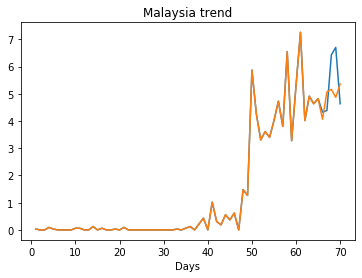

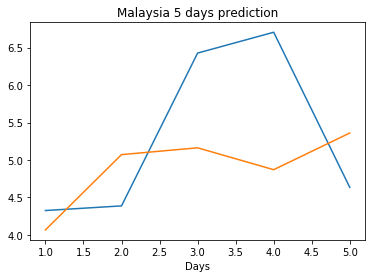

Creating directory ./offline8/Philippines/training/
Philippines
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4872
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4771
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4550
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4404
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4187
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4015
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3960
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3888
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3689
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3607
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0024
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9366
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8335
Saving the best model weights at Epoch [19],

Saving the best model weights at Epoch [29], Best Valid Loss: 1.9600
Saving the best model weights at Epoch [35], Best Valid Loss: 1.9513
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9227
Saving the best model weights at Epoch [39], Best Valid Loss: 1.8936
train error: 0.18335905593606489
1.8936357498168945
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6872
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6148
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5659
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5503
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5492
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5488
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5488
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5486
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5486
train error: 0.2623071512920433
3.548598051071167
Saving t

Saving the best model weights at Epoch [26], Best Valid Loss: 1.9327
Saving the best model weights at Epoch [27], Best Valid Loss: 1.9232
Saving the best model weights at Epoch [28], Best Valid Loss: 1.9206
Saving the best model weights at Epoch [34], Best Valid Loss: 1.9040
Saving the best model weights at Epoch [37], Best Valid Loss: 1.8992
Saving the best model weights at Epoch [41], Best Valid Loss: 1.8769
Saving the best model weights at Epoch [45], Best Valid Loss: 1.8553
Saving the best model weights at Epoch [48], Best Valid Loss: 1.8428
train error: 0.1832910091393084
1.8427571058273315
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5159
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0228
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5397
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5067
train error: 0.08512800348204716
2.5066967010498047
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2664
Savin

Saving the best model weights at Epoch [4], Best Valid Loss: 3.4556
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4493
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4316
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4164
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4144
Saving the best model weights at Epoch [33], Best Valid Loss: 3.3921
train error: 0.27295494882079463
3.3920605182647705
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2753
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9999
train error: 0.2837571433837487
2.9999454021453857
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9106
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8600
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8577
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8334
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8179
Saving

Saving the best model weights at Epoch [5], Best Valid Loss: 3.1787
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1607
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1312
train error: 0.24912152358641226
3.1311821937561035
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1420
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1358
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0553
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0215
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9872
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9113
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9074
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8565
train error: 0.22164234261338908
2.856492757797241
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7368
train error: 0.2837571433837487
2.7368152141571045
Saving the best model wei

Saving the best model weights at Epoch [14], Best Valid Loss: 2.8393
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8332
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8277
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8231
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8221
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8109
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8059
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7877
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7804
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7694
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7662
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7551
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7532
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7456
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.0366
train error: 0.20824371116856735
3.036644220352173
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4666
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4155
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3819
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3533
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3265
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3106
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3005
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2892
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2814
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2731
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2616
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2574
Saving the best model weights at Epoch [14], Best Valid Loss:

Saving the best model weights at Epoch [32], Best Valid Loss: 3.3293
Saving the best model weights at Epoch [33], Best Valid Loss: 3.3277
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3261
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3256
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3245
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3234
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3218
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3204
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3196
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3186
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3178
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3165
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3158
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3139
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 3.0414
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0374
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0342
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0312
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0298
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0274
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0233
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0217
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0194
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0159
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0143
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0106
Saving the best model weights at Epoch [39], Best Valid Loss: 3.0074
Saving the best model weights at Epoch [40], Best Valid Loss: 3.0047
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 3.5932
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5932
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5930
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5927
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5926
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5925
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5924
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5923
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5921
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5918
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5917
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5917
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5916
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5915
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 2.9057
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8925
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8818
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8723
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8663
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8542
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8477
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8414
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8382
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8357
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8334
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8296
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8259
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.4357
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4181
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4026
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3894
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3783
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3680
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3596
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3536
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3474
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3418
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3377
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3332
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3290
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3264
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [38], Best Valid Loss: 2.8927
train error: 0.2366080357382695
2.892744541168213
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6596
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6563
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6534
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6509
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6489
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6470
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6455
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6442
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6430
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6421
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6413
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6406
Saving the best model weights at Epoch [13], Best Valid Loss: 

Saving the best model weights at Epoch [13], Best Valid Loss: 3.2791
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2751
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2740
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2734
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2704
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2692
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2692
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2691
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2690
Saving the best model weights at Epoch [42], Best Valid Loss: 3.2682
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2681
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2673
train error: 0.2555280214796464
3.2672653198242188
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5401
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 3.1926
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1791
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1668
Saving the best model weights at Epoch [12], Best Valid Loss: 3.1557
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1444
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1359
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1279
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1209
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1161
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1107
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1077
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1053
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1017
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0998
Saving the best model weights at Ep

Saving the best model weights at Epoch [4], Best Valid Loss: 3.3451
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3179
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2945
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2751
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2588
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2452
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2336
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2224
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2132
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2043
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1965
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1913
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1860
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1804
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 2.8991
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8951
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8876
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8826
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8803
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8640
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8367
train error: 0.22067668853948513
2.8367202281951904
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5086
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4657
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4301
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4000
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3742
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3524
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [7], Best Valid Loss: 3.2573
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2492
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2308
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2255
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2172
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2105
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2072
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2061
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2022
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1979
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1977
Saving the best model weights at Epoch [33], Best Valid Loss: 3.1960
Saving the best model weights at Epoch [35], Best Valid Loss: 3.1953
train error: 0.21926644186799724
3.1952829360961914
Saving the best model weights at Epoch [1], Best Valid

Saving the best model weights at Epoch [3], Best Valid Loss: 3.3656
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3286
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3057
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2797
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2566
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2276
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2178
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1917
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1895
Saving the best model weights at Epoch [12], Best Valid Loss: 3.1781
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1609
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1479
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1462
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1367
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [33], Best Valid Loss: 3.5443
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5419
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5402
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5384
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5368
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5350
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5333
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5317
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5302
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5291
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5278
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5261
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5247
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5231
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 3.6628
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6619
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6611
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6602
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6594
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6586
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6579
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6572
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6564
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6557
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6550
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6545
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6538
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6531
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.4395
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4361
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4330
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4299
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4267
Saving the best model weights at Epoch [49], Best Valid Loss: 3.4237
Saving the best model weights at Epoch [50], Best Valid Loss: 3.4208
train error: 0.2583978577051312
3.420766592025757
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5830
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5724
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5627
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5534
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5440
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5353
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [29], Best Valid Loss: 3.0310
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0274
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0238
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0202
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0167
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0132
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0100
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0066
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0035
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0001
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9970
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9939
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9909
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9878
Saving the best model weights at E

Saving the best model weights at Epoch [23], Best Valid Loss: 3.6274
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6259
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6245
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6230
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6216
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6202
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6189
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6176
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6162
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6150
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6137
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6125
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6113
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6101
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 3.2960
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2886
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2813
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2741
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2670
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2600
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2532
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2466
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2397
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2333
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2268
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2204
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2143
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2081
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 3.6559
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6539
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6519
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6500
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6481
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6462
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6444
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6426
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6408
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6391
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6374
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6357
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6341
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6325
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.0456
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0451
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0446
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0441
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0436
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0430
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0425
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0420
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0416
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0411
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0407
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0402
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0398
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0394
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 3.1274
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1240
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1220
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1156
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1098
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1087
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1017
train error: 0.21835106971363227
3.1016690731048584
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6980
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6973
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6967
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6961
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6955
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6949
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 3.1616
Saving the best model weights at Epoch [12], Best Valid Loss: 3.1474
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1412
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1394
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1294
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1236
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1199
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1183
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1100
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1020
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0937
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0820
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0817
Saving the best model weights at Epoch [43], Best Valid Loss: 3.0767
train error: 0.2169802836763362
3.

Saving the best model weights at Epoch [4], Best Valid Loss: 3.5334
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5201
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5071
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4952
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4876
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4800
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4746
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4656
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4594
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4573
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4524
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4520
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4488
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4465
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [46], Best Valid Loss: 3.5781
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5770
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5759
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5748
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5738
train error: 0.24940422916164
3.573835849761963
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5520
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4701
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3738
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3142
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2459
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1905
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1423
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1224
Saving the best model weights at Epoch [9], Best Valid Loss: 3.

Saving the best model weights at Epoch [31], Best Valid Loss: 3.4402
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4366
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4330
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4297
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4263
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4231
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4200
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4173
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4139
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4110
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4082
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4055
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4029
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4007
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 3.4199
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4136
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4084
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4027
Saving the best model weights at Epoch [28], Best Valid Loss: 3.3976
Saving the best model weights at Epoch [29], Best Valid Loss: 3.3924
Saving the best model weights at Epoch [30], Best Valid Loss: 3.3871
Saving the best model weights at Epoch [31], Best Valid Loss: 3.3825
Saving the best model weights at Epoch [32], Best Valid Loss: 3.3776
Saving the best model weights at Epoch [33], Best Valid Loss: 3.3731
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3686
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3645
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3600
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3558
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6674
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6635
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6596
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6558
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6523
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6489
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6455
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6423
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6393
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6361
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6332
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6303
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6276
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [44], Best Valid Loss: 3.2415
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2367
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2319
Saving the best model weights at Epoch [47], Best Valid Loss: 3.2272
Saving the best model weights at Epoch [48], Best Valid Loss: 3.2227
Saving the best model weights at Epoch [49], Best Valid Loss: 3.2180
Saving the best model weights at Epoch [50], Best Valid Loss: 3.2135
train error: 0.22489981719603142
3.213548421859741
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5992
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5850
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5715
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5591
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5457
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5344
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [4], Best Valid Loss: 3.6807
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6800
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6786
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6779
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6772
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6766
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6759
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6753
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6747
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6741
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6735
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6729
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6723
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [20], Best Valid Loss: 3.6297
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6275
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6253
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6231
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6210
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6189
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6169
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6149
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6129
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6110
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6091
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6072
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6054
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6036
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 3.6534
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6525
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6516
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6507
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6498
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6489
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6481
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6472
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6464
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6456
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6448
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6440
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6432
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6425
Saving the best model weights at Ep

Saving the best model weights at Epoch [25], Best Valid Loss: 3.3182
Saving the best model weights at Epoch [26], Best Valid Loss: 3.3175
Saving the best model weights at Epoch [27], Best Valid Loss: 3.3168
Saving the best model weights at Epoch [28], Best Valid Loss: 3.3160
Saving the best model weights at Epoch [29], Best Valid Loss: 3.3153
Saving the best model weights at Epoch [30], Best Valid Loss: 3.3146
Saving the best model weights at Epoch [31], Best Valid Loss: 3.3139
Saving the best model weights at Epoch [32], Best Valid Loss: 3.3132
Saving the best model weights at Epoch [33], Best Valid Loss: 3.3125
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3117
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3110
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3103
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3096
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3089
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 3.6485
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6485
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6485
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6484
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6484
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6484
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6484
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6484
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6484
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6483
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6483
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6483
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6483
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6483
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 3.2988
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2946
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2896
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2850
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2808
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2771
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2722
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2695
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2635
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2597
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2569
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2518
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2484
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2448
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 3.6345
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6339
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6333
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6328
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6323
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6317
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6311
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6306
train error: 0.27468962838562827
3.630610704421997
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4653
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4558
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4487
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4401
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4301
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [9], Best Valid Loss: 3.5122
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5052
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5004
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4930
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4851
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4797
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4743
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4669
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4619
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4564
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4488
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4434
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4386
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4313
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 3.1744
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1741
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1738
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1734
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1731
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1728
Saving the best model weights at Epoch [33], Best Valid Loss: 3.1725
Saving the best model weights at Epoch [34], Best Valid Loss: 3.1722
Saving the best model weights at Epoch [35], Best Valid Loss: 3.1718
Saving the best model weights at Epoch [36], Best Valid Loss: 3.1715
Saving the best model weights at Epoch [37], Best Valid Loss: 3.1712
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1708
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1706
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1702
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 3.6774
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6774
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6773
train error: 0.27783752491232006
3.677253007888794
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5906
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5900
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5894
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5887
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5881
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5876
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5870
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 3.6204
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6201
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6198
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6195
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6192
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6188
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6185
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6182
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6179
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6176
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6173
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6170
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6167
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6164
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 3.4451
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4433
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4419
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4405
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4382
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4370
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4354
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4338
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4315
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4296
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4285
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4276
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4255
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4236
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.6288
train error: 0.2749374211765826
3.6287648677825928
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6004
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5945
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5872
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5812
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5745
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5678
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5608
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5548
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5473
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5420
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5361
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5300
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 3.3935
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3924
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3915
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3905
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3895
Saving the best model weights at Epoch [22], Best Valid Loss: 3.3886
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3876
Saving the best model weights at Epoch [24], Best Valid Loss: 3.3866
Saving the best model weights at Epoch [25], Best Valid Loss: 3.3856
Saving the best model weights at Epoch [26], Best Valid Loss: 3.3846
Saving the best model weights at Epoch [27], Best Valid Loss: 3.3836
Saving the best model weights at Epoch [28], Best Valid Loss: 3.3827
Saving the best model weights at Epoch [29], Best Valid Loss: 3.3817
Saving the best model weights at Epoch [30], Best Valid Loss: 3.3807
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 3.5103
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5096
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5090
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5083
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5077
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5071
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5064
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5058
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5051
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5045
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5039
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5032
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5026
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5019
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.5680
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5675
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5670
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5665
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5660
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5655
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5651
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5646
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5641
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5636
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5631
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5627
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5622
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5617
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 3.3526
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3456
Saving the best model weights at Epoch [22], Best Valid Loss: 3.3382
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3314
Saving the best model weights at Epoch [24], Best Valid Loss: 3.3258
Saving the best model weights at Epoch [25], Best Valid Loss: 3.3203
Saving the best model weights at Epoch [26], Best Valid Loss: 3.3135
Saving the best model weights at Epoch [27], Best Valid Loss: 3.3064
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2989
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2930
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2883
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2810
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2761
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2704
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 3.5137
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5125
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5114
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5103
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5092
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5081
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5070
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5058
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5049
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5036
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5024
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5014
train error: 0.2536468020097042
3.501422643661499
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5062
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [5], Best Valid Loss: 3.3778
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3747
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3696
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3655
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3625
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3574
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3541
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3511
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3468
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3436
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3402
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3376
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3339
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3288
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 3.4434
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4423
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4410
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4399
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4388
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4376
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4365
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4353
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4342
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4331
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4319
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4308
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4296
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4285
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 3.6205
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6203
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6200
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6198
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6196
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6194
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6192
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6190
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6188
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6186
train error: 0.25868710815751306
3.618595838546753
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5888
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5882
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5876
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 3.6006
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6001
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5997
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5992
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5987
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5982
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5977
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5972
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5968
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5963
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5958
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5953
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5948
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5944
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 3.6087
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6058
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6029
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6006
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5975
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5950
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5923
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5900
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5878
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5852
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5828
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5805
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5779
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5753
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.6135
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6134
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6133
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6133
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6132
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6132
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6131
train error: 0.26869224856297175
3.613128662109375
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4673
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4664
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4660
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4656
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4650
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4645
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5988
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5980
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5972
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5964
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5956
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5948
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5940
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5931
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5924
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5916
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5908
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5900
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5892
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.4784
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4775
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4765
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4755
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4745
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4735
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4726
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4716
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4706
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4697
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4687
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4677
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4667
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4658
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.6932
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6923
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6913
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6904
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6895
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6885
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6876
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6867
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6857
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6848
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6839
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6829
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6820
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6811
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 3.4426
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4358
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4311
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4249
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4196
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4149
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4092
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4029
Saving the best model weights at Epoch [27], Best Valid Loss: 3.3980
Saving the best model weights at Epoch [28], Best Valid Loss: 3.3933
Saving the best model weights at Epoch [29], Best Valid Loss: 3.3895
Saving the best model weights at Epoch [30], Best Valid Loss: 3.3830
Saving the best model weights at Epoch [31], Best Valid Loss: 3.3788
Saving the best model weights at Epoch [32], Best Valid Loss: 3.3747
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.3884
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3884
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3884
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3883
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3883
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3883
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3883
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3882
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3882
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3882
Saving the best model weights at Epoch [47], Best Valid Loss: 3.3882
Saving the best model weights at Epoch [48], Best Valid Loss: 3.3882
Saving the best model weights at Epoch [49], Best Valid Loss: 3.3881
Saving the best model weights at Epoch [50], Best Valid Loss: 3.3881
train error: 0.2567321991082281
3.

Saving the best model weights at Epoch [4], Best Valid Loss: 3.6197
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6197
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6196
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6196
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6195
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6195
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6194
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6194
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6193
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6193
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6192
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6192
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6191
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6191
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 3.5882
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5881
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5881
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5880
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5879
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5879
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5878
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5878
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5877
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5877
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5876
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5875
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5875
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5874
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 3.4198
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4193
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4187
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4179
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4173
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4167
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4160
Saving the best model weights at Epoch [49], Best Valid Loss: 3.4155
Saving the best model weights at Epoch [50], Best Valid Loss: 3.4148
train error: 0.2601781928446144
3.414767026901245
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6623
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6623
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6623
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6623
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 3.5838
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5831
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5820
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5809
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5801
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5792
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5783
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5773
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5764
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5754
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5745
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5734
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5725
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5717
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.4246
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4246
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4244
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4243
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4242
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4241
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4240
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4239
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4238
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4237
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4236
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4235
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4234
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4233
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 3.6399
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6399
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6398
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6397
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6397
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6396
train error: 0.27434706723627944
3.6396076679229736
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6974
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6972
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6969
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6967
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6965
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6962
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6959
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 3.6735
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6734
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6734
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6734
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6734
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6733
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6733
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6733
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6733
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6733
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6732
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6732
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6732
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6732
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.6928
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6928
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6928
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6927
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6927
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6927
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6926
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6926
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6926
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6926
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6925
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6925
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6925
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6925
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 3.5992
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5986
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5978
train error: 0.2744525892465996
3.597848892211914
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6291
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6291
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6291
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6290
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6290
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6290
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6290
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6289
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6289
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6289
Saving the best model weights at Epoch [11], Best Valid Loss: 

Saving the best model weights at Epoch [15], Best Valid Loss: 3.2952
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2947
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2941
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2937
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2931
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2927
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2922
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2917
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2912
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2906
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2901
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2896
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2892
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2887
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.6696
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6695
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6695
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6694
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6694
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6693
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6693
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6692
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6691
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6691
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6690
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6690
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6689
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6689
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.5981
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5980
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5978
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5977
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5975
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5974
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5972
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5971
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5970
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5968
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5967
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5965
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5964
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5962
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 3.6400
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6400
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6400
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6399
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6399
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6398
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6398
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6398
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6397
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6397
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6397
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6396
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6396
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6396
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 3.5250
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5250
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5249
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5249
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5249
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5249
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5249
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5249
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5248
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5248
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5248
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5248
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5248
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5247
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 3.4001
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4001
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4000
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4000
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4000
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3999
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3999
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3999
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3998
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3998
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3998
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3997
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3997
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3997
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 3.4826
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4818
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4808
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4799
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4789
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4779
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4771
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4761
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4753
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4744
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4735
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4725
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4716
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4706
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 3.6789
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6789
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6788
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6788
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6788
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6787
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6787
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6786
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6786
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6785
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6785
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6784
train error: 0.2753900581514851
3.6784462928771973
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6094
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [6], Best Valid Loss: 3.6518
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6516
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6514
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6512
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6510
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6508
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6507
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6505
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6503
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6501
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6499
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6498
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6496
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6494
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 3.5271
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5270
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5270
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5269
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5269
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5269
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5268
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5268
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5267
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5267
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5267
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5266
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5266
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5265
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 3.6261
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6259
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6257
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6255
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6253
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6251
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6249
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6248
train error: 0.2637086039253821
3.6247735023498535
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6217
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6216
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6216
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6216
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6216
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 3.3987
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3984
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3979
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3975
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3971
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3966
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3962
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3959
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3954
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3950
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3946
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3941
Saving the best model weights at Epoch [22], Best Valid Loss: 3.3939
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3934
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 3.5828
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5826
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5825
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5823
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5822
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5820
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5819
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5817
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5815
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5814
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5812
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5811
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5809
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5808
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 3.6338
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6338
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6338
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6337
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6337
train error: 0.27461651645523183
3.633687734603882
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5736
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5734
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5732
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5730
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5728
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5726
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5724
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5722
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [13], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2735
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2735
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4936
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5996
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5995
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5995
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5995
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5995
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 3.5166
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5165
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5165
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5164
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5163
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5163
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5162
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5161
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5160
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5160
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5159
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5158
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5158
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5157
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 3.6227
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6225
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6225
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6225
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6225
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6225
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6225
train error: 0.27430097554655125
3.6224637031555176
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [4], Best Valid Loss: 3.1957
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1957
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1956
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1956
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1956
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1956
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1955
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1955
Saving the best model weights at Epoch [12], Best Valid Loss: 3.1955
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1955
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1954
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1954
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1954
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1954
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 3.6062
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6062
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6062
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6062
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6062
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6061
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 3.5981
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5980
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5980
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5980
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5980
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5979
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5979
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5979
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5978
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5978
train error: 0.2706552415077264
3.5977895259857178
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5268
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5268
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5268
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 3.6573
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6572
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6572
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6571
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6570
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6569
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6569
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6567
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6566
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6566
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6565
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6564
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6563
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4908
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4908
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.6831
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6831
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6831
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6831
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6831
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6831
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6831
train error: 0.2776334310457363
3.6830780506134033
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6566
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6566
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6566
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6566
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6566
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6565
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5712
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.6826
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6826
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6825
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6825
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6824
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6824
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6823
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6822
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6822
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6821
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6821
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6820
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6820
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6819
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 3.6422
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6422
train error: 0.2750469789219399
3.6422359943389893
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5895
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5895
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5894
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5894
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5893
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5893
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5892
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5892
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5891
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5891
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5891
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [16], Best Valid Loss: 3.4684
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4684
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4684
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4684
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4683
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6144
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5539
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5538
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5538
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5538
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5538
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5538
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 3.5528
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5527
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5526
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5525
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5524
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5523
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5522
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5521
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5520
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5519
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5518
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5517
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5517
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5515
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.6680
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6680
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6680
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6680
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6679
train error: 0.2722919904607503
3.

Saving the best model weights at Epoch [4], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3963
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3963
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3963
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3963
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3963
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6671
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6670
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6670
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6670
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 3.6508
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6508
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6508
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6507
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6507
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6507
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6506
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6506
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6506
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6506
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6505
train error: 0.2715495970953877
3.6505298614501953
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6176
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6176
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 3.5329
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5328
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5328
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5328
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5327
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5327
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5327
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5326
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5326
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5325
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5325
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5325
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5324
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5324
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6726
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6725
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6725
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6725
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6725
Saving the best model weights at E

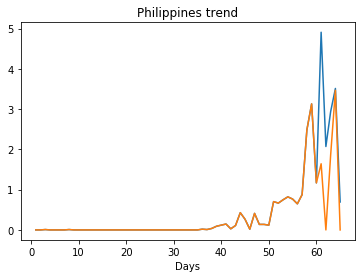

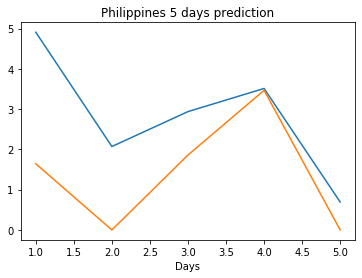

Creating directory ./offline8/Singapore/training/
Singapore
Saving the best model weights at Epoch [1], Best Valid Loss: 32.7796
Saving the best model weights at Epoch [2], Best Valid Loss: 18.9898
Saving the best model weights at Epoch [3], Best Valid Loss: 15.9424
Saving the best model weights at Epoch [7], Best Valid Loss: 15.8057
Saving the best model weights at Epoch [8], Best Valid Loss: 15.3955
Saving the best model weights at Epoch [10], Best Valid Loss: 15.0647
train error: 7.82072055591522
15.064668655395508
Saving the best model weights at Epoch [1], Best Valid Loss: 42.7585
Saving the best model weights at Epoch [2], Best Valid Loss: 29.1187
Saving the best model weights at Epoch [3], Best Valid Loss: 16.5793
Saving the best model weights at Epoch [4], Best Valid Loss: 10.5742
Saving the best model weights at Epoch [7], Best Valid Loss: 7.3128
Saving the best model weights at Epoch [9], Best Valid Loss: 6.1678
Saving the best model weights at Epoch [40], Best Valid Loss: 5.

Saving the best model weights at Epoch [37], Best Valid Loss: 42.3178
Saving the best model weights at Epoch [39], Best Valid Loss: 41.6953
Saving the best model weights at Epoch [42], Best Valid Loss: 41.6751
Saving the best model weights at Epoch [46], Best Valid Loss: 41.4309
train error: 13.54451854708227
41.430908203125
Saving the best model weights at Epoch [1], Best Valid Loss: 45.0744
Saving the best model weights at Epoch [2], Best Valid Loss: 41.9832
Saving the best model weights at Epoch [17], Best Valid Loss: 34.7446
Saving the best model weights at Epoch [18], Best Valid Loss: 30.5151
Saving the best model weights at Epoch [25], Best Valid Loss: 30.1667
Saving the best model weights at Epoch [29], Best Valid Loss: 29.1684
Saving the best model weights at Epoch [39], Best Valid Loss: 28.0917
Saving the best model weights at Epoch [41], Best Valid Loss: 25.8236
Saving the best model weights at Epoch [42], Best Valid Loss: 20.5891
train error: 15.081543638094052
20.5890922546

Saving the best model weights at Epoch [7], Best Valid Loss: 66.6664
Saving the best model weights at Epoch [15], Best Valid Loss: 66.3101
Saving the best model weights at Epoch [19], Best Valid Loss: 66.0086
Saving the best model weights at Epoch [43], Best Valid Loss: 58.9882
Saving the best model weights at Epoch [44], Best Valid Loss: 44.5059
train error: 16.825641595028543
44.50593185424805
Saving the best model weights at Epoch [1], Best Valid Loss: 59.3374
Saving the best model weights at Epoch [2], Best Valid Loss: 58.2671
Saving the best model weights at Epoch [4], Best Valid Loss: 57.7745
Saving the best model weights at Epoch [9], Best Valid Loss: 53.1651
Saving the best model weights at Epoch [13], Best Valid Loss: 52.7210
Saving the best model weights at Epoch [14], Best Valid Loss: 52.3470
train error: 21.13284114275027
52.34700393676758
Saving the best model weights at Epoch [1], Best Valid Loss: 53.9219
Saving the best model weights at Epoch [2], Best Valid Loss: 49.760

Saving the best model weights at Epoch [20], Best Valid Loss: 9.7833
Saving the best model weights at Epoch [21], Best Valid Loss: 8.7761
Saving the best model weights at Epoch [22], Best Valid Loss: 7.3743
Saving the best model weights at Epoch [23], Best Valid Loss: 6.6202
Saving the best model weights at Epoch [24], Best Valid Loss: 6.5204
Saving the best model weights at Epoch [25], Best Valid Loss: 6.1418
Saving the best model weights at Epoch [26], Best Valid Loss: 5.9782
Saving the best model weights at Epoch [29], Best Valid Loss: 5.9485
train error: 1.0140222351293307
5.948455810546875
Saving the best model weights at Epoch [1], Best Valid Loss: 39.9867
Saving the best model weights at Epoch [2], Best Valid Loss: 36.9439
Saving the best model weights at Epoch [3], Best Valid Loss: 22.9483
Saving the best model weights at Epoch [4], Best Valid Loss: 16.6307
Saving the best model weights at Epoch [5], Best Valid Loss: 12.2767
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [15], Best Valid Loss: 54.4531
Saving the best model weights at Epoch [16], Best Valid Loss: 53.9149
Saving the best model weights at Epoch [17], Best Valid Loss: 53.2375
Saving the best model weights at Epoch [18], Best Valid Loss: 52.4307
Saving the best model weights at Epoch [19], Best Valid Loss: 51.5342
Saving the best model weights at Epoch [20], Best Valid Loss: 50.4286
Saving the best model weights at Epoch [21], Best Valid Loss: 46.8809
Saving the best model weights at Epoch [22], Best Valid Loss: 43.1041
Saving the best model weights at Epoch [23], Best Valid Loss: 39.9235
Saving the best model weights at Epoch [24], Best Valid Loss: 36.8979
Saving the best model weights at Epoch [25], Best Valid Loss: 34.4467
Saving the best model weights at Epoch [26], Best Valid Loss: 32.4527
Saving the best model weights at Epoch [27], Best Valid Loss: 31.2546
Saving the best model weights at Epoch [28], Best Valid Loss: 29.1405
Saving the best mode

Saving the best model weights at Epoch [11], Best Valid Loss: 11.4440
Saving the best model weights at Epoch [12], Best Valid Loss: 10.7841
Saving the best model weights at Epoch [13], Best Valid Loss: 10.6545
Saving the best model weights at Epoch [14], Best Valid Loss: 10.5062
Saving the best model weights at Epoch [15], Best Valid Loss: 10.4506
train error: 6.289065127135129
10.450583457946777
Saving the best model weights at Epoch [1], Best Valid Loss: 62.0746
Saving the best model weights at Epoch [2], Best Valid Loss: 49.0736
Saving the best model weights at Epoch [3], Best Valid Loss: 35.8256
Saving the best model weights at Epoch [4], Best Valid Loss: 23.9574
Saving the best model weights at Epoch [5], Best Valid Loss: 14.8701
Saving the best model weights at Epoch [6], Best Valid Loss: 4.8245
Saving the best model weights at Epoch [7], Best Valid Loss: 4.0718
train error: 1.2127939669062962
4.071753978729248
Saving the best model weights at Epoch [1], Best Valid Loss: 62.1737


Saving the best model weights at Epoch [49], Best Valid Loss: 52.0941
Saving the best model weights at Epoch [50], Best Valid Loss: 49.7939
train error: 13.26802289103334
49.79385757446289
Saving the best model weights at Epoch [1], Best Valid Loss: 52.5075
Saving the best model weights at Epoch [2], Best Valid Loss: 49.5498
Saving the best model weights at Epoch [4], Best Valid Loss: 47.8940
Saving the best model weights at Epoch [5], Best Valid Loss: 42.6490
Saving the best model weights at Epoch [6], Best Valid Loss: 30.3114
Saving the best model weights at Epoch [9], Best Valid Loss: 29.5082
Saving the best model weights at Epoch [10], Best Valid Loss: 23.1309
Saving the best model weights at Epoch [11], Best Valid Loss: 22.1646
Saving the best model weights at Epoch [48], Best Valid Loss: 22.0190
Saving the best model weights at Epoch [50], Best Valid Loss: 21.9809
train error: 5.805297671943097
21.98089599609375
Saving the best model weights at Epoch [1], Best Valid Loss: 70.2430

train error: 1.7150149611202445
6.04738712310791
Saving the best model weights at Epoch [1], Best Valid Loss: 66.6778
Saving the best model weights at Epoch [2], Best Valid Loss: 60.7179
Saving the best model weights at Epoch [3], Best Valid Loss: 56.8135
Saving the best model weights at Epoch [4], Best Valid Loss: 53.5546
Saving the best model weights at Epoch [5], Best Valid Loss: 51.6489
Saving the best model weights at Epoch [6], Best Valid Loss: 50.2633
Saving the best model weights at Epoch [7], Best Valid Loss: 49.3427
Saving the best model weights at Epoch [8], Best Valid Loss: 48.3595
Saving the best model weights at Epoch [9], Best Valid Loss: 48.0045
Saving the best model weights at Epoch [10], Best Valid Loss: 47.7571
Saving the best model weights at Epoch [11], Best Valid Loss: 47.5207
Saving the best model weights at Epoch [12], Best Valid Loss: 46.9961
Saving the best model weights at Epoch [13], Best Valid Loss: 46.7799
Saving the best model weights at Epoch [14], Best 

Saving the best model weights at Epoch [7], Best Valid Loss: 65.3470
Saving the best model weights at Epoch [8], Best Valid Loss: 64.8253
Saving the best model weights at Epoch [9], Best Valid Loss: 64.3798
Saving the best model weights at Epoch [10], Best Valid Loss: 64.0333
Saving the best model weights at Epoch [11], Best Valid Loss: 63.7566
Saving the best model weights at Epoch [12], Best Valid Loss: 63.5678
Saving the best model weights at Epoch [13], Best Valid Loss: 63.3816
Saving the best model weights at Epoch [14], Best Valid Loss: 63.2447
Saving the best model weights at Epoch [15], Best Valid Loss: 63.1391
Saving the best model weights at Epoch [16], Best Valid Loss: 63.0560
Saving the best model weights at Epoch [17], Best Valid Loss: 62.9859
Saving the best model weights at Epoch [18], Best Valid Loss: 62.9405
Saving the best model weights at Epoch [19], Best Valid Loss: 62.8974
Saving the best model weights at Epoch [20], Best Valid Loss: 62.8517
Saving the best model w

Saving the best model weights at Epoch [17], Best Valid Loss: 42.2640
Saving the best model weights at Epoch [18], Best Valid Loss: 42.2348
Saving the best model weights at Epoch [20], Best Valid Loss: 42.1849
Saving the best model weights at Epoch [21], Best Valid Loss: 42.1489
Saving the best model weights at Epoch [24], Best Valid Loss: 42.0227
Saving the best model weights at Epoch [25], Best Valid Loss: 41.9384
Saving the best model weights at Epoch [29], Best Valid Loss: 41.9295
Saving the best model weights at Epoch [30], Best Valid Loss: 41.6697
Saving the best model weights at Epoch [31], Best Valid Loss: 41.6266
train error: 14.061171280371177
41.626583099365234
Saving the best model weights at Epoch [1], Best Valid Loss: 67.3002
Saving the best model weights at Epoch [2], Best Valid Loss: 61.8243
Saving the best model weights at Epoch [3], Best Valid Loss: 57.5480
Saving the best model weights at Epoch [4], Best Valid Loss: 54.9353
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [19], Best Valid Loss: 9.6604
train error: 6.5799653913725065
9.660391807556152
Saving the best model weights at Epoch [1], Best Valid Loss: 68.7049
Saving the best model weights at Epoch [2], Best Valid Loss: 63.6420
Saving the best model weights at Epoch [3], Best Valid Loss: 59.4942
Saving the best model weights at Epoch [4], Best Valid Loss: 56.0827
Saving the best model weights at Epoch [5], Best Valid Loss: 53.3952
Saving the best model weights at Epoch [6], Best Valid Loss: 51.1877
Saving the best model weights at Epoch [7], Best Valid Loss: 49.3159
Saving the best model weights at Epoch [8], Best Valid Loss: 47.9780
Saving the best model weights at Epoch [9], Best Valid Loss: 46.8386
Saving the best model weights at Epoch [10], Best Valid Loss: 45.9049
Saving the best model weights at Epoch [11], Best Valid Loss: 45.1465
Saving the best model weights at Epoch [12], Best Valid Loss: 44.4460
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [17], Best Valid Loss: 42.7996
Saving the best model weights at Epoch [18], Best Valid Loss: 42.6700
Saving the best model weights at Epoch [19], Best Valid Loss: 42.5498
Saving the best model weights at Epoch [23], Best Valid Loss: 42.5157
Saving the best model weights at Epoch [24], Best Valid Loss: 42.4029
Saving the best model weights at Epoch [25], Best Valid Loss: 42.3647
Saving the best model weights at Epoch [27], Best Valid Loss: 42.3340
Saving the best model weights at Epoch [29], Best Valid Loss: 42.2805
Saving the best model weights at Epoch [30], Best Valid Loss: 42.1380
Saving the best model weights at Epoch [31], Best Valid Loss: 42.0764
train error: 13.445788589683739
42.076351165771484
Saving the best model weights at Epoch [1], Best Valid Loss: 63.7712
Saving the best model weights at Epoch [2], Best Valid Loss: 56.2942
Saving the best model weights at Epoch [3], Best Valid Loss: 51.2553
Saving the best model weights at Epoch [4]

Saving the best model weights at Epoch [31], Best Valid Loss: 35.0454
Saving the best model weights at Epoch [32], Best Valid Loss: 34.1690
Saving the best model weights at Epoch [33], Best Valid Loss: 33.3419
Saving the best model weights at Epoch [34], Best Valid Loss: 32.5561
Saving the best model weights at Epoch [35], Best Valid Loss: 31.8135
Saving the best model weights at Epoch [36], Best Valid Loss: 31.1010
Saving the best model weights at Epoch [37], Best Valid Loss: 30.4097
Saving the best model weights at Epoch [38], Best Valid Loss: 29.7432
Saving the best model weights at Epoch [39], Best Valid Loss: 29.1067
Saving the best model weights at Epoch [40], Best Valid Loss: 28.4928
Saving the best model weights at Epoch [41], Best Valid Loss: 27.8961
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3219
Saving the best model weights at Epoch [43], Best Valid Loss: 26.7787
Saving the best model weights at Epoch [44], Best Valid Loss: 26.2407
Saving the best mode

Saving the best model weights at Epoch [7], Best Valid Loss: 51.8744
Saving the best model weights at Epoch [8], Best Valid Loss: 48.1130
Saving the best model weights at Epoch [9], Best Valid Loss: 44.4891
Saving the best model weights at Epoch [10], Best Valid Loss: 40.9889
Saving the best model weights at Epoch [11], Best Valid Loss: 37.6708
Saving the best model weights at Epoch [12], Best Valid Loss: 34.4720
Saving the best model weights at Epoch [13], Best Valid Loss: 31.5015
Saving the best model weights at Epoch [14], Best Valid Loss: 28.8170
Saving the best model weights at Epoch [15], Best Valid Loss: 26.3387
Saving the best model weights at Epoch [16], Best Valid Loss: 24.1887
Saving the best model weights at Epoch [17], Best Valid Loss: 22.2550
Saving the best model weights at Epoch [18], Best Valid Loss: 20.5303
Saving the best model weights at Epoch [19], Best Valid Loss: 19.0172
Saving the best model weights at Epoch [20], Best Valid Loss: 17.6727
Saving the best model w

Saving the best model weights at Epoch [20], Best Valid Loss: 12.3624
Saving the best model weights at Epoch [21], Best Valid Loss: 11.4875
Saving the best model weights at Epoch [22], Best Valid Loss: 10.7247
Saving the best model weights at Epoch [23], Best Valid Loss: 10.0590
Saving the best model weights at Epoch [24], Best Valid Loss: 9.4944
Saving the best model weights at Epoch [25], Best Valid Loss: 9.0059
Saving the best model weights at Epoch [26], Best Valid Loss: 8.5717
Saving the best model weights at Epoch [27], Best Valid Loss: 8.2022
Saving the best model weights at Epoch [28], Best Valid Loss: 7.8712
Saving the best model weights at Epoch [29], Best Valid Loss: 7.5845
Saving the best model weights at Epoch [30], Best Valid Loss: 7.3394
Saving the best model weights at Epoch [31], Best Valid Loss: 7.1283
Saving the best model weights at Epoch [32], Best Valid Loss: 6.9453
Saving the best model weights at Epoch [33], Best Valid Loss: 6.7919
Saving the best model weights 

train error: 0.4621923262807163
5.304713726043701
Saving the best model weights at Epoch [1], Best Valid Loss: 72.3661
Saving the best model weights at Epoch [2], Best Valid Loss: 71.8618
Saving the best model weights at Epoch [3], Best Valid Loss: 71.3689
Saving the best model weights at Epoch [4], Best Valid Loss: 70.8885
Saving the best model weights at Epoch [5], Best Valid Loss: 70.4130
Saving the best model weights at Epoch [6], Best Valid Loss: 69.9452
Saving the best model weights at Epoch [7], Best Valid Loss: 69.4889
Saving the best model weights at Epoch [8], Best Valid Loss: 69.0433
Saving the best model weights at Epoch [9], Best Valid Loss: 68.6009
Saving the best model weights at Epoch [10], Best Valid Loss: 68.1674
Saving the best model weights at Epoch [11], Best Valid Loss: 67.7435
Saving the best model weights at Epoch [12], Best Valid Loss: 67.3276
Saving the best model weights at Epoch [13], Best Valid Loss: 66.9190
Saving the best model weights at Epoch [14], Best

Saving the best model weights at Epoch [17], Best Valid Loss: 70.1082
Saving the best model weights at Epoch [18], Best Valid Loss: 70.0562
Saving the best model weights at Epoch [19], Best Valid Loss: 69.9680
Saving the best model weights at Epoch [20], Best Valid Loss: 69.9445
Saving the best model weights at Epoch [21], Best Valid Loss: 69.9078
Saving the best model weights at Epoch [22], Best Valid Loss: 69.8671
Saving the best model weights at Epoch [23], Best Valid Loss: 69.8235
Saving the best model weights at Epoch [24], Best Valid Loss: 69.7790
Saving the best model weights at Epoch [25], Best Valid Loss: 69.7343
Saving the best model weights at Epoch [26], Best Valid Loss: 69.6630
Saving the best model weights at Epoch [27], Best Valid Loss: 69.6028
Saving the best model weights at Epoch [28], Best Valid Loss: 69.5175
Saving the best model weights at Epoch [29], Best Valid Loss: 69.3573
Saving the best model weights at Epoch [30], Best Valid Loss: 67.5795
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 52.3747
Saving the best model weights at Epoch [34], Best Valid Loss: 51.7945
Saving the best model weights at Epoch [35], Best Valid Loss: 51.3067
Saving the best model weights at Epoch [36], Best Valid Loss: 50.8287
Saving the best model weights at Epoch [37], Best Valid Loss: 50.2765
Saving the best model weights at Epoch [38], Best Valid Loss: 49.8227
Saving the best model weights at Epoch [39], Best Valid Loss: 49.2446
Saving the best model weights at Epoch [40], Best Valid Loss: 48.7270
Saving the best model weights at Epoch [41], Best Valid Loss: 48.2535
Saving the best model weights at Epoch [42], Best Valid Loss: 47.6918
Saving the best model weights at Epoch [43], Best Valid Loss: 47.2436
Saving the best model weights at Epoch [44], Best Valid Loss: 46.5964
Saving the best model weights at Epoch [45], Best Valid Loss: 46.0217
Saving the best model weights at Epoch [46], Best Valid Loss: 45.5100
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 30.0790
Saving the best model weights at Epoch [31], Best Valid Loss: 28.2030
Saving the best model weights at Epoch [32], Best Valid Loss: 26.4571
Saving the best model weights at Epoch [33], Best Valid Loss: 24.8070
Saving the best model weights at Epoch [34], Best Valid Loss: 23.0423
Saving the best model weights at Epoch [35], Best Valid Loss: 21.4076
Saving the best model weights at Epoch [36], Best Valid Loss: 19.8188
Saving the best model weights at Epoch [37], Best Valid Loss: 18.2955
Saving the best model weights at Epoch [38], Best Valid Loss: 16.8459
Saving the best model weights at Epoch [39], Best Valid Loss: 15.5018
Saving the best model weights at Epoch [40], Best Valid Loss: 14.2419
Saving the best model weights at Epoch [41], Best Valid Loss: 13.1264
Saving the best model weights at Epoch [42], Best Valid Loss: 12.0461
Saving the best model weights at Epoch [43], Best Valid Loss: 11.1270
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 51.5530
Saving the best model weights at Epoch [28], Best Valid Loss: 50.3324
Saving the best model weights at Epoch [29], Best Valid Loss: 48.9744
Saving the best model weights at Epoch [30], Best Valid Loss: 47.7649
Saving the best model weights at Epoch [31], Best Valid Loss: 46.4576
Saving the best model weights at Epoch [32], Best Valid Loss: 45.1552
Saving the best model weights at Epoch [33], Best Valid Loss: 43.9289
Saving the best model weights at Epoch [34], Best Valid Loss: 42.6852
Saving the best model weights at Epoch [35], Best Valid Loss: 41.6001
Saving the best model weights at Epoch [36], Best Valid Loss: 40.3836
Saving the best model weights at Epoch [37], Best Valid Loss: 39.4081
Saving the best model weights at Epoch [38], Best Valid Loss: 38.2728
Saving the best model weights at Epoch [39], Best Valid Loss: 37.3141
Saving the best model weights at Epoch [40], Best Valid Loss: 36.4213
Saving the best mode

Saving the best model weights at Epoch [23], Best Valid Loss: 63.7218
Saving the best model weights at Epoch [24], Best Valid Loss: 63.4584
Saving the best model weights at Epoch [25], Best Valid Loss: 63.1941
Saving the best model weights at Epoch [26], Best Valid Loss: 62.9204
Saving the best model weights at Epoch [27], Best Valid Loss: 62.6982
Saving the best model weights at Epoch [28], Best Valid Loss: 62.4465
Saving the best model weights at Epoch [29], Best Valid Loss: 62.2276
Saving the best model weights at Epoch [30], Best Valid Loss: 62.0025
Saving the best model weights at Epoch [31], Best Valid Loss: 61.8169
Saving the best model weights at Epoch [32], Best Valid Loss: 61.5906
Saving the best model weights at Epoch [33], Best Valid Loss: 61.3873
Saving the best model weights at Epoch [34], Best Valid Loss: 61.2025
Saving the best model weights at Epoch [35], Best Valid Loss: 61.0402
Saving the best model weights at Epoch [36], Best Valid Loss: 60.8561
Saving the best mode

Saving the best model weights at Epoch [12], Best Valid Loss: 67.1578
Saving the best model weights at Epoch [13], Best Valid Loss: 66.5061
Saving the best model weights at Epoch [14], Best Valid Loss: 65.8011
Saving the best model weights at Epoch [15], Best Valid Loss: 65.1694
Saving the best model weights at Epoch [16], Best Valid Loss: 64.5497
Saving the best model weights at Epoch [17], Best Valid Loss: 63.9492
Saving the best model weights at Epoch [18], Best Valid Loss: 63.3796
Saving the best model weights at Epoch [19], Best Valid Loss: 62.8232
Saving the best model weights at Epoch [20], Best Valid Loss: 62.3050
Saving the best model weights at Epoch [21], Best Valid Loss: 61.8018
Saving the best model weights at Epoch [22], Best Valid Loss: 61.3112
Saving the best model weights at Epoch [23], Best Valid Loss: 60.8106
Saving the best model weights at Epoch [24], Best Valid Loss: 60.3897
Saving the best model weights at Epoch [25], Best Valid Loss: 59.9004
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 72.0641
Saving the best model weights at Epoch [34], Best Valid Loss: 71.9851
Saving the best model weights at Epoch [35], Best Valid Loss: 71.9084
Saving the best model weights at Epoch [36], Best Valid Loss: 71.8327
Saving the best model weights at Epoch [37], Best Valid Loss: 71.7588
Saving the best model weights at Epoch [38], Best Valid Loss: 71.6862
Saving the best model weights at Epoch [39], Best Valid Loss: 71.6150
Saving the best model weights at Epoch [40], Best Valid Loss: 71.5454
Saving the best model weights at Epoch [41], Best Valid Loss: 71.4771
Saving the best model weights at Epoch [42], Best Valid Loss: 71.4107
Saving the best model weights at Epoch [43], Best Valid Loss: 71.3448
Saving the best model weights at Epoch [44], Best Valid Loss: 71.2819
Saving the best model weights at Epoch [45], Best Valid Loss: 71.2181
Saving the best model weights at Epoch [46], Best Valid Loss: 71.1579
Saving the best mode

Saving the best model weights at Epoch [19], Best Valid Loss: 65.4335
Saving the best model weights at Epoch [20], Best Valid Loss: 65.0176
Saving the best model weights at Epoch [21], Best Valid Loss: 64.6137
Saving the best model weights at Epoch [22], Best Valid Loss: 64.2166
Saving the best model weights at Epoch [23], Best Valid Loss: 63.8309
Saving the best model weights at Epoch [24], Best Valid Loss: 63.4466
Saving the best model weights at Epoch [25], Best Valid Loss: 63.0733
Saving the best model weights at Epoch [26], Best Valid Loss: 62.7024
Saving the best model weights at Epoch [27], Best Valid Loss: 62.3442
Saving the best model weights at Epoch [28], Best Valid Loss: 61.9871
Saving the best model weights at Epoch [29], Best Valid Loss: 61.6404
Saving the best model weights at Epoch [30], Best Valid Loss: 61.3038
Saving the best model weights at Epoch [31], Best Valid Loss: 60.9708
Saving the best model weights at Epoch [32], Best Valid Loss: 60.6377
Saving the best mode

Saving the best model weights at Epoch [9], Best Valid Loss: 69.9635
Saving the best model weights at Epoch [10], Best Valid Loss: 69.5081
Saving the best model weights at Epoch [11], Best Valid Loss: 69.0606
Saving the best model weights at Epoch [12], Best Valid Loss: 68.6239
Saving the best model weights at Epoch [13], Best Valid Loss: 68.1936
Saving the best model weights at Epoch [14], Best Valid Loss: 67.7757
Saving the best model weights at Epoch [15], Best Valid Loss: 67.3600
Saving the best model weights at Epoch [16], Best Valid Loss: 66.9622
Saving the best model weights at Epoch [17], Best Valid Loss: 66.5640
Saving the best model weights at Epoch [18], Best Valid Loss: 66.1762
Saving the best model weights at Epoch [19], Best Valid Loss: 65.7922
Saving the best model weights at Epoch [20], Best Valid Loss: 65.4216
Saving the best model weights at Epoch [21], Best Valid Loss: 65.0521
Saving the best model weights at Epoch [22], Best Valid Loss: 64.6968
Saving the best model

Saving the best model weights at Epoch [2], Best Valid Loss: 74.8261
Saving the best model weights at Epoch [3], Best Valid Loss: 74.5213
Saving the best model weights at Epoch [4], Best Valid Loss: 74.2234
Saving the best model weights at Epoch [5], Best Valid Loss: 73.9370
Saving the best model weights at Epoch [6], Best Valid Loss: 73.6523
Saving the best model weights at Epoch [7], Best Valid Loss: 73.3769
Saving the best model weights at Epoch [8], Best Valid Loss: 73.1111
Saving the best model weights at Epoch [9], Best Valid Loss: 72.8489
Saving the best model weights at Epoch [10], Best Valid Loss: 72.4517
Saving the best model weights at Epoch [11], Best Valid Loss: 72.0518
Saving the best model weights at Epoch [12], Best Valid Loss: 71.6631
Saving the best model weights at Epoch [13], Best Valid Loss: 71.2853
Saving the best model weights at Epoch [14], Best Valid Loss: 70.9104
Saving the best model weights at Epoch [15], Best Valid Loss: 70.5482
Saving the best model weight

Saving the best model weights at Epoch [17], Best Valid Loss: 71.3070
Saving the best model weights at Epoch [18], Best Valid Loss: 71.1071
Saving the best model weights at Epoch [19], Best Valid Loss: 70.9136
Saving the best model weights at Epoch [20], Best Valid Loss: 70.7250
Saving the best model weights at Epoch [21], Best Valid Loss: 70.5408
Saving the best model weights at Epoch [22], Best Valid Loss: 70.3608
Saving the best model weights at Epoch [23], Best Valid Loss: 70.1839
Saving the best model weights at Epoch [24], Best Valid Loss: 70.0123
Saving the best model weights at Epoch [25], Best Valid Loss: 69.8419
Saving the best model weights at Epoch [26], Best Valid Loss: 69.6767
Saving the best model weights at Epoch [27], Best Valid Loss: 69.5152
Saving the best model weights at Epoch [28], Best Valid Loss: 69.3573
Saving the best model weights at Epoch [29], Best Valid Loss: 69.2030
Saving the best model weights at Epoch [30], Best Valid Loss: 69.0520
Saving the best mode

Saving the best model weights at Epoch [12], Best Valid Loss: 65.5155
Saving the best model weights at Epoch [13], Best Valid Loss: 64.8304
Saving the best model weights at Epoch [14], Best Valid Loss: 64.1551
Saving the best model weights at Epoch [15], Best Valid Loss: 63.4943
Saving the best model weights at Epoch [16], Best Valid Loss: 62.8506
Saving the best model weights at Epoch [17], Best Valid Loss: 62.2101
Saving the best model weights at Epoch [18], Best Valid Loss: 61.5887
Saving the best model weights at Epoch [19], Best Valid Loss: 60.9741
Saving the best model weights at Epoch [20], Best Valid Loss: 60.3743
Saving the best model weights at Epoch [21], Best Valid Loss: 59.7734
Saving the best model weights at Epoch [22], Best Valid Loss: 59.1926
Saving the best model weights at Epoch [23], Best Valid Loss: 58.6202
Saving the best model weights at Epoch [24], Best Valid Loss: 58.0623
Saving the best model weights at Epoch [25], Best Valid Loss: 57.5007
Saving the best mode

train error: 15.35983207419112
49.37724685668945
Saving the best model weights at Epoch [1], Best Valid Loss: 75.3020
Saving the best model weights at Epoch [2], Best Valid Loss: 75.1565
Saving the best model weights at Epoch [3], Best Valid Loss: 75.0142
Saving the best model weights at Epoch [4], Best Valid Loss: 74.8752
Saving the best model weights at Epoch [5], Best Valid Loss: 74.7393
Saving the best model weights at Epoch [6], Best Valid Loss: 74.6066
Saving the best model weights at Epoch [7], Best Valid Loss: 74.4769
Saving the best model weights at Epoch [8], Best Valid Loss: 74.3499
Saving the best model weights at Epoch [9], Best Valid Loss: 74.2262
Saving the best model weights at Epoch [10], Best Valid Loss: 74.1047
Saving the best model weights at Epoch [11], Best Valid Loss: 73.9857
Saving the best model weights at Epoch [12], Best Valid Loss: 73.8695
Saving the best model weights at Epoch [13], Best Valid Loss: 73.7571
Saving the best model weights at Epoch [14], Best 

Saving the best model weights at Epoch [17], Best Valid Loss: 58.0297
Saving the best model weights at Epoch [18], Best Valid Loss: 57.8329
Saving the best model weights at Epoch [20], Best Valid Loss: 57.7531
Saving the best model weights at Epoch [21], Best Valid Loss: 57.6100
Saving the best model weights at Epoch [24], Best Valid Loss: 57.5515
Saving the best model weights at Epoch [26], Best Valid Loss: 57.4910
Saving the best model weights at Epoch [29], Best Valid Loss: 57.3113
Saving the best model weights at Epoch [38], Best Valid Loss: 57.2930
train error: 16.89292942349975
57.29301071166992
Saving the best model weights at Epoch [1], Best Valid Loss: 75.6352
Saving the best model weights at Epoch [2], Best Valid Loss: 75.4770
Saving the best model weights at Epoch [3], Best Valid Loss: 75.3224
Saving the best model weights at Epoch [4], Best Valid Loss: 75.1729
Saving the best model weights at Epoch [5], Best Valid Loss: 75.0259
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 65.2673
Saving the best model weights at Epoch [10], Best Valid Loss: 64.4953
Saving the best model weights at Epoch [11], Best Valid Loss: 64.2409
Saving the best model weights at Epoch [12], Best Valid Loss: 63.8635
Saving the best model weights at Epoch [13], Best Valid Loss: 63.3864
Saving the best model weights at Epoch [14], Best Valid Loss: 63.1884
Saving the best model weights at Epoch [15], Best Valid Loss: 63.0228
Saving the best model weights at Epoch [16], Best Valid Loss: 62.9071
Saving the best model weights at Epoch [17], Best Valid Loss: 62.7487
Saving the best model weights at Epoch [18], Best Valid Loss: 62.4099
Saving the best model weights at Epoch [21], Best Valid Loss: 62.3312
Saving the best model weights at Epoch [22], Best Valid Loss: 62.2988
Saving the best model weights at Epoch [24], Best Valid Loss: 62.2358
Saving the best model weights at Epoch [28], Best Valid Loss: 62.2066
Saving the best model

Saving the best model weights at Epoch [49], Best Valid Loss: 69.5832
Saving the best model weights at Epoch [50], Best Valid Loss: 69.5445
train error: 19.001494568747443
69.54449462890625
Saving the best model weights at Epoch [1], Best Valid Loss: 72.5447
Saving the best model weights at Epoch [2], Best Valid Loss: 69.4111
Saving the best model weights at Epoch [3], Best Valid Loss: 66.2059
Saving the best model weights at Epoch [4], Best Valid Loss: 63.8834
Saving the best model weights at Epoch [5], Best Valid Loss: 62.3188
Saving the best model weights at Epoch [6], Best Valid Loss: 60.5991
Saving the best model weights at Epoch [7], Best Valid Loss: 56.7396
Saving the best model weights at Epoch [8], Best Valid Loss: 53.4631
Saving the best model weights at Epoch [9], Best Valid Loss: 51.5400
Saving the best model weights at Epoch [10], Best Valid Loss: 49.9485
Saving the best model weights at Epoch [11], Best Valid Loss: 48.2182
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [43], Best Valid Loss: 51.5456
Saving the best model weights at Epoch [44], Best Valid Loss: 51.3108
Saving the best model weights at Epoch [45], Best Valid Loss: 51.1688
Saving the best model weights at Epoch [46], Best Valid Loss: 50.9191
Saving the best model weights at Epoch [47], Best Valid Loss: 50.7383
Saving the best model weights at Epoch [48], Best Valid Loss: 50.5812
Saving the best model weights at Epoch [49], Best Valid Loss: 50.4189
Saving the best model weights at Epoch [50], Best Valid Loss: 50.2306
train error: 13.787158090520549
50.230628967285156
Saving the best model weights at Epoch [1], Best Valid Loss: 72.0224
Saving the best model weights at Epoch [2], Best Valid Loss: 67.7432
Saving the best model weights at Epoch [3], Best Valid Loss: 64.5546
Saving the best model weights at Epoch [4], Best Valid Loss: 61.8794
Saving the best model weights at Epoch [5], Best Valid Loss: 59.4973
Saving the best model weights at Epoch [6], 

Saving the best model weights at Epoch [38], Best Valid Loss: 73.0689
Saving the best model weights at Epoch [39], Best Valid Loss: 73.0005
Saving the best model weights at Epoch [40], Best Valid Loss: 72.9327
Saving the best model weights at Epoch [41], Best Valid Loss: 72.8617
Saving the best model weights at Epoch [42], Best Valid Loss: 72.7903
Saving the best model weights at Epoch [43], Best Valid Loss: 72.7174
Saving the best model weights at Epoch [44], Best Valid Loss: 72.6468
Saving the best model weights at Epoch [45], Best Valid Loss: 72.5761
Saving the best model weights at Epoch [46], Best Valid Loss: 72.4974
Saving the best model weights at Epoch [47], Best Valid Loss: 72.3154
Saving the best model weights at Epoch [48], Best Valid Loss: 72.0740
Saving the best model weights at Epoch [49], Best Valid Loss: 71.8420
Saving the best model weights at Epoch [50], Best Valid Loss: 71.5972
train error: 19.794992035707914
71.59724426269531
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 74.3328
Saving the best model weights at Epoch [5], Best Valid Loss: 74.1380
Saving the best model weights at Epoch [6], Best Valid Loss: 73.9452
Saving the best model weights at Epoch [7], Best Valid Loss: 73.7560
Saving the best model weights at Epoch [8], Best Valid Loss: 73.5619
Saving the best model weights at Epoch [9], Best Valid Loss: 73.3793
Saving the best model weights at Epoch [10], Best Valid Loss: 73.1810
Saving the best model weights at Epoch [11], Best Valid Loss: 72.9809
Saving the best model weights at Epoch [12], Best Valid Loss: 72.7965
Saving the best model weights at Epoch [13], Best Valid Loss: 72.6030
Saving the best model weights at Epoch [14], Best Valid Loss: 72.4069
Saving the best model weights at Epoch [15], Best Valid Loss: 72.2168
Saving the best model weights at Epoch [16], Best Valid Loss: 72.0242
Saving the best model weights at Epoch [17], Best Valid Loss: 71.8300
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 71.4977
Saving the best model weights at Epoch [21], Best Valid Loss: 71.3089
Saving the best model weights at Epoch [22], Best Valid Loss: 71.1180
Saving the best model weights at Epoch [23], Best Valid Loss: 70.9256
Saving the best model weights at Epoch [24], Best Valid Loss: 70.7312
Saving the best model weights at Epoch [25], Best Valid Loss: 70.5349
Saving the best model weights at Epoch [26], Best Valid Loss: 70.3364
Saving the best model weights at Epoch [27], Best Valid Loss: 70.1373
Saving the best model weights at Epoch [28], Best Valid Loss: 69.9336
Saving the best model weights at Epoch [29], Best Valid Loss: 69.7292
Saving the best model weights at Epoch [30], Best Valid Loss: 69.5235
Saving the best model weights at Epoch [31], Best Valid Loss: 69.3144
Saving the best model weights at Epoch [32], Best Valid Loss: 69.1042
Saving the best model weights at Epoch [33], Best Valid Loss: 68.8923
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 21.0836
Saving the best model weights at Epoch [37], Best Valid Loss: 20.9674
Saving the best model weights at Epoch [38], Best Valid Loss: 20.8547
Saving the best model weights at Epoch [39], Best Valid Loss: 20.6995
Saving the best model weights at Epoch [40], Best Valid Loss: 20.6404
Saving the best model weights at Epoch [41], Best Valid Loss: 20.5380
Saving the best model weights at Epoch [42], Best Valid Loss: 20.4778
Saving the best model weights at Epoch [43], Best Valid Loss: 20.4610
Saving the best model weights at Epoch [44], Best Valid Loss: 20.4098
Saving the best model weights at Epoch [45], Best Valid Loss: 20.3744
Saving the best model weights at Epoch [49], Best Valid Loss: 20.3275
train error: 5.444688305258751
20.3275203704834
Saving the best model weights at Epoch [1], Best Valid Loss: 73.8431
Saving the best model weights at Epoch [2], Best Valid Loss: 73.5185
Saving the best model weights at Epoch [3], 

Saving the best model weights at Epoch [6], Best Valid Loss: 59.4793
Saving the best model weights at Epoch [7], Best Valid Loss: 56.2572
Saving the best model weights at Epoch [8], Best Valid Loss: 52.3640
Saving the best model weights at Epoch [9], Best Valid Loss: 48.0394
Saving the best model weights at Epoch [10], Best Valid Loss: 44.3403
Saving the best model weights at Epoch [11], Best Valid Loss: 41.5686
Saving the best model weights at Epoch [12], Best Valid Loss: 38.4955
Saving the best model weights at Epoch [13], Best Valid Loss: 36.2503
Saving the best model weights at Epoch [14], Best Valid Loss: 34.7168
Saving the best model weights at Epoch [15], Best Valid Loss: 33.4204
Saving the best model weights at Epoch [16], Best Valid Loss: 32.5499
Saving the best model weights at Epoch [17], Best Valid Loss: 31.7930
Saving the best model weights at Epoch [18], Best Valid Loss: 31.4647
Saving the best model weights at Epoch [19], Best Valid Loss: 31.2774
Saving the best model we

Saving the best model weights at Epoch [2], Best Valid Loss: 73.7424
Saving the best model weights at Epoch [3], Best Valid Loss: 73.3466
Saving the best model weights at Epoch [4], Best Valid Loss: 72.9618
Saving the best model weights at Epoch [5], Best Valid Loss: 72.5636
Saving the best model weights at Epoch [6], Best Valid Loss: 72.2048
Saving the best model weights at Epoch [7], Best Valid Loss: 71.8149
Saving the best model weights at Epoch [8], Best Valid Loss: 71.4837
Saving the best model weights at Epoch [9], Best Valid Loss: 71.1187
Saving the best model weights at Epoch [10], Best Valid Loss: 70.7697
Saving the best model weights at Epoch [11], Best Valid Loss: 70.4442
Saving the best model weights at Epoch [12], Best Valid Loss: 70.0769
Saving the best model weights at Epoch [13], Best Valid Loss: 69.7670
Saving the best model weights at Epoch [14], Best Valid Loss: 69.3965
Saving the best model weights at Epoch [15], Best Valid Loss: 69.1255
Saving the best model weight

Saving the best model weights at Epoch [22], Best Valid Loss: 73.2265
Saving the best model weights at Epoch [23], Best Valid Loss: 73.1544
Saving the best model weights at Epoch [24], Best Valid Loss: 73.0820
Saving the best model weights at Epoch [25], Best Valid Loss: 73.0114
Saving the best model weights at Epoch [26], Best Valid Loss: 72.9363
Saving the best model weights at Epoch [27], Best Valid Loss: 72.8650
Saving the best model weights at Epoch [28], Best Valid Loss: 72.7953
Saving the best model weights at Epoch [29], Best Valid Loss: 72.7230
Saving the best model weights at Epoch [30], Best Valid Loss: 72.6522
Saving the best model weights at Epoch [31], Best Valid Loss: 72.5816
Saving the best model weights at Epoch [32], Best Valid Loss: 72.5130
Saving the best model weights at Epoch [33], Best Valid Loss: 72.4454
Saving the best model weights at Epoch [34], Best Valid Loss: 72.3723
Saving the best model weights at Epoch [35], Best Valid Loss: 72.3034
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 74.2869
Saving the best model weights at Epoch [39], Best Valid Loss: 74.2565
Saving the best model weights at Epoch [40], Best Valid Loss: 74.2261
Saving the best model weights at Epoch [41], Best Valid Loss: 74.1960
Saving the best model weights at Epoch [42], Best Valid Loss: 74.1654
Saving the best model weights at Epoch [43], Best Valid Loss: 74.1354
Saving the best model weights at Epoch [44], Best Valid Loss: 74.1051
Saving the best model weights at Epoch [45], Best Valid Loss: 74.0751
Saving the best model weights at Epoch [46], Best Valid Loss: 74.0450
Saving the best model weights at Epoch [47], Best Valid Loss: 74.0148
Saving the best model weights at Epoch [48], Best Valid Loss: 73.9849
Saving the best model weights at Epoch [49], Best Valid Loss: 73.9553
Saving the best model weights at Epoch [50], Best Valid Loss: 73.9252
train error: 20.357589982047273
73.92520904541016
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 74.7896
Saving the best model weights at Epoch [5], Best Valid Loss: 74.7106
Saving the best model weights at Epoch [6], Best Valid Loss: 74.6313
Saving the best model weights at Epoch [7], Best Valid Loss: 74.5527
Saving the best model weights at Epoch [8], Best Valid Loss: 74.4741
Saving the best model weights at Epoch [9], Best Valid Loss: 74.3958
Saving the best model weights at Epoch [10], Best Valid Loss: 74.3182
Saving the best model weights at Epoch [11], Best Valid Loss: 74.2396
Saving the best model weights at Epoch [12], Best Valid Loss: 74.1619
Saving the best model weights at Epoch [13], Best Valid Loss: 74.0840
Saving the best model weights at Epoch [14], Best Valid Loss: 74.0069
Saving the best model weights at Epoch [15], Best Valid Loss: 73.9290
Saving the best model weights at Epoch [16], Best Valid Loss: 73.8524
Saving the best model weights at Epoch [17], Best Valid Loss: 73.7744
Saving the best model weig

Saving the best model weights at Epoch [23], Best Valid Loss: 66.0911
Saving the best model weights at Epoch [24], Best Valid Loss: 65.6617
Saving the best model weights at Epoch [25], Best Valid Loss: 65.2518
Saving the best model weights at Epoch [26], Best Valid Loss: 64.8611
Saving the best model weights at Epoch [27], Best Valid Loss: 64.4413
Saving the best model weights at Epoch [28], Best Valid Loss: 63.9620
Saving the best model weights at Epoch [29], Best Valid Loss: 63.5072
Saving the best model weights at Epoch [30], Best Valid Loss: 63.0212
Saving the best model weights at Epoch [31], Best Valid Loss: 62.6097
Saving the best model weights at Epoch [32], Best Valid Loss: 62.1742
Saving the best model weights at Epoch [33], Best Valid Loss: 61.6596
Saving the best model weights at Epoch [34], Best Valid Loss: 61.1921
Saving the best model weights at Epoch [35], Best Valid Loss: 60.7748
Saving the best model weights at Epoch [36], Best Valid Loss: 60.2693
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 69.5736
Saving the best model weights at Epoch [42], Best Valid Loss: 69.4672
Saving the best model weights at Epoch [43], Best Valid Loss: 69.3644
Saving the best model weights at Epoch [44], Best Valid Loss: 69.2579
Saving the best model weights at Epoch [45], Best Valid Loss: 69.1566
Saving the best model weights at Epoch [46], Best Valid Loss: 69.0492
Saving the best model weights at Epoch [47], Best Valid Loss: 68.9484
Saving the best model weights at Epoch [48], Best Valid Loss: 68.8431
Saving the best model weights at Epoch [49], Best Valid Loss: 68.7412
Saving the best model weights at Epoch [50], Best Valid Loss: 68.6409
train error: 18.899617575713105
68.640869140625
Saving the best model weights at Epoch [1], Best Valid Loss: 75.0314
Saving the best model weights at Epoch [2], Best Valid Loss: 74.7721
Saving the best model weights at Epoch [3], Best Valid Loss: 74.5572
Saving the best model weights at Epoch [4], B

Saving the best model weights at Epoch [7], Best Valid Loss: 73.9645
Saving the best model weights at Epoch [8], Best Valid Loss: 73.8939
Saving the best model weights at Epoch [9], Best Valid Loss: 73.8241
Saving the best model weights at Epoch [10], Best Valid Loss: 73.7556
Saving the best model weights at Epoch [11], Best Valid Loss: 73.6882
Saving the best model weights at Epoch [12], Best Valid Loss: 73.6235
Saving the best model weights at Epoch [13], Best Valid Loss: 73.5531
Saving the best model weights at Epoch [14], Best Valid Loss: 73.4853
Saving the best model weights at Epoch [15], Best Valid Loss: 73.4198
Saving the best model weights at Epoch [16], Best Valid Loss: 73.3556
Saving the best model weights at Epoch [17], Best Valid Loss: 73.2884
Saving the best model weights at Epoch [18], Best Valid Loss: 73.2193
Saving the best model weights at Epoch [19], Best Valid Loss: 73.1540
Saving the best model weights at Epoch [20], Best Valid Loss: 73.0891
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 75.5726
Saving the best model weights at Epoch [24], Best Valid Loss: 75.5589
Saving the best model weights at Epoch [25], Best Valid Loss: 75.5451
Saving the best model weights at Epoch [26], Best Valid Loss: 75.5312
Saving the best model weights at Epoch [27], Best Valid Loss: 75.5175
Saving the best model weights at Epoch [28], Best Valid Loss: 75.5038
Saving the best model weights at Epoch [29], Best Valid Loss: 75.4902
Saving the best model weights at Epoch [30], Best Valid Loss: 75.4766
Saving the best model weights at Epoch [31], Best Valid Loss: 75.4629
Saving the best model weights at Epoch [32], Best Valid Loss: 75.4495
Saving the best model weights at Epoch [33], Best Valid Loss: 75.4359
Saving the best model weights at Epoch [34], Best Valid Loss: 75.4224
Saving the best model weights at Epoch [35], Best Valid Loss: 75.4091
Saving the best model weights at Epoch [36], Best Valid Loss: 75.3956
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 61.1088
Saving the best model weights at Epoch [41], Best Valid Loss: 60.8512
Saving the best model weights at Epoch [42], Best Valid Loss: 60.6433
Saving the best model weights at Epoch [43], Best Valid Loss: 60.3594
Saving the best model weights at Epoch [44], Best Valid Loss: 60.1584
Saving the best model weights at Epoch [45], Best Valid Loss: 59.9356
Saving the best model weights at Epoch [46], Best Valid Loss: 59.7501
Saving the best model weights at Epoch [47], Best Valid Loss: 59.4784
Saving the best model weights at Epoch [48], Best Valid Loss: 59.2846
Saving the best model weights at Epoch [49], Best Valid Loss: 59.0927
Saving the best model weights at Epoch [50], Best Valid Loss: 58.9023
train error: 15.724864686260352
58.90229034423828
Saving the best model weights at Epoch [1], Best Valid Loss: 75.3439
Saving the best model weights at Epoch [2], Best Valid Loss: 75.2812
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [6], Best Valid Loss: 71.6145
Saving the best model weights at Epoch [7], Best Valid Loss: 71.0027
Saving the best model weights at Epoch [8], Best Valid Loss: 70.3985
Saving the best model weights at Epoch [9], Best Valid Loss: 69.8120
Saving the best model weights at Epoch [10], Best Valid Loss: 69.2650
Saving the best model weights at Epoch [11], Best Valid Loss: 68.7562
Saving the best model weights at Epoch [12], Best Valid Loss: 68.2121
Saving the best model weights at Epoch [13], Best Valid Loss: 67.6479
Saving the best model weights at Epoch [14], Best Valid Loss: 67.1046
Saving the best model weights at Epoch [15], Best Valid Loss: 66.6127
Saving the best model weights at Epoch [16], Best Valid Loss: 66.0936
Saving the best model weights at Epoch [17], Best Valid Loss: 65.6147
Saving the best model weights at Epoch [18], Best Valid Loss: 65.1397
Saving the best model weights at Epoch [19], Best Valid Loss: 64.6291
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 70.8743
Saving the best model weights at Epoch [24], Best Valid Loss: 70.7595
Saving the best model weights at Epoch [25], Best Valid Loss: 70.6516
Saving the best model weights at Epoch [26], Best Valid Loss: 70.5383
Saving the best model weights at Epoch [27], Best Valid Loss: 70.4334
Saving the best model weights at Epoch [28], Best Valid Loss: 70.3191
Saving the best model weights at Epoch [29], Best Valid Loss: 70.2108
Saving the best model weights at Epoch [30], Best Valid Loss: 70.1048
Saving the best model weights at Epoch [31], Best Valid Loss: 69.9993
Saving the best model weights at Epoch [32], Best Valid Loss: 69.8883
Saving the best model weights at Epoch [33], Best Valid Loss: 69.7818
Saving the best model weights at Epoch [34], Best Valid Loss: 69.6771
Saving the best model weights at Epoch [35], Best Valid Loss: 69.5674
Saving the best model weights at Epoch [36], Best Valid Loss: 69.4626
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 73.9192
Saving the best model weights at Epoch [40], Best Valid Loss: 73.8833
Saving the best model weights at Epoch [41], Best Valid Loss: 73.8477
Saving the best model weights at Epoch [42], Best Valid Loss: 73.8123
Saving the best model weights at Epoch [43], Best Valid Loss: 73.7769
Saving the best model weights at Epoch [44], Best Valid Loss: 73.7415
Saving the best model weights at Epoch [45], Best Valid Loss: 73.7066
Saving the best model weights at Epoch [46], Best Valid Loss: 73.6711
Saving the best model weights at Epoch [47], Best Valid Loss: 73.6361
Saving the best model weights at Epoch [48], Best Valid Loss: 73.6012
Saving the best model weights at Epoch [49], Best Valid Loss: 73.5663
Saving the best model weights at Epoch [50], Best Valid Loss: 73.5315
train error: 20.288652921246516
73.53145599365234
Saving the best model weights at Epoch [1], Best Valid Loss: 75.3363
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [5], Best Valid Loss: 75.1141
Saving the best model weights at Epoch [6], Best Valid Loss: 75.0846
Saving the best model weights at Epoch [7], Best Valid Loss: 75.0553
Saving the best model weights at Epoch [8], Best Valid Loss: 75.0263
Saving the best model weights at Epoch [9], Best Valid Loss: 74.9969
Saving the best model weights at Epoch [10], Best Valid Loss: 74.9680
Saving the best model weights at Epoch [11], Best Valid Loss: 74.9388
Saving the best model weights at Epoch [12], Best Valid Loss: 74.9099
Saving the best model weights at Epoch [13], Best Valid Loss: 74.8813
Saving the best model weights at Epoch [14], Best Valid Loss: 74.8523
Saving the best model weights at Epoch [15], Best Valid Loss: 74.8235
Saving the best model weights at Epoch [16], Best Valid Loss: 74.7948
Saving the best model weights at Epoch [17], Best Valid Loss: 74.7662
Saving the best model weights at Epoch [18], Best Valid Loss: 74.7377
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 69.6816
Saving the best model weights at Epoch [22], Best Valid Loss: 69.4237
Saving the best model weights at Epoch [23], Best Valid Loss: 69.2104
Saving the best model weights at Epoch [24], Best Valid Loss: 69.0180
Saving the best model weights at Epoch [25], Best Valid Loss: 68.7646
Saving the best model weights at Epoch [26], Best Valid Loss: 68.5724
Saving the best model weights at Epoch [27], Best Valid Loss: 68.3671
Saving the best model weights at Epoch [28], Best Valid Loss: 68.1436
Saving the best model weights at Epoch [29], Best Valid Loss: 67.9369
Saving the best model weights at Epoch [30], Best Valid Loss: 67.7311
Saving the best model weights at Epoch [31], Best Valid Loss: 67.5771
Saving the best model weights at Epoch [32], Best Valid Loss: 67.3478
Saving the best model weights at Epoch [33], Best Valid Loss: 67.1625
Saving the best model weights at Epoch [34], Best Valid Loss: 66.9868
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 73.7511
Saving the best model weights at Epoch [38], Best Valid Loss: 73.6987
Saving the best model weights at Epoch [39], Best Valid Loss: 73.6498
Saving the best model weights at Epoch [40], Best Valid Loss: 73.5997
Saving the best model weights at Epoch [41], Best Valid Loss: 73.5497
Saving the best model weights at Epoch [42], Best Valid Loss: 73.5003
Saving the best model weights at Epoch [43], Best Valid Loss: 73.4521
Saving the best model weights at Epoch [44], Best Valid Loss: 73.4018
Saving the best model weights at Epoch [45], Best Valid Loss: 73.3530
Saving the best model weights at Epoch [46], Best Valid Loss: 73.3047
Saving the best model weights at Epoch [47], Best Valid Loss: 73.2567
Saving the best model weights at Epoch [48], Best Valid Loss: 73.2078
Saving the best model weights at Epoch [49], Best Valid Loss: 73.1594
Saving the best model weights at Epoch [50], Best Valid Loss: 73.1134
train error: 20.3158

Saving the best model weights at Epoch [3], Best Valid Loss: 73.2143
Saving the best model weights at Epoch [4], Best Valid Loss: 73.0932
Saving the best model weights at Epoch [5], Best Valid Loss: 72.9734
Saving the best model weights at Epoch [6], Best Valid Loss: 72.8552
Saving the best model weights at Epoch [7], Best Valid Loss: 72.7372
Saving the best model weights at Epoch [8], Best Valid Loss: 72.6228
Saving the best model weights at Epoch [9], Best Valid Loss: 72.5034
Saving the best model weights at Epoch [10], Best Valid Loss: 72.3835
Saving the best model weights at Epoch [11], Best Valid Loss: 72.2689
Saving the best model weights at Epoch [12], Best Valid Loss: 72.1505
Saving the best model weights at Epoch [13], Best Valid Loss: 72.0341
Saving the best model weights at Epoch [14], Best Valid Loss: 71.9189
Saving the best model weights at Epoch [15], Best Valid Loss: 71.8087
Saving the best model weights at Epoch [16], Best Valid Loss: 71.6896
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 75.0480
Saving the best model weights at Epoch [21], Best Valid Loss: 75.0335
Saving the best model weights at Epoch [22], Best Valid Loss: 75.0189
Saving the best model weights at Epoch [23], Best Valid Loss: 75.0044
Saving the best model weights at Epoch [24], Best Valid Loss: 74.9900
Saving the best model weights at Epoch [25], Best Valid Loss: 74.9755
Saving the best model weights at Epoch [26], Best Valid Loss: 74.9612
Saving the best model weights at Epoch [27], Best Valid Loss: 74.9468
Saving the best model weights at Epoch [28], Best Valid Loss: 74.9325
Saving the best model weights at Epoch [29], Best Valid Loss: 74.9182
Saving the best model weights at Epoch [30], Best Valid Loss: 74.9039
Saving the best model weights at Epoch [31], Best Valid Loss: 74.8896
Saving the best model weights at Epoch [32], Best Valid Loss: 74.8755
Saving the best model weights at Epoch [33], Best Valid Loss: 74.8613
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 62.3559
Saving the best model weights at Epoch [37], Best Valid Loss: 62.0432
Saving the best model weights at Epoch [38], Best Valid Loss: 61.8411
Saving the best model weights at Epoch [39], Best Valid Loss: 61.5880
Saving the best model weights at Epoch [40], Best Valid Loss: 61.3883
Saving the best model weights at Epoch [41], Best Valid Loss: 61.1387
Saving the best model weights at Epoch [42], Best Valid Loss: 60.9470
Saving the best model weights at Epoch [43], Best Valid Loss: 60.7399
Saving the best model weights at Epoch [44], Best Valid Loss: 60.5842
Saving the best model weights at Epoch [45], Best Valid Loss: 60.3055
Saving the best model weights at Epoch [46], Best Valid Loss: 60.1250
Saving the best model weights at Epoch [47], Best Valid Loss: 59.9406
Saving the best model weights at Epoch [48], Best Valid Loss: 59.7191
Saving the best model weights at Epoch [49], Best Valid Loss: 59.5624
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 74.1962
Saving the best model weights at Epoch [3], Best Valid Loss: 73.6120
Saving the best model weights at Epoch [4], Best Valid Loss: 73.1225
Saving the best model weights at Epoch [5], Best Valid Loss: 72.5646
Saving the best model weights at Epoch [6], Best Valid Loss: 72.0841
Saving the best model weights at Epoch [7], Best Valid Loss: 71.5843
Saving the best model weights at Epoch [8], Best Valid Loss: 71.0933
Saving the best model weights at Epoch [9], Best Valid Loss: 70.5599
Saving the best model weights at Epoch [10], Best Valid Loss: 70.1224
Saving the best model weights at Epoch [11], Best Valid Loss: 69.6249
Saving the best model weights at Epoch [12], Best Valid Loss: 69.1330
Saving the best model weights at Epoch [13], Best Valid Loss: 68.7482
Saving the best model weights at Epoch [14], Best Valid Loss: 68.3317
Saving the best model weights at Epoch [15], Best Valid Loss: 67.8815
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 74.6164
Saving the best model weights at Epoch [19], Best Valid Loss: 74.5611
Saving the best model weights at Epoch [20], Best Valid Loss: 74.5114
Saving the best model weights at Epoch [21], Best Valid Loss: 74.4547
Saving the best model weights at Epoch [22], Best Valid Loss: 74.4009
Saving the best model weights at Epoch [23], Best Valid Loss: 74.3491
Saving the best model weights at Epoch [24], Best Valid Loss: 74.2966
Saving the best model weights at Epoch [25], Best Valid Loss: 74.2431
Saving the best model weights at Epoch [26], Best Valid Loss: 74.1900
Saving the best model weights at Epoch [27], Best Valid Loss: 74.1388
Saving the best model weights at Epoch [28], Best Valid Loss: 74.0872
Saving the best model weights at Epoch [29], Best Valid Loss: 74.0344
Saving the best model weights at Epoch [30], Best Valid Loss: 73.9842
Saving the best model weights at Epoch [31], Best Valid Loss: 73.9326
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 72.9485
Saving the best model weights at Epoch [35], Best Valid Loss: 72.9410
Saving the best model weights at Epoch [36], Best Valid Loss: 72.9314
Saving the best model weights at Epoch [37], Best Valid Loss: 72.9219
Saving the best model weights at Epoch [38], Best Valid Loss: 72.9125
Saving the best model weights at Epoch [39], Best Valid Loss: 72.9029
Saving the best model weights at Epoch [40], Best Valid Loss: 72.8933
Saving the best model weights at Epoch [41], Best Valid Loss: 72.8839
Saving the best model weights at Epoch [42], Best Valid Loss: 72.8743
Saving the best model weights at Epoch [43], Best Valid Loss: 72.8647
Saving the best model weights at Epoch [44], Best Valid Loss: 72.8552
Saving the best model weights at Epoch [45], Best Valid Loss: 72.8456
Saving the best model weights at Epoch [46], Best Valid Loss: 72.8361
Saving the best model weights at Epoch [47], Best Valid Loss: 72.8265
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 72.1161
train error: 20.07991115482071
72.11614227294922
Saving the best model weights at Epoch [1], Best Valid Loss: 75.2870
Saving the best model weights at Epoch [2], Best Valid Loss: 75.2826
Saving the best model weights at Epoch [3], Best Valid Loss: 75.2782
Saving the best model weights at Epoch [4], Best Valid Loss: 75.2737
Saving the best model weights at Epoch [5], Best Valid Loss: 75.2693
Saving the best model weights at Epoch [6], Best Valid Loss: 75.2649
Saving the best model weights at Epoch [7], Best Valid Loss: 75.2605
Saving the best model weights at Epoch [8], Best Valid Loss: 75.2561
Saving the best model weights at Epoch [9], Best Valid Loss: 75.2517
Saving the best model weights at Epoch [10], Best Valid Loss: 75.2474
Saving the best model weights at Epoch [11], Best Valid Loss: 75.2430
Saving the best model weights at Epoch [12], Best Valid Loss: 75.2385
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [16], Best Valid Loss: 73.4957
Saving the best model weights at Epoch [17], Best Valid Loss: 73.3264
Saving the best model weights at Epoch [18], Best Valid Loss: 73.1736
Saving the best model weights at Epoch [19], Best Valid Loss: 73.0173
Saving the best model weights at Epoch [20], Best Valid Loss: 72.8680
Saving the best model weights at Epoch [21], Best Valid Loss: 72.6713
Saving the best model weights at Epoch [22], Best Valid Loss: 72.5396
Saving the best model weights at Epoch [23], Best Valid Loss: 72.3604
Saving the best model weights at Epoch [24], Best Valid Loss: 72.2027
Saving the best model weights at Epoch [25], Best Valid Loss: 72.0375
Saving the best model weights at Epoch [26], Best Valid Loss: 71.8776
Saving the best model weights at Epoch [27], Best Valid Loss: 71.7262
Saving the best model weights at Epoch [28], Best Valid Loss: 71.5396
Saving the best model weights at Epoch [29], Best Valid Loss: 71.4029
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 73.8589
Saving the best model weights at Epoch [33], Best Valid Loss: 73.8168
Saving the best model weights at Epoch [34], Best Valid Loss: 73.7752
Saving the best model weights at Epoch [35], Best Valid Loss: 73.7353
Saving the best model weights at Epoch [36], Best Valid Loss: 73.6930
Saving the best model weights at Epoch [37], Best Valid Loss: 73.6521
Saving the best model weights at Epoch [38], Best Valid Loss: 73.6100
Saving the best model weights at Epoch [39], Best Valid Loss: 73.5670
Saving the best model weights at Epoch [40], Best Valid Loss: 73.5292
Saving the best model weights at Epoch [41], Best Valid Loss: 73.4859
Saving the best model weights at Epoch [42], Best Valid Loss: 73.4417
Saving the best model weights at Epoch [43], Best Valid Loss: 73.4009
Saving the best model weights at Epoch [44], Best Valid Loss: 73.3584
Saving the best model weights at Epoch [45], Best Valid Loss: 73.3154
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 72.3502
Saving the best model weights at Epoch [49], Best Valid Loss: 72.3126
Saving the best model weights at Epoch [50], Best Valid Loss: 72.2748
train error: 20.264961335707355
72.27484130859375
Saving the best model weights at Epoch [1], Best Valid Loss: 74.0347
Saving the best model weights at Epoch [2], Best Valid Loss: 73.9584
Saving the best model weights at Epoch [3], Best Valid Loss: 73.8832
Saving the best model weights at Epoch [4], Best Valid Loss: 73.8124
Saving the best model weights at Epoch [5], Best Valid Loss: 73.7306
Saving the best model weights at Epoch [6], Best Valid Loss: 73.6555
Saving the best model weights at Epoch [7], Best Valid Loss: 73.5821
Saving the best model weights at Epoch [8], Best Valid Loss: 73.5045
Saving the best model weights at Epoch [9], Best Valid Loss: 73.4311
Saving the best model weights at Epoch [10], Best Valid Loss: 73.3552
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 73.5954
Saving the best model weights at Epoch [15], Best Valid Loss: 73.5882
Saving the best model weights at Epoch [16], Best Valid Loss: 73.5811
Saving the best model weights at Epoch [17], Best Valid Loss: 73.5740
Saving the best model weights at Epoch [18], Best Valid Loss: 73.5669
Saving the best model weights at Epoch [19], Best Valid Loss: 73.5599
Saving the best model weights at Epoch [20], Best Valid Loss: 73.5528
Saving the best model weights at Epoch [21], Best Valid Loss: 73.5457
Saving the best model weights at Epoch [22], Best Valid Loss: 73.5386
Saving the best model weights at Epoch [23], Best Valid Loss: 73.5315
Saving the best model weights at Epoch [24], Best Valid Loss: 73.5244
Saving the best model weights at Epoch [25], Best Valid Loss: 73.5174
Saving the best model weights at Epoch [26], Best Valid Loss: 73.5102
Saving the best model weights at Epoch [27], Best Valid Loss: 73.5032
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 73.9535
Saving the best model weights at Epoch [31], Best Valid Loss: 73.9336
Saving the best model weights at Epoch [32], Best Valid Loss: 73.9139
Saving the best model weights at Epoch [33], Best Valid Loss: 73.8961
Saving the best model weights at Epoch [34], Best Valid Loss: 73.8755
Saving the best model weights at Epoch [35], Best Valid Loss: 73.8548
Saving the best model weights at Epoch [36], Best Valid Loss: 73.8358
Saving the best model weights at Epoch [37], Best Valid Loss: 73.8162
Saving the best model weights at Epoch [38], Best Valid Loss: 73.7963
Saving the best model weights at Epoch [39], Best Valid Loss: 73.7760
Saving the best model weights at Epoch [40], Best Valid Loss: 73.7567
Saving the best model weights at Epoch [41], Best Valid Loss: 73.7394
Saving the best model weights at Epoch [42], Best Valid Loss: 73.7190
Saving the best model weights at Epoch [43], Best Valid Loss: 73.6996
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 74.7469
Saving the best model weights at Epoch [47], Best Valid Loss: 74.7414
Saving the best model weights at Epoch [48], Best Valid Loss: 74.7359
Saving the best model weights at Epoch [49], Best Valid Loss: 74.7301
Saving the best model weights at Epoch [50], Best Valid Loss: 74.7248
train error: 20.510528984706145
74.72476959228516
Saving the best model weights at Epoch [1], Best Valid Loss: 75.0135
Saving the best model weights at Epoch [2], Best Valid Loss: 74.9632
Saving the best model weights at Epoch [3], Best Valid Loss: 74.9073
Saving the best model weights at Epoch [4], Best Valid Loss: 74.8502
Saving the best model weights at Epoch [5], Best Valid Loss: 74.8026
Saving the best model weights at Epoch [6], Best Valid Loss: 74.7439
Saving the best model weights at Epoch [7], Best Valid Loss: 74.6929
Saving the best model weights at Epoch [8], Best Valid Loss: 74.6380
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 75.6142
Saving the best model weights at Epoch [13], Best Valid Loss: 75.6060
Saving the best model weights at Epoch [14], Best Valid Loss: 75.5974
Saving the best model weights at Epoch [15], Best Valid Loss: 75.5887
Saving the best model weights at Epoch [16], Best Valid Loss: 75.5803
Saving the best model weights at Epoch [17], Best Valid Loss: 75.5722
Saving the best model weights at Epoch [18], Best Valid Loss: 75.5635
Saving the best model weights at Epoch [19], Best Valid Loss: 75.5550
Saving the best model weights at Epoch [20], Best Valid Loss: 75.5468
Saving the best model weights at Epoch [21], Best Valid Loss: 75.5382
Saving the best model weights at Epoch [22], Best Valid Loss: 75.5301
Saving the best model weights at Epoch [23], Best Valid Loss: 75.5214
Saving the best model weights at Epoch [24], Best Valid Loss: 75.5129
Saving the best model weights at Epoch [25], Best Valid Loss: 75.5045
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 75.4127
Saving the best model weights at Epoch [29], Best Valid Loss: 75.4051
Saving the best model weights at Epoch [30], Best Valid Loss: 75.3976
Saving the best model weights at Epoch [31], Best Valid Loss: 75.3900
Saving the best model weights at Epoch [32], Best Valid Loss: 75.3825
Saving the best model weights at Epoch [33], Best Valid Loss: 75.3749
Saving the best model weights at Epoch [34], Best Valid Loss: 75.3673
Saving the best model weights at Epoch [35], Best Valid Loss: 75.3597
Saving the best model weights at Epoch [36], Best Valid Loss: 75.3521
Saving the best model weights at Epoch [37], Best Valid Loss: 75.3444
Saving the best model weights at Epoch [38], Best Valid Loss: 75.3366
Saving the best model weights at Epoch [39], Best Valid Loss: 75.3289
Saving the best model weights at Epoch [40], Best Valid Loss: 75.3211
Saving the best model weights at Epoch [41], Best Valid Loss: 75.3132
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 74.1844
Saving the best model weights at Epoch [45], Best Valid Loss: 74.1336
Saving the best model weights at Epoch [46], Best Valid Loss: 74.0764
Saving the best model weights at Epoch [47], Best Valid Loss: 74.0220
Saving the best model weights at Epoch [48], Best Valid Loss: 73.9586
Saving the best model weights at Epoch [49], Best Valid Loss: 73.9106
Saving the best model weights at Epoch [50], Best Valid Loss: 73.8593
train error: 20.393240936704583
73.85926055908203
Saving the best model weights at Epoch [1], Best Valid Loss: 74.3300
Saving the best model weights at Epoch [2], Best Valid Loss: 74.3246
Saving the best model weights at Epoch [3], Best Valid Loss: 74.3191
Saving the best model weights at Epoch [4], Best Valid Loss: 74.3137
Saving the best model weights at Epoch [5], Best Valid Loss: 74.3083
Saving the best model weights at Epoch [6], Best Valid Loss: 74.3029
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 74.6068
Saving the best model weights at Epoch [11], Best Valid Loss: 74.5778
Saving the best model weights at Epoch [12], Best Valid Loss: 74.5535
Saving the best model weights at Epoch [13], Best Valid Loss: 74.5316
Saving the best model weights at Epoch [14], Best Valid Loss: 74.5066
Saving the best model weights at Epoch [15], Best Valid Loss: 74.4823
Saving the best model weights at Epoch [16], Best Valid Loss: 74.4565
Saving the best model weights at Epoch [17], Best Valid Loss: 74.4334
Saving the best model weights at Epoch [18], Best Valid Loss: 74.4098
Saving the best model weights at Epoch [19], Best Valid Loss: 74.3828
Saving the best model weights at Epoch [20], Best Valid Loss: 74.3603
Saving the best model weights at Epoch [21], Best Valid Loss: 74.3349
Saving the best model weights at Epoch [22], Best Valid Loss: 74.3114
Saving the best model weights at Epoch [23], Best Valid Loss: 74.2883
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 75.6222
Saving the best model weights at Epoch [27], Best Valid Loss: 75.6168
Saving the best model weights at Epoch [28], Best Valid Loss: 75.6112
Saving the best model weights at Epoch [29], Best Valid Loss: 75.6058
Saving the best model weights at Epoch [30], Best Valid Loss: 75.6001
Saving the best model weights at Epoch [31], Best Valid Loss: 75.5948
Saving the best model weights at Epoch [32], Best Valid Loss: 75.5891
Saving the best model weights at Epoch [33], Best Valid Loss: 75.5836
Saving the best model weights at Epoch [34], Best Valid Loss: 75.5780
Saving the best model weights at Epoch [35], Best Valid Loss: 75.5726
Saving the best model weights at Epoch [36], Best Valid Loss: 75.5670
Saving the best model weights at Epoch [37], Best Valid Loss: 75.5616
Saving the best model weights at Epoch [38], Best Valid Loss: 75.5562
Saving the best model weights at Epoch [39], Best Valid Loss: 75.5505
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 75.4885
Saving the best model weights at Epoch [43], Best Valid Loss: 75.4853
Saving the best model weights at Epoch [44], Best Valid Loss: 75.4820
Saving the best model weights at Epoch [45], Best Valid Loss: 75.4788
Saving the best model weights at Epoch [46], Best Valid Loss: 75.4755
Saving the best model weights at Epoch [47], Best Valid Loss: 75.4723
Saving the best model weights at Epoch [48], Best Valid Loss: 75.4691
Saving the best model weights at Epoch [49], Best Valid Loss: 75.4659
Saving the best model weights at Epoch [50], Best Valid Loss: 75.4626
train error: 20.960916275108183
75.46263885498047
Saving the best model weights at Epoch [1], Best Valid Loss: 74.8516
Saving the best model weights at Epoch [2], Best Valid Loss: 74.8417
Saving the best model weights at Epoch [3], Best Valid Loss: 74.8320
Saving the best model weights at Epoch [4], Best Valid Loss: 74.8223
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 75.7694
Saving the best model weights at Epoch [9], Best Valid Loss: 75.7669
Saving the best model weights at Epoch [10], Best Valid Loss: 75.7644
Saving the best model weights at Epoch [11], Best Valid Loss: 75.7619
Saving the best model weights at Epoch [12], Best Valid Loss: 75.7594
Saving the best model weights at Epoch [13], Best Valid Loss: 75.7569
Saving the best model weights at Epoch [14], Best Valid Loss: 75.7543
Saving the best model weights at Epoch [15], Best Valid Loss: 75.7518
Saving the best model weights at Epoch [16], Best Valid Loss: 75.7493
Saving the best model weights at Epoch [17], Best Valid Loss: 75.7468
Saving the best model weights at Epoch [18], Best Valid Loss: 75.7443
Saving the best model weights at Epoch [19], Best Valid Loss: 75.7418
Saving the best model weights at Epoch [20], Best Valid Loss: 75.7393
Saving the best model weights at Epoch [21], Best Valid Loss: 75.7368
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 74.9251
Saving the best model weights at Epoch [25], Best Valid Loss: 74.8987
Saving the best model weights at Epoch [26], Best Valid Loss: 74.8728
Saving the best model weights at Epoch [27], Best Valid Loss: 74.8468
Saving the best model weights at Epoch [28], Best Valid Loss: 74.8217
Saving the best model weights at Epoch [29], Best Valid Loss: 74.7981
Saving the best model weights at Epoch [30], Best Valid Loss: 74.7717
Saving the best model weights at Epoch [31], Best Valid Loss: 74.7467
Saving the best model weights at Epoch [32], Best Valid Loss: 74.7199
Saving the best model weights at Epoch [33], Best Valid Loss: 74.6939
Saving the best model weights at Epoch [34], Best Valid Loss: 74.6687
Saving the best model weights at Epoch [35], Best Valid Loss: 74.6454
Saving the best model weights at Epoch [36], Best Valid Loss: 74.6199
Saving the best model weights at Epoch [37], Best Valid Loss: 74.5963
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 73.9634
Saving the best model weights at Epoch [41], Best Valid Loss: 73.9540
Saving the best model weights at Epoch [42], Best Valid Loss: 73.9448
Saving the best model weights at Epoch [43], Best Valid Loss: 73.9356
Saving the best model weights at Epoch [44], Best Valid Loss: 73.9265
Saving the best model weights at Epoch [45], Best Valid Loss: 73.9173
Saving the best model weights at Epoch [46], Best Valid Loss: 73.9079
Saving the best model weights at Epoch [47], Best Valid Loss: 73.8992
Saving the best model weights at Epoch [48], Best Valid Loss: 73.8901
Saving the best model weights at Epoch [49], Best Valid Loss: 73.8805
Saving the best model weights at Epoch [50], Best Valid Loss: 73.8713
train error: 20.44162602048065
73.87129974365234
Saving the best model weights at Epoch [1], Best Valid Loss: 75.9295
train error: 21.13284114275027
75.92952728271484
Saving the best model weights at Epoch [1], Best Valid Loss: 75

Saving the best model weights at Epoch [4], Best Valid Loss: 75.6433
Saving the best model weights at Epoch [5], Best Valid Loss: 75.6306
Saving the best model weights at Epoch [6], Best Valid Loss: 75.6162
Saving the best model weights at Epoch [7], Best Valid Loss: 75.6012
Saving the best model weights at Epoch [8], Best Valid Loss: 75.5882
Saving the best model weights at Epoch [9], Best Valid Loss: 75.5733
Saving the best model weights at Epoch [10], Best Valid Loss: 75.5589
Saving the best model weights at Epoch [11], Best Valid Loss: 75.5457
Saving the best model weights at Epoch [12], Best Valid Loss: 75.5306
Saving the best model weights at Epoch [13], Best Valid Loss: 75.5178
Saving the best model weights at Epoch [14], Best Valid Loss: 75.5037
Saving the best model weights at Epoch [15], Best Valid Loss: 75.4894
Saving the best model weights at Epoch [16], Best Valid Loss: 75.4763
Saving the best model weights at Epoch [17], Best Valid Loss: 75.4632
Saving the best model weig

Saving the best model weights at Epoch [19], Best Valid Loss: 74.7252
Saving the best model weights at Epoch [20], Best Valid Loss: 74.6745
Saving the best model weights at Epoch [21], Best Valid Loss: 74.6242
Saving the best model weights at Epoch [22], Best Valid Loss: 74.5745
Saving the best model weights at Epoch [23], Best Valid Loss: 74.5275
Saving the best model weights at Epoch [24], Best Valid Loss: 74.4784
Saving the best model weights at Epoch [25], Best Valid Loss: 74.4328
Saving the best model weights at Epoch [26], Best Valid Loss: 74.3768
Saving the best model weights at Epoch [27], Best Valid Loss: 74.3291
Saving the best model weights at Epoch [28], Best Valid Loss: 74.2807
Saving the best model weights at Epoch [29], Best Valid Loss: 74.2308
Saving the best model weights at Epoch [30], Best Valid Loss: 74.1796
Saving the best model weights at Epoch [31], Best Valid Loss: 74.1325
Saving the best model weights at Epoch [32], Best Valid Loss: 74.0840
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 74.6617
Saving the best model weights at Epoch [36], Best Valid Loss: 74.6487
Saving the best model weights at Epoch [37], Best Valid Loss: 74.6369
Saving the best model weights at Epoch [38], Best Valid Loss: 74.6237
Saving the best model weights at Epoch [39], Best Valid Loss: 74.6113
Saving the best model weights at Epoch [40], Best Valid Loss: 74.5988
Saving the best model weights at Epoch [41], Best Valid Loss: 74.5864
Saving the best model weights at Epoch [42], Best Valid Loss: 74.5738
Saving the best model weights at Epoch [43], Best Valid Loss: 74.5612
Saving the best model weights at Epoch [44], Best Valid Loss: 74.5489
Saving the best model weights at Epoch [45], Best Valid Loss: 74.5369
Saving the best model weights at Epoch [46], Best Valid Loss: 74.5239
Saving the best model weights at Epoch [47], Best Valid Loss: 74.5116
Saving the best model weights at Epoch [48], Best Valid Loss: 74.4990
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 73.5007
train error: 20.393687390294428
73.50067901611328
Saving the best model weights at Epoch [1], Best Valid Loss: 74.2717
Saving the best model weights at Epoch [2], Best Valid Loss: 74.2247
Saving the best model weights at Epoch [3], Best Valid Loss: 74.1748
Saving the best model weights at Epoch [4], Best Valid Loss: 74.1286
Saving the best model weights at Epoch [5], Best Valid Loss: 74.0813
Saving the best model weights at Epoch [6], Best Valid Loss: 74.0282
Saving the best model weights at Epoch [7], Best Valid Loss: 73.9817
Saving the best model weights at Epoch [8], Best Valid Loss: 73.9334
Saving the best model weights at Epoch [9], Best Valid Loss: 73.8832
Saving the best model weights at Epoch [10], Best Valid Loss: 73.8378
Saving the best model weights at Epoch [11], Best Valid Loss: 73.7879
Saving the best model weights at Epoch [12], Best Valid Loss: 73.7396
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 75.3492
Saving the best model weights at Epoch [17], Best Valid Loss: 75.3438
Saving the best model weights at Epoch [18], Best Valid Loss: 75.3385
Saving the best model weights at Epoch [19], Best Valid Loss: 75.3332
Saving the best model weights at Epoch [20], Best Valid Loss: 75.3278
Saving the best model weights at Epoch [21], Best Valid Loss: 75.3225
Saving the best model weights at Epoch [22], Best Valid Loss: 75.3171
Saving the best model weights at Epoch [23], Best Valid Loss: 75.3119
Saving the best model weights at Epoch [24], Best Valid Loss: 75.3065
Saving the best model weights at Epoch [25], Best Valid Loss: 75.3012
Saving the best model weights at Epoch [26], Best Valid Loss: 75.2958
Saving the best model weights at Epoch [27], Best Valid Loss: 75.2905
Saving the best model weights at Epoch [28], Best Valid Loss: 75.2852
Saving the best model weights at Epoch [29], Best Valid Loss: 75.2801
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 75.3468
Saving the best model weights at Epoch [33], Best Valid Loss: 75.3438
Saving the best model weights at Epoch [34], Best Valid Loss: 75.3408
Saving the best model weights at Epoch [35], Best Valid Loss: 75.3378
Saving the best model weights at Epoch [36], Best Valid Loss: 75.3348
Saving the best model weights at Epoch [37], Best Valid Loss: 75.3318
Saving the best model weights at Epoch [38], Best Valid Loss: 75.3288
Saving the best model weights at Epoch [39], Best Valid Loss: 75.3258
Saving the best model weights at Epoch [40], Best Valid Loss: 75.3228
Saving the best model weights at Epoch [41], Best Valid Loss: 75.3198
Saving the best model weights at Epoch [42], Best Valid Loss: 75.3168
Saving the best model weights at Epoch [43], Best Valid Loss: 75.3138
Saving the best model weights at Epoch [44], Best Valid Loss: 75.3108
Saving the best model weights at Epoch [45], Best Valid Loss: 75.3078
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 72.1827
Saving the best model weights at Epoch [50], Best Valid Loss: 72.1245
train error: 19.862374888078588
72.12450408935547
Saving the best model weights at Epoch [1], Best Valid Loss: 75.6932
Saving the best model weights at Epoch [2], Best Valid Loss: 75.6899
Saving the best model weights at Epoch [3], Best Valid Loss: 75.6866
Saving the best model weights at Epoch [4], Best Valid Loss: 75.6833
Saving the best model weights at Epoch [5], Best Valid Loss: 75.6800
Saving the best model weights at Epoch [6], Best Valid Loss: 75.6768
Saving the best model weights at Epoch [7], Best Valid Loss: 75.6735
Saving the best model weights at Epoch [8], Best Valid Loss: 75.6702
Saving the best model weights at Epoch [9], Best Valid Loss: 75.6669
Saving the best model weights at Epoch [10], Best Valid Loss: 75.6636
Saving the best model weights at Epoch [11], Best Valid Loss: 75.6604
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 74.5764
Saving the best model weights at Epoch [16], Best Valid Loss: 74.5268
Saving the best model weights at Epoch [17], Best Valid Loss: 74.4762
Saving the best model weights at Epoch [18], Best Valid Loss: 74.4237
Saving the best model weights at Epoch [19], Best Valid Loss: 74.3824
Saving the best model weights at Epoch [20], Best Valid Loss: 74.3290
Saving the best model weights at Epoch [21], Best Valid Loss: 74.2807
Saving the best model weights at Epoch [22], Best Valid Loss: 74.2309
Saving the best model weights at Epoch [23], Best Valid Loss: 74.1770
Saving the best model weights at Epoch [24], Best Valid Loss: 74.1332
Saving the best model weights at Epoch [25], Best Valid Loss: 74.0796
Saving the best model weights at Epoch [26], Best Valid Loss: 74.0313
Saving the best model weights at Epoch [27], Best Valid Loss: 73.9862
Saving the best model weights at Epoch [28], Best Valid Loss: 73.9345
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 75.9071
Saving the best model weights at Epoch [33], Best Valid Loss: 75.9068
Saving the best model weights at Epoch [34], Best Valid Loss: 75.9064
Saving the best model weights at Epoch [35], Best Valid Loss: 75.9061
Saving the best model weights at Epoch [36], Best Valid Loss: 75.9057
Saving the best model weights at Epoch [37], Best Valid Loss: 75.9053
Saving the best model weights at Epoch [38], Best Valid Loss: 75.9050
Saving the best model weights at Epoch [39], Best Valid Loss: 75.9046
Saving the best model weights at Epoch [40], Best Valid Loss: 75.9043
Saving the best model weights at Epoch [41], Best Valid Loss: 75.9039
Saving the best model weights at Epoch [42], Best Valid Loss: 75.9036
Saving the best model weights at Epoch [43], Best Valid Loss: 75.9032
Saving the best model weights at Epoch [44], Best Valid Loss: 75.9029
Saving the best model weights at Epoch [45], Best Valid Loss: 75.9025
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 74.7327
Saving the best model weights at Epoch [49], Best Valid Loss: 74.7318
Saving the best model weights at Epoch [50], Best Valid Loss: 74.7309
train error: 20.833444432733028
74.73092651367188
Saving the best model weights at Epoch [1], Best Valid Loss: 74.0068
Saving the best model weights at Epoch [2], Best Valid Loss: 74.0033
Saving the best model weights at Epoch [3], Best Valid Loss: 74.0001
Saving the best model weights at Epoch [4], Best Valid Loss: 73.9971
Saving the best model weights at Epoch [5], Best Valid Loss: 73.9937
Saving the best model weights at Epoch [6], Best Valid Loss: 73.9907
Saving the best model weights at Epoch [7], Best Valid Loss: 73.9873
Saving the best model weights at Epoch [8], Best Valid Loss: 73.9840
Saving the best model weights at Epoch [9], Best Valid Loss: 73.9808
Saving the best model weights at Epoch [10], Best Valid Loss: 73.9778
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 75.1368
Saving the best model weights at Epoch [17], Best Valid Loss: 75.1351
Saving the best model weights at Epoch [18], Best Valid Loss: 75.1333
Saving the best model weights at Epoch [19], Best Valid Loss: 75.1316
Saving the best model weights at Epoch [20], Best Valid Loss: 75.1298
Saving the best model weights at Epoch [21], Best Valid Loss: 75.1280
Saving the best model weights at Epoch [22], Best Valid Loss: 75.1263
Saving the best model weights at Epoch [23], Best Valid Loss: 75.1245
Saving the best model weights at Epoch [24], Best Valid Loss: 75.1227
Saving the best model weights at Epoch [25], Best Valid Loss: 75.1210
Saving the best model weights at Epoch [26], Best Valid Loss: 75.1192
Saving the best model weights at Epoch [27], Best Valid Loss: 75.1174
Saving the best model weights at Epoch [28], Best Valid Loss: 75.1157
Saving the best model weights at Epoch [29], Best Valid Loss: 75.1139
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 74.8904
Saving the best model weights at Epoch [33], Best Valid Loss: 74.8773
Saving the best model weights at Epoch [34], Best Valid Loss: 74.8639
Saving the best model weights at Epoch [35], Best Valid Loss: 74.8493
Saving the best model weights at Epoch [36], Best Valid Loss: 74.8380
Saving the best model weights at Epoch [37], Best Valid Loss: 74.8231
Saving the best model weights at Epoch [38], Best Valid Loss: 74.8108
Saving the best model weights at Epoch [39], Best Valid Loss: 74.7955
Saving the best model weights at Epoch [40], Best Valid Loss: 74.7813
Saving the best model weights at Epoch [41], Best Valid Loss: 74.7684
Saving the best model weights at Epoch [42], Best Valid Loss: 74.7566
Saving the best model weights at Epoch [43], Best Valid Loss: 74.7414
Saving the best model weights at Epoch [44], Best Valid Loss: 74.7282
Saving the best model weights at Epoch [45], Best Valid Loss: 74.7159
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 75.2017
train error: 20.68287715607801
75.20165252685547
Saving the best model weights at Epoch [1], Best Valid Loss: 73.6334
Saving the best model weights at Epoch [2], Best Valid Loss: 73.6125
Saving the best model weights at Epoch [3], Best Valid Loss: 73.5897
Saving the best model weights at Epoch [4], Best Valid Loss: 73.5673
Saving the best model weights at Epoch [5], Best Valid Loss: 73.5512
Saving the best model weights at Epoch [6], Best Valid Loss: 73.5264
Saving the best model weights at Epoch [7], Best Valid Loss: 73.5056
Saving the best model weights at Epoch [8], Best Valid Loss: 73.4834
Saving the best model weights at Epoch [9], Best Valid Loss: 73.4632
Saving the best model weights at Epoch [10], Best Valid Loss: 73.4435
Saving the best model weights at Epoch [11], Best Valid Loss: 73.4204
Saving the best model weights at Epoch [12], Best Valid Loss: 73.3996
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [16], Best Valid Loss: 75.7921
Saving the best model weights at Epoch [17], Best Valid Loss: 75.7915
Saving the best model weights at Epoch [18], Best Valid Loss: 75.7910
Saving the best model weights at Epoch [19], Best Valid Loss: 75.7905
Saving the best model weights at Epoch [20], Best Valid Loss: 75.7899
Saving the best model weights at Epoch [21], Best Valid Loss: 75.7894
Saving the best model weights at Epoch [22], Best Valid Loss: 75.7888
Saving the best model weights at Epoch [23], Best Valid Loss: 75.7883
Saving the best model weights at Epoch [24], Best Valid Loss: 75.7877
Saving the best model weights at Epoch [25], Best Valid Loss: 75.7872
Saving the best model weights at Epoch [26], Best Valid Loss: 75.7867
Saving the best model weights at Epoch [27], Best Valid Loss: 75.7861
Saving the best model weights at Epoch [28], Best Valid Loss: 75.7856
Saving the best model weights at Epoch [29], Best Valid Loss: 75.7850
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 75.3225
Saving the best model weights at Epoch [33], Best Valid Loss: 75.3219
Saving the best model weights at Epoch [34], Best Valid Loss: 75.3213
Saving the best model weights at Epoch [35], Best Valid Loss: 75.3207
Saving the best model weights at Epoch [36], Best Valid Loss: 75.3201
Saving the best model weights at Epoch [37], Best Valid Loss: 75.3195
Saving the best model weights at Epoch [38], Best Valid Loss: 75.3189
Saving the best model weights at Epoch [39], Best Valid Loss: 75.3183
Saving the best model weights at Epoch [40], Best Valid Loss: 75.3177
Saving the best model weights at Epoch [41], Best Valid Loss: 75.3172
Saving the best model weights at Epoch [42], Best Valid Loss: 75.3166
Saving the best model weights at Epoch [43], Best Valid Loss: 75.3160
Saving the best model weights at Epoch [44], Best Valid Loss: 75.3154
Saving the best model weights at Epoch [45], Best Valid Loss: 75.3148
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 74.6452
Saving the best model weights at Epoch [49], Best Valid Loss: 74.6418
Saving the best model weights at Epoch [50], Best Valid Loss: 74.6374
train error: 20.751066625395136
74.63741302490234
Saving the best model weights at Epoch [1], Best Valid Loss: 75.5612
Saving the best model weights at Epoch [2], Best Valid Loss: 75.5607
Saving the best model weights at Epoch [3], Best Valid Loss: 75.5602
Saving the best model weights at Epoch [4], Best Valid Loss: 75.5598
Saving the best model weights at Epoch [5], Best Valid Loss: 75.5593
Saving the best model weights at Epoch [6], Best Valid Loss: 75.5589
Saving the best model weights at Epoch [7], Best Valid Loss: 75.5584
Saving the best model weights at Epoch [8], Best Valid Loss: 75.5579
Saving the best model weights at Epoch [9], Best Valid Loss: 75.5575
Saving the best model weights at Epoch [10], Best Valid Loss: 75.5570
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 75.6318
Saving the best model weights at Epoch [15], Best Valid Loss: 75.6304
Saving the best model weights at Epoch [16], Best Valid Loss: 75.6287
Saving the best model weights at Epoch [17], Best Valid Loss: 75.6271
Saving the best model weights at Epoch [18], Best Valid Loss: 75.6255
Saving the best model weights at Epoch [19], Best Valid Loss: 75.6241
Saving the best model weights at Epoch [20], Best Valid Loss: 75.6224
Saving the best model weights at Epoch [21], Best Valid Loss: 75.6208
Saving the best model weights at Epoch [22], Best Valid Loss: 75.6193
Saving the best model weights at Epoch [23], Best Valid Loss: 75.6178
Saving the best model weights at Epoch [24], Best Valid Loss: 75.6161
Saving the best model weights at Epoch [25], Best Valid Loss: 75.6146
Saving the best model weights at Epoch [26], Best Valid Loss: 75.6131
Saving the best model weights at Epoch [27], Best Valid Loss: 75.6115
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 75.8234
Saving the best model weights at Epoch [31], Best Valid Loss: 75.8231
Saving the best model weights at Epoch [32], Best Valid Loss: 75.8229
Saving the best model weights at Epoch [33], Best Valid Loss: 75.8226
Saving the best model weights at Epoch [34], Best Valid Loss: 75.8223
Saving the best model weights at Epoch [35], Best Valid Loss: 75.8220
Saving the best model weights at Epoch [36], Best Valid Loss: 75.8217
Saving the best model weights at Epoch [37], Best Valid Loss: 75.8214
Saving the best model weights at Epoch [38], Best Valid Loss: 75.8211
Saving the best model weights at Epoch [39], Best Valid Loss: 75.8208
Saving the best model weights at Epoch [40], Best Valid Loss: 75.8205
Saving the best model weights at Epoch [41], Best Valid Loss: 75.8203
Saving the best model weights at Epoch [42], Best Valid Loss: 75.8200
Saving the best model weights at Epoch [43], Best Valid Loss: 75.8197
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 74.1642
Saving the best model weights at Epoch [47], Best Valid Loss: 74.1637
Saving the best model weights at Epoch [48], Best Valid Loss: 74.1631
Saving the best model weights at Epoch [49], Best Valid Loss: 74.1626
Saving the best model weights at Epoch [50], Best Valid Loss: 74.1621
train error: 20.486145003119837
74.1620864868164
Saving the best model weights at Epoch [1], Best Valid Loss: 75.4012
Saving the best model weights at Epoch [2], Best Valid Loss: 75.4007
Saving the best model weights at Epoch [3], Best Valid Loss: 75.4001
Saving the best model weights at Epoch [4], Best Valid Loss: 75.3996
Saving the best model weights at Epoch [5], Best Valid Loss: 75.3990
Saving the best model weights at Epoch [6], Best Valid Loss: 75.3984
Saving the best model weights at Epoch [7], Best Valid Loss: 75.3979
Saving the best model weights at Epoch [8], Best Valid Loss: 75.3973
Saving the best model weights at Epoch [9], Best 

Saving the best model weights at Epoch [12], Best Valid Loss: 75.4714
Saving the best model weights at Epoch [13], Best Valid Loss: 75.4713
Saving the best model weights at Epoch [14], Best Valid Loss: 75.4711
Saving the best model weights at Epoch [15], Best Valid Loss: 75.4710
Saving the best model weights at Epoch [16], Best Valid Loss: 75.4709
Saving the best model weights at Epoch [17], Best Valid Loss: 75.4707
Saving the best model weights at Epoch [18], Best Valid Loss: 75.4706
Saving the best model weights at Epoch [19], Best Valid Loss: 75.4705
Saving the best model weights at Epoch [20], Best Valid Loss: 75.4703
Saving the best model weights at Epoch [21], Best Valid Loss: 75.4702
Saving the best model weights at Epoch [22], Best Valid Loss: 75.4701
Saving the best model weights at Epoch [23], Best Valid Loss: 75.4699
Saving the best model weights at Epoch [24], Best Valid Loss: 75.4698
Saving the best model weights at Epoch [25], Best Valid Loss: 75.4697
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 75.5355
Saving the best model weights at Epoch [29], Best Valid Loss: 75.5353
Saving the best model weights at Epoch [30], Best Valid Loss: 75.5352
Saving the best model weights at Epoch [31], Best Valid Loss: 75.5350
Saving the best model weights at Epoch [32], Best Valid Loss: 75.5349
Saving the best model weights at Epoch [33], Best Valid Loss: 75.5347
Saving the best model weights at Epoch [34], Best Valid Loss: 75.5345
Saving the best model weights at Epoch [35], Best Valid Loss: 75.5344
Saving the best model weights at Epoch [36], Best Valid Loss: 75.5342
Saving the best model weights at Epoch [37], Best Valid Loss: 75.5340
Saving the best model weights at Epoch [38], Best Valid Loss: 75.5339
Saving the best model weights at Epoch [39], Best Valid Loss: 75.5337
Saving the best model weights at Epoch [40], Best Valid Loss: 75.5336
Saving the best model weights at Epoch [41], Best Valid Loss: 75.5334
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 74.9414
Saving the best model weights at Epoch [46], Best Valid Loss: 74.9358
Saving the best model weights at Epoch [47], Best Valid Loss: 74.9312
Saving the best model weights at Epoch [48], Best Valid Loss: 74.9265
Saving the best model weights at Epoch [49], Best Valid Loss: 74.9212
Saving the best model weights at Epoch [50], Best Valid Loss: 74.9165
train error: 20.718321395182127
74.9165267944336
Saving the best model weights at Epoch [1], Best Valid Loss: 75.8189
Saving the best model weights at Epoch [2], Best Valid Loss: 75.8184
Saving the best model weights at Epoch [3], Best Valid Loss: 75.8180
Saving the best model weights at Epoch [4], Best Valid Loss: 75.8176
Saving the best model weights at Epoch [5], Best Valid Loss: 75.8172
Saving the best model weights at Epoch [6], Best Valid Loss: 75.8167
Saving the best model weights at Epoch [7], Best Valid Loss: 75.8163
Saving the best model weights at Epoch [8], Best

Saving the best model weights at Epoch [11], Best Valid Loss: 75.2728
Saving the best model weights at Epoch [12], Best Valid Loss: 75.2676
Saving the best model weights at Epoch [13], Best Valid Loss: 75.2625
Saving the best model weights at Epoch [14], Best Valid Loss: 75.2576
Saving the best model weights at Epoch [15], Best Valid Loss: 75.2523
Saving the best model weights at Epoch [16], Best Valid Loss: 75.2477
Saving the best model weights at Epoch [17], Best Valid Loss: 75.2421
Saving the best model weights at Epoch [18], Best Valid Loss: 75.2369
Saving the best model weights at Epoch [19], Best Valid Loss: 75.2323
Saving the best model weights at Epoch [20], Best Valid Loss: 75.2267
Saving the best model weights at Epoch [21], Best Valid Loss: 75.2217
Saving the best model weights at Epoch [22], Best Valid Loss: 75.2170
Saving the best model weights at Epoch [23], Best Valid Loss: 75.2122
Saving the best model weights at Epoch [24], Best Valid Loss: 75.2071
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 75.3143
Saving the best model weights at Epoch [28], Best Valid Loss: 75.3134
Saving the best model weights at Epoch [29], Best Valid Loss: 75.3124
Saving the best model weights at Epoch [30], Best Valid Loss: 75.3114
Saving the best model weights at Epoch [31], Best Valid Loss: 75.3104
Saving the best model weights at Epoch [32], Best Valid Loss: 75.3094
Saving the best model weights at Epoch [33], Best Valid Loss: 75.3084
Saving the best model weights at Epoch [34], Best Valid Loss: 75.3074
Saving the best model weights at Epoch [35], Best Valid Loss: 75.3064
Saving the best model weights at Epoch [36], Best Valid Loss: 75.3054
Saving the best model weights at Epoch [37], Best Valid Loss: 75.3045
Saving the best model weights at Epoch [38], Best Valid Loss: 75.3035
Saving the best model weights at Epoch [39], Best Valid Loss: 75.3025
Saving the best model weights at Epoch [40], Best Valid Loss: 75.3015
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 75.2908
Saving the best model weights at Epoch [45], Best Valid Loss: 75.2903
Saving the best model weights at Epoch [46], Best Valid Loss: 75.2898
Saving the best model weights at Epoch [47], Best Valid Loss: 75.2894
Saving the best model weights at Epoch [48], Best Valid Loss: 75.2889
Saving the best model weights at Epoch [49], Best Valid Loss: 75.2884
Saving the best model weights at Epoch [50], Best Valid Loss: 75.2879
train error: 20.91412384687243
75.28790283203125
Saving the best model weights at Epoch [1], Best Valid Loss: 75.1340
Saving the best model weights at Epoch [2], Best Valid Loss: 75.1330
Saving the best model weights at Epoch [3], Best Valid Loss: 75.1319
Saving the best model weights at Epoch [4], Best Valid Loss: 75.1309
Saving the best model weights at Epoch [5], Best Valid Loss: 75.1299
Saving the best model weights at Epoch [6], Best Valid Loss: 75.1288
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 75.4025
Saving the best model weights at Epoch [11], Best Valid Loss: 75.4016
Saving the best model weights at Epoch [12], Best Valid Loss: 75.4007
Saving the best model weights at Epoch [13], Best Valid Loss: 75.3999
Saving the best model weights at Epoch [14], Best Valid Loss: 75.3990
Saving the best model weights at Epoch [15], Best Valid Loss: 75.3981
Saving the best model weights at Epoch [16], Best Valid Loss: 75.3972
Saving the best model weights at Epoch [17], Best Valid Loss: 75.3963
Saving the best model weights at Epoch [18], Best Valid Loss: 75.3954
Saving the best model weights at Epoch [19], Best Valid Loss: 75.3945
Saving the best model weights at Epoch [20], Best Valid Loss: 75.3936
Saving the best model weights at Epoch [21], Best Valid Loss: 75.3927
Saving the best model weights at Epoch [22], Best Valid Loss: 75.3918
Saving the best model weights at Epoch [23], Best Valid Loss: 75.3909
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 74.1506
Saving the best model weights at Epoch [27], Best Valid Loss: 74.1425
Saving the best model weights at Epoch [28], Best Valid Loss: 74.1344
Saving the best model weights at Epoch [29], Best Valid Loss: 74.1274
Saving the best model weights at Epoch [30], Best Valid Loss: 74.1199
Saving the best model weights at Epoch [31], Best Valid Loss: 74.1119
Saving the best model weights at Epoch [32], Best Valid Loss: 74.1039
Saving the best model weights at Epoch [33], Best Valid Loss: 74.0957
Saving the best model weights at Epoch [34], Best Valid Loss: 74.0884
Saving the best model weights at Epoch [35], Best Valid Loss: 74.0802
Saving the best model weights at Epoch [36], Best Valid Loss: 74.0727
Saving the best model weights at Epoch [37], Best Valid Loss: 74.0647
Saving the best model weights at Epoch [38], Best Valid Loss: 74.0569
Saving the best model weights at Epoch [39], Best Valid Loss: 74.0499
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 75.7843
Saving the best model weights at Epoch [43], Best Valid Loss: 75.7836
Saving the best model weights at Epoch [44], Best Valid Loss: 75.7829
Saving the best model weights at Epoch [45], Best Valid Loss: 75.7821
Saving the best model weights at Epoch [46], Best Valid Loss: 75.7814
Saving the best model weights at Epoch [47], Best Valid Loss: 75.7807
Saving the best model weights at Epoch [48], Best Valid Loss: 75.7799
Saving the best model weights at Epoch [49], Best Valid Loss: 75.7792
Saving the best model weights at Epoch [50], Best Valid Loss: 75.7785
train error: 21.064344752277876
75.77848815917969
Saving the best model weights at Epoch [1], Best Valid Loss: 75.6828
Saving the best model weights at Epoch [2], Best Valid Loss: 75.6791
Saving the best model weights at Epoch [3], Best Valid Loss: 75.6754
Saving the best model weights at Epoch [4], Best Valid Loss: 75.6718
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 74.8542
Saving the best model weights at Epoch [9], Best Valid Loss: 74.8537
Saving the best model weights at Epoch [10], Best Valid Loss: 74.8532
Saving the best model weights at Epoch [11], Best Valid Loss: 74.8527
Saving the best model weights at Epoch [12], Best Valid Loss: 74.8521
Saving the best model weights at Epoch [13], Best Valid Loss: 74.8516
Saving the best model weights at Epoch [14], Best Valid Loss: 74.8511
Saving the best model weights at Epoch [15], Best Valid Loss: 74.8506
Saving the best model weights at Epoch [16], Best Valid Loss: 74.8501
Saving the best model weights at Epoch [17], Best Valid Loss: 74.8495
Saving the best model weights at Epoch [18], Best Valid Loss: 74.8490
Saving the best model weights at Epoch [19], Best Valid Loss: 74.8485
Saving the best model weights at Epoch [20], Best Valid Loss: 74.8480
Saving the best model weights at Epoch [21], Best Valid Loss: 74.8474
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 75.0683
Saving the best model weights at Epoch [25], Best Valid Loss: 75.0677
Saving the best model weights at Epoch [26], Best Valid Loss: 75.0671
Saving the best model weights at Epoch [27], Best Valid Loss: 75.0665
Saving the best model weights at Epoch [28], Best Valid Loss: 75.0660
Saving the best model weights at Epoch [29], Best Valid Loss: 75.0654
Saving the best model weights at Epoch [30], Best Valid Loss: 75.0648
Saving the best model weights at Epoch [31], Best Valid Loss: 75.0642
Saving the best model weights at Epoch [32], Best Valid Loss: 75.0637
Saving the best model weights at Epoch [33], Best Valid Loss: 75.0631
Saving the best model weights at Epoch [34], Best Valid Loss: 75.0625
Saving the best model weights at Epoch [35], Best Valid Loss: 75.0619
Saving the best model weights at Epoch [36], Best Valid Loss: 75.0613
Saving the best model weights at Epoch [37], Best Valid Loss: 75.0608
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 74.3751
Saving the best model weights at Epoch [41], Best Valid Loss: 74.3692
Saving the best model weights at Epoch [42], Best Valid Loss: 74.3642
Saving the best model weights at Epoch [43], Best Valid Loss: 74.3586
Saving the best model weights at Epoch [44], Best Valid Loss: 74.3527
Saving the best model weights at Epoch [45], Best Valid Loss: 74.3476
Saving the best model weights at Epoch [46], Best Valid Loss: 74.3421
Saving the best model weights at Epoch [47], Best Valid Loss: 74.3370
Saving the best model weights at Epoch [48], Best Valid Loss: 74.3315
Saving the best model weights at Epoch [49], Best Valid Loss: 74.3262
Saving the best model weights at Epoch [50], Best Valid Loss: 74.3208
train error: 20.476830052262223
74.3208236694336
Saving the best model weights at Epoch [1], Best Valid Loss: 75.3281
Saving the best model weights at Epoch [2], Best Valid Loss: 75.3276
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [4], Best Valid Loss: 75.5189
Saving the best model weights at Epoch [5], Best Valid Loss: 75.5183
Saving the best model weights at Epoch [6], Best Valid Loss: 75.5177
Saving the best model weights at Epoch [7], Best Valid Loss: 75.5171
Saving the best model weights at Epoch [8], Best Valid Loss: 75.5165
Saving the best model weights at Epoch [9], Best Valid Loss: 75.5159
Saving the best model weights at Epoch [10], Best Valid Loss: 75.5154
Saving the best model weights at Epoch [11], Best Valid Loss: 75.5148
Saving the best model weights at Epoch [12], Best Valid Loss: 75.5142
Saving the best model weights at Epoch [13], Best Valid Loss: 75.5136
Saving the best model weights at Epoch [14], Best Valid Loss: 75.5130
Saving the best model weights at Epoch [15], Best Valid Loss: 75.5124
Saving the best model weights at Epoch [16], Best Valid Loss: 75.5118
Saving the best model weights at Epoch [17], Best Valid Loss: 75.5112
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 74.7350
Saving the best model weights at Epoch [21], Best Valid Loss: 74.7268
Saving the best model weights at Epoch [22], Best Valid Loss: 74.7195
Saving the best model weights at Epoch [23], Best Valid Loss: 74.7113
Saving the best model weights at Epoch [24], Best Valid Loss: 74.7029
Saving the best model weights at Epoch [25], Best Valid Loss: 74.6958
Saving the best model weights at Epoch [26], Best Valid Loss: 74.6882
Saving the best model weights at Epoch [27], Best Valid Loss: 74.6791
Saving the best model weights at Epoch [28], Best Valid Loss: 74.6709
Saving the best model weights at Epoch [29], Best Valid Loss: 74.6645
Saving the best model weights at Epoch [30], Best Valid Loss: 74.6562
Saving the best model weights at Epoch [31], Best Valid Loss: 74.6481
Saving the best model weights at Epoch [32], Best Valid Loss: 74.6409
Saving the best model weights at Epoch [33], Best Valid Loss: 74.6327
Saving the best mode

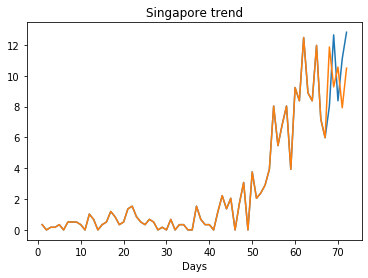

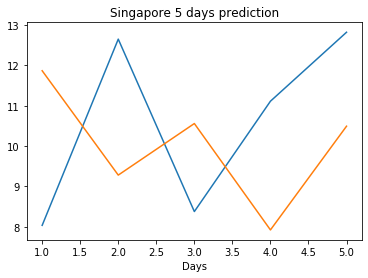

Creating directory ./offline8/Thailand/training/
Thailand
Saving the best model weights at Epoch [1], Best Valid Loss: 1.9368
Saving the best model weights at Epoch [2], Best Valid Loss: 1.7998
Saving the best model weights at Epoch [3], Best Valid Loss: 1.5491
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1727
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9477
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8342
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8190
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8134
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8088
train error: 0.1970985928298289
0.8087983131408691
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2073
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7885
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2105
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0577
Savin

Saving the best model weights at Epoch [34], Best Valid Loss: 1.8000
Saving the best model weights at Epoch [35], Best Valid Loss: 1.5454
Saving the best model weights at Epoch [37], Best Valid Loss: 1.4095
Saving the best model weights at Epoch [38], Best Valid Loss: 1.3410
Saving the best model weights at Epoch [39], Best Valid Loss: 1.3164
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3029
train error: 0.29431997236143187
1.3028978109359741
Saving the best model weights at Epoch [1], Best Valid Loss: 2.2360
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2268
Saving the best model weights at Epoch [3], Best Valid Loss: 2.0572
Saving the best model weights at Epoch [7], Best Valid Loss: 1.8279
Saving the best model weights at Epoch [8], Best Valid Loss: 1.7236
Saving the best model weights at Epoch [9], Best Valid Loss: 1.4999
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1228
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 2.5494
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5199
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0884
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9641
Saving the best model weights at Epoch [20], Best Valid Loss: 1.8352
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3577
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2857
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2561
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2027
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1999
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1983
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1964
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1946
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1938
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 2.4173
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3873
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3259
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3068
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2878
train error: 0.5544593300866453
2.2878193855285645
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8086
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7162
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6977
train error: 0.598519728298446
2.6976730823516846
Saving the best model weights at Epoch [1], Best Valid Loss: 1.4430
train error: 0.6217911034982535
1.443010687828064
Saving the best model weights at Epoch [1], Best Valid Loss: 2.2388
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2147
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2080
Saving the best model weights 

Saving the best model weights at Epoch [20], Best Valid Loss: 1.1817
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1450
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0950
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0587
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0246
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9945
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9668
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9409
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9157
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8965
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8807
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8657
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8553
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8451
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 1.9845
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9098
Saving the best model weights at Epoch [8], Best Valid Loss: 1.8615
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8106
Saving the best model weights at Epoch [10], Best Valid Loss: 1.7563
Saving the best model weights at Epoch [11], Best Valid Loss: 1.7243
Saving the best model weights at Epoch [12], Best Valid Loss: 1.6837
Saving the best model weights at Epoch [13], Best Valid Loss: 1.6486
Saving the best model weights at Epoch [14], Best Valid Loss: 1.6057
Saving the best model weights at Epoch [15], Best Valid Loss: 1.5613
Saving the best model weights at Epoch [16], Best Valid Loss: 1.5191
Saving the best model weights at Epoch [17], Best Valid Loss: 1.4822
Saving the best model weights at Epoch [18], Best Valid Loss: 1.4459
Saving the best model weights at Epoch [19], Best Valid Loss: 1.4098
Saving the best model weights at Epoch

Saving the best model weights at Epoch [22], Best Valid Loss: 1.8801
Saving the best model weights at Epoch [23], Best Valid Loss: 1.8619
Saving the best model weights at Epoch [24], Best Valid Loss: 1.8431
Saving the best model weights at Epoch [25], Best Valid Loss: 1.8252
Saving the best model weights at Epoch [26], Best Valid Loss: 1.8081
Saving the best model weights at Epoch [27], Best Valid Loss: 1.7929
Saving the best model weights at Epoch [28], Best Valid Loss: 1.7763
Saving the best model weights at Epoch [29], Best Valid Loss: 1.7639
Saving the best model weights at Epoch [30], Best Valid Loss: 1.7493
Saving the best model weights at Epoch [31], Best Valid Loss: 1.7385
Saving the best model weights at Epoch [32], Best Valid Loss: 1.7295
Saving the best model weights at Epoch [33], Best Valid Loss: 1.7195
Saving the best model weights at Epoch [34], Best Valid Loss: 1.7125
Saving the best model weights at Epoch [35], Best Valid Loss: 1.6938
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.7035
Saving the best model weights at Epoch [31], Best Valid Loss: 1.5722
Saving the best model weights at Epoch [32], Best Valid Loss: 1.4772
Saving the best model weights at Epoch [33], Best Valid Loss: 1.4064
Saving the best model weights at Epoch [34], Best Valid Loss: 1.3532
Saving the best model weights at Epoch [35], Best Valid Loss: 1.3159
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2795
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2440
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2226
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1972
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1796
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1622
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1512
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1421
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.4788
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4544
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4269
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4192
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4000
Saving the best model weights at Epoch [9], Best Valid Loss: 2.3981
Saving the best model weights at Epoch [10], Best Valid Loss: 2.3877
Saving the best model weights at Epoch [11], Best Valid Loss: 2.3863
Saving the best model weights at Epoch [13], Best Valid Loss: 2.3862
Saving the best model weights at Epoch [14], Best Valid Loss: 2.3839
Saving the best model weights at Epoch [15], Best Valid Loss: 2.3823
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3823
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3744
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3633
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.2084
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1232
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0370
train error: 0.06838036026946563
0

Saving the best model weights at Epoch [4], Best Valid Loss: 2.2043
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1424
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0888
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0457
Saving the best model weights at Epoch [8], Best Valid Loss: 2.0121
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9804
Saving the best model weights at Epoch [10], Best Valid Loss: 1.9556
Saving the best model weights at Epoch [11], Best Valid Loss: 1.9356
Saving the best model weights at Epoch [12], Best Valid Loss: 1.9157
Saving the best model weights at Epoch [13], Best Valid Loss: 1.9032
Saving the best model weights at Epoch [14], Best Valid Loss: 1.8918
Saving the best model weights at Epoch [15], Best Valid Loss: 1.8832
Saving the best model weights at Epoch [16], Best Valid Loss: 1.8732
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8677
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [15], Best Valid Loss: 2.4186
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4157
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4109
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4077
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4060
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4038
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4026
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4017
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3995
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3982
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3974
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3973
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3965
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3965
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5686
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5679
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5673
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5668
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5661
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5659
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5658
train error: 0.5704951912752891
2.5657718181610107
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9322
train error: 0.6217911034982535
2.932161569595337
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7258
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6881
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6863
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6837
Saving

Saving the best model weights at Epoch [17], Best Valid Loss: 2.7412
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7399
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7380
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7371
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7371
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7367
train error: 0.5993587553108993
2.736698627471924
Saving the best model weights at Epoch [1], Best Valid Loss: 2.1406
Saving the best model weights at Epoch [2], Best Valid Loss: 1.9811
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9594
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9429
train error: 0.4975651847688775
1.9428828954696655
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7204
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6236
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5408
Saving t

train error: 0.4787896769121289
1.873464584350586
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9322
train error: 0.6217911034982535
2.932161569595337
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6486
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5675
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5068
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4563
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4142
Saving the best model weights at Epoch [6], Best Valid Loss: 2.3797
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3520
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3302
Saving the best model weights at Epoch [9], Best Valid Loss: 2.3147
Saving the best model weights at Epoch [10], Best Valid Loss: 2.2995
Saving the best model weights at Epoch [11], Best Valid Loss: 2.2853
Saving the best model weights at Epoch [12], Best Valid Loss: 2.2744
Saving the be

Saving the best model weights at Epoch [13], Best Valid Loss: 2.1265
Saving the best model weights at Epoch [14], Best Valid Loss: 2.1176
Saving the best model weights at Epoch [15], Best Valid Loss: 2.1087
Saving the best model weights at Epoch [16], Best Valid Loss: 2.1037
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0923
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0875
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0822
Saving the best model weights at Epoch [20], Best Valid Loss: 2.0800
Saving the best model weights at Epoch [21], Best Valid Loss: 2.0757
Saving the best model weights at Epoch [22], Best Valid Loss: 2.0739
Saving the best model weights at Epoch [23], Best Valid Loss: 2.0705
Saving the best model weights at Epoch [25], Best Valid Loss: 2.0703
Saving the best model weights at Epoch [26], Best Valid Loss: 2.0678
Saving the best model weights at Epoch [27], Best Valid Loss: 2.0656
Saving the best model weights at E

Saving the best model weights at Epoch [23], Best Valid Loss: 2.5382
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5308
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5250
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5186
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5136
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5073
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5016
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4963
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4907
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4871
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4810
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4760
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4722
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4670
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.4833
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4799
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4766
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4734
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4701
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4669
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4637
train error: 0.5467438270877066
2.463744878768921
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8331
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8052
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7779
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7475
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7208
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6947
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [11], Best Valid Loss: 2.7358
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7205
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7051
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6902
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6755
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6612
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6472
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6334
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6199
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6067
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5937
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5810
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5685
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5562
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 1.1763
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1240
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0984
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0511
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0250
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9853
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9630
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9447
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9117
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8772
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8596
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8223
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8066
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7767
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 1.6783
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6668
Saving the best model weights at Epoch [49], Best Valid Loss: 1.6557
Saving the best model weights at Epoch [50], Best Valid Loss: 1.6437
train error: 0.4266134307131563
1.6436876058578491
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7242
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6366
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4836
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3591
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2571
Saving the best model weights at Epoch [6], Best Valid Loss: 2.1579
Saving the best model weights at Epoch [7], Best Valid Loss: 2.1132
Saving the best model weights at Epoch [8], Best Valid Loss: 2.0396
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9863
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 2.4468
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4427
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4380
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4346
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4307
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4266
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4236
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4192
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4159
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4135
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4102
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4062
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4029
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3999
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.6259
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6233
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6204
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6173
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6146
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6121
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6102
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6078
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6050
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6026
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6005
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5990
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5963
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5942
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 2.7633
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7578
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7523
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7478
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7424
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7377
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7329
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7291
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7239
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7199
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7158
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7124
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7084
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7047
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 2.6499
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6342
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6165
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6009
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5867
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5718
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5573
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5452
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5309
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5180
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5065
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4941
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4838
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4724
Saving the best model weights at Epoch

Saving the best model weights at Epoch [46], Best Valid Loss: 2.4168
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4133
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4096
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4061
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4026
train error: 0.5262791677623203
2.4026432037353516
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5282
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5032
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4809
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4602
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4368
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4156
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3977
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3772
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [44], Best Valid Loss: 2.4766
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4716
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4668
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4620
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4573
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4529
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4483
train error: 0.5306731389933511
2.4482810497283936
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7069
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6767
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6467
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6197
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5931
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [38], Best Valid Loss: 2.8347
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8333
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8319
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8305
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8292
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8279
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8253
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8241
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8229
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8217
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8206
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8194
train error: 0.5969804509689933
2.8194329738616943
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [30], Best Valid Loss: 2.5609
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5542
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5487
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5439
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5385
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5334
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5291
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5238
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5204
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5150
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5114
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5069
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5034
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4995
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.7893
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7821
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7749
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7680
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7613
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7546
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7480
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7417
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7354
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7293
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7233
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7174
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7117
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7062
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [23], Best Valid Loss: 1.8630
Saving the best model weights at Epoch [25], Best Valid Loss: 1.8620
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8603
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8551
Saving the best model weights at Epoch [37], Best Valid Loss: 1.8475
train error: 0.46531864742160234
1.8474531173706055
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7261
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7089
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6921
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6756
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6596
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6437
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6283
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6134
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 2.4109
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4097
Saving the best model weights at Epoch [15], Best Valid Loss: 2.3882
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3882
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3843
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3838
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3727
Saving the best model weights at Epoch [22], Best Valid Loss: 2.3719
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3644
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3621
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3568
Saving the best model weights at Epoch [46], Best Valid Loss: 2.3560
Saving the best model weights at Epoch [47], Best Valid Loss: 2.3545
train error: 0.5358598175409593
2.3545029163360596
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [5], Best Valid Loss: 2.2407
Saving the best model weights at Epoch [6], Best Valid Loss: 2.1808
Saving the best model weights at Epoch [7], Best Valid Loss: 2.1244
Saving the best model weights at Epoch [8], Best Valid Loss: 2.0752
Saving the best model weights at Epoch [9], Best Valid Loss: 2.0566
Saving the best model weights at Epoch [10], Best Valid Loss: 2.0266
Saving the best model weights at Epoch [11], Best Valid Loss: 2.0026
Saving the best model weights at Epoch [12], Best Valid Loss: 1.9902
Saving the best model weights at Epoch [13], Best Valid Loss: 1.9759
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9530
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9487
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9377
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9351
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9197
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [45], Best Valid Loss: 2.5866
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5836
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5816
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5790
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5769
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5748
train error: 0.5660512277758435
2.574847459793091
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5955
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5470
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4856
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4444
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4140
Saving the best model weights at Epoch [6], Best Valid Loss: 2.3832
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3576
Saving the best model weights at Epoch [8], Best Valid Loss:

Saving the best model weights at Epoch [41], Best Valid Loss: 2.1800
Saving the best model weights at Epoch [42], Best Valid Loss: 2.1753
Saving the best model weights at Epoch [43], Best Valid Loss: 2.1668
Saving the best model weights at Epoch [44], Best Valid Loss: 2.1621
Saving the best model weights at Epoch [45], Best Valid Loss: 2.1558
Saving the best model weights at Epoch [46], Best Valid Loss: 2.1519
Saving the best model weights at Epoch [47], Best Valid Loss: 2.1460
Saving the best model weights at Epoch [48], Best Valid Loss: 2.1408
Saving the best model weights at Epoch [49], Best Valid Loss: 2.1355
Saving the best model weights at Epoch [50], Best Valid Loss: 2.1309
train error: 0.4873141820885633
2.1308505535125732
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8687
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8430
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8193
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [35], Best Valid Loss: 2.3468
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3406
Saving the best model weights at Epoch [37], Best Valid Loss: 2.3357
Saving the best model weights at Epoch [38], Best Valid Loss: 2.3305
Saving the best model weights at Epoch [39], Best Valid Loss: 2.3252
Saving the best model weights at Epoch [40], Best Valid Loss: 2.3200
Saving the best model weights at Epoch [41], Best Valid Loss: 2.3153
Saving the best model weights at Epoch [42], Best Valid Loss: 2.3111
Saving the best model weights at Epoch [43], Best Valid Loss: 2.3063
Saving the best model weights at Epoch [44], Best Valid Loss: 2.3023
Saving the best model weights at Epoch [45], Best Valid Loss: 2.2985
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2942
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2901
Saving the best model weights at Epoch [48], Best Valid Loss: 2.2870
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.2564
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2479
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2400
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2325
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2247
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2175
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2107
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2060
Saving the best model weights at Epoch [40], Best Valid Loss: 2.1978
Saving the best model weights at Epoch [41], Best Valid Loss: 2.1922
Saving the best model weights at Epoch [42], Best Valid Loss: 2.1853
Saving the best model weights at Epoch [43], Best Valid Loss: 2.1805
Saving the best model weights at Epoch [44], Best Valid Loss: 2.1733
Saving the best model weights at Epoch [45], Best Valid Loss: 2.1680
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 2.6643
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6631
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6617
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6605
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6592
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6580
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6567
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6557
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6543
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6531
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6520
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6507
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6495
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6484
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.8852
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8846
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8839
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8832
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8826
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8819
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8813
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8806
train error: 0.612971656230289
2.88061261177063
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7147
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7114
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7082
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7052
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7016
Saving the best model weights at Epoch [6], Best Valid Loss:

Saving the best model weights at Epoch [11], Best Valid Loss: 2.8583
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8570
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8557
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8544
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8531
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8517
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8504
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8491
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8478
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8466
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8453
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8440
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8427
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8414
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 2.6070
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6004
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5897
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5828
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5758
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5655
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5590
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5497
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5440
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5354
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5283
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5207
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5135
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5074
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.6613
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6586
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6560
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6534
train error: 0.561724287298459
2.653383731842041
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8594
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8372
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8205
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7984
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7777
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7562
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7338
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7173
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6933
Saving the best model weights at Epoch [10], Best Valid Loss: 2

Saving the best model weights at Epoch [14], Best Valid Loss: 2.7684
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7672
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7660
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7648
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7636
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7624
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7612
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7600
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7588
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7576
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7564
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7553
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7541
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7530
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.8208
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8200
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8192
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8183
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8175
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8166
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8158
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8150
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8141
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8133
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8125
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8116
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8108
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8100
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.6978
train error: 0.5774564972441447
2.6977972984313965
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8445
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8435
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8426
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8417
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8407
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8398
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8389
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8380
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8370
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8361
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8352
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8343
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 2.8188
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8152
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8108
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8073
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8033
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7998
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7970
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7934
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7900
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7868
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7833
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7797
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7770
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7736
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 2.7719
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7704
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7688
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7672
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7657
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7642
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7626
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7611
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7596
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7581
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7566
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7552
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7536
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7521
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.8284
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8213
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8132
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8055
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7969
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7896
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7813
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7743
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7672
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7606
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7528
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7473
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7392
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7328
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 2.6490
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6474
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6457
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6441
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6423
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6406
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6390
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6358
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6341
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6324
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6308
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6293
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6278
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 2.7274
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7255
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7238
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7220
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7202
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7184
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7166
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7150
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7131
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7115
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7097
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7079
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7063
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7044
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.7340
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7312
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7287
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7261
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7235
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7211
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7185
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7159
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7135
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7109
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7084
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7059
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7033
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7008
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 2.8248
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8245
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8243
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8241
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8238
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8236
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8234
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8231
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8229
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8227
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8224
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8222
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8220
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8217
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.5605
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5581
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5563
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5540
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5517
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5504
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5479
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5459
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5437
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5414
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5406
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5387
train error: 0.555381942932543
2.5386810302734375
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8196
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [6], Best Valid Loss: 2.5776
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5624
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5504
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5395
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5255
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5151
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5023
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4931
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4818
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4705
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4614
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4522
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4416
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4289
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 2.7989
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7972
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7956
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7939
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7922
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7906
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7890
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7874
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7858
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7842
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7825
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7809
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7793
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7777
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 2.8223
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8211
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8199
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8188
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8176
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8165
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8153
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8142
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8130
train error: 0.5941998672474016
2.813034772872925
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8329
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8307
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8284
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8262
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [9], Best Valid Loss: 2.6696
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6681
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6666
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6651
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6636
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6621
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6606
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6591
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6576
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6561
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6546
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6531
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6516
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6501
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 2.2928
Saving the best model weights at Epoch [28], Best Valid Loss: 2.2855
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2796
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2696
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2631
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2584
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2522
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2423
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2358
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2290
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2222
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2191
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2116
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2055
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.7359
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7333
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7315
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7283
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7260
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7230
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7205
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7182
train error: 0.5789980032162643
2.7182419300079346
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7709
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7694
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7678
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7663
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7648
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 2.6259
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6111
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5980
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5841
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5714
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5579
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5461
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5335
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5224
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5109
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4976
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4866
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4734
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4641
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 2.7880
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7866
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7850
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7835
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7820
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7806
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7790
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7776
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7761
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7746
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7732
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7717
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7703
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7688
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 2.4800
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4799
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4798
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4796
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4795
train error: 0.5408316581559024
2.4794952869415283
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6245
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6244
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6244
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6244
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6243
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6243
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6242
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6242
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 2.7326
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7325
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7324
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7322
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7321
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7320
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7318
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7317
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7315
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7314
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7313
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7311
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7310
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7308
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.6483
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6469
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6457
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6438
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6424
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6408
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6392
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6379
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6363
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6346
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6331
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6315
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6300
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6284
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.8573
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8567
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8560
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8555
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8548
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8543
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8537
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8530
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8525
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8518
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8512
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8506
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8501
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8494
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 2.8206
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8202
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8199
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8196
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8192
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8189
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8186
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8183
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8179
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8176
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8173
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8170
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8166
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8163
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.7871
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7871
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7871
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7871
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7871
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7871
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7870
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7870
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7870
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7870
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7870
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7870
train error: 0.6007531916502079
2.786986827850342
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7828
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [6], Best Valid Loss: 2.8709
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8708
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8707
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8706
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8705
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8704
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8703
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8703
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8702
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8701
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8700
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8699
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8698
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8697
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 2.6674
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6662
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6648
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6638
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6625
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6614
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6603
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6588
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6576
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6566
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6554
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6542
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6531
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6518
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 2.8633
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8630
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8628
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8625
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8622
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8620
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8617
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8614
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8612
train error: 0.6065045364482916
2.861182928085327
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8323
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8313
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8300
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8287
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [9], Best Valid Loss: 2.7335
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7332
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7329
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7326
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7324
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7321
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7318
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7315
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7313
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7310
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7307
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7304
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7302
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7299
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 2.3523
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3522
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3520
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3519
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3518
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3516
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3515
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3514
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3512
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3511
Saving the best model weights at Epoch [37], Best Valid Loss: 2.3510
Saving the best model weights at Epoch [38], Best Valid Loss: 2.3508
Saving the best model weights at Epoch [39], Best Valid Loss: 2.3507
Saving the best model weights at Epoch [40], Best Valid Loss: 2.3505
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 2.8075
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8073
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8071
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8070
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8068
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8066
train error: 0.595225838098773
2.806605100631714
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8469
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8467
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8466
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8464
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8463
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8461
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8460
Saving the best model weights at Epoch [8], Best Valid Loss: 

Saving the best model weights at Epoch [12], Best Valid Loss: 2.6489
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6479
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6470
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6464
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6455
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6447
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6436
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6429
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6421
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6411
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6402
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6394
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6385
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6377
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.8519
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8517
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8514
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8512
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8510
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8507
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8505
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8503
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8500
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8498
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8496
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8494
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8491
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8489
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.8222
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8221
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8220
train error: 0.5961503601896478
2.8219845294952393
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8551
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8550
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8548
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8547
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8546
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8545
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8544
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8542
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8541
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8540
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 2.7887
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7886
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7886
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7885
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7884
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7884
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7883
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7882
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7882
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7881
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7880
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7880
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7879
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7878
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.8440
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8439
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8438
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8437
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8436
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8435
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8434
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8433
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8433
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8432
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8431
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8430
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8429
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8428
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.9074
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9073
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9073
train error: 0.6163972194067595
2.907277822494507
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8269
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8267
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8264
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8263
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8261
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8260
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8258
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8257
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8255
Saving the best model weights at Epoch [11], Best Valid Loss: 

Saving the best model weights at Epoch [15], Best Valid Loss: 2.9045
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9044
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9043
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9043
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9042
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9041
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9041
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9040
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9039
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9039
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9038
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9037
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9037
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9036
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 2.7744
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7734
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7723
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7710
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7699
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7689
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7677
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7666
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7656
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7646
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7633
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7623
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7611
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7602
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.8815
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8813
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8809
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8806
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8803
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8800
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8796
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8793
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8790
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8787
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8784
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8780
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8778
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8774
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 2.7414
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7411
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7407
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7404
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7400
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7397
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7394
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7390
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7387
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7384
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7381
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7377
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7374
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7371
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.8681
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8680
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8680
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8679
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8678
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8678
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8677
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8676
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8675
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8675
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8674
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8673
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8673
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8672
train error: 0.6048520870999231
2.

Saving the best model weights at Epoch [4], Best Valid Loss: 2.8948
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8947
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8947
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8946
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8945
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8944
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8944
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8943
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 2.7954
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7943
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7933
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7921
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7911
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7898
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7888
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7877
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7866
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7853
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7844
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7832
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7822
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7811
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.7163
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7163
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7163
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7163
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7163
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7162
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7162
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7162
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7162
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7162
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7162
train error: 0.5897645869868269
2.716153860092163
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6167
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6165
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [7], Best Valid Loss: 2.8077
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8077
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8077
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8077
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8076
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8076
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8076
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8076
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8076
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8075
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8075
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8075
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8075
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8075
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 2.7579
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7578
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7578
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7578
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7578
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7578
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7577
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7577
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7577
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7577
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7577
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7577
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7576
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7576
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.6506
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6504
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6502
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6500
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6498
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6497
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6495
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6493
train error: 0.5668990982537109
2.6492679119110107
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9322
train error: 0.6217333748312452
2.932161569595337
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8560
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8559
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8559
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8559
Saving 

Saving the best model weights at Epoch [9], Best Valid Loss: 2.8597
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8595
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8595
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8595
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 2.9230
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9229
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9229
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9228
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9227
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9227
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9226
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9225
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9225
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9224
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9224
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9223
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9222
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9222
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.8638
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8637
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8637
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8637
train error: 0.6090586283856905
2.8637173175811768
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8162
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8161
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8160
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8159
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8158
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8158
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8157
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8156
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8155
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 2.8365
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8365
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8365
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8364
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8364
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8364
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8364
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8364
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8364
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8363
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8363
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8363
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8363
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8363
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.7704
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7704
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7704
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7704
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7704
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7703
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7703
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7703
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7703
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7703
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7702
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7702
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7702
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7702
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.8590
train error: 0.6015316164695449
2.858957052230835
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [13], Best Valid Loss: 

Saving the best model weights at Epoch [17], Best Valid Loss: 2.7087
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7087
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7086
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7086
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7085
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7085
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7084
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7083
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7083
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7082
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7082
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7081
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7081
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7080
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 2.8482
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8482
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8482
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8482
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8482
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8481
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8481
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8481
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8481
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8481
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8481
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8481
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8480
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8480
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 2.8645
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8645
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8645
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8645
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8645
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9135
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.8860
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8859
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8858
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8857
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8857
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8856
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8855
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8854
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8853
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8852
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8852
train error: 0.6123145840009736
2.8851513862609863
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8134
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8134
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 2.5135
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5135
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5134
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5133
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5133
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5132
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5131
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5131
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5130
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5130
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5129
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5129
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5128
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5127
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 2.7549
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7548
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7548
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7548
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7548
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7547
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7547
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7547
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7547
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7546
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7546
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7546
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7546
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7545
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.7962
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7961
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7961
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7961
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7961
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7961
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7961
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7960
train error: 0.5914408439513001
2.796039342880249
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7857
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7857
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7857
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7857
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7857
Saving the best model weights at Epoch [6], Best Valid Los

Saving the best model weights at Epoch [10], Best Valid Loss: 2.8375
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8375
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8375
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8375
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8374
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 2.8018
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8017
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8016
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8015
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8014
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8013
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8012
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8011
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8010
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8009
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8008
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8007
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8006
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8005
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 2.7240
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7240
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7240
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7240
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7240
train error: 0.576801775464494
2.723970413208008
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6972
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6972
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6972
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6971
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6971
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6971
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6970
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6970
Saving the best model weights at Epoch [9], Best Valid Loss: 2

Saving the best model weights at Epoch [13], Best Valid Loss: 2.7913
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7912
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7912
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7912
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7911
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7911
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7911
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7911
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7910
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7910
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7910
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7910
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7909
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7909
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 2.7977
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7977
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7977
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7975
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7975
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7975
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.7418
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7417
train error: 0.581976489255842
2.741732358932495
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8265
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8265
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8265
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8265
Saving the best model weights at Epoch [12], Best Valid Loss: 2

Saving the best model weights at Epoch [16], Best Valid Loss: 2.8112
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8111
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8109
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8107
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8106
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8105
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8103
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8101
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8100
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8099
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8097
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8096
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8094
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8093
Saving the best model weights at E

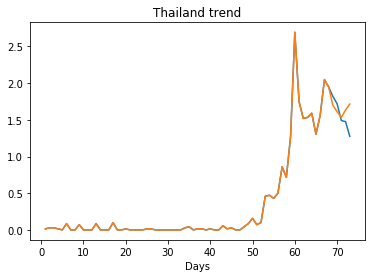

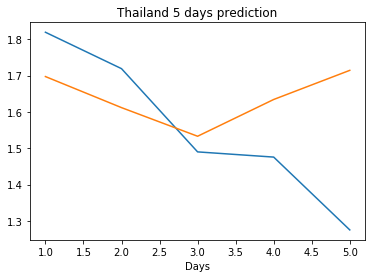

Creating directory ./offline8/Vietnam/training/
Vietnam
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0152
train error: 0.003957113201534879
0.015200385823845863
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0132
train error: 0.0035859784610865236
0.013166730292141438
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0166
train error: 0.004215449877822696
0.016591383144259453
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0069
train error: 0.002667269650595011
0.006893074605613947
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0123
train error: 0.003619501367211342
0.012321768328547478
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0148
train error: 0.003914472247816849
0.014768825843930244
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0137
train error: 0.004215449877822696
0.013679384253919125
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0145
train error: 0.003994677930431617
0.01445384044200182
Saving the best model weights 

train error: 0.002778876360468063
0.006659343373030424
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0149
train error: 0.003918853333153813
0.014895952306687832
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0067
train error: 0.003160134917502669
0.006686588283628225
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0124
train error: 0.0036163768303152676
0.012379706837236881
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0105
train error: 0.0031478717731236406
0.010470779612660408
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0127
train error: 0.0036993425691852697
0.012746733613312244
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0089
train error: 0.0027520640948283915
0.008890991099178791
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0131

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0113
train error: 0.0032533811439911056
0.011314379051327705
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [8], Best Valid

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0060
train error: 0.003948364192871629
0.006041656713932753
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0152
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0126
train error: 0.003516519714360805
0.012574783526360989
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0101
Saving the best model weights at E

train error: 0.0033772853706535455
0.009178824722766876
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0125
train error: 0.0035964129461176896
0.012494931928813457
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0121
train error: 0.0036132545682375093
0.012074117548763752
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0162
Saving the best

train error: 0.003557953587890527
0.007027269806712866
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0126
train error: 0.0037614888038857513
0.012612800113856792
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0166
train error: 0.004215449877822696
0.016591383144259453
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0085
train error: 0.00

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0114
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0125
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0108
train error: 0.005506162040841741


Saving the best model weights at Epoch [23], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0106
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0091
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0120
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0142
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0154
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0092
Saving the best model weights at Epoch

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0150
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0096
train error: 0.0032752922946914426
0.009630567394196987
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0136
train error: 0.0037820363264669337
0.013635757379233837
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0137
train error: 0.0038927475893492432
0.013715378008782864
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0051
train error: 0.002905498492386746
0.005107253324240446
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0125
train error: 0.0041888

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0123
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0146
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0150
train error: 0.003910387505154201
0.014992505311965942
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0053
train error: 0.003839175364732541
0.005292701069265604
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0093
train error: 0.0046899621485027715
0.009301618672907352
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0108
train error: 0.004419124093712182
0.01077560056000948
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0076
train error: 0.0040650151731333115
0.007629379630088806
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0128
train error: 0.003647940121654018
0.012839064002037048
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0106
train error: 0.004495190828959961
0.010577389970421791
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0119
Sa

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0085
Saving the best model weights at Epoch

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0092
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0094
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0140
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0088
train error: 0.004540925941467789
0.008766292594373226
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0072
train error: 0.005801696157259111
0.007234484888613224
Saving the best model weights at Epoch [1], Best Valid Loss: 0.

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0167
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0103
train error: 0.0038013216226072226
0.01027639675885439
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0166
train error: 0.004215449877822696
0.0165913831442

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0176
train error: 0.01576363739582735
0.017559001222252846
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0166
train error: 0.004215449877822696
0.016591383144259453
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0089
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0144
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0113
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0111
train error: 0.0035511992236196594

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0119
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0136
train error: 0.0061716368717670035
0.013604271225631237
Saving the best model weights at Epoch [1], Bes

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0098
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0119
train error: 0.003219068849559974
0.011888845823705196
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0072
train error: 0.00527074551555907
0.00717901811003685
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0136
Sav

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0103
Saving the best model weights at Epoch

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0072
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0267
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0200
train error: 0.030512707584814447
0.019959744065999985
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0106
Saving the best model weights at E

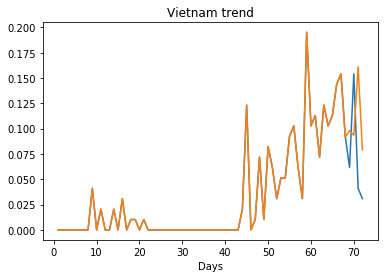

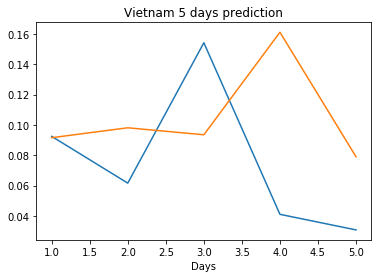

Creating directory ./offline8/Russia/training/
Russia
Saving the best model weights at Epoch [1], Best Valid Loss: 2.2146
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2138
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2014
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1543
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0995
Saving the best model weights at Epoch [9], Best Valid Loss: 2.0965
Saving the best model weights at Epoch [10], Best Valid Loss: 2.0622
Saving the best model weights at Epoch [11], Best Valid Loss: 1.9705
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9523
Saving the best model weights at Epoch [16], Best Valid Loss: 1.8514
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8133
Saving the best model weights at Epoch [18], Best Valid Loss: 1.7842
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6417
Saving the best model weights at Epoch [20], Best Valid

Saving the best model weights at Epoch [3], Best Valid Loss: 2.5986
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5866
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5811
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5691
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5670
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5648
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5616
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5501
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5450
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5340
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5323
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5263
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5211
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5026
Saving the best model weights at Epo

Saving the best model weights at Epoch [16], Best Valid Loss: 1.1930
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1095
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9559
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8417
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7147
Saving the best model weights at Epoch [21], Best Valid Loss: 0.6737
Saving the best model weights at Epoch [22], Best Valid Loss: 0.6380
Saving the best model weights at Epoch [23], Best Valid Loss: 0.5198
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4334
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3583
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2632
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2350
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1870
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1354
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.7011
train error: 0.2185822659216526
2.701129674911499
Saving the best model weights at Epoch [1], Best Valid Loss: 2.2880
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2281
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1824
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1575
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0616
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0445
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0272
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0204
Saving the best model weights at Epoch [26], Best Valid Loss: 2.0014
train error: 0.1677208848233367
2.0013959407806396
Saving the best model weights at Epoch [1], Best Valid Loss: 2.0991
Saving the best model weights at Epoch [3], Best Valid Loss: 2.0752
Saving the best model weights at Epoch [11], Best Valid Loss: 2.0731
Saving the 

Saving the best model weights at Epoch [8], Best Valid Loss: 2.4549
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4424
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4370
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4360
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4041
train error: 0.20378494470637162
2.4040539264678955
Saving the best model weights at Epoch [1], Best Valid Loss: 2.3862
train error: 0.2185822659216526
2.386215925216675
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5933
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5730
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5665
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5437
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5402
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5365
train error: 0.20797875785300957
2.5364925861358643
Saving the best model we

Saving the best model weights at Epoch [15], Best Valid Loss: 1.8948
Saving the best model weights at Epoch [19], Best Valid Loss: 1.8618
Saving the best model weights at Epoch [20], Best Valid Loss: 1.7557
Saving the best model weights at Epoch [21], Best Valid Loss: 1.7214
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6794
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6078
Saving the best model weights at Epoch [24], Best Valid Loss: 1.5869
Saving the best model weights at Epoch [25], Best Valid Loss: 1.5114
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3993
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3341
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2907
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1846
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1480
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1014
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.3130
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3126
train error: 0.18728786042152806
2.3126285076141357
Saving the best model weights at Epoch [1], Best Valid Loss: 2.3541
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2867
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2485
Saving the best model weights at Epoch [7], Best Valid Loss: 2.1986
Saving the best model weights at Epoch [9], Best Valid Loss: 2.1755
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1497
Saving the best model weights at Epoch [13], Best Valid Loss: 2.1172
Saving the best model weights at Epoch [14], Best Valid Loss: 2.1059
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0987
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0589
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0206
Saving the best model weights at Epoch [20], Best Valid 

Saving the best model weights at Epoch [31], Best Valid Loss: 2.1093
Saving the best model weights at Epoch [33], Best Valid Loss: 2.1024
Saving the best model weights at Epoch [34], Best Valid Loss: 2.1007
Saving the best model weights at Epoch [35], Best Valid Loss: 2.1001
Saving the best model weights at Epoch [37], Best Valid Loss: 2.0967
Saving the best model weights at Epoch [39], Best Valid Loss: 2.0890
Saving the best model weights at Epoch [41], Best Valid Loss: 2.0797
Saving the best model weights at Epoch [43], Best Valid Loss: 2.0754
Saving the best model weights at Epoch [44], Best Valid Loss: 2.0730
Saving the best model weights at Epoch [45], Best Valid Loss: 2.0722
Saving the best model weights at Epoch [46], Best Valid Loss: 2.0698
Saving the best model weights at Epoch [47], Best Valid Loss: 2.0629
Saving the best model weights at Epoch [48], Best Valid Loss: 2.0581
Saving the best model weights at Epoch [49], Best Valid Loss: 2.0540
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 1.9940
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9685
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9669
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9590
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9525
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9494
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9447
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9429
Saving the best model weights at Epoch [21], Best Valid Loss: 1.9363
Saving the best model weights at Epoch [22], Best Valid Loss: 1.9351
Saving the best model weights at Epoch [23], Best Valid Loss: 1.9344
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9257
Saving the best model weights at Epoch [27], Best Valid Loss: 1.9161
Saving the best model weights at Epoch [28], Best Valid Loss: 1.9138
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 2.0265
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0233
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0185
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0182
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0089
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0061
Saving the best model weights at Epoch [25], Best Valid Loss: 2.0060
Saving the best model weights at Epoch [42], Best Valid Loss: 2.0034
train error: 0.15930747594042072
2.003373384475708
Saving the best model weights at Epoch [1], Best Valid Loss: 2.3089
Saving the best model weights at Epoch [10], Best Valid Loss: 2.2941
train error: 0.18806160493464819
2.294137954711914
Saving the best model weights at Epoch [1], Best Valid Loss: 2.4437
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3857
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3343
Savin

Saving the best model weights at Epoch [11], Best Valid Loss: 2.0458
Saving the best model weights at Epoch [12], Best Valid Loss: 2.0350
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0316
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0314
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0268
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0251
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0190
Saving the best model weights at Epoch [23], Best Valid Loss: 2.0170
Saving the best model weights at Epoch [24], Best Valid Loss: 2.0154
Saving the best model weights at Epoch [26], Best Valid Loss: 2.0092
Saving the best model weights at Epoch [31], Best Valid Loss: 2.0051
train error: 0.158781664654741
2.0051324367523193
Saving the best model weights at Epoch [1], Best Valid Loss: 2.1742
Saving the best model weights at Epoch [2], Best Valid Loss: 2.0056
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [7], Best Valid Loss: 2.5083
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5051
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4988
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4967
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4928
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4905
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4876
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4870
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4861
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4853
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4851
train error: 0.2021737709834144
2.485133409500122
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5451
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4560
Saving the best model weights at Epoch [3], Best Valid Los

Saving the best model weights at Epoch [42], Best Valid Loss: 2.5299
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5298
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5298
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5297
train error: 0.20609019388412608
2.529698133468628
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5312
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4846
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4472
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4209
Saving the best model weights at Epoch [5], Best Valid Loss: 2.3983
Saving the best model weights at Epoch [6], Best Valid Loss: 2.3852
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3740
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3668
Saving the best model weights at Epoch [9], Best Valid Loss: 2.3586
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [26], Best Valid Loss: 2.1243
Saving the best model weights at Epoch [27], Best Valid Loss: 2.1237
Saving the best model weights at Epoch [28], Best Valid Loss: 2.1235
Saving the best model weights at Epoch [29], Best Valid Loss: 2.1224
Saving the best model weights at Epoch [30], Best Valid Loss: 2.1209
Saving the best model weights at Epoch [31], Best Valid Loss: 2.1196
Saving the best model weights at Epoch [33], Best Valid Loss: 2.1189
Saving the best model weights at Epoch [36], Best Valid Loss: 2.1182
Saving the best model weights at Epoch [37], Best Valid Loss: 2.1177
Saving the best model weights at Epoch [38], Best Valid Loss: 2.1164
train error: 0.16834163020268597
2.11639404296875
Saving the best model weights at Epoch [1], Best Valid Loss: 2.2813
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2130
Saving the best model weights at Epoch [3], Best Valid Loss: 2.1543
Saving the best model weights at Epoch [4], Best Valid L

Saving the best model weights at Epoch [22], Best Valid Loss: 2.4380
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4368
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4364
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4347
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4341
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4329
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4325
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4319
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4315
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4304
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4299
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4292
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4288
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4281
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 2.0547
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0497
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0442
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0398
Saving the best model weights at Epoch [20], Best Valid Loss: 2.0351
Saving the best model weights at Epoch [21], Best Valid Loss: 2.0306
Saving the best model weights at Epoch [22], Best Valid Loss: 2.0286
Saving the best model weights at Epoch [23], Best Valid Loss: 2.0272
Saving the best model weights at Epoch [24], Best Valid Loss: 2.0232
Saving the best model weights at Epoch [25], Best Valid Loss: 2.0229
Saving the best model weights at Epoch [26], Best Valid Loss: 2.0194
Saving the best model weights at Epoch [28], Best Valid Loss: 2.0185
Saving the best model weights at Epoch [29], Best Valid Loss: 2.0183
Saving the best model weights at Epoch [30], Best Valid Loss: 2.0160
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.0584
train error: 0.17644144040692983
2.0583529472351074
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5973
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5631
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5347
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5101
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4895
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4713
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4553
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4425
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4317
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4220
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4140
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4067
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [5], Best Valid Loss: 2.4815
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4799
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4795
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4781
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4770
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4762
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4752
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4743
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4734
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4726
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4717
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4714
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4704
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4694
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [46], Best Valid Loss: 2.5221
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5206
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5192
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5178
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5165
train error: 0.19526144101862505
2.5164754390716553
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5193
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5109
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5038
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4976
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4909
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4839
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4778
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4717
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [28], Best Valid Loss: 2.3804
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3753
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3702
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3653
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3604
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3557
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3508
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3461
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3415
Saving the best model weights at Epoch [37], Best Valid Loss: 2.3370
Saving the best model weights at Epoch [38], Best Valid Loss: 2.3325
Saving the best model weights at Epoch [39], Best Valid Loss: 2.3281
Saving the best model weights at Epoch [40], Best Valid Loss: 2.3237
Saving the best model weights at Epoch [41], Best Valid Loss: 2.3194
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 2.6072
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6042
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6012
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5982
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5953
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5924
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5896
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5868
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5840
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5814
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5786
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5760
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5734
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5709
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 1.9127
Saving the best model weights at Epoch [44], Best Valid Loss: 1.9126
Saving the best model weights at Epoch [45], Best Valid Loss: 1.9095
Saving the best model weights at Epoch [47], Best Valid Loss: 1.9092
Saving the best model weights at Epoch [48], Best Valid Loss: 1.9034
Saving the best model weights at Epoch [49], Best Valid Loss: 1.8992
Saving the best model weights at Epoch [50], Best Valid Loss: 1.8928
train error: 0.14911134384476163
1.8928461074829102
Saving the best model weights at Epoch [1], Best Valid Loss: 2.2346
train error: 0.18162409958012146
2.2346456050872803
Saving the best model weights at Epoch [1], Best Valid Loss: 2.1033
Saving the best model weights at Epoch [2], Best Valid Loss: 2.0979
Saving the best model weights at Epoch [3], Best Valid Loss: 2.0930
Saving the best model weights at Epoch [4], Best Valid Loss: 2.0883
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0834
Savin

Saving the best model weights at Epoch [36], Best Valid Loss: 2.5128
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5116
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5105
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5093
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5082
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5070
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5059
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5048
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5038
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5027
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5017
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5007
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4996
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4986
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 2.3262
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3216
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3172
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3128
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3085
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3043
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3001
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2960
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2920
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2880
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2840
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2803
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2763
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2726
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 2.4768
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4653
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4544
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4439
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4335
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4238
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4143
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4046
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3950
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3865
Saving the best model weights at Epoch [20], Best Valid Loss: 2.3774
Saving the best model weights at Epoch [21], Best Valid Loss: 2.3691
Saving the best model weights at Epoch [22], Best Valid Loss: 2.3610
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3528
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.3949
train error: 0.18961459892834054
2.394906997680664
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5484
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5452
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5421
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5392
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5360
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5332
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5304
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5279
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5252
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5229
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5205
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5176
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 2.5177
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5145
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5120
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5087
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5058
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5035
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5004
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4979
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4952
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4926
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4901
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4880
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4854
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4832
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 2.4898
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4847
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4782
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4726
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4672
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4619
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4570
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4516
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4473
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4419
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4375
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4328
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4288
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4241
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.5378
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5287
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5197
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5108
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5023
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4945
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4863
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4782
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4706
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4632
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4570
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4491
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4431
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4357
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [44], Best Valid Loss: 2.2152
Saving the best model weights at Epoch [45], Best Valid Loss: 2.2122
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2094
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2065
Saving the best model weights at Epoch [48], Best Valid Loss: 2.2038
Saving the best model weights at Epoch [49], Best Valid Loss: 2.2010
Saving the best model weights at Epoch [50], Best Valid Loss: 2.1983
train error: 0.1649400910507117
2.1983070373535156
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6753
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6734
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6716
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6698
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6680
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6664
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [34], Best Valid Loss: 2.6533
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6525
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6518
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6511
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6504
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6497
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6490
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6483
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6476
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6470
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6463
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6457
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6451
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6445
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 2.6420
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6414
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6409
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6403
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6398
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6392
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6387
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6382
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6377
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6372
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6366
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6361
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6357
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6352
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 2.6495
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6488
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6481
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6475
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6469
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6462
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6456
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6449
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6443
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6437
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6431
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6425
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6420
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6414
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.4623
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4602
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4582
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4562
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4542
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4523
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4505
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4485
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4467
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4448
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4431
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4414
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4396
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4379
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [17], Best Valid Loss: 2.5365
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5328
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5292
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5257
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5222
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5188
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5154
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5120
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5089
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5055
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5024
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4993
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4962
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4931
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 2.4977
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4889
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4804
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4718
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4635
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4553
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4472
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4391
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4314
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4236
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4159
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4084
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4010
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3938
Saving the best model weights at Epoch

Saving the best model weights at Epoch [28], Best Valid Loss: 2.2188
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2173
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2123
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2117
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2108
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2104
train error: 0.17590064776997114
2.2103703022003174
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5662
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5576
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5491
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5407
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5324
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5243
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5163
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 2.6139
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6125
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6119
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6097
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6089
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6069
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6064
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6053
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6052
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6046
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6041
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6035
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6032
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6030
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.4870
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4852
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4820
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4799
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4776
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4757
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4736
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4714
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4698
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4674
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4654
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4634
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4612
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4591
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 2.5749
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5744
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5740
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5735
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5730
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5726
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5722
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5717
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5712
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5708
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5699
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5695
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5690
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 2.4809
Saving the best model weights at Epoch [39], Best Valid Loss: 2.4800
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4791
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4782
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4772
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4763
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4754
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4745
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4736
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4727
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4718
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4709
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4700
train error: 0.18859990630579856
2.469975233078003
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [5], Best Valid Loss: 2.6794
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6793
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6792
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6791
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6791
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6790
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6789
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6788
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6787
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6787
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6786
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6785
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6784
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6783
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 2.4391
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4331
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4283
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4245
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4201
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4158
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4114
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4071
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4031
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3988
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3945
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3904
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3864
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3829
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.3777
Saving the best model weights at Epoch [42], Best Valid Loss: 2.3774
Saving the best model weights at Epoch [43], Best Valid Loss: 2.3771
Saving the best model weights at Epoch [44], Best Valid Loss: 2.3768
Saving the best model weights at Epoch [45], Best Valid Loss: 2.3765
Saving the best model weights at Epoch [46], Best Valid Loss: 2.3762
Saving the best model weights at Epoch [47], Best Valid Loss: 2.3760
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3756
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3753
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3750
train error: 0.18319463416741327
2.374999761581421
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7011
train error: 0.2185822659216526
2.701129674911499
Saving the best model weights at Epoch [1], Best Valid Loss: 2.3688
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3681
Savin

Saving the best model weights at Epoch [7], Best Valid Loss: 2.6333
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6318
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6298
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6279
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6264
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6244
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6228
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6211
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6197
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6181
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6166
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6134
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6120
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 2.5429
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5421
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5414
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5406
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5399
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5392
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5384
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5376
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5369
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5361
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5354
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5346
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5340
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5332
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.5551
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5543
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5536
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5528
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5521
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5514
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5506
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5499
train error: 0.19656378033888078
2.5498669147491455
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6807
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6804
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6801
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6798
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6794
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [11], Best Valid Loss: 2.3918
Saving the best model weights at Epoch [12], Best Valid Loss: 2.3913
Saving the best model weights at Epoch [13], Best Valid Loss: 2.3908
Saving the best model weights at Epoch [14], Best Valid Loss: 2.3903
Saving the best model weights at Epoch [15], Best Valid Loss: 2.3898
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3893
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3888
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3883
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3878
Saving the best model weights at Epoch [20], Best Valid Loss: 2.3873
Saving the best model weights at Epoch [21], Best Valid Loss: 2.3868
Saving the best model weights at Epoch [22], Best Valid Loss: 2.3863
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3859
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3854
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 2.2757
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2751
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2736
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2728
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2716
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2701
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2686
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2683
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2674
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2661
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2655
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2640
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2628
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2625
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.6286
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6284
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6280
train error: 0.20965553668994008
2.628023147583008
Saving the best model weights at Epoch [1], Best Valid Loss: 2.4650
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4620
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4581
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4541
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4505
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4471
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4432
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4410
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4367
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 2.6367
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6363
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6360
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6356
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6352
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6348
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6344
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6340
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6336
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6332
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6328
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6324
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6320
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6316
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.5372
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5368
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5364
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5360
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5355
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5351
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5347
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5343
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5339
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5335
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5331
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5326
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5322
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5318
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.5544
train error: 0.2039912856296347
2.554426908493042
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5458
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5455
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5452
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5450
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5447
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5444
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5441
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5439
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5436
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5433
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5431
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5428
Saving the best model weights at Epoch [13], Best Valid Loss: 

Saving the best model weights at Epoch [17], Best Valid Loss: 2.6730
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6722
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6718
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6713
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6707
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6702
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6697
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6690
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6683
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6679
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6676
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6669
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6664
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6659
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 2.5435
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5425
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5414
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5404
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5393
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5383
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5373
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5362
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5352
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5341
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5331
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5321
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5310
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5300
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.6600
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6592
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6582
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6578
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6570
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6561
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6555
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6547
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6541
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6534
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6526
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6520
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6516
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6508
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 2.5922
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5908
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5895
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5882
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5870
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5857
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5845
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5832
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5820
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5807
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5795
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5782
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5771
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5758
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.2842
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2840
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2839
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2837
Saving the best model weights at Epoch [43], Best Valid Loss: 2.2836
Saving the best model weights at Epoch [44], Best Valid Loss: 2.2834
Saving the best model weights at Epoch [45], Best Valid Loss: 2.2833
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2831
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2830
Saving the best model weights at Epoch [48], Best Valid Loss: 2.2829
Saving the best model weights at Epoch [49], Best Valid Loss: 2.2827
Saving the best model weights at Epoch [50], Best Valid Loss: 2.2826
train error: 0.18175143854499892
2.2825839519500732
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5028
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 2.5132
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5131
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5130
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5128
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5127
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5126
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5125
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5123
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5122
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5121
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5120
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5118
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5117
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5116
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 2.3192
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3156
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3136
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3094
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3080
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3040
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3007
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2981
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2951
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2926
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2900
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2882
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2842
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2823
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 2.6498
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6492
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6486
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6480
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6475
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6468
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6463
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6456
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6451
train error: 0.2113857152129138
2.6450674533843994
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6454
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6356
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6290
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6185
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [9], Best Valid Loss: 2.5848
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5836
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5824
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5813
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5802
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5790
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5778
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5766
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5755
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5744
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5733
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5721
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5710
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5698
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 2.4678
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [37], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [38], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [39], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4676
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.5504
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5500
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5498
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5495
train error: 0.20002426155682268
2.5494608879089355
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5569
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5569
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5568
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5568
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5567
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5567
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5567
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5566
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5566
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 2.5764
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5756
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5750
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5742
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5735
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5729
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5721
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5714
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5708
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5701
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5694
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5688
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5680
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5673
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.6109
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6108
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6107
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6107
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6106
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6106
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6105
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6104
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6104
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6103
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6103
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6102
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6101
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6101
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.6110
train error: 0.20606222214952014
2.6109817028045654
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6324
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6323
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6323
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6322
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6321
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6320
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6319
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6319
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6318
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6317
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6316
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6315
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 2.5557
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5557
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5556
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5556
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5555
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5555
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5555
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5554
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5554
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5553
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5553
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5553
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5552
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5552
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5172
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5172
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5172
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5172
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5172
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5172
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.4247
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4246
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4246
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4245
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4245
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4244
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4243
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4243
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4242
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4242
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4241
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4241
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4240
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4239
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 2.6081
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6078
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6076
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6073
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6071
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6069
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6066
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6064
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6061
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6059
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6057
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6054
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6052
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6049
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.6493
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6491
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6489
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6488
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6486
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6484
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6483
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6481
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6480
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6478
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6476
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6475
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6473
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6471
train error: 0.21077826452604093
2

Saving the best model weights at Epoch [3], Best Valid Loss: 2.4372
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4371
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4370
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4369
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4368
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4367
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4366
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4365
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4363
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4363
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4361
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4360
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4359
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4358
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 2.5888
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5887
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5885
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5884
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5882
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5881
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5880
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5878
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5877
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5876
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5874
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5873
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5871
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5870
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.6649
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6649
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6649
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6649
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6649
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6649
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6648
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6648
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6648
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6648
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6648
train error: 0.2150515389211219
2.6648242473602295
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5123
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5122
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 2.5748
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5747
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5747
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5747
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5746
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5746
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5745
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5745
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5745
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5744
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5744
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5744
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5743
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5743
Saving the best model weights at Epoc

Saving the best model weights at Epoch [23], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6151
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.6928
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6926
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6925
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6923
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6921
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6919
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6918
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6916
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6914
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6912
train error: 0.21708501634240182
2.691239595413208
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6820
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6820
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6820
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 2.5930
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5927
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5924
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5921
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5917
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5914
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5911
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5908
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5904
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5901
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5898
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5895
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5892
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5888
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 2.6089
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6089
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6088
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6087
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6087
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6087
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6086
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6086
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6085
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6085
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6084
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6084
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6083
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6083
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 2.6626
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6626
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6626
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6625
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6625
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6625
train error: 0.21309156417906894
2.6624743938446045
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6292
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6292
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6291
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6291
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6290
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6290
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6289
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 2.4399
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4398
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4397
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4397
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4396
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4395
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4395
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4394
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4393
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4393
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4392
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4391
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4391
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4390
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.5713
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5712
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5712
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5711
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5711
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5710
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5710
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5710
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5709
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5709
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5708
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5708
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5707
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5707
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.5110
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5108
train error: 0.19544076847297878
2.510780096054077
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5921
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5920
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5920
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5919
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5918
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5917
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5916
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5916
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5915
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5914
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5913
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [16], Best Valid Loss: 2.5337
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5331
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5324
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5320
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5316
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5309
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5303
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5297
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5291
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5285
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5280
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5275
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5268
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5264
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.5595
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5592
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5586
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5581
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5576
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5572
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5567
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5563
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5558
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5554
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5549
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5544
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5539
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5535
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5225
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 2.4615
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4615
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4615
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4614
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4614
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4613
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4613
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4612
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4612
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4611
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4611
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4611
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4610
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4610
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6362
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6362
train error: 0.21218246643246827
2

Saving the best model weights at Epoch [4], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6879
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4677
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4676
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4676
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.4072
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4071
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4071
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4070
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4070
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4069
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4068
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4068
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4067
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4067
train error: 0.18282703629791222
2.4066848754882812
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5705
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5705
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5705
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6551
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6551
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6551
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 2.6018
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6018
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6018
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6017
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6016
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 2.6846
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6845
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6845
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6845
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6845
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6845
train error: 0.21639232567294725
2.6845388412475586
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6697
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6696
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6696
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6696
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6696
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6695
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6695
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [13], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [14], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [15], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [20], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [21], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [22], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3858
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3858
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6172
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.4615
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4615
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4614
train error: 0.186459251591165
2.461419105529785
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [11], Best Valid Loss: 2

Saving the best model weights at Epoch [14], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6761
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6761
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6761
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6761
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6761
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6761
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.5739
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5738
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5738
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5738
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5737
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5737
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5737
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5737
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5736
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5736
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5736
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5735
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5735
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5735
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.6330
train error: 0.2078351555131215
2.6330437660217285
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5009
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5008
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5008
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5008
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5007
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5007
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5007
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5006
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5006
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5006
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5005
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5005
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5670
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5670
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5670
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 2.6269
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6269
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6269
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6269
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6269
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6269
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6269
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6268
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6268
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6268
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6268
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6268
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6268
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6268
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6684
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 2.5866
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5866
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5865
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5865
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5865
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5865
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5864
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5864
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5864
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5864
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5863
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5863
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5863
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5863
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.5465
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5465
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5465
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5465
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5465
train error: 0.2065972951883129
2.5464742183685303
Saving the best model weights at Epoch [1], Best Valid Loss: 2.3449
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3448
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3448
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3448
Saving the best model weights at Epoch [5], Best Valid Loss: 2.3448
Saving the best model weights at Epoch [6], Best Valid Loss: 2.3447
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3447
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3447
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [13], Best Valid Loss: 2.6057
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6057
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6057
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6056
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5703
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5702
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5702
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5702
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5702
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5702
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5702
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5702
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.6803
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6803
train error: 0.21577643978475705
2.6803016662597656
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 2.5745
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5744
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5744
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5743
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5743
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5742
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5741
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5741
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5740
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5740
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5739
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5738
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5738
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5737
Saving the best model weights at E

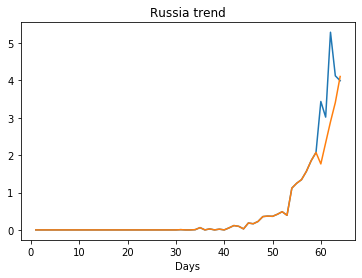

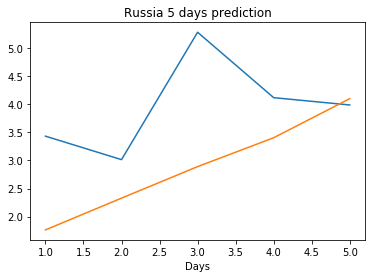

Creating directory ./offline8/Finland/training/
Finland
Saving the best model weights at Epoch [1], Best Valid Loss: 80.7776
Saving the best model weights at Epoch [2], Best Valid Loss: 54.5291
Saving the best model weights at Epoch [6], Best Valid Loss: 29.1116
Saving the best model weights at Epoch [10], Best Valid Loss: 25.9329
train error: 17.479528128590076
25.93292808532715
Saving the best model weights at Epoch [1], Best Valid Loss: 125.5665
Saving the best model weights at Epoch [2], Best Valid Loss: 36.6542
Saving the best model weights at Epoch [3], Best Valid Loss: 33.4067
Saving the best model weights at Epoch [10], Best Valid Loss: 16.1182
train error: 14.551897309930816
16.11819839477539
Saving the best model weights at Epoch [1], Best Valid Loss: 39.5961
train error: 83.00145479312707
39.59609603881836
Saving the best model weights at Epoch [1], Best Valid Loss: 119.4020
Saving the best model weights at Epoch [2], Best Valid Loss: 41.3476
Saving the best model weights at

Saving the best model weights at Epoch [7], Best Valid Loss: 35.0194
Saving the best model weights at Epoch [17], Best Valid Loss: 21.6541
Saving the best model weights at Epoch [24], Best Valid Loss: 10.8750
train error: 12.60112471106432
10.875028610229492
Saving the best model weights at Epoch [1], Best Valid Loss: 114.2421
Saving the best model weights at Epoch [3], Best Valid Loss: 90.2027
train error: 83.00145479312707
90.20272827148438
Saving the best model weights at Epoch [1], Best Valid Loss: 111.4185
Saving the best model weights at Epoch [4], Best Valid Loss: 37.1139
Saving the best model weights at Epoch [5], Best Valid Loss: 16.1162
Saving the best model weights at Epoch [7], Best Valid Loss: 15.6897
Saving the best model weights at Epoch [8], Best Valid Loss: 14.1563
train error: 7.926430768994314
14.15630054473877
Saving the best model weights at Epoch [1], Best Valid Loss: 131.9135
Saving the best model weights at Epoch [6], Best Valid Loss: 109.7401
Saving the best mo

Saving the best model weights at Epoch [7], Best Valid Loss: 17.3682
train error: 14.952669679607835
17.368186950683594
Saving the best model weights at Epoch [1], Best Valid Loss: 185.4948
train error: 83.00145479312707
185.4947967529297
Saving the best model weights at Epoch [1], Best Valid Loss: 190.8092
Saving the best model weights at Epoch [2], Best Valid Loss: 146.7157
Saving the best model weights at Epoch [9], Best Valid Loss: 145.7760
Saving the best model weights at Epoch [21], Best Valid Loss: 140.1679
train error: 51.342066580249416
140.16793823242188
Saving the best model weights at Epoch [1], Best Valid Loss: 243.2835
Saving the best model weights at Epoch [38], Best Valid Loss: 243.1015
train error: 72.90944979267735
243.10154724121094
Saving the best model weights at Epoch [1], Best Valid Loss: 174.2016
Saving the best model weights at Epoch [2], Best Valid Loss: 151.6694
Saving the best model weights at Epoch [3], Best Valid Loss: 142.9197
Saving the best model weight

Saving the best model weights at Epoch [3], Best Valid Loss: 203.6133
Saving the best model weights at Epoch [4], Best Valid Loss: 198.2431
Saving the best model weights at Epoch [13], Best Valid Loss: 195.6717
Saving the best model weights at Epoch [28], Best Valid Loss: 191.6985
Saving the best model weights at Epoch [47], Best Valid Loss: 190.9611
train error: 62.734358079971805
190.9611053466797
Saving the best model weights at Epoch [1], Best Valid Loss: 304.3820
train error: 83.00145479312707
304.3820495605469
Saving the best model weights at Epoch [1], Best Valid Loss: 199.1879
Saving the best model weights at Epoch [19], Best Valid Loss: 197.5531
Saving the best model weights at Epoch [27], Best Valid Loss: 196.2874
train error: 61.082303570162864
196.28744506835938
Saving the best model weights at Epoch [1], Best Valid Loss: 188.1597
Saving the best model weights at Epoch [2], Best Valid Loss: 182.9178
Saving the best model weights at Epoch [3], Best Valid Loss: 174.3255
Savin

Saving the best model weights at Epoch [12], Best Valid Loss: 53.8978
Saving the best model weights at Epoch [13], Best Valid Loss: 51.1792
Saving the best model weights at Epoch [16], Best Valid Loss: 49.9091
Saving the best model weights at Epoch [21], Best Valid Loss: 47.8743
Saving the best model weights at Epoch [24], Best Valid Loss: 23.8613
Saving the best model weights at Epoch [25], Best Valid Loss: 16.1317
Saving the best model weights at Epoch [28], Best Valid Loss: 15.5671
train error: 5.678411950958112
15.567102432250977
Saving the best model weights at Epoch [1], Best Valid Loss: 117.1057
Saving the best model weights at Epoch [2], Best Valid Loss: 52.4342
Saving the best model weights at Epoch [3], Best Valid Loss: 40.8878
Saving the best model weights at Epoch [4], Best Valid Loss: 34.1633
Saving the best model weights at Epoch [5], Best Valid Loss: 31.0116
Saving the best model weights at Epoch [6], Best Valid Loss: 28.5534
Saving the best model weights at Epoch [8], B

Saving the best model weights at Epoch [33], Best Valid Loss: 50.8110
Saving the best model weights at Epoch [34], Best Valid Loss: 50.4255
Saving the best model weights at Epoch [35], Best Valid Loss: 49.6323
Saving the best model weights at Epoch [36], Best Valid Loss: 48.9933
Saving the best model weights at Epoch [38], Best Valid Loss: 48.6131
Saving the best model weights at Epoch [49], Best Valid Loss: 42.7138
Saving the best model weights at Epoch [50], Best Valid Loss: 28.9263
train error: 20.666013323251278
28.92626953125
Saving the best model weights at Epoch [1], Best Valid Loss: 251.1358
Saving the best model weights at Epoch [2], Best Valid Loss: 195.6069
Saving the best model weights at Epoch [3], Best Valid Loss: 143.8427
Saving the best model weights at Epoch [4], Best Valid Loss: 102.1647
Saving the best model weights at Epoch [5], Best Valid Loss: 67.6582
Saving the best model weights at Epoch [6], Best Valid Loss: 55.4829
Saving the best model weights at Epoch [7], B

Saving the best model weights at Epoch [39], Best Valid Loss: 15.1099
Saving the best model weights at Epoch [45], Best Valid Loss: 14.7984
Saving the best model weights at Epoch [50], Best Valid Loss: 13.3574
train error: 7.901908866670584
13.357370376586914
Saving the best model weights at Epoch [1], Best Valid Loss: 264.0378
Saving the best model weights at Epoch [2], Best Valid Loss: 189.0724
Saving the best model weights at Epoch [3], Best Valid Loss: 123.4937
Saving the best model weights at Epoch [4], Best Valid Loss: 120.6098
Saving the best model weights at Epoch [5], Best Valid Loss: 111.5649
Saving the best model weights at Epoch [6], Best Valid Loss: 110.8590
Saving the best model weights at Epoch [9], Best Valid Loss: 108.2414
Saving the best model weights at Epoch [12], Best Valid Loss: 108.1224
Saving the best model weights at Epoch [28], Best Valid Loss: 45.2026
Saving the best model weights at Epoch [29], Best Valid Loss: 22.8566
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [1], Best Valid Loss: 295.9557
Saving the best model weights at Epoch [2], Best Valid Loss: 290.1801
Saving the best model weights at Epoch [3], Best Valid Loss: 286.5041
Saving the best model weights at Epoch [4], Best Valid Loss: 283.6993
Saving the best model weights at Epoch [5], Best Valid Loss: 282.1100
Saving the best model weights at Epoch [6], Best Valid Loss: 280.5929
Saving the best model weights at Epoch [7], Best Valid Loss: 279.8092
Saving the best model weights at Epoch [8], Best Valid Loss: 279.1000
Saving the best model weights at Epoch [9], Best Valid Loss: 278.7986
Saving the best model weights at Epoch [10], Best Valid Loss: 278.4484
Saving the best model weights at Epoch [11], Best Valid Loss: 278.1775
Saving the best model weights at Epoch [12], Best Valid Loss: 277.9097
Saving the best model weights at Epoch [13], Best Valid Loss: 277.6290
Saving the best model weights at Epoch [23], Best Valid Loss: 277.4218
Saving the best

Saving the best model weights at Epoch [11], Best Valid Loss: 203.8424
Saving the best model weights at Epoch [12], Best Valid Loss: 192.7432
Saving the best model weights at Epoch [13], Best Valid Loss: 179.8347
Saving the best model weights at Epoch [14], Best Valid Loss: 166.9333
Saving the best model weights at Epoch [15], Best Valid Loss: 158.1933
Saving the best model weights at Epoch [16], Best Valid Loss: 151.3660
Saving the best model weights at Epoch [17], Best Valid Loss: 151.2462
Saving the best model weights at Epoch [18], Best Valid Loss: 147.9386
Saving the best model weights at Epoch [19], Best Valid Loss: 147.7048
Saving the best model weights at Epoch [20], Best Valid Loss: 144.2533
Saving the best model weights at Epoch [24], Best Valid Loss: 143.0856
Saving the best model weights at Epoch [26], Best Valid Loss: 129.0559
Saving the best model weights at Epoch [27], Best Valid Loss: 114.4621
Saving the best model weights at Epoch [28], Best Valid Loss: 100.7618
Saving

Saving the best model weights at Epoch [2], Best Valid Loss: 253.8793
Saving the best model weights at Epoch [3], Best Valid Loss: 237.9986
Saving the best model weights at Epoch [4], Best Valid Loss: 226.0538
Saving the best model weights at Epoch [5], Best Valid Loss: 218.9513
Saving the best model weights at Epoch [6], Best Valid Loss: 214.0610
Saving the best model weights at Epoch [7], Best Valid Loss: 213.2182
Saving the best model weights at Epoch [8], Best Valid Loss: 210.5361
Saving the best model weights at Epoch [9], Best Valid Loss: 210.0612
Saving the best model weights at Epoch [10], Best Valid Loss: 208.6977
Saving the best model weights at Epoch [12], Best Valid Loss: 207.8054
Saving the best model weights at Epoch [13], Best Valid Loss: 206.2079
Saving the best model weights at Epoch [17], Best Valid Loss: 205.4306
Saving the best model weights at Epoch [19], Best Valid Loss: 204.6740
Saving the best model weights at Epoch [30], Best Valid Loss: 204.3642
Saving the bes

Saving the best model weights at Epoch [28], Best Valid Loss: 222.3072
Saving the best model weights at Epoch [29], Best Valid Loss: 194.0372
Saving the best model weights at Epoch [30], Best Valid Loss: 150.1425
Saving the best model weights at Epoch [31], Best Valid Loss: 119.3502
Saving the best model weights at Epoch [32], Best Valid Loss: 113.2719
Saving the best model weights at Epoch [34], Best Valid Loss: 112.6245
Saving the best model weights at Epoch [39], Best Valid Loss: 109.5847
Saving the best model weights at Epoch [42], Best Valid Loss: 108.8702
Saving the best model weights at Epoch [44], Best Valid Loss: 108.1686
Saving the best model weights at Epoch [45], Best Valid Loss: 91.9382
Saving the best model weights at Epoch [46], Best Valid Loss: 43.2844
Saving the best model weights at Epoch [47], Best Valid Loss: 25.8047
Saving the best model weights at Epoch [48], Best Valid Loss: 22.3347
Saving the best model weights at Epoch [49], Best Valid Loss: 20.6431
train error

train error: 60.305586630298244
184.427490234375
Saving the best model weights at Epoch [1], Best Valid Loss: 296.5068
Saving the best model weights at Epoch [2], Best Valid Loss: 291.4123
Saving the best model weights at Epoch [3], Best Valid Loss: 283.0754
Saving the best model weights at Epoch [4], Best Valid Loss: 265.7524
Saving the best model weights at Epoch [5], Best Valid Loss: 254.3614
Saving the best model weights at Epoch [6], Best Valid Loss: 243.4044
Saving the best model weights at Epoch [7], Best Valid Loss: 238.1482
Saving the best model weights at Epoch [8], Best Valid Loss: 235.3907
Saving the best model weights at Epoch [9], Best Valid Loss: 232.2662
Saving the best model weights at Epoch [10], Best Valid Loss: 231.1557
Saving the best model weights at Epoch [11], Best Valid Loss: 229.8095
Saving the best model weights at Epoch [13], Best Valid Loss: 228.9615
Saving the best model weights at Epoch [18], Best Valid Loss: 228.8749
Saving the best model weights at Epoc

Saving the best model weights at Epoch [19], Best Valid Loss: 205.7121
Saving the best model weights at Epoch [20], Best Valid Loss: 205.1521
Saving the best model weights at Epoch [21], Best Valid Loss: 205.1006
Saving the best model weights at Epoch [38], Best Valid Loss: 204.8791
Saving the best model weights at Epoch [39], Best Valid Loss: 204.5335
train error: 64.49542959274784
204.5334930419922
Saving the best model weights at Epoch [1], Best Valid Loss: 260.2701
Saving the best model weights at Epoch [2], Best Valid Loss: 223.1687
Saving the best model weights at Epoch [3], Best Valid Loss: 187.7119
Saving the best model weights at Epoch [4], Best Valid Loss: 168.8109
Saving the best model weights at Epoch [5], Best Valid Loss: 154.8876
Saving the best model weights at Epoch [6], Best Valid Loss: 150.0317
Saving the best model weights at Epoch [8], Best Valid Loss: 149.5079
train error: 51.02347696981123
149.5078582763672
Saving the best model weights at Epoch [1], Best Valid Lo

Saving the best model weights at Epoch [44], Best Valid Loss: 160.1007
Saving the best model weights at Epoch [45], Best Valid Loss: 159.4789
Saving the best model weights at Epoch [46], Best Valid Loss: 158.9335
Saving the best model weights at Epoch [47], Best Valid Loss: 158.4007
Saving the best model weights at Epoch [48], Best Valid Loss: 157.9105
Saving the best model weights at Epoch [49], Best Valid Loss: 157.4560
Saving the best model weights at Epoch [50], Best Valid Loss: 157.0345
train error: 36.925542947746095
157.03448486328125
Saving the best model weights at Epoch [1], Best Valid Loss: 281.8655
Saving the best model weights at Epoch [2], Best Valid Loss: 243.5090
Saving the best model weights at Epoch [3], Best Valid Loss: 181.9887
Saving the best model weights at Epoch [4], Best Valid Loss: 128.4562
Saving the best model weights at Epoch [5], Best Valid Loss: 96.0938
Saving the best model weights at Epoch [6], Best Valid Loss: 73.5677
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 29.6505
Saving the best model weights at Epoch [31], Best Valid Loss: 28.9889
Saving the best model weights at Epoch [32], Best Valid Loss: 28.2851
Saving the best model weights at Epoch [33], Best Valid Loss: 27.8850
Saving the best model weights at Epoch [34], Best Valid Loss: 27.1283
Saving the best model weights at Epoch [35], Best Valid Loss: 26.7735
Saving the best model weights at Epoch [36], Best Valid Loss: 26.1945
Saving the best model weights at Epoch [37], Best Valid Loss: 25.5734
Saving the best model weights at Epoch [38], Best Valid Loss: 25.3632
Saving the best model weights at Epoch [39], Best Valid Loss: 25.0370
Saving the best model weights at Epoch [40], Best Valid Loss: 24.6465
Saving the best model weights at Epoch [41], Best Valid Loss: 24.3689
Saving the best model weights at Epoch [42], Best Valid Loss: 23.9153
Saving the best model weights at Epoch [44], Best Valid Loss: 23.7983
Saving the best mode

Saving the best model weights at Epoch [24], Best Valid Loss: 33.5148
Saving the best model weights at Epoch [25], Best Valid Loss: 30.7075
Saving the best model weights at Epoch [26], Best Valid Loss: 28.5403
Saving the best model weights at Epoch [27], Best Valid Loss: 26.5506
Saving the best model weights at Epoch [28], Best Valid Loss: 25.8678
Saving the best model weights at Epoch [29], Best Valid Loss: 24.4351
Saving the best model weights at Epoch [30], Best Valid Loss: 23.2475
Saving the best model weights at Epoch [31], Best Valid Loss: 22.6101
Saving the best model weights at Epoch [32], Best Valid Loss: 22.2148
Saving the best model weights at Epoch [33], Best Valid Loss: 22.1240
Saving the best model weights at Epoch [34], Best Valid Loss: 21.6149
Saving the best model weights at Epoch [35], Best Valid Loss: 21.2773
Saving the best model weights at Epoch [36], Best Valid Loss: 20.6013
Saving the best model weights at Epoch [37], Best Valid Loss: 20.3245
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 289.9345
Saving the best model weights at Epoch [6], Best Valid Loss: 288.0945
Saving the best model weights at Epoch [7], Best Valid Loss: 286.2537
Saving the best model weights at Epoch [8], Best Valid Loss: 284.4724
Saving the best model weights at Epoch [9], Best Valid Loss: 282.6914
Saving the best model weights at Epoch [10], Best Valid Loss: 280.9515
Saving the best model weights at Epoch [11], Best Valid Loss: 279.2349
Saving the best model weights at Epoch [12], Best Valid Loss: 277.5530
Saving the best model weights at Epoch [13], Best Valid Loss: 275.8913
Saving the best model weights at Epoch [14], Best Valid Loss: 274.2492
Saving the best model weights at Epoch [15], Best Valid Loss: 272.6268
Saving the best model weights at Epoch [16], Best Valid Loss: 271.0334
Saving the best model weights at Epoch [17], Best Valid Loss: 269.4687
Saving the best model weights at Epoch [18], Best Valid Loss: 267.9045
Saving the 

Saving the best model weights at Epoch [20], Best Valid Loss: 25.3442
Saving the best model weights at Epoch [21], Best Valid Loss: 24.1735
Saving the best model weights at Epoch [22], Best Valid Loss: 22.6757
Saving the best model weights at Epoch [23], Best Valid Loss: 21.5879
Saving the best model weights at Epoch [24], Best Valid Loss: 19.9662
Saving the best model weights at Epoch [25], Best Valid Loss: 19.9003
Saving the best model weights at Epoch [26], Best Valid Loss: 19.1274
Saving the best model weights at Epoch [27], Best Valid Loss: 18.8943
Saving the best model weights at Epoch [28], Best Valid Loss: 18.1643
Saving the best model weights at Epoch [30], Best Valid Loss: 18.0096
Saving the best model weights at Epoch [32], Best Valid Loss: 17.9274
Saving the best model weights at Epoch [34], Best Valid Loss: 17.8284
Saving the best model weights at Epoch [35], Best Valid Loss: 17.3986
Saving the best model weights at Epoch [37], Best Valid Loss: 17.0751
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 186.0026
Saving the best model weights at Epoch [49], Best Valid Loss: 184.9649
Saving the best model weights at Epoch [50], Best Valid Loss: 183.9634
train error: 58.20695924951184
183.96339416503906
Saving the best model weights at Epoch [1], Best Valid Loss: 296.2735
Saving the best model weights at Epoch [2], Best Valid Loss: 282.9849
Saving the best model weights at Epoch [3], Best Valid Loss: 269.5486
Saving the best model weights at Epoch [4], Best Valid Loss: 253.1919
Saving the best model weights at Epoch [5], Best Valid Loss: 210.3750
Saving the best model weights at Epoch [6], Best Valid Loss: 136.4392
Saving the best model weights at Epoch [7], Best Valid Loss: 79.1398
Saving the best model weights at Epoch [8], Best Valid Loss: 51.2065
Saving the best model weights at Epoch [9], Best Valid Loss: 41.8780
Saving the best model weights at Epoch [10], Best Valid Loss: 32.3841
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [43], Best Valid Loss: 117.0241
Saving the best model weights at Epoch [44], Best Valid Loss: 115.7881
Saving the best model weights at Epoch [45], Best Valid Loss: 113.9428
Saving the best model weights at Epoch [46], Best Valid Loss: 112.3818
Saving the best model weights at Epoch [47], Best Valid Loss: 111.2771
Saving the best model weights at Epoch [48], Best Valid Loss: 110.7756
Saving the best model weights at Epoch [49], Best Valid Loss: 109.7534
Saving the best model weights at Epoch [50], Best Valid Loss: 108.9984
train error: 41.69475877285004
108.99842834472656
Saving the best model weights at Epoch [1], Best Valid Loss: 295.9669
Saving the best model weights at Epoch [2], Best Valid Loss: 280.3521
Saving the best model weights at Epoch [3], Best Valid Loss: 263.8555
Saving the best model weights at Epoch [4], Best Valid Loss: 238.3115
Saving the best model weights at Epoch [5], Best Valid Loss: 187.8102
Saving the best model weights at

Saving the best model weights at Epoch [44], Best Valid Loss: 64.8019
Saving the best model weights at Epoch [45], Best Valid Loss: 64.3335
Saving the best model weights at Epoch [46], Best Valid Loss: 64.0294
Saving the best model weights at Epoch [49], Best Valid Loss: 63.5992
train error: 23.633721582351193
63.59918212890625
Saving the best model weights at Epoch [1], Best Valid Loss: 294.5930
Saving the best model weights at Epoch [2], Best Valid Loss: 277.7398
Saving the best model weights at Epoch [3], Best Valid Loss: 258.0804
Saving the best model weights at Epoch [4], Best Valid Loss: 225.8395
Saving the best model weights at Epoch [5], Best Valid Loss: 198.9908
Saving the best model weights at Epoch [6], Best Valid Loss: 147.3809
Saving the best model weights at Epoch [7], Best Valid Loss: 110.8384
Saving the best model weights at Epoch [8], Best Valid Loss: 103.2564
Saving the best model weights at Epoch [9], Best Valid Loss: 100.7277
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [46], Best Valid Loss: 247.7194
Saving the best model weights at Epoch [47], Best Valid Loss: 247.1125
Saving the best model weights at Epoch [48], Best Valid Loss: 246.5961
Saving the best model weights at Epoch [49], Best Valid Loss: 246.0992
Saving the best model weights at Epoch [50], Best Valid Loss: 245.5944
train error: 70.98173602934807
245.5944366455078
Saving the best model weights at Epoch [1], Best Valid Loss: 281.3232
Saving the best model weights at Epoch [2], Best Valid Loss: 257.1510
Saving the best model weights at Epoch [3], Best Valid Loss: 233.9600
Saving the best model weights at Epoch [4], Best Valid Loss: 212.9326
Saving the best model weights at Epoch [5], Best Valid Loss: 193.6556
Saving the best model weights at Epoch [6], Best Valid Loss: 179.2162
Saving the best model weights at Epoch [7], Best Valid Loss: 162.5202
Saving the best model weights at Epoch [8], Best Valid Loss: 152.4659
Saving the best model weights at Epo

Saving the best model weights at Epoch [20], Best Valid Loss: 237.2200
Saving the best model weights at Epoch [21], Best Valid Loss: 234.6414
Saving the best model weights at Epoch [22], Best Valid Loss: 232.0622
Saving the best model weights at Epoch [23], Best Valid Loss: 229.1416
Saving the best model weights at Epoch [24], Best Valid Loss: 226.8298
Saving the best model weights at Epoch [25], Best Valid Loss: 224.2187
Saving the best model weights at Epoch [26], Best Valid Loss: 221.9550
Saving the best model weights at Epoch [27], Best Valid Loss: 219.2972
Saving the best model weights at Epoch [28], Best Valid Loss: 217.2004
Saving the best model weights at Epoch [29], Best Valid Loss: 214.6767
Saving the best model weights at Epoch [30], Best Valid Loss: 212.6727
Saving the best model weights at Epoch [31], Best Valid Loss: 210.5196
Saving the best model weights at Epoch [32], Best Valid Loss: 208.6231
Saving the best model weights at Epoch [33], Best Valid Loss: 206.4246
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 213.6225
Saving the best model weights at Epoch [41], Best Valid Loss: 211.6680
Saving the best model weights at Epoch [42], Best Valid Loss: 209.6844
Saving the best model weights at Epoch [43], Best Valid Loss: 207.7387
Saving the best model weights at Epoch [44], Best Valid Loss: 205.8049
Saving the best model weights at Epoch [45], Best Valid Loss: 203.9009
Saving the best model weights at Epoch [46], Best Valid Loss: 202.0031
Saving the best model weights at Epoch [47], Best Valid Loss: 200.1352
Saving the best model weights at Epoch [48], Best Valid Loss: 198.2350
Saving the best model weights at Epoch [49], Best Valid Loss: 196.4079
Saving the best model weights at Epoch [50], Best Valid Loss: 194.5569
train error: 53.13070787922029
194.55686950683594
Saving the best model weights at Epoch [1], Best Valid Loss: 298.8489
Saving the best model weights at Epoch [2], Best Valid Loss: 295.3626
Saving the best model weights

Saving the best model weights at Epoch [34], Best Valid Loss: 278.4379
Saving the best model weights at Epoch [35], Best Valid Loss: 277.8174
Saving the best model weights at Epoch [36], Best Valid Loss: 277.2090
Saving the best model weights at Epoch [37], Best Valid Loss: 276.6029
Saving the best model weights at Epoch [38], Best Valid Loss: 276.0070
Saving the best model weights at Epoch [39], Best Valid Loss: 275.4106
Saving the best model weights at Epoch [40], Best Valid Loss: 274.8155
Saving the best model weights at Epoch [41], Best Valid Loss: 274.2298
Saving the best model weights at Epoch [42], Best Valid Loss: 273.6486
Saving the best model weights at Epoch [43], Best Valid Loss: 273.0760
Saving the best model weights at Epoch [44], Best Valid Loss: 272.5114
Saving the best model weights at Epoch [45], Best Valid Loss: 271.5938
Saving the best model weights at Epoch [46], Best Valid Loss: 269.8875
Saving the best model weights at Epoch [47], Best Valid Loss: 268.1784
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 285.6292
Saving the best model weights at Epoch [28], Best Valid Loss: 285.1202
Saving the best model weights at Epoch [29], Best Valid Loss: 284.6262
Saving the best model weights at Epoch [30], Best Valid Loss: 284.1353
Saving the best model weights at Epoch [31], Best Valid Loss: 283.6541
Saving the best model weights at Epoch [32], Best Valid Loss: 283.1800
Saving the best model weights at Epoch [33], Best Valid Loss: 282.7132
Saving the best model weights at Epoch [34], Best Valid Loss: 282.2541
Saving the best model weights at Epoch [35], Best Valid Loss: 281.8082
Saving the best model weights at Epoch [36], Best Valid Loss: 281.3606
Saving the best model weights at Epoch [37], Best Valid Loss: 280.9233
Saving the best model weights at Epoch [38], Best Valid Loss: 280.4965
Saving the best model weights at Epoch [39], Best Valid Loss: 280.0698
Saving the best model weights at Epoch [40], Best Valid Loss: 279.6582
Saving

Saving the best model weights at Epoch [18], Best Valid Loss: 261.1682
Saving the best model weights at Epoch [19], Best Valid Loss: 259.1662
Saving the best model weights at Epoch [20], Best Valid Loss: 257.1794
Saving the best model weights at Epoch [21], Best Valid Loss: 255.2055
Saving the best model weights at Epoch [22], Best Valid Loss: 253.2661
Saving the best model weights at Epoch [23], Best Valid Loss: 251.3240
Saving the best model weights at Epoch [24], Best Valid Loss: 249.3941
Saving the best model weights at Epoch [25], Best Valid Loss: 247.4840
Saving the best model weights at Epoch [26], Best Valid Loss: 245.5885
Saving the best model weights at Epoch [27], Best Valid Loss: 243.7025
Saving the best model weights at Epoch [28], Best Valid Loss: 241.8307
Saving the best model weights at Epoch [29], Best Valid Loss: 239.9809
Saving the best model weights at Epoch [30], Best Valid Loss: 238.1204
Saving the best model weights at Epoch [31], Best Valid Loss: 236.3020
Saving

Saving the best model weights at Epoch [4], Best Valid Loss: 300.2567
Saving the best model weights at Epoch [5], Best Valid Loss: 299.5249
Saving the best model weights at Epoch [6], Best Valid Loss: 298.8058
Saving the best model weights at Epoch [7], Best Valid Loss: 298.1004
Saving the best model weights at Epoch [8], Best Valid Loss: 297.4078
Saving the best model weights at Epoch [9], Best Valid Loss: 296.7279
Saving the best model weights at Epoch [10], Best Valid Loss: 296.0594
Saving the best model weights at Epoch [11], Best Valid Loss: 295.4038
Saving the best model weights at Epoch [12], Best Valid Loss: 294.7537
Saving the best model weights at Epoch [13], Best Valid Loss: 294.1227
Saving the best model weights at Epoch [14], Best Valid Loss: 293.4923
Saving the best model weights at Epoch [15], Best Valid Loss: 292.8758
Saving the best model weights at Epoch [16], Best Valid Loss: 292.2762
Saving the best model weights at Epoch [17], Best Valid Loss: 291.6762
Saving the b

Saving the best model weights at Epoch [24], Best Valid Loss: 201.5660
Saving the best model weights at Epoch [30], Best Valid Loss: 200.6543
Saving the best model weights at Epoch [33], Best Valid Loss: 200.0002
Saving the best model weights at Epoch [34], Best Valid Loss: 199.3074
Saving the best model weights at Epoch [36], Best Valid Loss: 194.5850
Saving the best model weights at Epoch [37], Best Valid Loss: 191.4574
Saving the best model weights at Epoch [38], Best Valid Loss: 188.7697
Saving the best model weights at Epoch [39], Best Valid Loss: 178.3311
Saving the best model weights at Epoch [40], Best Valid Loss: 168.5759
Saving the best model weights at Epoch [41], Best Valid Loss: 159.4169
Saving the best model weights at Epoch [42], Best Valid Loss: 155.2415
Saving the best model weights at Epoch [43], Best Valid Loss: 150.3905
Saving the best model weights at Epoch [44], Best Valid Loss: 135.6839
Saving the best model weights at Epoch [45], Best Valid Loss: 105.0236
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 213.3116
Saving the best model weights at Epoch [49], Best Valid Loss: 212.8413
Saving the best model weights at Epoch [50], Best Valid Loss: 212.0531
train error: 58.398311953390795
212.05313110351562
Saving the best model weights at Epoch [1], Best Valid Loss: 294.5952
Saving the best model weights at Epoch [2], Best Valid Loss: 284.1515
Saving the best model weights at Epoch [3], Best Valid Loss: 274.6342
Saving the best model weights at Epoch [4], Best Valid Loss: 266.4807
Saving the best model weights at Epoch [5], Best Valid Loss: 258.8270
Saving the best model weights at Epoch [6], Best Valid Loss: 253.2301
Saving the best model weights at Epoch [7], Best Valid Loss: 245.8896
Saving the best model weights at Epoch [8], Best Valid Loss: 240.9323
Saving the best model weights at Epoch [9], Best Valid Loss: 237.3335
Saving the best model weights at Epoch [10], Best Valid Loss: 234.5865
Saving the best model weights at Ep

Saving the best model weights at Epoch [30], Best Valid Loss: 206.3676
Saving the best model weights at Epoch [31], Best Valid Loss: 203.8422
Saving the best model weights at Epoch [32], Best Valid Loss: 200.4541
Saving the best model weights at Epoch [33], Best Valid Loss: 197.3051
Saving the best model weights at Epoch [34], Best Valid Loss: 194.1358
Saving the best model weights at Epoch [35], Best Valid Loss: 191.2358
Saving the best model weights at Epoch [36], Best Valid Loss: 188.1634
Saving the best model weights at Epoch [37], Best Valid Loss: 185.2230
Saving the best model weights at Epoch [38], Best Valid Loss: 182.3822
Saving the best model weights at Epoch [39], Best Valid Loss: 179.8918
Saving the best model weights at Epoch [40], Best Valid Loss: 177.3154
Saving the best model weights at Epoch [41], Best Valid Loss: 175.0393
Saving the best model weights at Epoch [42], Best Valid Loss: 172.4974
Saving the best model weights at Epoch [43], Best Valid Loss: 169.9471
Saving

Saving the best model weights at Epoch [24], Best Valid Loss: 243.8761
Saving the best model weights at Epoch [25], Best Valid Loss: 241.9845
Saving the best model weights at Epoch [26], Best Valid Loss: 240.2740
Saving the best model weights at Epoch [27], Best Valid Loss: 238.5564
Saving the best model weights at Epoch [28], Best Valid Loss: 236.8528
Saving the best model weights at Epoch [29], Best Valid Loss: 235.1488
Saving the best model weights at Epoch [30], Best Valid Loss: 233.4446
Saving the best model weights at Epoch [31], Best Valid Loss: 232.1523
Saving the best model weights at Epoch [32], Best Valid Loss: 230.4565
Saving the best model weights at Epoch [33], Best Valid Loss: 229.0996
Saving the best model weights at Epoch [34], Best Valid Loss: 227.6800
Saving the best model weights at Epoch [35], Best Valid Loss: 226.1722
Saving the best model weights at Epoch [36], Best Valid Loss: 224.9244
Saving the best model weights at Epoch [37], Best Valid Loss: 223.7068
Saving

Saving the best model weights at Epoch [21], Best Valid Loss: 254.5757
Saving the best model weights at Epoch [22], Best Valid Loss: 252.7237
Saving the best model weights at Epoch [23], Best Valid Loss: 251.0089
Saving the best model weights at Epoch [24], Best Valid Loss: 249.2349
Saving the best model weights at Epoch [25], Best Valid Loss: 247.5162
Saving the best model weights at Epoch [26], Best Valid Loss: 246.0488
Saving the best model weights at Epoch [27], Best Valid Loss: 244.3597
Saving the best model weights at Epoch [28], Best Valid Loss: 242.6634
Saving the best model weights at Epoch [29], Best Valid Loss: 241.1444
Saving the best model weights at Epoch [30], Best Valid Loss: 239.6041
Saving the best model weights at Epoch [31], Best Valid Loss: 238.1590
Saving the best model weights at Epoch [32], Best Valid Loss: 236.9057
Saving the best model weights at Epoch [33], Best Valid Loss: 235.5530
Saving the best model weights at Epoch [34], Best Valid Loss: 234.1929
Saving

Saving the best model weights at Epoch [21], Best Valid Loss: 269.7684
Saving the best model weights at Epoch [22], Best Valid Loss: 267.0474
Saving the best model weights at Epoch [23], Best Valid Loss: 264.6033
Saving the best model weights at Epoch [24], Best Valid Loss: 261.9729
Saving the best model weights at Epoch [25], Best Valid Loss: 259.4719
Saving the best model weights at Epoch [26], Best Valid Loss: 257.0096
Saving the best model weights at Epoch [27], Best Valid Loss: 254.8121
Saving the best model weights at Epoch [28], Best Valid Loss: 252.3330
Saving the best model weights at Epoch [29], Best Valid Loss: 249.9804
Saving the best model weights at Epoch [30], Best Valid Loss: 247.6810
Saving the best model weights at Epoch [31], Best Valid Loss: 245.4260
Saving the best model weights at Epoch [32], Best Valid Loss: 243.1728
Saving the best model weights at Epoch [33], Best Valid Loss: 241.2563
Saving the best model weights at Epoch [34], Best Valid Loss: 239.1426
Saving

Saving the best model weights at Epoch [20], Best Valid Loss: 271.9808
Saving the best model weights at Epoch [21], Best Valid Loss: 270.6057
Saving the best model weights at Epoch [22], Best Valid Loss: 269.1782
Saving the best model weights at Epoch [23], Best Valid Loss: 267.7448
Saving the best model weights at Epoch [24], Best Valid Loss: 266.3972
Saving the best model weights at Epoch [25], Best Valid Loss: 264.9245
Saving the best model weights at Epoch [26], Best Valid Loss: 263.6020
Saving the best model weights at Epoch [27], Best Valid Loss: 262.1640
Saving the best model weights at Epoch [28], Best Valid Loss: 260.7823
Saving the best model weights at Epoch [29], Best Valid Loss: 259.4449
Saving the best model weights at Epoch [30], Best Valid Loss: 257.9925
Saving the best model weights at Epoch [31], Best Valid Loss: 256.5584
Saving the best model weights at Epoch [32], Best Valid Loss: 255.0339
Saving the best model weights at Epoch [33], Best Valid Loss: 253.5215
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 277.9696
Saving the best model weights at Epoch [36], Best Valid Loss: 277.0438
Saving the best model weights at Epoch [37], Best Valid Loss: 276.1213
Saving the best model weights at Epoch [38], Best Valid Loss: 275.1948
Saving the best model weights at Epoch [39], Best Valid Loss: 274.2661
Saving the best model weights at Epoch [40], Best Valid Loss: 273.3386
Saving the best model weights at Epoch [41], Best Valid Loss: 272.3869
Saving the best model weights at Epoch [42], Best Valid Loss: 271.4336
Saving the best model weights at Epoch [43], Best Valid Loss: 270.4765
Saving the best model weights at Epoch [44], Best Valid Loss: 269.4992
Saving the best model weights at Epoch [45], Best Valid Loss: 268.4967
Saving the best model weights at Epoch [46], Best Valid Loss: 267.4908
Saving the best model weights at Epoch [47], Best Valid Loss: 266.4403
Saving the best model weights at Epoch [48], Best Valid Loss: 265.3764
Saving

Saving the best model weights at Epoch [50], Best Valid Loss: 67.9789
train error: 29.29501589363621
67.97893524169922
Saving the best model weights at Epoch [1], Best Valid Loss: 303.1633
Saving the best model weights at Epoch [2], Best Valid Loss: 303.0197
Saving the best model weights at Epoch [3], Best Valid Loss: 302.8413
Saving the best model weights at Epoch [4], Best Valid Loss: 302.6767
Saving the best model weights at Epoch [5], Best Valid Loss: 302.5162
Saving the best model weights at Epoch [6], Best Valid Loss: 302.3659
Saving the best model weights at Epoch [7], Best Valid Loss: 302.1849
Saving the best model weights at Epoch [8], Best Valid Loss: 301.9857
Saving the best model weights at Epoch [9], Best Valid Loss: 301.7938
Saving the best model weights at Epoch [10], Best Valid Loss: 301.5982
Saving the best model weights at Epoch [11], Best Valid Loss: 301.2504
Saving the best model weights at Epoch [12], Best Valid Loss: 300.9101
Saving the best model weights at Epoch

Saving the best model weights at Epoch [14], Best Valid Loss: 99.9741
Saving the best model weights at Epoch [15], Best Valid Loss: 88.6554
Saving the best model weights at Epoch [16], Best Valid Loss: 80.4388
Saving the best model weights at Epoch [17], Best Valid Loss: 73.4735
Saving the best model weights at Epoch [18], Best Valid Loss: 67.1063
Saving the best model weights at Epoch [19], Best Valid Loss: 62.0943
Saving the best model weights at Epoch [20], Best Valid Loss: 57.5740
Saving the best model weights at Epoch [21], Best Valid Loss: 52.8968
Saving the best model weights at Epoch [22], Best Valid Loss: 50.3709
Saving the best model weights at Epoch [23], Best Valid Loss: 47.0028
Saving the best model weights at Epoch [24], Best Valid Loss: 44.3469
Saving the best model weights at Epoch [25], Best Valid Loss: 42.4621
Saving the best model weights at Epoch [26], Best Valid Loss: 40.5253
Saving the best model weights at Epoch [27], Best Valid Loss: 38.2935
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 138.0889
Saving the best model weights at Epoch [31], Best Valid Loss: 133.1708
Saving the best model weights at Epoch [32], Best Valid Loss: 128.8992
Saving the best model weights at Epoch [33], Best Valid Loss: 123.9039
Saving the best model weights at Epoch [34], Best Valid Loss: 119.7990
Saving the best model weights at Epoch [35], Best Valid Loss: 115.5895
Saving the best model weights at Epoch [36], Best Valid Loss: 111.1360
Saving the best model weights at Epoch [37], Best Valid Loss: 107.1585
Saving the best model weights at Epoch [38], Best Valid Loss: 103.5672
Saving the best model weights at Epoch [39], Best Valid Loss: 99.7807
Saving the best model weights at Epoch [40], Best Valid Loss: 96.1173
Saving the best model weights at Epoch [41], Best Valid Loss: 92.7479
Saving the best model weights at Epoch [42], Best Valid Loss: 89.6569
Saving the best model weights at Epoch [43], Best Valid Loss: 86.3424
Saving the 

Saving the best model weights at Epoch [4], Best Valid Loss: 301.5462
Saving the best model weights at Epoch [5], Best Valid Loss: 301.3781
Saving the best model weights at Epoch [6], Best Valid Loss: 301.2125
Saving the best model weights at Epoch [7], Best Valid Loss: 301.0503
Saving the best model weights at Epoch [8], Best Valid Loss: 300.8898
Saving the best model weights at Epoch [9], Best Valid Loss: 300.7198
Saving the best model weights at Epoch [10], Best Valid Loss: 300.5572
Saving the best model weights at Epoch [11], Best Valid Loss: 300.3931
Saving the best model weights at Epoch [12], Best Valid Loss: 300.2297
Saving the best model weights at Epoch [13], Best Valid Loss: 300.0694
Saving the best model weights at Epoch [14], Best Valid Loss: 299.9147
Saving the best model weights at Epoch [15], Best Valid Loss: 299.7468
Saving the best model weights at Epoch [16], Best Valid Loss: 299.5869
Saving the best model weights at Epoch [17], Best Valid Loss: 299.4315
Saving the b

Saving the best model weights at Epoch [19], Best Valid Loss: 298.1570
Saving the best model weights at Epoch [20], Best Valid Loss: 297.9326
Saving the best model weights at Epoch [21], Best Valid Loss: 297.7104
Saving the best model weights at Epoch [22], Best Valid Loss: 297.4900
Saving the best model weights at Epoch [23], Best Valid Loss: 297.2663
Saving the best model weights at Epoch [24], Best Valid Loss: 297.0447
Saving the best model weights at Epoch [25], Best Valid Loss: 296.8227
Saving the best model weights at Epoch [26], Best Valid Loss: 296.6018
Saving the best model weights at Epoch [27], Best Valid Loss: 296.3802
Saving the best model weights at Epoch [28], Best Valid Loss: 296.1580
Saving the best model weights at Epoch [29], Best Valid Loss: 295.9365
Saving the best model weights at Epoch [30], Best Valid Loss: 295.7163
Saving the best model weights at Epoch [31], Best Valid Loss: 295.4952
Saving the best model weights at Epoch [32], Best Valid Loss: 295.2719
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 265.4006
Saving the best model weights at Epoch [35], Best Valid Loss: 264.3537
Saving the best model weights at Epoch [36], Best Valid Loss: 263.0009
Saving the best model weights at Epoch [37], Best Valid Loss: 261.6488
Saving the best model weights at Epoch [38], Best Valid Loss: 260.2732
Saving the best model weights at Epoch [39], Best Valid Loss: 259.2315
Saving the best model weights at Epoch [40], Best Valid Loss: 257.7820
Saving the best model weights at Epoch [41], Best Valid Loss: 256.3160
Saving the best model weights at Epoch [42], Best Valid Loss: 254.9748
Saving the best model weights at Epoch [43], Best Valid Loss: 253.5847
Saving the best model weights at Epoch [44], Best Valid Loss: 252.2471
Saving the best model weights at Epoch [45], Best Valid Loss: 250.7115
Saving the best model weights at Epoch [46], Best Valid Loss: 249.4414
Saving the best model weights at Epoch [47], Best Valid Loss: 247.7771
Saving

Saving the best model weights at Epoch [49], Best Valid Loss: 273.9879
Saving the best model weights at Epoch [50], Best Valid Loss: 273.2858
train error: 72.76209043014434
273.2857971191406
Saving the best model weights at Epoch [1], Best Valid Loss: 300.6056
Saving the best model weights at Epoch [2], Best Valid Loss: 298.1074
Saving the best model weights at Epoch [3], Best Valid Loss: 295.7527
Saving the best model weights at Epoch [4], Best Valid Loss: 293.4545
Saving the best model weights at Epoch [5], Best Valid Loss: 290.8422
Saving the best model weights at Epoch [6], Best Valid Loss: 288.3195
Saving the best model weights at Epoch [7], Best Valid Loss: 286.1185
Saving the best model weights at Epoch [8], Best Valid Loss: 283.6920
Saving the best model weights at Epoch [9], Best Valid Loss: 281.0046
Saving the best model weights at Epoch [10], Best Valid Loss: 278.5600
Saving the best model weights at Epoch [11], Best Valid Loss: 275.8664
Saving the best model weights at Epoc

Saving the best model weights at Epoch [16], Best Valid Loss: 301.3464
Saving the best model weights at Epoch [17], Best Valid Loss: 301.1706
Saving the best model weights at Epoch [18], Best Valid Loss: 300.9953
Saving the best model weights at Epoch [19], Best Valid Loss: 300.8209
Saving the best model weights at Epoch [20], Best Valid Loss: 300.6541
Saving the best model weights at Epoch [21], Best Valid Loss: 300.4746
Saving the best model weights at Epoch [22], Best Valid Loss: 300.3047
Saving the best model weights at Epoch [23], Best Valid Loss: 300.1354
Saving the best model weights at Epoch [24], Best Valid Loss: 299.9620
Saving the best model weights at Epoch [25], Best Valid Loss: 299.7840
Saving the best model weights at Epoch [26], Best Valid Loss: 299.6064
Saving the best model weights at Epoch [27], Best Valid Loss: 299.4309
Saving the best model weights at Epoch [28], Best Valid Loss: 299.2593
Saving the best model weights at Epoch [29], Best Valid Loss: 299.0850
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 298.7216
Saving the best model weights at Epoch [32], Best Valid Loss: 298.6294
Saving the best model weights at Epoch [33], Best Valid Loss: 298.5378
Saving the best model weights at Epoch [34], Best Valid Loss: 298.4456
Saving the best model weights at Epoch [35], Best Valid Loss: 298.3542
Saving the best model weights at Epoch [36], Best Valid Loss: 298.2628
Saving the best model weights at Epoch [37], Best Valid Loss: 298.1725
Saving the best model weights at Epoch [38], Best Valid Loss: 298.0812
Saving the best model weights at Epoch [39], Best Valid Loss: 297.9900
Saving the best model weights at Epoch [40], Best Valid Loss: 297.8991
Saving the best model weights at Epoch [41], Best Valid Loss: 297.8094
Saving the best model weights at Epoch [42], Best Valid Loss: 297.7191
Saving the best model weights at Epoch [43], Best Valid Loss: 297.6284
Saving the best model weights at Epoch [44], Best Valid Loss: 297.5392
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 289.5694
Saving the best model weights at Epoch [48], Best Valid Loss: 289.3442
Saving the best model weights at Epoch [49], Best Valid Loss: 289.1499
Saving the best model weights at Epoch [50], Best Valid Loss: 288.9959
train error: 78.31859213690603
288.9959411621094
Saving the best model weights at Epoch [1], Best Valid Loss: 303.9361
Saving the best model weights at Epoch [2], Best Valid Loss: 303.8873
Saving the best model weights at Epoch [3], Best Valid Loss: 303.8389
Saving the best model weights at Epoch [4], Best Valid Loss: 303.7899
Saving the best model weights at Epoch [5], Best Valid Loss: 303.7416
Saving the best model weights at Epoch [6], Best Valid Loss: 303.6930
Saving the best model weights at Epoch [7], Best Valid Loss: 303.6451
Saving the best model weights at Epoch [8], Best Valid Loss: 303.5964
Saving the best model weights at Epoch [9], Best Valid Loss: 303.5485
Saving the best model weights at Epoc

Saving the best model weights at Epoch [11], Best Valid Loss: 291.7506
Saving the best model weights at Epoch [12], Best Valid Loss: 290.7253
Saving the best model weights at Epoch [13], Best Valid Loss: 289.6716
Saving the best model weights at Epoch [14], Best Valid Loss: 288.6791
Saving the best model weights at Epoch [15], Best Valid Loss: 287.7587
Saving the best model weights at Epoch [16], Best Valid Loss: 286.7959
Saving the best model weights at Epoch [17], Best Valid Loss: 285.8170
Saving the best model weights at Epoch [18], Best Valid Loss: 284.9421
Saving the best model weights at Epoch [19], Best Valid Loss: 284.0409
Saving the best model weights at Epoch [20], Best Valid Loss: 282.9717
Saving the best model weights at Epoch [21], Best Valid Loss: 282.2162
Saving the best model weights at Epoch [22], Best Valid Loss: 281.3017
Saving the best model weights at Epoch [23], Best Valid Loss: 280.4337
Saving the best model weights at Epoch [24], Best Valid Loss: 279.5169
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 294.8797
Saving the best model weights at Epoch [28], Best Valid Loss: 294.5929
Saving the best model weights at Epoch [29], Best Valid Loss: 294.2906
Saving the best model weights at Epoch [30], Best Valid Loss: 293.9883
Saving the best model weights at Epoch [31], Best Valid Loss: 293.6989
Saving the best model weights at Epoch [32], Best Valid Loss: 293.4026
Saving the best model weights at Epoch [33], Best Valid Loss: 293.1157
Saving the best model weights at Epoch [34], Best Valid Loss: 292.8138
Saving the best model weights at Epoch [35], Best Valid Loss: 292.5191
Saving the best model weights at Epoch [36], Best Valid Loss: 292.2285
Saving the best model weights at Epoch [37], Best Valid Loss: 291.9380
Saving the best model weights at Epoch [38], Best Valid Loss: 291.6481
Saving the best model weights at Epoch [39], Best Valid Loss: 291.3722
Saving the best model weights at Epoch [40], Best Valid Loss: 291.0814
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 294.4334
Saving the best model weights at Epoch [43], Best Valid Loss: 294.2292
Saving the best model weights at Epoch [44], Best Valid Loss: 294.0232
Saving the best model weights at Epoch [45], Best Valid Loss: 293.8165
Saving the best model weights at Epoch [46], Best Valid Loss: 293.6125
Saving the best model weights at Epoch [47], Best Valid Loss: 293.4070
Saving the best model weights at Epoch [48], Best Valid Loss: 293.2025
Saving the best model weights at Epoch [49], Best Valid Loss: 292.9984
Saving the best model weights at Epoch [50], Best Valid Loss: 292.7946
train error: 78.99489377871636
292.7945861816406
Saving the best model weights at Epoch [1], Best Valid Loss: 302.9190
Saving the best model weights at Epoch [2], Best Valid Loss: 302.6048
Saving the best model weights at Epoch [3], Best Valid Loss: 302.2837
Saving the best model weights at Epoch [4], Best Valid Loss: 301.9791
Saving the best model weights at

Saving the best model weights at Epoch [6], Best Valid Loss: 301.8285
Saving the best model weights at Epoch [7], Best Valid Loss: 301.6981
Saving the best model weights at Epoch [8], Best Valid Loss: 301.5684
Saving the best model weights at Epoch [9], Best Valid Loss: 301.4385
Saving the best model weights at Epoch [10], Best Valid Loss: 301.3081
Saving the best model weights at Epoch [11], Best Valid Loss: 301.1790
Saving the best model weights at Epoch [12], Best Valid Loss: 301.0494
Saving the best model weights at Epoch [13], Best Valid Loss: 300.9206
Saving the best model weights at Epoch [14], Best Valid Loss: 300.7930
Saving the best model weights at Epoch [15], Best Valid Loss: 300.6646
Saving the best model weights at Epoch [16], Best Valid Loss: 300.5356
Saving the best model weights at Epoch [17], Best Valid Loss: 300.4078
Saving the best model weights at Epoch [18], Best Valid Loss: 300.2811
Saving the best model weights at Epoch [19], Best Valid Loss: 300.1531
Saving the

Saving the best model weights at Epoch [21], Best Valid Loss: 289.7050
Saving the best model weights at Epoch [22], Best Valid Loss: 289.1384
Saving the best model weights at Epoch [23], Best Valid Loss: 288.6728
Saving the best model weights at Epoch [24], Best Valid Loss: 288.1349
Saving the best model weights at Epoch [25], Best Valid Loss: 287.5698
Saving the best model weights at Epoch [26], Best Valid Loss: 287.0872
Saving the best model weights at Epoch [27], Best Valid Loss: 286.6113
Saving the best model weights at Epoch [28], Best Valid Loss: 286.0921
Saving the best model weights at Epoch [29], Best Valid Loss: 285.6543
Saving the best model weights at Epoch [30], Best Valid Loss: 285.1427
Saving the best model weights at Epoch [31], Best Valid Loss: 284.6874
Saving the best model weights at Epoch [32], Best Valid Loss: 284.1969
Saving the best model weights at Epoch [33], Best Valid Loss: 283.7708
Saving the best model weights at Epoch [34], Best Valid Loss: 283.3011
Saving

Saving the best model weights at Epoch [36], Best Valid Loss: 291.4001
Saving the best model weights at Epoch [37], Best Valid Loss: 291.1110
Saving the best model weights at Epoch [38], Best Valid Loss: 290.8436
Saving the best model weights at Epoch [39], Best Valid Loss: 290.5569
Saving the best model weights at Epoch [40], Best Valid Loss: 290.2708
Saving the best model weights at Epoch [41], Best Valid Loss: 289.9967
Saving the best model weights at Epoch [42], Best Valid Loss: 289.7023
Saving the best model weights at Epoch [43], Best Valid Loss: 289.4267
Saving the best model weights at Epoch [44], Best Valid Loss: 289.1500
Saving the best model weights at Epoch [45], Best Valid Loss: 288.8622
Saving the best model weights at Epoch [46], Best Valid Loss: 288.5867
Saving the best model weights at Epoch [47], Best Valid Loss: 288.3073
Saving the best model weights at Epoch [48], Best Valid Loss: 288.0448
Saving the best model weights at Epoch [49], Best Valid Loss: 287.7552
Saving

Saving the best model weights at Epoch [1], Best Valid Loss: 303.6512
Saving the best model weights at Epoch [2], Best Valid Loss: 303.4345
Saving the best model weights at Epoch [3], Best Valid Loss: 303.2141
Saving the best model weights at Epoch [4], Best Valid Loss: 303.0103
Saving the best model weights at Epoch [5], Best Valid Loss: 302.7825
Saving the best model weights at Epoch [6], Best Valid Loss: 302.5728
Saving the best model weights at Epoch [7], Best Valid Loss: 302.3566
Saving the best model weights at Epoch [8], Best Valid Loss: 302.1506
Saving the best model weights at Epoch [9], Best Valid Loss: 301.9286
Saving the best model weights at Epoch [10], Best Valid Loss: 301.7166
Saving the best model weights at Epoch [11], Best Valid Loss: 301.5049
Saving the best model weights at Epoch [12], Best Valid Loss: 301.2923
Saving the best model weights at Epoch [13], Best Valid Loss: 301.0861
Saving the best model weights at Epoch [14], Best Valid Loss: 300.8790
Saving the best

Saving the best model weights at Epoch [16], Best Valid Loss: 303.1935
Saving the best model weights at Epoch [17], Best Valid Loss: 303.1430
Saving the best model weights at Epoch [18], Best Valid Loss: 303.0930
Saving the best model weights at Epoch [19], Best Valid Loss: 303.0428
Saving the best model weights at Epoch [20], Best Valid Loss: 302.9926
Saving the best model weights at Epoch [21], Best Valid Loss: 302.9423
Saving the best model weights at Epoch [22], Best Valid Loss: 302.8924
Saving the best model weights at Epoch [23], Best Valid Loss: 302.8428
Saving the best model weights at Epoch [24], Best Valid Loss: 302.7931
Saving the best model weights at Epoch [25], Best Valid Loss: 302.7434
Saving the best model weights at Epoch [26], Best Valid Loss: 302.6937
Saving the best model weights at Epoch [27], Best Valid Loss: 302.6443
Saving the best model weights at Epoch [28], Best Valid Loss: 302.5955
Saving the best model weights at Epoch [29], Best Valid Loss: 302.5462
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 272.6406
Saving the best model weights at Epoch [32], Best Valid Loss: 271.8413
Saving the best model weights at Epoch [33], Best Valid Loss: 270.9542
Saving the best model weights at Epoch [34], Best Valid Loss: 270.1002
Saving the best model weights at Epoch [35], Best Valid Loss: 269.3366
Saving the best model weights at Epoch [36], Best Valid Loss: 268.4634
Saving the best model weights at Epoch [37], Best Valid Loss: 267.5869
Saving the best model weights at Epoch [38], Best Valid Loss: 266.7705
Saving the best model weights at Epoch [39], Best Valid Loss: 266.0664
Saving the best model weights at Epoch [40], Best Valid Loss: 265.3193
Saving the best model weights at Epoch [41], Best Valid Loss: 264.5175
Saving the best model weights at Epoch [42], Best Valid Loss: 263.7677
Saving the best model weights at Epoch [43], Best Valid Loss: 262.8917
Saving the best model weights at Epoch [44], Best Valid Loss: 262.2434
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 278.4149
Saving the best model weights at Epoch [47], Best Valid Loss: 277.9769
Saving the best model weights at Epoch [48], Best Valid Loss: 277.5417
Saving the best model weights at Epoch [49], Best Valid Loss: 277.1118
Saving the best model weights at Epoch [50], Best Valid Loss: 276.6827
train error: 73.75119617725572
276.68267822265625
Saving the best model weights at Epoch [1], Best Valid Loss: 304.0470
Saving the best model weights at Epoch [2], Best Valid Loss: 303.5412
Saving the best model weights at Epoch [3], Best Valid Loss: 303.2025
Saving the best model weights at Epoch [4], Best Valid Loss: 302.7339
Saving the best model weights at Epoch [5], Best Valid Loss: 302.3235
Saving the best model weights at Epoch [6], Best Valid Loss: 301.9232
Saving the best model weights at Epoch [7], Best Valid Loss: 301.5426
Saving the best model weights at Epoch [8], Best Valid Loss: 301.1543
Saving the best model weights at Ep

Saving the best model weights at Epoch [10], Best Valid Loss: 299.7474
Saving the best model weights at Epoch [11], Best Valid Loss: 299.4451
Saving the best model weights at Epoch [12], Best Valid Loss: 299.1480
Saving the best model weights at Epoch [13], Best Valid Loss: 298.8521
Saving the best model weights at Epoch [14], Best Valid Loss: 298.5528
Saving the best model weights at Epoch [15], Best Valid Loss: 298.2587
Saving the best model weights at Epoch [16], Best Valid Loss: 297.9747
Saving the best model weights at Epoch [17], Best Valid Loss: 297.6758
Saving the best model weights at Epoch [18], Best Valid Loss: 297.3817
Saving the best model weights at Epoch [19], Best Valid Loss: 297.0952
Saving the best model weights at Epoch [20], Best Valid Loss: 296.7996
Saving the best model weights at Epoch [21], Best Valid Loss: 296.5159
Saving the best model weights at Epoch [22], Best Valid Loss: 296.2157
Saving the best model weights at Epoch [23], Best Valid Loss: 295.9340
Saving

Saving the best model weights at Epoch [26], Best Valid Loss: 300.0588
Saving the best model weights at Epoch [27], Best Valid Loss: 299.9239
Saving the best model weights at Epoch [28], Best Valid Loss: 299.7904
Saving the best model weights at Epoch [29], Best Valid Loss: 299.6579
Saving the best model weights at Epoch [30], Best Valid Loss: 299.5241
Saving the best model weights at Epoch [31], Best Valid Loss: 299.3914
Saving the best model weights at Epoch [32], Best Valid Loss: 299.2588
Saving the best model weights at Epoch [33], Best Valid Loss: 299.1266
Saving the best model weights at Epoch [34], Best Valid Loss: 298.9947
Saving the best model weights at Epoch [35], Best Valid Loss: 298.8639
Saving the best model weights at Epoch [36], Best Valid Loss: 298.7323
Saving the best model weights at Epoch [37], Best Valid Loss: 298.5999
Saving the best model weights at Epoch [38], Best Valid Loss: 298.4696
Saving the best model weights at Epoch [39], Best Valid Loss: 298.3376
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 254.9745
Saving the best model weights at Epoch [42], Best Valid Loss: 254.0729
Saving the best model weights at Epoch [43], Best Valid Loss: 253.1157
Saving the best model weights at Epoch [44], Best Valid Loss: 252.1611
Saving the best model weights at Epoch [45], Best Valid Loss: 251.2639
Saving the best model weights at Epoch [46], Best Valid Loss: 250.3816
Saving the best model weights at Epoch [47], Best Valid Loss: 249.5124
Saving the best model weights at Epoch [48], Best Valid Loss: 248.6853
Saving the best model weights at Epoch [49], Best Valid Loss: 247.8175
Saving the best model weights at Epoch [50], Best Valid Loss: 246.9521
train error: 68.33904364801222
246.9521026611328
Saving the best model weights at Epoch [1], Best Valid Loss: 303.0384
Saving the best model weights at Epoch [2], Best Valid Loss: 302.8295
Saving the best model weights at Epoch [3], Best Valid Loss: 302.6201
Saving the best model weights a

Saving the best model weights at Epoch [5], Best Valid Loss: 298.1619
Saving the best model weights at Epoch [6], Best Valid Loss: 297.1116
Saving the best model weights at Epoch [7], Best Valid Loss: 296.0517
Saving the best model weights at Epoch [8], Best Valid Loss: 294.9858
Saving the best model weights at Epoch [9], Best Valid Loss: 293.9341
Saving the best model weights at Epoch [10], Best Valid Loss: 292.9546
Saving the best model weights at Epoch [11], Best Valid Loss: 291.9817
Saving the best model weights at Epoch [12], Best Valid Loss: 290.8961
Saving the best model weights at Epoch [13], Best Valid Loss: 289.8817
Saving the best model weights at Epoch [14], Best Valid Loss: 288.9769
Saving the best model weights at Epoch [15], Best Valid Loss: 287.9725
Saving the best model weights at Epoch [16], Best Valid Loss: 286.9971
Saving the best model weights at Epoch [17], Best Valid Loss: 286.1312
Saving the best model weights at Epoch [18], Best Valid Loss: 285.2956
Saving the 

Saving the best model weights at Epoch [20], Best Valid Loss: 295.2718
Saving the best model weights at Epoch [21], Best Valid Loss: 295.2001
Saving the best model weights at Epoch [22], Best Valid Loss: 295.1317
Saving the best model weights at Epoch [23], Best Valid Loss: 295.0649
Saving the best model weights at Epoch [24], Best Valid Loss: 294.9913
Saving the best model weights at Epoch [25], Best Valid Loss: 294.9221
Saving the best model weights at Epoch [26], Best Valid Loss: 294.8578
Saving the best model weights at Epoch [27], Best Valid Loss: 294.7792
Saving the best model weights at Epoch [28], Best Valid Loss: 294.7057
Saving the best model weights at Epoch [29], Best Valid Loss: 294.6264
Saving the best model weights at Epoch [30], Best Valid Loss: 294.5401
Saving the best model weights at Epoch [31], Best Valid Loss: 294.4578
Saving the best model weights at Epoch [32], Best Valid Loss: 294.3680
Saving the best model weights at Epoch [33], Best Valid Loss: 294.2762
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 300.0042
Saving the best model weights at Epoch [36], Best Valid Loss: 299.9754
Saving the best model weights at Epoch [37], Best Valid Loss: 299.9466
Saving the best model weights at Epoch [38], Best Valid Loss: 299.9174
Saving the best model weights at Epoch [39], Best Valid Loss: 299.8882
Saving the best model weights at Epoch [40], Best Valid Loss: 299.8586
Saving the best model weights at Epoch [41], Best Valid Loss: 299.8297
Saving the best model weights at Epoch [42], Best Valid Loss: 299.7995
Saving the best model weights at Epoch [43], Best Valid Loss: 299.7695
Saving the best model weights at Epoch [44], Best Valid Loss: 299.7397
Saving the best model weights at Epoch [45], Best Valid Loss: 299.7094
Saving the best model weights at Epoch [46], Best Valid Loss: 299.6792
Saving the best model weights at Epoch [47], Best Valid Loss: 299.6489
Saving the best model weights at Epoch [48], Best Valid Loss: 299.6186
Saving

Saving the best model weights at Epoch [2], Best Valid Loss: 300.5328
Saving the best model weights at Epoch [3], Best Valid Loss: 300.4195
Saving the best model weights at Epoch [4], Best Valid Loss: 300.3046
Saving the best model weights at Epoch [5], Best Valid Loss: 300.1867
Saving the best model weights at Epoch [6], Best Valid Loss: 300.0670
Saving the best model weights at Epoch [7], Best Valid Loss: 299.9404
Saving the best model weights at Epoch [8], Best Valid Loss: 299.8102
Saving the best model weights at Epoch [9], Best Valid Loss: 299.6758
Saving the best model weights at Epoch [10], Best Valid Loss: 299.5393
Saving the best model weights at Epoch [11], Best Valid Loss: 299.3987
Saving the best model weights at Epoch [12], Best Valid Loss: 299.2562
Saving the best model weights at Epoch [13], Best Valid Loss: 299.1045
Saving the best model weights at Epoch [14], Best Valid Loss: 298.9486
Saving the best model weights at Epoch [15], Best Valid Loss: 298.7875
Saving the bes

Saving the best model weights at Epoch [17], Best Valid Loss: 297.0455
Saving the best model weights at Epoch [18], Best Valid Loss: 296.3518
Saving the best model weights at Epoch [19], Best Valid Loss: 295.5890
Saving the best model weights at Epoch [20], Best Valid Loss: 294.6896
Saving the best model weights at Epoch [21], Best Valid Loss: 293.6763
Saving the best model weights at Epoch [22], Best Valid Loss: 292.4871
Saving the best model weights at Epoch [23], Best Valid Loss: 291.3406
Saving the best model weights at Epoch [24], Best Valid Loss: 290.1405
Saving the best model weights at Epoch [25], Best Valid Loss: 288.6539
Saving the best model weights at Epoch [26], Best Valid Loss: 287.1316
Saving the best model weights at Epoch [27], Best Valid Loss: 285.9683
Saving the best model weights at Epoch [28], Best Valid Loss: 284.2843
Saving the best model weights at Epoch [29], Best Valid Loss: 282.8187
Saving the best model weights at Epoch [30], Best Valid Loss: 281.4280
Saving

Saving the best model weights at Epoch [32], Best Valid Loss: 300.6950
Saving the best model weights at Epoch [33], Best Valid Loss: 300.4665
Saving the best model weights at Epoch [34], Best Valid Loss: 300.2423
Saving the best model weights at Epoch [35], Best Valid Loss: 300.0149
Saving the best model weights at Epoch [36], Best Valid Loss: 299.7933
Saving the best model weights at Epoch [37], Best Valid Loss: 299.5684
Saving the best model weights at Epoch [38], Best Valid Loss: 299.3626
Saving the best model weights at Epoch [39], Best Valid Loss: 299.1265
Saving the best model weights at Epoch [40], Best Valid Loss: 298.8838
Saving the best model weights at Epoch [41], Best Valid Loss: 298.6324
Saving the best model weights at Epoch [42], Best Valid Loss: 298.3813
Saving the best model weights at Epoch [43], Best Valid Loss: 298.1444
Saving the best model weights at Epoch [44], Best Valid Loss: 297.8910
Saving the best model weights at Epoch [45], Best Valid Loss: 297.6613
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 301.5889
Saving the best model weights at Epoch [49], Best Valid Loss: 301.5754
Saving the best model weights at Epoch [50], Best Valid Loss: 301.5621
train error: 81.83631919588774
301.56207275390625
Saving the best model weights at Epoch [1], Best Valid Loss: 302.7527
Saving the best model weights at Epoch [2], Best Valid Loss: 302.7206
Saving the best model weights at Epoch [3], Best Valid Loss: 302.6893
Saving the best model weights at Epoch [4], Best Valid Loss: 302.6562
Saving the best model weights at Epoch [5], Best Valid Loss: 302.6248
Saving the best model weights at Epoch [6], Best Valid Loss: 302.5933
Saving the best model weights at Epoch [7], Best Valid Loss: 302.5609
Saving the best model weights at Epoch [8], Best Valid Loss: 302.5291
Saving the best model weights at Epoch [9], Best Valid Loss: 302.4992
Saving the best model weights at Epoch [10], Best Valid Loss: 302.4668
Saving the best model weights at Epo

Saving the best model weights at Epoch [12], Best Valid Loss: 300.6103
Saving the best model weights at Epoch [13], Best Valid Loss: 300.5869
Saving the best model weights at Epoch [14], Best Valid Loss: 300.5635
Saving the best model weights at Epoch [15], Best Valid Loss: 300.5402
Saving the best model weights at Epoch [16], Best Valid Loss: 300.5167
Saving the best model weights at Epoch [17], Best Valid Loss: 300.4933
Saving the best model weights at Epoch [18], Best Valid Loss: 300.4699
Saving the best model weights at Epoch [19], Best Valid Loss: 300.4466
Saving the best model weights at Epoch [20], Best Valid Loss: 300.4232
Saving the best model weights at Epoch [21], Best Valid Loss: 300.4000
Saving the best model weights at Epoch [22], Best Valid Loss: 300.3765
Saving the best model weights at Epoch [23], Best Valid Loss: 300.3531
Saving the best model weights at Epoch [24], Best Valid Loss: 300.3299
Saving the best model weights at Epoch [25], Best Valid Loss: 300.3065
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 298.9232
Saving the best model weights at Epoch [28], Best Valid Loss: 298.7807
Saving the best model weights at Epoch [29], Best Valid Loss: 298.6346
Saving the best model weights at Epoch [30], Best Valid Loss: 298.4809
Saving the best model weights at Epoch [31], Best Valid Loss: 298.3363
Saving the best model weights at Epoch [32], Best Valid Loss: 298.1786
Saving the best model weights at Epoch [33], Best Valid Loss: 298.0372
Saving the best model weights at Epoch [34], Best Valid Loss: 297.8885
Saving the best model weights at Epoch [35], Best Valid Loss: 297.7443
Saving the best model weights at Epoch [36], Best Valid Loss: 297.5858
Saving the best model weights at Epoch [37], Best Valid Loss: 297.4345
Saving the best model weights at Epoch [38], Best Valid Loss: 297.2854
Saving the best model weights at Epoch [39], Best Valid Loss: 297.1290
Saving the best model weights at Epoch [40], Best Valid Loss: 296.9804
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 301.9879
Saving the best model weights at Epoch [43], Best Valid Loss: 301.9488
Saving the best model weights at Epoch [44], Best Valid Loss: 301.9130
Saving the best model weights at Epoch [45], Best Valid Loss: 301.8777
Saving the best model weights at Epoch [46], Best Valid Loss: 301.8394
Saving the best model weights at Epoch [47], Best Valid Loss: 301.8053
Saving the best model weights at Epoch [48], Best Valid Loss: 301.7668
Saving the best model weights at Epoch [49], Best Valid Loss: 301.7314
Saving the best model weights at Epoch [50], Best Valid Loss: 301.6939
train error: 82.09503326677687
301.6939392089844
Saving the best model weights at Epoch [1], Best Valid Loss: 302.1975
Saving the best model weights at Epoch [2], Best Valid Loss: 302.0367
Saving the best model weights at Epoch [3], Best Valid Loss: 301.8863
Saving the best model weights at Epoch [4], Best Valid Loss: 301.7206
Saving the best model weights at

Saving the best model weights at Epoch [15], Best Valid Loss: 302.5803
Saving the best model weights at Epoch [16], Best Valid Loss: 302.5445
Saving the best model weights at Epoch [17], Best Valid Loss: 302.5055
Saving the best model weights at Epoch [18], Best Valid Loss: 302.4693
Saving the best model weights at Epoch [19], Best Valid Loss: 302.4313
Saving the best model weights at Epoch [20], Best Valid Loss: 302.3949
Saving the best model weights at Epoch [21], Best Valid Loss: 302.3575
Saving the best model weights at Epoch [22], Best Valid Loss: 302.3192
Saving the best model weights at Epoch [23], Best Valid Loss: 302.2815
Saving the best model weights at Epoch [24], Best Valid Loss: 302.2428
Saving the best model weights at Epoch [25], Best Valid Loss: 302.2041
Saving the best model weights at Epoch [26], Best Valid Loss: 302.1665
Saving the best model weights at Epoch [27], Best Valid Loss: 302.1289
Saving the best model weights at Epoch [28], Best Valid Loss: 302.0903
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 300.1969
Saving the best model weights at Epoch [31], Best Valid Loss: 300.1845
Saving the best model weights at Epoch [32], Best Valid Loss: 300.1720
Saving the best model weights at Epoch [33], Best Valid Loss: 300.1596
Saving the best model weights at Epoch [34], Best Valid Loss: 300.1472
Saving the best model weights at Epoch [35], Best Valid Loss: 300.1348
Saving the best model weights at Epoch [36], Best Valid Loss: 300.1223
Saving the best model weights at Epoch [37], Best Valid Loss: 300.1100
Saving the best model weights at Epoch [38], Best Valid Loss: 300.0976
Saving the best model weights at Epoch [39], Best Valid Loss: 300.0852
Saving the best model weights at Epoch [40], Best Valid Loss: 300.0727
Saving the best model weights at Epoch [41], Best Valid Loss: 300.0604
Saving the best model weights at Epoch [42], Best Valid Loss: 300.0481
Saving the best model weights at Epoch [43], Best Valid Loss: 300.0355
Saving

Saving the best model weights at Epoch [45], Best Valid Loss: 293.3965
Saving the best model weights at Epoch [46], Best Valid Loss: 293.2328
Saving the best model weights at Epoch [47], Best Valid Loss: 293.0451
Saving the best model weights at Epoch [48], Best Valid Loss: 292.8643
Saving the best model weights at Epoch [49], Best Valid Loss: 292.7035
Saving the best model weights at Epoch [50], Best Valid Loss: 292.5424
train error: 79.22892380577903
292.5423583984375
Saving the best model weights at Epoch [1], Best Valid Loss: 304.3604
Saving the best model weights at Epoch [2], Best Valid Loss: 304.3555
Saving the best model weights at Epoch [3], Best Valid Loss: 304.3506
Saving the best model weights at Epoch [4], Best Valid Loss: 304.3456
Saving the best model weights at Epoch [5], Best Valid Loss: 304.3407
Saving the best model weights at Epoch [6], Best Valid Loss: 304.3357
Saving the best model weights at Epoch [7], Best Valid Loss: 304.3308
Saving the best model weights at Ep

Saving the best model weights at Epoch [11], Best Valid Loss: 297.5973
Saving the best model weights at Epoch [12], Best Valid Loss: 297.3142
Saving the best model weights at Epoch [13], Best Valid Loss: 297.0362
Saving the best model weights at Epoch [14], Best Valid Loss: 296.7809
Saving the best model weights at Epoch [15], Best Valid Loss: 296.4672
Saving the best model weights at Epoch [16], Best Valid Loss: 296.2116
Saving the best model weights at Epoch [17], Best Valid Loss: 295.9290
Saving the best model weights at Epoch [18], Best Valid Loss: 295.6371
Saving the best model weights at Epoch [19], Best Valid Loss: 295.3909
Saving the best model weights at Epoch [20], Best Valid Loss: 295.1259
Saving the best model weights at Epoch [21], Best Valid Loss: 294.8425
Saving the best model weights at Epoch [22], Best Valid Loss: 294.5592
Saving the best model weights at Epoch [23], Best Valid Loss: 294.2868
Saving the best model weights at Epoch [24], Best Valid Loss: 294.0235
Saving

Saving the best model weights at Epoch [26], Best Valid Loss: 301.5742
Saving the best model weights at Epoch [27], Best Valid Loss: 301.5263
Saving the best model weights at Epoch [28], Best Valid Loss: 301.4784
Saving the best model weights at Epoch [29], Best Valid Loss: 301.4287
Saving the best model weights at Epoch [30], Best Valid Loss: 301.3807
Saving the best model weights at Epoch [31], Best Valid Loss: 301.3319
Saving the best model weights at Epoch [32], Best Valid Loss: 301.2827
Saving the best model weights at Epoch [33], Best Valid Loss: 301.2343
Saving the best model weights at Epoch [34], Best Valid Loss: 301.1879
Saving the best model weights at Epoch [35], Best Valid Loss: 301.1378
Saving the best model weights at Epoch [36], Best Valid Loss: 301.0925
Saving the best model weights at Epoch [37], Best Valid Loss: 301.0437
Saving the best model weights at Epoch [38], Best Valid Loss: 300.9953
Saving the best model weights at Epoch [39], Best Valid Loss: 300.9457
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 304.1259
Saving the best model weights at Epoch [42], Best Valid Loss: 304.1216
Saving the best model weights at Epoch [43], Best Valid Loss: 304.1173
Saving the best model weights at Epoch [44], Best Valid Loss: 304.1131
Saving the best model weights at Epoch [45], Best Valid Loss: 304.1088
Saving the best model weights at Epoch [46], Best Valid Loss: 304.1046
Saving the best model weights at Epoch [47], Best Valid Loss: 304.1003
Saving the best model weights at Epoch [48], Best Valid Loss: 304.0960
Saving the best model weights at Epoch [49], Best Valid Loss: 304.0918
Saving the best model weights at Epoch [50], Best Valid Loss: 304.0875
train error: 82.90364485897965
304.0874938964844
Saving the best model weights at Epoch [1], Best Valid Loss: 303.8130
Saving the best model weights at Epoch [2], Best Valid Loss: 303.7874
Saving the best model weights at Epoch [3], Best Valid Loss: 303.7615
Saving the best model weights a

Saving the best model weights at Epoch [5], Best Valid Loss: 300.4779
Saving the best model weights at Epoch [6], Best Valid Loss: 300.4651
Saving the best model weights at Epoch [7], Best Valid Loss: 300.4521
Saving the best model weights at Epoch [8], Best Valid Loss: 300.4392
Saving the best model weights at Epoch [9], Best Valid Loss: 300.4263
Saving the best model weights at Epoch [10], Best Valid Loss: 300.4133
Saving the best model weights at Epoch [11], Best Valid Loss: 300.4005
Saving the best model weights at Epoch [12], Best Valid Loss: 300.3875
Saving the best model weights at Epoch [13], Best Valid Loss: 300.3745
Saving the best model weights at Epoch [14], Best Valid Loss: 300.3616
Saving the best model weights at Epoch [15], Best Valid Loss: 300.3487
Saving the best model weights at Epoch [16], Best Valid Loss: 300.3358
Saving the best model weights at Epoch [17], Best Valid Loss: 300.3230
Saving the best model weights at Epoch [18], Best Valid Loss: 300.3101
Saving the 

Saving the best model weights at Epoch [20], Best Valid Loss: 301.1607
Saving the best model weights at Epoch [21], Best Valid Loss: 301.0927
Saving the best model weights at Epoch [22], Best Valid Loss: 301.0133
Saving the best model weights at Epoch [23], Best Valid Loss: 300.9338
Saving the best model weights at Epoch [24], Best Valid Loss: 300.8595
Saving the best model weights at Epoch [25], Best Valid Loss: 300.7771
Saving the best model weights at Epoch [26], Best Valid Loss: 300.7027
Saving the best model weights at Epoch [27], Best Valid Loss: 300.6326
Saving the best model weights at Epoch [28], Best Valid Loss: 300.5521
Saving the best model weights at Epoch [29], Best Valid Loss: 300.4801
Saving the best model weights at Epoch [30], Best Valid Loss: 300.4064
Saving the best model weights at Epoch [31], Best Valid Loss: 300.3258
Saving the best model weights at Epoch [32], Best Valid Loss: 300.2523
Saving the best model weights at Epoch [33], Best Valid Loss: 300.1738
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 303.0778
Saving the best model weights at Epoch [36], Best Valid Loss: 303.0621
Saving the best model weights at Epoch [37], Best Valid Loss: 303.0469
Saving the best model weights at Epoch [38], Best Valid Loss: 303.0326
Saving the best model weights at Epoch [39], Best Valid Loss: 303.0168
Saving the best model weights at Epoch [40], Best Valid Loss: 303.0012
Saving the best model weights at Epoch [41], Best Valid Loss: 302.9863
Saving the best model weights at Epoch [42], Best Valid Loss: 302.9710
Saving the best model weights at Epoch [43], Best Valid Loss: 302.9555
Saving the best model weights at Epoch [44], Best Valid Loss: 302.9404
Saving the best model weights at Epoch [45], Best Valid Loss: 302.9259
Saving the best model weights at Epoch [46], Best Valid Loss: 302.9102
Saving the best model weights at Epoch [47], Best Valid Loss: 302.8950
Saving the best model weights at Epoch [48], Best Valid Loss: 302.8802
Saving

Saving the best model weights at Epoch [50], Best Valid Loss: 300.0956
train error: 81.52169989808012
300.0956115722656
Saving the best model weights at Epoch [1], Best Valid Loss: 301.5169
Saving the best model weights at Epoch [2], Best Valid Loss: 301.4592
Saving the best model weights at Epoch [3], Best Valid Loss: 301.4027
Saving the best model weights at Epoch [4], Best Valid Loss: 301.3467
Saving the best model weights at Epoch [5], Best Valid Loss: 301.2933
Saving the best model weights at Epoch [6], Best Valid Loss: 301.2370
Saving the best model weights at Epoch [7], Best Valid Loss: 301.1802
Saving the best model weights at Epoch [8], Best Valid Loss: 301.1241
Saving the best model weights at Epoch [9], Best Valid Loss: 301.0677
Saving the best model weights at Epoch [10], Best Valid Loss: 301.0124
Saving the best model weights at Epoch [11], Best Valid Loss: 300.9564
Saving the best model weights at Epoch [12], Best Valid Loss: 300.9005
Saving the best model weights at Epoc

Saving the best model weights at Epoch [13], Best Valid Loss: 303.7308
Saving the best model weights at Epoch [14], Best Valid Loss: 303.6995
Saving the best model weights at Epoch [15], Best Valid Loss: 303.6695
Saving the best model weights at Epoch [16], Best Valid Loss: 303.6392
Saving the best model weights at Epoch [17], Best Valid Loss: 303.6087
Saving the best model weights at Epoch [18], Best Valid Loss: 303.5785
Saving the best model weights at Epoch [19], Best Valid Loss: 303.5480
Saving the best model weights at Epoch [20], Best Valid Loss: 303.5192
Saving the best model weights at Epoch [21], Best Valid Loss: 303.4883
Saving the best model weights at Epoch [22], Best Valid Loss: 303.4570
Saving the best model weights at Epoch [23], Best Valid Loss: 303.4271
Saving the best model weights at Epoch [24], Best Valid Loss: 303.3973
Saving the best model weights at Epoch [25], Best Valid Loss: 303.3675
Saving the best model weights at Epoch [26], Best Valid Loss: 303.3361
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 300.4043
Saving the best model weights at Epoch [29], Best Valid Loss: 300.3910
Saving the best model weights at Epoch [30], Best Valid Loss: 300.3776
Saving the best model weights at Epoch [31], Best Valid Loss: 300.3643
Saving the best model weights at Epoch [32], Best Valid Loss: 300.3511
Saving the best model weights at Epoch [33], Best Valid Loss: 300.3378
Saving the best model weights at Epoch [34], Best Valid Loss: 300.3245
Saving the best model weights at Epoch [35], Best Valid Loss: 300.3110
Saving the best model weights at Epoch [36], Best Valid Loss: 300.2978
Saving the best model weights at Epoch [37], Best Valid Loss: 300.2845
Saving the best model weights at Epoch [38], Best Valid Loss: 300.2712
Saving the best model weights at Epoch [39], Best Valid Loss: 300.2579
Saving the best model weights at Epoch [40], Best Valid Loss: 300.2446
Saving the best model weights at Epoch [41], Best Valid Loss: 300.2314
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 298.3554
Saving the best model weights at Epoch [44], Best Valid Loss: 298.2680
Saving the best model weights at Epoch [45], Best Valid Loss: 298.1680
Saving the best model weights at Epoch [46], Best Valid Loss: 298.0610
Saving the best model weights at Epoch [47], Best Valid Loss: 297.9685
Saving the best model weights at Epoch [48], Best Valid Loss: 297.8672
Saving the best model weights at Epoch [49], Best Valid Loss: 297.7810
Saving the best model weights at Epoch [50], Best Valid Loss: 297.6786
train error: 81.00928063258048
297.6786193847656
Saving the best model weights at Epoch [1], Best Valid Loss: 302.5794
Saving the best model weights at Epoch [2], Best Valid Loss: 302.5631
Saving the best model weights at Epoch [3], Best Valid Loss: 302.5470
Saving the best model weights at Epoch [4], Best Valid Loss: 302.5308
Saving the best model weights at Epoch [5], Best Valid Loss: 302.5145
Saving the best model weights at 

Saving the best model weights at Epoch [7], Best Valid Loss: 303.9145
Saving the best model weights at Epoch [8], Best Valid Loss: 303.8781
Saving the best model weights at Epoch [9], Best Valid Loss: 303.8397
Saving the best model weights at Epoch [10], Best Valid Loss: 303.8006
Saving the best model weights at Epoch [11], Best Valid Loss: 303.7635
Saving the best model weights at Epoch [12], Best Valid Loss: 303.7276
Saving the best model weights at Epoch [13], Best Valid Loss: 303.6905
Saving the best model weights at Epoch [14], Best Valid Loss: 303.6509
Saving the best model weights at Epoch [15], Best Valid Loss: 303.6101
Saving the best model weights at Epoch [16], Best Valid Loss: 303.5752
Saving the best model weights at Epoch [17], Best Valid Loss: 303.5365
Saving the best model weights at Epoch [18], Best Valid Loss: 303.5013
Saving the best model weights at Epoch [19], Best Valid Loss: 303.4638
Saving the best model weights at Epoch [20], Best Valid Loss: 303.4261
Saving th

Saving the best model weights at Epoch [22], Best Valid Loss: 301.1076
Saving the best model weights at Epoch [23], Best Valid Loss: 301.0697
Saving the best model weights at Epoch [24], Best Valid Loss: 301.0298
Saving the best model weights at Epoch [25], Best Valid Loss: 300.9912
Saving the best model weights at Epoch [26], Best Valid Loss: 300.9519
Saving the best model weights at Epoch [27], Best Valid Loss: 300.9139
Saving the best model weights at Epoch [28], Best Valid Loss: 300.8750
Saving the best model weights at Epoch [29], Best Valid Loss: 300.8370
Saving the best model weights at Epoch [30], Best Valid Loss: 300.7971
Saving the best model weights at Epoch [31], Best Valid Loss: 300.7597
Saving the best model weights at Epoch [32], Best Valid Loss: 300.7200
Saving the best model weights at Epoch [33], Best Valid Loss: 300.6808
Saving the best model weights at Epoch [34], Best Valid Loss: 300.6425
Saving the best model weights at Epoch [35], Best Valid Loss: 300.6043
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 302.5773
Saving the best model weights at Epoch [38], Best Valid Loss: 302.5566
Saving the best model weights at Epoch [39], Best Valid Loss: 302.5358
Saving the best model weights at Epoch [40], Best Valid Loss: 302.5150
Saving the best model weights at Epoch [41], Best Valid Loss: 302.4941
Saving the best model weights at Epoch [42], Best Valid Loss: 302.4734
Saving the best model weights at Epoch [43], Best Valid Loss: 302.4526
Saving the best model weights at Epoch [44], Best Valid Loss: 302.4319
Saving the best model weights at Epoch [45], Best Valid Loss: 302.4113
Saving the best model weights at Epoch [46], Best Valid Loss: 302.3904
Saving the best model weights at Epoch [47], Best Valid Loss: 302.3697
Saving the best model weights at Epoch [48], Best Valid Loss: 302.3489
Saving the best model weights at Epoch [49], Best Valid Loss: 302.3283
Saving the best model weights at Epoch [50], Best Valid Loss: 302.3074
train 

Saving the best model weights at Epoch [4], Best Valid Loss: 301.2251
Saving the best model weights at Epoch [5], Best Valid Loss: 301.2219
Saving the best model weights at Epoch [6], Best Valid Loss: 301.2188
Saving the best model weights at Epoch [7], Best Valid Loss: 301.2156
Saving the best model weights at Epoch [8], Best Valid Loss: 301.2124
Saving the best model weights at Epoch [9], Best Valid Loss: 301.2093
Saving the best model weights at Epoch [10], Best Valid Loss: 301.2061
Saving the best model weights at Epoch [11], Best Valid Loss: 301.2030
Saving the best model weights at Epoch [12], Best Valid Loss: 301.1998
Saving the best model weights at Epoch [13], Best Valid Loss: 301.1966
Saving the best model weights at Epoch [14], Best Valid Loss: 301.1934
Saving the best model weights at Epoch [15], Best Valid Loss: 301.1902
Saving the best model weights at Epoch [16], Best Valid Loss: 301.1870
Saving the best model weights at Epoch [17], Best Valid Loss: 301.1838
Saving the b

Saving the best model weights at Epoch [19], Best Valid Loss: 296.0052
Saving the best model weights at Epoch [20], Best Valid Loss: 295.9703
Saving the best model weights at Epoch [21], Best Valid Loss: 295.9277
Saving the best model weights at Epoch [22], Best Valid Loss: 295.8925
Saving the best model weights at Epoch [23], Best Valid Loss: 295.8589
Saving the best model weights at Epoch [24], Best Valid Loss: 295.8214
Saving the best model weights at Epoch [25], Best Valid Loss: 295.7852
Saving the best model weights at Epoch [26], Best Valid Loss: 295.7473
Saving the best model weights at Epoch [27], Best Valid Loss: 295.7120
Saving the best model weights at Epoch [28], Best Valid Loss: 295.6727
Saving the best model weights at Epoch [29], Best Valid Loss: 295.6383
Saving the best model weights at Epoch [30], Best Valid Loss: 295.6005
Saving the best model weights at Epoch [31], Best Valid Loss: 295.5659
Saving the best model weights at Epoch [32], Best Valid Loss: 295.5303
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 304.2195
Saving the best model weights at Epoch [32], Best Valid Loss: 304.2120
Saving the best model weights at Epoch [33], Best Valid Loss: 304.2051
Saving the best model weights at Epoch [34], Best Valid Loss: 304.1979
Saving the best model weights at Epoch [35], Best Valid Loss: 304.1901
Saving the best model weights at Epoch [36], Best Valid Loss: 304.1816
Saving the best model weights at Epoch [37], Best Valid Loss: 304.1730
Saving the best model weights at Epoch [38], Best Valid Loss: 304.1632
Saving the best model weights at Epoch [39], Best Valid Loss: 304.1561
Saving the best model weights at Epoch [40], Best Valid Loss: 304.1470
Saving the best model weights at Epoch [41], Best Valid Loss: 304.1376
Saving the best model weights at Epoch [42], Best Valid Loss: 304.1284
Saving the best model weights at Epoch [43], Best Valid Loss: 304.1201
Saving the best model weights at Epoch [44], Best Valid Loss: 304.1108
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 303.2868
Saving the best model weights at Epoch [47], Best Valid Loss: 303.2850
Saving the best model weights at Epoch [48], Best Valid Loss: 303.2834
Saving the best model weights at Epoch [49], Best Valid Loss: 303.2816
Saving the best model weights at Epoch [50], Best Valid Loss: 303.2801
train error: 82.7607289835991
303.28009033203125
Saving the best model weights at Epoch [1], Best Valid Loss: 301.1961
Saving the best model weights at Epoch [2], Best Valid Loss: 301.1564
Saving the best model weights at Epoch [3], Best Valid Loss: 301.1183
Saving the best model weights at Epoch [4], Best Valid Loss: 301.0828
Saving the best model weights at Epoch [5], Best Valid Loss: 301.0469
Saving the best model weights at Epoch [6], Best Valid Loss: 301.0043
Saving the best model weights at Epoch [7], Best Valid Loss: 300.9544
Saving the best model weights at Epoch [8], Best Valid Loss: 300.9173
Saving the best model weights at Epo

Saving the best model weights at Epoch [10], Best Valid Loss: 302.4806
Saving the best model weights at Epoch [11], Best Valid Loss: 302.4754
Saving the best model weights at Epoch [12], Best Valid Loss: 302.4698
Saving the best model weights at Epoch [13], Best Valid Loss: 302.4644
Saving the best model weights at Epoch [14], Best Valid Loss: 302.4589
Saving the best model weights at Epoch [15], Best Valid Loss: 302.4532
Saving the best model weights at Epoch [16], Best Valid Loss: 302.4482
Saving the best model weights at Epoch [17], Best Valid Loss: 302.4422
Saving the best model weights at Epoch [18], Best Valid Loss: 302.4367
Saving the best model weights at Epoch [19], Best Valid Loss: 302.4314
Saving the best model weights at Epoch [20], Best Valid Loss: 302.4258
Saving the best model weights at Epoch [21], Best Valid Loss: 302.4203
Saving the best model weights at Epoch [22], Best Valid Loss: 302.4151
Saving the best model weights at Epoch [23], Best Valid Loss: 302.4093
Saving

Saving the best model weights at Epoch [25], Best Valid Loss: 301.2743
Saving the best model weights at Epoch [26], Best Valid Loss: 301.2716
Saving the best model weights at Epoch [27], Best Valid Loss: 301.2689
Saving the best model weights at Epoch [28], Best Valid Loss: 301.2662
Saving the best model weights at Epoch [29], Best Valid Loss: 301.2635
Saving the best model weights at Epoch [30], Best Valid Loss: 301.2608
Saving the best model weights at Epoch [31], Best Valid Loss: 301.2581
Saving the best model weights at Epoch [32], Best Valid Loss: 301.2555
Saving the best model weights at Epoch [33], Best Valid Loss: 301.2528
Saving the best model weights at Epoch [34], Best Valid Loss: 301.2502
Saving the best model weights at Epoch [35], Best Valid Loss: 301.2475
Saving the best model weights at Epoch [36], Best Valid Loss: 301.2448
Saving the best model weights at Epoch [37], Best Valid Loss: 301.2421
Saving the best model weights at Epoch [38], Best Valid Loss: 301.2394
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 302.4482
Saving the best model weights at Epoch [41], Best Valid Loss: 302.4354
Saving the best model weights at Epoch [42], Best Valid Loss: 302.4245
Saving the best model weights at Epoch [43], Best Valid Loss: 302.4106
Saving the best model weights at Epoch [44], Best Valid Loss: 302.3985
Saving the best model weights at Epoch [45], Best Valid Loss: 302.3865
Saving the best model weights at Epoch [46], Best Valid Loss: 302.3736
Saving the best model weights at Epoch [47], Best Valid Loss: 302.3613
Saving the best model weights at Epoch [48], Best Valid Loss: 302.3484
Saving the best model weights at Epoch [49], Best Valid Loss: 302.3360
Saving the best model weights at Epoch [50], Best Valid Loss: 302.3231
train error: 82.34363473864693
302.3230895996094
Saving the best model weights at Epoch [1], Best Valid Loss: 303.7017
Saving the best model weights at Epoch [2], Best Valid Loss: 303.7012
Saving the best model weights 

Saving the best model weights at Epoch [4], Best Valid Loss: 303.9226
Saving the best model weights at Epoch [5], Best Valid Loss: 303.9123
Saving the best model weights at Epoch [6], Best Valid Loss: 303.9009
Saving the best model weights at Epoch [7], Best Valid Loss: 303.8907
Saving the best model weights at Epoch [8], Best Valid Loss: 303.8773
Saving the best model weights at Epoch [9], Best Valid Loss: 303.8657
Saving the best model weights at Epoch [10], Best Valid Loss: 303.8542
Saving the best model weights at Epoch [11], Best Valid Loss: 303.8412
Saving the best model weights at Epoch [12], Best Valid Loss: 303.8294
Saving the best model weights at Epoch [13], Best Valid Loss: 303.8170
Saving the best model weights at Epoch [14], Best Valid Loss: 303.8032
Saving the best model weights at Epoch [15], Best Valid Loss: 303.7911
Saving the best model weights at Epoch [16], Best Valid Loss: 303.7791
Saving the best model weights at Epoch [17], Best Valid Loss: 303.7664
Saving the b

Saving the best model weights at Epoch [19], Best Valid Loss: 303.3890
Saving the best model weights at Epoch [20], Best Valid Loss: 303.3863
Saving the best model weights at Epoch [21], Best Valid Loss: 303.3835
Saving the best model weights at Epoch [22], Best Valid Loss: 303.3807
Saving the best model weights at Epoch [23], Best Valid Loss: 303.3780
Saving the best model weights at Epoch [24], Best Valid Loss: 303.3752
Saving the best model weights at Epoch [25], Best Valid Loss: 303.3725
Saving the best model weights at Epoch [26], Best Valid Loss: 303.3697
Saving the best model weights at Epoch [27], Best Valid Loss: 303.3669
Saving the best model weights at Epoch [28], Best Valid Loss: 303.3642
Saving the best model weights at Epoch [29], Best Valid Loss: 303.3613
Saving the best model weights at Epoch [30], Best Valid Loss: 303.3586
Saving the best model weights at Epoch [31], Best Valid Loss: 303.3559
Saving the best model weights at Epoch [32], Best Valid Loss: 303.3531
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 303.3285
Saving the best model weights at Epoch [35], Best Valid Loss: 303.3269
Saving the best model weights at Epoch [36], Best Valid Loss: 303.3253
Saving the best model weights at Epoch [37], Best Valid Loss: 303.3237
Saving the best model weights at Epoch [38], Best Valid Loss: 303.3221
Saving the best model weights at Epoch [39], Best Valid Loss: 303.3206
Saving the best model weights at Epoch [40], Best Valid Loss: 303.3190
Saving the best model weights at Epoch [41], Best Valid Loss: 303.3174
Saving the best model weights at Epoch [42], Best Valid Loss: 303.3158
Saving the best model weights at Epoch [43], Best Valid Loss: 303.3142
Saving the best model weights at Epoch [44], Best Valid Loss: 303.3127
Saving the best model weights at Epoch [45], Best Valid Loss: 303.3111
Saving the best model weights at Epoch [46], Best Valid Loss: 303.3095
Saving the best model weights at Epoch [47], Best Valid Loss: 303.3079
Saving

Saving the best model weights at Epoch [49], Best Valid Loss: 303.8992
Saving the best model weights at Epoch [50], Best Valid Loss: 303.8896
train error: 82.7697646218322
303.8896484375
Saving the best model weights at Epoch [1], Best Valid Loss: 302.2524
Saving the best model weights at Epoch [2], Best Valid Loss: 302.2512
Saving the best model weights at Epoch [3], Best Valid Loss: 302.2500
Saving the best model weights at Epoch [4], Best Valid Loss: 302.2487
Saving the best model weights at Epoch [5], Best Valid Loss: 302.2474
Saving the best model weights at Epoch [6], Best Valid Loss: 302.2462
Saving the best model weights at Epoch [7], Best Valid Loss: 302.2449
Saving the best model weights at Epoch [8], Best Valid Loss: 302.2436
Saving the best model weights at Epoch [9], Best Valid Loss: 302.2424
Saving the best model weights at Epoch [10], Best Valid Loss: 302.2411
Saving the best model weights at Epoch [11], Best Valid Loss: 302.2398
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [13], Best Valid Loss: 302.7391
Saving the best model weights at Epoch [14], Best Valid Loss: 302.7222
Saving the best model weights at Epoch [15], Best Valid Loss: 302.7058
Saving the best model weights at Epoch [16], Best Valid Loss: 302.6902
Saving the best model weights at Epoch [17], Best Valid Loss: 302.6740
Saving the best model weights at Epoch [18], Best Valid Loss: 302.6569
Saving the best model weights at Epoch [19], Best Valid Loss: 302.6400
Saving the best model weights at Epoch [20], Best Valid Loss: 302.6242
Saving the best model weights at Epoch [21], Best Valid Loss: 302.6060
Saving the best model weights at Epoch [22], Best Valid Loss: 302.5929
Saving the best model weights at Epoch [23], Best Valid Loss: 302.5731
Saving the best model weights at Epoch [24], Best Valid Loss: 302.5577
Saving the best model weights at Epoch [25], Best Valid Loss: 302.5409
Saving the best model weights at Epoch [26], Best Valid Loss: 302.5250
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 303.2889
Saving the best model weights at Epoch [29], Best Valid Loss: 303.2874
Saving the best model weights at Epoch [30], Best Valid Loss: 303.2859
Saving the best model weights at Epoch [31], Best Valid Loss: 303.2843
Saving the best model weights at Epoch [32], Best Valid Loss: 303.2828
Saving the best model weights at Epoch [33], Best Valid Loss: 303.2813
Saving the best model weights at Epoch [34], Best Valid Loss: 303.2798
Saving the best model weights at Epoch [35], Best Valid Loss: 303.2782
Saving the best model weights at Epoch [36], Best Valid Loss: 303.2767
Saving the best model weights at Epoch [37], Best Valid Loss: 303.2751
Saving the best model weights at Epoch [38], Best Valid Loss: 303.2737
Saving the best model weights at Epoch [39], Best Valid Loss: 303.2721
Saving the best model weights at Epoch [40], Best Valid Loss: 303.2706
Saving the best model weights at Epoch [41], Best Valid Loss: 303.2690
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 302.1375
Saving the best model weights at Epoch [44], Best Valid Loss: 302.1357
Saving the best model weights at Epoch [45], Best Valid Loss: 302.1339
Saving the best model weights at Epoch [46], Best Valid Loss: 302.1320
Saving the best model weights at Epoch [47], Best Valid Loss: 302.1302
Saving the best model weights at Epoch [48], Best Valid Loss: 302.1284
Saving the best model weights at Epoch [49], Best Valid Loss: 302.1266
Saving the best model weights at Epoch [50], Best Valid Loss: 302.1248
train error: 82.17950878687382
302.124755859375
Saving the best model weights at Epoch [1], Best Valid Loss: 303.3492
Saving the best model weights at Epoch [2], Best Valid Loss: 303.3468
Saving the best model weights at Epoch [3], Best Valid Loss: 303.3445
Saving the best model weights at Epoch [4], Best Valid Loss: 303.3423
Saving the best model weights at Epoch [5], Best Valid Loss: 303.3399
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 303.6306
Saving the best model weights at Epoch [8], Best Valid Loss: 303.6292
Saving the best model weights at Epoch [9], Best Valid Loss: 303.6279
Saving the best model weights at Epoch [10], Best Valid Loss: 303.6265
Saving the best model weights at Epoch [11], Best Valid Loss: 303.6252
Saving the best model weights at Epoch [12], Best Valid Loss: 303.6238
Saving the best model weights at Epoch [13], Best Valid Loss: 303.6225
Saving the best model weights at Epoch [14], Best Valid Loss: 303.6211
Saving the best model weights at Epoch [15], Best Valid Loss: 303.6197
Saving the best model weights at Epoch [16], Best Valid Loss: 303.6184
Saving the best model weights at Epoch [17], Best Valid Loss: 303.6170
Saving the best model weights at Epoch [18], Best Valid Loss: 303.6157
Saving the best model weights at Epoch [19], Best Valid Loss: 303.6143
Saving the best model weights at Epoch [20], Best Valid Loss: 303.6129
Saving th

Saving the best model weights at Epoch [22], Best Valid Loss: 303.2307
Saving the best model weights at Epoch [23], Best Valid Loss: 303.2147
Saving the best model weights at Epoch [24], Best Valid Loss: 303.2015
Saving the best model weights at Epoch [25], Best Valid Loss: 303.1845
Saving the best model weights at Epoch [26], Best Valid Loss: 303.1709
Saving the best model weights at Epoch [27], Best Valid Loss: 303.1543
Saving the best model weights at Epoch [28], Best Valid Loss: 303.1389
Saving the best model weights at Epoch [29], Best Valid Loss: 303.1234
Saving the best model weights at Epoch [30], Best Valid Loss: 303.1078
Saving the best model weights at Epoch [31], Best Valid Loss: 303.0930
Saving the best model weights at Epoch [32], Best Valid Loss: 303.0775
Saving the best model weights at Epoch [33], Best Valid Loss: 303.0622
Saving the best model weights at Epoch [34], Best Valid Loss: 303.0456
Saving the best model weights at Epoch [35], Best Valid Loss: 303.0304
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 300.6931
Saving the best model weights at Epoch [38], Best Valid Loss: 300.6882
Saving the best model weights at Epoch [39], Best Valid Loss: 300.6837
Saving the best model weights at Epoch [40], Best Valid Loss: 300.6790
Saving the best model weights at Epoch [41], Best Valid Loss: 300.6743
Saving the best model weights at Epoch [42], Best Valid Loss: 300.6696
Saving the best model weights at Epoch [43], Best Valid Loss: 300.6649
Saving the best model weights at Epoch [44], Best Valid Loss: 300.6603
Saving the best model weights at Epoch [45], Best Valid Loss: 300.6557
Saving the best model weights at Epoch [46], Best Valid Loss: 300.6510
Saving the best model weights at Epoch [47], Best Valid Loss: 300.6462
Saving the best model weights at Epoch [48], Best Valid Loss: 300.6414
Saving the best model weights at Epoch [49], Best Valid Loss: 300.6368
Saving the best model weights at Epoch [50], Best Valid Loss: 300.6323
train 

Saving the best model weights at Epoch [1], Best Valid Loss: 303.5878
Saving the best model weights at Epoch [2], Best Valid Loss: 303.5869
Saving the best model weights at Epoch [3], Best Valid Loss: 303.5859
Saving the best model weights at Epoch [4], Best Valid Loss: 303.5850
Saving the best model weights at Epoch [5], Best Valid Loss: 303.5840
Saving the best model weights at Epoch [6], Best Valid Loss: 303.5831
Saving the best model weights at Epoch [7], Best Valid Loss: 303.5821
Saving the best model weights at Epoch [8], Best Valid Loss: 303.5811
Saving the best model weights at Epoch [9], Best Valid Loss: 303.5802
Saving the best model weights at Epoch [10], Best Valid Loss: 303.5793
Saving the best model weights at Epoch [11], Best Valid Loss: 303.5783
Saving the best model weights at Epoch [12], Best Valid Loss: 303.5774
Saving the best model weights at Epoch [13], Best Valid Loss: 303.5764
Saving the best model weights at Epoch [14], Best Valid Loss: 303.5755
Saving the best

Saving the best model weights at Epoch [16], Best Valid Loss: 303.4984
Saving the best model weights at Epoch [17], Best Valid Loss: 303.4971
Saving the best model weights at Epoch [18], Best Valid Loss: 303.4958
Saving the best model weights at Epoch [19], Best Valid Loss: 303.4946
Saving the best model weights at Epoch [20], Best Valid Loss: 303.4933
Saving the best model weights at Epoch [21], Best Valid Loss: 303.4920
Saving the best model weights at Epoch [22], Best Valid Loss: 303.4908
Saving the best model weights at Epoch [23], Best Valid Loss: 303.4896
Saving the best model weights at Epoch [24], Best Valid Loss: 303.4883
Saving the best model weights at Epoch [25], Best Valid Loss: 303.4871
Saving the best model weights at Epoch [26], Best Valid Loss: 303.4858
Saving the best model weights at Epoch [27], Best Valid Loss: 303.4845
Saving the best model weights at Epoch [28], Best Valid Loss: 303.4833
Saving the best model weights at Epoch [29], Best Valid Loss: 303.4820
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 303.4697
Saving the best model weights at Epoch [32], Best Valid Loss: 303.4565
Saving the best model weights at Epoch [33], Best Valid Loss: 303.4442
Saving the best model weights at Epoch [34], Best Valid Loss: 303.4324
Saving the best model weights at Epoch [35], Best Valid Loss: 303.4188
Saving the best model weights at Epoch [36], Best Valid Loss: 303.4074
Saving the best model weights at Epoch [37], Best Valid Loss: 303.3946
Saving the best model weights at Epoch [38], Best Valid Loss: 303.3823
Saving the best model weights at Epoch [39], Best Valid Loss: 303.3687
Saving the best model weights at Epoch [40], Best Valid Loss: 303.3579
Saving the best model weights at Epoch [41], Best Valid Loss: 303.3451
Saving the best model weights at Epoch [42], Best Valid Loss: 303.3328
Saving the best model weights at Epoch [43], Best Valid Loss: 303.3199
Saving the best model weights at Epoch [44], Best Valid Loss: 303.3080
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 303.2620
Saving the best model weights at Epoch [49], Best Valid Loss: 303.2587
Saving the best model weights at Epoch [50], Best Valid Loss: 303.2553
train error: 82.66854877595699
303.2552795410156
Saving the best model weights at Epoch [1], Best Valid Loss: 303.2849
Saving the best model weights at Epoch [2], Best Valid Loss: 303.2695
Saving the best model weights at Epoch [3], Best Valid Loss: 303.2531
Saving the best model weights at Epoch [4], Best Valid Loss: 303.2388
Saving the best model weights at Epoch [5], Best Valid Loss: 303.2230
Saving the best model weights at Epoch [6], Best Valid Loss: 303.2087
Saving the best model weights at Epoch [7], Best Valid Loss: 303.1933
Saving the best model weights at Epoch [8], Best Valid Loss: 303.1795
Saving the best model weights at Epoch [9], Best Valid Loss: 303.1644
Saving the best model weights at Epoch [10], Best Valid Loss: 303.1500
Saving the best model weights at Epoc

Saving the best model weights at Epoch [12], Best Valid Loss: 303.0346
Saving the best model weights at Epoch [13], Best Valid Loss: 303.0332
Saving the best model weights at Epoch [14], Best Valid Loss: 303.0318
Saving the best model weights at Epoch [15], Best Valid Loss: 303.0305
Saving the best model weights at Epoch [16], Best Valid Loss: 303.0291
Saving the best model weights at Epoch [17], Best Valid Loss: 303.0276
Saving the best model weights at Epoch [18], Best Valid Loss: 303.0263
Saving the best model weights at Epoch [19], Best Valid Loss: 303.0249
Saving the best model weights at Epoch [20], Best Valid Loss: 303.0235
Saving the best model weights at Epoch [21], Best Valid Loss: 303.0221
Saving the best model weights at Epoch [22], Best Valid Loss: 303.0207
Saving the best model weights at Epoch [23], Best Valid Loss: 303.0193
Saving the best model weights at Epoch [24], Best Valid Loss: 303.0179
Saving the best model weights at Epoch [25], Best Valid Loss: 303.0166
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 303.4012
Saving the best model weights at Epoch [28], Best Valid Loss: 303.3995
Saving the best model weights at Epoch [29], Best Valid Loss: 303.3978
Saving the best model weights at Epoch [30], Best Valid Loss: 303.3961
Saving the best model weights at Epoch [31], Best Valid Loss: 303.3944
Saving the best model weights at Epoch [32], Best Valid Loss: 303.3927
Saving the best model weights at Epoch [33], Best Valid Loss: 303.3910
Saving the best model weights at Epoch [34], Best Valid Loss: 303.3894
Saving the best model weights at Epoch [35], Best Valid Loss: 303.3877
Saving the best model weights at Epoch [36], Best Valid Loss: 303.3860
Saving the best model weights at Epoch [37], Best Valid Loss: 303.3843
Saving the best model weights at Epoch [38], Best Valid Loss: 303.3826
Saving the best model weights at Epoch [39], Best Valid Loss: 303.3809
Saving the best model weights at Epoch [40], Best Valid Loss: 303.3792
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 302.6581
Saving the best model weights at Epoch [43], Best Valid Loss: 302.6458
Saving the best model weights at Epoch [44], Best Valid Loss: 302.6350
Saving the best model weights at Epoch [45], Best Valid Loss: 302.6217
Saving the best model weights at Epoch [46], Best Valid Loss: 302.6107
Saving the best model weights at Epoch [47], Best Valid Loss: 302.5982
Saving the best model weights at Epoch [48], Best Valid Loss: 302.5866
Saving the best model weights at Epoch [49], Best Valid Loss: 302.5743
Saving the best model weights at Epoch [50], Best Valid Loss: 302.5616
train error: 82.35387073943932
302.56158447265625
Saving the best model weights at Epoch [1], Best Valid Loss: 304.1779
Saving the best model weights at Epoch [2], Best Valid Loss: 304.1770
Saving the best model weights at Epoch [3], Best Valid Loss: 304.1761
Saving the best model weights at Epoch [4], Best Valid Loss: 304.1753
Saving the best model weights a

Saving the best model weights at Epoch [6], Best Valid Loss: 303.2995
Saving the best model weights at Epoch [7], Best Valid Loss: 303.2831
Saving the best model weights at Epoch [8], Best Valid Loss: 303.2670
Saving the best model weights at Epoch [9], Best Valid Loss: 303.2493
Saving the best model weights at Epoch [10], Best Valid Loss: 303.2301
Saving the best model weights at Epoch [11], Best Valid Loss: 303.2143
Saving the best model weights at Epoch [12], Best Valid Loss: 303.1977
Saving the best model weights at Epoch [13], Best Valid Loss: 303.1825
Saving the best model weights at Epoch [14], Best Valid Loss: 303.1642
Saving the best model weights at Epoch [15], Best Valid Loss: 303.1467
Saving the best model weights at Epoch [16], Best Valid Loss: 303.1298
Saving the best model weights at Epoch [17], Best Valid Loss: 303.1139
Saving the best model weights at Epoch [18], Best Valid Loss: 303.0969
Saving the best model weights at Epoch [19], Best Valid Loss: 303.0789
Saving the

Saving the best model weights at Epoch [21], Best Valid Loss: 303.1969
Saving the best model weights at Epoch [22], Best Valid Loss: 303.1927
Saving the best model weights at Epoch [23], Best Valid Loss: 303.1889
Saving the best model weights at Epoch [24], Best Valid Loss: 303.1850
Saving the best model weights at Epoch [25], Best Valid Loss: 303.1810
Saving the best model weights at Epoch [26], Best Valid Loss: 303.1769
Saving the best model weights at Epoch [27], Best Valid Loss: 303.1729
Saving the best model weights at Epoch [28], Best Valid Loss: 303.1690
Saving the best model weights at Epoch [29], Best Valid Loss: 303.1653
Saving the best model weights at Epoch [30], Best Valid Loss: 303.1611
Saving the best model weights at Epoch [31], Best Valid Loss: 303.1572
Saving the best model weights at Epoch [32], Best Valid Loss: 303.1534
Saving the best model weights at Epoch [33], Best Valid Loss: 303.1492
Saving the best model weights at Epoch [34], Best Valid Loss: 303.1454
Saving

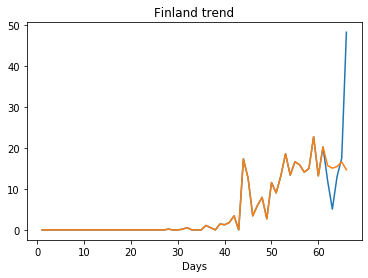

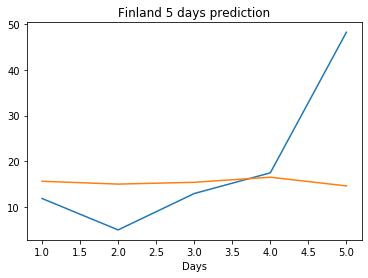

Creating directory ./offline8/Sweden/training/
Sweden
Saving the best model weights at Epoch [1], Best Valid Loss: 532.0241
Saving the best model weights at Epoch [2], Best Valid Loss: 439.0872
Saving the best model weights at Epoch [4], Best Valid Loss: 348.7782
Saving the best model weights at Epoch [5], Best Valid Loss: 298.9709
Saving the best model weights at Epoch [6], Best Valid Loss: 267.0019
Saving the best model weights at Epoch [7], Best Valid Loss: 194.0634
Saving the best model weights at Epoch [34], Best Valid Loss: 183.3918
Saving the best model weights at Epoch [38], Best Valid Loss: 182.4961
Saving the best model weights at Epoch [43], Best Valid Loss: 172.1219
Saving the best model weights at Epoch [47], Best Valid Loss: 169.8909
train error: 27.982461532385184
169.890869140625
Saving the best model weights at Epoch [1], Best Valid Loss: 488.8285
Saving the best model weights at Epoch [2], Best Valid Loss: 374.2314
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [4], Best Valid Loss: 489.5076
Saving the best model weights at Epoch [10], Best Valid Loss: 437.4120
Saving the best model weights at Epoch [12], Best Valid Loss: 225.3023
Saving the best model weights at Epoch [13], Best Valid Loss: 158.2628
Saving the best model weights at Epoch [15], Best Valid Loss: 152.4527
Saving the best model weights at Epoch [16], Best Valid Loss: 107.8985
Saving the best model weights at Epoch [29], Best Valid Loss: 99.0235
train error: 33.46447868799341
99.02346801757812
Saving the best model weights at Epoch [1], Best Valid Loss: 846.3741
Saving the best model weights at Epoch [2], Best Valid Loss: 747.7534
Saving the best model weights at Epoch [3], Best Valid Loss: 669.9377
train error: 191.12620091258452
669.9376831054688
Saving the best model weights at Epoch [1], Best Valid Loss: 622.0034
Saving the best model weights at Epoch [2], Best Valid Loss: 517.5218
Saving the best model weights at Epoch [4], Best Valid L

train error: 191.12620091258452
112.3685302734375
Saving the best model weights at Epoch [1], Best Valid Loss: 598.1816
Saving the best model weights at Epoch [2], Best Valid Loss: 537.1359
Saving the best model weights at Epoch [3], Best Valid Loss: 376.8883
Saving the best model weights at Epoch [5], Best Valid Loss: 185.7498
Saving the best model weights at Epoch [11], Best Valid Loss: 174.8985
train error: 191.12620091258452
174.8984832763672
Saving the best model weights at Epoch [1], Best Valid Loss: 544.1053
train error: 191.12620091258452
544.1052856445312
Saving the best model weights at Epoch [1], Best Valid Loss: 846.3307
Saving the best model weights at Epoch [2], Best Valid Loss: 846.1768
Saving the best model weights at Epoch [3], Best Valid Loss: 843.0237
Saving the best model weights at Epoch [4], Best Valid Loss: 838.1977
Saving the best model weights at Epoch [5], Best Valid Loss: 834.4518
train error: 172.88182472360546
834.4517822265625
Saving the best model weights

Saving the best model weights at Epoch [3], Best Valid Loss: 434.4633
Saving the best model weights at Epoch [4], Best Valid Loss: 404.0634
Saving the best model weights at Epoch [5], Best Valid Loss: 289.9817
Saving the best model weights at Epoch [6], Best Valid Loss: 242.1227
Saving the best model weights at Epoch [8], Best Valid Loss: 218.7546
Saving the best model weights at Epoch [19], Best Valid Loss: 217.5420
Saving the best model weights at Epoch [42], Best Valid Loss: 197.1169
Saving the best model weights at Epoch [45], Best Valid Loss: 181.6575
train error: 37.375400136000124
181.65750122070312
Saving the best model weights at Epoch [1], Best Valid Loss: 537.7838
Saving the best model weights at Epoch [2], Best Valid Loss: 325.7031
Saving the best model weights at Epoch [3], Best Valid Loss: 265.4764
Saving the best model weights at Epoch [6], Best Valid Loss: 251.6182
Saving the best model weights at Epoch [9], Best Valid Loss: 238.9715
Saving the best model weights at Epo

Saving the best model weights at Epoch [19], Best Valid Loss: 165.7167
Saving the best model weights at Epoch [20], Best Valid Loss: 162.0377
Saving the best model weights at Epoch [21], Best Valid Loss: 156.9007
Saving the best model weights at Epoch [28], Best Valid Loss: 150.1318
Saving the best model weights at Epoch [30], Best Valid Loss: 148.8501
Saving the best model weights at Epoch [31], Best Valid Loss: 145.9854
Saving the best model weights at Epoch [39], Best Valid Loss: 126.6637
Saving the best model weights at Epoch [41], Best Valid Loss: 125.2480
Saving the best model weights at Epoch [42], Best Valid Loss: 122.9476
Saving the best model weights at Epoch [44], Best Valid Loss: 119.0166
Saving the best model weights at Epoch [46], Best Valid Loss: 116.0963
Saving the best model weights at Epoch [47], Best Valid Loss: 115.9840
Saving the best model weights at Epoch [48], Best Valid Loss: 114.5643
Saving the best model weights at Epoch [49], Best Valid Loss: 109.3507
train 

Saving the best model weights at Epoch [3], Best Valid Loss: 499.1331
Saving the best model weights at Epoch [4], Best Valid Loss: 382.7646
Saving the best model weights at Epoch [8], Best Valid Loss: 382.0763
Saving the best model weights at Epoch [9], Best Valid Loss: 332.1692
Saving the best model weights at Epoch [12], Best Valid Loss: 310.6429
Saving the best model weights at Epoch [13], Best Valid Loss: 303.8924
Saving the best model weights at Epoch [15], Best Valid Loss: 302.7536
Saving the best model weights at Epoch [16], Best Valid Loss: 289.1966
Saving the best model weights at Epoch [19], Best Valid Loss: 287.8114
Saving the best model weights at Epoch [21], Best Valid Loss: 208.3690
Saving the best model weights at Epoch [22], Best Valid Loss: 178.9068
train error: 52.72786053963776
178.90684509277344
Saving the best model weights at Epoch [1], Best Valid Loss: 672.3777
Saving the best model weights at Epoch [2], Best Valid Loss: 404.0894
Saving the best model weights at 

Saving the best model weights at Epoch [8], Best Valid Loss: 164.6075
Saving the best model weights at Epoch [38], Best Valid Loss: 123.4821
train error: 31.440594558058113
123.4820785522461
Saving the best model weights at Epoch [1], Best Valid Loss: 879.6602
Saving the best model weights at Epoch [2], Best Valid Loss: 848.9137
Saving the best model weights at Epoch [3], Best Valid Loss: 817.3257
Saving the best model weights at Epoch [4], Best Valid Loss: 780.0235
Saving the best model weights at Epoch [5], Best Valid Loss: 673.5731
Saving the best model weights at Epoch [6], Best Valid Loss: 508.4416
Saving the best model weights at Epoch [7], Best Valid Loss: 402.0511
Saving the best model weights at Epoch [8], Best Valid Loss: 347.3504
Saving the best model weights at Epoch [9], Best Valid Loss: 327.4906
Saving the best model weights at Epoch [11], Best Valid Loss: 316.6607
Saving the best model weights at Epoch [14], Best Valid Loss: 311.8178
Saving the best model weights at Epoc

Saving the best model weights at Epoch [28], Best Valid Loss: 313.0562
Saving the best model weights at Epoch [34], Best Valid Loss: 304.4713
Saving the best model weights at Epoch [35], Best Valid Loss: 279.8123
Saving the best model weights at Epoch [36], Best Valid Loss: 237.5656
Saving the best model weights at Epoch [37], Best Valid Loss: 230.8626
Saving the best model weights at Epoch [39], Best Valid Loss: 216.0324
Saving the best model weights at Epoch [40], Best Valid Loss: 191.8148
Saving the best model weights at Epoch [50], Best Valid Loss: 168.6857
train error: 58.62283566902424
168.68568420410156
Saving the best model weights at Epoch [1], Best Valid Loss: 615.3359
Saving the best model weights at Epoch [2], Best Valid Loss: 566.8171
Saving the best model weights at Epoch [3], Best Valid Loss: 561.6513
Saving the best model weights at Epoch [6], Best Valid Loss: 495.2307
Saving the best model weights at Epoch [8], Best Valid Loss: 474.7709
Saving the best model weights at

Saving the best model weights at Epoch [23], Best Valid Loss: 472.2209
Saving the best model weights at Epoch [24], Best Valid Loss: 417.0794
Saving the best model weights at Epoch [29], Best Valid Loss: 367.3121
Saving the best model weights at Epoch [34], Best Valid Loss: 362.6167
Saving the best model weights at Epoch [40], Best Valid Loss: 354.8156
train error: 73.87687134331671
354.8155822753906
Saving the best model weights at Epoch [1], Best Valid Loss: 854.2250
Saving the best model weights at Epoch [2], Best Valid Loss: 795.1476
Saving the best model weights at Epoch [3], Best Valid Loss: 725.1340
Saving the best model weights at Epoch [4], Best Valid Loss: 641.5475
Saving the best model weights at Epoch [5], Best Valid Loss: 560.5604
Saving the best model weights at Epoch [6], Best Valid Loss: 502.6903
Saving the best model weights at Epoch [7], Best Valid Loss: 486.8359
Saving the best model weights at Epoch [8], Best Valid Loss: 482.5506
Saving the best model weights at Epo

Saving the best model weights at Epoch [49], Best Valid Loss: 482.3799
Saving the best model weights at Epoch [50], Best Valid Loss: 472.2271
train error: 105.45602074984846
472.2271423339844
Saving the best model weights at Epoch [1], Best Valid Loss: 891.3491
Saving the best model weights at Epoch [2], Best Valid Loss: 872.3229
Saving the best model weights at Epoch [3], Best Valid Loss: 842.1337
Saving the best model weights at Epoch [4], Best Valid Loss: 801.9415
Saving the best model weights at Epoch [5], Best Valid Loss: 761.5319
Saving the best model weights at Epoch [6], Best Valid Loss: 730.5428
Saving the best model weights at Epoch [7], Best Valid Loss: 715.3434
Saving the best model weights at Epoch [8], Best Valid Loss: 705.9096
Saving the best model weights at Epoch [9], Best Valid Loss: 697.5934
Saving the best model weights at Epoch [10], Best Valid Loss: 697.0695
Saving the best model weights at Epoch [11], Best Valid Loss: 692.5883
Saving the best model weights at Epo

Saving the best model weights at Epoch [31], Best Valid Loss: 530.1261
Saving the best model weights at Epoch [32], Best Valid Loss: 523.3423
Saving the best model weights at Epoch [33], Best Valid Loss: 516.7521
Saving the best model weights at Epoch [34], Best Valid Loss: 510.3590
Saving the best model weights at Epoch [35], Best Valid Loss: 504.3504
Saving the best model weights at Epoch [36], Best Valid Loss: 498.6167
Saving the best model weights at Epoch [37], Best Valid Loss: 493.0760
Saving the best model weights at Epoch [38], Best Valid Loss: 487.8109
Saving the best model weights at Epoch [39], Best Valid Loss: 482.9159
Saving the best model weights at Epoch [40], Best Valid Loss: 478.3957
Saving the best model weights at Epoch [41], Best Valid Loss: 474.5378
Saving the best model weights at Epoch [42], Best Valid Loss: 472.1071
train error: 61.665917429430735
472.1071472167969
Saving the best model weights at Epoch [1], Best Valid Loss: 871.4875
Saving the best model weight

Saving the best model weights at Epoch [45], Best Valid Loss: 168.8415
Saving the best model weights at Epoch [46], Best Valid Loss: 165.4582
Saving the best model weights at Epoch [47], Best Valid Loss: 164.2978
Saving the best model weights at Epoch [49], Best Valid Loss: 156.6596
Saving the best model weights at Epoch [50], Best Valid Loss: 152.8142
train error: 21.705777591672437
152.8141632080078
Saving the best model weights at Epoch [1], Best Valid Loss: 868.2053
Saving the best model weights at Epoch [2], Best Valid Loss: 783.2773
Saving the best model weights at Epoch [3], Best Valid Loss: 692.8320
Saving the best model weights at Epoch [4], Best Valid Loss: 615.8622
Saving the best model weights at Epoch [5], Best Valid Loss: 546.6974
Saving the best model weights at Epoch [6], Best Valid Loss: 491.1501
Saving the best model weights at Epoch [7], Best Valid Loss: 442.5252
Saving the best model weights at Epoch [8], Best Valid Loss: 404.6490
Saving the best model weights at Ep

Saving the best model weights at Epoch [19], Best Valid Loss: 317.4220
Saving the best model weights at Epoch [21], Best Valid Loss: 313.1676
Saving the best model weights at Epoch [23], Best Valid Loss: 307.2685
Saving the best model weights at Epoch [26], Best Valid Loss: 294.5291
Saving the best model weights at Epoch [31], Best Valid Loss: 292.7014
Saving the best model weights at Epoch [34], Best Valid Loss: 286.3462
Saving the best model weights at Epoch [39], Best Valid Loss: 284.7178
Saving the best model weights at Epoch [40], Best Valid Loss: 282.1802
Saving the best model weights at Epoch [41], Best Valid Loss: 278.5901
Saving the best model weights at Epoch [43], Best Valid Loss: 276.4012
Saving the best model weights at Epoch [45], Best Valid Loss: 268.0577
Saving the best model weights at Epoch [50], Best Valid Loss: 267.5159
train error: 37.955714127113076
267.51593017578125
Saving the best model weights at Epoch [1], Best Valid Loss: 494.5670
Saving the best model weigh

Saving the best model weights at Epoch [1], Best Valid Loss: 902.8887
Saving the best model weights at Epoch [2], Best Valid Loss: 897.4575
Saving the best model weights at Epoch [3], Best Valid Loss: 892.1088
Saving the best model weights at Epoch [4], Best Valid Loss: 886.8018
Saving the best model weights at Epoch [5], Best Valid Loss: 881.4803
Saving the best model weights at Epoch [6], Best Valid Loss: 876.1795
Saving the best model weights at Epoch [7], Best Valid Loss: 870.8615
Saving the best model weights at Epoch [8], Best Valid Loss: 865.5301
Saving the best model weights at Epoch [9], Best Valid Loss: 860.1227
Saving the best model weights at Epoch [10], Best Valid Loss: 854.6240
Saving the best model weights at Epoch [11], Best Valid Loss: 849.0493
Saving the best model weights at Epoch [12], Best Valid Loss: 843.2997
Saving the best model weights at Epoch [13], Best Valid Loss: 837.4443
Saving the best model weights at Epoch [14], Best Valid Loss: 831.4158
Saving the best

Saving the best model weights at Epoch [35], Best Valid Loss: 253.2658
Saving the best model weights at Epoch [36], Best Valid Loss: 251.5566
Saving the best model weights at Epoch [37], Best Valid Loss: 222.2758
Saving the best model weights at Epoch [38], Best Valid Loss: 194.0983
Saving the best model weights at Epoch [41], Best Valid Loss: 193.5654
Saving the best model weights at Epoch [45], Best Valid Loss: 162.7541
train error: 35.38083268599264
162.75413513183594
Saving the best model weights at Epoch [1], Best Valid Loss: 898.4901
Saving the best model weights at Epoch [2], Best Valid Loss: 888.3131
Saving the best model weights at Epoch [3], Best Valid Loss: 877.4738
Saving the best model weights at Epoch [4], Best Valid Loss: 866.2246
Saving the best model weights at Epoch [5], Best Valid Loss: 854.4551
Saving the best model weights at Epoch [6], Best Valid Loss: 841.7101
Saving the best model weights at Epoch [7], Best Valid Loss: 827.4350
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 86.1397
train error: 16.714693396512804
86.13972473144531
Saving the best model weights at Epoch [1], Best Valid Loss: 903.5184
Saving the best model weights at Epoch [2], Best Valid Loss: 895.6116
Saving the best model weights at Epoch [3], Best Valid Loss: 887.1736
Saving the best model weights at Epoch [4], Best Valid Loss: 878.1076
Saving the best model weights at Epoch [5], Best Valid Loss: 868.3649
Saving the best model weights at Epoch [6], Best Valid Loss: 857.5170
Saving the best model weights at Epoch [7], Best Valid Loss: 845.3662
Saving the best model weights at Epoch [8], Best Valid Loss: 827.1290
Saving the best model weights at Epoch [9], Best Valid Loss: 805.9103
Saving the best model weights at Epoch [10], Best Valid Loss: 780.9804
Saving the best model weights at Epoch [11], Best Valid Loss: 751.5029
Saving the best model weights at Epoch [12], Best Valid Loss: 716.6902
Saving the best model weights at Epoc

Saving the best model weights at Epoch [16], Best Valid Loss: 459.2748
Saving the best model weights at Epoch [17], Best Valid Loss: 429.8214
Saving the best model weights at Epoch [18], Best Valid Loss: 405.4885
Saving the best model weights at Epoch [19], Best Valid Loss: 385.9850
Saving the best model weights at Epoch [20], Best Valid Loss: 370.5727
Saving the best model weights at Epoch [21], Best Valid Loss: 358.8498
Saving the best model weights at Epoch [22], Best Valid Loss: 348.8253
Saving the best model weights at Epoch [23], Best Valid Loss: 340.9553
Saving the best model weights at Epoch [24], Best Valid Loss: 334.6971
Saving the best model weights at Epoch [25], Best Valid Loss: 328.6887
Saving the best model weights at Epoch [26], Best Valid Loss: 323.6187
Saving the best model weights at Epoch [27], Best Valid Loss: 321.4980
Saving the best model weights at Epoch [28], Best Valid Loss: 316.7925
Saving the best model weights at Epoch [29], Best Valid Loss: 312.8456
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 733.1100
Saving the best model weights at Epoch [41], Best Valid Loss: 728.7777
Saving the best model weights at Epoch [42], Best Valid Loss: 724.5020
Saving the best model weights at Epoch [43], Best Valid Loss: 720.3172
Saving the best model weights at Epoch [44], Best Valid Loss: 716.0917
Saving the best model weights at Epoch [45], Best Valid Loss: 711.9709
Saving the best model weights at Epoch [46], Best Valid Loss: 707.8683
Saving the best model weights at Epoch [47], Best Valid Loss: 703.7913
Saving the best model weights at Epoch [48], Best Valid Loss: 699.7764
Saving the best model weights at Epoch [49], Best Valid Loss: 695.8954
Saving the best model weights at Epoch [50], Best Valid Loss: 691.9987
train error: 126.41465946723675
691.9987182617188
Saving the best model weights at Epoch [1], Best Valid Loss: 909.1118
Saving the best model weights at Epoch [2], Best Valid Loss: 906.3112
Saving the best model weights

Saving the best model weights at Epoch [24], Best Valid Loss: 756.2617
Saving the best model weights at Epoch [25], Best Valid Loss: 748.7712
Saving the best model weights at Epoch [26], Best Valid Loss: 740.9801
Saving the best model weights at Epoch [27], Best Valid Loss: 733.2469
Saving the best model weights at Epoch [28], Best Valid Loss: 725.2137
Saving the best model weights at Epoch [29], Best Valid Loss: 717.2747
Saving the best model weights at Epoch [30], Best Valid Loss: 709.1855
Saving the best model weights at Epoch [31], Best Valid Loss: 701.0860
Saving the best model weights at Epoch [32], Best Valid Loss: 692.8369
Saving the best model weights at Epoch [33], Best Valid Loss: 684.6758
Saving the best model weights at Epoch [34], Best Valid Loss: 676.4604
Saving the best model weights at Epoch [35], Best Valid Loss: 668.2585
Saving the best model weights at Epoch [36], Best Valid Loss: 660.0085
Saving the best model weights at Epoch [37], Best Valid Loss: 651.8750
Saving

Saving the best model weights at Epoch [16], Best Valid Loss: 826.4272
Saving the best model weights at Epoch [17], Best Valid Loss: 820.9664
Saving the best model weights at Epoch [18], Best Valid Loss: 814.0988
Saving the best model weights at Epoch [19], Best Valid Loss: 806.3889
Saving the best model weights at Epoch [20], Best Valid Loss: 798.5139
Saving the best model weights at Epoch [21], Best Valid Loss: 790.2968
Saving the best model weights at Epoch [22], Best Valid Loss: 781.8645
Saving the best model weights at Epoch [23], Best Valid Loss: 773.1223
Saving the best model weights at Epoch [24], Best Valid Loss: 764.0664
Saving the best model weights at Epoch [25], Best Valid Loss: 754.6965
Saving the best model weights at Epoch [26], Best Valid Loss: 744.8054
Saving the best model weights at Epoch [27], Best Valid Loss: 734.6287
Saving the best model weights at Epoch [28], Best Valid Loss: 723.8789
Saving the best model weights at Epoch [29], Best Valid Loss: 712.4830
Saving

Saving the best model weights at Epoch [9], Best Valid Loss: 872.7938
Saving the best model weights at Epoch [10], Best Valid Loss: 868.5582
Saving the best model weights at Epoch [11], Best Valid Loss: 864.3065
Saving the best model weights at Epoch [12], Best Valid Loss: 859.9748
Saving the best model weights at Epoch [13], Best Valid Loss: 855.5381
Saving the best model weights at Epoch [14], Best Valid Loss: 851.0350
Saving the best model weights at Epoch [15], Best Valid Loss: 846.3895
Saving the best model weights at Epoch [16], Best Valid Loss: 841.6001
Saving the best model weights at Epoch [17], Best Valid Loss: 836.6170
Saving the best model weights at Epoch [18], Best Valid Loss: 830.7144
Saving the best model weights at Epoch [19], Best Valid Loss: 822.2430
Saving the best model weights at Epoch [20], Best Valid Loss: 813.1444
Saving the best model weights at Epoch [21], Best Valid Loss: 803.5433
Saving the best model weights at Epoch [22], Best Valid Loss: 793.2269
Saving 

Saving the best model weights at Epoch [18], Best Valid Loss: 763.5446
Saving the best model weights at Epoch [19], Best Valid Loss: 754.6644
Saving the best model weights at Epoch [20], Best Valid Loss: 745.5646
Saving the best model weights at Epoch [21], Best Valid Loss: 736.5375
Saving the best model weights at Epoch [22], Best Valid Loss: 727.4796
Saving the best model weights at Epoch [23], Best Valid Loss: 718.4655
Saving the best model weights at Epoch [24], Best Valid Loss: 709.3976
Saving the best model weights at Epoch [25], Best Valid Loss: 700.4961
Saving the best model weights at Epoch [26], Best Valid Loss: 691.5124
Saving the best model weights at Epoch [27], Best Valid Loss: 682.8228
Saving the best model weights at Epoch [28], Best Valid Loss: 674.0954
Saving the best model weights at Epoch [29], Best Valid Loss: 665.4059
Saving the best model weights at Epoch [30], Best Valid Loss: 657.1424
Saving the best model weights at Epoch [31], Best Valid Loss: 648.8181
Saving

Saving the best model weights at Epoch [17], Best Valid Loss: 804.8401
Saving the best model weights at Epoch [18], Best Valid Loss: 798.4579
Saving the best model weights at Epoch [19], Best Valid Loss: 791.9897
Saving the best model weights at Epoch [20], Best Valid Loss: 785.4828
Saving the best model weights at Epoch [21], Best Valid Loss: 778.9069
Saving the best model weights at Epoch [22], Best Valid Loss: 772.1268
Saving the best model weights at Epoch [23], Best Valid Loss: 765.3682
Saving the best model weights at Epoch [24], Best Valid Loss: 758.4935
Saving the best model weights at Epoch [25], Best Valid Loss: 751.5513
Saving the best model weights at Epoch [26], Best Valid Loss: 744.5427
Saving the best model weights at Epoch [27], Best Valid Loss: 737.5044
Saving the best model weights at Epoch [28], Best Valid Loss: 730.3666
Saving the best model weights at Epoch [29], Best Valid Loss: 723.2625
Saving the best model weights at Epoch [30], Best Valid Loss: 716.0214
Saving

Saving the best model weights at Epoch [9], Best Valid Loss: 899.0200
Saving the best model weights at Epoch [10], Best Valid Loss: 897.6279
Saving the best model weights at Epoch [11], Best Valid Loss: 896.2570
Saving the best model weights at Epoch [12], Best Valid Loss: 894.8986
Saving the best model weights at Epoch [13], Best Valid Loss: 893.5573
Saving the best model weights at Epoch [14], Best Valid Loss: 892.2324
Saving the best model weights at Epoch [15], Best Valid Loss: 890.9340
Saving the best model weights at Epoch [16], Best Valid Loss: 889.6452
Saving the best model weights at Epoch [17], Best Valid Loss: 888.3462
Saving the best model weights at Epoch [18], Best Valid Loss: 887.0761
Saving the best model weights at Epoch [19], Best Valid Loss: 885.8245
Saving the best model weights at Epoch [20], Best Valid Loss: 884.5713
Saving the best model weights at Epoch [21], Best Valid Loss: 883.3439
Saving the best model weights at Epoch [22], Best Valid Loss: 882.1113
Saving 

Saving the best model weights at Epoch [1], Best Valid Loss: 901.8058
Saving the best model weights at Epoch [2], Best Valid Loss: 893.0851
Saving the best model weights at Epoch [3], Best Valid Loss: 884.5656
Saving the best model weights at Epoch [4], Best Valid Loss: 876.0881
Saving the best model weights at Epoch [5], Best Valid Loss: 867.8527
Saving the best model weights at Epoch [6], Best Valid Loss: 859.3687
Saving the best model weights at Epoch [7], Best Valid Loss: 850.8782
Saving the best model weights at Epoch [8], Best Valid Loss: 842.2848
Saving the best model weights at Epoch [9], Best Valid Loss: 833.6258
Saving the best model weights at Epoch [10], Best Valid Loss: 824.7643
Saving the best model weights at Epoch [11], Best Valid Loss: 815.2662
Saving the best model weights at Epoch [12], Best Valid Loss: 806.0297
Saving the best model weights at Epoch [13], Best Valid Loss: 796.2711
Saving the best model weights at Epoch [14], Best Valid Loss: 786.0470
Saving the best

Saving the best model weights at Epoch [47], Best Valid Loss: 569.1381
Saving the best model weights at Epoch [48], Best Valid Loss: 563.9702
Saving the best model weights at Epoch [49], Best Valid Loss: 558.8817
Saving the best model weights at Epoch [50], Best Valid Loss: 554.0146
train error: 100.93947588164231
554.0145874023438
Saving the best model weights at Epoch [1], Best Valid Loss: 900.8658
Saving the best model weights at Epoch [2], Best Valid Loss: 894.8688
Saving the best model weights at Epoch [3], Best Valid Loss: 888.4824
Saving the best model weights at Epoch [4], Best Valid Loss: 882.8113
Saving the best model weights at Epoch [5], Best Valid Loss: 877.0914
Saving the best model weights at Epoch [6], Best Valid Loss: 870.0462
Saving the best model weights at Epoch [7], Best Valid Loss: 860.3973
Saving the best model weights at Epoch [8], Best Valid Loss: 851.1923
Saving the best model weights at Epoch [9], Best Valid Loss: 841.8359
Saving the best model weights at Epo

Saving the best model weights at Epoch [40], Best Valid Loss: 699.3079
Saving the best model weights at Epoch [41], Best Valid Loss: 694.3228
Saving the best model weights at Epoch [42], Best Valid Loss: 689.5290
Saving the best model weights at Epoch [43], Best Valid Loss: 684.8306
Saving the best model weights at Epoch [44], Best Valid Loss: 680.2562
Saving the best model weights at Epoch [45], Best Valid Loss: 675.8620
Saving the best model weights at Epoch [46], Best Valid Loss: 671.6308
Saving the best model weights at Epoch [47], Best Valid Loss: 667.5690
Saving the best model weights at Epoch [48], Best Valid Loss: 663.5541
Saving the best model weights at Epoch [49], Best Valid Loss: 659.7144
Saving the best model weights at Epoch [50], Best Valid Loss: 656.1249
train error: 121.00888729095459
656.1249389648438
Saving the best model weights at Epoch [1], Best Valid Loss: 906.0090
Saving the best model weights at Epoch [2], Best Valid Loss: 901.3393
Saving the best model weights

Saving the best model weights at Epoch [44], Best Valid Loss: 653.9808
Saving the best model weights at Epoch [45], Best Valid Loss: 648.5376
Saving the best model weights at Epoch [46], Best Valid Loss: 643.4182
Saving the best model weights at Epoch [47], Best Valid Loss: 638.5338
Saving the best model weights at Epoch [48], Best Valid Loss: 633.6615
Saving the best model weights at Epoch [49], Best Valid Loss: 629.0054
Saving the best model weights at Epoch [50], Best Valid Loss: 624.5886
train error: 126.65522101829792
624.5885620117188
Saving the best model weights at Epoch [1], Best Valid Loss: 899.6857
Saving the best model weights at Epoch [2], Best Valid Loss: 888.8036
Saving the best model weights at Epoch [3], Best Valid Loss: 878.6279
Saving the best model weights at Epoch [4], Best Valid Loss: 868.5164
Saving the best model weights at Epoch [5], Best Valid Loss: 858.0107
Saving the best model weights at Epoch [6], Best Valid Loss: 847.7365
Saving the best model weights at 

Saving the best model weights at Epoch [49], Best Valid Loss: 564.0179
Saving the best model weights at Epoch [50], Best Valid Loss: 555.7076
train error: 105.58391867012813
555.7076416015625
Saving the best model weights at Epoch [1], Best Valid Loss: 905.1105
Saving the best model weights at Epoch [2], Best Valid Loss: 899.1102
Saving the best model weights at Epoch [3], Best Valid Loss: 893.1287
Saving the best model weights at Epoch [4], Best Valid Loss: 887.6536
Saving the best model weights at Epoch [5], Best Valid Loss: 881.8090
Saving the best model weights at Epoch [6], Best Valid Loss: 876.2195
Saving the best model weights at Epoch [7], Best Valid Loss: 870.5301
Saving the best model weights at Epoch [8], Best Valid Loss: 865.0747
Saving the best model weights at Epoch [9], Best Valid Loss: 859.6115
Saving the best model weights at Epoch [10], Best Valid Loss: 853.6605
Saving the best model weights at Epoch [11], Best Valid Loss: 848.0181
Saving the best model weights at Epo

Saving the best model weights at Epoch [42], Best Valid Loss: 838.2407
Saving the best model weights at Epoch [43], Best Valid Loss: 836.3954
Saving the best model weights at Epoch [44], Best Valid Loss: 834.5705
Saving the best model weights at Epoch [45], Best Valid Loss: 832.7347
Saving the best model weights at Epoch [46], Best Valid Loss: 830.9088
Saving the best model weights at Epoch [47], Best Valid Loss: 829.0724
Saving the best model weights at Epoch [48], Best Valid Loss: 827.2464
Saving the best model weights at Epoch [49], Best Valid Loss: 825.4261
Saving the best model weights at Epoch [50], Best Valid Loss: 823.5955
train error: 161.63134039064934
823.5955200195312
Saving the best model weights at Epoch [1], Best Valid Loss: 911.0794
Saving the best model weights at Epoch [2], Best Valid Loss: 910.4770
Saving the best model weights at Epoch [3], Best Valid Loss: 909.8826
Saving the best model weights at Epoch [4], Best Valid Loss: 909.3113
Saving the best model weights a

Saving the best model weights at Epoch [8], Best Valid Loss: 897.1052
Saving the best model weights at Epoch [9], Best Valid Loss: 895.3820
Saving the best model weights at Epoch [10], Best Valid Loss: 893.5219
Saving the best model weights at Epoch [11], Best Valid Loss: 891.3916
Saving the best model weights at Epoch [12], Best Valid Loss: 888.8452
Saving the best model weights at Epoch [13], Best Valid Loss: 885.7224
Saving the best model weights at Epoch [14], Best Valid Loss: 882.2495
Saving the best model weights at Epoch [15], Best Valid Loss: 879.0153
Saving the best model weights at Epoch [16], Best Valid Loss: 875.8979
Saving the best model weights at Epoch [17], Best Valid Loss: 872.7877
Saving the best model weights at Epoch [18], Best Valid Loss: 869.6143
Saving the best model weights at Epoch [19], Best Valid Loss: 866.2416
Saving the best model weights at Epoch [20], Best Valid Loss: 862.8400
Saving the best model weights at Epoch [21], Best Valid Loss: 859.4414
Saving t

Saving the best model weights at Epoch [23], Best Valid Loss: 406.2578
Saving the best model weights at Epoch [24], Best Valid Loss: 397.9374
Saving the best model weights at Epoch [25], Best Valid Loss: 390.8018
Saving the best model weights at Epoch [26], Best Valid Loss: 386.5927
Saving the best model weights at Epoch [27], Best Valid Loss: 379.8928
Saving the best model weights at Epoch [28], Best Valid Loss: 374.0045
Saving the best model weights at Epoch [29], Best Valid Loss: 370.7946
Saving the best model weights at Epoch [30], Best Valid Loss: 363.6651
Saving the best model weights at Epoch [31], Best Valid Loss: 359.6637
Saving the best model weights at Epoch [32], Best Valid Loss: 355.5683
Saving the best model weights at Epoch [33], Best Valid Loss: 351.6617
Saving the best model weights at Epoch [34], Best Valid Loss: 347.4125
Saving the best model weights at Epoch [35], Best Valid Loss: 342.7875
Saving the best model weights at Epoch [36], Best Valid Loss: 340.2975
Saving

Saving the best model weights at Epoch [38], Best Valid Loss: 674.3479
Saving the best model weights at Epoch [39], Best Valid Loss: 669.4045
Saving the best model weights at Epoch [40], Best Valid Loss: 664.1341
Saving the best model weights at Epoch [41], Best Valid Loss: 659.4365
Saving the best model weights at Epoch [42], Best Valid Loss: 654.3242
Saving the best model weights at Epoch [43], Best Valid Loss: 649.5446
Saving the best model weights at Epoch [44], Best Valid Loss: 644.6371
Saving the best model weights at Epoch [45], Best Valid Loss: 639.5950
Saving the best model weights at Epoch [46], Best Valid Loss: 634.9556
Saving the best model weights at Epoch [47], Best Valid Loss: 630.3091
Saving the best model weights at Epoch [48], Best Valid Loss: 625.7182
Saving the best model weights at Epoch [49], Best Valid Loss: 621.5601
Saving the best model weights at Epoch [50], Best Valid Loss: 617.8999
train error: 123.37518922701992
617.89990234375
Saving the best model weights

Saving the best model weights at Epoch [8], Best Valid Loss: 810.6007
Saving the best model weights at Epoch [9], Best Valid Loss: 795.9321
Saving the best model weights at Epoch [10], Best Valid Loss: 779.6541
Saving the best model weights at Epoch [11], Best Valid Loss: 764.5731
Saving the best model weights at Epoch [12], Best Valid Loss: 748.9415
Saving the best model weights at Epoch [13], Best Valid Loss: 732.8987
Saving the best model weights at Epoch [14], Best Valid Loss: 717.6464
Saving the best model weights at Epoch [15], Best Valid Loss: 702.6635
Saving the best model weights at Epoch [16], Best Valid Loss: 687.5657
Saving the best model weights at Epoch [17], Best Valid Loss: 673.6266
Saving the best model weights at Epoch [18], Best Valid Loss: 659.4943
Saving the best model weights at Epoch [19], Best Valid Loss: 646.3156
Saving the best model weights at Epoch [20], Best Valid Loss: 632.8331
Saving the best model weights at Epoch [21], Best Valid Loss: 619.9886
Saving t

Saving the best model weights at Epoch [32], Best Valid Loss: 888.5029
Saving the best model weights at Epoch [33], Best Valid Loss: 888.0084
Saving the best model weights at Epoch [34], Best Valid Loss: 887.5177
Saving the best model weights at Epoch [35], Best Valid Loss: 887.0258
Saving the best model weights at Epoch [36], Best Valid Loss: 886.5345
Saving the best model weights at Epoch [37], Best Valid Loss: 886.0446
Saving the best model weights at Epoch [38], Best Valid Loss: 885.5563
Saving the best model weights at Epoch [39], Best Valid Loss: 885.0660
Saving the best model weights at Epoch [40], Best Valid Loss: 884.5776
Saving the best model weights at Epoch [41], Best Valid Loss: 884.0919
Saving the best model weights at Epoch [42], Best Valid Loss: 883.6071
Saving the best model weights at Epoch [43], Best Valid Loss: 883.1193
Saving the best model weights at Epoch [44], Best Valid Loss: 882.6313
Saving the best model weights at Epoch [45], Best Valid Loss: 882.1506
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 477.8415
Saving the best model weights at Epoch [48], Best Valid Loss: 468.0064
Saving the best model weights at Epoch [49], Best Valid Loss: 458.2179
Saving the best model weights at Epoch [50], Best Valid Loss: 449.1565
train error: 65.6888611892174
449.1564636230469
Saving the best model weights at Epoch [1], Best Valid Loss: 909.8820
Saving the best model weights at Epoch [2], Best Valid Loss: 909.0007
Saving the best model weights at Epoch [3], Best Valid Loss: 908.0934
Saving the best model weights at Epoch [4], Best Valid Loss: 907.1918
Saving the best model weights at Epoch [5], Best Valid Loss: 906.2902
Saving the best model weights at Epoch [6], Best Valid Loss: 905.3930
Saving the best model weights at Epoch [7], Best Valid Loss: 904.4920
Saving the best model weights at Epoch [8], Best Valid Loss: 903.5910
Saving the best model weights at Epoch [9], Best Valid Loss: 902.6955
Saving the best model weights at Epoch

Saving the best model weights at Epoch [11], Best Valid Loss: 844.2009
Saving the best model weights at Epoch [12], Best Valid Loss: 837.0506
Saving the best model weights at Epoch [13], Best Valid Loss: 828.7772
Saving the best model weights at Epoch [14], Best Valid Loss: 819.7162
Saving the best model weights at Epoch [15], Best Valid Loss: 811.4299
Saving the best model weights at Epoch [16], Best Valid Loss: 800.7891
Saving the best model weights at Epoch [17], Best Valid Loss: 790.8797
Saving the best model weights at Epoch [18], Best Valid Loss: 779.4051
Saving the best model weights at Epoch [19], Best Valid Loss: 765.3747
Saving the best model weights at Epoch [20], Best Valid Loss: 751.9695
Saving the best model weights at Epoch [21], Best Valid Loss: 737.7028
Saving the best model weights at Epoch [22], Best Valid Loss: 724.0254
Saving the best model weights at Epoch [23], Best Valid Loss: 705.8347
Saving the best model weights at Epoch [24], Best Valid Loss: 688.7438
Saving

Saving the best model weights at Epoch [26], Best Valid Loss: 895.2219
Saving the best model weights at Epoch [27], Best Valid Loss: 894.5753
Saving the best model weights at Epoch [28], Best Valid Loss: 893.8914
Saving the best model weights at Epoch [29], Best Valid Loss: 893.2242
Saving the best model weights at Epoch [30], Best Valid Loss: 892.5532
Saving the best model weights at Epoch [31], Best Valid Loss: 891.9137
Saving the best model weights at Epoch [32], Best Valid Loss: 891.1943
Saving the best model weights at Epoch [33], Best Valid Loss: 890.5099
Saving the best model weights at Epoch [34], Best Valid Loss: 889.8349
Saving the best model weights at Epoch [35], Best Valid Loss: 889.0734
Saving the best model weights at Epoch [36], Best Valid Loss: 888.3670
Saving the best model weights at Epoch [37], Best Valid Loss: 887.6237
Saving the best model weights at Epoch [38], Best Valid Loss: 886.8615
Saving the best model weights at Epoch [39], Best Valid Loss: 886.1223
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 846.1807
Saving the best model weights at Epoch [47], Best Valid Loss: 844.0835
Saving the best model weights at Epoch [48], Best Valid Loss: 841.9691
Saving the best model weights at Epoch [49], Best Valid Loss: 839.7892
Saving the best model weights at Epoch [50], Best Valid Loss: 837.5600
train error: 167.12678670523496
837.5599975585938
Saving the best model weights at Epoch [1], Best Valid Loss: 909.7342
Saving the best model weights at Epoch [2], Best Valid Loss: 908.9664
Saving the best model weights at Epoch [3], Best Valid Loss: 908.2419
Saving the best model weights at Epoch [4], Best Valid Loss: 907.5242
Saving the best model weights at Epoch [5], Best Valid Loss: 906.7603
Saving the best model weights at Epoch [6], Best Valid Loss: 906.0193
Saving the best model weights at Epoch [7], Best Valid Loss: 905.2736
Saving the best model weights at Epoch [8], Best Valid Loss: 904.5620
Saving the best model weights at Ep

Saving the best model weights at Epoch [8], Best Valid Loss: 898.7361
Saving the best model weights at Epoch [9], Best Valid Loss: 897.5892
Saving the best model weights at Epoch [10], Best Valid Loss: 896.4304
Saving the best model weights at Epoch [11], Best Valid Loss: 895.2967
Saving the best model weights at Epoch [12], Best Valid Loss: 894.1916
Saving the best model weights at Epoch [13], Best Valid Loss: 893.0446
Saving the best model weights at Epoch [14], Best Valid Loss: 891.8790
Saving the best model weights at Epoch [15], Best Valid Loss: 890.7969
Saving the best model weights at Epoch [16], Best Valid Loss: 889.6453
Saving the best model weights at Epoch [17], Best Valid Loss: 888.5102
Saving the best model weights at Epoch [18], Best Valid Loss: 887.3854
Saving the best model weights at Epoch [19], Best Valid Loss: 886.2685
Saving the best model weights at Epoch [20], Best Valid Loss: 885.1893
Saving the best model weights at Epoch [21], Best Valid Loss: 884.0590
Saving t

Saving the best model weights at Epoch [23], Best Valid Loss: 909.3691
Saving the best model weights at Epoch [24], Best Valid Loss: 909.2238
Saving the best model weights at Epoch [25], Best Valid Loss: 909.0782
Saving the best model weights at Epoch [26], Best Valid Loss: 908.9319
Saving the best model weights at Epoch [27], Best Valid Loss: 908.7871
Saving the best model weights at Epoch [28], Best Valid Loss: 908.6432
Saving the best model weights at Epoch [29], Best Valid Loss: 908.4977
Saving the best model weights at Epoch [30], Best Valid Loss: 908.3531
Saving the best model weights at Epoch [31], Best Valid Loss: 908.2086
Saving the best model weights at Epoch [32], Best Valid Loss: 908.0654
Saving the best model weights at Epoch [33], Best Valid Loss: 907.9207
Saving the best model weights at Epoch [34], Best Valid Loss: 907.7786
Saving the best model weights at Epoch [35], Best Valid Loss: 907.6338
Saving the best model weights at Epoch [36], Best Valid Loss: 907.4912
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 816.9908
Saving the best model weights at Epoch [41], Best Valid Loss: 811.6849
Saving the best model weights at Epoch [42], Best Valid Loss: 806.7220
Saving the best model weights at Epoch [43], Best Valid Loss: 801.1921
Saving the best model weights at Epoch [44], Best Valid Loss: 796.0775
Saving the best model weights at Epoch [45], Best Valid Loss: 790.8022
Saving the best model weights at Epoch [46], Best Valid Loss: 785.0646
Saving the best model weights at Epoch [47], Best Valid Loss: 779.9921
Saving the best model weights at Epoch [48], Best Valid Loss: 775.0204
Saving the best model weights at Epoch [49], Best Valid Loss: 769.4352
Saving the best model weights at Epoch [50], Best Valid Loss: 763.4792
train error: 148.38922300009892
763.4791870117188
Saving the best model weights at Epoch [1], Best Valid Loss: 910.3747
Saving the best model weights at Epoch [2], Best Valid Loss: 910.1048
Saving the best model weights

Saving the best model weights at Epoch [5], Best Valid Loss: 895.6037
Saving the best model weights at Epoch [6], Best Valid Loss: 892.2104
Saving the best model weights at Epoch [7], Best Valid Loss: 889.1253
Saving the best model weights at Epoch [8], Best Valid Loss: 885.8559
Saving the best model weights at Epoch [9], Best Valid Loss: 882.6271
Saving the best model weights at Epoch [10], Best Valid Loss: 879.2504
Saving the best model weights at Epoch [11], Best Valid Loss: 876.1282
Saving the best model weights at Epoch [12], Best Valid Loss: 872.9464
Saving the best model weights at Epoch [13], Best Valid Loss: 870.0508
Saving the best model weights at Epoch [14], Best Valid Loss: 866.8749
Saving the best model weights at Epoch [15], Best Valid Loss: 863.6274
Saving the best model weights at Epoch [16], Best Valid Loss: 860.3484
Saving the best model weights at Epoch [17], Best Valid Loss: 857.2642
Saving the best model weights at Epoch [18], Best Valid Loss: 853.8920
Saving the 

Saving the best model weights at Epoch [20], Best Valid Loss: 897.1768
Saving the best model weights at Epoch [21], Best Valid Loss: 896.5446
Saving the best model weights at Epoch [22], Best Valid Loss: 895.8535
Saving the best model weights at Epoch [23], Best Valid Loss: 895.2079
Saving the best model weights at Epoch [24], Best Valid Loss: 894.5226
Saving the best model weights at Epoch [25], Best Valid Loss: 893.8652
Saving the best model weights at Epoch [26], Best Valid Loss: 893.2020
Saving the best model weights at Epoch [27], Best Valid Loss: 892.5425
Saving the best model weights at Epoch [28], Best Valid Loss: 891.8961
Saving the best model weights at Epoch [29], Best Valid Loss: 891.2295
Saving the best model weights at Epoch [30], Best Valid Loss: 890.5629
Saving the best model weights at Epoch [31], Best Valid Loss: 889.9046
Saving the best model weights at Epoch [32], Best Valid Loss: 889.2535
Saving the best model weights at Epoch [33], Best Valid Loss: 888.5879
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 899.7734
Saving the best model weights at Epoch [36], Best Valid Loss: 899.4972
Saving the best model weights at Epoch [37], Best Valid Loss: 899.2215
Saving the best model weights at Epoch [38], Best Valid Loss: 898.9456
Saving the best model weights at Epoch [39], Best Valid Loss: 898.6665
Saving the best model weights at Epoch [40], Best Valid Loss: 898.3432
Saving the best model weights at Epoch [41], Best Valid Loss: 897.8320
Saving the best model weights at Epoch [42], Best Valid Loss: 897.3211
Saving the best model weights at Epoch [43], Best Valid Loss: 896.8112
Saving the best model weights at Epoch [44], Best Valid Loss: 896.3024
Saving the best model weights at Epoch [45], Best Valid Loss: 895.7883
Saving the best model weights at Epoch [46], Best Valid Loss: 895.2773
Saving the best model weights at Epoch [47], Best Valid Loss: 894.7700
Saving the best model weights at Epoch [48], Best Valid Loss: 894.2578
Saving

Saving the best model weights at Epoch [50], Best Valid Loss: 597.2358
train error: 101.22149437871472
597.2357788085938
Saving the best model weights at Epoch [1], Best Valid Loss: 910.9887
Saving the best model weights at Epoch [2], Best Valid Loss: 910.8281
Saving the best model weights at Epoch [3], Best Valid Loss: 910.6688
Saving the best model weights at Epoch [4], Best Valid Loss: 910.5092
Saving the best model weights at Epoch [5], Best Valid Loss: 910.3506
Saving the best model weights at Epoch [6], Best Valid Loss: 910.1918
Saving the best model weights at Epoch [7], Best Valid Loss: 910.0335
Saving the best model weights at Epoch [8], Best Valid Loss: 909.8760
Saving the best model weights at Epoch [9], Best Valid Loss: 909.7178
Saving the best model weights at Epoch [10], Best Valid Loss: 909.5602
Saving the best model weights at Epoch [11], Best Valid Loss: 909.4031
Saving the best model weights at Epoch [12], Best Valid Loss: 909.2468
Saving the best model weights at Epo

Saving the best model weights at Epoch [14], Best Valid Loss: 898.1266
Saving the best model weights at Epoch [15], Best Valid Loss: 897.3849
Saving the best model weights at Epoch [16], Best Valid Loss: 896.4203
Saving the best model weights at Epoch [17], Best Valid Loss: 895.5485
Saving the best model weights at Epoch [18], Best Valid Loss: 894.6682
Saving the best model weights at Epoch [19], Best Valid Loss: 893.8854
Saving the best model weights at Epoch [20], Best Valid Loss: 892.9875
Saving the best model weights at Epoch [21], Best Valid Loss: 892.1784
Saving the best model weights at Epoch [22], Best Valid Loss: 891.3395
Saving the best model weights at Epoch [23], Best Valid Loss: 890.6068
Saving the best model weights at Epoch [24], Best Valid Loss: 889.7674
Saving the best model weights at Epoch [25], Best Valid Loss: 889.0367
Saving the best model weights at Epoch [26], Best Valid Loss: 888.2158
Saving the best model weights at Epoch [27], Best Valid Loss: 887.5000
Saving

Saving the best model weights at Epoch [29], Best Valid Loss: 904.2131
Saving the best model weights at Epoch [30], Best Valid Loss: 903.9338
Saving the best model weights at Epoch [31], Best Valid Loss: 903.6682
Saving the best model weights at Epoch [32], Best Valid Loss: 903.4045
Saving the best model weights at Epoch [33], Best Valid Loss: 903.1447
Saving the best model weights at Epoch [34], Best Valid Loss: 902.8760
Saving the best model weights at Epoch [35], Best Valid Loss: 902.6074
Saving the best model weights at Epoch [36], Best Valid Loss: 902.3403
Saving the best model weights at Epoch [37], Best Valid Loss: 902.0705
Saving the best model weights at Epoch [38], Best Valid Loss: 901.8137
Saving the best model weights at Epoch [39], Best Valid Loss: 901.5522
Saving the best model weights at Epoch [40], Best Valid Loss: 901.2895
Saving the best model weights at Epoch [41], Best Valid Loss: 901.0350
Saving the best model weights at Epoch [42], Best Valid Loss: 900.7653
Saving

Saving the best model weights at Epoch [44], Best Valid Loss: 899.8964
Saving the best model weights at Epoch [45], Best Valid Loss: 899.6258
Saving the best model weights at Epoch [46], Best Valid Loss: 899.3572
Saving the best model weights at Epoch [47], Best Valid Loss: 899.0891
Saving the best model weights at Epoch [48], Best Valid Loss: 898.8237
Saving the best model weights at Epoch [49], Best Valid Loss: 898.5554
Saving the best model weights at Epoch [50], Best Valid Loss: 898.2875
train error: 184.7816170140587
898.2875366210938
Saving the best model weights at Epoch [1], Best Valid Loss: 911.3566
Saving the best model weights at Epoch [2], Best Valid Loss: 910.6569
Saving the best model weights at Epoch [3], Best Valid Loss: 909.9881
Saving the best model weights at Epoch [4], Best Valid Loss: 909.2858
Saving the best model weights at Epoch [5], Best Valid Loss: 908.5854
Saving the best model weights at Epoch [6], Best Valid Loss: 907.9074
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 898.1608
Saving the best model weights at Epoch [10], Best Valid Loss: 897.4492
Saving the best model weights at Epoch [11], Best Valid Loss: 896.7466
Saving the best model weights at Epoch [12], Best Valid Loss: 896.0444
Saving the best model weights at Epoch [13], Best Valid Loss: 895.3408
Saving the best model weights at Epoch [14], Best Valid Loss: 894.6391
Saving the best model weights at Epoch [15], Best Valid Loss: 893.9384
Saving the best model weights at Epoch [16], Best Valid Loss: 893.2418
Saving the best model weights at Epoch [17], Best Valid Loss: 892.5410
Saving the best model weights at Epoch [18], Best Valid Loss: 891.8475
Saving the best model weights at Epoch [19], Best Valid Loss: 891.1511
Saving the best model weights at Epoch [20], Best Valid Loss: 890.4559
Saving the best model weights at Epoch [21], Best Valid Loss: 889.7621
Saving the best model weights at Epoch [22], Best Valid Loss: 889.0677
Saving 

Saving the best model weights at Epoch [24], Best Valid Loss: 787.0320
Saving the best model weights at Epoch [25], Best Valid Loss: 781.6336
Saving the best model weights at Epoch [26], Best Valid Loss: 776.4069
Saving the best model weights at Epoch [27], Best Valid Loss: 771.7439
Saving the best model weights at Epoch [28], Best Valid Loss: 766.8424
Saving the best model weights at Epoch [29], Best Valid Loss: 761.4244
Saving the best model weights at Epoch [30], Best Valid Loss: 756.7049
Saving the best model weights at Epoch [31], Best Valid Loss: 751.1998
Saving the best model weights at Epoch [32], Best Valid Loss: 746.1942
Saving the best model weights at Epoch [33], Best Valid Loss: 740.9628
Saving the best model weights at Epoch [34], Best Valid Loss: 735.9203
Saving the best model weights at Epoch [35], Best Valid Loss: 731.0981
Saving the best model weights at Epoch [36], Best Valid Loss: 725.9344
Saving the best model weights at Epoch [37], Best Valid Loss: 720.8201
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 880.9854
Saving the best model weights at Epoch [40], Best Valid Loss: 880.2458
Saving the best model weights at Epoch [41], Best Valid Loss: 879.4699
Saving the best model weights at Epoch [42], Best Valid Loss: 878.7037
Saving the best model weights at Epoch [43], Best Valid Loss: 877.9451
Saving the best model weights at Epoch [44], Best Valid Loss: 877.2049
Saving the best model weights at Epoch [45], Best Valid Loss: 876.4079
Saving the best model weights at Epoch [46], Best Valid Loss: 875.6452
Saving the best model weights at Epoch [47], Best Valid Loss: 874.8745
Saving the best model weights at Epoch [48], Best Valid Loss: 874.1131
Saving the best model weights at Epoch [49], Best Valid Loss: 873.3471
Saving the best model weights at Epoch [50], Best Valid Loss: 872.5963
train error: 178.43441111363214
872.5963134765625
Saving the best model weights at Epoch [1], Best Valid Loss: 911.8450
Saving the best model weight

Saving the best model weights at Epoch [3], Best Valid Loss: 910.6899
Saving the best model weights at Epoch [4], Best Valid Loss: 910.3100
Saving the best model weights at Epoch [5], Best Valid Loss: 909.5711
Saving the best model weights at Epoch [6], Best Valid Loss: 908.7770
Saving the best model weights at Epoch [7], Best Valid Loss: 907.9881
Saving the best model weights at Epoch [8], Best Valid Loss: 907.1840
Saving the best model weights at Epoch [9], Best Valid Loss: 906.3931
Saving the best model weights at Epoch [10], Best Valid Loss: 905.6033
Saving the best model weights at Epoch [11], Best Valid Loss: 904.8080
Saving the best model weights at Epoch [12], Best Valid Loss: 904.0299
Saving the best model weights at Epoch [13], Best Valid Loss: 903.2582
Saving the best model weights at Epoch [14], Best Valid Loss: 902.4715
Saving the best model weights at Epoch [15], Best Valid Loss: 901.6984
Saving the best model weights at Epoch [16], Best Valid Loss: 900.9343
Saving the be

Saving the best model weights at Epoch [18], Best Valid Loss: 903.9586
Saving the best model weights at Epoch [19], Best Valid Loss: 903.5270
Saving the best model weights at Epoch [20], Best Valid Loss: 903.0923
Saving the best model weights at Epoch [21], Best Valid Loss: 902.6613
Saving the best model weights at Epoch [22], Best Valid Loss: 902.2322
Saving the best model weights at Epoch [23], Best Valid Loss: 901.8017
Saving the best model weights at Epoch [24], Best Valid Loss: 901.3709
Saving the best model weights at Epoch [25], Best Valid Loss: 900.9415
Saving the best model weights at Epoch [26], Best Valid Loss: 900.5123
Saving the best model weights at Epoch [27], Best Valid Loss: 900.0864
Saving the best model weights at Epoch [28], Best Valid Loss: 899.6574
Saving the best model weights at Epoch [29], Best Valid Loss: 899.2313
Saving the best model weights at Epoch [30], Best Valid Loss: 898.8045
Saving the best model weights at Epoch [31], Best Valid Loss: 898.3776
Saving

Saving the best model weights at Epoch [33], Best Valid Loss: 775.3094
Saving the best model weights at Epoch [34], Best Valid Loss: 768.7557
Saving the best model weights at Epoch [35], Best Valid Loss: 761.9481
Saving the best model weights at Epoch [36], Best Valid Loss: 755.7954
Saving the best model weights at Epoch [37], Best Valid Loss: 748.2594
Saving the best model weights at Epoch [38], Best Valid Loss: 742.1084
Saving the best model weights at Epoch [39], Best Valid Loss: 734.4114
Saving the best model weights at Epoch [40], Best Valid Loss: 727.4175
Saving the best model weights at Epoch [41], Best Valid Loss: 720.1231
Saving the best model weights at Epoch [42], Best Valid Loss: 712.5139
Saving the best model weights at Epoch [43], Best Valid Loss: 706.4238
Saving the best model weights at Epoch [44], Best Valid Loss: 698.8005
Saving the best model weights at Epoch [45], Best Valid Loss: 691.5910
Saving the best model weights at Epoch [46], Best Valid Loss: 684.8776
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 908.2209
Saving the best model weights at Epoch [49], Best Valid Loss: 908.1284
Saving the best model weights at Epoch [50], Best Valid Loss: 908.0386
train error: 189.6142753835382
908.03857421875
Saving the best model weights at Epoch [1], Best Valid Loss: 909.2092
Saving the best model weights at Epoch [2], Best Valid Loss: 908.6955
Saving the best model weights at Epoch [3], Best Valid Loss: 908.2018
Saving the best model weights at Epoch [4], Best Valid Loss: 907.5519
Saving the best model weights at Epoch [5], Best Valid Loss: 906.8344
Saving the best model weights at Epoch [6], Best Valid Loss: 906.1330
Saving the best model weights at Epoch [7], Best Valid Loss: 905.2950
Saving the best model weights at Epoch [8], Best Valid Loss: 904.5408
Saving the best model weights at Epoch [9], Best Valid Loss: 903.7534
Saving the best model weights at Epoch [10], Best Valid Loss: 902.8873
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [13], Best Valid Loss: 909.4451
Saving the best model weights at Epoch [14], Best Valid Loss: 909.2756
Saving the best model weights at Epoch [15], Best Valid Loss: 909.1080
Saving the best model weights at Epoch [16], Best Valid Loss: 908.9221
Saving the best model weights at Epoch [17], Best Valid Loss: 908.7322
Saving the best model weights at Epoch [18], Best Valid Loss: 908.5438
Saving the best model weights at Epoch [19], Best Valid Loss: 908.3496
Saving the best model weights at Epoch [20], Best Valid Loss: 908.1448
Saving the best model weights at Epoch [21], Best Valid Loss: 907.9399
Saving the best model weights at Epoch [22], Best Valid Loss: 907.7455
Saving the best model weights at Epoch [23], Best Valid Loss: 907.3934
Saving the best model weights at Epoch [24], Best Valid Loss: 906.9814
Saving the best model weights at Epoch [25], Best Valid Loss: 906.3625
Saving the best model weights at Epoch [26], Best Valid Loss: 905.6965
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 897.6328
Saving the best model weights at Epoch [29], Best Valid Loss: 897.1865
Saving the best model weights at Epoch [30], Best Valid Loss: 896.7381
Saving the best model weights at Epoch [31], Best Valid Loss: 896.2962
Saving the best model weights at Epoch [32], Best Valid Loss: 895.8397
Saving the best model weights at Epoch [33], Best Valid Loss: 895.3840
Saving the best model weights at Epoch [34], Best Valid Loss: 894.9352
Saving the best model weights at Epoch [35], Best Valid Loss: 894.4702
Saving the best model weights at Epoch [36], Best Valid Loss: 894.0133
Saving the best model weights at Epoch [37], Best Valid Loss: 893.5558
Saving the best model weights at Epoch [38], Best Valid Loss: 893.0912
Saving the best model weights at Epoch [39], Best Valid Loss: 892.5416
Saving the best model weights at Epoch [40], Best Valid Loss: 891.9792
Saving the best model weights at Epoch [41], Best Valid Loss: 891.4123
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 704.8034
Saving the best model weights at Epoch [47], Best Valid Loss: 699.7200
Saving the best model weights at Epoch [48], Best Valid Loss: 694.3379
Saving the best model weights at Epoch [49], Best Valid Loss: 689.0353
Saving the best model weights at Epoch [50], Best Valid Loss: 684.0372
train error: 131.5770416390793
684.0372314453125
Saving the best model weights at Epoch [1], Best Valid Loss: 906.2615
Saving the best model weights at Epoch [2], Best Valid Loss: 905.9518
Saving the best model weights at Epoch [3], Best Valid Loss: 905.6404
Saving the best model weights at Epoch [4], Best Valid Loss: 905.3264
Saving the best model weights at Epoch [5], Best Valid Loss: 905.0126
Saving the best model weights at Epoch [6], Best Valid Loss: 904.6660
Saving the best model weights at Epoch [7], Best Valid Loss: 904.3013
Saving the best model weights at Epoch [8], Best Valid Loss: 903.9332
Saving the best model weights at Epo

Saving the best model weights at Epoch [10], Best Valid Loss: 822.6055
Saving the best model weights at Epoch [11], Best Valid Loss: 811.9241
Saving the best model weights at Epoch [12], Best Valid Loss: 799.5353
Saving the best model weights at Epoch [13], Best Valid Loss: 787.4017
Saving the best model weights at Epoch [14], Best Valid Loss: 775.6868
Saving the best model weights at Epoch [15], Best Valid Loss: 765.2646
Saving the best model weights at Epoch [16], Best Valid Loss: 751.8784
Saving the best model weights at Epoch [17], Best Valid Loss: 736.9440
Saving the best model weights at Epoch [18], Best Valid Loss: 725.3820
Saving the best model weights at Epoch [19], Best Valid Loss: 712.2001
Saving the best model weights at Epoch [20], Best Valid Loss: 700.2199
Saving the best model weights at Epoch [21], Best Valid Loss: 684.9235
Saving the best model weights at Epoch [22], Best Valid Loss: 675.0126
Saving the best model weights at Epoch [23], Best Valid Loss: 659.2121
Saving

Saving the best model weights at Epoch [25], Best Valid Loss: 904.1590
Saving the best model weights at Epoch [26], Best Valid Loss: 904.0302
Saving the best model weights at Epoch [27], Best Valid Loss: 903.8997
Saving the best model weights at Epoch [28], Best Valid Loss: 903.7711
Saving the best model weights at Epoch [29], Best Valid Loss: 903.6387
Saving the best model weights at Epoch [30], Best Valid Loss: 903.5098
Saving the best model weights at Epoch [31], Best Valid Loss: 903.3791
Saving the best model weights at Epoch [32], Best Valid Loss: 903.2487
Saving the best model weights at Epoch [33], Best Valid Loss: 903.1198
Saving the best model weights at Epoch [34], Best Valid Loss: 902.9907
Saving the best model weights at Epoch [35], Best Valid Loss: 902.8662
Saving the best model weights at Epoch [36], Best Valid Loss: 902.7344
Saving the best model weights at Epoch [37], Best Valid Loss: 902.6055
Saving the best model weights at Epoch [38], Best Valid Loss: 902.4785
Saving

Saving the best model weights at Epoch [38], Best Valid Loss: 908.2993
Saving the best model weights at Epoch [39], Best Valid Loss: 908.2275
Saving the best model weights at Epoch [40], Best Valid Loss: 908.1564
Saving the best model weights at Epoch [41], Best Valid Loss: 908.0858
Saving the best model weights at Epoch [42], Best Valid Loss: 908.0162
Saving the best model weights at Epoch [43], Best Valid Loss: 907.9470
Saving the best model weights at Epoch [44], Best Valid Loss: 907.8764
Saving the best model weights at Epoch [45], Best Valid Loss: 907.8063
Saving the best model weights at Epoch [46], Best Valid Loss: 907.7372
Saving the best model weights at Epoch [47], Best Valid Loss: 907.6693
Saving the best model weights at Epoch [48], Best Valid Loss: 907.5984
Saving the best model weights at Epoch [49], Best Valid Loss: 907.5302
Saving the best model weights at Epoch [50], Best Valid Loss: 907.4584
train error: 189.46246591775582
907.4584350585938
Saving the best model weigh

Saving the best model weights at Epoch [2], Best Valid Loss: 910.9113
Saving the best model weights at Epoch [3], Best Valid Loss: 910.8073
Saving the best model weights at Epoch [4], Best Valid Loss: 910.7010
Saving the best model weights at Epoch [5], Best Valid Loss: 910.5939
Saving the best model weights at Epoch [6], Best Valid Loss: 910.4869
Saving the best model weights at Epoch [7], Best Valid Loss: 910.3821
Saving the best model weights at Epoch [8], Best Valid Loss: 910.2739
Saving the best model weights at Epoch [9], Best Valid Loss: 910.1735
Saving the best model weights at Epoch [10], Best Valid Loss: 910.0620
Saving the best model weights at Epoch [11], Best Valid Loss: 909.9553
Saving the best model weights at Epoch [12], Best Valid Loss: 909.8495
Saving the best model weights at Epoch [13], Best Valid Loss: 909.7420
Saving the best model weights at Epoch [14], Best Valid Loss: 909.6365
Saving the best model weights at Epoch [15], Best Valid Loss: 909.5305
Saving the bes

Saving the best model weights at Epoch [17], Best Valid Loss: 909.9943
Saving the best model weights at Epoch [18], Best Valid Loss: 909.9258
Saving the best model weights at Epoch [19], Best Valid Loss: 909.8582
Saving the best model weights at Epoch [20], Best Valid Loss: 909.7906
Saving the best model weights at Epoch [21], Best Valid Loss: 909.7228
Saving the best model weights at Epoch [22], Best Valid Loss: 909.6555
Saving the best model weights at Epoch [23], Best Valid Loss: 909.5879
Saving the best model weights at Epoch [24], Best Valid Loss: 909.5206
Saving the best model weights at Epoch [25], Best Valid Loss: 909.4536
Saving the best model weights at Epoch [26], Best Valid Loss: 909.3864
Saving the best model weights at Epoch [27], Best Valid Loss: 909.3198
Saving the best model weights at Epoch [28], Best Valid Loss: 909.2524
Saving the best model weights at Epoch [29], Best Valid Loss: 909.1855
Saving the best model weights at Epoch [30], Best Valid Loss: 909.1186
Saving

Saving the best model weights at Epoch [32], Best Valid Loss: 897.1855
Saving the best model weights at Epoch [33], Best Valid Loss: 896.6674
Saving the best model weights at Epoch [34], Best Valid Loss: 896.2114
Saving the best model weights at Epoch [35], Best Valid Loss: 895.7234
Saving the best model weights at Epoch [36], Best Valid Loss: 895.2686
Saving the best model weights at Epoch [37], Best Valid Loss: 894.7617
Saving the best model weights at Epoch [38], Best Valid Loss: 894.2971
Saving the best model weights at Epoch [39], Best Valid Loss: 893.7783
Saving the best model weights at Epoch [40], Best Valid Loss: 893.2734
Saving the best model weights at Epoch [41], Best Valid Loss: 892.8237
Saving the best model weights at Epoch [42], Best Valid Loss: 892.2744
Saving the best model weights at Epoch [43], Best Valid Loss: 891.7928
Saving the best model weights at Epoch [44], Best Valid Loss: 891.2570
Saving the best model weights at Epoch [45], Best Valid Loss: 890.6938
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 902.0805
Saving the best model weights at Epoch [48], Best Valid Loss: 901.9985
Saving the best model weights at Epoch [49], Best Valid Loss: 901.9142
Saving the best model weights at Epoch [50], Best Valid Loss: 901.8317
train error: 187.6141970848729
901.8316650390625
Saving the best model weights at Epoch [1], Best Valid Loss: 906.1768
Saving the best model weights at Epoch [2], Best Valid Loss: 905.7023
Saving the best model weights at Epoch [3], Best Valid Loss: 905.2531
Saving the best model weights at Epoch [4], Best Valid Loss: 904.8340
Saving the best model weights at Epoch [5], Best Valid Loss: 904.3367
Saving the best model weights at Epoch [6], Best Valid Loss: 903.8891
Saving the best model weights at Epoch [7], Best Valid Loss: 903.4298
Saving the best model weights at Epoch [8], Best Valid Loss: 903.0102
Saving the best model weights at Epoch [9], Best Valid Loss: 902.5724
Saving the best model weights at Epoc

Saving the best model weights at Epoch [12], Best Valid Loss: 907.7599
Saving the best model weights at Epoch [13], Best Valid Loss: 907.6373
Saving the best model weights at Epoch [14], Best Valid Loss: 907.5068
Saving the best model weights at Epoch [15], Best Valid Loss: 907.3813
Saving the best model weights at Epoch [16], Best Valid Loss: 907.2548
Saving the best model weights at Epoch [17], Best Valid Loss: 907.1268
Saving the best model weights at Epoch [18], Best Valid Loss: 906.9997
Saving the best model weights at Epoch [19], Best Valid Loss: 906.8740
Saving the best model weights at Epoch [20], Best Valid Loss: 906.7473
Saving the best model weights at Epoch [21], Best Valid Loss: 906.6229
Saving the best model weights at Epoch [22], Best Valid Loss: 906.4930
Saving the best model weights at Epoch [23], Best Valid Loss: 906.3701
Saving the best model weights at Epoch [24], Best Valid Loss: 906.2437
Saving the best model weights at Epoch [25], Best Valid Loss: 906.1188
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 907.2638
Saving the best model weights at Epoch [28], Best Valid Loss: 907.2158
Saving the best model weights at Epoch [29], Best Valid Loss: 907.1681
Saving the best model weights at Epoch [30], Best Valid Loss: 907.1203
Saving the best model weights at Epoch [31], Best Valid Loss: 907.0721
Saving the best model weights at Epoch [32], Best Valid Loss: 907.0244
Saving the best model weights at Epoch [33], Best Valid Loss: 906.9766
Saving the best model weights at Epoch [34], Best Valid Loss: 906.9289
Saving the best model weights at Epoch [35], Best Valid Loss: 906.8808
Saving the best model weights at Epoch [36], Best Valid Loss: 906.8330
Saving the best model weights at Epoch [37], Best Valid Loss: 906.7852
Saving the best model weights at Epoch [38], Best Valid Loss: 906.7370
Saving the best model weights at Epoch [39], Best Valid Loss: 906.6895
Saving the best model weights at Epoch [40], Best Valid Loss: 906.6414
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 890.7082
Saving the best model weights at Epoch [43], Best Valid Loss: 890.2794
Saving the best model weights at Epoch [44], Best Valid Loss: 889.8034
Saving the best model weights at Epoch [45], Best Valid Loss: 889.3937
Saving the best model weights at Epoch [46], Best Valid Loss: 888.9401
Saving the best model weights at Epoch [47], Best Valid Loss: 888.4495
Saving the best model weights at Epoch [48], Best Valid Loss: 888.0254
Saving the best model weights at Epoch [49], Best Valid Loss: 887.5832
Saving the best model weights at Epoch [50], Best Valid Loss: 887.1102
train error: 180.57407663043202
887.1101684570312
Saving the best model weights at Epoch [1], Best Valid Loss: 911.0263
Saving the best model weights at Epoch [2], Best Valid Loss: 910.9889
Saving the best model weights at Epoch [3], Best Valid Loss: 910.9512
Saving the best model weights at Epoch [4], Best Valid Loss: 910.9137
Saving the best model weights a

Saving the best model weights at Epoch [6], Best Valid Loss: 908.6398
Saving the best model weights at Epoch [7], Best Valid Loss: 908.2725
Saving the best model weights at Epoch [8], Best Valid Loss: 907.8647
Saving the best model weights at Epoch [9], Best Valid Loss: 907.4601
Saving the best model weights at Epoch [10], Best Valid Loss: 907.0573
Saving the best model weights at Epoch [11], Best Valid Loss: 906.6811
Saving the best model weights at Epoch [12], Best Valid Loss: 906.2871
Saving the best model weights at Epoch [13], Best Valid Loss: 905.9030
Saving the best model weights at Epoch [14], Best Valid Loss: 905.5078
Saving the best model weights at Epoch [15], Best Valid Loss: 905.1411
Saving the best model weights at Epoch [16], Best Valid Loss: 904.7104
Saving the best model weights at Epoch [17], Best Valid Loss: 904.3416
Saving the best model weights at Epoch [18], Best Valid Loss: 903.9428
Saving the best model weights at Epoch [19], Best Valid Loss: 903.5256
Saving the

Saving the best model weights at Epoch [21], Best Valid Loss: 907.5104
Saving the best model weights at Epoch [22], Best Valid Loss: 907.4546
Saving the best model weights at Epoch [23], Best Valid Loss: 907.3979
Saving the best model weights at Epoch [24], Best Valid Loss: 907.3457
Saving the best model weights at Epoch [25], Best Valid Loss: 907.2875
Saving the best model weights at Epoch [26], Best Valid Loss: 907.2338
Saving the best model weights at Epoch [27], Best Valid Loss: 907.1783
Saving the best model weights at Epoch [28], Best Valid Loss: 907.1211
Saving the best model weights at Epoch [29], Best Valid Loss: 907.0664
Saving the best model weights at Epoch [30], Best Valid Loss: 907.0122
Saving the best model weights at Epoch [31], Best Valid Loss: 906.9575
Saving the best model weights at Epoch [32], Best Valid Loss: 906.9025
Saving the best model weights at Epoch [33], Best Valid Loss: 906.8457
Saving the best model weights at Epoch [34], Best Valid Loss: 906.7916
Saving

Saving the best model weights at Epoch [36], Best Valid Loss: 908.1430
Saving the best model weights at Epoch [37], Best Valid Loss: 908.0846
Saving the best model weights at Epoch [38], Best Valid Loss: 908.0265
Saving the best model weights at Epoch [39], Best Valid Loss: 907.9686
Saving the best model weights at Epoch [40], Best Valid Loss: 907.9106
Saving the best model weights at Epoch [41], Best Valid Loss: 907.8525
Saving the best model weights at Epoch [42], Best Valid Loss: 907.7946
Saving the best model weights at Epoch [43], Best Valid Loss: 907.7363
Saving the best model weights at Epoch [44], Best Valid Loss: 907.6787
Saving the best model weights at Epoch [45], Best Valid Loss: 907.6205
Saving the best model weights at Epoch [46], Best Valid Loss: 907.5625
Saving the best model weights at Epoch [47], Best Valid Loss: 907.5045
Saving the best model weights at Epoch [48], Best Valid Loss: 907.4467
Saving the best model weights at Epoch [49], Best Valid Loss: 907.3885
Saving

Saving the best model weights at Epoch [1], Best Valid Loss: 909.4565
Saving the best model weights at Epoch [2], Best Valid Loss: 909.3693
Saving the best model weights at Epoch [3], Best Valid Loss: 909.2819
Saving the best model weights at Epoch [4], Best Valid Loss: 909.1949
Saving the best model weights at Epoch [5], Best Valid Loss: 909.1075
Saving the best model weights at Epoch [6], Best Valid Loss: 909.0205
Saving the best model weights at Epoch [7], Best Valid Loss: 908.9330
Saving the best model weights at Epoch [8], Best Valid Loss: 908.8459
Saving the best model weights at Epoch [9], Best Valid Loss: 908.7590
Saving the best model weights at Epoch [10], Best Valid Loss: 908.6718
Saving the best model weights at Epoch [11], Best Valid Loss: 908.5847
Saving the best model weights at Epoch [12], Best Valid Loss: 908.4974
Saving the best model weights at Epoch [13], Best Valid Loss: 908.4103
Saving the best model weights at Epoch [14], Best Valid Loss: 908.3234
Saving the best

Saving the best model weights at Epoch [16], Best Valid Loss: 907.7502
Saving the best model weights at Epoch [17], Best Valid Loss: 907.4617
Saving the best model weights at Epoch [18], Best Valid Loss: 907.1574
Saving the best model weights at Epoch [19], Best Valid Loss: 906.8521
Saving the best model weights at Epoch [20], Best Valid Loss: 906.5537
Saving the best model weights at Epoch [21], Best Valid Loss: 906.2184
Saving the best model weights at Epoch [22], Best Valid Loss: 905.9414
Saving the best model weights at Epoch [23], Best Valid Loss: 905.6481
Saving the best model weights at Epoch [24], Best Valid Loss: 905.3452
Saving the best model weights at Epoch [25], Best Valid Loss: 905.0281
Saving the best model weights at Epoch [26], Best Valid Loss: 904.7202
Saving the best model weights at Epoch [27], Best Valid Loss: 904.4150
Saving the best model weights at Epoch [28], Best Valid Loss: 904.1365
Saving the best model weights at Epoch [29], Best Valid Loss: 903.8300
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 908.6928
Saving the best model weights at Epoch [32], Best Valid Loss: 908.6264
Saving the best model weights at Epoch [33], Best Valid Loss: 908.5582
Saving the best model weights at Epoch [34], Best Valid Loss: 908.4941
Saving the best model weights at Epoch [35], Best Valid Loss: 908.4277
Saving the best model weights at Epoch [36], Best Valid Loss: 908.3594
Saving the best model weights at Epoch [37], Best Valid Loss: 908.2938
Saving the best model weights at Epoch [38], Best Valid Loss: 908.2266
Saving the best model weights at Epoch [39], Best Valid Loss: 908.1594
Saving the best model weights at Epoch [40], Best Valid Loss: 908.0948
Saving the best model weights at Epoch [41], Best Valid Loss: 908.0275
Saving the best model weights at Epoch [42], Best Valid Loss: 907.9631
Saving the best model weights at Epoch [43], Best Valid Loss: 907.8971
Saving the best model weights at Epoch [44], Best Valid Loss: 907.8283
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 910.0055
Saving the best model weights at Epoch [47], Best Valid Loss: 909.9901
Saving the best model weights at Epoch [48], Best Valid Loss: 909.9745
Saving the best model weights at Epoch [49], Best Valid Loss: 909.9590
Saving the best model weights at Epoch [50], Best Valid Loss: 909.9435
train error: 189.79219469196838
909.9435424804688
Saving the best model weights at Epoch [1], Best Valid Loss: 906.5486
Saving the best model weights at Epoch [2], Best Valid Loss: 906.4865
Saving the best model weights at Epoch [3], Best Valid Loss: 906.4215
Saving the best model weights at Epoch [4], Best Valid Loss: 906.3602
Saving the best model weights at Epoch [5], Best Valid Loss: 906.2965
Saving the best model weights at Epoch [6], Best Valid Loss: 906.2358
Saving the best model weights at Epoch [7], Best Valid Loss: 906.1727
Saving the best model weights at Epoch [8], Best Valid Loss: 906.1094
Saving the best model weights at Ep

Saving the best model weights at Epoch [10], Best Valid Loss: 909.7963
Saving the best model weights at Epoch [11], Best Valid Loss: 909.7520
Saving the best model weights at Epoch [12], Best Valid Loss: 909.7073
Saving the best model weights at Epoch [13], Best Valid Loss: 909.6626
Saving the best model weights at Epoch [14], Best Valid Loss: 909.6182
Saving the best model weights at Epoch [15], Best Valid Loss: 909.5737
Saving the best model weights at Epoch [16], Best Valid Loss: 909.5291
Saving the best model weights at Epoch [17], Best Valid Loss: 909.4844
Saving the best model weights at Epoch [18], Best Valid Loss: 909.4401
Saving the best model weights at Epoch [19], Best Valid Loss: 909.3954
Saving the best model weights at Epoch [20], Best Valid Loss: 909.3507
Saving the best model weights at Epoch [21], Best Valid Loss: 909.3063
Saving the best model weights at Epoch [22], Best Valid Loss: 909.2618
Saving the best model weights at Epoch [23], Best Valid Loss: 909.2172
Saving

Saving the best model weights at Epoch [26], Best Valid Loss: 897.2859
Saving the best model weights at Epoch [27], Best Valid Loss: 896.7510
Saving the best model weights at Epoch [28], Best Valid Loss: 896.2202
Saving the best model weights at Epoch [29], Best Valid Loss: 895.7383
Saving the best model weights at Epoch [30], Best Valid Loss: 895.2108
Saving the best model weights at Epoch [31], Best Valid Loss: 894.6721
Saving the best model weights at Epoch [32], Best Valid Loss: 894.1483
Saving the best model weights at Epoch [33], Best Valid Loss: 893.6246
Saving the best model weights at Epoch [34], Best Valid Loss: 893.1549
Saving the best model weights at Epoch [35], Best Valid Loss: 892.6548
Saving the best model weights at Epoch [36], Best Valid Loss: 892.1030
Saving the best model weights at Epoch [37], Best Valid Loss: 891.5858
Saving the best model weights at Epoch [38], Best Valid Loss: 891.0639
Saving the best model weights at Epoch [39], Best Valid Loss: 890.5713
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 906.6709
Saving the best model weights at Epoch [42], Best Valid Loss: 906.5662
Saving the best model weights at Epoch [43], Best Valid Loss: 906.4586
Saving the best model weights at Epoch [44], Best Valid Loss: 906.3528
Saving the best model weights at Epoch [45], Best Valid Loss: 906.2504
Saving the best model weights at Epoch [46], Best Valid Loss: 906.1418
Saving the best model weights at Epoch [47], Best Valid Loss: 906.0373
Saving the best model weights at Epoch [48], Best Valid Loss: 905.9308
Saving the best model weights at Epoch [49], Best Valid Loss: 905.8254
Saving the best model weights at Epoch [50], Best Valid Loss: 905.7183
train error: 188.56486990174344
905.71826171875
Saving the best model weights at Epoch [1], Best Valid Loss: 908.5693
Saving the best model weights at Epoch [2], Best Valid Loss: 908.0096
Saving the best model weights at Epoch [3], Best Valid Loss: 907.4741
Saving the best model weights at

Saving the best model weights at Epoch [5], Best Valid Loss: 909.4578
Saving the best model weights at Epoch [6], Best Valid Loss: 909.3229
Saving the best model weights at Epoch [7], Best Valid Loss: 909.1862
Saving the best model weights at Epoch [8], Best Valid Loss: 909.0488
Saving the best model weights at Epoch [9], Best Valid Loss: 908.9133
Saving the best model weights at Epoch [10], Best Valid Loss: 908.7793
Saving the best model weights at Epoch [11], Best Valid Loss: 908.6412
Saving the best model weights at Epoch [12], Best Valid Loss: 908.5054
Saving the best model weights at Epoch [13], Best Valid Loss: 908.3737
Saving the best model weights at Epoch [14], Best Valid Loss: 908.2368
Saving the best model weights at Epoch [15], Best Valid Loss: 908.0972
Saving the best model weights at Epoch [16], Best Valid Loss: 907.9684
Saving the best model weights at Epoch [17], Best Valid Loss: 907.8293
Saving the best model weights at Epoch [18], Best Valid Loss: 907.6935
Saving the 

Saving the best model weights at Epoch [20], Best Valid Loss: 910.4344
Saving the best model weights at Epoch [21], Best Valid Loss: 910.4332
Saving the best model weights at Epoch [22], Best Valid Loss: 910.4321
Saving the best model weights at Epoch [23], Best Valid Loss: 910.4308
Saving the best model weights at Epoch [24], Best Valid Loss: 910.4297
Saving the best model weights at Epoch [25], Best Valid Loss: 910.4285
Saving the best model weights at Epoch [26], Best Valid Loss: 910.4274
Saving the best model weights at Epoch [27], Best Valid Loss: 910.4263
Saving the best model weights at Epoch [28], Best Valid Loss: 910.4251
Saving the best model weights at Epoch [29], Best Valid Loss: 910.4240
Saving the best model weights at Epoch [30], Best Valid Loss: 910.4227
Saving the best model weights at Epoch [31], Best Valid Loss: 910.4215
Saving the best model weights at Epoch [32], Best Valid Loss: 910.4203
Saving the best model weights at Epoch [33], Best Valid Loss: 910.4191
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 901.2410
Saving the best model weights at Epoch [36], Best Valid Loss: 901.1162
Saving the best model weights at Epoch [37], Best Valid Loss: 900.9819
Saving the best model weights at Epoch [38], Best Valid Loss: 900.8618
Saving the best model weights at Epoch [39], Best Valid Loss: 900.7397
Saving the best model weights at Epoch [40], Best Valid Loss: 900.6069
Saving the best model weights at Epoch [41], Best Valid Loss: 900.4944
Saving the best model weights at Epoch [42], Best Valid Loss: 900.3605
Saving the best model weights at Epoch [43], Best Valid Loss: 900.2248
Saving the best model weights at Epoch [44], Best Valid Loss: 900.0991
Saving the best model weights at Epoch [45], Best Valid Loss: 899.9780
Saving the best model weights at Epoch [46], Best Valid Loss: 899.8582
Saving the best model weights at Epoch [47], Best Valid Loss: 899.7236
Saving the best model weights at Epoch [48], Best Valid Loss: 899.6052
Saving

Saving the best model weights at Epoch [3], Best Valid Loss: 907.9924
Saving the best model weights at Epoch [4], Best Valid Loss: 907.9630
Saving the best model weights at Epoch [5], Best Valid Loss: 907.9262
Saving the best model weights at Epoch [6], Best Valid Loss: 907.8877
Saving the best model weights at Epoch [7], Best Valid Loss: 907.8557
Saving the best model weights at Epoch [8], Best Valid Loss: 907.8234
Saving the best model weights at Epoch [9], Best Valid Loss: 907.7926
Saving the best model weights at Epoch [10], Best Valid Loss: 907.7648
Saving the best model weights at Epoch [11], Best Valid Loss: 907.7334
Saving the best model weights at Epoch [12], Best Valid Loss: 907.7029
Saving the best model weights at Epoch [13], Best Valid Loss: 907.6769
Saving the best model weights at Epoch [14], Best Valid Loss: 907.6450
Saving the best model weights at Epoch [15], Best Valid Loss: 907.6215
Saving the best model weights at Epoch [16], Best Valid Loss: 907.5908
Saving the be

Saving the best model weights at Epoch [18], Best Valid Loss: 904.3418
Saving the best model weights at Epoch [19], Best Valid Loss: 904.2463
Saving the best model weights at Epoch [20], Best Valid Loss: 904.1526
Saving the best model weights at Epoch [21], Best Valid Loss: 904.0613
Saving the best model weights at Epoch [22], Best Valid Loss: 903.9709
Saving the best model weights at Epoch [23], Best Valid Loss: 903.8892
Saving the best model weights at Epoch [24], Best Valid Loss: 903.7930
Saving the best model weights at Epoch [25], Best Valid Loss: 903.7055
Saving the best model weights at Epoch [26], Best Valid Loss: 903.6237
Saving the best model weights at Epoch [27], Best Valid Loss: 903.5366
Saving the best model weights at Epoch [28], Best Valid Loss: 903.4495
Saving the best model weights at Epoch [29], Best Valid Loss: 903.3666
Saving the best model weights at Epoch [30], Best Valid Loss: 903.2858
Saving the best model weights at Epoch [31], Best Valid Loss: 903.2014
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 909.7023
Saving the best model weights at Epoch [35], Best Valid Loss: 909.6777
Saving the best model weights at Epoch [36], Best Valid Loss: 909.6523
Saving the best model weights at Epoch [37], Best Valid Loss: 909.6271
Saving the best model weights at Epoch [38], Best Valid Loss: 909.6020
Saving the best model weights at Epoch [39], Best Valid Loss: 909.5747
Saving the best model weights at Epoch [40], Best Valid Loss: 909.5477
Saving the best model weights at Epoch [41], Best Valid Loss: 909.5200
Saving the best model weights at Epoch [42], Best Valid Loss: 909.4912
Saving the best model weights at Epoch [43], Best Valid Loss: 909.4625
Saving the best model weights at Epoch [44], Best Valid Loss: 909.4332
Saving the best model weights at Epoch [45], Best Valid Loss: 909.4043
Saving the best model weights at Epoch [46], Best Valid Loss: 909.3752
Saving the best model weights at Epoch [47], Best Valid Loss: 909.3464
Saving

Saving the best model weights at Epoch [49], Best Valid Loss: 897.4917
Saving the best model weights at Epoch [50], Best Valid Loss: 897.2666
train error: 186.12530356979576
897.2666015625
Saving the best model weights at Epoch [1], Best Valid Loss: 908.1517
Saving the best model weights at Epoch [2], Best Valid Loss: 908.1461
Saving the best model weights at Epoch [3], Best Valid Loss: 908.1407
Saving the best model weights at Epoch [4], Best Valid Loss: 908.1353
Saving the best model weights at Epoch [5], Best Valid Loss: 908.1299
Saving the best model weights at Epoch [6], Best Valid Loss: 908.1245
Saving the best model weights at Epoch [7], Best Valid Loss: 908.1190
Saving the best model weights at Epoch [8], Best Valid Loss: 908.1136
Saving the best model weights at Epoch [9], Best Valid Loss: 908.1082
Saving the best model weights at Epoch [10], Best Valid Loss: 908.1027
Saving the best model weights at Epoch [11], Best Valid Loss: 908.0973
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [13], Best Valid Loss: 905.0508
Saving the best model weights at Epoch [14], Best Valid Loss: 905.0021
Saving the best model weights at Epoch [15], Best Valid Loss: 904.9550
Saving the best model weights at Epoch [16], Best Valid Loss: 904.9046
Saving the best model weights at Epoch [17], Best Valid Loss: 904.8604
Saving the best model weights at Epoch [18], Best Valid Loss: 904.8073
Saving the best model weights at Epoch [19], Best Valid Loss: 904.7599
Saving the best model weights at Epoch [20], Best Valid Loss: 904.7139
Saving the best model weights at Epoch [21], Best Valid Loss: 904.6674
Saving the best model weights at Epoch [22], Best Valid Loss: 904.6134
Saving the best model weights at Epoch [23], Best Valid Loss: 904.5701
Saving the best model weights at Epoch [24], Best Valid Loss: 904.5189
Saving the best model weights at Epoch [25], Best Valid Loss: 904.4711
Saving the best model weights at Epoch [26], Best Valid Loss: 904.4218
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 909.6417
Saving the best model weights at Epoch [29], Best Valid Loss: 909.6349
Saving the best model weights at Epoch [30], Best Valid Loss: 909.6281
Saving the best model weights at Epoch [31], Best Valid Loss: 909.6215
Saving the best model weights at Epoch [32], Best Valid Loss: 909.6149
Saving the best model weights at Epoch [33], Best Valid Loss: 909.6078
Saving the best model weights at Epoch [34], Best Valid Loss: 909.6012
Saving the best model weights at Epoch [35], Best Valid Loss: 909.5945
Saving the best model weights at Epoch [36], Best Valid Loss: 909.5877
Saving the best model weights at Epoch [37], Best Valid Loss: 909.5815
Saving the best model weights at Epoch [38], Best Valid Loss: 909.5744
Saving the best model weights at Epoch [39], Best Valid Loss: 909.5680
Saving the best model weights at Epoch [40], Best Valid Loss: 909.5610
Saving the best model weights at Epoch [41], Best Valid Loss: 909.5542
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 909.6774
Saving the best model weights at Epoch [44], Best Valid Loss: 909.6725
Saving the best model weights at Epoch [45], Best Valid Loss: 909.6677
Saving the best model weights at Epoch [46], Best Valid Loss: 909.6628
Saving the best model weights at Epoch [47], Best Valid Loss: 909.6578
Saving the best model weights at Epoch [48], Best Valid Loss: 909.6530
Saving the best model weights at Epoch [49], Best Valid Loss: 909.6481
Saving the best model weights at Epoch [50], Best Valid Loss: 909.6430
train error: 189.93637742487522
909.6430053710938
Saving the best model weights at Epoch [1], Best Valid Loss: 910.5273
Saving the best model weights at Epoch [2], Best Valid Loss: 910.5190
Saving the best model weights at Epoch [3], Best Valid Loss: 910.5112
Saving the best model weights at Epoch [4], Best Valid Loss: 910.5026
Saving the best model weights at Epoch [5], Best Valid Loss: 910.4943
Saving the best model weights at

Saving the best model weights at Epoch [7], Best Valid Loss: 911.8442
Saving the best model weights at Epoch [8], Best Valid Loss: 911.8381
Saving the best model weights at Epoch [9], Best Valid Loss: 911.8318
Saving the best model weights at Epoch [10], Best Valid Loss: 911.8257
Saving the best model weights at Epoch [11], Best Valid Loss: 911.8195
Saving the best model weights at Epoch [12], Best Valid Loss: 911.8131
Saving the best model weights at Epoch [13], Best Valid Loss: 911.8068
Saving the best model weights at Epoch [14], Best Valid Loss: 911.8006
Saving the best model weights at Epoch [15], Best Valid Loss: 911.7944
Saving the best model weights at Epoch [16], Best Valid Loss: 911.7881
Saving the best model weights at Epoch [17], Best Valid Loss: 911.7819
Saving the best model weights at Epoch [18], Best Valid Loss: 911.7757
Saving the best model weights at Epoch [19], Best Valid Loss: 911.7693
Saving the best model weights at Epoch [20], Best Valid Loss: 911.7631
Saving th

Saving the best model weights at Epoch [18], Best Valid Loss: 901.5762
Saving the best model weights at Epoch [19], Best Valid Loss: 901.5628
Saving the best model weights at Epoch [20], Best Valid Loss: 901.5494
Saving the best model weights at Epoch [21], Best Valid Loss: 901.5369
Saving the best model weights at Epoch [22], Best Valid Loss: 901.5233
Saving the best model weights at Epoch [23], Best Valid Loss: 901.5102
Saving the best model weights at Epoch [24], Best Valid Loss: 901.4973
Saving the best model weights at Epoch [25], Best Valid Loss: 901.4840
Saving the best model weights at Epoch [26], Best Valid Loss: 901.4708
Saving the best model weights at Epoch [27], Best Valid Loss: 901.4576
Saving the best model weights at Epoch [28], Best Valid Loss: 901.4445
Saving the best model weights at Epoch [29], Best Valid Loss: 901.4315
Saving the best model weights at Epoch [30], Best Valid Loss: 901.4184
Saving the best model weights at Epoch [31], Best Valid Loss: 901.4055
Saving

Saving the best model weights at Epoch [33], Best Valid Loss: 909.6340
Saving the best model weights at Epoch [34], Best Valid Loss: 909.6276
Saving the best model weights at Epoch [35], Best Valid Loss: 909.6213
Saving the best model weights at Epoch [36], Best Valid Loss: 909.6149
Saving the best model weights at Epoch [37], Best Valid Loss: 909.6085
Saving the best model weights at Epoch [38], Best Valid Loss: 909.6022
Saving the best model weights at Epoch [39], Best Valid Loss: 909.5957
Saving the best model weights at Epoch [40], Best Valid Loss: 909.5895
Saving the best model weights at Epoch [41], Best Valid Loss: 909.5830
Saving the best model weights at Epoch [42], Best Valid Loss: 909.5766
Saving the best model weights at Epoch [43], Best Valid Loss: 909.5701
Saving the best model weights at Epoch [44], Best Valid Loss: 909.5638
Saving the best model weights at Epoch [45], Best Valid Loss: 909.5574
Saving the best model weights at Epoch [46], Best Valid Loss: 909.5510
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 910.4914
Saving the best model weights at Epoch [49], Best Valid Loss: 910.4655
Saving the best model weights at Epoch [50], Best Valid Loss: 910.4363
train error: 190.10906224338146
910.4363403320312
Saving the best model weights at Epoch [1], Best Valid Loss: 912.2758
Saving the best model weights at Epoch [2], Best Valid Loss: 912.2707
Saving the best model weights at Epoch [3], Best Valid Loss: 912.2656
Saving the best model weights at Epoch [4], Best Valid Loss: 912.2607
Saving the best model weights at Epoch [5], Best Valid Loss: 912.2557
Saving the best model weights at Epoch [6], Best Valid Loss: 912.2505
Saving the best model weights at Epoch [7], Best Valid Loss: 912.2455
Saving the best model weights at Epoch [8], Best Valid Loss: 912.2404
Saving the best model weights at Epoch [9], Best Valid Loss: 912.2354
Saving the best model weights at Epoch [10], Best Valid Loss: 912.2304
Saving the best model weights at Epo

Saving the best model weights at Epoch [12], Best Valid Loss: 911.5340
Saving the best model weights at Epoch [13], Best Valid Loss: 911.5201
Saving the best model weights at Epoch [14], Best Valid Loss: 911.5068
Saving the best model weights at Epoch [15], Best Valid Loss: 911.4933
Saving the best model weights at Epoch [16], Best Valid Loss: 911.4809
Saving the best model weights at Epoch [17], Best Valid Loss: 911.4656
Saving the best model weights at Epoch [18], Best Valid Loss: 911.4521
Saving the best model weights at Epoch [19], Best Valid Loss: 911.4387
Saving the best model weights at Epoch [20], Best Valid Loss: 911.4260
Saving the best model weights at Epoch [21], Best Valid Loss: 911.4116
Saving the best model weights at Epoch [22], Best Valid Loss: 911.3986
Saving the best model weights at Epoch [23], Best Valid Loss: 911.3856
Saving the best model weights at Epoch [24], Best Valid Loss: 911.3725
Saving the best model weights at Epoch [25], Best Valid Loss: 911.3586
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 909.3976
Saving the best model weights at Epoch [28], Best Valid Loss: 909.3839
Saving the best model weights at Epoch [29], Best Valid Loss: 909.3701
Saving the best model weights at Epoch [30], Best Valid Loss: 909.3563
Saving the best model weights at Epoch [31], Best Valid Loss: 909.3422
Saving the best model weights at Epoch [32], Best Valid Loss: 909.3286
Saving the best model weights at Epoch [33], Best Valid Loss: 909.3146
Saving the best model weights at Epoch [34], Best Valid Loss: 909.3010
Saving the best model weights at Epoch [35], Best Valid Loss: 909.2871
Saving the best model weights at Epoch [36], Best Valid Loss: 909.2733
Saving the best model weights at Epoch [37], Best Valid Loss: 909.2594
Saving the best model weights at Epoch [38], Best Valid Loss: 909.2453
Saving the best model weights at Epoch [39], Best Valid Loss: 909.2322
Saving the best model weights at Epoch [40], Best Valid Loss: 909.2181
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 912.2980
Saving the best model weights at Epoch [43], Best Valid Loss: 912.2966
Saving the best model weights at Epoch [44], Best Valid Loss: 912.2950
Saving the best model weights at Epoch [45], Best Valid Loss: 912.2936
Saving the best model weights at Epoch [46], Best Valid Loss: 912.2920
Saving the best model weights at Epoch [47], Best Valid Loss: 912.2905
Saving the best model weights at Epoch [48], Best Valid Loss: 912.2890
Saving the best model weights at Epoch [49], Best Valid Loss: 912.2875
Saving the best model weights at Epoch [50], Best Valid Loss: 912.2859
train error: 190.9796749823566
912.2859497070312
Saving the best model weights at Epoch [1], Best Valid Loss: 912.8151
train error: 191.12620091258452
912.8150634765625
Saving the best model weights at Epoch [1], Best Valid Loss: 908.6457
Saving the best model weights at Epoch [2], Best Valid Loss: 908.6342
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [4], Best Valid Loss: 910.9352
Saving the best model weights at Epoch [5], Best Valid Loss: 910.9323
Saving the best model weights at Epoch [6], Best Valid Loss: 910.9294
Saving the best model weights at Epoch [7], Best Valid Loss: 910.9266
Saving the best model weights at Epoch [8], Best Valid Loss: 910.9236
Saving the best model weights at Epoch [9], Best Valid Loss: 910.9207
Saving the best model weights at Epoch [10], Best Valid Loss: 910.9179
Saving the best model weights at Epoch [11], Best Valid Loss: 910.9149
Saving the best model weights at Epoch [12], Best Valid Loss: 910.9120
Saving the best model weights at Epoch [13], Best Valid Loss: 910.9092
Saving the best model weights at Epoch [14], Best Valid Loss: 910.9062
Saving the best model weights at Epoch [15], Best Valid Loss: 910.9033
Saving the best model weights at Epoch [16], Best Valid Loss: 910.9005
Saving the best model weights at Epoch [17], Best Valid Loss: 910.8976
Saving the b

Saving the best model weights at Epoch [19], Best Valid Loss: 911.5945
Saving the best model weights at Epoch [20], Best Valid Loss: 911.5930
Saving the best model weights at Epoch [21], Best Valid Loss: 911.5914
Saving the best model weights at Epoch [22], Best Valid Loss: 911.5898
Saving the best model weights at Epoch [23], Best Valid Loss: 911.5882
Saving the best model weights at Epoch [24], Best Valid Loss: 911.5865
Saving the best model weights at Epoch [25], Best Valid Loss: 911.5850
Saving the best model weights at Epoch [26], Best Valid Loss: 911.5833
Saving the best model weights at Epoch [27], Best Valid Loss: 911.5817
Saving the best model weights at Epoch [28], Best Valid Loss: 911.5801
Saving the best model weights at Epoch [29], Best Valid Loss: 911.5786
Saving the best model weights at Epoch [30], Best Valid Loss: 911.5768
Saving the best model weights at Epoch [31], Best Valid Loss: 911.5752
Saving the best model weights at Epoch [32], Best Valid Loss: 911.5737
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 910.7627
Saving the best model weights at Epoch [35], Best Valid Loss: 910.7314
Saving the best model weights at Epoch [36], Best Valid Loss: 910.7015
Saving the best model weights at Epoch [37], Best Valid Loss: 910.6699
Saving the best model weights at Epoch [38], Best Valid Loss: 910.6395
Saving the best model weights at Epoch [39], Best Valid Loss: 910.6100
Saving the best model weights at Epoch [40], Best Valid Loss: 910.5786
Saving the best model weights at Epoch [41], Best Valid Loss: 910.5461
Saving the best model weights at Epoch [42], Best Valid Loss: 910.5156
Saving the best model weights at Epoch [43], Best Valid Loss: 910.4850
Saving the best model weights at Epoch [44], Best Valid Loss: 910.4541
Saving the best model weights at Epoch [45], Best Valid Loss: 910.4262
Saving the best model weights at Epoch [46], Best Valid Loss: 910.3918
Saving the best model weights at Epoch [47], Best Valid Loss: 910.3625
Saving

Saving the best model weights at Epoch [49], Best Valid Loss: 910.5294
Saving the best model weights at Epoch [50], Best Valid Loss: 910.5161
train error: 190.31280203960065
910.5160522460938
Saving the best model weights at Epoch [1], Best Valid Loss: 912.0530
Saving the best model weights at Epoch [2], Best Valid Loss: 912.0234
Saving the best model weights at Epoch [3], Best Valid Loss: 911.9946
Saving the best model weights at Epoch [4], Best Valid Loss: 911.9672
Saving the best model weights at Epoch [5], Best Valid Loss: 911.9401
Saving the best model weights at Epoch [6], Best Valid Loss: 911.9123
Saving the best model weights at Epoch [7], Best Valid Loss: 911.8836
Saving the best model weights at Epoch [8], Best Valid Loss: 911.8553
Saving the best model weights at Epoch [9], Best Valid Loss: 911.8264
Saving the best model weights at Epoch [10], Best Valid Loss: 911.8004
Saving the best model weights at Epoch [11], Best Valid Loss: 911.7709
Saving the best model weights at Epo

Saving the best model weights at Epoch [13], Best Valid Loss: 906.3619
Saving the best model weights at Epoch [14], Best Valid Loss: 906.3491
Saving the best model weights at Epoch [15], Best Valid Loss: 906.3362
Saving the best model weights at Epoch [16], Best Valid Loss: 906.3237
Saving the best model weights at Epoch [17], Best Valid Loss: 906.3112
Saving the best model weights at Epoch [18], Best Valid Loss: 906.2980
Saving the best model weights at Epoch [19], Best Valid Loss: 906.2852
Saving the best model weights at Epoch [20], Best Valid Loss: 906.2724
Saving the best model weights at Epoch [21], Best Valid Loss: 906.2596
Saving the best model weights at Epoch [22], Best Valid Loss: 906.2467
Saving the best model weights at Epoch [23], Best Valid Loss: 906.2339
Saving the best model weights at Epoch [24], Best Valid Loss: 906.2217
Saving the best model weights at Epoch [25], Best Valid Loss: 906.2085
Saving the best model weights at Epoch [26], Best Valid Loss: 906.1957
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 912.0964
Saving the best model weights at Epoch [29], Best Valid Loss: 912.0920
Saving the best model weights at Epoch [30], Best Valid Loss: 912.0873
Saving the best model weights at Epoch [31], Best Valid Loss: 912.0828
Saving the best model weights at Epoch [32], Best Valid Loss: 912.0783
Saving the best model weights at Epoch [33], Best Valid Loss: 912.0739
Saving the best model weights at Epoch [34], Best Valid Loss: 912.0693
Saving the best model weights at Epoch [35], Best Valid Loss: 912.0648
Saving the best model weights at Epoch [36], Best Valid Loss: 912.0602
Saving the best model weights at Epoch [37], Best Valid Loss: 912.0557
Saving the best model weights at Epoch [38], Best Valid Loss: 912.0512
Saving the best model weights at Epoch [39], Best Valid Loss: 912.0467
Saving the best model weights at Epoch [40], Best Valid Loss: 912.0422
Saving the best model weights at Epoch [41], Best Valid Loss: 912.0376
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 908.7838
Saving the best model weights at Epoch [44], Best Valid Loss: 908.7614
Saving the best model weights at Epoch [45], Best Valid Loss: 908.7370
Saving the best model weights at Epoch [46], Best Valid Loss: 908.7106
Saving the best model weights at Epoch [47], Best Valid Loss: 908.6873
Saving the best model weights at Epoch [48], Best Valid Loss: 908.6620
Saving the best model weights at Epoch [49], Best Valid Loss: 908.6357
Saving the best model weights at Epoch [50], Best Valid Loss: 908.6111
train error: 189.2558451341144
908.6111450195312
Saving the best model weights at Epoch [1], Best Valid Loss: 906.3974
Saving the best model weights at Epoch [2], Best Valid Loss: 906.3888
Saving the best model weights at Epoch [3], Best Valid Loss: 906.3802
Saving the best model weights at Epoch [4], Best Valid Loss: 906.3716
Saving the best model weights at Epoch [5], Best Valid Loss: 906.3628
Saving the best model weights at 

Saving the best model weights at Epoch [7], Best Valid Loss: 908.7287
Saving the best model weights at Epoch [8], Best Valid Loss: 908.6802
Saving the best model weights at Epoch [9], Best Valid Loss: 908.6346
Saving the best model weights at Epoch [10], Best Valid Loss: 908.5854
Saving the best model weights at Epoch [11], Best Valid Loss: 908.5348
Saving the best model weights at Epoch [12], Best Valid Loss: 908.4901
Saving the best model weights at Epoch [13], Best Valid Loss: 908.4381
Saving the best model weights at Epoch [14], Best Valid Loss: 908.3892
Saving the best model weights at Epoch [15], Best Valid Loss: 908.3408
Saving the best model weights at Epoch [16], Best Valid Loss: 908.2924
Saving the best model weights at Epoch [17], Best Valid Loss: 908.2467
Saving the best model weights at Epoch [18], Best Valid Loss: 908.1929
Saving the best model weights at Epoch [19], Best Valid Loss: 908.1468
Saving the best model weights at Epoch [20], Best Valid Loss: 908.1006
Saving th

Saving the best model weights at Epoch [23], Best Valid Loss: 909.9106
Saving the best model weights at Epoch [24], Best Valid Loss: 909.8945
Saving the best model weights at Epoch [25], Best Valid Loss: 909.8789
Saving the best model weights at Epoch [26], Best Valid Loss: 909.8631
Saving the best model weights at Epoch [27], Best Valid Loss: 909.8475
Saving the best model weights at Epoch [28], Best Valid Loss: 909.8311
Saving the best model weights at Epoch [29], Best Valid Loss: 909.8149
Saving the best model weights at Epoch [30], Best Valid Loss: 909.7993
Saving the best model weights at Epoch [31], Best Valid Loss: 909.7834
Saving the best model weights at Epoch [32], Best Valid Loss: 909.7674
Saving the best model weights at Epoch [33], Best Valid Loss: 909.7519
Saving the best model weights at Epoch [34], Best Valid Loss: 909.7355
Saving the best model weights at Epoch [35], Best Valid Loss: 909.7192
Saving the best model weights at Epoch [36], Best Valid Loss: 909.7042
Saving

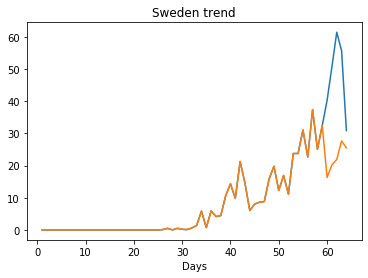

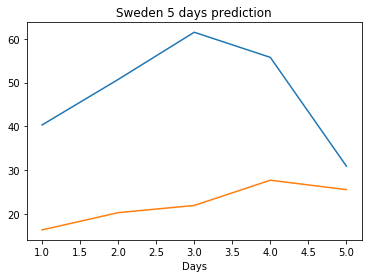

Creating directory ./offline8/Italy/training/
Italy
Saving the best model weights at Epoch [1], Best Valid Loss: 2743.6790
Saving the best model weights at Epoch [2], Best Valid Loss: 2237.9172
Saving the best model weights at Epoch [6], Best Valid Loss: 1794.4069
Saving the best model weights at Epoch [9], Best Valid Loss: 1592.7900
Saving the best model weights at Epoch [10], Best Valid Loss: 1587.5518
train error: 1415.3501439587824
1587.5517578125
Saving the best model weights at Epoch [1], Best Valid Loss: 1941.8229
Saving the best model weights at Epoch [3], Best Valid Loss: 1755.5682
Saving the best model weights at Epoch [6], Best Valid Loss: 1096.5411
Saving the best model weights at Epoch [9], Best Valid Loss: 978.3717
Saving the best model weights at Epoch [13], Best Valid Loss: 594.8644
train error: 1709.5238451464422
594.8643798828125
Saving the best model weights at Epoch [1], Best Valid Loss: 1569.4270
train error: 3730.4147234949573
1569.427001953125
Saving the best mod

train error: 3730.4147234949573
8354.3271484375
Saving the best model weights at Epoch [1], Best Valid Loss: 8354.3271
train error: 3730.4147234949573
8354.3271484375
Saving the best model weights at Epoch [1], Best Valid Loss: 7210.4634
Saving the best model weights at Epoch [2], Best Valid Loss: 7165.8594
Saving the best model weights at Epoch [3], Best Valid Loss: 6180.1440
Saving the best model weights at Epoch [4], Best Valid Loss: 5970.1929
Saving the best model weights at Epoch [5], Best Valid Loss: 5732.4214
Saving the best model weights at Epoch [6], Best Valid Loss: 5614.7119
Saving the best model weights at Epoch [9], Best Valid Loss: 5427.7446
Saving the best model weights at Epoch [13], Best Valid Loss: 5363.6079
Saving the best model weights at Epoch [18], Best Valid Loss: 5298.3721
Saving the best model weights at Epoch [24], Best Valid Loss: 5173.5552
train error: 2731.2152846763875
5173.55517578125
Saving the best model weights at Epoch [1], Best Valid Loss: 5329.3501


Saving the best model weights at Epoch [23], Best Valid Loss: 2909.3953
Saving the best model weights at Epoch [24], Best Valid Loss: 2909.1685
Saving the best model weights at Epoch [27], Best Valid Loss: 2902.0959
Saving the best model weights at Epoch [28], Best Valid Loss: 2897.8489
Saving the best model weights at Epoch [34], Best Valid Loss: 2891.9548
Saving the best model weights at Epoch [35], Best Valid Loss: 2886.9380
Saving the best model weights at Epoch [36], Best Valid Loss: 2873.7068
Saving the best model weights at Epoch [37], Best Valid Loss: 2870.3455
train error: 1940.847284777411
2870.345458984375
Saving the best model weights at Epoch [1], Best Valid Loss: 6641.9648
Saving the best model weights at Epoch [2], Best Valid Loss: 5287.7246
Saving the best model weights at Epoch [3], Best Valid Loss: 4875.7002
Saving the best model weights at Epoch [4], Best Valid Loss: 4001.1523
Saving the best model weights at Epoch [5], Best Valid Loss: 3270.4705
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 3452.4902
Saving the best model weights at Epoch [14], Best Valid Loss: 3452.1516
Saving the best model weights at Epoch [25], Best Valid Loss: 3443.6277
Saving the best model weights at Epoch [32], Best Valid Loss: 3420.6289
Saving the best model weights at Epoch [33], Best Valid Loss: 3397.1938
Saving the best model weights at Epoch [34], Best Valid Loss: 3394.7422
Saving the best model weights at Epoch [50], Best Valid Loss: 3381.6985
train error: 1827.7719431910023
3381.698486328125
Saving the best model weights at Epoch [1], Best Valid Loss: 6927.8330
Saving the best model weights at Epoch [2], Best Valid Loss: 4859.1401
Saving the best model weights at Epoch [3], Best Valid Loss: 4489.2095
Saving the best model weights at Epoch [4], Best Valid Loss: 4208.4980
Saving the best model weights at Epoch [5], Best Valid Loss: 4132.7070
Saving the best model weights at Epoch [7], Best Valid Loss: 3952.5547
Saving the best model

Saving the best model weights at Epoch [1], Best Valid Loss: 7331.2900
Saving the best model weights at Epoch [2], Best Valid Loss: 6106.2915
Saving the best model weights at Epoch [5], Best Valid Loss: 5985.5889
Saving the best model weights at Epoch [17], Best Valid Loss: 5954.2788
train error: 2794.635411755792
5954.27880859375
Saving the best model weights at Epoch [1], Best Valid Loss: 2038.9885
Saving the best model weights at Epoch [2], Best Valid Loss: 1694.9227
Saving the best model weights at Epoch [5], Best Valid Loss: 1459.6830
Saving the best model weights at Epoch [8], Best Valid Loss: 1346.5044
Saving the best model weights at Epoch [9], Best Valid Loss: 1236.4248
Saving the best model weights at Epoch [38], Best Valid Loss: 879.9075
train error: 1415.6218024944437
879.9075317382812
Saving the best model weights at Epoch [1], Best Valid Loss: 3194.9915
Saving the best model weights at Epoch [2], Best Valid Loss: 1978.0719
Saving the best model weights at Epoch [7], Best 

Saving the best model weights at Epoch [22], Best Valid Loss: 4782.4907
Saving the best model weights at Epoch [25], Best Valid Loss: 4661.4897
Saving the best model weights at Epoch [31], Best Valid Loss: 4587.5068
Saving the best model weights at Epoch [38], Best Valid Loss: 4474.3589
Saving the best model weights at Epoch [40], Best Valid Loss: 4456.4399
train error: 2209.093077560951
4456.43994140625
Saving the best model weights at Epoch [1], Best Valid Loss: 3757.5671
Saving the best model weights at Epoch [3], Best Valid Loss: 3074.9680
Saving the best model weights at Epoch [9], Best Valid Loss: 2958.8838
Saving the best model weights at Epoch [11], Best Valid Loss: 2715.2349
Saving the best model weights at Epoch [40], Best Valid Loss: 2713.7322
Saving the best model weights at Epoch [44], Best Valid Loss: 1755.4642
Saving the best model weights at Epoch [48], Best Valid Loss: 1365.2842
train error: 1435.3340759277344
1365.2841796875
Saving the best model weights at Epoch [1],

Saving the best model weights at Epoch [25], Best Valid Loss: 5417.6968
Saving the best model weights at Epoch [26], Best Valid Loss: 5361.3110
Saving the best model weights at Epoch [27], Best Valid Loss: 5304.9541
Saving the best model weights at Epoch [28], Best Valid Loss: 5253.2393
Saving the best model weights at Epoch [29], Best Valid Loss: 5198.0283
Saving the best model weights at Epoch [30], Best Valid Loss: 5137.0391
Saving the best model weights at Epoch [31], Best Valid Loss: 5069.8047
Saving the best model weights at Epoch [32], Best Valid Loss: 4974.5503
Saving the best model weights at Epoch [33], Best Valid Loss: 4886.3047
Saving the best model weights at Epoch [34], Best Valid Loss: 4794.4312
Saving the best model weights at Epoch [35], Best Valid Loss: 4695.9482
Saving the best model weights at Epoch [36], Best Valid Loss: 4600.1963
Saving the best model weights at Epoch [37], Best Valid Loss: 4507.1797
Saving the best model weights at Epoch [38], Best Valid Loss: 44

Saving the best model weights at Epoch [36], Best Valid Loss: 2208.3340
Saving the best model weights at Epoch [37], Best Valid Loss: 2118.0205
Saving the best model weights at Epoch [38], Best Valid Loss: 2050.6975
Saving the best model weights at Epoch [39], Best Valid Loss: 1994.6469
Saving the best model weights at Epoch [40], Best Valid Loss: 1964.5319
train error: 1322.9865185967808
1964.5318603515625
Saving the best model weights at Epoch [1], Best Valid Loss: 6141.2051
Saving the best model weights at Epoch [2], Best Valid Loss: 6013.6665
Saving the best model weights at Epoch [3], Best Valid Loss: 4919.2534
Saving the best model weights at Epoch [5], Best Valid Loss: 3945.4590
Saving the best model weights at Epoch [6], Best Valid Loss: 3725.2290
Saving the best model weights at Epoch [7], Best Valid Loss: 3537.6023
Saving the best model weights at Epoch [8], Best Valid Loss: 3514.6086
Saving the best model weights at Epoch [9], Best Valid Loss: 2840.7468
Saving the best model

Saving the best model weights at Epoch [30], Best Valid Loss: 2224.6833
Saving the best model weights at Epoch [31], Best Valid Loss: 2084.6033
Saving the best model weights at Epoch [32], Best Valid Loss: 1879.1161
Saving the best model weights at Epoch [33], Best Valid Loss: 1822.0859
Saving the best model weights at Epoch [43], Best Valid Loss: 1801.9178
Saving the best model weights at Epoch [44], Best Valid Loss: 1711.9130
Saving the best model weights at Epoch [45], Best Valid Loss: 1616.3470
Saving the best model weights at Epoch [46], Best Valid Loss: 1537.8910
Saving the best model weights at Epoch [47], Best Valid Loss: 1488.1770
Saving the best model weights at Epoch [50], Best Valid Loss: 1432.0254
train error: 903.6354969945447
1432.025390625
Saving the best model weights at Epoch [1], Best Valid Loss: 6599.3940
Saving the best model weights at Epoch [2], Best Valid Loss: 2897.0134
Saving the best model weights at Epoch [6], Best Valid Loss: 2792.8552
Saving the best model

Saving the best model weights at Epoch [4], Best Valid Loss: 8002.4976
Saving the best model weights at Epoch [5], Best Valid Loss: 7822.0220
Saving the best model weights at Epoch [6], Best Valid Loss: 7559.3999
Saving the best model weights at Epoch [7], Best Valid Loss: 7269.5425
Saving the best model weights at Epoch [8], Best Valid Loss: 7046.0718
Saving the best model weights at Epoch [9], Best Valid Loss: 6750.9961
Saving the best model weights at Epoch [10], Best Valid Loss: 6533.1675
Saving the best model weights at Epoch [11], Best Valid Loss: 6184.9204
Saving the best model weights at Epoch [12], Best Valid Loss: 5827.9468
Saving the best model weights at Epoch [13], Best Valid Loss: 5768.2070
Saving the best model weights at Epoch [14], Best Valid Loss: 5345.1094
Saving the best model weights at Epoch [15], Best Valid Loss: 5048.2534
Saving the best model weights at Epoch [16], Best Valid Loss: 4850.4429
Saving the best model weights at Epoch [17], Best Valid Loss: 4708.381

Saving the best model weights at Epoch [1], Best Valid Loss: 8270.2393
Saving the best model weights at Epoch [2], Best Valid Loss: 7916.8335
Saving the best model weights at Epoch [3], Best Valid Loss: 6818.1338
Saving the best model weights at Epoch [4], Best Valid Loss: 5697.9897
Saving the best model weights at Epoch [5], Best Valid Loss: 5131.0264
Saving the best model weights at Epoch [6], Best Valid Loss: 4937.3081
Saving the best model weights at Epoch [10], Best Valid Loss: 4588.7261
Saving the best model weights at Epoch [28], Best Valid Loss: 4507.3018
train error: 2198.039246657799
4507.3017578125
Saving the best model weights at Epoch [1], Best Valid Loss: 7940.3203
Saving the best model weights at Epoch [2], Best Valid Loss: 5354.9941
Saving the best model weights at Epoch [3], Best Valid Loss: 4527.6641
Saving the best model weights at Epoch [4], Best Valid Loss: 3568.3801
Saving the best model weights at Epoch [5], Best Valid Loss: 3297.9829
Saving the best model weight

Saving the best model weights at Epoch [3], Best Valid Loss: 8124.3086
Saving the best model weights at Epoch [4], Best Valid Loss: 8034.8062
Saving the best model weights at Epoch [5], Best Valid Loss: 7923.6836
Saving the best model weights at Epoch [6], Best Valid Loss: 7768.9917
Saving the best model weights at Epoch [7], Best Valid Loss: 7501.2549
Saving the best model weights at Epoch [8], Best Valid Loss: 6941.8784
Saving the best model weights at Epoch [9], Best Valid Loss: 6050.1104
Saving the best model weights at Epoch [10], Best Valid Loss: 5146.3496
Saving the best model weights at Epoch [11], Best Valid Loss: 4413.1484
Saving the best model weights at Epoch [12], Best Valid Loss: 3829.6375
Saving the best model weights at Epoch [13], Best Valid Loss: 3459.1169
Saving the best model weights at Epoch [14], Best Valid Loss: 3174.6418
Saving the best model weights at Epoch [15], Best Valid Loss: 2953.2859
Saving the best model weights at Epoch [16], Best Valid Loss: 2718.0176

Saving the best model weights at Epoch [7], Best Valid Loss: 7268.5952
Saving the best model weights at Epoch [8], Best Valid Loss: 5827.0674
Saving the best model weights at Epoch [9], Best Valid Loss: 4522.6611
Saving the best model weights at Epoch [10], Best Valid Loss: 4082.9158
Saving the best model weights at Epoch [11], Best Valid Loss: 3673.7322
Saving the best model weights at Epoch [12], Best Valid Loss: 3630.8430
Saving the best model weights at Epoch [14], Best Valid Loss: 3357.9158
Saving the best model weights at Epoch [15], Best Valid Loss: 3342.4133
Saving the best model weights at Epoch [17], Best Valid Loss: 3264.4724
Saving the best model weights at Epoch [19], Best Valid Loss: 3148.9365
Saving the best model weights at Epoch [21], Best Valid Loss: 2955.2512
Saving the best model weights at Epoch [28], Best Valid Loss: 2946.0081
Saving the best model weights at Epoch [31], Best Valid Loss: 2823.9172
Saving the best model weights at Epoch [34], Best Valid Loss: 2807.

Saving the best model weights at Epoch [26], Best Valid Loss: 2168.4883
Saving the best model weights at Epoch [27], Best Valid Loss: 2152.5181
Saving the best model weights at Epoch [28], Best Valid Loss: 2133.5188
Saving the best model weights at Epoch [29], Best Valid Loss: 2120.8723
Saving the best model weights at Epoch [30], Best Valid Loss: 2109.9553
Saving the best model weights at Epoch [31], Best Valid Loss: 2108.9509
Saving the best model weights at Epoch [32], Best Valid Loss: 2090.6353
Saving the best model weights at Epoch [33], Best Valid Loss: 2066.9312
Saving the best model weights at Epoch [34], Best Valid Loss: 2061.8435
Saving the best model weights at Epoch [36], Best Valid Loss: 2055.5054
Saving the best model weights at Epoch [37], Best Valid Loss: 2048.8630
Saving the best model weights at Epoch [40], Best Valid Loss: 2045.5543
Saving the best model weights at Epoch [42], Best Valid Loss: 2037.7252
Saving the best model weights at Epoch [45], Best Valid Loss: 20

Saving the best model weights at Epoch [13], Best Valid Loss: 4122.0054
Saving the best model weights at Epoch [14], Best Valid Loss: 3893.4734
Saving the best model weights at Epoch [15], Best Valid Loss: 3763.0649
Saving the best model weights at Epoch [16], Best Valid Loss: 3661.9297
Saving the best model weights at Epoch [17], Best Valid Loss: 3617.8494
Saving the best model weights at Epoch [18], Best Valid Loss: 3550.3574
Saving the best model weights at Epoch [19], Best Valid Loss: 3525.0359
Saving the best model weights at Epoch [20], Best Valid Loss: 3482.9119
Saving the best model weights at Epoch [21], Best Valid Loss: 3378.8215
Saving the best model weights at Epoch [22], Best Valid Loss: 3343.3250
Saving the best model weights at Epoch [23], Best Valid Loss: 3324.4519
Saving the best model weights at Epoch [30], Best Valid Loss: 3228.6763
Saving the best model weights at Epoch [32], Best Valid Loss: 3114.2188
Saving the best model weights at Epoch [34], Best Valid Loss: 30

Saving the best model weights at Epoch [18], Best Valid Loss: 6429.9673
Saving the best model weights at Epoch [19], Best Valid Loss: 6271.3281
Saving the best model weights at Epoch [20], Best Valid Loss: 6124.6519
Saving the best model weights at Epoch [21], Best Valid Loss: 5993.6875
Saving the best model weights at Epoch [22], Best Valid Loss: 5874.9565
Saving the best model weights at Epoch [23], Best Valid Loss: 5766.1011
Saving the best model weights at Epoch [24], Best Valid Loss: 5668.1543
Saving the best model weights at Epoch [25], Best Valid Loss: 5578.8413
Saving the best model weights at Epoch [26], Best Valid Loss: 5498.2188
Saving the best model weights at Epoch [27], Best Valid Loss: 5426.1265
Saving the best model weights at Epoch [28], Best Valid Loss: 5361.7510
Saving the best model weights at Epoch [29], Best Valid Loss: 5304.6943
Saving the best model weights at Epoch [30], Best Valid Loss: 5253.0898
Saving the best model weights at Epoch [31], Best Valid Loss: 52

Saving the best model weights at Epoch [33], Best Valid Loss: 6123.2446
Saving the best model weights at Epoch [34], Best Valid Loss: 6120.8315
Saving the best model weights at Epoch [35], Best Valid Loss: 6119.3237
Saving the best model weights at Epoch [38], Best Valid Loss: 6116.1504
Saving the best model weights at Epoch [39], Best Valid Loss: 6114.8486
Saving the best model weights at Epoch [41], Best Valid Loss: 6113.3130
Saving the best model weights at Epoch [43], Best Valid Loss: 6112.0068
Saving the best model weights at Epoch [49], Best Valid Loss: 6109.3901
train error: 2770.3949058795797
6109.39013671875
Saving the best model weights at Epoch [1], Best Valid Loss: 8354.3271
train error: 3730.4147234949573
8354.3271484375
Saving the best model weights at Epoch [1], Best Valid Loss: 8023.0908
Saving the best model weights at Epoch [2], Best Valid Loss: 7179.0117
Saving the best model weights at Epoch [3], Best Valid Loss: 5046.5913
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [32], Best Valid Loss: 2643.4609
Saving the best model weights at Epoch [35], Best Valid Loss: 2550.5969
Saving the best model weights at Epoch [36], Best Valid Loss: 2203.1667
Saving the best model weights at Epoch [37], Best Valid Loss: 1438.8420
Saving the best model weights at Epoch [39], Best Valid Loss: 1334.1553
Saving the best model weights at Epoch [40], Best Valid Loss: 1245.1395
Saving the best model weights at Epoch [41], Best Valid Loss: 767.6889
Saving the best model weights at Epoch [43], Best Valid Loss: 756.5063
train error: 1087.8093845762055
756.50634765625
Saving the best model weights at Epoch [1], Best Valid Loss: 8176.9409
Saving the best model weights at Epoch [2], Best Valid Loss: 7961.1597
Saving the best model weights at Epoch [3], Best Valid Loss: 7635.4360
Saving the best model weights at Epoch [4], Best Valid Loss: 6997.3906
Saving the best model weights at Epoch [5], Best Valid Loss: 5886.9092
Saving the best model w

Saving the best model weights at Epoch [32], Best Valid Loss: 7771.5806
Saving the best model weights at Epoch [33], Best Valid Loss: 7757.1328
Saving the best model weights at Epoch [34], Best Valid Loss: 7741.9727
Saving the best model weights at Epoch [35], Best Valid Loss: 7727.3706
Saving the best model weights at Epoch [36], Best Valid Loss: 7713.1562
Saving the best model weights at Epoch [37], Best Valid Loss: 7698.9546
Saving the best model weights at Epoch [38], Best Valid Loss: 7684.1484
Saving the best model weights at Epoch [39], Best Valid Loss: 7670.7070
Saving the best model weights at Epoch [40], Best Valid Loss: 7656.5562
Saving the best model weights at Epoch [41], Best Valid Loss: 7642.4409
Saving the best model weights at Epoch [42], Best Valid Loss: 7628.8281
Saving the best model weights at Epoch [43], Best Valid Loss: 7615.3140
Saving the best model weights at Epoch [44], Best Valid Loss: 7601.6655
Saving the best model weights at Epoch [45], Best Valid Loss: 75

Saving the best model weights at Epoch [46], Best Valid Loss: 5591.9136
Saving the best model weights at Epoch [47], Best Valid Loss: 5546.7886
Saving the best model weights at Epoch [48], Best Valid Loss: 5503.0386
Saving the best model weights at Epoch [49], Best Valid Loss: 5459.5034
Saving the best model weights at Epoch [50], Best Valid Loss: 5416.5581
train error: 2317.938548038746
5416.55810546875
Saving the best model weights at Epoch [1], Best Valid Loss: 8268.5215
Saving the best model weights at Epoch [2], Best Valid Loss: 8119.5288
Saving the best model weights at Epoch [3], Best Valid Loss: 7984.5796
Saving the best model weights at Epoch [4], Best Valid Loss: 7844.9194
Saving the best model weights at Epoch [5], Best Valid Loss: 7711.9683
Saving the best model weights at Epoch [6], Best Valid Loss: 7570.2656
Saving the best model weights at Epoch [7], Best Valid Loss: 7437.6812
Saving the best model weights at Epoch [8], Best Valid Loss: 7306.3159
Saving the best model we

Saving the best model weights at Epoch [36], Best Valid Loss: 4031.0930
Saving the best model weights at Epoch [37], Best Valid Loss: 4020.1204
Saving the best model weights at Epoch [38], Best Valid Loss: 3732.2466
Saving the best model weights at Epoch [39], Best Valid Loss: 3723.8574
Saving the best model weights at Epoch [41], Best Valid Loss: 3508.9856
Saving the best model weights at Epoch [44], Best Valid Loss: 3302.8196
Saving the best model weights at Epoch [45], Best Valid Loss: 3239.0964
Saving the best model weights at Epoch [46], Best Valid Loss: 3175.3962
Saving the best model weights at Epoch [47], Best Valid Loss: 3114.1838
Saving the best model weights at Epoch [48], Best Valid Loss: 3065.3523
Saving the best model weights at Epoch [49], Best Valid Loss: 2992.6721
Saving the best model weights at Epoch [50], Best Valid Loss: 2934.3562
train error: 1189.2042079793996
2934.356201171875
Saving the best model weights at Epoch [1], Best Valid Loss: 8267.6514
Saving the best

Saving the best model weights at Epoch [29], Best Valid Loss: 4882.7759
Saving the best model weights at Epoch [30], Best Valid Loss: 4849.0063
Saving the best model weights at Epoch [31], Best Valid Loss: 4753.2388
Saving the best model weights at Epoch [33], Best Valid Loss: 4634.6670
Saving the best model weights at Epoch [34], Best Valid Loss: 4579.8647
Saving the best model weights at Epoch [35], Best Valid Loss: 4527.3047
Saving the best model weights at Epoch [36], Best Valid Loss: 4487.2578
Saving the best model weights at Epoch [42], Best Valid Loss: 4297.4565
Saving the best model weights at Epoch [43], Best Valid Loss: 4196.3530
Saving the best model weights at Epoch [44], Best Valid Loss: 4100.4277
Saving the best model weights at Epoch [45], Best Valid Loss: 4010.4563
Saving the best model weights at Epoch [46], Best Valid Loss: 3925.1621
Saving the best model weights at Epoch [47], Best Valid Loss: 3844.7524
Saving the best model weights at Epoch [48], Best Valid Loss: 37

Saving the best model weights at Epoch [39], Best Valid Loss: 7960.1875
Saving the best model weights at Epoch [40], Best Valid Loss: 7942.1406
Saving the best model weights at Epoch [41], Best Valid Loss: 7923.5127
Saving the best model weights at Epoch [42], Best Valid Loss: 7904.3438
Saving the best model weights at Epoch [43], Best Valid Loss: 7884.6890
Saving the best model weights at Epoch [44], Best Valid Loss: 7864.5425
Saving the best model weights at Epoch [45], Best Valid Loss: 7844.0503
Saving the best model weights at Epoch [46], Best Valid Loss: 7822.9585
Saving the best model weights at Epoch [47], Best Valid Loss: 7801.3003
Saving the best model weights at Epoch [48], Best Valid Loss: 7779.4741
Saving the best model weights at Epoch [49], Best Valid Loss: 7757.1206
Saving the best model weights at Epoch [50], Best Valid Loss: 7734.2358
train error: 3428.3999924824157
7734.23583984375
Saving the best model weights at Epoch [1], Best Valid Loss: 8342.8115
Saving the best 

Saving the best model weights at Epoch [5], Best Valid Loss: 8315.7627
Saving the best model weights at Epoch [6], Best Valid Loss: 8307.0479
Saving the best model weights at Epoch [7], Best Valid Loss: 8298.7617
Saving the best model weights at Epoch [8], Best Valid Loss: 8290.6514
Saving the best model weights at Epoch [9], Best Valid Loss: 8282.3848
Saving the best model weights at Epoch [10], Best Valid Loss: 8273.9834
Saving the best model weights at Epoch [11], Best Valid Loss: 8265.4424
Saving the best model weights at Epoch [12], Best Valid Loss: 8256.6816
Saving the best model weights at Epoch [13], Best Valid Loss: 8247.5547
Saving the best model weights at Epoch [14], Best Valid Loss: 8238.3066
Saving the best model weights at Epoch [15], Best Valid Loss: 8228.7227
Saving the best model weights at Epoch [16], Best Valid Loss: 8218.8955
Saving the best model weights at Epoch [17], Best Valid Loss: 8208.6396
Saving the best model weights at Epoch [18], Best Valid Loss: 8197.88

Saving the best model weights at Epoch [21], Best Valid Loss: 4707.3755
Saving the best model weights at Epoch [22], Best Valid Loss: 4697.3540
Saving the best model weights at Epoch [23], Best Valid Loss: 4682.5479
Saving the best model weights at Epoch [25], Best Valid Loss: 4652.1030
Saving the best model weights at Epoch [26], Best Valid Loss: 4650.4077
Saving the best model weights at Epoch [27], Best Valid Loss: 4581.4561
Saving the best model weights at Epoch [30], Best Valid Loss: 4569.6250
Saving the best model weights at Epoch [37], Best Valid Loss: 4518.8345
Saving the best model weights at Epoch [38], Best Valid Loss: 4483.4526
Saving the best model weights at Epoch [39], Best Valid Loss: 4461.6309
Saving the best model weights at Epoch [42], Best Valid Loss: 4450.0903
Saving the best model weights at Epoch [43], Best Valid Loss: 4403.0933
Saving the best model weights at Epoch [44], Best Valid Loss: 4355.6143
Saving the best model weights at Epoch [45], Best Valid Loss: 43

Saving the best model weights at Epoch [1], Best Valid Loss: 8294.7178
Saving the best model weights at Epoch [2], Best Valid Loss: 8205.4141
Saving the best model weights at Epoch [3], Best Valid Loss: 8040.9453
Saving the best model weights at Epoch [4], Best Valid Loss: 7691.7046
Saving the best model weights at Epoch [5], Best Valid Loss: 7179.0820
Saving the best model weights at Epoch [6], Best Valid Loss: 6225.4546
Saving the best model weights at Epoch [7], Best Valid Loss: 5414.0049
Saving the best model weights at Epoch [8], Best Valid Loss: 4749.2134
Saving the best model weights at Epoch [9], Best Valid Loss: 4301.4800
Saving the best model weights at Epoch [10], Best Valid Loss: 3979.7166
Saving the best model weights at Epoch [11], Best Valid Loss: 3709.2148
Saving the best model weights at Epoch [13], Best Valid Loss: 3634.5330
Saving the best model weights at Epoch [14], Best Valid Loss: 3543.0454
Saving the best model weights at Epoch [18], Best Valid Loss: 3320.9734
S

Saving the best model weights at Epoch [47], Best Valid Loss: 978.9368
Saving the best model weights at Epoch [49], Best Valid Loss: 914.2187
Saving the best model weights at Epoch [50], Best Valid Loss: 886.5391
train error: 547.1487072089623
886.5390625
Saving the best model weights at Epoch [1], Best Valid Loss: 8305.2217
Saving the best model weights at Epoch [2], Best Valid Loss: 8219.9443
Saving the best model weights at Epoch [3], Best Valid Loss: 8031.2393
Saving the best model weights at Epoch [4], Best Valid Loss: 7605.9517
Saving the best model weights at Epoch [5], Best Valid Loss: 7017.4805
Saving the best model weights at Epoch [6], Best Valid Loss: 6549.1772
Saving the best model weights at Epoch [7], Best Valid Loss: 6380.7939
Saving the best model weights at Epoch [8], Best Valid Loss: 6220.9355
Saving the best model weights at Epoch [11], Best Valid Loss: 6218.1440
Saving the best model weights at Epoch [13], Best Valid Loss: 6123.7446
Saving the best model weights at

Saving the best model weights at Epoch [29], Best Valid Loss: 7919.1753
Saving the best model weights at Epoch [30], Best Valid Loss: 7901.2773
Saving the best model weights at Epoch [31], Best Valid Loss: 7883.4175
Saving the best model weights at Epoch [32], Best Valid Loss: 7864.9233
Saving the best model weights at Epoch [33], Best Valid Loss: 7846.2783
Saving the best model weights at Epoch [34], Best Valid Loss: 7827.3687
Saving the best model weights at Epoch [35], Best Valid Loss: 7807.6655
Saving the best model weights at Epoch [36], Best Valid Loss: 7787.7095
Saving the best model weights at Epoch [37], Best Valid Loss: 7767.0469
Saving the best model weights at Epoch [38], Best Valid Loss: 7746.1797
Saving the best model weights at Epoch [39], Best Valid Loss: 7725.3081
Saving the best model weights at Epoch [40], Best Valid Loss: 7703.3423
Saving the best model weights at Epoch [41], Best Valid Loss: 7681.2095
Saving the best model weights at Epoch [42], Best Valid Loss: 76

Saving the best model weights at Epoch [46], Best Valid Loss: 7932.1675
Saving the best model weights at Epoch [47], Best Valid Loss: 7919.1860
Saving the best model weights at Epoch [48], Best Valid Loss: 7905.9077
Saving the best model weights at Epoch [49], Best Valid Loss: 7892.2329
Saving the best model weights at Epoch [50], Best Valid Loss: 7878.3237
train error: 3490.348788820464
7878.32373046875
Saving the best model weights at Epoch [1], Best Valid Loss: 8340.1914
Saving the best model weights at Epoch [2], Best Valid Loss: 8330.8926
Saving the best model weights at Epoch [3], Best Valid Loss: 8322.1318
Saving the best model weights at Epoch [4], Best Valid Loss: 8313.0625
Saving the best model weights at Epoch [5], Best Valid Loss: 8304.1455
Saving the best model weights at Epoch [6], Best Valid Loss: 8295.0049
Saving the best model weights at Epoch [7], Best Valid Loss: 8286.0576
Saving the best model weights at Epoch [8], Best Valid Loss: 8277.0322
Saving the best model we

Saving the best model weights at Epoch [29], Best Valid Loss: 8122.3843
Saving the best model weights at Epoch [30], Best Valid Loss: 8113.5361
Saving the best model weights at Epoch [31], Best Valid Loss: 8104.5195
Saving the best model weights at Epoch [32], Best Valid Loss: 8095.3940
Saving the best model weights at Epoch [33], Best Valid Loss: 8085.9976
Saving the best model weights at Epoch [34], Best Valid Loss: 8076.4805
Saving the best model weights at Epoch [35], Best Valid Loss: 8066.6548
Saving the best model weights at Epoch [36], Best Valid Loss: 8056.7695
Saving the best model weights at Epoch [37], Best Valid Loss: 8046.7080
Saving the best model weights at Epoch [38], Best Valid Loss: 8036.4565
Saving the best model weights at Epoch [39], Best Valid Loss: 8026.0625
Saving the best model weights at Epoch [40], Best Valid Loss: 8015.2305
Saving the best model weights at Epoch [41], Best Valid Loss: 8003.7822
Saving the best model weights at Epoch [42], Best Valid Loss: 79

Saving the best model weights at Epoch [9], Best Valid Loss: 8283.5693
Saving the best model weights at Epoch [10], Best Valid Loss: 8276.3330
Saving the best model weights at Epoch [11], Best Valid Loss: 8269.1289
Saving the best model weights at Epoch [12], Best Valid Loss: 8261.8418
Saving the best model weights at Epoch [13], Best Valid Loss: 8254.4639
Saving the best model weights at Epoch [14], Best Valid Loss: 8247.0752
Saving the best model weights at Epoch [15], Best Valid Loss: 8239.6123
Saving the best model weights at Epoch [16], Best Valid Loss: 8232.0615
Saving the best model weights at Epoch [17], Best Valid Loss: 8224.4287
Saving the best model weights at Epoch [18], Best Valid Loss: 8216.7002
Saving the best model weights at Epoch [19], Best Valid Loss: 8208.8545
Saving the best model weights at Epoch [20], Best Valid Loss: 8200.9082
Saving the best model weights at Epoch [21], Best Valid Loss: 8192.7080
Saving the best model weights at Epoch [22], Best Valid Loss: 818

Saving the best model weights at Epoch [44], Best Valid Loss: 1562.3055
Saving the best model weights at Epoch [45], Best Valid Loss: 1366.8069
Saving the best model weights at Epoch [48], Best Valid Loss: 1212.9921
train error: 1679.319697676034
1212.9920654296875
Saving the best model weights at Epoch [1], Best Valid Loss: 8320.6094
Saving the best model weights at Epoch [2], Best Valid Loss: 8313.6826
Saving the best model weights at Epoch [3], Best Valid Loss: 8306.7764
Saving the best model weights at Epoch [4], Best Valid Loss: 8299.8643
Saving the best model weights at Epoch [5], Best Valid Loss: 8292.9521
Saving the best model weights at Epoch [6], Best Valid Loss: 8286.0674
Saving the best model weights at Epoch [7], Best Valid Loss: 8279.1582
Saving the best model weights at Epoch [8], Best Valid Loss: 8272.2178
Saving the best model weights at Epoch [9], Best Valid Loss: 8265.3447
Saving the best model weights at Epoch [10], Best Valid Loss: 8258.4287
Saving the best model w

Saving the best model weights at Epoch [11], Best Valid Loss: 7739.3906
Saving the best model weights at Epoch [12], Best Valid Loss: 7650.4136
Saving the best model weights at Epoch [13], Best Valid Loss: 7533.8228
Saving the best model weights at Epoch [14], Best Valid Loss: 7355.7671
Saving the best model weights at Epoch [15], Best Valid Loss: 7112.0156
Saving the best model weights at Epoch [16], Best Valid Loss: 6855.7549
Saving the best model weights at Epoch [17], Best Valid Loss: 6608.7734
Saving the best model weights at Epoch [18], Best Valid Loss: 6319.5684
Saving the best model weights at Epoch [19], Best Valid Loss: 6043.1245
Saving the best model weights at Epoch [20], Best Valid Loss: 5770.5142
Saving the best model weights at Epoch [21], Best Valid Loss: 5524.1948
Saving the best model weights at Epoch [22], Best Valid Loss: 5303.1426
Saving the best model weights at Epoch [23], Best Valid Loss: 5068.2329
Saving the best model weights at Epoch [24], Best Valid Loss: 48

Saving the best model weights at Epoch [25], Best Valid Loss: 8108.5859
Saving the best model weights at Epoch [26], Best Valid Loss: 8092.4868
Saving the best model weights at Epoch [27], Best Valid Loss: 8075.1792
Saving the best model weights at Epoch [28], Best Valid Loss: 8057.6206
Saving the best model weights at Epoch [29], Best Valid Loss: 8039.4609
Saving the best model weights at Epoch [30], Best Valid Loss: 8019.9468
Saving the best model weights at Epoch [31], Best Valid Loss: 8000.5034
Saving the best model weights at Epoch [32], Best Valid Loss: 7979.6938
Saving the best model weights at Epoch [33], Best Valid Loss: 7958.5640
Saving the best model weights at Epoch [34], Best Valid Loss: 7936.7080
Saving the best model weights at Epoch [35], Best Valid Loss: 7912.6577
Saving the best model weights at Epoch [36], Best Valid Loss: 7887.9214
Saving the best model weights at Epoch [37], Best Valid Loss: 7862.6626
Saving the best model weights at Epoch [38], Best Valid Loss: 78

Saving the best model weights at Epoch [40], Best Valid Loss: 7712.2300
Saving the best model weights at Epoch [41], Best Valid Loss: 7686.5908
Saving the best model weights at Epoch [42], Best Valid Loss: 7660.1885
Saving the best model weights at Epoch [43], Best Valid Loss: 7632.5298
Saving the best model weights at Epoch [44], Best Valid Loss: 7603.8188
Saving the best model weights at Epoch [45], Best Valid Loss: 7573.8423
Saving the best model weights at Epoch [46], Best Valid Loss: 7542.8159
Saving the best model weights at Epoch [47], Best Valid Loss: 7510.3813
Saving the best model weights at Epoch [48], Best Valid Loss: 7476.5845
Saving the best model weights at Epoch [49], Best Valid Loss: 7441.5986
Saving the best model weights at Epoch [50], Best Valid Loss: 7404.8657
train error: 3230.5392599681327
7404.86572265625
Saving the best model weights at Epoch [1], Best Valid Loss: 8342.3145
Saving the best model weights at Epoch [2], Best Valid Loss: 8334.5137
Saving the best m

Saving the best model weights at Epoch [14], Best Valid Loss: 8288.7773
Saving the best model weights at Epoch [15], Best Valid Loss: 8284.2656
Saving the best model weights at Epoch [16], Best Valid Loss: 8279.7432
Saving the best model weights at Epoch [17], Best Valid Loss: 8275.1875
Saving the best model weights at Epoch [18], Best Valid Loss: 8270.6406
Saving the best model weights at Epoch [19], Best Valid Loss: 8266.0645
Saving the best model weights at Epoch [20], Best Valid Loss: 8261.4746
Saving the best model weights at Epoch [21], Best Valid Loss: 8256.8389
Saving the best model weights at Epoch [22], Best Valid Loss: 8252.2236
Saving the best model weights at Epoch [23], Best Valid Loss: 8247.5352
Saving the best model weights at Epoch [24], Best Valid Loss: 8242.8438
Saving the best model weights at Epoch [25], Best Valid Loss: 8238.1348
Saving the best model weights at Epoch [26], Best Valid Loss: 8233.3955
Saving the best model weights at Epoch [27], Best Valid Loss: 82

Saving the best model weights at Epoch [27], Best Valid Loss: 4344.1743
Saving the best model weights at Epoch [35], Best Valid Loss: 4307.5947
Saving the best model weights at Epoch [37], Best Valid Loss: 4194.1577
Saving the best model weights at Epoch [38], Best Valid Loss: 3692.7830
Saving the best model weights at Epoch [39], Best Valid Loss: 3403.4375
Saving the best model weights at Epoch [40], Best Valid Loss: 3099.3169
Saving the best model weights at Epoch [42], Best Valid Loss: 2870.9797
Saving the best model weights at Epoch [43], Best Valid Loss: 2429.0271
Saving the best model weights at Epoch [44], Best Valid Loss: 2332.8887
Saving the best model weights at Epoch [47], Best Valid Loss: 2309.3625
Saving the best model weights at Epoch [48], Best Valid Loss: 2292.9473
Saving the best model weights at Epoch [50], Best Valid Loss: 2208.9285
train error: 1764.121790129563
2208.928466796875
Saving the best model weights at Epoch [1], Best Valid Loss: 8325.2969
Saving the best 

Saving the best model weights at Epoch [2], Best Valid Loss: 8240.4990
Saving the best model weights at Epoch [3], Best Valid Loss: 8184.1562
Saving the best model weights at Epoch [4], Best Valid Loss: 8124.3569
Saving the best model weights at Epoch [5], Best Valid Loss: 8065.4268
Saving the best model weights at Epoch [6], Best Valid Loss: 7998.4546
Saving the best model weights at Epoch [7], Best Valid Loss: 7907.5562
Saving the best model weights at Epoch [8], Best Valid Loss: 7801.3706
Saving the best model weights at Epoch [9], Best Valid Loss: 7671.4136
Saving the best model weights at Epoch [10], Best Valid Loss: 7525.3291
Saving the best model weights at Epoch [11], Best Valid Loss: 7335.9087
Saving the best model weights at Epoch [12], Best Valid Loss: 7104.9155
Saving the best model weights at Epoch [13], Best Valid Loss: 6859.6562
Saving the best model weights at Epoch [14], Best Valid Loss: 6606.7031
Saving the best model weights at Epoch [15], Best Valid Loss: 6346.7271


Saving the best model weights at Epoch [16], Best Valid Loss: 8206.4551
Saving the best model weights at Epoch [17], Best Valid Loss: 8197.3281
Saving the best model weights at Epoch [18], Best Valid Loss: 8187.5327
Saving the best model weights at Epoch [19], Best Valid Loss: 8177.7236
Saving the best model weights at Epoch [20], Best Valid Loss: 8167.9570
Saving the best model weights at Epoch [21], Best Valid Loss: 8157.9165
Saving the best model weights at Epoch [22], Best Valid Loss: 8148.0869
Saving the best model weights at Epoch [23], Best Valid Loss: 8137.7720
Saving the best model weights at Epoch [24], Best Valid Loss: 8127.1172
Saving the best model weights at Epoch [25], Best Valid Loss: 8116.4321
Saving the best model weights at Epoch [26], Best Valid Loss: 8104.5815
Saving the best model weights at Epoch [27], Best Valid Loss: 8088.3237
Saving the best model weights at Epoch [28], Best Valid Loss: 8072.3501
Saving the best model weights at Epoch [29], Best Valid Loss: 80

Saving the best model weights at Epoch [45], Best Valid Loss: 7825.4702
Saving the best model weights at Epoch [46], Best Valid Loss: 7806.7656
Saving the best model weights at Epoch [47], Best Valid Loss: 7787.2070
Saving the best model weights at Epoch [48], Best Valid Loss: 7765.4868
Saving the best model weights at Epoch [49], Best Valid Loss: 7744.5884
Saving the best model weights at Epoch [50], Best Valid Loss: 7722.5352
train error: 3472.243797302246
7722.53515625
Saving the best model weights at Epoch [1], Best Valid Loss: 8315.0459
Saving the best model weights at Epoch [2], Best Valid Loss: 8270.0732
Saving the best model weights at Epoch [3], Best Valid Loss: 8227.8330
Saving the best model weights at Epoch [4], Best Valid Loss: 8177.7720
Saving the best model weights at Epoch [5], Best Valid Loss: 8125.7617
Saving the best model weights at Epoch [6], Best Valid Loss: 8063.5796
Saving the best model weights at Epoch [7], Best Valid Loss: 8010.0859
Saving the best model weig

Saving the best model weights at Epoch [27], Best Valid Loss: 8203.2520
Saving the best model weights at Epoch [28], Best Valid Loss: 8193.4492
Saving the best model weights at Epoch [29], Best Valid Loss: 8183.4087
Saving the best model weights at Epoch [30], Best Valid Loss: 8173.5220
Saving the best model weights at Epoch [31], Best Valid Loss: 8163.2007
Saving the best model weights at Epoch [32], Best Valid Loss: 8152.5781
Saving the best model weights at Epoch [33], Best Valid Loss: 8141.8174
Saving the best model weights at Epoch [34], Best Valid Loss: 8131.0405
Saving the best model weights at Epoch [35], Best Valid Loss: 8119.7134
Saving the best model weights at Epoch [36], Best Valid Loss: 8108.0127
Saving the best model weights at Epoch [37], Best Valid Loss: 8096.4487
Saving the best model weights at Epoch [38], Best Valid Loss: 8083.9907
Saving the best model weights at Epoch [39], Best Valid Loss: 8071.4126
Saving the best model weights at Epoch [40], Best Valid Loss: 80

Saving the best model weights at Epoch [14], Best Valid Loss: 8295.0996
Saving the best model weights at Epoch [15], Best Valid Loss: 8290.9316
Saving the best model weights at Epoch [16], Best Valid Loss: 8287.1279
Saving the best model weights at Epoch [17], Best Valid Loss: 8283.6641
Saving the best model weights at Epoch [18], Best Valid Loss: 8280.3252
Saving the best model weights at Epoch [19], Best Valid Loss: 8276.8379
Saving the best model weights at Epoch [20], Best Valid Loss: 8273.4424
Saving the best model weights at Epoch [21], Best Valid Loss: 8269.9912
Saving the best model weights at Epoch [22], Best Valid Loss: 8266.6787
Saving the best model weights at Epoch [23], Best Valid Loss: 8263.1553
Saving the best model weights at Epoch [24], Best Valid Loss: 8259.6895
Saving the best model weights at Epoch [25], Best Valid Loss: 8256.0801
Saving the best model weights at Epoch [26], Best Valid Loss: 8252.6787
Saving the best model weights at Epoch [27], Best Valid Loss: 82

Saving the best model weights at Epoch [27], Best Valid Loss: 8242.7646
Saving the best model weights at Epoch [28], Best Valid Loss: 8238.7285
Saving the best model weights at Epoch [29], Best Valid Loss: 8234.6357
Saving the best model weights at Epoch [30], Best Valid Loss: 8230.5654
Saving the best model weights at Epoch [31], Best Valid Loss: 8226.4941
Saving the best model weights at Epoch [32], Best Valid Loss: 8222.4160
Saving the best model weights at Epoch [33], Best Valid Loss: 8218.3389
Saving the best model weights at Epoch [34], Best Valid Loss: 8214.2607
Saving the best model weights at Epoch [35], Best Valid Loss: 8210.1865
Saving the best model weights at Epoch [36], Best Valid Loss: 8206.1006
Saving the best model weights at Epoch [37], Best Valid Loss: 8202.0273
Saving the best model weights at Epoch [38], Best Valid Loss: 8197.8926
Saving the best model weights at Epoch [39], Best Valid Loss: 8193.7383
Saving the best model weights at Epoch [40], Best Valid Loss: 81

Saving the best model weights at Epoch [41], Best Valid Loss: 6453.7495
Saving the best model weights at Epoch [42], Best Valid Loss: 6412.8052
Saving the best model weights at Epoch [43], Best Valid Loss: 6375.3149
Saving the best model weights at Epoch [44], Best Valid Loss: 6335.8218
Saving the best model weights at Epoch [45], Best Valid Loss: 6290.2686
Saving the best model weights at Epoch [46], Best Valid Loss: 6250.4648
Saving the best model weights at Epoch [47], Best Valid Loss: 6212.3721
Saving the best model weights at Epoch [48], Best Valid Loss: 6173.7251
Saving the best model weights at Epoch [49], Best Valid Loss: 6131.8301
Saving the best model weights at Epoch [50], Best Valid Loss: 6094.0249
train error: 2556.2834709430563
6094.02490234375
Saving the best model weights at Epoch [1], Best Valid Loss: 8319.8428
Saving the best model weights at Epoch [2], Best Valid Loss: 8313.5098
Saving the best model weights at Epoch [3], Best Valid Loss: 8305.2598
Saving the best mo

Saving the best model weights at Epoch [7], Best Valid Loss: 7893.0703
Saving the best model weights at Epoch [8], Best Valid Loss: 7801.4595
Saving the best model weights at Epoch [9], Best Valid Loss: 7704.9087
Saving the best model weights at Epoch [10], Best Valid Loss: 7609.2041
Saving the best model weights at Epoch [11], Best Valid Loss: 7514.6187
Saving the best model weights at Epoch [12], Best Valid Loss: 7421.7007
Saving the best model weights at Epoch [13], Best Valid Loss: 7319.9390
Saving the best model weights at Epoch [14], Best Valid Loss: 7221.7290
Saving the best model weights at Epoch [15], Best Valid Loss: 7120.3940
Saving the best model weights at Epoch [16], Best Valid Loss: 7015.4038
Saving the best model weights at Epoch [17], Best Valid Loss: 6920.4546
Saving the best model weights at Epoch [18], Best Valid Loss: 6828.0610
Saving the best model weights at Epoch [19], Best Valid Loss: 6727.1753
Saving the best model weights at Epoch [20], Best Valid Loss: 6640.

Saving the best model weights at Epoch [20], Best Valid Loss: 7457.3940
Saving the best model weights at Epoch [21], Best Valid Loss: 7410.3569
Saving the best model weights at Epoch [22], Best Valid Loss: 7361.6729
Saving the best model weights at Epoch [23], Best Valid Loss: 7310.3501
Saving the best model weights at Epoch [24], Best Valid Loss: 7262.3647
Saving the best model weights at Epoch [25], Best Valid Loss: 7211.4351
Saving the best model weights at Epoch [26], Best Valid Loss: 7159.8672
Saving the best model weights at Epoch [27], Best Valid Loss: 7108.5830
Saving the best model weights at Epoch [28], Best Valid Loss: 7052.6265
Saving the best model weights at Epoch [29], Best Valid Loss: 7000.4907
Saving the best model weights at Epoch [30], Best Valid Loss: 6948.1284
Saving the best model weights at Epoch [31], Best Valid Loss: 6896.6909
Saving the best model weights at Epoch [32], Best Valid Loss: 6847.2188
Saving the best model weights at Epoch [33], Best Valid Loss: 67

Saving the best model weights at Epoch [33], Best Valid Loss: 8321.1475
Saving the best model weights at Epoch [34], Best Valid Loss: 8320.6904
Saving the best model weights at Epoch [35], Best Valid Loss: 8320.2344
Saving the best model weights at Epoch [36], Best Valid Loss: 8319.7764
Saving the best model weights at Epoch [37], Best Valid Loss: 8319.3203
Saving the best model weights at Epoch [38], Best Valid Loss: 8318.8643
Saving the best model weights at Epoch [39], Best Valid Loss: 8318.4092
Saving the best model weights at Epoch [40], Best Valid Loss: 8317.9521
Saving the best model weights at Epoch [41], Best Valid Loss: 8317.4951
Saving the best model weights at Epoch [42], Best Valid Loss: 8317.0420
Saving the best model weights at Epoch [43], Best Valid Loss: 8316.5859
Saving the best model weights at Epoch [44], Best Valid Loss: 8316.1270
Saving the best model weights at Epoch [45], Best Valid Loss: 8315.6719
Saving the best model weights at Epoch [46], Best Valid Loss: 83

Saving the best model weights at Epoch [46], Best Valid Loss: 7708.7549
Saving the best model weights at Epoch [47], Best Valid Loss: 7683.6743
Saving the best model weights at Epoch [48], Best Valid Loss: 7657.8843
Saving the best model weights at Epoch [49], Best Valid Loss: 7632.6460
Saving the best model weights at Epoch [50], Best Valid Loss: 7606.4580
train error: 3320.32153830035
7606.4580078125
Saving the best model weights at Epoch [1], Best Valid Loss: 8342.5322
Saving the best model weights at Epoch [2], Best Valid Loss: 8341.6982
Saving the best model weights at Epoch [3], Best Valid Loss: 8340.8828
Saving the best model weights at Epoch [4], Best Valid Loss: 8340.0781
Saving the best model weights at Epoch [5], Best Valid Loss: 8339.2832
Saving the best model weights at Epoch [6], Best Valid Loss: 8338.4990
Saving the best model weights at Epoch [7], Best Valid Loss: 8337.7217
Saving the best model weights at Epoch [8], Best Valid Loss: 8336.9424
Saving the best model weig

Saving the best model weights at Epoch [11], Best Valid Loss: 8233.2832
Saving the best model weights at Epoch [12], Best Valid Loss: 8223.4941
Saving the best model weights at Epoch [13], Best Valid Loss: 8212.8252
Saving the best model weights at Epoch [14], Best Valid Loss: 8201.9238
Saving the best model weights at Epoch [15], Best Valid Loss: 8191.1392
Saving the best model weights at Epoch [16], Best Valid Loss: 8179.6704
Saving the best model weights at Epoch [17], Best Valid Loss: 8167.6509
Saving the best model weights at Epoch [18], Best Valid Loss: 8154.9507
Saving the best model weights at Epoch [19], Best Valid Loss: 8139.1509
Saving the best model weights at Epoch [20], Best Valid Loss: 8125.7422
Saving the best model weights at Epoch [21], Best Valid Loss: 8111.6211
Saving the best model weights at Epoch [22], Best Valid Loss: 8095.5283
Saving the best model weights at Epoch [23], Best Valid Loss: 8078.1562
Saving the best model weights at Epoch [24], Best Valid Loss: 80

Saving the best model weights at Epoch [24], Best Valid Loss: 8330.9561
Saving the best model weights at Epoch [25], Best Valid Loss: 8329.6592
Saving the best model weights at Epoch [26], Best Valid Loss: 8328.4014
Saving the best model weights at Epoch [27], Best Valid Loss: 8326.9922
Saving the best model weights at Epoch [28], Best Valid Loss: 8325.4805
Saving the best model weights at Epoch [29], Best Valid Loss: 8323.9053
Saving the best model weights at Epoch [30], Best Valid Loss: 8322.2412
Saving the best model weights at Epoch [31], Best Valid Loss: 8320.5830
Saving the best model weights at Epoch [32], Best Valid Loss: 8318.8926
Saving the best model weights at Epoch [33], Best Valid Loss: 8317.1670
Saving the best model weights at Epoch [34], Best Valid Loss: 8315.4795
Saving the best model weights at Epoch [35], Best Valid Loss: 8313.7656
Saving the best model weights at Epoch [36], Best Valid Loss: 8312.0283
Saving the best model weights at Epoch [37], Best Valid Loss: 83

Saving the best model weights at Epoch [38], Best Valid Loss: 8331.1562
Saving the best model weights at Epoch [39], Best Valid Loss: 8330.4688
Saving the best model weights at Epoch [40], Best Valid Loss: 8329.7676
Saving the best model weights at Epoch [41], Best Valid Loss: 8329.0166
Saving the best model weights at Epoch [42], Best Valid Loss: 8328.0928
Saving the best model weights at Epoch [43], Best Valid Loss: 8327.0977
Saving the best model weights at Epoch [44], Best Valid Loss: 8326.3848
Saving the best model weights at Epoch [45], Best Valid Loss: 8325.7012
Saving the best model weights at Epoch [46], Best Valid Loss: 8325.0186
Saving the best model weights at Epoch [47], Best Valid Loss: 8324.3438
Saving the best model weights at Epoch [48], Best Valid Loss: 8323.6719
Saving the best model weights at Epoch [49], Best Valid Loss: 8322.9961
Saving the best model weights at Epoch [50], Best Valid Loss: 8322.3271
train error: 3711.336716619031
8322.3271484375
Saving the best m

Saving the best model weights at Epoch [1], Best Valid Loss: 8340.5488
Saving the best model weights at Epoch [2], Best Valid Loss: 8340.0830
Saving the best model weights at Epoch [3], Best Valid Loss: 8339.6191
Saving the best model weights at Epoch [4], Best Valid Loss: 8339.1533
Saving the best model weights at Epoch [5], Best Valid Loss: 8338.6924
Saving the best model weights at Epoch [6], Best Valid Loss: 8338.2256
Saving the best model weights at Epoch [7], Best Valid Loss: 8337.7617
Saving the best model weights at Epoch [8], Best Valid Loss: 8337.2998
Saving the best model weights at Epoch [9], Best Valid Loss: 8336.8359
Saving the best model weights at Epoch [10], Best Valid Loss: 8336.3701
Saving the best model weights at Epoch [11], Best Valid Loss: 8335.9092
Saving the best model weights at Epoch [12], Best Valid Loss: 8335.4463
Saving the best model weights at Epoch [13], Best Valid Loss: 8334.9805
Saving the best model weights at Epoch [14], Best Valid Loss: 8334.5176
S

Saving the best model weights at Epoch [14], Best Valid Loss: 8247.4609
Saving the best model weights at Epoch [15], Best Valid Loss: 8241.4717
Saving the best model weights at Epoch [16], Best Valid Loss: 8235.0068
Saving the best model weights at Epoch [17], Best Valid Loss: 8229.1201
Saving the best model weights at Epoch [18], Best Valid Loss: 8222.4668
Saving the best model weights at Epoch [19], Best Valid Loss: 8216.3369
Saving the best model weights at Epoch [20], Best Valid Loss: 8210.0312
Saving the best model weights at Epoch [21], Best Valid Loss: 8203.8662
Saving the best model weights at Epoch [22], Best Valid Loss: 8197.5137
Saving the best model weights at Epoch [23], Best Valid Loss: 8190.6890
Saving the best model weights at Epoch [24], Best Valid Loss: 8184.0518
Saving the best model weights at Epoch [25], Best Valid Loss: 8178.2534
Saving the best model weights at Epoch [26], Best Valid Loss: 8172.0127
Saving the best model weights at Epoch [27], Best Valid Loss: 81

Saving the best model weights at Epoch [27], Best Valid Loss: 8318.4873
Saving the best model weights at Epoch [28], Best Valid Loss: 8317.6260
Saving the best model weights at Epoch [29], Best Valid Loss: 8316.7344
Saving the best model weights at Epoch [30], Best Valid Loss: 8315.8193
Saving the best model weights at Epoch [31], Best Valid Loss: 8314.9053
Saving the best model weights at Epoch [32], Best Valid Loss: 8313.9990
Saving the best model weights at Epoch [33], Best Valid Loss: 8313.0967
Saving the best model weights at Epoch [34], Best Valid Loss: 8312.2021
Saving the best model weights at Epoch [35], Best Valid Loss: 8311.3203
Saving the best model weights at Epoch [36], Best Valid Loss: 8310.4170
Saving the best model weights at Epoch [37], Best Valid Loss: 8309.5176
Saving the best model weights at Epoch [38], Best Valid Loss: 8308.6064
Saving the best model weights at Epoch [39], Best Valid Loss: 8307.6924
Saving the best model weights at Epoch [40], Best Valid Loss: 83

Saving the best model weights at Epoch [40], Best Valid Loss: 8303.1357
Saving the best model weights at Epoch [41], Best Valid Loss: 8302.1689
Saving the best model weights at Epoch [42], Best Valid Loss: 8301.2100
Saving the best model weights at Epoch [43], Best Valid Loss: 8300.2451
Saving the best model weights at Epoch [44], Best Valid Loss: 8299.2803
Saving the best model weights at Epoch [45], Best Valid Loss: 8298.3125
Saving the best model weights at Epoch [46], Best Valid Loss: 8297.3496
Saving the best model weights at Epoch [47], Best Valid Loss: 8296.3857
Saving the best model weights at Epoch [48], Best Valid Loss: 8295.4287
Saving the best model weights at Epoch [49], Best Valid Loss: 8294.4590
Saving the best model weights at Epoch [50], Best Valid Loss: 8293.5000
train error: 3696.7913288247996
8293.5
Saving the best model weights at Epoch [1], Best Valid Loss: 8346.9717
Saving the best model weights at Epoch [2], Best Valid Loss: 8346.1055
Saving the best model weigh

Saving the best model weights at Epoch [3], Best Valid Loss: 8344.1162
Saving the best model weights at Epoch [4], Best Valid Loss: 8343.0723
Saving the best model weights at Epoch [5], Best Valid Loss: 8342.0381
Saving the best model weights at Epoch [6], Best Valid Loss: 8341.0156
Saving the best model weights at Epoch [7], Best Valid Loss: 8340.0068
Saving the best model weights at Epoch [8], Best Valid Loss: 8339.0078
Saving the best model weights at Epoch [9], Best Valid Loss: 8338.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 8336.9971
Saving the best model weights at Epoch [11], Best Valid Loss: 8336.0039
Saving the best model weights at Epoch [12], Best Valid Loss: 8334.9971
Saving the best model weights at Epoch [13], Best Valid Loss: 8333.9980
Saving the best model weights at Epoch [14], Best Valid Loss: 8333.0029
Saving the best model weights at Epoch [15], Best Valid Loss: 8331.9951
Saving the best model weights at Epoch [16], Best Valid Loss: 8330.9922

Saving the best model weights at Epoch [18], Best Valid Loss: 8187.9644
Saving the best model weights at Epoch [19], Best Valid Loss: 8178.1108
Saving the best model weights at Epoch [20], Best Valid Loss: 8167.2852
Saving the best model weights at Epoch [21], Best Valid Loss: 8157.6758
Saving the best model weights at Epoch [22], Best Valid Loss: 8147.7300
Saving the best model weights at Epoch [23], Best Valid Loss: 8136.8120
Saving the best model weights at Epoch [24], Best Valid Loss: 8126.7222
Saving the best model weights at Epoch [25], Best Valid Loss: 8114.2969
Saving the best model weights at Epoch [26], Best Valid Loss: 8104.3135
Saving the best model weights at Epoch [27], Best Valid Loss: 8091.7290
Saving the best model weights at Epoch [28], Best Valid Loss: 8080.3022
Saving the best model weights at Epoch [29], Best Valid Loss: 8066.8198
Saving the best model weights at Epoch [30], Best Valid Loss: 8053.8608
Saving the best model weights at Epoch [31], Best Valid Loss: 80

Saving the best model weights at Epoch [31], Best Valid Loss: 8307.2803
Saving the best model weights at Epoch [32], Best Valid Loss: 8306.3936
Saving the best model weights at Epoch [33], Best Valid Loss: 8305.4746
Saving the best model weights at Epoch [34], Best Valid Loss: 8304.6006
Saving the best model weights at Epoch [35], Best Valid Loss: 8303.6895
Saving the best model weights at Epoch [36], Best Valid Loss: 8302.7881
Saving the best model weights at Epoch [37], Best Valid Loss: 8301.8975
Saving the best model weights at Epoch [38], Best Valid Loss: 8300.9990
Saving the best model weights at Epoch [39], Best Valid Loss: 8300.1279
Saving the best model weights at Epoch [40], Best Valid Loss: 8299.2178
Saving the best model weights at Epoch [41], Best Valid Loss: 8298.3516
Saving the best model weights at Epoch [42], Best Valid Loss: 8297.4482
Saving the best model weights at Epoch [43], Best Valid Loss: 8296.5723
Saving the best model weights at Epoch [44], Best Valid Loss: 82

Saving the best model weights at Epoch [44], Best Valid Loss: 8315.4561
Saving the best model weights at Epoch [45], Best Valid Loss: 8314.6982
Saving the best model weights at Epoch [46], Best Valid Loss: 8313.9414
Saving the best model weights at Epoch [47], Best Valid Loss: 8313.1797
Saving the best model weights at Epoch [48], Best Valid Loss: 8312.4209
Saving the best model weights at Epoch [49], Best Valid Loss: 8311.6631
Saving the best model weights at Epoch [50], Best Valid Loss: 8310.9062
train error: 3708.1208427034576
8310.90625
Saving the best model weights at Epoch [1], Best Valid Loss: 8344.5420
Saving the best model weights at Epoch [2], Best Valid Loss: 8343.7266
Saving the best model weights at Epoch [3], Best Valid Loss: 8342.9150
Saving the best model weights at Epoch [4], Best Valid Loss: 8342.0723
Saving the best model weights at Epoch [5], Best Valid Loss: 8341.2373
Saving the best model weights at Epoch [6], Best Valid Loss: 8340.4092
Saving the best model weigh

Saving the best model weights at Epoch [7], Best Valid Loss: 8338.6426
Saving the best model weights at Epoch [8], Best Valid Loss: 8337.9531
Saving the best model weights at Epoch [9], Best Valid Loss: 8337.2666
Saving the best model weights at Epoch [10], Best Valid Loss: 8336.5811
Saving the best model weights at Epoch [11], Best Valid Loss: 8335.8916
Saving the best model weights at Epoch [12], Best Valid Loss: 8335.2021
Saving the best model weights at Epoch [13], Best Valid Loss: 8334.5146
Saving the best model weights at Epoch [14], Best Valid Loss: 8333.8311
Saving the best model weights at Epoch [15], Best Valid Loss: 8333.1396
Saving the best model weights at Epoch [16], Best Valid Loss: 8332.4521
Saving the best model weights at Epoch [17], Best Valid Loss: 8331.7656
Saving the best model weights at Epoch [18], Best Valid Loss: 8331.0801
Saving the best model weights at Epoch [19], Best Valid Loss: 8330.3926
Saving the best model weights at Epoch [20], Best Valid Loss: 8329.

Saving the best model weights at Epoch [20], Best Valid Loss: 8211.8330
Saving the best model weights at Epoch [21], Best Valid Loss: 8205.1406
Saving the best model weights at Epoch [22], Best Valid Loss: 8197.9629
Saving the best model weights at Epoch [23], Best Valid Loss: 8190.7251
Saving the best model weights at Epoch [24], Best Valid Loss: 8183.5835
Saving the best model weights at Epoch [25], Best Valid Loss: 8176.0269
Saving the best model weights at Epoch [26], Best Valid Loss: 8168.8721
Saving the best model weights at Epoch [27], Best Valid Loss: 8161.2500
Saving the best model weights at Epoch [28], Best Valid Loss: 8154.3164
Saving the best model weights at Epoch [29], Best Valid Loss: 8145.9985
Saving the best model weights at Epoch [30], Best Valid Loss: 8138.2080
Saving the best model weights at Epoch [31], Best Valid Loss: 8130.3188
Saving the best model weights at Epoch [32], Best Valid Loss: 8122.9048
Saving the best model weights at Epoch [33], Best Valid Loss: 81

Saving the best model weights at Epoch [33], Best Valid Loss: 8321.8320
Saving the best model weights at Epoch [34], Best Valid Loss: 8320.9541
Saving the best model weights at Epoch [35], Best Valid Loss: 8320.1016
Saving the best model weights at Epoch [36], Best Valid Loss: 8319.2344
Saving the best model weights at Epoch [37], Best Valid Loss: 8318.3584
Saving the best model weights at Epoch [38], Best Valid Loss: 8317.4941
Saving the best model weights at Epoch [39], Best Valid Loss: 8316.6357
Saving the best model weights at Epoch [40], Best Valid Loss: 8315.7285
Saving the best model weights at Epoch [41], Best Valid Loss: 8314.8799
Saving the best model weights at Epoch [42], Best Valid Loss: 8313.9756
Saving the best model weights at Epoch [43], Best Valid Loss: 8313.1416
Saving the best model weights at Epoch [44], Best Valid Loss: 8312.2676
Saving the best model weights at Epoch [45], Best Valid Loss: 8311.3828
Saving the best model weights at Epoch [46], Best Valid Loss: 83

Saving the best model weights at Epoch [47], Best Valid Loss: 8304.1982
Saving the best model weights at Epoch [48], Best Valid Loss: 8303.4629
Saving the best model weights at Epoch [49], Best Valid Loss: 8302.7256
Saving the best model weights at Epoch [50], Best Valid Loss: 8301.9912
train error: 3704.592005367937
8301.9912109375
Saving the best model weights at Epoch [1], Best Valid Loss: 8337.8291
Saving the best model weights at Epoch [2], Best Valid Loss: 8336.4795
Saving the best model weights at Epoch [3], Best Valid Loss: 8335.1729
Saving the best model weights at Epoch [4], Best Valid Loss: 8333.8486
Saving the best model weights at Epoch [5], Best Valid Loss: 8332.4951
Saving the best model weights at Epoch [6], Best Valid Loss: 8331.2285
Saving the best model weights at Epoch [7], Best Valid Loss: 8329.8779
Saving the best model weights at Epoch [8], Best Valid Loss: 8328.5303
Saving the best model weights at Epoch [9], Best Valid Loss: 8327.2031
Saving the best model weig

Saving the best model weights at Epoch [11], Best Valid Loss: 8347.5557
Saving the best model weights at Epoch [12], Best Valid Loss: 8347.3076
Saving the best model weights at Epoch [13], Best Valid Loss: 8347.0596
Saving the best model weights at Epoch [14], Best Valid Loss: 8346.8125
Saving the best model weights at Epoch [15], Best Valid Loss: 8346.5635
Saving the best model weights at Epoch [16], Best Valid Loss: 8346.3154
Saving the best model weights at Epoch [17], Best Valid Loss: 8346.0693
Saving the best model weights at Epoch [18], Best Valid Loss: 8345.8203
Saving the best model weights at Epoch [19], Best Valid Loss: 8345.5732
Saving the best model weights at Epoch [20], Best Valid Loss: 8345.3242
Saving the best model weights at Epoch [21], Best Valid Loss: 8345.0771
Saving the best model weights at Epoch [22], Best Valid Loss: 8344.8311
Saving the best model weights at Epoch [23], Best Valid Loss: 8344.5830
Saving the best model weights at Epoch [24], Best Valid Loss: 83

Saving the best model weights at Epoch [24], Best Valid Loss: 8136.3081
Saving the best model weights at Epoch [25], Best Valid Loss: 8126.4907
Saving the best model weights at Epoch [26], Best Valid Loss: 8117.1655
Saving the best model weights at Epoch [27], Best Valid Loss: 8108.0815
Saving the best model weights at Epoch [28], Best Valid Loss: 8098.5972
Saving the best model weights at Epoch [29], Best Valid Loss: 8088.8916
Saving the best model weights at Epoch [30], Best Valid Loss: 8079.1460
Saving the best model weights at Epoch [31], Best Valid Loss: 8069.0308
Saving the best model weights at Epoch [32], Best Valid Loss: 8059.0039
Saving the best model weights at Epoch [33], Best Valid Loss: 8049.0898
Saving the best model weights at Epoch [34], Best Valid Loss: 8039.6343
Saving the best model weights at Epoch [35], Best Valid Loss: 8028.9141
Saving the best model weights at Epoch [36], Best Valid Loss: 8018.9604
Saving the best model weights at Epoch [37], Best Valid Loss: 80

Saving the best model weights at Epoch [37], Best Valid Loss: 8298.3955
Saving the best model weights at Epoch [38], Best Valid Loss: 8297.1094
Saving the best model weights at Epoch [39], Best Valid Loss: 8295.8516
Saving the best model weights at Epoch [40], Best Valid Loss: 8294.5811
Saving the best model weights at Epoch [41], Best Valid Loss: 8293.3418
Saving the best model weights at Epoch [42], Best Valid Loss: 8292.0469
Saving the best model weights at Epoch [43], Best Valid Loss: 8290.8213
Saving the best model weights at Epoch [44], Best Valid Loss: 8289.5439
Saving the best model weights at Epoch [45], Best Valid Loss: 8288.2480
Saving the best model weights at Epoch [46], Best Valid Loss: 8286.9951
Saving the best model weights at Epoch [47], Best Valid Loss: 8285.7129
Saving the best model weights at Epoch [48], Best Valid Loss: 8284.4619
Saving the best model weights at Epoch [49], Best Valid Loss: 8283.1973
Saving the best model weights at Epoch [50], Best Valid Loss: 82

Saving the best model weights at Epoch [50], Best Valid Loss: 8339.9365
train error: 3724.5581413795207
8339.9365234375
Saving the best model weights at Epoch [1], Best Valid Loss: 8344.7285
Saving the best model weights at Epoch [2], Best Valid Loss: 8343.3428
Saving the best model weights at Epoch [3], Best Valid Loss: 8341.9766
Saving the best model weights at Epoch [4], Best Valid Loss: 8340.5898
Saving the best model weights at Epoch [5], Best Valid Loss: 8339.2480
Saving the best model weights at Epoch [6], Best Valid Loss: 8337.8408
Saving the best model weights at Epoch [7], Best Valid Loss: 8336.4756
Saving the best model weights at Epoch [8], Best Valid Loss: 8335.1396
Saving the best model weights at Epoch [9], Best Valid Loss: 8333.7217
Saving the best model weights at Epoch [10], Best Valid Loss: 8332.4082
Saving the best model weights at Epoch [11], Best Valid Loss: 8331.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 8329.5996
Saving the best model wei

Saving the best model weights at Epoch [24], Best Valid Loss: 8322.7061
Saving the best model weights at Epoch [25], Best Valid Loss: 8322.4707
Saving the best model weights at Epoch [26], Best Valid Loss: 8322.2373
Saving the best model weights at Epoch [27], Best Valid Loss: 8322.0059
Saving the best model weights at Epoch [28], Best Valid Loss: 8321.7754
Saving the best model weights at Epoch [29], Best Valid Loss: 8321.5459
Saving the best model weights at Epoch [30], Best Valid Loss: 8321.3252
Saving the best model weights at Epoch [31], Best Valid Loss: 8321.1006
Saving the best model weights at Epoch [32], Best Valid Loss: 8320.8740
Saving the best model weights at Epoch [33], Best Valid Loss: 8320.6572
Saving the best model weights at Epoch [34], Best Valid Loss: 8320.4414
Saving the best model weights at Epoch [35], Best Valid Loss: 8320.2285
Saving the best model weights at Epoch [36], Best Valid Loss: 8320.0205
Saving the best model weights at Epoch [37], Best Valid Loss: 83

Saving the best model weights at Epoch [37], Best Valid Loss: 8286.7305
Saving the best model weights at Epoch [38], Best Valid Loss: 8284.6309
Saving the best model weights at Epoch [39], Best Valid Loss: 8282.7520
Saving the best model weights at Epoch [40], Best Valid Loss: 8280.6367
Saving the best model weights at Epoch [41], Best Valid Loss: 8278.6768
Saving the best model weights at Epoch [42], Best Valid Loss: 8276.4707
Saving the best model weights at Epoch [43], Best Valid Loss: 8274.4639
Saving the best model weights at Epoch [44], Best Valid Loss: 8272.3926
Saving the best model weights at Epoch [45], Best Valid Loss: 8270.3916
Saving the best model weights at Epoch [46], Best Valid Loss: 8268.4033
Saving the best model weights at Epoch [47], Best Valid Loss: 8266.2988
Saving the best model weights at Epoch [48], Best Valid Loss: 8264.1611
Saving the best model weights at Epoch [49], Best Valid Loss: 8262.1826
Saving the best model weights at Epoch [50], Best Valid Loss: 82

Saving the best model weights at Epoch [1], Best Valid Loss: 8350.5205
Saving the best model weights at Epoch [2], Best Valid Loss: 8350.0273
Saving the best model weights at Epoch [3], Best Valid Loss: 8349.6084
Saving the best model weights at Epoch [4], Best Valid Loss: 8349.2725
Saving the best model weights at Epoch [5], Best Valid Loss: 8348.8838
Saving the best model weights at Epoch [6], Best Valid Loss: 8348.4941
Saving the best model weights at Epoch [7], Best Valid Loss: 8344.8037
Saving the best model weights at Epoch [8], Best Valid Loss: 8343.3232
Saving the best model weights at Epoch [9], Best Valid Loss: 8341.9541
Saving the best model weights at Epoch [10], Best Valid Loss: 8340.0537
Saving the best model weights at Epoch [11], Best Valid Loss: 8338.3896
Saving the best model weights at Epoch [12], Best Valid Loss: 8336.8926
Saving the best model weights at Epoch [13], Best Valid Loss: 8333.8262
Saving the best model weights at Epoch [14], Best Valid Loss: 8328.2393
S

Saving the best model weights at Epoch [16], Best Valid Loss: 8288.6201
Saving the best model weights at Epoch [17], Best Valid Loss: 8287.3574
Saving the best model weights at Epoch [18], Best Valid Loss: 8285.9912
Saving the best model weights at Epoch [19], Best Valid Loss: 8284.6182
Saving the best model weights at Epoch [20], Best Valid Loss: 8283.1143
Saving the best model weights at Epoch [21], Best Valid Loss: 8281.5391
Saving the best model weights at Epoch [22], Best Valid Loss: 8279.8535
Saving the best model weights at Epoch [23], Best Valid Loss: 8278.0967
Saving the best model weights at Epoch [24], Best Valid Loss: 8276.2676
Saving the best model weights at Epoch [25], Best Valid Loss: 8274.4092
Saving the best model weights at Epoch [26], Best Valid Loss: 8272.4082
Saving the best model weights at Epoch [27], Best Valid Loss: 8270.2949
Saving the best model weights at Epoch [28], Best Valid Loss: 8268.0840
Saving the best model weights at Epoch [29], Best Valid Loss: 82

Saving the best model weights at Epoch [29], Best Valid Loss: 8325.4414
Saving the best model weights at Epoch [30], Best Valid Loss: 8324.7119
Saving the best model weights at Epoch [31], Best Valid Loss: 8323.6738
Saving the best model weights at Epoch [32], Best Valid Loss: 8322.5117
Saving the best model weights at Epoch [33], Best Valid Loss: 8321.3359
Saving the best model weights at Epoch [34], Best Valid Loss: 8320.1592
Saving the best model weights at Epoch [35], Best Valid Loss: 8319.0059
Saving the best model weights at Epoch [36], Best Valid Loss: 8317.8984
Saving the best model weights at Epoch [37], Best Valid Loss: 8316.8379
Saving the best model weights at Epoch [38], Best Valid Loss: 8315.8174
Saving the best model weights at Epoch [39], Best Valid Loss: 8314.8398
Saving the best model weights at Epoch [40], Best Valid Loss: 8313.8838
Saving the best model weights at Epoch [41], Best Valid Loss: 8312.9512
Saving the best model weights at Epoch [42], Best Valid Loss: 83

Saving the best model weights at Epoch [42], Best Valid Loss: 7604.5405
Saving the best model weights at Epoch [43], Best Valid Loss: 7581.4624
Saving the best model weights at Epoch [44], Best Valid Loss: 7559.2588
Saving the best model weights at Epoch [45], Best Valid Loss: 7537.8931
Saving the best model weights at Epoch [46], Best Valid Loss: 7517.1611
Saving the best model weights at Epoch [47], Best Valid Loss: 7497.3921
Saving the best model weights at Epoch [48], Best Valid Loss: 7477.2236
Saving the best model weights at Epoch [49], Best Valid Loss: 7456.0190
Saving the best model weights at Epoch [50], Best Valid Loss: 7436.0820
train error: 3249.285807905526
7436.08203125
Saving the best model weights at Epoch [1], Best Valid Loss: 8337.1299
Saving the best model weights at Epoch [2], Best Valid Loss: 8337.0576
Saving the best model weights at Epoch [3], Best Valid Loss: 8336.9863
Saving the best model weights at Epoch [4], Best Valid Loss: 8336.9131
Saving the best model w

Saving the best model weights at Epoch [6], Best Valid Loss: 8331.1719
Saving the best model weights at Epoch [7], Best Valid Loss: 8330.7295
Saving the best model weights at Epoch [8], Best Valid Loss: 8330.2812
Saving the best model weights at Epoch [9], Best Valid Loss: 8329.8955
Saving the best model weights at Epoch [10], Best Valid Loss: 8329.4209
Saving the best model weights at Epoch [11], Best Valid Loss: 8329.0020
Saving the best model weights at Epoch [12], Best Valid Loss: 8328.6074
Saving the best model weights at Epoch [13], Best Valid Loss: 8328.1768
Saving the best model weights at Epoch [14], Best Valid Loss: 8327.7520
Saving the best model weights at Epoch [15], Best Valid Loss: 8327.3242
Saving the best model weights at Epoch [16], Best Valid Loss: 8326.9004
Saving the best model weights at Epoch [17], Best Valid Loss: 8326.4375
Saving the best model weights at Epoch [18], Best Valid Loss: 8326.0303
Saving the best model weights at Epoch [19], Best Valid Loss: 8325.6

Saving the best model weights at Epoch [19], Best Valid Loss: 8343.8203
Saving the best model weights at Epoch [20], Best Valid Loss: 8343.3848
Saving the best model weights at Epoch [21], Best Valid Loss: 8342.9561
Saving the best model weights at Epoch [22], Best Valid Loss: 8342.5234
Saving the best model weights at Epoch [23], Best Valid Loss: 8342.0967
Saving the best model weights at Epoch [24], Best Valid Loss: 8341.6670
Saving the best model weights at Epoch [25], Best Valid Loss: 8341.2324
Saving the best model weights at Epoch [26], Best Valid Loss: 8340.8193
Saving the best model weights at Epoch [27], Best Valid Loss: 8340.3594
Saving the best model weights at Epoch [28], Best Valid Loss: 8339.9326
Saving the best model weights at Epoch [29], Best Valid Loss: 8339.4951
Saving the best model weights at Epoch [30], Best Valid Loss: 8339.0791
Saving the best model weights at Epoch [31], Best Valid Loss: 8338.6592
Saving the best model weights at Epoch [32], Best Valid Loss: 83

Saving the best model weights at Epoch [32], Best Valid Loss: 8344.3525
Saving the best model weights at Epoch [33], Best Valid Loss: 8344.2354
Saving the best model weights at Epoch [34], Best Valid Loss: 8344.1221
Saving the best model weights at Epoch [35], Best Valid Loss: 8344.0127
Saving the best model weights at Epoch [36], Best Valid Loss: 8343.8984
Saving the best model weights at Epoch [37], Best Valid Loss: 8343.7861
Saving the best model weights at Epoch [38], Best Valid Loss: 8343.6719
Saving the best model weights at Epoch [39], Best Valid Loss: 8343.5547
Saving the best model weights at Epoch [40], Best Valid Loss: 8343.4395
Saving the best model weights at Epoch [41], Best Valid Loss: 8343.3252
Saving the best model weights at Epoch [42], Best Valid Loss: 8343.2129
Saving the best model weights at Epoch [43], Best Valid Loss: 8343.0967
Saving the best model weights at Epoch [44], Best Valid Loss: 8342.9824
Saving the best model weights at Epoch [45], Best Valid Loss: 83

Saving the best model weights at Epoch [45], Best Valid Loss: 8336.9707
Saving the best model weights at Epoch [46], Best Valid Loss: 8336.8428
Saving the best model weights at Epoch [47], Best Valid Loss: 8336.7158
Saving the best model weights at Epoch [48], Best Valid Loss: 8336.5889
Saving the best model weights at Epoch [49], Best Valid Loss: 8336.4629
Saving the best model weights at Epoch [50], Best Valid Loss: 8336.3359
train error: 3720.883336428938
8336.3359375
Saving the best model weights at Epoch [1], Best Valid Loss: 8348.5674
Saving the best model weights at Epoch [2], Best Valid Loss: 8348.4131
Saving the best model weights at Epoch [3], Best Valid Loss: 8348.2676
Saving the best model weights at Epoch [4], Best Valid Loss: 8348.1279
Saving the best model weights at Epoch [5], Best Valid Loss: 8347.9863
Saving the best model weights at Epoch [6], Best Valid Loss: 8347.8516
Saving the best model weights at Epoch [7], Best Valid Loss: 8347.7178
Saving the best model weigh

Saving the best model weights at Epoch [8], Best Valid Loss: 8332.1904
Saving the best model weights at Epoch [9], Best Valid Loss: 8332.0967
Saving the best model weights at Epoch [10], Best Valid Loss: 8332.0029
Saving the best model weights at Epoch [11], Best Valid Loss: 8331.9092
Saving the best model weights at Epoch [12], Best Valid Loss: 8331.8154
Saving the best model weights at Epoch [13], Best Valid Loss: 8331.7227
Saving the best model weights at Epoch [14], Best Valid Loss: 8331.6289
Saving the best model weights at Epoch [15], Best Valid Loss: 8331.5342
Saving the best model weights at Epoch [16], Best Valid Loss: 8331.4404
Saving the best model weights at Epoch [17], Best Valid Loss: 8331.3467
Saving the best model weights at Epoch [18], Best Valid Loss: 8331.2549
Saving the best model weights at Epoch [19], Best Valid Loss: 8331.1611
Saving the best model weights at Epoch [20], Best Valid Loss: 8331.0674
Saving the best model weights at Epoch [21], Best Valid Loss: 8330

Saving the best model weights at Epoch [21], Best Valid Loss: 8326.0342
Saving the best model weights at Epoch [22], Best Valid Loss: 8325.3975
Saving the best model weights at Epoch [23], Best Valid Loss: 8324.7910
Saving the best model weights at Epoch [24], Best Valid Loss: 8324.1846
Saving the best model weights at Epoch [25], Best Valid Loss: 8323.5537
Saving the best model weights at Epoch [26], Best Valid Loss: 8322.9287
Saving the best model weights at Epoch [27], Best Valid Loss: 8322.2959
Saving the best model weights at Epoch [28], Best Valid Loss: 8321.6748
Saving the best model weights at Epoch [29], Best Valid Loss: 8321.0186
Saving the best model weights at Epoch [30], Best Valid Loss: 8320.4404
Saving the best model weights at Epoch [31], Best Valid Loss: 8319.7920
Saving the best model weights at Epoch [32], Best Valid Loss: 8319.1689
Saving the best model weights at Epoch [33], Best Valid Loss: 8318.5547
Saving the best model weights at Epoch [34], Best Valid Loss: 83

Saving the best model weights at Epoch [34], Best Valid Loss: 8333.4863
Saving the best model weights at Epoch [35], Best Valid Loss: 8333.3145
Saving the best model weights at Epoch [36], Best Valid Loss: 8333.1396
Saving the best model weights at Epoch [37], Best Valid Loss: 8332.9639
Saving the best model weights at Epoch [38], Best Valid Loss: 8332.7881
Saving the best model weights at Epoch [39], Best Valid Loss: 8332.6123
Saving the best model weights at Epoch [40], Best Valid Loss: 8332.4355
Saving the best model weights at Epoch [41], Best Valid Loss: 8332.2578
Saving the best model weights at Epoch [42], Best Valid Loss: 8332.0840
Saving the best model weights at Epoch [43], Best Valid Loss: 8331.9033
Saving the best model weights at Epoch [44], Best Valid Loss: 8331.7334
Saving the best model weights at Epoch [45], Best Valid Loss: 8331.5576
Saving the best model weights at Epoch [46], Best Valid Loss: 8331.3818
Saving the best model weights at Epoch [47], Best Valid Loss: 83

Saving the best model weights at Epoch [47], Best Valid Loss: 8346.0264
Saving the best model weights at Epoch [48], Best Valid Loss: 8345.9805
Saving the best model weights at Epoch [49], Best Valid Loss: 8345.9346
Saving the best model weights at Epoch [50], Best Valid Loss: 8345.8896
train error: 3725.1549309697643
8345.8896484375
Saving the best model weights at Epoch [1], Best Valid Loss: 8353.5605
Saving the best model weights at Epoch [2], Best Valid Loss: 8353.4863
Saving the best model weights at Epoch [3], Best Valid Loss: 8353.4014
Saving the best model weights at Epoch [4], Best Valid Loss: 8353.3193
Saving the best model weights at Epoch [5], Best Valid Loss: 8353.2363
Saving the best model weights at Epoch [6], Best Valid Loss: 8353.1514
Saving the best model weights at Epoch [7], Best Valid Loss: 8353.0684
Saving the best model weights at Epoch [8], Best Valid Loss: 8352.9873
Saving the best model weights at Epoch [9], Best Valid Loss: 8352.9033
Saving the best model wei

Saving the best model weights at Epoch [10], Best Valid Loss: 8346.8936
Saving the best model weights at Epoch [11], Best Valid Loss: 8346.8223
Saving the best model weights at Epoch [12], Best Valid Loss: 8346.7500
Saving the best model weights at Epoch [13], Best Valid Loss: 8346.6787
Saving the best model weights at Epoch [14], Best Valid Loss: 8346.6084
Saving the best model weights at Epoch [15], Best Valid Loss: 8346.5361
Saving the best model weights at Epoch [16], Best Valid Loss: 8346.4648
Saving the best model weights at Epoch [17], Best Valid Loss: 8346.3936
Saving the best model weights at Epoch [18], Best Valid Loss: 8346.3232
Saving the best model weights at Epoch [19], Best Valid Loss: 8346.2510
Saving the best model weights at Epoch [20], Best Valid Loss: 8346.1807
Saving the best model weights at Epoch [21], Best Valid Loss: 8346.1084
Saving the best model weights at Epoch [22], Best Valid Loss: 8346.0371
Saving the best model weights at Epoch [23], Best Valid Loss: 83

Saving the best model weights at Epoch [23], Best Valid Loss: 8324.4795
Saving the best model weights at Epoch [24], Best Valid Loss: 8323.5879
Saving the best model weights at Epoch [25], Best Valid Loss: 8322.6514
Saving the best model weights at Epoch [26], Best Valid Loss: 8321.7725
Saving the best model weights at Epoch [27], Best Valid Loss: 8320.8047
Saving the best model weights at Epoch [28], Best Valid Loss: 8319.9131
Saving the best model weights at Epoch [29], Best Valid Loss: 8318.9209
Saving the best model weights at Epoch [30], Best Valid Loss: 8318.1191
Saving the best model weights at Epoch [31], Best Valid Loss: 8317.0938
Saving the best model weights at Epoch [32], Best Valid Loss: 8316.2178
Saving the best model weights at Epoch [33], Best Valid Loss: 8315.2842
Saving the best model weights at Epoch [34], Best Valid Loss: 8314.3574
Saving the best model weights at Epoch [35], Best Valid Loss: 8313.5225
Saving the best model weights at Epoch [36], Best Valid Loss: 83

Saving the best model weights at Epoch [36], Best Valid Loss: 8343.3193
Saving the best model weights at Epoch [37], Best Valid Loss: 8343.2783
Saving the best model weights at Epoch [38], Best Valid Loss: 8343.2354
Saving the best model weights at Epoch [39], Best Valid Loss: 8343.1904
Saving the best model weights at Epoch [40], Best Valid Loss: 8343.1484
Saving the best model weights at Epoch [41], Best Valid Loss: 8343.1055
Saving the best model weights at Epoch [42], Best Valid Loss: 8343.0635
Saving the best model weights at Epoch [43], Best Valid Loss: 8343.0225
Saving the best model weights at Epoch [44], Best Valid Loss: 8342.9785
Saving the best model weights at Epoch [45], Best Valid Loss: 8342.9355
Saving the best model weights at Epoch [46], Best Valid Loss: 8342.8926
Saving the best model weights at Epoch [47], Best Valid Loss: 8342.8506
Saving the best model weights at Epoch [48], Best Valid Loss: 8342.8086
Saving the best model weights at Epoch [49], Best Valid Loss: 83

Saving the best model weights at Epoch [49], Best Valid Loss: 8342.7842
Saving the best model weights at Epoch [50], Best Valid Loss: 8342.7139
train error: 3723.530653328731
8342.7138671875
Saving the best model weights at Epoch [1], Best Valid Loss: 8341.3848
Saving the best model weights at Epoch [2], Best Valid Loss: 8341.2109
Saving the best model weights at Epoch [3], Best Valid Loss: 8341.0381
Saving the best model weights at Epoch [4], Best Valid Loss: 8340.8594
Saving the best model weights at Epoch [5], Best Valid Loss: 8340.6846
Saving the best model weights at Epoch [6], Best Valid Loss: 8340.5029
Saving the best model weights at Epoch [7], Best Valid Loss: 8340.3262
Saving the best model weights at Epoch [8], Best Valid Loss: 8340.1475
Saving the best model weights at Epoch [9], Best Valid Loss: 8339.9717
Saving the best model weights at Epoch [10], Best Valid Loss: 8339.7939
Saving the best model weights at Epoch [11], Best Valid Loss: 8339.6162
Saving the best model weig

Saving the best model weights at Epoch [12], Best Valid Loss: 8343.6436
Saving the best model weights at Epoch [13], Best Valid Loss: 8343.5742
Saving the best model weights at Epoch [14], Best Valid Loss: 8343.5049
Saving the best model weights at Epoch [15], Best Valid Loss: 8343.4346
Saving the best model weights at Epoch [16], Best Valid Loss: 8343.3662
Saving the best model weights at Epoch [17], Best Valid Loss: 8343.2949
Saving the best model weights at Epoch [18], Best Valid Loss: 8343.2256
Saving the best model weights at Epoch [19], Best Valid Loss: 8343.1553
Saving the best model weights at Epoch [20], Best Valid Loss: 8343.0850
Saving the best model weights at Epoch [21], Best Valid Loss: 8343.0146
Saving the best model weights at Epoch [22], Best Valid Loss: 8342.9453
Saving the best model weights at Epoch [23], Best Valid Loss: 8342.8750
Saving the best model weights at Epoch [24], Best Valid Loss: 8342.8047
Saving the best model weights at Epoch [25], Best Valid Loss: 83

Saving the best model weights at Epoch [25], Best Valid Loss: 8326.1250
Saving the best model weights at Epoch [26], Best Valid Loss: 8325.2471
Saving the best model weights at Epoch [27], Best Valid Loss: 8324.3682
Saving the best model weights at Epoch [28], Best Valid Loss: 8323.4795
Saving the best model weights at Epoch [29], Best Valid Loss: 8322.6270
Saving the best model weights at Epoch [30], Best Valid Loss: 8321.7041
Saving the best model weights at Epoch [31], Best Valid Loss: 8320.9062
Saving the best model weights at Epoch [32], Best Valid Loss: 8319.9990
Saving the best model weights at Epoch [33], Best Valid Loss: 8319.1201
Saving the best model weights at Epoch [34], Best Valid Loss: 8318.2344
Saving the best model weights at Epoch [35], Best Valid Loss: 8317.3340
Saving the best model weights at Epoch [36], Best Valid Loss: 8316.5303
Saving the best model weights at Epoch [37], Best Valid Loss: 8315.5850
Saving the best model weights at Epoch [38], Best Valid Loss: 83

Saving the best model weights at Epoch [38], Best Valid Loss: 8342.4473
Saving the best model weights at Epoch [39], Best Valid Loss: 8342.3115
Saving the best model weights at Epoch [40], Best Valid Loss: 8342.1719
Saving the best model weights at Epoch [41], Best Valid Loss: 8342.0400
Saving the best model weights at Epoch [42], Best Valid Loss: 8341.8975
Saving the best model weights at Epoch [43], Best Valid Loss: 8341.7607
Saving the best model weights at Epoch [44], Best Valid Loss: 8341.6201
Saving the best model weights at Epoch [45], Best Valid Loss: 8341.4834
Saving the best model weights at Epoch [46], Best Valid Loss: 8341.3457
Saving the best model weights at Epoch [47], Best Valid Loss: 8341.2129
Saving the best model weights at Epoch [48], Best Valid Loss: 8341.0703
Saving the best model weights at Epoch [49], Best Valid Loss: 8340.9365
Saving the best model weights at Epoch [50], Best Valid Loss: 8340.7920
train error: 3723.517674544762
8340.7919921875
Saving the best m

Saving the best model weights at Epoch [1], Best Valid Loss: 8339.8359
Saving the best model weights at Epoch [2], Best Valid Loss: 8339.7100
Saving the best model weights at Epoch [3], Best Valid Loss: 8339.5859
Saving the best model weights at Epoch [4], Best Valid Loss: 8339.4580
Saving the best model weights at Epoch [5], Best Valid Loss: 8339.3311
Saving the best model weights at Epoch [6], Best Valid Loss: 8339.2041
Saving the best model weights at Epoch [7], Best Valid Loss: 8339.0801
Saving the best model weights at Epoch [8], Best Valid Loss: 8338.9561
Saving the best model weights at Epoch [9], Best Valid Loss: 8338.8291
Saving the best model weights at Epoch [10], Best Valid Loss: 8338.7051
Saving the best model weights at Epoch [11], Best Valid Loss: 8338.5771
Saving the best model weights at Epoch [12], Best Valid Loss: 8338.4521
Saving the best model weights at Epoch [13], Best Valid Loss: 8338.3242
Saving the best model weights at Epoch [14], Best Valid Loss: 8338.1982
S

Saving the best model weights at Epoch [14], Best Valid Loss: 8342.5615
Saving the best model weights at Epoch [15], Best Valid Loss: 8342.5156
Saving the best model weights at Epoch [16], Best Valid Loss: 8342.4717
Saving the best model weights at Epoch [17], Best Valid Loss: 8342.4248
Saving the best model weights at Epoch [18], Best Valid Loss: 8342.3799
Saving the best model weights at Epoch [19], Best Valid Loss: 8342.3350
Saving the best model weights at Epoch [20], Best Valid Loss: 8342.2891
Saving the best model weights at Epoch [21], Best Valid Loss: 8342.2451
Saving the best model weights at Epoch [22], Best Valid Loss: 8342.1992
Saving the best model weights at Epoch [23], Best Valid Loss: 8342.1553
Saving the best model weights at Epoch [24], Best Valid Loss: 8342.1094
Saving the best model weights at Epoch [25], Best Valid Loss: 8342.0645
Saving the best model weights at Epoch [26], Best Valid Loss: 8342.0186
Saving the best model weights at Epoch [27], Best Valid Loss: 83

Saving the best model weights at Epoch [27], Best Valid Loss: 8324.0967
Saving the best model weights at Epoch [28], Best Valid Loss: 8323.4727
Saving the best model weights at Epoch [29], Best Valid Loss: 8322.8145
Saving the best model weights at Epoch [30], Best Valid Loss: 8322.1709
Saving the best model weights at Epoch [31], Best Valid Loss: 8321.4932
Saving the best model weights at Epoch [32], Best Valid Loss: 8320.8750
Saving the best model weights at Epoch [33], Best Valid Loss: 8320.1514
Saving the best model weights at Epoch [34], Best Valid Loss: 8319.5312
Saving the best model weights at Epoch [35], Best Valid Loss: 8318.8594
Saving the best model weights at Epoch [36], Best Valid Loss: 8318.2002
Saving the best model weights at Epoch [37], Best Valid Loss: 8317.6162
Saving the best model weights at Epoch [38], Best Valid Loss: 8316.9365
Saving the best model weights at Epoch [39], Best Valid Loss: 8316.2998
Saving the best model weights at Epoch [40], Best Valid Loss: 83

Saving the best model weights at Epoch [40], Best Valid Loss: 8338.7891
Saving the best model weights at Epoch [41], Best Valid Loss: 8338.6582
Saving the best model weights at Epoch [42], Best Valid Loss: 8338.5195
Saving the best model weights at Epoch [43], Best Valid Loss: 8338.3848
Saving the best model weights at Epoch [44], Best Valid Loss: 8338.2529
Saving the best model weights at Epoch [45], Best Valid Loss: 8338.1162
Saving the best model weights at Epoch [46], Best Valid Loss: 8337.9805
Saving the best model weights at Epoch [47], Best Valid Loss: 8337.8467
Saving the best model weights at Epoch [48], Best Valid Loss: 8337.7080
Saving the best model weights at Epoch [49], Best Valid Loss: 8337.5732
Saving the best model weights at Epoch [50], Best Valid Loss: 8337.4365
train error: 3721.981910639796
8337.4365234375
Saving the best model weights at Epoch [1], Best Valid Loss: 8345.0938
Saving the best model weights at Epoch [2], Best Valid Loss: 8344.4561
Saving the best mod

Saving the best model weights at Epoch [3], Best Valid Loss: 8348.0459
Saving the best model weights at Epoch [4], Best Valid Loss: 8347.9072
Saving the best model weights at Epoch [5], Best Valid Loss: 8347.7686
Saving the best model weights at Epoch [6], Best Valid Loss: 8347.6309
Saving the best model weights at Epoch [7], Best Valid Loss: 8347.4941
Saving the best model weights at Epoch [8], Best Valid Loss: 8347.3535
Saving the best model weights at Epoch [9], Best Valid Loss: 8347.2178
Saving the best model weights at Epoch [10], Best Valid Loss: 8347.0811
Saving the best model weights at Epoch [11], Best Valid Loss: 8346.9463
Saving the best model weights at Epoch [12], Best Valid Loss: 8346.8076
Saving the best model weights at Epoch [13], Best Valid Loss: 8346.6709
Saving the best model weights at Epoch [14], Best Valid Loss: 8346.5322
Saving the best model weights at Epoch [15], Best Valid Loss: 8346.3926
Saving the best model weights at Epoch [16], Best Valid Loss: 8346.2607

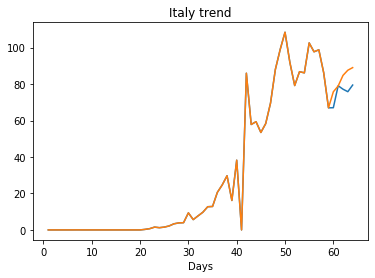

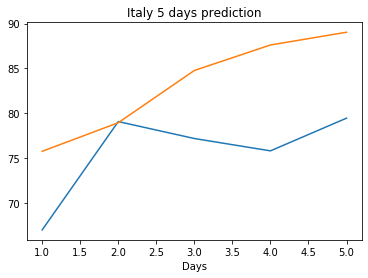

Creating directory ./offline8/Spain/training/
Spain
Saving the best model weights at Epoch [1], Best Valid Loss: 19797.3887
Saving the best model weights at Epoch [2], Best Valid Loss: 18374.2930
Saving the best model weights at Epoch [3], Best Valid Loss: 16499.1230
Saving the best model weights at Epoch [4], Best Valid Loss: 13011.3623
Saving the best model weights at Epoch [5], Best Valid Loss: 11512.3428
Saving the best model weights at Epoch [7], Best Valid Loss: 11418.8262
Saving the best model weights at Epoch [50], Best Valid Loss: 11282.7236
train error: 3258.2574596266663
11282.7236328125
Saving the best model weights at Epoch [1], Best Valid Loss: 19505.0918
Saving the best model weights at Epoch [2], Best Valid Loss: 17524.6797
Saving the best model weights at Epoch [5], Best Valid Loss: 16777.1406
Saving the best model weights at Epoch [13], Best Valid Loss: 16448.3555
Saving the best model weights at Epoch [15], Best Valid Loss: 15621.6299
train error: 4369.82011958531
15

Saving the best model weights at Epoch [5], Best Valid Loss: 12212.8408
Saving the best model weights at Epoch [6], Best Valid Loss: 3719.2251
train error: 3872.016056878226
3719.22509765625
Saving the best model weights at Epoch [1], Best Valid Loss: 26693.1934
train error: 5954.9984031915665
26693.193359375
Saving the best model weights at Epoch [1], Best Valid Loss: 27141.4688
train error: 5954.9984031915665
27141.46875
Saving the best model weights at Epoch [1], Best Valid Loss: 26485.3477
Saving the best model weights at Epoch [2], Best Valid Loss: 16242.8506
Saving the best model weights at Epoch [3], Best Valid Loss: 8181.8594
train error: 4011.591039589473
8181.859375
Saving the best model weights at Epoch [1], Best Valid Loss: 12920.6396
train error: 5954.9984031915665
12920.6396484375
Saving the best model weights at Epoch [1], Best Valid Loss: 27141.4688
train error: 5954.9984031915665
27141.46875
Saving the best model weights at Epoch [1], Best Valid Loss: 11891.0361
Saving

Saving the best model weights at Epoch [4], Best Valid Loss: 16119.9287
Saving the best model weights at Epoch [10], Best Valid Loss: 15107.9844
Saving the best model weights at Epoch [11], Best Valid Loss: 14007.2910
Saving the best model weights at Epoch [12], Best Valid Loss: 13223.3906
Saving the best model weights at Epoch [21], Best Valid Loss: 8995.3145
Saving the best model weights at Epoch [39], Best Valid Loss: 8852.2090
train error: 2412.1385553053447
8852.208984375
Saving the best model weights at Epoch [1], Best Valid Loss: 24773.2109
Saving the best model weights at Epoch [2], Best Valid Loss: 15831.7031
Saving the best model weights at Epoch [5], Best Valid Loss: 15469.8906
Saving the best model weights at Epoch [7], Best Valid Loss: 11501.6865
Saving the best model weights at Epoch [8], Best Valid Loss: 9852.6143
train error: 1361.2594339954
9852.6142578125
Saving the best model weights at Epoch [1], Best Valid Loss: 15594.1406
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [2], Best Valid Loss: 17812.9961
Saving the best model weights at Epoch [6], Best Valid Loss: 13272.3877
train error: 5954.9984031915665
13272.3876953125
Saving the best model weights at Epoch [1], Best Valid Loss: 24172.5977
Saving the best model weights at Epoch [2], Best Valid Loss: 19635.6465
Saving the best model weights at Epoch [3], Best Valid Loss: 15218.9785
Saving the best model weights at Epoch [6], Best Valid Loss: 14945.3877
Saving the best model weights at Epoch [7], Best Valid Loss: 13840.3662
Saving the best model weights at Epoch [9], Best Valid Loss: 13479.3037
Saving the best model weights at Epoch [11], Best Valid Loss: 13016.9316
Saving the best model weights at Epoch [12], Best Valid Loss: 13016.5146
Saving the best model weights at Epoch [13], Best Valid Loss: 12971.9404
Saving the best model weights at Epoch [14], Best Valid Loss: 12957.4277
Saving the best model weights at Epoch [17], Best Valid Loss: 12814.9131
train erro

Saving the best model weights at Epoch [1], Best Valid Loss: 26504.7695
Saving the best model weights at Epoch [2], Best Valid Loss: 15114.3848
Saving the best model weights at Epoch [3], Best Valid Loss: 4661.3853
train error: 5954.9984031915665
4661.38525390625
Saving the best model weights at Epoch [1], Best Valid Loss: 25992.8848
Saving the best model weights at Epoch [2], Best Valid Loss: 23658.3203
Saving the best model weights at Epoch [3], Best Valid Loss: 21658.6445
Saving the best model weights at Epoch [4], Best Valid Loss: 20391.9160
Saving the best model weights at Epoch [5], Best Valid Loss: 19599.3105
Saving the best model weights at Epoch [7], Best Valid Loss: 19324.2793
Saving the best model weights at Epoch [8], Best Valid Loss: 19136.9629
Saving the best model weights at Epoch [19], Best Valid Loss: 19071.3574
Saving the best model weights at Epoch [21], Best Valid Loss: 17668.1289
Saving the best model weights at Epoch [22], Best Valid Loss: 14965.4688
Saving the be

Saving the best model weights at Epoch [40], Best Valid Loss: 12137.5547
train error: 3539.0315494537354
12137.5546875
Saving the best model weights at Epoch [1], Best Valid Loss: 26037.4277
Saving the best model weights at Epoch [2], Best Valid Loss: 23538.2539
Saving the best model weights at Epoch [3], Best Valid Loss: 22094.8457
Saving the best model weights at Epoch [4], Best Valid Loss: 21753.4648
Saving the best model weights at Epoch [5], Best Valid Loss: 21349.1680
Saving the best model weights at Epoch [6], Best Valid Loss: 21214.5020
Saving the best model weights at Epoch [7], Best Valid Loss: 21071.9102
Saving the best model weights at Epoch [8], Best Valid Loss: 20911.6582
Saving the best model weights at Epoch [13], Best Valid Loss: 20874.6660
Saving the best model weights at Epoch [14], Best Valid Loss: 19951.7324
Saving the best model weights at Epoch [15], Best Valid Loss: 17671.0156
Saving the best model weights at Epoch [16], Best Valid Loss: 16264.2578
Saving the be

Saving the best model weights at Epoch [10], Best Valid Loss: 24655.4492
Saving the best model weights at Epoch [13], Best Valid Loss: 24605.4785
Saving the best model weights at Epoch [29], Best Valid Loss: 24592.0762
train error: 5680.804933820452
24592.076171875
Saving the best model weights at Epoch [1], Best Valid Loss: 16591.4922
Saving the best model weights at Epoch [6], Best Valid Loss: 13840.3281
Saving the best model weights at Epoch [20], Best Valid Loss: 11059.4453
Saving the best model weights at Epoch [28], Best Valid Loss: 10995.6016
Saving the best model weights at Epoch [31], Best Valid Loss: 10570.0645
Saving the best model weights at Epoch [33], Best Valid Loss: 8792.7197
train error: 3652.5034468514577
8792.7197265625
Saving the best model weights at Epoch [1], Best Valid Loss: 23624.0996
Saving the best model weights at Epoch [2], Best Valid Loss: 17823.4668
Saving the best model weights at Epoch [3], Best Valid Loss: 13549.6592
Saving the best model weights at Ep

Saving the best model weights at Epoch [7], Best Valid Loss: 20910.4727
Saving the best model weights at Epoch [9], Best Valid Loss: 19884.8730
Saving the best model weights at Epoch [11], Best Valid Loss: 18280.2324
Saving the best model weights at Epoch [12], Best Valid Loss: 17205.8340
Saving the best model weights at Epoch [13], Best Valid Loss: 16293.4189
Saving the best model weights at Epoch [14], Best Valid Loss: 15432.6484
Saving the best model weights at Epoch [15], Best Valid Loss: 14833.2393
Saving the best model weights at Epoch [16], Best Valid Loss: 14351.4561
Saving the best model weights at Epoch [27], Best Valid Loss: 14117.0176
Saving the best model weights at Epoch [28], Best Valid Loss: 13596.3779
Saving the best model weights at Epoch [29], Best Valid Loss: 13144.7344
Saving the best model weights at Epoch [30], Best Valid Loss: 12612.0107
Saving the best model weights at Epoch [31], Best Valid Loss: 12182.3604
Saving the best model weights at Epoch [32], Best Val

Saving the best model weights at Epoch [5], Best Valid Loss: 17524.4785
Saving the best model weights at Epoch [6], Best Valid Loss: 16847.0508
Saving the best model weights at Epoch [7], Best Valid Loss: 16406.3262
Saving the best model weights at Epoch [10], Best Valid Loss: 15743.1191
Saving the best model weights at Epoch [11], Best Valid Loss: 15368.6514
Saving the best model weights at Epoch [13], Best Valid Loss: 15061.6475
Saving the best model weights at Epoch [18], Best Valid Loss: 14340.7803
Saving the best model weights at Epoch [22], Best Valid Loss: 13899.6953
Saving the best model weights at Epoch [24], Best Valid Loss: 13278.8975
Saving the best model weights at Epoch [25], Best Valid Loss: 12841.7139
Saving the best model weights at Epoch [36], Best Valid Loss: 12472.2490
Saving the best model weights at Epoch [37], Best Valid Loss: 12093.2344
Saving the best model weights at Epoch [38], Best Valid Loss: 11712.9463
train error: 1873.080288408058
11712.9462890625
Saving

Saving the best model weights at Epoch [19], Best Valid Loss: 20175.9863
Saving the best model weights at Epoch [20], Best Valid Loss: 19908.5918
Saving the best model weights at Epoch [21], Best Valid Loss: 19694.5312
Saving the best model weights at Epoch [22], Best Valid Loss: 19371.1465
Saving the best model weights at Epoch [23], Best Valid Loss: 18960.4922
Saving the best model weights at Epoch [24], Best Valid Loss: 18693.9805
Saving the best model weights at Epoch [30], Best Valid Loss: 18686.2871
Saving the best model weights at Epoch [31], Best Valid Loss: 18337.7656
Saving the best model weights at Epoch [32], Best Valid Loss: 17863.0898
Saving the best model weights at Epoch [33], Best Valid Loss: 17697.2695
Saving the best model weights at Epoch [39], Best Valid Loss: 17520.9883
Saving the best model weights at Epoch [40], Best Valid Loss: 17164.4492
Saving the best model weights at Epoch [45], Best Valid Loss: 17133.8965
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 12512.5518
Saving the best model weights at Epoch [33], Best Valid Loss: 11007.4854
Saving the best model weights at Epoch [35], Best Valid Loss: 9459.8887
train error: 2317.6289257077233
9459.888671875
Saving the best model weights at Epoch [1], Best Valid Loss: 26849.0879
Saving the best model weights at Epoch [2], Best Valid Loss: 24578.8301
Saving the best model weights at Epoch [4], Best Valid Loss: 23673.2676
Saving the best model weights at Epoch [5], Best Valid Loss: 22866.6660
Saving the best model weights at Epoch [6], Best Valid Loss: 20461.4121
Saving the best model weights at Epoch [7], Best Valid Loss: 19164.5527
Saving the best model weights at Epoch [9], Best Valid Loss: 18911.6816
Saving the best model weights at Epoch [11], Best Valid Loss: 16058.8857
Saving the best model weights at Epoch [16], Best Valid Loss: 15942.6201
Saving the best model weights at Epoch [19], Best Valid Loss: 15157.5654
Saving the b

Saving the best model weights at Epoch [28], Best Valid Loss: 10722.7910
Saving the best model weights at Epoch [29], Best Valid Loss: 10605.5332
Saving the best model weights at Epoch [30], Best Valid Loss: 10327.5225
Saving the best model weights at Epoch [31], Best Valid Loss: 8902.0020
Saving the best model weights at Epoch [32], Best Valid Loss: 8115.1704
Saving the best model weights at Epoch [35], Best Valid Loss: 7627.5596
Saving the best model weights at Epoch [36], Best Valid Loss: 7193.3159
Saving the best model weights at Epoch [41], Best Valid Loss: 7058.2886
Saving the best model weights at Epoch [42], Best Valid Loss: 5911.2056
Saving the best model weights at Epoch [48], Best Valid Loss: 4601.1362
Saving the best model weights at Epoch [49], Best Valid Loss: 4309.0322
train error: 1949.5679478645325
4309.0322265625
Saving the best model weights at Epoch [1], Best Valid Loss: 26995.7812
Saving the best model weights at Epoch [2], Best Valid Loss: 26854.6094
Saving the be

Saving the best model weights at Epoch [22], Best Valid Loss: 17478.2637
Saving the best model weights at Epoch [23], Best Valid Loss: 16512.9355
Saving the best model weights at Epoch [24], Best Valid Loss: 15899.4248
Saving the best model weights at Epoch [25], Best Valid Loss: 15675.1787
Saving the best model weights at Epoch [26], Best Valid Loss: 15312.7061
Saving the best model weights at Epoch [28], Best Valid Loss: 14575.1611
Saving the best model weights at Epoch [30], Best Valid Loss: 14010.6553
Saving the best model weights at Epoch [37], Best Valid Loss: 13870.5693
Saving the best model weights at Epoch [44], Best Valid Loss: 13354.1592
Saving the best model weights at Epoch [49], Best Valid Loss: 13038.1562
Saving the best model weights at Epoch [50], Best Valid Loss: 12571.5107
train error: 2912.9261922495707
12571.5107421875
Saving the best model weights at Epoch [1], Best Valid Loss: 26965.1875
Saving the best model weights at Epoch [2], Best Valid Loss: 26779.1074
Savi

Saving the best model weights at Epoch [40], Best Valid Loss: 10232.6348
Saving the best model weights at Epoch [41], Best Valid Loss: 9511.5068
train error: 3982.893687520708
9511.5068359375
Saving the best model weights at Epoch [1], Best Valid Loss: 26333.8633
Saving the best model weights at Epoch [2], Best Valid Loss: 15986.1064
Saving the best model weights at Epoch [4], Best Valid Loss: 14562.5332
Saving the best model weights at Epoch [6], Best Valid Loss: 13695.9551
Saving the best model weights at Epoch [7], Best Valid Loss: 13635.6748
Saving the best model weights at Epoch [8], Best Valid Loss: 13052.4814
Saving the best model weights at Epoch [10], Best Valid Loss: 8651.8506
train error: 3653.6266446794784
8651.8505859375
Saving the best model weights at Epoch [1], Best Valid Loss: 27033.8379
Saving the best model weights at Epoch [2], Best Valid Loss: 26943.6660
Saving the best model weights at Epoch [3], Best Valid Loss: 26852.8008
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [3], Best Valid Loss: 27022.8887
Saving the best model weights at Epoch [4], Best Valid Loss: 26986.4004
Saving the best model weights at Epoch [5], Best Valid Loss: 26948.2871
Saving the best model weights at Epoch [6], Best Valid Loss: 26909.6152
Saving the best model weights at Epoch [7], Best Valid Loss: 26869.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 26778.6758
Saving the best model weights at Epoch [9], Best Valid Loss: 26636.4590
Saving the best model weights at Epoch [10], Best Valid Loss: 26423.6406
Saving the best model weights at Epoch [11], Best Valid Loss: 26148.8047
Saving the best model weights at Epoch [12], Best Valid Loss: 25798.4375
Saving the best model weights at Epoch [13], Best Valid Loss: 25345.9688
Saving the best model weights at Epoch [14], Best Valid Loss: 24788.8379
Saving the best model weights at Epoch [15], Best Valid Loss: 24150.3340
Saving the best model weights at Epoch [16], Best Valid Lo

Saving the best model weights at Epoch [3], Best Valid Loss: 18582.2500
Saving the best model weights at Epoch [4], Best Valid Loss: 18180.0449
Saving the best model weights at Epoch [10], Best Valid Loss: 18114.7695
Saving the best model weights at Epoch [14], Best Valid Loss: 17894.4355
Saving the best model weights at Epoch [21], Best Valid Loss: 17520.1289
train error: 4365.588227408273
17520.12890625
Saving the best model weights at Epoch [1], Best Valid Loss: 27006.3633
Saving the best model weights at Epoch [2], Best Valid Loss: 26874.9102
Saving the best model weights at Epoch [3], Best Valid Loss: 26729.6543
Saving the best model weights at Epoch [4], Best Valid Loss: 26561.1230
Saving the best model weights at Epoch [5], Best Valid Loss: 26348.9355
Saving the best model weights at Epoch [6], Best Valid Loss: 26060.1230
Saving the best model weights at Epoch [7], Best Valid Loss: 25669.3027
Saving the best model weights at Epoch [8], Best Valid Loss: 25117.0000
Saving the best

Saving the best model weights at Epoch [14], Best Valid Loss: 23291.8691
Saving the best model weights at Epoch [15], Best Valid Loss: 23106.1465
Saving the best model weights at Epoch [16], Best Valid Loss: 22861.2500
Saving the best model weights at Epoch [17], Best Valid Loss: 22723.3535
Saving the best model weights at Epoch [18], Best Valid Loss: 22550.3906
Saving the best model weights at Epoch [19], Best Valid Loss: 22466.5879
Saving the best model weights at Epoch [20], Best Valid Loss: 22324.2324
Saving the best model weights at Epoch [21], Best Valid Loss: 22230.5820
Saving the best model weights at Epoch [22], Best Valid Loss: 22182.4785
Saving the best model weights at Epoch [23], Best Valid Loss: 22104.3945
Saving the best model weights at Epoch [24], Best Valid Loss: 22054.2051
Saving the best model weights at Epoch [25], Best Valid Loss: 22021.4258
Saving the best model weights at Epoch [26], Best Valid Loss: 21961.7617
Saving the best model weights at Epoch [27], Best V

Saving the best model weights at Epoch [2], Best Valid Loss: 26979.9590
Saving the best model weights at Epoch [3], Best Valid Loss: 26867.9570
Saving the best model weights at Epoch [4], Best Valid Loss: 26737.7070
Saving the best model weights at Epoch [5], Best Valid Loss: 26593.3848
Saving the best model weights at Epoch [6], Best Valid Loss: 26422.3438
Saving the best model weights at Epoch [7], Best Valid Loss: 26217.5410
Saving the best model weights at Epoch [8], Best Valid Loss: 25961.8672
Saving the best model weights at Epoch [9], Best Valid Loss: 25628.3867
Saving the best model weights at Epoch [10], Best Valid Loss: 25209.0117
Saving the best model weights at Epoch [11], Best Valid Loss: 24680.1504
Saving the best model weights at Epoch [12], Best Valid Loss: 24050.9883
Saving the best model weights at Epoch [13], Best Valid Loss: 23329.9727
Saving the best model weights at Epoch [14], Best Valid Loss: 22615.2832
Saving the best model weights at Epoch [15], Best Valid Los

Saving the best model weights at Epoch [3], Best Valid Loss: 26006.0039
Saving the best model weights at Epoch [4], Best Valid Loss: 23851.5078
Saving the best model weights at Epoch [5], Best Valid Loss: 22393.9570
Saving the best model weights at Epoch [7], Best Valid Loss: 21706.9922
Saving the best model weights at Epoch [32], Best Valid Loss: 21593.4473
Saving the best model weights at Epoch [33], Best Valid Loss: 20703.9805
Saving the best model weights at Epoch [34], Best Valid Loss: 17604.7676
train error: 4454.589214869908
17604.767578125
Saving the best model weights at Epoch [1], Best Valid Loss: 27044.1445
Saving the best model weights at Epoch [2], Best Valid Loss: 26991.2812
Saving the best model weights at Epoch [3], Best Valid Loss: 26900.3184
Saving the best model weights at Epoch [4], Best Valid Loss: 26805.3496
Saving the best model weights at Epoch [5], Best Valid Loss: 26705.3066
Saving the best model weights at Epoch [6], Best Valid Loss: 26613.7715
Saving the bes

Saving the best model weights at Epoch [5], Best Valid Loss: 24987.6348
Saving the best model weights at Epoch [6], Best Valid Loss: 24394.0469
Saving the best model weights at Epoch [7], Best Valid Loss: 23892.6836
Saving the best model weights at Epoch [8], Best Valid Loss: 23403.2676
Saving the best model weights at Epoch [9], Best Valid Loss: 22880.7188
Saving the best model weights at Epoch [10], Best Valid Loss: 22522.0508
Saving the best model weights at Epoch [11], Best Valid Loss: 22147.6953
Saving the best model weights at Epoch [12], Best Valid Loss: 21667.3008
Saving the best model weights at Epoch [13], Best Valid Loss: 21336.4434
Saving the best model weights at Epoch [14], Best Valid Loss: 20934.6289
Saving the best model weights at Epoch [15], Best Valid Loss: 20543.0078
Saving the best model weights at Epoch [16], Best Valid Loss: 20236.9414
Saving the best model weights at Epoch [17], Best Valid Loss: 19903.0996
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [24], Best Valid Loss: 19553.3047
Saving the best model weights at Epoch [25], Best Valid Loss: 19272.7129
Saving the best model weights at Epoch [26], Best Valid Loss: 19008.0918
Saving the best model weights at Epoch [27], Best Valid Loss: 18744.7402
Saving the best model weights at Epoch [28], Best Valid Loss: 18471.4121
Saving the best model weights at Epoch [29], Best Valid Loss: 18236.5957
Saving the best model weights at Epoch [30], Best Valid Loss: 17980.6094
Saving the best model weights at Epoch [31], Best Valid Loss: 17745.8574
Saving the best model weights at Epoch [32], Best Valid Loss: 17499.4004
Saving the best model weights at Epoch [33], Best Valid Loss: 17257.7930
Saving the best model weights at Epoch [34], Best Valid Loss: 17035.5684
Saving the best model weights at Epoch [35], Best Valid Loss: 16808.1230
Saving the best model weights at Epoch [36], Best Valid Loss: 16588.7031
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [12], Best Valid Loss: 21566.4434
Saving the best model weights at Epoch [13], Best Valid Loss: 21138.3730
Saving the best model weights at Epoch [14], Best Valid Loss: 20734.8555
Saving the best model weights at Epoch [15], Best Valid Loss: 20296.4512
Saving the best model weights at Epoch [16], Best Valid Loss: 19892.1230
Saving the best model weights at Epoch [17], Best Valid Loss: 19486.5957
Saving the best model weights at Epoch [18], Best Valid Loss: 19066.2070
Saving the best model weights at Epoch [19], Best Valid Loss: 18661.6602
Saving the best model weights at Epoch [20], Best Valid Loss: 18294.5781
Saving the best model weights at Epoch [21], Best Valid Loss: 17921.6094
Saving the best model weights at Epoch [22], Best Valid Loss: 17543.8945
Saving the best model weights at Epoch [23], Best Valid Loss: 17169.2969
Saving the best model weights at Epoch [24], Best Valid Loss: 16812.2871
Saving the best model weights at Epoch [25], Best V

Saving the best model weights at Epoch [10], Best Valid Loss: 18283.7207
Saving the best model weights at Epoch [11], Best Valid Loss: 17538.2637
Saving the best model weights at Epoch [12], Best Valid Loss: 16832.1855
Saving the best model weights at Epoch [13], Best Valid Loss: 16169.2451
Saving the best model weights at Epoch [14], Best Valid Loss: 15500.9893
Saving the best model weights at Epoch [15], Best Valid Loss: 14927.7285
Saving the best model weights at Epoch [16], Best Valid Loss: 14376.9688
Saving the best model weights at Epoch [17], Best Valid Loss: 13870.2129
Saving the best model weights at Epoch [18], Best Valid Loss: 13382.8613
Saving the best model weights at Epoch [19], Best Valid Loss: 12920.0107
Saving the best model weights at Epoch [20], Best Valid Loss: 12479.5107
Saving the best model weights at Epoch [21], Best Valid Loss: 12068.9736
Saving the best model weights at Epoch [22], Best Valid Loss: 11660.9014
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [17], Best Valid Loss: 27003.0215
Saving the best model weights at Epoch [18], Best Valid Loss: 26995.5996
Saving the best model weights at Epoch [19], Best Valid Loss: 26988.4004
Saving the best model weights at Epoch [20], Best Valid Loss: 26980.7598
Saving the best model weights at Epoch [21], Best Valid Loss: 26973.1035
Saving the best model weights at Epoch [22], Best Valid Loss: 26965.6074
Saving the best model weights at Epoch [23], Best Valid Loss: 26957.8750
Saving the best model weights at Epoch [24], Best Valid Loss: 26950.1621
Saving the best model weights at Epoch [25], Best Valid Loss: 26942.2188
Saving the best model weights at Epoch [26], Best Valid Loss: 26933.0840
Saving the best model weights at Epoch [27], Best Valid Loss: 26925.1562
Saving the best model weights at Epoch [28], Best Valid Loss: 26916.5215
Saving the best model weights at Epoch [29], Best Valid Loss: 26899.1133
Saving the best model weights at Epoch [30], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 22927.6777
Saving the best model weights at Epoch [44], Best Valid Loss: 22710.1758
Saving the best model weights at Epoch [45], Best Valid Loss: 22492.2969
Saving the best model weights at Epoch [46], Best Valid Loss: 22274.5312
Saving the best model weights at Epoch [47], Best Valid Loss: 22058.4590
Saving the best model weights at Epoch [48], Best Valid Loss: 21841.8164
Saving the best model weights at Epoch [49], Best Valid Loss: 21624.1406
Saving the best model weights at Epoch [50], Best Valid Loss: 21409.3594
train error: 4353.757794550487
21409.359375
Saving the best model weights at Epoch [1], Best Valid Loss: 27107.1621
Saving the best model weights at Epoch [2], Best Valid Loss: 27083.2012
Saving the best model weights at Epoch [3], Best Valid Loss: 27060.0762
Saving the best model weights at Epoch [4], Best Valid Loss: 27035.7812
Saving the best model weights at Epoch [5], Best Valid Loss: 27007.6973
Saving the b

Saving the best model weights at Epoch [33], Best Valid Loss: 24048.0254
Saving the best model weights at Epoch [34], Best Valid Loss: 23811.1602
Saving the best model weights at Epoch [35], Best Valid Loss: 23571.5605
Saving the best model weights at Epoch [36], Best Valid Loss: 23320.1387
Saving the best model weights at Epoch [37], Best Valid Loss: 23071.5625
Saving the best model weights at Epoch [38], Best Valid Loss: 22818.6816
Saving the best model weights at Epoch [39], Best Valid Loss: 22565.9648
Saving the best model weights at Epoch [40], Best Valid Loss: 22316.2109
Saving the best model weights at Epoch [41], Best Valid Loss: 22067.5215
Saving the best model weights at Epoch [42], Best Valid Loss: 21822.6250
Saving the best model weights at Epoch [43], Best Valid Loss: 21576.0195
Saving the best model weights at Epoch [44], Best Valid Loss: 21334.7441
Saving the best model weights at Epoch [45], Best Valid Loss: 21096.5176
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 20235.2090
Saving the best model weights at Epoch [31], Best Valid Loss: 19817.7109
Saving the best model weights at Epoch [32], Best Valid Loss: 19418.4219
Saving the best model weights at Epoch [33], Best Valid Loss: 19019.5625
Saving the best model weights at Epoch [34], Best Valid Loss: 18647.5742
Saving the best model weights at Epoch [35], Best Valid Loss: 18276.0430
Saving the best model weights at Epoch [36], Best Valid Loss: 17931.4043
Saving the best model weights at Epoch [37], Best Valid Loss: 17588.3652
Saving the best model weights at Epoch [38], Best Valid Loss: 17265.1777
Saving the best model weights at Epoch [39], Best Valid Loss: 16948.4570
Saving the best model weights at Epoch [40], Best Valid Loss: 16642.2871
Saving the best model weights at Epoch [41], Best Valid Loss: 16346.3535
Saving the best model weights at Epoch [42], Best Valid Loss: 16057.9688
Saving the best model weights at Epoch [43], Best V

Saving the best model weights at Epoch [40], Best Valid Loss: 26767.8496
Saving the best model weights at Epoch [41], Best Valid Loss: 26758.1348
Saving the best model weights at Epoch [42], Best Valid Loss: 26748.3633
Saving the best model weights at Epoch [43], Best Valid Loss: 26738.4199
Saving the best model weights at Epoch [44], Best Valid Loss: 26728.2441
Saving the best model weights at Epoch [45], Best Valid Loss: 26718.1465
Saving the best model weights at Epoch [46], Best Valid Loss: 26707.9219
Saving the best model weights at Epoch [47], Best Valid Loss: 26697.5820
Saving the best model weights at Epoch [48], Best Valid Loss: 26687.2910
Saving the best model weights at Epoch [49], Best Valid Loss: 26676.7012
Saving the best model weights at Epoch [50], Best Valid Loss: 26666.1133
train error: 5824.012191534042
26666.11328125
Saving the best model weights at Epoch [1], Best Valid Loss: 27055.9785
Saving the best model weights at Epoch [2], Best Valid Loss: 27016.8223
Saving 

Saving the best model weights at Epoch [3], Best Valid Loss: 27120.5371
Saving the best model weights at Epoch [4], Best Valid Loss: 27114.9941
Saving the best model weights at Epoch [5], Best Valid Loss: 27109.4199
Saving the best model weights at Epoch [6], Best Valid Loss: 27103.9199
Saving the best model weights at Epoch [7], Best Valid Loss: 27098.3066
Saving the best model weights at Epoch [8], Best Valid Loss: 27092.7383
Saving the best model weights at Epoch [9], Best Valid Loss: 27087.2324
Saving the best model weights at Epoch [10], Best Valid Loss: 27081.5996
Saving the best model weights at Epoch [11], Best Valid Loss: 27076.0195
Saving the best model weights at Epoch [12], Best Valid Loss: 27070.4316
Saving the best model weights at Epoch [13], Best Valid Loss: 27064.8379
Saving the best model weights at Epoch [14], Best Valid Loss: 27059.2285
Saving the best model weights at Epoch [15], Best Valid Loss: 27053.6562
Saving the best model weights at Epoch [16], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 20981.1953
Saving the best model weights at Epoch [16], Best Valid Loss: 20396.9062
Saving the best model weights at Epoch [17], Best Valid Loss: 19861.3320
Saving the best model weights at Epoch [18], Best Valid Loss: 19403.9258
Saving the best model weights at Epoch [19], Best Valid Loss: 18787.2383
Saving the best model weights at Epoch [20], Best Valid Loss: 18767.0488
Saving the best model weights at Epoch [21], Best Valid Loss: 17833.8496
Saving the best model weights at Epoch [22], Best Valid Loss: 17564.0605
Saving the best model weights at Epoch [23], Best Valid Loss: 17243.8164
Saving the best model weights at Epoch [24], Best Valid Loss: 17007.9590
Saving the best model weights at Epoch [25], Best Valid Loss: 16604.1465
Saving the best model weights at Epoch [27], Best Valid Loss: 16451.8027
Saving the best model weights at Epoch [30], Best Valid Loss: 15891.8906
Saving the best model weights at Epoch [33], Best V

Saving the best model weights at Epoch [48], Best Valid Loss: 21097.5703
Saving the best model weights at Epoch [49], Best Valid Loss: 20536.5762
Saving the best model weights at Epoch [50], Best Valid Loss: 19935.2402
train error: 4120.750248772757
19935.240234375
Saving the best model weights at Epoch [1], Best Valid Loss: 27043.9160
Saving the best model weights at Epoch [2], Best Valid Loss: 26874.4199
Saving the best model weights at Epoch [3], Best Valid Loss: 26718.5059
Saving the best model weights at Epoch [4], Best Valid Loss: 26550.6816
Saving the best model weights at Epoch [5], Best Valid Loss: 26337.6074
Saving the best model weights at Epoch [6], Best Valid Loss: 26103.7910
Saving the best model weights at Epoch [7], Best Valid Loss: 25691.8496
Saving the best model weights at Epoch [8], Best Valid Loss: 25201.6543
Saving the best model weights at Epoch [9], Best Valid Loss: 24150.3438
Saving the best model weights at Epoch [10], Best Valid Loss: 22889.0918
Saving the be

Saving the best model weights at Epoch [42], Best Valid Loss: 26138.2266
Saving the best model weights at Epoch [43], Best Valid Loss: 26062.8828
Saving the best model weights at Epoch [44], Best Valid Loss: 25981.3574
Saving the best model weights at Epoch [45], Best Valid Loss: 25895.0059
Saving the best model weights at Epoch [46], Best Valid Loss: 25794.4277
Saving the best model weights at Epoch [47], Best Valid Loss: 25671.7188
Saving the best model weights at Epoch [48], Best Valid Loss: 25541.4551
Saving the best model weights at Epoch [49], Best Valid Loss: 25395.0605
Saving the best model weights at Epoch [50], Best Valid Loss: 25237.3145
train error: 5568.0752157483785
25237.314453125
Saving the best model weights at Epoch [1], Best Valid Loss: 27044.5684
Saving the best model weights at Epoch [2], Best Valid Loss: 26929.6816
Saving the best model weights at Epoch [3], Best Valid Loss: 26797.5996
Saving the best model weights at Epoch [4], Best Valid Loss: 26634.4473
Saving 

Saving the best model weights at Epoch [35], Best Valid Loss: 25351.7168
Saving the best model weights at Epoch [36], Best Valid Loss: 25258.9219
Saving the best model weights at Epoch [37], Best Valid Loss: 25166.7129
Saving the best model weights at Epoch [38], Best Valid Loss: 25074.8887
Saving the best model weights at Epoch [39], Best Valid Loss: 24975.9531
Saving the best model weights at Epoch [40], Best Valid Loss: 24879.7051
Saving the best model weights at Epoch [41], Best Valid Loss: 24781.5137
Saving the best model weights at Epoch [42], Best Valid Loss: 24684.6719
Saving the best model weights at Epoch [43], Best Valid Loss: 24579.9668
Saving the best model weights at Epoch [44], Best Valid Loss: 24478.8223
Saving the best model weights at Epoch [45], Best Valid Loss: 24378.0137
Saving the best model weights at Epoch [46], Best Valid Loss: 24274.5156
Saving the best model weights at Epoch [47], Best Valid Loss: 24165.6230
Saving the best model weights at Epoch [48], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 26601.8008
Saving the best model weights at Epoch [50], Best Valid Loss: 26587.8340
train error: 5784.166813714163
26587.833984375
Saving the best model weights at Epoch [1], Best Valid Loss: 27100.7637
Saving the best model weights at Epoch [2], Best Valid Loss: 27077.2344
Saving the best model weights at Epoch [3], Best Valid Loss: 27056.3691
Saving the best model weights at Epoch [4], Best Valid Loss: 27033.4883
Saving the best model weights at Epoch [5], Best Valid Loss: 27010.5059
Saving the best model weights at Epoch [6], Best Valid Loss: 26987.0996
Saving the best model weights at Epoch [7], Best Valid Loss: 26965.8945
Saving the best model weights at Epoch [8], Best Valid Loss: 26942.6133
Saving the best model weights at Epoch [9], Best Valid Loss: 26918.5469
Saving the best model weights at Epoch [10], Best Valid Loss: 26895.4062
Saving the best model weights at Epoch [11], Best Valid Loss: 26872.2969
Saving the be

Saving the best model weights at Epoch [9], Best Valid Loss: 26967.5879
Saving the best model weights at Epoch [10], Best Valid Loss: 26949.5625
Saving the best model weights at Epoch [11], Best Valid Loss: 26931.5410
Saving the best model weights at Epoch [12], Best Valid Loss: 26913.1719
Saving the best model weights at Epoch [13], Best Valid Loss: 26894.0879
Saving the best model weights at Epoch [14], Best Valid Loss: 26876.2285
Saving the best model weights at Epoch [15], Best Valid Loss: 26856.2129
Saving the best model weights at Epoch [16], Best Valid Loss: 26837.6152
Saving the best model weights at Epoch [17], Best Valid Loss: 26817.1289
Saving the best model weights at Epoch [18], Best Valid Loss: 26797.0254
Saving the best model weights at Epoch [19], Best Valid Loss: 26774.0762
Saving the best model weights at Epoch [20], Best Valid Loss: 26745.7324
Saving the best model weights at Epoch [21], Best Valid Loss: 26714.6465
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [46], Best Valid Loss: 26277.0449
Saving the best model weights at Epoch [47], Best Valid Loss: 26242.8027
Saving the best model weights at Epoch [48], Best Valid Loss: 26207.2656
Saving the best model weights at Epoch [49], Best Valid Loss: 26170.9492
Saving the best model weights at Epoch [50], Best Valid Loss: 26132.8164
train error: 5659.131255643709
26132.81640625
Saving the best model weights at Epoch [1], Best Valid Loss: 27118.6387
Saving the best model weights at Epoch [2], Best Valid Loss: 27103.2754
Saving the best model weights at Epoch [3], Best Valid Loss: 27089.8105
Saving the best model weights at Epoch [4], Best Valid Loss: 27073.3379
Saving the best model weights at Epoch [5], Best Valid Loss: 27058.3809
Saving the best model weights at Epoch [6], Best Valid Loss: 27042.7949
Saving the best model weights at Epoch [7], Best Valid Loss: 27027.9160
Saving the best model weights at Epoch [8], Best Valid Loss: 27013.4785
Saving the be

Saving the best model weights at Epoch [31], Best Valid Loss: 26556.5059
Saving the best model weights at Epoch [32], Best Valid Loss: 26533.1562
Saving the best model weights at Epoch [33], Best Valid Loss: 26509.6934
Saving the best model weights at Epoch [34], Best Valid Loss: 26485.9980
Saving the best model weights at Epoch [35], Best Valid Loss: 26461.4902
Saving the best model weights at Epoch [36], Best Valid Loss: 26437.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 26411.7246
Saving the best model weights at Epoch [38], Best Valid Loss: 26385.7070
Saving the best model weights at Epoch [39], Best Valid Loss: 26359.4004
Saving the best model weights at Epoch [40], Best Valid Loss: 26332.6816
Saving the best model weights at Epoch [41], Best Valid Loss: 26305.5508
Saving the best model weights at Epoch [42], Best Valid Loss: 26277.5566
Saving the best model weights at Epoch [43], Best Valid Loss: 26248.7070
Saving the best model weights at Epoch [44], Best V

Saving the best model weights at Epoch [45], Best Valid Loss: 14036.3037
Saving the best model weights at Epoch [47], Best Valid Loss: 13903.2520
Saving the best model weights at Epoch [49], Best Valid Loss: 13818.7441
Saving the best model weights at Epoch [50], Best Valid Loss: 13800.0176
train error: 3414.507895878383
13800.017578125
Saving the best model weights at Epoch [1], Best Valid Loss: 27113.5195
Saving the best model weights at Epoch [2], Best Valid Loss: 27105.9941
Saving the best model weights at Epoch [3], Best Valid Loss: 27098.6191
Saving the best model weights at Epoch [4], Best Valid Loss: 27091.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 27083.5566
Saving the best model weights at Epoch [6], Best Valid Loss: 27076.0508
Saving the best model weights at Epoch [7], Best Valid Loss: 27068.6074
Saving the best model weights at Epoch [8], Best Valid Loss: 27061.1621
Saving the best model weights at Epoch [9], Best Valid Loss: 27053.6250
Saving the be

Saving the best model weights at Epoch [8], Best Valid Loss: 25756.0391
Saving the best model weights at Epoch [9], Best Valid Loss: 25316.8965
Saving the best model weights at Epoch [10], Best Valid Loss: 24749.7949
Saving the best model weights at Epoch [11], Best Valid Loss: 23994.8438
Saving the best model weights at Epoch [12], Best Valid Loss: 23155.9551
Saving the best model weights at Epoch [13], Best Valid Loss: 22152.8730
Saving the best model weights at Epoch [14], Best Valid Loss: 21063.0039
Saving the best model weights at Epoch [15], Best Valid Loss: 20346.8340
Saving the best model weights at Epoch [16], Best Valid Loss: 19423.8105
Saving the best model weights at Epoch [17], Best Valid Loss: 18571.8262
Saving the best model weights at Epoch [18], Best Valid Loss: 18049.8184
Saving the best model weights at Epoch [19], Best Valid Loss: 17546.6074
Saving the best model weights at Epoch [20], Best Valid Loss: 17295.4512
Saving the best model weights at Epoch [21], Best Val

Saving the best model weights at Epoch [38], Best Valid Loss: 26884.2871
Saving the best model weights at Epoch [39], Best Valid Loss: 26876.9199
Saving the best model weights at Epoch [40], Best Valid Loss: 26869.6758
Saving the best model weights at Epoch [41], Best Valid Loss: 26862.2695
Saving the best model weights at Epoch [42], Best Valid Loss: 26854.8809
Saving the best model weights at Epoch [43], Best Valid Loss: 26847.5137
Saving the best model weights at Epoch [44], Best Valid Loss: 26839.9824
Saving the best model weights at Epoch [45], Best Valid Loss: 26832.5918
Saving the best model weights at Epoch [46], Best Valid Loss: 26824.6699
Saving the best model weights at Epoch [47], Best Valid Loss: 26817.1191
Saving the best model weights at Epoch [48], Best Valid Loss: 26809.6621
Saving the best model weights at Epoch [49], Best Valid Loss: 26801.4531
Saving the best model weights at Epoch [50], Best Valid Loss: 26793.4062
train error: 5885.395197110517
26793.40625
Saving t

Saving the best model weights at Epoch [19], Best Valid Loss: 26463.9531
Saving the best model weights at Epoch [20], Best Valid Loss: 26420.7285
Saving the best model weights at Epoch [21], Best Valid Loss: 26369.3125
Saving the best model weights at Epoch [22], Best Valid Loss: 26321.9688
Saving the best model weights at Epoch [23], Best Valid Loss: 26264.7812
Saving the best model weights at Epoch [24], Best Valid Loss: 26211.2285
Saving the best model weights at Epoch [25], Best Valid Loss: 26146.1016
Saving the best model weights at Epoch [26], Best Valid Loss: 26080.4980
Saving the best model weights at Epoch [27], Best Valid Loss: 26012.2031
Saving the best model weights at Epoch [28], Best Valid Loss: 25937.6738
Saving the best model weights at Epoch [29], Best Valid Loss: 25861.5391
Saving the best model weights at Epoch [30], Best Valid Loss: 25774.6465
Saving the best model weights at Epoch [31], Best Valid Loss: 25682.1426
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [5], Best Valid Loss: 27115.7441
Saving the best model weights at Epoch [6], Best Valid Loss: 27112.9160
Saving the best model weights at Epoch [7], Best Valid Loss: 27110.0684
Saving the best model weights at Epoch [8], Best Valid Loss: 27107.4004
Saving the best model weights at Epoch [9], Best Valid Loss: 27104.8809
Saving the best model weights at Epoch [10], Best Valid Loss: 27102.3438
Saving the best model weights at Epoch [11], Best Valid Loss: 27099.9375
Saving the best model weights at Epoch [12], Best Valid Loss: 27097.4004
Saving the best model weights at Epoch [13], Best Valid Loss: 27094.9629
Saving the best model weights at Epoch [14], Best Valid Loss: 27092.5195
Saving the best model weights at Epoch [15], Best Valid Loss: 27090.0293
Saving the best model weights at Epoch [16], Best Valid Loss: 27087.5137
Saving the best model weights at Epoch [17], Best Valid Loss: 27085.0762
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [17], Best Valid Loss: 27031.4277
Saving the best model weights at Epoch [18], Best Valid Loss: 27023.4219
Saving the best model weights at Epoch [19], Best Valid Loss: 27013.6504
Saving the best model weights at Epoch [20], Best Valid Loss: 27001.3652
Saving the best model weights at Epoch [21], Best Valid Loss: 26989.6934
Saving the best model weights at Epoch [22], Best Valid Loss: 26981.6406
Saving the best model weights at Epoch [23], Best Valid Loss: 26974.3945
Saving the best model weights at Epoch [24], Best Valid Loss: 26967.2812
Saving the best model weights at Epoch [25], Best Valid Loss: 26960.1699
Saving the best model weights at Epoch [26], Best Valid Loss: 26952.9512
Saving the best model weights at Epoch [27], Best Valid Loss: 26944.7324
Saving the best model weights at Epoch [28], Best Valid Loss: 26929.9121
Saving the best model weights at Epoch [29], Best Valid Loss: 26920.6191
Saving the best model weights at Epoch [30], Best V

Saving the best model weights at Epoch [29], Best Valid Loss: 24761.4727
Saving the best model weights at Epoch [30], Best Valid Loss: 24665.0371
Saving the best model weights at Epoch [31], Best Valid Loss: 24542.8008
Saving the best model weights at Epoch [32], Best Valid Loss: 24435.8359
Saving the best model weights at Epoch [33], Best Valid Loss: 24338.3652
Saving the best model weights at Epoch [34], Best Valid Loss: 24246.0312
Saving the best model weights at Epoch [35], Best Valid Loss: 24153.7480
Saving the best model weights at Epoch [36], Best Valid Loss: 24055.9492
Saving the best model weights at Epoch [37], Best Valid Loss: 23957.0527
Saving the best model weights at Epoch [38], Best Valid Loss: 23867.7129
Saving the best model weights at Epoch [39], Best Valid Loss: 23780.5703
Saving the best model weights at Epoch [40], Best Valid Loss: 23681.9844
Saving the best model weights at Epoch [41], Best Valid Loss: 23584.8750
Saving the best model weights at Epoch [42], Best V

Saving the best model weights at Epoch [41], Best Valid Loss: 25661.9707
Saving the best model weights at Epoch [42], Best Valid Loss: 25606.5039
Saving the best model weights at Epoch [43], Best Valid Loss: 25542.4355
Saving the best model weights at Epoch [44], Best Valid Loss: 25490.1465
Saving the best model weights at Epoch [45], Best Valid Loss: 25435.7676
Saving the best model weights at Epoch [46], Best Valid Loss: 25393.5918
Saving the best model weights at Epoch [47], Best Valid Loss: 25338.4590
Saving the best model weights at Epoch [48], Best Valid Loss: 25278.1387
Saving the best model weights at Epoch [49], Best Valid Loss: 25214.4434
Saving the best model weights at Epoch [50], Best Valid Loss: 25159.6387
train error: 5375.878388741919
25159.638671875
Saving the best model weights at Epoch [1], Best Valid Loss: 27000.4512
Saving the best model weights at Epoch [2], Best Valid Loss: 26906.3066
Saving the best model weights at Epoch [3], Best Valid Loss: 26782.2324
Saving 

Saving the best model weights at Epoch [2], Best Valid Loss: 27050.6250
Saving the best model weights at Epoch [3], Best Valid Loss: 27008.8262
Saving the best model weights at Epoch [4], Best Valid Loss: 26961.3477
Saving the best model weights at Epoch [5], Best Valid Loss: 26913.0996
Saving the best model weights at Epoch [6], Best Valid Loss: 26870.1699
Saving the best model weights at Epoch [7], Best Valid Loss: 26830.5098
Saving the best model weights at Epoch [8], Best Valid Loss: 26789.2754
Saving the best model weights at Epoch [9], Best Valid Loss: 26742.4043
Saving the best model weights at Epoch [10], Best Valid Loss: 26691.9629
Saving the best model weights at Epoch [11], Best Valid Loss: 26619.0938
Saving the best model weights at Epoch [12], Best Valid Loss: 26555.7949
Saving the best model weights at Epoch [13], Best Valid Loss: 26487.5059
Saving the best model weights at Epoch [14], Best Valid Loss: 26420.5762
Saving the best model weights at Epoch [15], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 27115.4258
Saving the best model weights at Epoch [15], Best Valid Loss: 27114.0684
Saving the best model weights at Epoch [16], Best Valid Loss: 27112.7246
Saving the best model weights at Epoch [17], Best Valid Loss: 27111.3789
Saving the best model weights at Epoch [18], Best Valid Loss: 27110.0449
Saving the best model weights at Epoch [19], Best Valid Loss: 27108.6934
Saving the best model weights at Epoch [20], Best Valid Loss: 27107.3438
Saving the best model weights at Epoch [21], Best Valid Loss: 27105.9941
Saving the best model weights at Epoch [22], Best Valid Loss: 27104.6621
Saving the best model weights at Epoch [23], Best Valid Loss: 27103.3125
Saving the best model weights at Epoch [24], Best Valid Loss: 27101.9746
Saving the best model weights at Epoch [25], Best Valid Loss: 27100.6191
Saving the best model weights at Epoch [26], Best Valid Loss: 27099.2871
Saving the best model weights at Epoch [27], Best V

Saving the best model weights at Epoch [42], Best Valid Loss: 26751.2500
Saving the best model weights at Epoch [43], Best Valid Loss: 26741.9199
Saving the best model weights at Epoch [44], Best Valid Loss: 26731.4668
Saving the best model weights at Epoch [45], Best Valid Loss: 26721.9941
Saving the best model weights at Epoch [46], Best Valid Loss: 26711.8184
Saving the best model weights at Epoch [47], Best Valid Loss: 26701.6465
Saving the best model weights at Epoch [48], Best Valid Loss: 26690.8418
Saving the best model weights at Epoch [49], Best Valid Loss: 26679.9746
Saving the best model weights at Epoch [50], Best Valid Loss: 26669.9824
train error: 5785.495652394636
26669.982421875
Saving the best model weights at Epoch [1], Best Valid Loss: 27121.2949
Saving the best model weights at Epoch [2], Best Valid Loss: 27120.0527
Saving the best model weights at Epoch [3], Best Valid Loss: 27118.8066
Saving the best model weights at Epoch [4], Best Valid Loss: 27117.5566
Saving t

Saving the best model weights at Epoch [3], Best Valid Loss: 27045.0039
Saving the best model weights at Epoch [4], Best Valid Loss: 27021.2441
Saving the best model weights at Epoch [5], Best Valid Loss: 26997.9121
Saving the best model weights at Epoch [6], Best Valid Loss: 26970.5312
Saving the best model weights at Epoch [7], Best Valid Loss: 26946.0840
Saving the best model weights at Epoch [8], Best Valid Loss: 26920.8887
Saving the best model weights at Epoch [9], Best Valid Loss: 26895.6699
Saving the best model weights at Epoch [10], Best Valid Loss: 26866.0996
Saving the best model weights at Epoch [11], Best Valid Loss: 26835.4199
Saving the best model weights at Epoch [12], Best Valid Loss: 26809.5039
Saving the best model weights at Epoch [13], Best Valid Loss: 26776.5664
Saving the best model weights at Epoch [14], Best Valid Loss: 26741.3262
Saving the best model weights at Epoch [15], Best Valid Loss: 26700.8809
Saving the best model weights at Epoch [16], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 27094.3008
Saving the best model weights at Epoch [16], Best Valid Loss: 27091.8730
Saving the best model weights at Epoch [17], Best Valid Loss: 27089.4883
Saving the best model weights at Epoch [18], Best Valid Loss: 27087.0820
Saving the best model weights at Epoch [19], Best Valid Loss: 27084.6504
Saving the best model weights at Epoch [20], Best Valid Loss: 27082.1387
Saving the best model weights at Epoch [21], Best Valid Loss: 27079.5039
Saving the best model weights at Epoch [22], Best Valid Loss: 27076.6406
Saving the best model weights at Epoch [23], Best Valid Loss: 27073.6777
Saving the best model weights at Epoch [24], Best Valid Loss: 27071.0566
Saving the best model weights at Epoch [25], Best Valid Loss: 27068.7012
Saving the best model weights at Epoch [26], Best Valid Loss: 27066.1133
Saving the best model weights at Epoch [27], Best Valid Loss: 27063.6094
Saving the best model weights at Epoch [28], Best V

Saving the best model weights at Epoch [27], Best Valid Loss: 27097.5566
Saving the best model weights at Epoch [28], Best Valid Loss: 27096.3008
Saving the best model weights at Epoch [29], Best Valid Loss: 27094.8008
Saving the best model weights at Epoch [30], Best Valid Loss: 27093.2344
Saving the best model weights at Epoch [31], Best Valid Loss: 27091.7070
Saving the best model weights at Epoch [32], Best Valid Loss: 27090.2656
Saving the best model weights at Epoch [33], Best Valid Loss: 27088.8496
Saving the best model weights at Epoch [34], Best Valid Loss: 27087.4746
Saving the best model weights at Epoch [35], Best Valid Loss: 27086.1309
Saving the best model weights at Epoch [36], Best Valid Loss: 27084.7637
Saving the best model weights at Epoch [37], Best Valid Loss: 27083.4199
Saving the best model weights at Epoch [38], Best Valid Loss: 27082.0840
Saving the best model weights at Epoch [39], Best Valid Loss: 27080.7090
Saving the best model weights at Epoch [40], Best V

Saving the best model weights at Epoch [39], Best Valid Loss: 16910.3223
Saving the best model weights at Epoch [40], Best Valid Loss: 16517.9727
Saving the best model weights at Epoch [41], Best Valid Loss: 16116.9033
Saving the best model weights at Epoch [42], Best Valid Loss: 15695.2598
Saving the best model weights at Epoch [43], Best Valid Loss: 15355.1328
Saving the best model weights at Epoch [44], Best Valid Loss: 14972.3047
Saving the best model weights at Epoch [45], Best Valid Loss: 14640.6895
Saving the best model weights at Epoch [46], Best Valid Loss: 14293.9795
Saving the best model weights at Epoch [47], Best Valid Loss: 13988.1377
Saving the best model weights at Epoch [48], Best Valid Loss: 13657.4600
Saving the best model weights at Epoch [49], Best Valid Loss: 13379.2412
Saving the best model weights at Epoch [50], Best Valid Loss: 13069.0898
train error: 2431.060722044536
13069.08984375
Saving the best model weights at Epoch [1], Best Valid Loss: 27134.8262
Saving

Saving the best model weights at Epoch [1], Best Valid Loss: 27111.2754
Saving the best model weights at Epoch [2], Best Valid Loss: 27099.9160
Saving the best model weights at Epoch [3], Best Valid Loss: 27087.3945
Saving the best model weights at Epoch [4], Best Valid Loss: 27077.0195
Saving the best model weights at Epoch [5], Best Valid Loss: 27064.3809
Saving the best model weights at Epoch [6], Best Valid Loss: 27052.9043
Saving the best model weights at Epoch [7], Best Valid Loss: 27040.6758
Saving the best model weights at Epoch [8], Best Valid Loss: 27029.7812
Saving the best model weights at Epoch [9], Best Valid Loss: 27017.5527
Saving the best model weights at Epoch [10], Best Valid Loss: 27005.9121
Saving the best model weights at Epoch [11], Best Valid Loss: 26994.5508
Saving the best model weights at Epoch [12], Best Valid Loss: 26982.4434
Saving the best model weights at Epoch [13], Best Valid Loss: 26971.6445
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 27125.2383
Saving the best model weights at Epoch [14], Best Valid Loss: 27124.5312
Saving the best model weights at Epoch [15], Best Valid Loss: 27123.8008
Saving the best model weights at Epoch [16], Best Valid Loss: 27123.0664
Saving the best model weights at Epoch [17], Best Valid Loss: 27122.3496
Saving the best model weights at Epoch [18], Best Valid Loss: 27121.6133
Saving the best model weights at Epoch [19], Best Valid Loss: 27120.8945
Saving the best model weights at Epoch [20], Best Valid Loss: 27120.1562
Saving the best model weights at Epoch [21], Best Valid Loss: 27119.4512
Saving the best model weights at Epoch [22], Best Valid Loss: 27118.7012
Saving the best model weights at Epoch [23], Best Valid Loss: 27117.9844
Saving the best model weights at Epoch [24], Best Valid Loss: 27117.2539
Saving the best model weights at Epoch [25], Best Valid Loss: 27116.5566
Saving the best model weights at Epoch [26], Best V

Saving the best model weights at Epoch [25], Best Valid Loss: 27107.0762
Saving the best model weights at Epoch [26], Best Valid Loss: 27106.1191
Saving the best model weights at Epoch [27], Best Valid Loss: 27105.1777
Saving the best model weights at Epoch [28], Best Valid Loss: 27104.2129
Saving the best model weights at Epoch [29], Best Valid Loss: 27103.2656
Saving the best model weights at Epoch [30], Best Valid Loss: 27102.3125
Saving the best model weights at Epoch [31], Best Valid Loss: 27101.3594
Saving the best model weights at Epoch [32], Best Valid Loss: 27100.4062
Saving the best model weights at Epoch [33], Best Valid Loss: 27099.4668
Saving the best model weights at Epoch [34], Best Valid Loss: 27098.5000
Saving the best model weights at Epoch [35], Best Valid Loss: 27097.5508
Saving the best model weights at Epoch [36], Best Valid Loss: 27096.5996
Saving the best model weights at Epoch [37], Best Valid Loss: 27095.6504
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [37], Best Valid Loss: 26868.7441
Saving the best model weights at Epoch [38], Best Valid Loss: 26860.7949
Saving the best model weights at Epoch [39], Best Valid Loss: 26853.1699
Saving the best model weights at Epoch [40], Best Valid Loss: 26844.4941
Saving the best model weights at Epoch [41], Best Valid Loss: 26838.1973
Saving the best model weights at Epoch [42], Best Valid Loss: 26829.5762
Saving the best model weights at Epoch [43], Best Valid Loss: 26820.3125
Saving the best model weights at Epoch [44], Best Valid Loss: 26813.1191
Saving the best model weights at Epoch [45], Best Valid Loss: 26803.9570
Saving the best model weights at Epoch [46], Best Valid Loss: 26796.0762
Saving the best model weights at Epoch [47], Best Valid Loss: 26787.1094
Saving the best model weights at Epoch [48], Best Valid Loss: 26777.8477
Saving the best model weights at Epoch [49], Best Valid Loss: 26769.2539
Saving the best model weights at Epoch [50], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 27006.9941
Saving the best model weights at Epoch [50], Best Valid Loss: 27004.4980
train error: 5910.8743414301425
27004.498046875
Saving the best model weights at Epoch [1], Best Valid Loss: 27123.4688
Saving the best model weights at Epoch [2], Best Valid Loss: 27109.4727
Saving the best model weights at Epoch [3], Best Valid Loss: 27097.0098
Saving the best model weights at Epoch [4], Best Valid Loss: 27084.6074
Saving the best model weights at Epoch [5], Best Valid Loss: 27070.4219
Saving the best model weights at Epoch [6], Best Valid Loss: 27059.8125
Saving the best model weights at Epoch [7], Best Valid Loss: 27045.2285
Saving the best model weights at Epoch [8], Best Valid Loss: 27033.0625
Saving the best model weights at Epoch [9], Best Valid Loss: 27019.6602
Saving the best model weights at Epoch [10], Best Valid Loss: 27006.4941
Saving the best model weights at Epoch [11], Best Valid Loss: 26992.7188
Saving the b

Saving the best model weights at Epoch [10], Best Valid Loss: 27071.3164
Saving the best model weights at Epoch [11], Best Valid Loss: 27067.3184
Saving the best model weights at Epoch [12], Best Valid Loss: 27063.7441
Saving the best model weights at Epoch [13], Best Valid Loss: 27059.5762
Saving the best model weights at Epoch [14], Best Valid Loss: 27055.9414
Saving the best model weights at Epoch [15], Best Valid Loss: 27051.9062
Saving the best model weights at Epoch [16], Best Valid Loss: 27048.0312
Saving the best model weights at Epoch [17], Best Valid Loss: 27044.3320
Saving the best model weights at Epoch [18], Best Valid Loss: 27040.2695
Saving the best model weights at Epoch [19], Best Valid Loss: 27036.4473
Saving the best model weights at Epoch [20], Best Valid Loss: 27032.5781
Saving the best model weights at Epoch [21], Best Valid Loss: 27028.6699
Saving the best model weights at Epoch [22], Best Valid Loss: 27024.9121
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [22], Best Valid Loss: 27091.7383
Saving the best model weights at Epoch [23], Best Valid Loss: 27090.3262
Saving the best model weights at Epoch [24], Best Valid Loss: 27088.9121
Saving the best model weights at Epoch [25], Best Valid Loss: 27087.5000
Saving the best model weights at Epoch [26], Best Valid Loss: 27086.0938
Saving the best model weights at Epoch [27], Best Valid Loss: 27084.6875
Saving the best model weights at Epoch [28], Best Valid Loss: 27083.2715
Saving the best model weights at Epoch [29], Best Valid Loss: 27081.8633
Saving the best model weights at Epoch [30], Best Valid Loss: 27080.4473
Saving the best model weights at Epoch [31], Best Valid Loss: 27079.0352
Saving the best model weights at Epoch [32], Best Valid Loss: 27077.6250
Saving the best model weights at Epoch [33], Best Valid Loss: 27076.2188
Saving the best model weights at Epoch [34], Best Valid Loss: 27074.8027
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [34], Best Valid Loss: 26871.3418
Saving the best model weights at Epoch [35], Best Valid Loss: 26863.0938
Saving the best model weights at Epoch [36], Best Valid Loss: 26854.4883
Saving the best model weights at Epoch [37], Best Valid Loss: 26846.6699
Saving the best model weights at Epoch [38], Best Valid Loss: 26838.3652
Saving the best model weights at Epoch [39], Best Valid Loss: 26829.7285
Saving the best model weights at Epoch [40], Best Valid Loss: 26821.1133
Saving the best model weights at Epoch [41], Best Valid Loss: 26812.6758
Saving the best model weights at Epoch [42], Best Valid Loss: 26804.2480
Saving the best model weights at Epoch [43], Best Valid Loss: 26794.6816
Saving the best model weights at Epoch [44], Best Valid Loss: 26786.5098
Saving the best model weights at Epoch [45], Best Valid Loss: 26776.8008
Saving the best model weights at Epoch [46], Best Valid Loss: 26768.1387
Saving the best model weights at Epoch [47], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 27070.2695
Saving the best model weights at Epoch [47], Best Valid Loss: 27068.9844
Saving the best model weights at Epoch [48], Best Valid Loss: 27067.6074
Saving the best model weights at Epoch [49], Best Valid Loss: 27066.2324
Saving the best model weights at Epoch [50], Best Valid Loss: 27064.8633
train error: 5936.833147440638
27064.86328125
Saving the best model weights at Epoch [1], Best Valid Loss: 27114.7949
Saving the best model weights at Epoch [2], Best Valid Loss: 27102.7812
Saving the best model weights at Epoch [3], Best Valid Loss: 27091.0820
Saving the best model weights at Epoch [4], Best Valid Loss: 27080.3320
Saving the best model weights at Epoch [5], Best Valid Loss: 27067.9062
Saving the best model weights at Epoch [6], Best Valid Loss: 27056.9375
Saving the best model weights at Epoch [7], Best Valid Loss: 27044.4688
Saving the best model weights at Epoch [8], Best Valid Loss: 27031.1660
Saving the be

Saving the best model weights at Epoch [7], Best Valid Loss: 27118.5469
Saving the best model weights at Epoch [8], Best Valid Loss: 27117.0508
Saving the best model weights at Epoch [9], Best Valid Loss: 27115.5352
Saving the best model weights at Epoch [10], Best Valid Loss: 27114.0996
Saving the best model weights at Epoch [11], Best Valid Loss: 27112.5312
Saving the best model weights at Epoch [12], Best Valid Loss: 27111.0312
Saving the best model weights at Epoch [13], Best Valid Loss: 27109.5000
Saving the best model weights at Epoch [14], Best Valid Loss: 27108.0352
Saving the best model weights at Epoch [15], Best Valid Loss: 27106.4629
Saving the best model weights at Epoch [16], Best Valid Loss: 27104.9746
Saving the best model weights at Epoch [17], Best Valid Loss: 27103.5000
Saving the best model weights at Epoch [18], Best Valid Loss: 27101.9688
Saving the best model weights at Epoch [19], Best Valid Loss: 27100.5039
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [19], Best Valid Loss: 27105.0527
Saving the best model weights at Epoch [20], Best Valid Loss: 27104.0977
Saving the best model weights at Epoch [21], Best Valid Loss: 27103.1250
Saving the best model weights at Epoch [22], Best Valid Loss: 27102.1602
Saving the best model weights at Epoch [23], Best Valid Loss: 27101.1914
Saving the best model weights at Epoch [24], Best Valid Loss: 27100.2246
Saving the best model weights at Epoch [25], Best Valid Loss: 27099.2598
Saving the best model weights at Epoch [26], Best Valid Loss: 27098.2949
Saving the best model weights at Epoch [27], Best Valid Loss: 27097.3320
Saving the best model weights at Epoch [28], Best Valid Loss: 27096.3633
Saving the best model weights at Epoch [29], Best Valid Loss: 27095.4043
Saving the best model weights at Epoch [30], Best Valid Loss: 27094.4375
Saving the best model weights at Epoch [31], Best Valid Loss: 27093.4824
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [31], Best Valid Loss: 26719.1934
Saving the best model weights at Epoch [32], Best Valid Loss: 26703.5059
Saving the best model weights at Epoch [33], Best Valid Loss: 26688.4121
Saving the best model weights at Epoch [34], Best Valid Loss: 26674.9473
Saving the best model weights at Epoch [35], Best Valid Loss: 26658.6191
Saving the best model weights at Epoch [36], Best Valid Loss: 26641.8691
Saving the best model weights at Epoch [37], Best Valid Loss: 26628.5566
Saving the best model weights at Epoch [38], Best Valid Loss: 26612.0566
Saving the best model weights at Epoch [39], Best Valid Loss: 26594.9062
Saving the best model weights at Epoch [40], Best Valid Loss: 26581.2031
Saving the best model weights at Epoch [41], Best Valid Loss: 26564.3887
Saving the best model weights at Epoch [42], Best Valid Loss: 26548.4004
Saving the best model weights at Epoch [43], Best Valid Loss: 26530.0879
Saving the best model weights at Epoch [44], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 27053.8496
Saving the best model weights at Epoch [44], Best Valid Loss: 27052.0469
Saving the best model weights at Epoch [45], Best Valid Loss: 27050.3066
Saving the best model weights at Epoch [46], Best Valid Loss: 27048.5254
Saving the best model weights at Epoch [47], Best Valid Loss: 27046.6973
Saving the best model weights at Epoch [48], Best Valid Loss: 27044.9941
Saving the best model weights at Epoch [49], Best Valid Loss: 27043.1875
Saving the best model weights at Epoch [50], Best Valid Loss: 27041.3809
train error: 5918.3617830578505
27041.380859375
Saving the best model weights at Epoch [1], Best Valid Loss: 27132.6191
Saving the best model weights at Epoch [2], Best Valid Loss: 27129.3750
Saving the best model weights at Epoch [3], Best Valid Loss: 27125.6465
Saving the best model weights at Epoch [4], Best Valid Loss: 27121.9414
Saving the best model weights at Epoch [5], Best Valid Loss: 27118.2695
Saving t

Saving the best model weights at Epoch [4], Best Valid Loss: 27120.6543
Saving the best model weights at Epoch [5], Best Valid Loss: 27118.3730
Saving the best model weights at Epoch [6], Best Valid Loss: 27116.0098
Saving the best model weights at Epoch [7], Best Valid Loss: 27113.7012
Saving the best model weights at Epoch [8], Best Valid Loss: 27111.3750
Saving the best model weights at Epoch [9], Best Valid Loss: 27108.9434
Saving the best model weights at Epoch [10], Best Valid Loss: 27106.6699
Saving the best model weights at Epoch [11], Best Valid Loss: 27104.3125
Saving the best model weights at Epoch [12], Best Valid Loss: 27102.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 27099.7070
Saving the best model weights at Epoch [14], Best Valid Loss: 27097.4004
Saving the best model weights at Epoch [15], Best Valid Loss: 27095.1602
Saving the best model weights at Epoch [16], Best Valid Loss: 27092.7031
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 27133.1621
Saving the best model weights at Epoch [17], Best Valid Loss: 27132.7168
Saving the best model weights at Epoch [18], Best Valid Loss: 27132.2754
Saving the best model weights at Epoch [19], Best Valid Loss: 27131.8340
Saving the best model weights at Epoch [20], Best Valid Loss: 27131.3887
Saving the best model weights at Epoch [21], Best Valid Loss: 27130.9512
Saving the best model weights at Epoch [22], Best Valid Loss: 27130.5039
Saving the best model weights at Epoch [23], Best Valid Loss: 27130.0605
Saving the best model weights at Epoch [24], Best Valid Loss: 27129.6152
Saving the best model weights at Epoch [25], Best Valid Loss: 27129.1758
Saving the best model weights at Epoch [26], Best Valid Loss: 27128.7383
Saving the best model weights at Epoch [27], Best Valid Loss: 27128.2910
Saving the best model weights at Epoch [28], Best Valid Loss: 27127.8477
Saving the best model weights at Epoch [29], Best V

Saving the best model weights at Epoch [28], Best Valid Loss: 26902.9512
Saving the best model weights at Epoch [29], Best Valid Loss: 26894.4824
Saving the best model weights at Epoch [30], Best Valid Loss: 26883.9824
Saving the best model weights at Epoch [31], Best Valid Loss: 26876.0410
Saving the best model weights at Epoch [32], Best Valid Loss: 26867.5469
Saving the best model weights at Epoch [33], Best Valid Loss: 26857.0059
Saving the best model weights at Epoch [34], Best Valid Loss: 26847.5039
Saving the best model weights at Epoch [35], Best Valid Loss: 26838.5352
Saving the best model weights at Epoch [36], Best Valid Loss: 26828.8379
Saving the best model weights at Epoch [37], Best Valid Loss: 26819.3809
Saving the best model weights at Epoch [38], Best Valid Loss: 26809.2070
Saving the best model weights at Epoch [39], Best Valid Loss: 26800.1934
Saving the best model weights at Epoch [40], Best Valid Loss: 26789.1445
Saving the best model weights at Epoch [41], Best V

Saving the best model weights at Epoch [40], Best Valid Loss: 27125.3965
Saving the best model weights at Epoch [41], Best Valid Loss: 27125.2656
Saving the best model weights at Epoch [42], Best Valid Loss: 27125.1406
Saving the best model weights at Epoch [43], Best Valid Loss: 27125.0059
Saving the best model weights at Epoch [44], Best Valid Loss: 27124.8789
Saving the best model weights at Epoch [45], Best Valid Loss: 27124.7598
Saving the best model weights at Epoch [46], Best Valid Loss: 27124.6191
Saving the best model weights at Epoch [47], Best Valid Loss: 27124.4883
Saving the best model weights at Epoch [48], Best Valid Loss: 27124.3438
Saving the best model weights at Epoch [49], Best Valid Loss: 27124.2070
Saving the best model weights at Epoch [50], Best Valid Loss: 27124.0566
train error: 5942.033639804593
27124.056640625
Saving the best model weights at Epoch [1], Best Valid Loss: 27085.2539
Saving the best model weights at Epoch [2], Best Valid Loss: 27083.2227
Saving

Saving the best model weights at Epoch [1], Best Valid Loss: 27134.3125
Saving the best model weights at Epoch [2], Best Valid Loss: 27134.0508
Saving the best model weights at Epoch [3], Best Valid Loss: 27133.7383
Saving the best model weights at Epoch [4], Best Valid Loss: 27133.4473
Saving the best model weights at Epoch [5], Best Valid Loss: 27133.1562
Saving the best model weights at Epoch [6], Best Valid Loss: 27132.8574
Saving the best model weights at Epoch [7], Best Valid Loss: 27132.4941
Saving the best model weights at Epoch [8], Best Valid Loss: 27132.1230
Saving the best model weights at Epoch [9], Best Valid Loss: 27131.7402
Saving the best model weights at Epoch [10], Best Valid Loss: 27131.3691
Saving the best model weights at Epoch [11], Best Valid Loss: 27131.0059
Saving the best model weights at Epoch [12], Best Valid Loss: 27130.6660
Saving the best model weights at Epoch [13], Best Valid Loss: 27130.3535
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [22], Best Valid Loss: 27052.9668
Saving the best model weights at Epoch [23], Best Valid Loss: 27051.9062
Saving the best model weights at Epoch [24], Best Valid Loss: 27050.8438
Saving the best model weights at Epoch [25], Best Valid Loss: 27049.7969
Saving the best model weights at Epoch [26], Best Valid Loss: 27048.7715
Saving the best model weights at Epoch [27], Best Valid Loss: 27047.7012
Saving the best model weights at Epoch [28], Best Valid Loss: 27046.6445
Saving the best model weights at Epoch [29], Best Valid Loss: 27045.5938
Saving the best model weights at Epoch [30], Best Valid Loss: 27044.5449
Saving the best model weights at Epoch [31], Best Valid Loss: 27043.5000
Saving the best model weights at Epoch [32], Best Valid Loss: 27042.4688
Saving the best model weights at Epoch [33], Best Valid Loss: 27041.4258
Saving the best model weights at Epoch [34], Best Valid Loss: 27040.3848
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [34], Best Valid Loss: 26529.4121
Saving the best model weights at Epoch [35], Best Valid Loss: 26512.0840
Saving the best model weights at Epoch [36], Best Valid Loss: 26496.0664
Saving the best model weights at Epoch [37], Best Valid Loss: 26479.5254
Saving the best model weights at Epoch [38], Best Valid Loss: 26460.1816
Saving the best model weights at Epoch [39], Best Valid Loss: 26443.5781
Saving the best model weights at Epoch [40], Best Valid Loss: 26425.8125
Saving the best model weights at Epoch [41], Best Valid Loss: 26406.8809
Saving the best model weights at Epoch [42], Best Valid Loss: 26384.6191
Saving the best model weights at Epoch [43], Best Valid Loss: 26365.4941
Saving the best model weights at Epoch [44], Best Valid Loss: 26342.8223
Saving the best model weights at Epoch [45], Best Valid Loss: 26320.2656
Saving the best model weights at Epoch [46], Best Valid Loss: 26295.2949
Saving the best model weights at Epoch [47], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 26991.6309
Saving the best model weights at Epoch [47], Best Valid Loss: 26989.2227
Saving the best model weights at Epoch [48], Best Valid Loss: 26987.0820
Saving the best model weights at Epoch [49], Best Valid Loss: 26984.6348
Saving the best model weights at Epoch [50], Best Valid Loss: 26982.1777
train error: 5920.363186938955
26982.177734375
Saving the best model weights at Epoch [1], Best Valid Loss: 27122.4590
Saving the best model weights at Epoch [2], Best Valid Loss: 27117.8496
Saving the best model weights at Epoch [3], Best Valid Loss: 27105.8262
Saving the best model weights at Epoch [4], Best Valid Loss: 27066.6230
Saving the best model weights at Epoch [5], Best Valid Loss: 27030.8535
Saving the best model weights at Epoch [6], Best Valid Loss: 26986.8887
Saving the best model weights at Epoch [7], Best Valid Loss: 26954.0312
Saving the best model weights at Epoch [8], Best Valid Loss: 26935.9316
Saving the b

Saving the best model weights at Epoch [7], Best Valid Loss: 27099.2539
Saving the best model weights at Epoch [8], Best Valid Loss: 27099.0996
Saving the best model weights at Epoch [9], Best Valid Loss: 27098.9375
Saving the best model weights at Epoch [10], Best Valid Loss: 27098.7754
Saving the best model weights at Epoch [11], Best Valid Loss: 27098.6152
Saving the best model weights at Epoch [12], Best Valid Loss: 27098.4512
Saving the best model weights at Epoch [13], Best Valid Loss: 27098.2910
Saving the best model weights at Epoch [14], Best Valid Loss: 27098.1309
Saving the best model weights at Epoch [15], Best Valid Loss: 27097.9746
Saving the best model weights at Epoch [16], Best Valid Loss: 27097.8066
Saving the best model weights at Epoch [17], Best Valid Loss: 27097.6504
Saving the best model weights at Epoch [18], Best Valid Loss: 27097.4883
Saving the best model weights at Epoch [19], Best Valid Loss: 27097.3340
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [19], Best Valid Loss: 27131.8320
Saving the best model weights at Epoch [20], Best Valid Loss: 27131.7480
Saving the best model weights at Epoch [21], Best Valid Loss: 27131.6621
Saving the best model weights at Epoch [22], Best Valid Loss: 27131.5762
Saving the best model weights at Epoch [23], Best Valid Loss: 27131.4824
Saving the best model weights at Epoch [24], Best Valid Loss: 27131.3906
Saving the best model weights at Epoch [25], Best Valid Loss: 27131.2949
Saving the best model weights at Epoch [26], Best Valid Loss: 27131.2012
Saving the best model weights at Epoch [27], Best Valid Loss: 27131.0996
Saving the best model weights at Epoch [28], Best Valid Loss: 27131.0059
Saving the best model weights at Epoch [29], Best Valid Loss: 27130.9121
Saving the best model weights at Epoch [30], Best Valid Loss: 27130.8184
Saving the best model weights at Epoch [31], Best Valid Loss: 27130.7227
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [31], Best Valid Loss: 27083.6621
Saving the best model weights at Epoch [32], Best Valid Loss: 27082.2441
Saving the best model weights at Epoch [33], Best Valid Loss: 27080.9883
Saving the best model weights at Epoch [34], Best Valid Loss: 27079.4062
Saving the best model weights at Epoch [35], Best Valid Loss: 27078.2695
Saving the best model weights at Epoch [36], Best Valid Loss: 27076.9316
Saving the best model weights at Epoch [37], Best Valid Loss: 27075.4375
Saving the best model weights at Epoch [38], Best Valid Loss: 27074.1602
Saving the best model weights at Epoch [39], Best Valid Loss: 27072.8691
Saving the best model weights at Epoch [40], Best Valid Loss: 27071.6074
Saving the best model weights at Epoch [41], Best Valid Loss: 27070.2500
Saving the best model weights at Epoch [42], Best Valid Loss: 27068.8945
Saving the best model weights at Epoch [43], Best Valid Loss: 27067.5938
Saving the best model weights at Epoch [44], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 27119.2695
Saving the best model weights at Epoch [44], Best Valid Loss: 27119.0996
Saving the best model weights at Epoch [45], Best Valid Loss: 27118.9316
Saving the best model weights at Epoch [46], Best Valid Loss: 27118.7598
Saving the best model weights at Epoch [47], Best Valid Loss: 27118.5938
Saving the best model weights at Epoch [48], Best Valid Loss: 27118.4258
Saving the best model weights at Epoch [49], Best Valid Loss: 27118.2559
Saving the best model weights at Epoch [50], Best Valid Loss: 27118.0977
train error: 5947.700855598918
27118.09765625
Saving the best model weights at Epoch [1], Best Valid Loss: 27138.9746
Saving the best model weights at Epoch [2], Best Valid Loss: 27138.2871
Saving the best model weights at Epoch [3], Best Valid Loss: 27137.4746
Saving the best model weights at Epoch [4], Best Valid Loss: 27136.7559
Saving the best model weights at Epoch [5], Best Valid Loss: 27135.9902
Saving the

Saving the best model weights at Epoch [4], Best Valid Loss: 27126.3691
Saving the best model weights at Epoch [5], Best Valid Loss: 27126.0918
Saving the best model weights at Epoch [6], Best Valid Loss: 27125.8320
Saving the best model weights at Epoch [7], Best Valid Loss: 27125.5371
Saving the best model weights at Epoch [8], Best Valid Loss: 27125.2539
Saving the best model weights at Epoch [9], Best Valid Loss: 27124.9844
Saving the best model weights at Epoch [10], Best Valid Loss: 27124.6816
Saving the best model weights at Epoch [11], Best Valid Loss: 27124.3945
Saving the best model weights at Epoch [12], Best Valid Loss: 27124.1309
Saving the best model weights at Epoch [13], Best Valid Loss: 27123.8262
Saving the best model weights at Epoch [14], Best Valid Loss: 27123.5508
Saving the best model weights at Epoch [15], Best Valid Loss: 27123.2637
Saving the best model weights at Epoch [16], Best Valid Loss: 27122.9688
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 27117.4570
Saving the best model weights at Epoch [17], Best Valid Loss: 27117.3809
Saving the best model weights at Epoch [18], Best Valid Loss: 27117.3066
Saving the best model weights at Epoch [19], Best Valid Loss: 27117.2324
Saving the best model weights at Epoch [20], Best Valid Loss: 27117.1562
Saving the best model weights at Epoch [21], Best Valid Loss: 27117.0820
Saving the best model weights at Epoch [22], Best Valid Loss: 27117.0098
Saving the best model weights at Epoch [23], Best Valid Loss: 27116.9375
Saving the best model weights at Epoch [24], Best Valid Loss: 27116.8594
Saving the best model weights at Epoch [25], Best Valid Loss: 27116.7871
Saving the best model weights at Epoch [26], Best Valid Loss: 27116.7129
Saving the best model weights at Epoch [27], Best Valid Loss: 27116.6387
Saving the best model weights at Epoch [28], Best Valid Loss: 27116.5625
Saving the best model weights at Epoch [29], Best V

Saving the best model weights at Epoch [28], Best Valid Loss: 27098.3262
Saving the best model weights at Epoch [29], Best Valid Loss: 27097.5996
Saving the best model weights at Epoch [30], Best Valid Loss: 27096.9980
Saving the best model weights at Epoch [31], Best Valid Loss: 27096.2871
Saving the best model weights at Epoch [32], Best Valid Loss: 27095.6074
Saving the best model weights at Epoch [33], Best Valid Loss: 27094.8594
Saving the best model weights at Epoch [34], Best Valid Loss: 27094.1621
Saving the best model weights at Epoch [35], Best Valid Loss: 27093.5371
Saving the best model weights at Epoch [36], Best Valid Loss: 27092.7754
Saving the best model weights at Epoch [37], Best Valid Loss: 27092.0918
Saving the best model weights at Epoch [38], Best Valid Loss: 27091.3789
Saving the best model weights at Epoch [39], Best Valid Loss: 27090.6875
Saving the best model weights at Epoch [40], Best Valid Loss: 27090.0625
Saving the best model weights at Epoch [41], Best V

Saving the best model weights at Epoch [40], Best Valid Loss: 27119.1133
Saving the best model weights at Epoch [41], Best Valid Loss: 27118.8789
Saving the best model weights at Epoch [42], Best Valid Loss: 27118.6699
Saving the best model weights at Epoch [43], Best Valid Loss: 27118.4316
Saving the best model weights at Epoch [44], Best Valid Loss: 27118.2090
Saving the best model weights at Epoch [45], Best Valid Loss: 27117.9941
Saving the best model weights at Epoch [46], Best Valid Loss: 27117.7754
Saving the best model weights at Epoch [47], Best Valid Loss: 27117.5508
Saving the best model weights at Epoch [48], Best Valid Loss: 27117.3262
Saving the best model weights at Epoch [49], Best Valid Loss: 27117.1074
Saving the best model weights at Epoch [50], Best Valid Loss: 27116.8945
train error: 5947.327996602015
27116.89453125
Saving the best model weights at Epoch [1], Best Valid Loss: 27127.1191
Saving the best model weights at Epoch [2], Best Valid Loss: 27126.7012
Saving 

Saving the best model weights at Epoch [1], Best Valid Loss: 27124.8223
Saving the best model weights at Epoch [2], Best Valid Loss: 27124.6074
Saving the best model weights at Epoch [3], Best Valid Loss: 27124.3809
Saving the best model weights at Epoch [4], Best Valid Loss: 27124.1621
Saving the best model weights at Epoch [5], Best Valid Loss: 27123.9434
Saving the best model weights at Epoch [6], Best Valid Loss: 27123.7383
Saving the best model weights at Epoch [7], Best Valid Loss: 27123.5059
Saving the best model weights at Epoch [8], Best Valid Loss: 27123.2871
Saving the best model weights at Epoch [9], Best Valid Loss: 27123.0723
Saving the best model weights at Epoch [10], Best Valid Loss: 27122.8574
Saving the best model weights at Epoch [11], Best Valid Loss: 27122.6406
Saving the best model weights at Epoch [12], Best Valid Loss: 27122.4121
Saving the best model weights at Epoch [13], Best Valid Loss: 27122.1934
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 27128.4414
Saving the best model weights at Epoch [14], Best Valid Loss: 27128.3633
Saving the best model weights at Epoch [15], Best Valid Loss: 27128.2812
Saving the best model weights at Epoch [16], Best Valid Loss: 27128.1973
Saving the best model weights at Epoch [17], Best Valid Loss: 27128.1191
Saving the best model weights at Epoch [18], Best Valid Loss: 27128.0352
Saving the best model weights at Epoch [19], Best Valid Loss: 27127.9570
Saving the best model weights at Epoch [20], Best Valid Loss: 27127.8750
Saving the best model weights at Epoch [21], Best Valid Loss: 27127.7910
Saving the best model weights at Epoch [22], Best Valid Loss: 27127.7129
Saving the best model weights at Epoch [23], Best Valid Loss: 27127.6309
Saving the best model weights at Epoch [24], Best Valid Loss: 27127.5508
Saving the best model weights at Epoch [25], Best Valid Loss: 27127.4688
Saving the best model weights at Epoch [26], Best V

Saving the best model weights at Epoch [25], Best Valid Loss: 27091.8750
Saving the best model weights at Epoch [26], Best Valid Loss: 27090.5449
Saving the best model weights at Epoch [27], Best Valid Loss: 27088.7188
Saving the best model weights at Epoch [28], Best Valid Loss: 27086.9062
Saving the best model weights at Epoch [29], Best Valid Loss: 27085.3809
Saving the best model weights at Epoch [30], Best Valid Loss: 27083.8320
Saving the best model weights at Epoch [31], Best Valid Loss: 27082.0762
Saving the best model weights at Epoch [32], Best Valid Loss: 27080.4316
Saving the best model weights at Epoch [33], Best Valid Loss: 27078.7188
Saving the best model weights at Epoch [34], Best Valid Loss: 27076.9570
Saving the best model weights at Epoch [35], Best Valid Loss: 27075.3652
Saving the best model weights at Epoch [36], Best Valid Loss: 27073.7559
Saving the best model weights at Epoch [37], Best Valid Loss: 27072.0000
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [37], Best Valid Loss: 27118.4902
Saving the best model weights at Epoch [38], Best Valid Loss: 27118.1816
Saving the best model weights at Epoch [39], Best Valid Loss: 27117.8691
Saving the best model weights at Epoch [40], Best Valid Loss: 27117.5684
Saving the best model weights at Epoch [41], Best Valid Loss: 27117.2500
Saving the best model weights at Epoch [42], Best Valid Loss: 27116.9434
Saving the best model weights at Epoch [43], Best Valid Loss: 27116.6289
Saving the best model weights at Epoch [44], Best Valid Loss: 27116.3262
Saving the best model weights at Epoch [45], Best Valid Loss: 27116.0195
Saving the best model weights at Epoch [46], Best Valid Loss: 27115.6875
Saving the best model weights at Epoch [47], Best Valid Loss: 27115.3945
Saving the best model weights at Epoch [48], Best Valid Loss: 27115.0781
Saving the best model weights at Epoch [49], Best Valid Loss: 27114.7637
Saving the best model weights at Epoch [50], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 27118.9434
Saving the best model weights at Epoch [50], Best Valid Loss: 27118.8652
train error: 5949.7025357708335
27118.865234375
Saving the best model weights at Epoch [1], Best Valid Loss: 27123.8496
Saving the best model weights at Epoch [2], Best Valid Loss: 27123.6445
Saving the best model weights at Epoch [3], Best Valid Loss: 27123.4219
Saving the best model weights at Epoch [4], Best Valid Loss: 27123.2070
Saving the best model weights at Epoch [5], Best Valid Loss: 27122.9980
Saving the best model weights at Epoch [6], Best Valid Loss: 27122.7695
Saving the best model weights at Epoch [7], Best Valid Loss: 27122.5566
Saving the best model weights at Epoch [8], Best Valid Loss: 27122.3340
Saving the best model weights at Epoch [9], Best Valid Loss: 27122.1152
Saving the best model weights at Epoch [10], Best Valid Loss: 27121.9004
Saving the best model weights at Epoch [11], Best Valid Loss: 27121.6816
Saving the b

Saving the best model weights at Epoch [10], Best Valid Loss: 27135.9883
Saving the best model weights at Epoch [11], Best Valid Loss: 27135.9434
Saving the best model weights at Epoch [12], Best Valid Loss: 27135.9004
Saving the best model weights at Epoch [13], Best Valid Loss: 27135.8574
Saving the best model weights at Epoch [14], Best Valid Loss: 27135.8125
Saving the best model weights at Epoch [15], Best Valid Loss: 27135.7695
Saving the best model weights at Epoch [16], Best Valid Loss: 27135.7246
Saving the best model weights at Epoch [17], Best Valid Loss: 27135.6816
Saving the best model weights at Epoch [18], Best Valid Loss: 27135.6387
Saving the best model weights at Epoch [19], Best Valid Loss: 27135.5938
Saving the best model weights at Epoch [20], Best Valid Loss: 27135.5508
Saving the best model weights at Epoch [21], Best Valid Loss: 27135.5059
Saving the best model weights at Epoch [22], Best Valid Loss: 27135.4629
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [22], Best Valid Loss: 27114.7246
Saving the best model weights at Epoch [23], Best Valid Loss: 27113.8848
Saving the best model weights at Epoch [24], Best Valid Loss: 27113.1152
Saving the best model weights at Epoch [25], Best Valid Loss: 27112.3125
Saving the best model weights at Epoch [26], Best Valid Loss: 27111.6250
Saving the best model weights at Epoch [27], Best Valid Loss: 27110.8438
Saving the best model weights at Epoch [28], Best Valid Loss: 27110.0254
Saving the best model weights at Epoch [29], Best Valid Loss: 27109.2012
Saving the best model weights at Epoch [30], Best Valid Loss: 27108.5195
Saving the best model weights at Epoch [31], Best Valid Loss: 27107.6934
Saving the best model weights at Epoch [32], Best Valid Loss: 27106.9316
Saving the best model weights at Epoch [33], Best Valid Loss: 27106.2559
Saving the best model weights at Epoch [34], Best Valid Loss: 27105.4746
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [34], Best Valid Loss: 27122.7695
Saving the best model weights at Epoch [35], Best Valid Loss: 27122.4355
Saving the best model weights at Epoch [36], Best Valid Loss: 27122.1133
Saving the best model weights at Epoch [37], Best Valid Loss: 27121.8125
Saving the best model weights at Epoch [38], Best Valid Loss: 27121.4785
Saving the best model weights at Epoch [39], Best Valid Loss: 27121.1602
Saving the best model weights at Epoch [40], Best Valid Loss: 27120.8438
Saving the best model weights at Epoch [41], Best Valid Loss: 27120.5449
Saving the best model weights at Epoch [42], Best Valid Loss: 27120.2070
Saving the best model weights at Epoch [43], Best Valid Loss: 27119.8945
Saving the best model weights at Epoch [44], Best Valid Loss: 27119.5684
Saving the best model weights at Epoch [45], Best Valid Loss: 27119.2559
Saving the best model weights at Epoch [46], Best Valid Loss: 27118.9375
Saving the best model weights at Epoch [47], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 27128.6445
Saving the best model weights at Epoch [47], Best Valid Loss: 27128.5605
Saving the best model weights at Epoch [48], Best Valid Loss: 27128.4746
Saving the best model weights at Epoch [49], Best Valid Loss: 27128.3887
Saving the best model weights at Epoch [50], Best Valid Loss: 27128.3066
train error: 5950.819992095232
27128.306640625
Saving the best model weights at Epoch [1], Best Valid Loss: 27080.5566
Saving the best model weights at Epoch [2], Best Valid Loss: 27080.3184
Saving the best model weights at Epoch [3], Best Valid Loss: 27080.0938
Saving the best model weights at Epoch [4], Best Valid Loss: 27079.8633
Saving the best model weights at Epoch [5], Best Valid Loss: 27079.6309
Saving the best model weights at Epoch [6], Best Valid Loss: 27079.4004
Saving the best model weights at Epoch [7], Best Valid Loss: 27079.1777
Saving the best model weights at Epoch [8], Best Valid Loss: 27078.9590
Saving the b

Saving the best model weights at Epoch [6], Best Valid Loss: 27118.6074
Saving the best model weights at Epoch [7], Best Valid Loss: 27118.4590
Saving the best model weights at Epoch [8], Best Valid Loss: 27118.3066
Saving the best model weights at Epoch [9], Best Valid Loss: 27118.1562
Saving the best model weights at Epoch [10], Best Valid Loss: 27118.0059
Saving the best model weights at Epoch [11], Best Valid Loss: 27117.8594
Saving the best model weights at Epoch [12], Best Valid Loss: 27117.7090
Saving the best model weights at Epoch [13], Best Valid Loss: 27117.5625
Saving the best model weights at Epoch [14], Best Valid Loss: 27117.4102
Saving the best model weights at Epoch [15], Best Valid Loss: 27117.2637
Saving the best model weights at Epoch [16], Best Valid Loss: 27117.1133
Saving the best model weights at Epoch [17], Best Valid Loss: 27116.9629
Saving the best model weights at Epoch [18], Best Valid Loss: 27116.8125
Saving the best model weights at Epoch [19], Best Valid

Saving the best model weights at Epoch [16], Best Valid Loss: 27134.5781
Saving the best model weights at Epoch [17], Best Valid Loss: 27134.5000
Saving the best model weights at Epoch [18], Best Valid Loss: 27134.4219
Saving the best model weights at Epoch [19], Best Valid Loss: 27134.3379
Saving the best model weights at Epoch [20], Best Valid Loss: 27134.2559
Saving the best model weights at Epoch [21], Best Valid Loss: 27134.1758
Saving the best model weights at Epoch [22], Best Valid Loss: 27134.0977
Saving the best model weights at Epoch [23], Best Valid Loss: 27134.0195
Saving the best model weights at Epoch [24], Best Valid Loss: 27133.9375
Saving the best model weights at Epoch [25], Best Valid Loss: 27133.8594
Saving the best model weights at Epoch [26], Best Valid Loss: 27133.7754
Saving the best model weights at Epoch [27], Best Valid Loss: 27133.7012
Saving the best model weights at Epoch [28], Best Valid Loss: 27133.6152
Saving the best model weights at Epoch [29], Best V

Saving the best model weights at Epoch [28], Best Valid Loss: 27123.0625
Saving the best model weights at Epoch [29], Best Valid Loss: 27122.9434
Saving the best model weights at Epoch [30], Best Valid Loss: 27122.8262
Saving the best model weights at Epoch [31], Best Valid Loss: 27122.7070
Saving the best model weights at Epoch [32], Best Valid Loss: 27122.5840
Saving the best model weights at Epoch [33], Best Valid Loss: 27122.4629
Saving the best model weights at Epoch [34], Best Valid Loss: 27122.3438
Saving the best model weights at Epoch [35], Best Valid Loss: 27122.2246
Saving the best model weights at Epoch [36], Best Valid Loss: 27122.1074
Saving the best model weights at Epoch [37], Best Valid Loss: 27121.9883
Saving the best model weights at Epoch [38], Best Valid Loss: 27121.8691
Saving the best model weights at Epoch [39], Best Valid Loss: 27121.7500
Saving the best model weights at Epoch [40], Best Valid Loss: 27121.6309
Saving the best model weights at Epoch [41], Best V

Saving the best model weights at Epoch [40], Best Valid Loss: 27098.6387
Saving the best model weights at Epoch [41], Best Valid Loss: 27097.7559
Saving the best model weights at Epoch [42], Best Valid Loss: 27096.9414
Saving the best model weights at Epoch [43], Best Valid Loss: 27096.0137
Saving the best model weights at Epoch [44], Best Valid Loss: 27095.2012
Saving the best model weights at Epoch [45], Best Valid Loss: 27094.4004
Saving the best model weights at Epoch [46], Best Valid Loss: 27093.3945
Saving the best model weights at Epoch [47], Best Valid Loss: 27092.5684
Saving the best model weights at Epoch [48], Best Valid Loss: 27091.6621
Saving the best model weights at Epoch [49], Best Valid Loss: 27090.7695
Saving the best model weights at Epoch [50], Best Valid Loss: 27089.9375
train error: 5937.676269205021
27089.9375
tensor([[170.3997, 175.2762, 169.9719, 152.5833, 149.0543]], device='cuda:0')
tensor([148.2595, 172.3541, 224.2644, 162.1027, 213.9100], device='cuda:0')
t

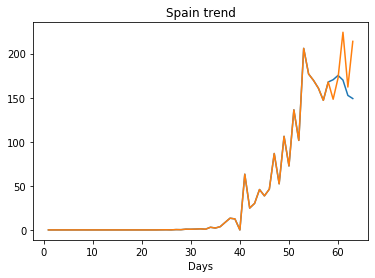

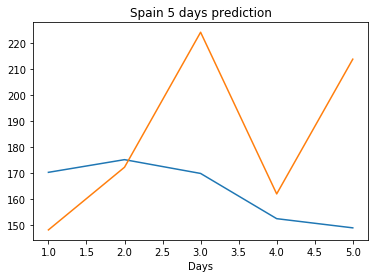

Creating directory ./offline8/Belgium/training/
Belgium
Saving the best model weights at Epoch [1], Best Valid Loss: 12780.6436
Saving the best model weights at Epoch [3], Best Valid Loss: 12007.6484
Saving the best model weights at Epoch [5], Best Valid Loss: 10933.5459
Saving the best model weights at Epoch [6], Best Valid Loss: 10311.0713
Saving the best model weights at Epoch [7], Best Valid Loss: 8579.2441
Saving the best model weights at Epoch [20], Best Valid Loss: 7624.1187
train error: 602.6117914915085
7624.11865234375
Saving the best model weights at Epoch [1], Best Valid Loss: 9587.3340
Saving the best model weights at Epoch [2], Best Valid Loss: 7721.5298
Saving the best model weights at Epoch [15], Best Valid Loss: 7570.2656
Saving the best model weights at Epoch [20], Best Valid Loss: 7416.0117
Saving the best model weights at Epoch [31], Best Valid Loss: 7326.8711
Saving the best model weights at Epoch [39], Best Valid Loss: 7242.0938
train error: 850.7843857908249
7242

Saving the best model weights at Epoch [7], Best Valid Loss: 7393.6577
train error: 1085.3131895065308
7393.65771484375
Saving the best model weights at Epoch [1], Best Valid Loss: 13891.4033
Saving the best model weights at Epoch [2], Best Valid Loss: 11164.4199
Saving the best model weights at Epoch [3], Best Valid Loss: 11042.4941
Saving the best model weights at Epoch [5], Best Valid Loss: 10151.7236
Saving the best model weights at Epoch [24], Best Valid Loss: 9972.6621
train error: 1216.1947171020508
9972.662109375
Saving the best model weights at Epoch [1], Best Valid Loss: 10462.4502
train error: 1790.3549511861802
10462.4501953125
Saving the best model weights at Epoch [1], Best Valid Loss: 11977.4062
Saving the best model weights at Epoch [3], Best Valid Loss: 9819.4160
Saving the best model weights at Epoch [4], Best Valid Loss: 9640.9258
Saving the best model weights at Epoch [5], Best Valid Loss: 7071.1304
Saving the best model weights at Epoch [11], Best Valid Loss: 5703.

Saving the best model weights at Epoch [2], Best Valid Loss: 10382.0381
Saving the best model weights at Epoch [6], Best Valid Loss: 9132.1611
Saving the best model weights at Epoch [9], Best Valid Loss: 8482.1104
Saving the best model weights at Epoch [10], Best Valid Loss: 6511.5435
Saving the best model weights at Epoch [43], Best Valid Loss: 6234.5015
train error: 1264.8387536621094
6234.50146484375
Saving the best model weights at Epoch [1], Best Valid Loss: 15239.0283
train error: 1790.3549511861802
15239.0283203125
Saving the best model weights at Epoch [1], Best Valid Loss: 12644.3975
Saving the best model weights at Epoch [2], Best Valid Loss: 11798.6045
Saving the best model weights at Epoch [3], Best Valid Loss: 10457.5947
Saving the best model weights at Epoch [5], Best Valid Loss: 8649.5049
Saving the best model weights at Epoch [10], Best Valid Loss: 8310.1816
Saving the best model weights at Epoch [14], Best Valid Loss: 7993.9673
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [18], Best Valid Loss: 7049.8765
Saving the best model weights at Epoch [21], Best Valid Loss: 6554.1016
train error: 1047.544766345024
6554.1015625
Saving the best model weights at Epoch [1], Best Valid Loss: 12841.6094
Saving the best model weights at Epoch [2], Best Valid Loss: 12020.8906
Saving the best model weights at Epoch [4], Best Valid Loss: 11471.3389
Saving the best model weights at Epoch [6], Best Valid Loss: 11338.1318
Saving the best model weights at Epoch [7], Best Valid Loss: 11098.9453
Saving the best model weights at Epoch [10], Best Valid Loss: 10532.9580
Saving the best model weights at Epoch [13], Best Valid Loss: 9964.6895
Saving the best model weights at Epoch [14], Best Valid Loss: 9905.9688
Saving the best model weights at Epoch [17], Best Valid Loss: 9752.7725
Saving the best model weights at Epoch [19], Best Valid Loss: 8553.6348
Saving the best model weights at Epoch [23], Best Valid Loss: 8407.1387
Saving the best mod

Saving the best model weights at Epoch [9], Best Valid Loss: 11943.9775
Saving the best model weights at Epoch [11], Best Valid Loss: 11157.8857
Saving the best model weights at Epoch [12], Best Valid Loss: 11080.8877
Saving the best model weights at Epoch [13], Best Valid Loss: 10052.3467
Saving the best model weights at Epoch [14], Best Valid Loss: 8309.2354
Saving the best model weights at Epoch [16], Best Valid Loss: 8184.7314
Saving the best model weights at Epoch [19], Best Valid Loss: 7894.7188
Saving the best model weights at Epoch [37], Best Valid Loss: 7178.1655
Saving the best model weights at Epoch [49], Best Valid Loss: 6925.5532
train error: 841.704184179306
6925.55322265625
Saving the best model weights at Epoch [1], Best Valid Loss: 14591.0566
Saving the best model weights at Epoch [2], Best Valid Loss: 11611.5576
Saving the best model weights at Epoch [3], Best Valid Loss: 11047.0420
Saving the best model weights at Epoch [6], Best Valid Loss: 7998.9751
Saving the best

Saving the best model weights at Epoch [1], Best Valid Loss: 14698.7803
Saving the best model weights at Epoch [2], Best Valid Loss: 13593.4990
Saving the best model weights at Epoch [3], Best Valid Loss: 11782.6562
Saving the best model weights at Epoch [4], Best Valid Loss: 10675.1602
Saving the best model weights at Epoch [14], Best Valid Loss: 10668.6094
Saving the best model weights at Epoch [17], Best Valid Loss: 10637.6377
Saving the best model weights at Epoch [21], Best Valid Loss: 10324.7578
Saving the best model weights at Epoch [28], Best Valid Loss: 9976.2441
Saving the best model weights at Epoch [32], Best Valid Loss: 9959.1631
Saving the best model weights at Epoch [36], Best Valid Loss: 9125.6240
Saving the best model weights at Epoch [46], Best Valid Loss: 9085.7119
train error: 1148.1362577056884
9085.7119140625
Saving the best model weights at Epoch [1], Best Valid Loss: 13978.2812
Saving the best model weights at Epoch [2], Best Valid Loss: 12707.5518
Saving the be

Saving the best model weights at Epoch [10], Best Valid Loss: 7183.9829
train error: 916.5991190910339
7183.98291015625
Saving the best model weights at Epoch [1], Best Valid Loss: 14436.9971
Saving the best model weights at Epoch [2], Best Valid Loss: 12897.6807
Saving the best model weights at Epoch [3], Best Valid Loss: 12691.5996
Saving the best model weights at Epoch [5], Best Valid Loss: 12150.5381
Saving the best model weights at Epoch [7], Best Valid Loss: 12124.4238
Saving the best model weights at Epoch [35], Best Valid Loss: 11975.1084
Saving the best model weights at Epoch [48], Best Valid Loss: 11429.7217
Saving the best model weights at Epoch [50], Best Valid Loss: 10774.5488
train error: 1249.8860754394532
10774.548828125
Saving the best model weights at Epoch [1], Best Valid Loss: 11124.5928
Saving the best model weights at Epoch [3], Best Valid Loss: 10597.9131
Saving the best model weights at Epoch [6], Best Valid Loss: 10041.6094
Saving the best model weights at Epoc

Saving the best model weights at Epoch [8], Best Valid Loss: 14129.9473
Saving the best model weights at Epoch [9], Best Valid Loss: 13910.9551
Saving the best model weights at Epoch [10], Best Valid Loss: 13703.4170
Saving the best model weights at Epoch [11], Best Valid Loss: 13500.2529
Saving the best model weights at Epoch [12], Best Valid Loss: 13306.0459
Saving the best model weights at Epoch [13], Best Valid Loss: 13118.0029
Saving the best model weights at Epoch [14], Best Valid Loss: 12938.7764
Saving the best model weights at Epoch [15], Best Valid Loss: 12765.4785
Saving the best model weights at Epoch [16], Best Valid Loss: 12598.7441
Saving the best model weights at Epoch [17], Best Valid Loss: 12404.5068
Saving the best model weights at Epoch [18], Best Valid Loss: 12228.3359
Saving the best model weights at Epoch [19], Best Valid Loss: 12059.1641
Saving the best model weights at Epoch [20], Best Valid Loss: 11905.7920
Saving the best model weights at Epoch [21], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 10092.8975
Saving the best model weights at Epoch [8], Best Valid Loss: 9933.9463
Saving the best model weights at Epoch [9], Best Valid Loss: 9787.9961
Saving the best model weights at Epoch [10], Best Valid Loss: 9349.0244
Saving the best model weights at Epoch [11], Best Valid Loss: 8954.8818
Saving the best model weights at Epoch [44], Best Valid Loss: 8726.8945
Saving the best model weights at Epoch [45], Best Valid Loss: 8512.8281
Saving the best model weights at Epoch [46], Best Valid Loss: 8355.0889
Saving the best model weights at Epoch [47], Best Valid Loss: 8226.7178
train error: 771.3016110467911
8226.7177734375
Saving the best model weights at Epoch [1], Best Valid Loss: 14402.3672
Saving the best model weights at Epoch [2], Best Valid Loss: 13511.0859
Saving the best model weights at Epoch [3], Best Valid Loss: 12576.5469
Saving the best model weights at Epoch [4], Best Valid Loss: 11886.9902
Saving the best mod

Saving the best model weights at Epoch [44], Best Valid Loss: 9617.2217
Saving the best model weights at Epoch [45], Best Valid Loss: 9467.6758
Saving the best model weights at Epoch [46], Best Valid Loss: 9328.8223
Saving the best model weights at Epoch [47], Best Valid Loss: 9212.9561
Saving the best model weights at Epoch [48], Best Valid Loss: 9107.3359
Saving the best model weights at Epoch [49], Best Valid Loss: 9008.5449
Saving the best model weights at Epoch [50], Best Valid Loss: 8923.7939
train error: 805.6229853630066
8923.7939453125
Saving the best model weights at Epoch [1], Best Valid Loss: 15167.0938
Saving the best model weights at Epoch [2], Best Valid Loss: 15105.5674
Saving the best model weights at Epoch [3], Best Valid Loss: 15037.9131
Saving the best model weights at Epoch [4], Best Valid Loss: 14962.9990
Saving the best model weights at Epoch [5], Best Valid Loss: 14881.5654
Saving the best model weights at Epoch [6], Best Valid Loss: 14789.4629
Saving the best m

Saving the best model weights at Epoch [4], Best Valid Loss: 11617.6240
Saving the best model weights at Epoch [6], Best Valid Loss: 11007.0547
Saving the best model weights at Epoch [8], Best Valid Loss: 10989.1357
Saving the best model weights at Epoch [9], Best Valid Loss: 10598.1934
Saving the best model weights at Epoch [10], Best Valid Loss: 10396.6162
Saving the best model weights at Epoch [11], Best Valid Loss: 9512.8193
Saving the best model weights at Epoch [12], Best Valid Loss: 9306.2607
Saving the best model weights at Epoch [13], Best Valid Loss: 8517.8623
Saving the best model weights at Epoch [19], Best Valid Loss: 8389.0156
Saving the best model weights at Epoch [20], Best Valid Loss: 7951.0815
Saving the best model weights at Epoch [21], Best Valid Loss: 7670.8345
Saving the best model weights at Epoch [22], Best Valid Loss: 7419.9229
Saving the best model weights at Epoch [25], Best Valid Loss: 7386.3687
Saving the best model weights at Epoch [42], Best Valid Loss: 5

Saving the best model weights at Epoch [11], Best Valid Loss: 14442.1875
Saving the best model weights at Epoch [12], Best Valid Loss: 14346.2188
Saving the best model weights at Epoch [13], Best Valid Loss: 14241.9346
Saving the best model weights at Epoch [14], Best Valid Loss: 14128.2178
Saving the best model weights at Epoch [15], Best Valid Loss: 14009.0303
Saving the best model weights at Epoch [16], Best Valid Loss: 13881.5596
Saving the best model weights at Epoch [17], Best Valid Loss: 13749.1631
Saving the best model weights at Epoch [18], Best Valid Loss: 13612.5537
Saving the best model weights at Epoch [19], Best Valid Loss: 13468.9600
Saving the best model weights at Epoch [20], Best Valid Loss: 13327.6455
Saving the best model weights at Epoch [21], Best Valid Loss: 13185.1816
Saving the best model weights at Epoch [22], Best Valid Loss: 13041.4971
Saving the best model weights at Epoch [23], Best Valid Loss: 12899.9834
Saving the best model weights at Epoch [24], Best V

Saving the best model weights at Epoch [31], Best Valid Loss: 8754.9736
Saving the best model weights at Epoch [34], Best Valid Loss: 8580.3047
Saving the best model weights at Epoch [35], Best Valid Loss: 8472.8252
Saving the best model weights at Epoch [36], Best Valid Loss: 8342.0850
Saving the best model weights at Epoch [37], Best Valid Loss: 8320.1250
Saving the best model weights at Epoch [39], Best Valid Loss: 8182.6797
Saving the best model weights at Epoch [41], Best Valid Loss: 8128.1206
train error: 775.2943218708039
8128.12060546875
Saving the best model weights at Epoch [1], Best Valid Loss: 15158.8145
Saving the best model weights at Epoch [2], Best Valid Loss: 15085.4941
Saving the best model weights at Epoch [3], Best Valid Loss: 15011.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 14934.7939
Saving the best model weights at Epoch [5], Best Valid Loss: 14846.3623
Saving the best model weights at Epoch [6], Best Valid Loss: 14761.5771
Saving the best 

Saving the best model weights at Epoch [15], Best Valid Loss: 7718.3916
Saving the best model weights at Epoch [18], Best Valid Loss: 7613.1909
Saving the best model weights at Epoch [23], Best Valid Loss: 7150.7720
Saving the best model weights at Epoch [25], Best Valid Loss: 7006.9604
train error: 1045.1349890136719
7006.96044921875
Saving the best model weights at Epoch [1], Best Valid Loss: 15219.2500
Saving the best model weights at Epoch [2], Best Valid Loss: 15200.3252
Saving the best model weights at Epoch [3], Best Valid Loss: 15180.9873
Saving the best model weights at Epoch [4], Best Valid Loss: 15162.1162
Saving the best model weights at Epoch [5], Best Valid Loss: 15143.0439
Saving the best model weights at Epoch [6], Best Valid Loss: 15123.9844
Saving the best model weights at Epoch [7], Best Valid Loss: 15104.6943
Saving the best model weights at Epoch [8], Best Valid Loss: 15084.8125
Saving the best model weights at Epoch [9], Best Valid Loss: 15064.6221
Saving the best

Saving the best model weights at Epoch [33], Best Valid Loss: 14082.4502
Saving the best model weights at Epoch [34], Best Valid Loss: 14044.9561
Saving the best model weights at Epoch [35], Best Valid Loss: 14008.6953
Saving the best model weights at Epoch [36], Best Valid Loss: 13974.1846
Saving the best model weights at Epoch [37], Best Valid Loss: 13942.8037
Saving the best model weights at Epoch [38], Best Valid Loss: 13910.0439
Saving the best model weights at Epoch [39], Best Valid Loss: 13881.2471
Saving the best model weights at Epoch [40], Best Valid Loss: 13853.5537
Saving the best model weights at Epoch [41], Best Valid Loss: 13827.5176
Saving the best model weights at Epoch [42], Best Valid Loss: 13804.0654
Saving the best model weights at Epoch [43], Best Valid Loss: 13780.5957
Saving the best model weights at Epoch [44], Best Valid Loss: 13758.7031
Saving the best model weights at Epoch [45], Best Valid Loss: 13738.3643
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [29], Best Valid Loss: 12201.1787
Saving the best model weights at Epoch [30], Best Valid Loss: 11955.2490
Saving the best model weights at Epoch [31], Best Valid Loss: 11720.1738
Saving the best model weights at Epoch [32], Best Valid Loss: 11506.3789
Saving the best model weights at Epoch [33], Best Valid Loss: 11319.7451
Saving the best model weights at Epoch [34], Best Valid Loss: 11160.3076
Saving the best model weights at Epoch [35], Best Valid Loss: 11012.3789
Saving the best model weights at Epoch [36], Best Valid Loss: 10884.7412
Saving the best model weights at Epoch [37], Best Valid Loss: 10782.9229
Saving the best model weights at Epoch [38], Best Valid Loss: 10683.5459
Saving the best model weights at Epoch [39], Best Valid Loss: 10581.3936
Saving the best model weights at Epoch [40], Best Valid Loss: 10519.5195
Saving the best model weights at Epoch [41], Best Valid Loss: 10458.0127
Saving the best model weights at Epoch [42], Best V

Saving the best model weights at Epoch [14], Best Valid Loss: 13539.5498
Saving the best model weights at Epoch [15], Best Valid Loss: 13332.6318
Saving the best model weights at Epoch [16], Best Valid Loss: 13196.6631
Saving the best model weights at Epoch [17], Best Valid Loss: 13036.8584
Saving the best model weights at Epoch [18], Best Valid Loss: 12887.5000
Saving the best model weights at Epoch [19], Best Valid Loss: 12765.4893
Saving the best model weights at Epoch [21], Best Valid Loss: 12629.2793
Saving the best model weights at Epoch [22], Best Valid Loss: 12516.3271
Saving the best model weights at Epoch [23], Best Valid Loss: 12409.0576
Saving the best model weights at Epoch [25], Best Valid Loss: 12242.5771
Saving the best model weights at Epoch [27], Best Valid Loss: 11969.2656
Saving the best model weights at Epoch [39], Best Valid Loss: 11931.3271
train error: 1382.9573406982422
11931.3271484375
Saving the best model weights at Epoch [1], Best Valid Loss: 14768.9375
Sav

Saving the best model weights at Epoch [25], Best Valid Loss: 12927.6475
Saving the best model weights at Epoch [26], Best Valid Loss: 12818.1064
Saving the best model weights at Epoch [27], Best Valid Loss: 12716.5850
Saving the best model weights at Epoch [28], Best Valid Loss: 12615.2100
Saving the best model weights at Epoch [29], Best Valid Loss: 12524.9170
Saving the best model weights at Epoch [30], Best Valid Loss: 12437.1611
Saving the best model weights at Epoch [31], Best Valid Loss: 12355.7881
Saving the best model weights at Epoch [32], Best Valid Loss: 12277.3467
Saving the best model weights at Epoch [33], Best Valid Loss: 12205.1582
Saving the best model weights at Epoch [34], Best Valid Loss: 12138.8428
Saving the best model weights at Epoch [35], Best Valid Loss: 12078.5850
Saving the best model weights at Epoch [36], Best Valid Loss: 12020.3125
Saving the best model weights at Epoch [37], Best Valid Loss: 11966.1318
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [25], Best Valid Loss: 13916.7969
Saving the best model weights at Epoch [26], Best Valid Loss: 13835.0654
Saving the best model weights at Epoch [27], Best Valid Loss: 13758.0186
Saving the best model weights at Epoch [28], Best Valid Loss: 13681.7529
Saving the best model weights at Epoch [29], Best Valid Loss: 13609.4756
Saving the best model weights at Epoch [30], Best Valid Loss: 13539.6533
Saving the best model weights at Epoch [31], Best Valid Loss: 13477.2520
Saving the best model weights at Epoch [32], Best Valid Loss: 13416.7842
Saving the best model weights at Epoch [33], Best Valid Loss: 13360.9424
Saving the best model weights at Epoch [34], Best Valid Loss: 13313.8125
Saving the best model weights at Epoch [35], Best Valid Loss: 13262.9580
Saving the best model weights at Epoch [36], Best Valid Loss: 13225.4375
Saving the best model weights at Epoch [37], Best Valid Loss: 13186.1016
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 11904.5732
Saving the best model weights at Epoch [31], Best Valid Loss: 11625.0625
Saving the best model weights at Epoch [32], Best Valid Loss: 11531.4043
Saving the best model weights at Epoch [33], Best Valid Loss: 11434.4453
Saving the best model weights at Epoch [34], Best Valid Loss: 11374.5234
Saving the best model weights at Epoch [35], Best Valid Loss: 11309.8848
Saving the best model weights at Epoch [38], Best Valid Loss: 11284.9131
Saving the best model weights at Epoch [40], Best Valid Loss: 11233.2031
Saving the best model weights at Epoch [43], Best Valid Loss: 11101.7861
Saving the best model weights at Epoch [47], Best Valid Loss: 10877.7920
Saving the best model weights at Epoch [49], Best Valid Loss: 10480.0684
Saving the best model weights at Epoch [50], Best Valid Loss: 10471.1113
train error: 1172.4877342224122
10471.111328125
Saving the best model weights at Epoch [1], Best Valid Loss: 15239.0283
trai

Saving the best model weights at Epoch [13], Best Valid Loss: 15006.7783
Saving the best model weights at Epoch [14], Best Valid Loss: 14991.0312
Saving the best model weights at Epoch [15], Best Valid Loss: 14975.1201
Saving the best model weights at Epoch [16], Best Valid Loss: 14958.8613
Saving the best model weights at Epoch [17], Best Valid Loss: 14942.1748
Saving the best model weights at Epoch [18], Best Valid Loss: 14925.0342
Saving the best model weights at Epoch [19], Best Valid Loss: 14907.7256
Saving the best model weights at Epoch [20], Best Valid Loss: 14890.7598
Saving the best model weights at Epoch [21], Best Valid Loss: 14874.6533
Saving the best model weights at Epoch [22], Best Valid Loss: 14859.0566
Saving the best model weights at Epoch [23], Best Valid Loss: 14842.0312
Saving the best model weights at Epoch [24], Best Valid Loss: 14824.7969
Saving the best model weights at Epoch [25], Best Valid Loss: 14807.6475
Saving the best model weights at Epoch [26], Best V

Saving the best model weights at Epoch [26], Best Valid Loss: 11508.0771
Saving the best model weights at Epoch [27], Best Valid Loss: 11375.2686
Saving the best model weights at Epoch [28], Best Valid Loss: 11234.2715
Saving the best model weights at Epoch [29], Best Valid Loss: 11099.2773
Saving the best model weights at Epoch [30], Best Valid Loss: 10982.7383
Saving the best model weights at Epoch [31], Best Valid Loss: 10873.9092
Saving the best model weights at Epoch [32], Best Valid Loss: 10779.8447
Saving the best model weights at Epoch [33], Best Valid Loss: 10668.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 10555.6709
Saving the best model weights at Epoch [35], Best Valid Loss: 10479.3926
Saving the best model weights at Epoch [36], Best Valid Loss: 10394.9629
Saving the best model weights at Epoch [38], Best Valid Loss: 10200.0781
Saving the best model weights at Epoch [39], Best Valid Loss: 10130.3271
Saving the best model weights at Epoch [40], Best V

Saving the best model weights at Epoch [45], Best Valid Loss: 12185.2529
Saving the best model weights at Epoch [46], Best Valid Loss: 12130.0225
Saving the best model weights at Epoch [47], Best Valid Loss: 12075.3184
Saving the best model weights at Epoch [48], Best Valid Loss: 12022.4033
Saving the best model weights at Epoch [49], Best Valid Loss: 11972.7100
Saving the best model weights at Epoch [50], Best Valid Loss: 11919.3350
train error: 1127.1891202282904
11919.3349609375
Saving the best model weights at Epoch [1], Best Valid Loss: 15033.9111
Saving the best model weights at Epoch [2], Best Valid Loss: 14737.9131
Saving the best model weights at Epoch [3], Best Valid Loss: 14446.9941
Saving the best model weights at Epoch [4], Best Valid Loss: 14100.7471
Saving the best model weights at Epoch [5], Best Valid Loss: 13778.5518
Saving the best model weights at Epoch [6], Best Valid Loss: 13521.5254
Saving the best model weights at Epoch [7], Best Valid Loss: 13226.6221
Saving th

Saving the best model weights at Epoch [29], Best Valid Loss: 11129.0361
Saving the best model weights at Epoch [30], Best Valid Loss: 11007.3232
Saving the best model weights at Epoch [31], Best Valid Loss: 10895.9561
Saving the best model weights at Epoch [32], Best Valid Loss: 10784.8232
Saving the best model weights at Epoch [33], Best Valid Loss: 10683.5098
Saving the best model weights at Epoch [34], Best Valid Loss: 10562.5420
Saving the best model weights at Epoch [35], Best Valid Loss: 10458.0342
Saving the best model weights at Epoch [36], Best Valid Loss: 10349.7529
Saving the best model weights at Epoch [37], Best Valid Loss: 10236.4785
Saving the best model weights at Epoch [38], Best Valid Loss: 10135.6230
Saving the best model weights at Epoch [39], Best Valid Loss: 10037.2842
Saving the best model weights at Epoch [40], Best Valid Loss: 9951.2988
Saving the best model weights at Epoch [41], Best Valid Loss: 9852.4482
Saving the best model weights at Epoch [42], Best Val

Saving the best model weights at Epoch [26], Best Valid Loss: 8581.3936
Saving the best model weights at Epoch [27], Best Valid Loss: 8432.6836
Saving the best model weights at Epoch [28], Best Valid Loss: 8284.4521
Saving the best model weights at Epoch [29], Best Valid Loss: 8157.7651
Saving the best model weights at Epoch [30], Best Valid Loss: 8029.7759
Saving the best model weights at Epoch [31], Best Valid Loss: 7892.5391
Saving the best model weights at Epoch [32], Best Valid Loss: 7766.6460
Saving the best model weights at Epoch [33], Best Valid Loss: 7638.1675
Saving the best model weights at Epoch [34], Best Valid Loss: 7533.1069
Saving the best model weights at Epoch [35], Best Valid Loss: 7411.8125
Saving the best model weights at Epoch [36], Best Valid Loss: 7315.6421
Saving the best model weights at Epoch [37], Best Valid Loss: 7213.2954
Saving the best model weights at Epoch [39], Best Valid Loss: 7009.5649
Saving the best model weights at Epoch [42], Best Valid Loss: 67

Saving the best model weights at Epoch [33], Best Valid Loss: 15051.4531
Saving the best model weights at Epoch [34], Best Valid Loss: 15046.7314
Saving the best model weights at Epoch [35], Best Valid Loss: 15041.9600
Saving the best model weights at Epoch [36], Best Valid Loss: 15036.8662
Saving the best model weights at Epoch [37], Best Valid Loss: 15031.9160
Saving the best model weights at Epoch [38], Best Valid Loss: 15027.0029
Saving the best model weights at Epoch [39], Best Valid Loss: 15022.0771
Saving the best model weights at Epoch [40], Best Valid Loss: 15017.0439
Saving the best model weights at Epoch [41], Best Valid Loss: 15012.3408
Saving the best model weights at Epoch [42], Best Valid Loss: 15007.0332
Saving the best model weights at Epoch [43], Best Valid Loss: 15002.0381
Saving the best model weights at Epoch [44], Best Valid Loss: 14997.1514
Saving the best model weights at Epoch [45], Best Valid Loss: 14992.3438
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 14728.9473
Saving the best model weights at Epoch [50], Best Valid Loss: 14712.1875
train error: 1674.7707164764404
14712.1875
Saving the best model weights at Epoch [1], Best Valid Loss: 15215.3271
Saving the best model weights at Epoch [2], Best Valid Loss: 15204.9658
Saving the best model weights at Epoch [3], Best Valid Loss: 15194.4404
Saving the best model weights at Epoch [4], Best Valid Loss: 15184.0127
Saving the best model weights at Epoch [5], Best Valid Loss: 15173.3047
Saving the best model weights at Epoch [6], Best Valid Loss: 15161.9014
Saving the best model weights at Epoch [7], Best Valid Loss: 15149.9268
Saving the best model weights at Epoch [8], Best Valid Loss: 15137.9443
Saving the best model weights at Epoch [9], Best Valid Loss: 15126.1221
Saving the best model weights at Epoch [10], Best Valid Loss: 15113.2969
Saving the best model weights at Epoch [11], Best Valid Loss: 15099.8750
Saving the best m

Saving the best model weights at Epoch [25], Best Valid Loss: 15057.9863
Saving the best model weights at Epoch [26], Best Valid Loss: 15048.2021
Saving the best model weights at Epoch [27], Best Valid Loss: 15037.5732
Saving the best model weights at Epoch [28], Best Valid Loss: 15026.5723
Saving the best model weights at Epoch [29], Best Valid Loss: 15015.0381
Saving the best model weights at Epoch [30], Best Valid Loss: 15002.9844
Saving the best model weights at Epoch [31], Best Valid Loss: 14990.6094
Saving the best model weights at Epoch [32], Best Valid Loss: 14977.4404
Saving the best model weights at Epoch [33], Best Valid Loss: 14963.9521
Saving the best model weights at Epoch [34], Best Valid Loss: 14949.8174
Saving the best model weights at Epoch [35], Best Valid Loss: 14935.3125
Saving the best model weights at Epoch [36], Best Valid Loss: 14919.9453
Saving the best model weights at Epoch [37], Best Valid Loss: 14903.6064
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [14], Best Valid Loss: 15111.5654
Saving the best model weights at Epoch [15], Best Valid Loss: 15100.5693
Saving the best model weights at Epoch [16], Best Valid Loss: 15088.5967
Saving the best model weights at Epoch [17], Best Valid Loss: 15076.1377
Saving the best model weights at Epoch [18], Best Valid Loss: 15062.8564
Saving the best model weights at Epoch [19], Best Valid Loss: 15048.7158
Saving the best model weights at Epoch [20], Best Valid Loss: 15033.7129
Saving the best model weights at Epoch [21], Best Valid Loss: 15017.8438
Saving the best model weights at Epoch [22], Best Valid Loss: 15001.1631
Saving the best model weights at Epoch [23], Best Valid Loss: 14983.3301
Saving the best model weights at Epoch [24], Best Valid Loss: 14964.4707
Saving the best model weights at Epoch [25], Best Valid Loss: 14944.2891
Saving the best model weights at Epoch [26], Best Valid Loss: 14922.9658
Saving the best model weights at Epoch [27], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 15158.4600
Saving the best model weights at Epoch [7], Best Valid Loss: 15150.2842
Saving the best model weights at Epoch [8], Best Valid Loss: 15141.9287
Saving the best model weights at Epoch [9], Best Valid Loss: 15133.9844
Saving the best model weights at Epoch [10], Best Valid Loss: 15125.7861
Saving the best model weights at Epoch [11], Best Valid Loss: 15117.4375
Saving the best model weights at Epoch [12], Best Valid Loss: 15109.2939
Saving the best model weights at Epoch [13], Best Valid Loss: 15101.0312
Saving the best model weights at Epoch [14], Best Valid Loss: 15092.9287
Saving the best model weights at Epoch [15], Best Valid Loss: 15085.3350
Saving the best model weights at Epoch [16], Best Valid Loss: 15076.3721
Saving the best model weights at Epoch [17], Best Valid Loss: 15068.3564
Saving the best model weights at Epoch [18], Best Valid Loss: 15059.9707
Saving the best model weights at Epoch [19], Best Valid

Saving the best model weights at Epoch [18], Best Valid Loss: 15183.4297
Saving the best model weights at Epoch [19], Best Valid Loss: 15180.6504
Saving the best model weights at Epoch [20], Best Valid Loss: 15177.8721
Saving the best model weights at Epoch [21], Best Valid Loss: 15175.1377
Saving the best model weights at Epoch [22], Best Valid Loss: 15172.3223
Saving the best model weights at Epoch [23], Best Valid Loss: 15169.5547
Saving the best model weights at Epoch [24], Best Valid Loss: 15166.7881
Saving the best model weights at Epoch [25], Best Valid Loss: 15163.9912
Saving the best model weights at Epoch [26], Best Valid Loss: 15161.2188
Saving the best model weights at Epoch [27], Best Valid Loss: 15158.4443
Saving the best model weights at Epoch [28], Best Valid Loss: 15155.6943
Saving the best model weights at Epoch [29], Best Valid Loss: 15152.9141
Saving the best model weights at Epoch [30], Best Valid Loss: 15150.1270
Saving the best model weights at Epoch [31], Best V

Saving the best model weights at Epoch [33], Best Valid Loss: 8720.3691
Saving the best model weights at Epoch [34], Best Valid Loss: 8612.5342
Saving the best model weights at Epoch [35], Best Valid Loss: 8341.3193
Saving the best model weights at Epoch [37], Best Valid Loss: 8203.3242
Saving the best model weights at Epoch [50], Best Valid Loss: 8147.9487
train error: 903.9138983535767
8147.94873046875
Saving the best model weights at Epoch [1], Best Valid Loss: 15224.2285
Saving the best model weights at Epoch [2], Best Valid Loss: 15219.0859
Saving the best model weights at Epoch [3], Best Valid Loss: 15213.9707
Saving the best model weights at Epoch [4], Best Valid Loss: 15208.7441
Saving the best model weights at Epoch [5], Best Valid Loss: 15203.5811
Saving the best model weights at Epoch [6], Best Valid Loss: 15198.4502
Saving the best model weights at Epoch [7], Best Valid Loss: 15193.2803
Saving the best model weights at Epoch [8], Best Valid Loss: 15188.0967
Saving the best 

Saving the best model weights at Epoch [7], Best Valid Loss: 15048.5615
Saving the best model weights at Epoch [8], Best Valid Loss: 15016.0654
Saving the best model weights at Epoch [9], Best Valid Loss: 14984.6406
Saving the best model weights at Epoch [10], Best Valid Loss: 14953.3350
Saving the best model weights at Epoch [11], Best Valid Loss: 14918.4453
Saving the best model weights at Epoch [12], Best Valid Loss: 14880.8350
Saving the best model weights at Epoch [13], Best Valid Loss: 14846.6973
Saving the best model weights at Epoch [14], Best Valid Loss: 14810.5576
Saving the best model weights at Epoch [15], Best Valid Loss: 14756.8926
Saving the best model weights at Epoch [16], Best Valid Loss: 14711.5596
Saving the best model weights at Epoch [17], Best Valid Loss: 14653.8613
Saving the best model weights at Epoch [18], Best Valid Loss: 14596.7129
Saving the best model weights at Epoch [19], Best Valid Loss: 14540.1973
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [28], Best Valid Loss: 15190.5107
Saving the best model weights at Epoch [29], Best Valid Loss: 15188.9033
Saving the best model weights at Epoch [30], Best Valid Loss: 15187.3066
Saving the best model weights at Epoch [31], Best Valid Loss: 15185.6895
Saving the best model weights at Epoch [32], Best Valid Loss: 15184.1094
Saving the best model weights at Epoch [33], Best Valid Loss: 15182.4209
Saving the best model weights at Epoch [34], Best Valid Loss: 15180.7881
Saving the best model weights at Epoch [35], Best Valid Loss: 15179.1816
Saving the best model weights at Epoch [36], Best Valid Loss: 15177.5596
Saving the best model weights at Epoch [37], Best Valid Loss: 15175.9600
Saving the best model weights at Epoch [38], Best Valid Loss: 15174.4082
Saving the best model weights at Epoch [39], Best Valid Loss: 15172.7100
Saving the best model weights at Epoch [40], Best Valid Loss: 15171.1191
Saving the best model weights at Epoch [41], Best V

Saving the best model weights at Epoch [42], Best Valid Loss: 15097.4502
Saving the best model weights at Epoch [43], Best Valid Loss: 15094.4316
Saving the best model weights at Epoch [44], Best Valid Loss: 15091.4062
Saving the best model weights at Epoch [45], Best Valid Loss: 15088.3779
Saving the best model weights at Epoch [46], Best Valid Loss: 15085.3564
Saving the best model weights at Epoch [47], Best Valid Loss: 15082.3330
Saving the best model weights at Epoch [48], Best Valid Loss: 15079.2939
Saving the best model weights at Epoch [49], Best Valid Loss: 15076.2910
Saving the best model weights at Epoch [50], Best Valid Loss: 15073.2285
train error: 1759.1230646800996
15073.228515625
Saving the best model weights at Epoch [1], Best Valid Loss: 15197.7959
Saving the best model weights at Epoch [2], Best Valid Loss: 15188.2529
Saving the best model weights at Epoch [3], Best Valid Loss: 15178.8223
Saving the best model weights at Epoch [4], Best Valid Loss: 15169.5176
Saving 

Saving the best model weights at Epoch [3], Best Valid Loss: 15220.0879
Saving the best model weights at Epoch [4], Best Valid Loss: 15216.9326
Saving the best model weights at Epoch [5], Best Valid Loss: 15213.8379
Saving the best model weights at Epoch [6], Best Valid Loss: 15210.6924
Saving the best model weights at Epoch [7], Best Valid Loss: 15207.5781
Saving the best model weights at Epoch [8], Best Valid Loss: 15204.4609
Saving the best model weights at Epoch [9], Best Valid Loss: 15201.3350
Saving the best model weights at Epoch [10], Best Valid Loss: 15198.2344
Saving the best model weights at Epoch [11], Best Valid Loss: 15195.1094
Saving the best model weights at Epoch [12], Best Valid Loss: 15192.0068
Saving the best model weights at Epoch [13], Best Valid Loss: 15188.9033
Saving the best model weights at Epoch [14], Best Valid Loss: 15185.7998
Saving the best model weights at Epoch [15], Best Valid Loss: 15182.6719
Saving the best model weights at Epoch [16], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 14103.8066
Saving the best model weights at Epoch [16], Best Valid Loss: 13931.7783
Saving the best model weights at Epoch [17], Best Valid Loss: 13793.7861
Saving the best model weights at Epoch [18], Best Valid Loss: 13665.8896
Saving the best model weights at Epoch [19], Best Valid Loss: 13437.4814
Saving the best model weights at Epoch [20], Best Valid Loss: 13255.1875
Saving the best model weights at Epoch [21], Best Valid Loss: 13105.4365
Saving the best model weights at Epoch [22], Best Valid Loss: 12922.5566
Saving the best model weights at Epoch [23], Best Valid Loss: 12694.8145
Saving the best model weights at Epoch [24], Best Valid Loss: 12534.0576
Saving the best model weights at Epoch [25], Best Valid Loss: 12422.8281
Saving the best model weights at Epoch [26], Best Valid Loss: 12225.0215
Saving the best model weights at Epoch [27], Best Valid Loss: 12100.4561
Saving the best model weights at Epoch [28], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 14898.0938
Saving the best model weights at Epoch [31], Best Valid Loss: 14882.9424
Saving the best model weights at Epoch [32], Best Valid Loss: 14867.3271
Saving the best model weights at Epoch [33], Best Valid Loss: 14851.5693
Saving the best model weights at Epoch [34], Best Valid Loss: 14835.6113
Saving the best model weights at Epoch [35], Best Valid Loss: 14819.7627
Saving the best model weights at Epoch [36], Best Valid Loss: 14802.5410
Saving the best model weights at Epoch [37], Best Valid Loss: 14785.2529
Saving the best model weights at Epoch [38], Best Valid Loss: 14768.7812
Saving the best model weights at Epoch [39], Best Valid Loss: 14749.8145
Saving the best model weights at Epoch [40], Best Valid Loss: 14731.5830
Saving the best model weights at Epoch [41], Best Valid Loss: 14712.9502
Saving the best model weights at Epoch [42], Best Valid Loss: 14688.7129
Saving the best model weights at Epoch [43], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 15195.3721
Saving the best model weights at Epoch [47], Best Valid Loss: 15194.4971
Saving the best model weights at Epoch [48], Best Valid Loss: 15193.6250
Saving the best model weights at Epoch [49], Best Valid Loss: 15192.7578
Saving the best model weights at Epoch [50], Best Valid Loss: 15191.8818
train error: 1783.4416967725754
15191.8818359375
Saving the best model weights at Epoch [1], Best Valid Loss: 15232.2568
Saving the best model weights at Epoch [2], Best Valid Loss: 15228.9453
Saving the best model weights at Epoch [3], Best Valid Loss: 15225.6904
Saving the best model weights at Epoch [4], Best Valid Loss: 15222.5537
Saving the best model weights at Epoch [5], Best Valid Loss: 15218.8799
Saving the best model weights at Epoch [6], Best Valid Loss: 15215.6006
Saving the best model weights at Epoch [7], Best Valid Loss: 15212.2139
Saving the best model weights at Epoch [8], Best Valid Loss: 15209.0537
Saving the

Saving the best model weights at Epoch [18], Best Valid Loss: 15136.0830
Saving the best model weights at Epoch [19], Best Valid Loss: 15132.4561
Saving the best model weights at Epoch [20], Best Valid Loss: 15128.7207
Saving the best model weights at Epoch [21], Best Valid Loss: 15125.0596
Saving the best model weights at Epoch [22], Best Valid Loss: 15121.3506
Saving the best model weights at Epoch [23], Best Valid Loss: 15117.6904
Saving the best model weights at Epoch [24], Best Valid Loss: 15113.9951
Saving the best model weights at Epoch [25], Best Valid Loss: 15110.2998
Saving the best model weights at Epoch [26], Best Valid Loss: 15106.6582
Saving the best model weights at Epoch [27], Best Valid Loss: 15102.9111
Saving the best model weights at Epoch [28], Best Valid Loss: 15099.2500
Saving the best model weights at Epoch [29], Best Valid Loss: 15095.5420
Saving the best model weights at Epoch [30], Best Valid Loss: 15091.8408
Saving the best model weights at Epoch [31], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 13789.6553
Saving the best model weights at Epoch [31], Best Valid Loss: 13682.6973
Saving the best model weights at Epoch [32], Best Valid Loss: 13589.6064
Saving the best model weights at Epoch [33], Best Valid Loss: 13478.2910
Saving the best model weights at Epoch [34], Best Valid Loss: 13411.3428
Saving the best model weights at Epoch [35], Best Valid Loss: 13326.7842
Saving the best model weights at Epoch [36], Best Valid Loss: 13232.2861
Saving the best model weights at Epoch [37], Best Valid Loss: 13178.4346
Saving the best model weights at Epoch [38], Best Valid Loss: 13076.4248
Saving the best model weights at Epoch [39], Best Valid Loss: 13035.9580
Saving the best model weights at Epoch [40], Best Valid Loss: 12941.9326
Saving the best model weights at Epoch [41], Best Valid Loss: 12887.0010
Saving the best model weights at Epoch [42], Best Valid Loss: 12838.6592
Saving the best model weights at Epoch [43], Best V

Saving the best model weights at Epoch [42], Best Valid Loss: 15172.7676
Saving the best model weights at Epoch [43], Best Valid Loss: 15171.2998
Saving the best model weights at Epoch [44], Best Valid Loss: 15169.7031
Saving the best model weights at Epoch [45], Best Valid Loss: 15168.1562
Saving the best model weights at Epoch [46], Best Valid Loss: 15166.7061
Saving the best model weights at Epoch [47], Best Valid Loss: 15165.0967
Saving the best model weights at Epoch [48], Best Valid Loss: 15163.5410
Saving the best model weights at Epoch [49], Best Valid Loss: 15162.1035
Saving the best model weights at Epoch [50], Best Valid Loss: 15160.5283
train error: 1779.0613004493714
15160.5283203125
Saving the best model weights at Epoch [1], Best Valid Loss: 15210.8193
Saving the best model weights at Epoch [2], Best Valid Loss: 15176.4209
Saving the best model weights at Epoch [3], Best Valid Loss: 15141.2188
Saving the best model weights at Epoch [4], Best Valid Loss: 15105.6846
Saving

Saving the best model weights at Epoch [5], Best Valid Loss: 14981.4160
Saving the best model weights at Epoch [6], Best Valid Loss: 14921.2627
Saving the best model weights at Epoch [7], Best Valid Loss: 14864.3457
Saving the best model weights at Epoch [8], Best Valid Loss: 14805.2344
Saving the best model weights at Epoch [9], Best Valid Loss: 14740.8115
Saving the best model weights at Epoch [10], Best Valid Loss: 14670.4736
Saving the best model weights at Epoch [11], Best Valid Loss: 14568.8750
Saving the best model weights at Epoch [12], Best Valid Loss: 14476.9873
Saving the best model weights at Epoch [13], Best Valid Loss: 14370.7686
Saving the best model weights at Epoch [14], Best Valid Loss: 14239.1143
Saving the best model weights at Epoch [15], Best Valid Loss: 14074.8486
Saving the best model weights at Epoch [16], Best Valid Loss: 13920.1035
Saving the best model weights at Epoch [17], Best Valid Loss: 13714.4551
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [25], Best Valid Loss: 11976.4473
Saving the best model weights at Epoch [26], Best Valid Loss: 11761.5869
Saving the best model weights at Epoch [27], Best Valid Loss: 11545.9375
Saving the best model weights at Epoch [28], Best Valid Loss: 11428.5410
Saving the best model weights at Epoch [29], Best Valid Loss: 11318.1045
Saving the best model weights at Epoch [30], Best Valid Loss: 11295.8613
Saving the best model weights at Epoch [31], Best Valid Loss: 11151.7646
Saving the best model weights at Epoch [34], Best Valid Loss: 11110.1631
Saving the best model weights at Epoch [35], Best Valid Loss: 10975.8740
Saving the best model weights at Epoch [41], Best Valid Loss: 10901.5996
Saving the best model weights at Epoch [43], Best Valid Loss: 10891.8115
Saving the best model weights at Epoch [44], Best Valid Loss: 10685.2207
Saving the best model weights at Epoch [45], Best Valid Loss: 10647.9717
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [47], Best Valid Loss: 15110.3975
Saving the best model weights at Epoch [48], Best Valid Loss: 15108.6436
Saving the best model weights at Epoch [49], Best Valid Loss: 15107.0781
Saving the best model weights at Epoch [50], Best Valid Loss: 15105.4785
train error: 1766.8285679388046
15105.478515625
Saving the best model weights at Epoch [1], Best Valid Loss: 15222.1094
Saving the best model weights at Epoch [2], Best Valid Loss: 15216.4941
Saving the best model weights at Epoch [3], Best Valid Loss: 15210.6348
Saving the best model weights at Epoch [4], Best Valid Loss: 15203.3896
Saving the best model weights at Epoch [5], Best Valid Loss: 15195.8076
Saving the best model weights at Epoch [6], Best Valid Loss: 15180.8848
Saving the best model weights at Epoch [7], Best Valid Loss: 15158.3379
Saving the best model weights at Epoch [8], Best Valid Loss: 15137.4561
Saving the best model weights at Epoch [9], Best Valid Loss: 15126.1943
Saving the b

Saving the best model weights at Epoch [9], Best Valid Loss: 15148.5000
Saving the best model weights at Epoch [10], Best Valid Loss: 15142.2803
Saving the best model weights at Epoch [11], Best Valid Loss: 15136.3623
Saving the best model weights at Epoch [12], Best Valid Loss: 15129.2285
Saving the best model weights at Epoch [13], Best Valid Loss: 15122.9062
Saving the best model weights at Epoch [14], Best Valid Loss: 15116.4766
Saving the best model weights at Epoch [15], Best Valid Loss: 15110.1328
Saving the best model weights at Epoch [16], Best Valid Loss: 15103.4033
Saving the best model weights at Epoch [17], Best Valid Loss: 15097.3047
Saving the best model weights at Epoch [18], Best Valid Loss: 15090.1162
Saving the best model weights at Epoch [19], Best Valid Loss: 15083.4717
Saving the best model weights at Epoch [20], Best Valid Loss: 15076.8096
Saving the best model weights at Epoch [21], Best Valid Loss: 15070.0020
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [21], Best Valid Loss: 15132.7842
Saving the best model weights at Epoch [22], Best Valid Loss: 15126.9658
Saving the best model weights at Epoch [23], Best Valid Loss: 15121.3535
Saving the best model weights at Epoch [24], Best Valid Loss: 15116.0078
Saving the best model weights at Epoch [25], Best Valid Loss: 15110.8223
Saving the best model weights at Epoch [26], Best Valid Loss: 15105.5283
Saving the best model weights at Epoch [27], Best Valid Loss: 15100.0625
Saving the best model weights at Epoch [28], Best Valid Loss: 15094.5186
Saving the best model weights at Epoch [29], Best Valid Loss: 15088.8584
Saving the best model weights at Epoch [30], Best Valid Loss: 15083.0488
Saving the best model weights at Epoch [31], Best Valid Loss: 15077.0967
Saving the best model weights at Epoch [32], Best Valid Loss: 15071.0850
Saving the best model weights at Epoch [33], Best Valid Loss: 15065.1172
Saving the best model weights at Epoch [34], Best V

Saving the best model weights at Epoch [33], Best Valid Loss: 13666.2295
Saving the best model weights at Epoch [34], Best Valid Loss: 13607.7344
Saving the best model weights at Epoch [35], Best Valid Loss: 13554.0254
Saving the best model weights at Epoch [36], Best Valid Loss: 13498.0312
Saving the best model weights at Epoch [37], Best Valid Loss: 13434.4209
Saving the best model weights at Epoch [38], Best Valid Loss: 13381.0254
Saving the best model weights at Epoch [39], Best Valid Loss: 13328.1631
Saving the best model weights at Epoch [40], Best Valid Loss: 13267.8359
Saving the best model weights at Epoch [41], Best Valid Loss: 13217.3750
Saving the best model weights at Epoch [42], Best Valid Loss: 13162.8408
Saving the best model weights at Epoch [43], Best Valid Loss: 13100.3760
Saving the best model weights at Epoch [44], Best Valid Loss: 13058.0215
Saving the best model weights at Epoch [45], Best Valid Loss: 12995.7627
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [45], Best Valid Loss: 14481.7451
Saving the best model weights at Epoch [46], Best Valid Loss: 14462.4717
Saving the best model weights at Epoch [47], Best Valid Loss: 14443.1719
Saving the best model weights at Epoch [48], Best Valid Loss: 14425.9658
Saving the best model weights at Epoch [49], Best Valid Loss: 14405.9473
Saving the best model weights at Epoch [50], Best Valid Loss: 14387.2705
train error: 1662.26892598629
14387.2705078125
Saving the best model weights at Epoch [1], Best Valid Loss: 15161.5752
Saving the best model weights at Epoch [2], Best Valid Loss: 15068.8984
Saving the best model weights at Epoch [3], Best Valid Loss: 15007.4844
Saving the best model weights at Epoch [4], Best Valid Loss: 14944.7021
Saving the best model weights at Epoch [5], Best Valid Loss: 14872.4873
Saving the best model weights at Epoch [6], Best Valid Loss: 14766.7021
Saving the best model weights at Epoch [7], Best Valid Loss: 14620.9453
Saving the 

Saving the best model weights at Epoch [6], Best Valid Loss: 15192.4033
Saving the best model weights at Epoch [7], Best Valid Loss: 15191.5498
Saving the best model weights at Epoch [8], Best Valid Loss: 15190.7373
Saving the best model weights at Epoch [9], Best Valid Loss: 15189.9600
Saving the best model weights at Epoch [10], Best Valid Loss: 15189.0938
Saving the best model weights at Epoch [11], Best Valid Loss: 15188.2842
Saving the best model weights at Epoch [12], Best Valid Loss: 15187.4561
Saving the best model weights at Epoch [13], Best Valid Loss: 15186.6592
Saving the best model weights at Epoch [14], Best Valid Loss: 15185.8594
Saving the best model weights at Epoch [15], Best Valid Loss: 15185.0811
Saving the best model weights at Epoch [16], Best Valid Loss: 15184.1973
Saving the best model weights at Epoch [17], Best Valid Loss: 15183.3906
Saving the best model weights at Epoch [18], Best Valid Loss: 15182.5693
Saving the best model weights at Epoch [19], Best Valid

Saving the best model weights at Epoch [18], Best Valid Loss: 15209.2373
Saving the best model weights at Epoch [19], Best Valid Loss: 15208.6279
Saving the best model weights at Epoch [20], Best Valid Loss: 15208.0186
Saving the best model weights at Epoch [21], Best Valid Loss: 15207.4033
Saving the best model weights at Epoch [22], Best Valid Loss: 15206.7920
Saving the best model weights at Epoch [23], Best Valid Loss: 15206.1816
Saving the best model weights at Epoch [24], Best Valid Loss: 15205.5693
Saving the best model weights at Epoch [25], Best Valid Loss: 15204.9580
Saving the best model weights at Epoch [26], Best Valid Loss: 15204.3516
Saving the best model weights at Epoch [27], Best Valid Loss: 15203.7344
Saving the best model weights at Epoch [28], Best Valid Loss: 15203.1240
Saving the best model weights at Epoch [29], Best Valid Loss: 15202.5049
Saving the best model weights at Epoch [30], Best Valid Loss: 15201.8926
Saving the best model weights at Epoch [31], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 15106.5547
Saving the best model weights at Epoch [31], Best Valid Loss: 15099.4346
Saving the best model weights at Epoch [32], Best Valid Loss: 15091.2861
Saving the best model weights at Epoch [33], Best Valid Loss: 15084.0986
Saving the best model weights at Epoch [34], Best Valid Loss: 15076.7285
Saving the best model weights at Epoch [35], Best Valid Loss: 15068.1592
Saving the best model weights at Epoch [36], Best Valid Loss: 15060.1660
Saving the best model weights at Epoch [37], Best Valid Loss: 15051.7412
Saving the best model weights at Epoch [38], Best Valid Loss: 15044.6357
Saving the best model weights at Epoch [39], Best Valid Loss: 15034.7314
Saving the best model weights at Epoch [40], Best Valid Loss: 15025.8438
Saving the best model weights at Epoch [41], Best Valid Loss: 15015.9609
Saving the best model weights at Epoch [42], Best Valid Loss: 15006.2441
Saving the best model weights at Epoch [43], Best V

Saving the best model weights at Epoch [40], Best Valid Loss: 14882.2256
Saving the best model weights at Epoch [41], Best Valid Loss: 14866.6455
Saving the best model weights at Epoch [42], Best Valid Loss: 14850.1865
Saving the best model weights at Epoch [43], Best Valid Loss: 14828.6973
Saving the best model weights at Epoch [44], Best Valid Loss: 14810.0342
Saving the best model weights at Epoch [45], Best Valid Loss: 14788.2100
Saving the best model weights at Epoch [46], Best Valid Loss: 14762.1006
Saving the best model weights at Epoch [47], Best Valid Loss: 14741.6250
Saving the best model weights at Epoch [48], Best Valid Loss: 14707.9443
Saving the best model weights at Epoch [49], Best Valid Loss: 14684.3037
Saving the best model weights at Epoch [50], Best Valid Loss: 14653.8438
train error: 1681.744005665779
14653.84375
Saving the best model weights at Epoch [1], Best Valid Loss: 15229.3223
Saving the best model weights at Epoch [2], Best Valid Loss: 15228.7939
Saving the

Saving the best model weights at Epoch [1], Best Valid Loss: 15226.3623
Saving the best model weights at Epoch [2], Best Valid Loss: 15218.5205
Saving the best model weights at Epoch [3], Best Valid Loss: 15208.2725
Saving the best model weights at Epoch [4], Best Valid Loss: 15198.7285
Saving the best model weights at Epoch [5], Best Valid Loss: 15188.2754
Saving the best model weights at Epoch [6], Best Valid Loss: 15178.1064
Saving the best model weights at Epoch [7], Best Valid Loss: 15168.9941
Saving the best model weights at Epoch [8], Best Valid Loss: 15158.8438
Saving the best model weights at Epoch [9], Best Valid Loss: 15148.5303
Saving the best model weights at Epoch [10], Best Valid Loss: 15136.6006
Saving the best model weights at Epoch [11], Best Valid Loss: 15125.4014
Saving the best model weights at Epoch [12], Best Valid Loss: 15112.2109
Saving the best model weights at Epoch [13], Best Valid Loss: 15099.9219
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [11], Best Valid Loss: 15203.1982
Saving the best model weights at Epoch [12], Best Valid Loss: 15201.3740
Saving the best model weights at Epoch [13], Best Valid Loss: 15199.8125
Saving the best model weights at Epoch [14], Best Valid Loss: 15198.1660
Saving the best model weights at Epoch [15], Best Valid Loss: 15196.6094
Saving the best model weights at Epoch [16], Best Valid Loss: 15194.7988
Saving the best model weights at Epoch [17], Best Valid Loss: 15193.3311
Saving the best model weights at Epoch [18], Best Valid Loss: 15191.4873
Saving the best model weights at Epoch [19], Best Valid Loss: 15189.9375
Saving the best model weights at Epoch [20], Best Valid Loss: 15188.3350
Saving the best model weights at Epoch [21], Best Valid Loss: 15186.5283
Saving the best model weights at Epoch [22], Best Valid Loss: 15184.8691
Saving the best model weights at Epoch [23], Best Valid Loss: 15183.2969
Saving the best model weights at Epoch [24], Best V

Saving the best model weights at Epoch [23], Best Valid Loss: 15220.9248
Saving the best model weights at Epoch [24], Best Valid Loss: 15220.4287
Saving the best model weights at Epoch [25], Best Valid Loss: 15219.9873
Saving the best model weights at Epoch [26], Best Valid Loss: 15219.5254
Saving the best model weights at Epoch [27], Best Valid Loss: 15219.0498
Saving the best model weights at Epoch [28], Best Valid Loss: 15218.5850
Saving the best model weights at Epoch [29], Best Valid Loss: 15218.1143
Saving the best model weights at Epoch [30], Best Valid Loss: 15217.6592
Saving the best model weights at Epoch [31], Best Valid Loss: 15217.1943
Saving the best model weights at Epoch [32], Best Valid Loss: 15216.7529
Saving the best model weights at Epoch [33], Best Valid Loss: 15216.2861
Saving the best model weights at Epoch [34], Best Valid Loss: 15215.8096
Saving the best model weights at Epoch [35], Best Valid Loss: 15215.3662
Saving the best model weights at Epoch [36], Best V

Saving the best model weights at Epoch [35], Best Valid Loss: 15222.6631
Saving the best model weights at Epoch [36], Best Valid Loss: 15222.3193
Saving the best model weights at Epoch [37], Best Valid Loss: 15221.9785
Saving the best model weights at Epoch [38], Best Valid Loss: 15221.6328
Saving the best model weights at Epoch [39], Best Valid Loss: 15221.2920
Saving the best model weights at Epoch [40], Best Valid Loss: 15220.9482
Saving the best model weights at Epoch [41], Best Valid Loss: 15220.6084
Saving the best model weights at Epoch [42], Best Valid Loss: 15220.2627
Saving the best model weights at Epoch [43], Best Valid Loss: 15219.9268
Saving the best model weights at Epoch [44], Best Valid Loss: 15219.5811
Saving the best model weights at Epoch [45], Best Valid Loss: 15219.2373
Saving the best model weights at Epoch [46], Best Valid Loss: 15218.8936
Saving the best model weights at Epoch [47], Best Valid Loss: 15218.5537
Saving the best model weights at Epoch [48], Best V

Saving the best model weights at Epoch [47], Best Valid Loss: 15037.3408
Saving the best model weights at Epoch [48], Best Valid Loss: 15033.1709
Saving the best model weights at Epoch [49], Best Valid Loss: 15028.2412
Saving the best model weights at Epoch [50], Best Valid Loss: 15024.0596
train error: 1739.2110104107858
15024.0595703125
Saving the best model weights at Epoch [1], Best Valid Loss: 15235.6221
Saving the best model weights at Epoch [2], Best Valid Loss: 15235.5283
Saving the best model weights at Epoch [3], Best Valid Loss: 15235.4346
Saving the best model weights at Epoch [4], Best Valid Loss: 15235.3428
Saving the best model weights at Epoch [5], Best Valid Loss: 15235.2500
Saving the best model weights at Epoch [6], Best Valid Loss: 15235.1562
Saving the best model weights at Epoch [7], Best Valid Loss: 15235.0645
Saving the best model weights at Epoch [8], Best Valid Loss: 15234.9717
Saving the best model weights at Epoch [9], Best Valid Loss: 15234.8779
Saving the 

Saving the best model weights at Epoch [8], Best Valid Loss: 15214.3350
Saving the best model weights at Epoch [9], Best Valid Loss: 15211.3037
Saving the best model weights at Epoch [10], Best Valid Loss: 15208.8564
Saving the best model weights at Epoch [11], Best Valid Loss: 15205.9785
Saving the best model weights at Epoch [12], Best Valid Loss: 15203.0156
Saving the best model weights at Epoch [13], Best Valid Loss: 15199.9785
Saving the best model weights at Epoch [14], Best Valid Loss: 15197.2031
Saving the best model weights at Epoch [15], Best Valid Loss: 15194.2959
Saving the best model weights at Epoch [16], Best Valid Loss: 15191.5771
Saving the best model weights at Epoch [17], Best Valid Loss: 15188.5771
Saving the best model weights at Epoch [18], Best Valid Loss: 15185.9131
Saving the best model weights at Epoch [19], Best Valid Loss: 15182.9551
Saving the best model weights at Epoch [20], Best Valid Loss: 15180.1748
Saving the best model weights at Epoch [21], Best Val

Saving the best model weights at Epoch [20], Best Valid Loss: 15224.8037
Saving the best model weights at Epoch [21], Best Valid Loss: 15224.4678
Saving the best model weights at Epoch [22], Best Valid Loss: 15224.1279
Saving the best model weights at Epoch [23], Best Valid Loss: 15223.7881
Saving the best model weights at Epoch [24], Best Valid Loss: 15223.4785
Saving the best model weights at Epoch [25], Best Valid Loss: 15223.1094
Saving the best model weights at Epoch [26], Best Valid Loss: 15222.7754
Saving the best model weights at Epoch [27], Best Valid Loss: 15222.4287
Saving the best model weights at Epoch [28], Best Valid Loss: 15222.1113
Saving the best model weights at Epoch [29], Best Valid Loss: 15221.7490
Saving the best model weights at Epoch [30], Best Valid Loss: 15221.4111
Saving the best model weights at Epoch [31], Best Valid Loss: 15221.0811
Saving the best model weights at Epoch [32], Best Valid Loss: 15220.7344
Saving the best model weights at Epoch [33], Best V

Saving the best model weights at Epoch [32], Best Valid Loss: 15221.6797
Saving the best model weights at Epoch [33], Best Valid Loss: 15221.3281
Saving the best model weights at Epoch [34], Best Valid Loss: 15220.9834
Saving the best model weights at Epoch [35], Best Valid Loss: 15220.6318
Saving the best model weights at Epoch [36], Best Valid Loss: 15220.2842
Saving the best model weights at Epoch [37], Best Valid Loss: 15219.9346
Saving the best model weights at Epoch [38], Best Valid Loss: 15219.5879
Saving the best model weights at Epoch [39], Best Valid Loss: 15219.2373
Saving the best model weights at Epoch [40], Best Valid Loss: 15218.8936
Saving the best model weights at Epoch [41], Best Valid Loss: 15218.5439
Saving the best model weights at Epoch [42], Best Valid Loss: 15218.1943
Saving the best model weights at Epoch [43], Best Valid Loss: 15217.8467
Saving the best model weights at Epoch [44], Best Valid Loss: 15217.4971
Saving the best model weights at Epoch [45], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 15099.0254
Saving the best model weights at Epoch [47], Best Valid Loss: 15095.8594
Saving the best model weights at Epoch [48], Best Valid Loss: 15093.6377
Saving the best model weights at Epoch [49], Best Valid Loss: 15090.2285
Saving the best model weights at Epoch [50], Best Valid Loss: 15087.3584
train error: 1757.8663236427308
15087.3583984375
Saving the best model weights at Epoch [1], Best Valid Loss: 15231.4238
Saving the best model weights at Epoch [2], Best Valid Loss: 15231.1348
Saving the best model weights at Epoch [3], Best Valid Loss: 15230.8506
Saving the best model weights at Epoch [4], Best Valid Loss: 15230.5625
Saving the best model weights at Epoch [5], Best Valid Loss: 15230.2754
Saving the best model weights at Epoch [6], Best Valid Loss: 15229.9922
Saving the best model weights at Epoch [7], Best Valid Loss: 15229.7021
Saving the best model weights at Epoch [8], Best Valid Loss: 15229.4160
Saving the

Saving the best model weights at Epoch [7], Best Valid Loss: 15216.4219
Saving the best model weights at Epoch [8], Best Valid Loss: 15214.3125
Saving the best model weights at Epoch [9], Best Valid Loss: 15211.7754
Saving the best model weights at Epoch [10], Best Valid Loss: 15209.7598
Saving the best model weights at Epoch [11], Best Valid Loss: 15207.0225
Saving the best model weights at Epoch [12], Best Valid Loss: 15204.9971
Saving the best model weights at Epoch [13], Best Valid Loss: 15202.6250
Saving the best model weights at Epoch [14], Best Valid Loss: 15200.1660
Saving the best model weights at Epoch [15], Best Valid Loss: 15197.9873
Saving the best model weights at Epoch [16], Best Valid Loss: 15195.6221
Saving the best model weights at Epoch [17], Best Valid Loss: 15193.3848
Saving the best model weights at Epoch [18], Best Valid Loss: 15190.9170
Saving the best model weights at Epoch [19], Best Valid Loss: 15188.5537
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [17], Best Valid Loss: 15221.3311
Saving the best model weights at Epoch [18], Best Valid Loss: 15220.4443
Saving the best model weights at Epoch [19], Best Valid Loss: 15219.7061
Saving the best model weights at Epoch [20], Best Valid Loss: 15218.8975
Saving the best model weights at Epoch [21], Best Valid Loss: 15218.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 15217.2881
Saving the best model weights at Epoch [23], Best Valid Loss: 15216.5186
Saving the best model weights at Epoch [24], Best Valid Loss: 15215.6943
Saving the best model weights at Epoch [25], Best Valid Loss: 15214.8594
Saving the best model weights at Epoch [26], Best Valid Loss: 15214.0254
Saving the best model weights at Epoch [27], Best Valid Loss: 15213.2529
Saving the best model weights at Epoch [28], Best Valid Loss: 15212.5410
Saving the best model weights at Epoch [29], Best Valid Loss: 15211.6865
Saving the best model weights at Epoch [30], Best V

Saving the best model weights at Epoch [29], Best Valid Loss: 15194.0654
Saving the best model weights at Epoch [30], Best Valid Loss: 15193.2959
Saving the best model weights at Epoch [31], Best Valid Loss: 15192.5283
Saving the best model weights at Epoch [32], Best Valid Loss: 15191.7861
Saving the best model weights at Epoch [33], Best Valid Loss: 15190.9814
Saving the best model weights at Epoch [34], Best Valid Loss: 15190.2734
Saving the best model weights at Epoch [35], Best Valid Loss: 15189.4531
Saving the best model weights at Epoch [36], Best Valid Loss: 15188.6670
Saving the best model weights at Epoch [37], Best Valid Loss: 15187.9062
Saving the best model weights at Epoch [38], Best Valid Loss: 15187.1357
Saving the best model weights at Epoch [39], Best Valid Loss: 15186.3818
Saving the best model weights at Epoch [40], Best Valid Loss: 15185.5781
Saving the best model weights at Epoch [41], Best Valid Loss: 15184.8125
Saving the best model weights at Epoch [42], Best V

Saving the best model weights at Epoch [41], Best Valid Loss: 15198.2158
Saving the best model weights at Epoch [42], Best Valid Loss: 15197.7217
Saving the best model weights at Epoch [43], Best Valid Loss: 15197.2295
Saving the best model weights at Epoch [44], Best Valid Loss: 15196.7334
Saving the best model weights at Epoch [45], Best Valid Loss: 15196.2373
Saving the best model weights at Epoch [46], Best Valid Loss: 15195.7422
Saving the best model weights at Epoch [47], Best Valid Loss: 15195.2520
Saving the best model weights at Epoch [48], Best Valid Loss: 15194.7529
Saving the best model weights at Epoch [49], Best Valid Loss: 15194.2607
Saving the best model weights at Epoch [50], Best Valid Loss: 15193.7627
train error: 1782.411367096901
15193.7626953125
Saving the best model weights at Epoch [1], Best Valid Loss: 15224.2373
Saving the best model weights at Epoch [2], Best Valid Loss: 15223.1396
Saving the best model weights at Epoch [3], Best Valid Loss: 15222.0801
Saving

Saving the best model weights at Epoch [2], Best Valid Loss: 15231.1631
Saving the best model weights at Epoch [3], Best Valid Loss: 15230.7549
Saving the best model weights at Epoch [4], Best Valid Loss: 15230.3516
Saving the best model weights at Epoch [5], Best Valid Loss: 15229.9502
Saving the best model weights at Epoch [6], Best Valid Loss: 15229.5410
Saving the best model weights at Epoch [7], Best Valid Loss: 15229.1328
Saving the best model weights at Epoch [8], Best Valid Loss: 15228.7256
Saving the best model weights at Epoch [9], Best Valid Loss: 15228.3193
Saving the best model weights at Epoch [10], Best Valid Loss: 15227.9141
Saving the best model weights at Epoch [11], Best Valid Loss: 15227.5068
Saving the best model weights at Epoch [12], Best Valid Loss: 15227.1035
Saving the best model weights at Epoch [13], Best Valid Loss: 15226.6953
Saving the best model weights at Epoch [14], Best Valid Loss: 15226.2881
Saving the best model weights at Epoch [15], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 15225.6113
Saving the best model weights at Epoch [15], Best Valid Loss: 15224.8408
Saving the best model weights at Epoch [16], Best Valid Loss: 15223.9941
Saving the best model weights at Epoch [17], Best Valid Loss: 15223.2676
Saving the best model weights at Epoch [18], Best Valid Loss: 15222.4404
Saving the best model weights at Epoch [19], Best Valid Loss: 15221.5723
Saving the best model weights at Epoch [20], Best Valid Loss: 15220.7754
Saving the best model weights at Epoch [21], Best Valid Loss: 15220.0439
Saving the best model weights at Epoch [22], Best Valid Loss: 15219.1006
Saving the best model weights at Epoch [23], Best Valid Loss: 15218.2568
Saving the best model weights at Epoch [24], Best Valid Loss: 15217.4688
Saving the best model weights at Epoch [25], Best Valid Loss: 15216.7109
Saving the best model weights at Epoch [26], Best Valid Loss: 15215.8848
Saving the best model weights at Epoch [27], Best V

Saving the best model weights at Epoch [26], Best Valid Loss: 15215.0410
Saving the best model weights at Epoch [27], Best Valid Loss: 15214.4785
Saving the best model weights at Epoch [28], Best Valid Loss: 15213.9287
Saving the best model weights at Epoch [29], Best Valid Loss: 15213.3545
Saving the best model weights at Epoch [30], Best Valid Loss: 15212.7881
Saving the best model weights at Epoch [31], Best Valid Loss: 15212.2285
Saving the best model weights at Epoch [32], Best Valid Loss: 15211.7061
Saving the best model weights at Epoch [33], Best Valid Loss: 15211.1094
Saving the best model weights at Epoch [34], Best Valid Loss: 15210.5596
Saving the best model weights at Epoch [35], Best Valid Loss: 15210.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 15209.4395
Saving the best model weights at Epoch [37], Best Valid Loss: 15208.8721
Saving the best model weights at Epoch [38], Best Valid Loss: 15208.3076
Saving the best model weights at Epoch [39], Best V

Saving the best model weights at Epoch [37], Best Valid Loss: 15162.7100
Saving the best model weights at Epoch [38], Best Valid Loss: 15162.5186
Saving the best model weights at Epoch [39], Best Valid Loss: 15162.3350
Saving the best model weights at Epoch [40], Best Valid Loss: 15162.1406
Saving the best model weights at Epoch [41], Best Valid Loss: 15161.9521
Saving the best model weights at Epoch [42], Best Valid Loss: 15161.7676
Saving the best model weights at Epoch [43], Best Valid Loss: 15161.5752
Saving the best model weights at Epoch [44], Best Valid Loss: 15161.3975
Saving the best model weights at Epoch [45], Best Valid Loss: 15161.2129
Saving the best model weights at Epoch [46], Best Valid Loss: 15161.0098
Saving the best model weights at Epoch [47], Best Valid Loss: 15160.8223
Saving the best model weights at Epoch [48], Best Valid Loss: 15160.6348
Saving the best model weights at Epoch [49], Best Valid Loss: 15160.4424
Saving the best model weights at Epoch [50], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 15204.5186
Saving the best model weights at Epoch [50], Best Valid Loss: 15204.1641
train error: 1784.7489172887801
15204.1640625
Saving the best model weights at Epoch [1], Best Valid Loss: 15211.8252
Saving the best model weights at Epoch [2], Best Valid Loss: 15211.3975
Saving the best model weights at Epoch [3], Best Valid Loss: 15210.9443
Saving the best model weights at Epoch [4], Best Valid Loss: 15210.5469
Saving the best model weights at Epoch [5], Best Valid Loss: 15210.1377
Saving the best model weights at Epoch [6], Best Valid Loss: 15209.6982
Saving the best model weights at Epoch [7], Best Valid Loss: 15209.2812
Saving the best model weights at Epoch [8], Best Valid Loss: 15208.9111
Saving the best model weights at Epoch [9], Best Valid Loss: 15208.4287
Saving the best model weights at Epoch [10], Best Valid Loss: 15207.9990
Saving the best model weights at Epoch [11], Best Valid Loss: 15207.5186
Saving the bes

Saving the best model weights at Epoch [11], Best Valid Loss: 15208.3564
Saving the best model weights at Epoch [12], Best Valid Loss: 15207.2500
Saving the best model weights at Epoch [13], Best Valid Loss: 15206.1279
Saving the best model weights at Epoch [14], Best Valid Loss: 15205.0146
Saving the best model weights at Epoch [15], Best Valid Loss: 15203.8564
Saving the best model weights at Epoch [16], Best Valid Loss: 15202.6875
Saving the best model weights at Epoch [17], Best Valid Loss: 15201.4736
Saving the best model weights at Epoch [18], Best Valid Loss: 15200.2812
Saving the best model weights at Epoch [19], Best Valid Loss: 15199.0752
Saving the best model weights at Epoch [20], Best Valid Loss: 15197.8828
Saving the best model weights at Epoch [21], Best Valid Loss: 15196.6436
Saving the best model weights at Epoch [22], Best Valid Loss: 15195.4473
Saving the best model weights at Epoch [23], Best Valid Loss: 15194.2344
Saving the best model weights at Epoch [24], Best V

Saving the best model weights at Epoch [23], Best Valid Loss: 15122.3828
Saving the best model weights at Epoch [24], Best Valid Loss: 15118.9004
Saving the best model weights at Epoch [25], Best Valid Loss: 15116.0029
Saving the best model weights at Epoch [26], Best Valid Loss: 15112.7295
Saving the best model weights at Epoch [27], Best Valid Loss: 15109.1221
Saving the best model weights at Epoch [28], Best Valid Loss: 15104.9561
Saving the best model weights at Epoch [29], Best Valid Loss: 15100.4990
Saving the best model weights at Epoch [30], Best Valid Loss: 15096.4268
Saving the best model weights at Epoch [31], Best Valid Loss: 15092.5625
Saving the best model weights at Epoch [32], Best Valid Loss: 15088.6689
Saving the best model weights at Epoch [33], Best Valid Loss: 15083.7754
Saving the best model weights at Epoch [34], Best Valid Loss: 15080.0957
Saving the best model weights at Epoch [35], Best Valid Loss: 15076.4600
Saving the best model weights at Epoch [36], Best V

Saving the best model weights at Epoch [35], Best Valid Loss: 15182.6660
Saving the best model weights at Epoch [36], Best Valid Loss: 15181.6113
Saving the best model weights at Epoch [37], Best Valid Loss: 15180.2373
Saving the best model weights at Epoch [38], Best Valid Loss: 15178.5645
Saving the best model weights at Epoch [39], Best Valid Loss: 15176.9814
Saving the best model weights at Epoch [40], Best Valid Loss: 15175.3350
Saving the best model weights at Epoch [41], Best Valid Loss: 15173.6396
Saving the best model weights at Epoch [42], Best Valid Loss: 15171.9004
Saving the best model weights at Epoch [43], Best Valid Loss: 15169.9922
Saving the best model weights at Epoch [44], Best Valid Loss: 15168.0488
Saving the best model weights at Epoch [45], Best Valid Loss: 15164.9297
Saving the best model weights at Epoch [46], Best Valid Loss: 15161.5000
Saving the best model weights at Epoch [47], Best Valid Loss: 15157.8936
Saving the best model weights at Epoch [48], Best V

Saving the best model weights at Epoch [47], Best Valid Loss: 15221.3389
Saving the best model weights at Epoch [48], Best Valid Loss: 15221.3125
Saving the best model weights at Epoch [49], Best Valid Loss: 15221.2842
Saving the best model weights at Epoch [50], Best Valid Loss: 15221.2568
train error: 1787.195074019432
15221.2568359375
Saving the best model weights at Epoch [1], Best Valid Loss: 15211.5107
Saving the best model weights at Epoch [2], Best Valid Loss: 15211.4238
Saving the best model weights at Epoch [3], Best Valid Loss: 15211.3389
Saving the best model weights at Epoch [4], Best Valid Loss: 15211.2490
Saving the best model weights at Epoch [5], Best Valid Loss: 15211.1631
Saving the best model weights at Epoch [6], Best Valid Loss: 15211.0752
Saving the best model weights at Epoch [7], Best Valid Loss: 15210.9893
Saving the best model weights at Epoch [8], Best Valid Loss: 15210.9014
Saving the best model weights at Epoch [9], Best Valid Loss: 15210.8145
Saving the b

Saving the best model weights at Epoch [9], Best Valid Loss: 15231.6641
Saving the best model weights at Epoch [10], Best Valid Loss: 15231.6377
Saving the best model weights at Epoch [11], Best Valid Loss: 15231.6094
Saving the best model weights at Epoch [12], Best Valid Loss: 15231.5850
Saving the best model weights at Epoch [13], Best Valid Loss: 15231.5566
Saving the best model weights at Epoch [14], Best Valid Loss: 15231.5312
Saving the best model weights at Epoch [15], Best Valid Loss: 15231.5029
Saving the best model weights at Epoch [16], Best Valid Loss: 15231.4766
Saving the best model weights at Epoch [17], Best Valid Loss: 15231.4502
Saving the best model weights at Epoch [18], Best Valid Loss: 15231.4238
Saving the best model weights at Epoch [19], Best Valid Loss: 15231.3975
Saving the best model weights at Epoch [20], Best Valid Loss: 15231.3701
Saving the best model weights at Epoch [21], Best Valid Loss: 15231.3438
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [21], Best Valid Loss: 15236.2607
Saving the best model weights at Epoch [22], Best Valid Loss: 15236.1562
Saving the best model weights at Epoch [23], Best Valid Loss: 15236.0439
Saving the best model weights at Epoch [24], Best Valid Loss: 15235.9473
Saving the best model weights at Epoch [25], Best Valid Loss: 15235.8467
Saving the best model weights at Epoch [26], Best Valid Loss: 15235.7422
Saving the best model weights at Epoch [27], Best Valid Loss: 15235.6475
Saving the best model weights at Epoch [28], Best Valid Loss: 15235.5498
Saving the best model weights at Epoch [29], Best Valid Loss: 15235.4473
Saving the best model weights at Epoch [30], Best Valid Loss: 15235.3506
Saving the best model weights at Epoch [31], Best Valid Loss: 15235.2529
Saving the best model weights at Epoch [32], Best Valid Loss: 15235.1328
Saving the best model weights at Epoch [33], Best Valid Loss: 15235.0361
Saving the best model weights at Epoch [34], Best V

Saving the best model weights at Epoch [33], Best Valid Loss: 15219.0547
Saving the best model weights at Epoch [34], Best Valid Loss: 15218.9443
Saving the best model weights at Epoch [35], Best Valid Loss: 15218.8350
Saving the best model weights at Epoch [36], Best Valid Loss: 15218.7314
Saving the best model weights at Epoch [37], Best Valid Loss: 15218.6113
Saving the best model weights at Epoch [38], Best Valid Loss: 15218.5029
Saving the best model weights at Epoch [39], Best Valid Loss: 15218.3906
Saving the best model weights at Epoch [40], Best Valid Loss: 15218.2754
Saving the best model weights at Epoch [41], Best Valid Loss: 15218.1689
Saving the best model weights at Epoch [42], Best Valid Loss: 15218.0566
Saving the best model weights at Epoch [43], Best Valid Loss: 15217.9395
Saving the best model weights at Epoch [44], Best Valid Loss: 15217.8301
Saving the best model weights at Epoch [45], Best Valid Loss: 15217.7139
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 15230.1143
Saving the best model weights at Epoch [47], Best Valid Loss: 15230.0732
Saving the best model weights at Epoch [48], Best Valid Loss: 15230.0342
Saving the best model weights at Epoch [49], Best Valid Loss: 15229.9941
Saving the best model weights at Epoch [50], Best Valid Loss: 15229.9531
train error: 1788.8040773773193
15229.953125
Saving the best model weights at Epoch [1], Best Valid Loss: 15231.7910
Saving the best model weights at Epoch [2], Best Valid Loss: 15231.6748
Saving the best model weights at Epoch [3], Best Valid Loss: 15231.5469
Saving the best model weights at Epoch [4], Best Valid Loss: 15231.4268
Saving the best model weights at Epoch [5], Best Valid Loss: 15231.3066
Saving the best model weights at Epoch [6], Best Valid Loss: 15231.1875
Saving the best model weights at Epoch [7], Best Valid Loss: 15231.0645
Saving the best model weights at Epoch [8], Best Valid Loss: 15230.9424
Saving the bes

Saving the best model weights at Epoch [7], Best Valid Loss: 15234.4561
Saving the best model weights at Epoch [8], Best Valid Loss: 15234.4346
Saving the best model weights at Epoch [9], Best Valid Loss: 15234.4131
Saving the best model weights at Epoch [10], Best Valid Loss: 15234.3906
Saving the best model weights at Epoch [11], Best Valid Loss: 15234.3691
Saving the best model weights at Epoch [12], Best Valid Loss: 15234.3467
Saving the best model weights at Epoch [13], Best Valid Loss: 15234.3252
Saving the best model weights at Epoch [14], Best Valid Loss: 15234.3037
Saving the best model weights at Epoch [15], Best Valid Loss: 15234.2832
Saving the best model weights at Epoch [16], Best Valid Loss: 15234.2598
Saving the best model weights at Epoch [17], Best Valid Loss: 15234.2393
Saving the best model weights at Epoch [18], Best Valid Loss: 15234.2188
Saving the best model weights at Epoch [19], Best Valid Loss: 15234.1973
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [19], Best Valid Loss: 15217.5156
Saving the best model weights at Epoch [20], Best Valid Loss: 15217.1787
Saving the best model weights at Epoch [21], Best Valid Loss: 15216.8701
Saving the best model weights at Epoch [22], Best Valid Loss: 15216.5781
Saving the best model weights at Epoch [23], Best Valid Loss: 15216.2959
Saving the best model weights at Epoch [24], Best Valid Loss: 15215.9717
Saving the best model weights at Epoch [25], Best Valid Loss: 15215.6709
Saving the best model weights at Epoch [26], Best Valid Loss: 15215.3779
Saving the best model weights at Epoch [27], Best Valid Loss: 15215.0596
Saving the best model weights at Epoch [28], Best Valid Loss: 15214.8037
Saving the best model weights at Epoch [29], Best Valid Loss: 15214.4609
Saving the best model weights at Epoch [30], Best Valid Loss: 15214.1592
Saving the best model weights at Epoch [31], Best Valid Loss: 15213.8701
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [31], Best Valid Loss: 15219.1475
Saving the best model weights at Epoch [32], Best Valid Loss: 15219.0225
Saving the best model weights at Epoch [33], Best Valid Loss: 15218.9033
Saving the best model weights at Epoch [34], Best Valid Loss: 15218.7803
Saving the best model weights at Epoch [35], Best Valid Loss: 15218.6611
Saving the best model weights at Epoch [36], Best Valid Loss: 15218.5439
Saving the best model weights at Epoch [37], Best Valid Loss: 15218.4170
Saving the best model weights at Epoch [38], Best Valid Loss: 15218.3037
Saving the best model weights at Epoch [39], Best Valid Loss: 15218.1787
Saving the best model weights at Epoch [40], Best Valid Loss: 15218.0537
Saving the best model weights at Epoch [41], Best Valid Loss: 15217.9316
Saving the best model weights at Epoch [42], Best Valid Loss: 15217.8076
Saving the best model weights at Epoch [43], Best Valid Loss: 15217.6895
Saving the best model weights at Epoch [44], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 15229.0879
Saving the best model weights at Epoch [44], Best Valid Loss: 15229.0381
Saving the best model weights at Epoch [45], Best Valid Loss: 15228.9912
Saving the best model weights at Epoch [46], Best Valid Loss: 15228.9424
Saving the best model weights at Epoch [47], Best Valid Loss: 15228.8936
Saving the best model weights at Epoch [48], Best Valid Loss: 15228.8467
Saving the best model weights at Epoch [49], Best Valid Loss: 15228.7969
Saving the best model weights at Epoch [50], Best Valid Loss: 15228.7500
train error: 1786.9383070516587
15228.75
Saving the best model weights at Epoch [1], Best Valid Loss: 15237.9160
Saving the best model weights at Epoch [2], Best Valid Loss: 15237.8564
Saving the best model weights at Epoch [3], Best Valid Loss: 15237.7920
Saving the best model weights at Epoch [4], Best Valid Loss: 15237.7285
Saving the best model weights at Epoch [5], Best Valid Loss: 15237.6660
Saving the best

Saving the best model weights at Epoch [5], Best Valid Loss: 15236.2969
Saving the best model weights at Epoch [6], Best Valid Loss: 15236.2725
Saving the best model weights at Epoch [7], Best Valid Loss: 15236.2500
Saving the best model weights at Epoch [8], Best Valid Loss: 15236.2285
Saving the best model weights at Epoch [9], Best Valid Loss: 15236.2051
Saving the best model weights at Epoch [10], Best Valid Loss: 15236.1816
Saving the best model weights at Epoch [11], Best Valid Loss: 15236.1592
Saving the best model weights at Epoch [12], Best Valid Loss: 15236.1377
Saving the best model weights at Epoch [13], Best Valid Loss: 15236.1143
Saving the best model weights at Epoch [14], Best Valid Loss: 15236.0908
Saving the best model weights at Epoch [15], Best Valid Loss: 15236.0693
Saving the best model weights at Epoch [16], Best Valid Loss: 15236.0459
Saving the best model weights at Epoch [17], Best Valid Loss: 15236.0225
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [17], Best Valid Loss: 15231.4209
Saving the best model weights at Epoch [18], Best Valid Loss: 15231.2529
Saving the best model weights at Epoch [19], Best Valid Loss: 15231.0928
Saving the best model weights at Epoch [20], Best Valid Loss: 15230.9316
Saving the best model weights at Epoch [21], Best Valid Loss: 15230.7578
Saving the best model weights at Epoch [22], Best Valid Loss: 15230.5859
Saving the best model weights at Epoch [23], Best Valid Loss: 15230.4297
Saving the best model weights at Epoch [24], Best Valid Loss: 15230.2520
Saving the best model weights at Epoch [25], Best Valid Loss: 15230.0938
Saving the best model weights at Epoch [26], Best Valid Loss: 15229.9062
Saving the best model weights at Epoch [27], Best Valid Loss: 15229.7627
Saving the best model weights at Epoch [28], Best Valid Loss: 15229.6123
Saving the best model weights at Epoch [29], Best Valid Loss: 15229.4316
Saving the best model weights at Epoch [30], Best V

Saving the best model weights at Epoch [29], Best Valid Loss: 15197.7783
Saving the best model weights at Epoch [30], Best Valid Loss: 15197.6504
Saving the best model weights at Epoch [31], Best Valid Loss: 15197.5068
Saving the best model weights at Epoch [32], Best Valid Loss: 15197.3848
Saving the best model weights at Epoch [33], Best Valid Loss: 15197.2422
Saving the best model weights at Epoch [34], Best Valid Loss: 15197.1094
Saving the best model weights at Epoch [35], Best Valid Loss: 15196.9785
Saving the best model weights at Epoch [36], Best Valid Loss: 15196.8467
Saving the best model weights at Epoch [37], Best Valid Loss: 15196.7100
Saving the best model weights at Epoch [38], Best Valid Loss: 15196.5771
Saving the best model weights at Epoch [39], Best Valid Loss: 15196.4443
Saving the best model weights at Epoch [40], Best Valid Loss: 15196.3096
Saving the best model weights at Epoch [41], Best Valid Loss: 15196.1748
Saving the best model weights at Epoch [42], Best V

Saving the best model weights at Epoch [41], Best Valid Loss: 15228.9629
Saving the best model weights at Epoch [42], Best Valid Loss: 15228.9424
Saving the best model weights at Epoch [43], Best Valid Loss: 15228.9219
Saving the best model weights at Epoch [44], Best Valid Loss: 15228.9033
Saving the best model weights at Epoch [45], Best Valid Loss: 15228.8848
Saving the best model weights at Epoch [46], Best Valid Loss: 15228.8662
Saving the best model weights at Epoch [47], Best Valid Loss: 15228.8467
Saving the best model weights at Epoch [48], Best Valid Loss: 15228.8252
Saving the best model weights at Epoch [49], Best Valid Loss: 15228.8076
Saving the best model weights at Epoch [50], Best Valid Loss: 15228.7881
train error: 1788.751332259178
15228.7880859375
Saving the best model weights at Epoch [1], Best Valid Loss: 15232.6064
Saving the best model weights at Epoch [2], Best Valid Loss: 15232.5908
Saving the best model weights at Epoch [3], Best Valid Loss: 15232.5723
Saving

train error: 1790.3549511861802
15239.0283203125
Saving the best model weights at Epoch [1], Best Valid Loss: 15238.9844
Saving the best model weights at Epoch [2], Best Valid Loss: 15238.9443
Saving the best model weights at Epoch [3], Best Valid Loss: 15238.9033
Saving the best model weights at Epoch [4], Best Valid Loss: 15238.8623
Saving the best model weights at Epoch [5], Best Valid Loss: 15238.8223
Saving the best model weights at Epoch [6], Best Valid Loss: 15238.7812
Saving the best model weights at Epoch [7], Best Valid Loss: 15238.7393
Saving the best model weights at Epoch [8], Best Valid Loss: 15238.7002
Saving the best model weights at Epoch [9], Best Valid Loss: 15238.6592
Saving the best model weights at Epoch [10], Best Valid Loss: 15238.6191
Saving the best model weights at Epoch [11], Best Valid Loss: 15238.5752
Saving the best model weights at Epoch [12], Best Valid Loss: 15238.5381
Saving the best model weights at Epoch [13], Best Valid Loss: 15238.4951
Saving the 

Saving the best model weights at Epoch [12], Best Valid Loss: 15235.6748
Saving the best model weights at Epoch [13], Best Valid Loss: 15235.6201
Saving the best model weights at Epoch [14], Best Valid Loss: 15235.5654
Saving the best model weights at Epoch [15], Best Valid Loss: 15235.5107
Saving the best model weights at Epoch [16], Best Valid Loss: 15235.4561
Saving the best model weights at Epoch [17], Best Valid Loss: 15235.4004
Saving the best model weights at Epoch [18], Best Valid Loss: 15235.3457
Saving the best model weights at Epoch [19], Best Valid Loss: 15235.2910
Saving the best model weights at Epoch [20], Best Valid Loss: 15235.2344
Saving the best model weights at Epoch [21], Best Valid Loss: 15235.1816
Saving the best model weights at Epoch [22], Best Valid Loss: 15235.1250
Saving the best model weights at Epoch [23], Best Valid Loss: 15235.0693
Saving the best model weights at Epoch [24], Best Valid Loss: 15235.0156
Saving the best model weights at Epoch [25], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 15214.1426
Saving the best model weights at Epoch [25], Best Valid Loss: 15213.6221
Saving the best model weights at Epoch [26], Best Valid Loss: 15213.1631
Saving the best model weights at Epoch [27], Best Valid Loss: 15212.6475
Saving the best model weights at Epoch [28], Best Valid Loss: 15212.1846
Saving the best model weights at Epoch [29], Best Valid Loss: 15211.7129
Saving the best model weights at Epoch [30], Best Valid Loss: 15211.1816
Saving the best model weights at Epoch [31], Best Valid Loss: 15210.7607
Saving the best model weights at Epoch [32], Best Valid Loss: 15210.2627
Saving the best model weights at Epoch [33], Best Valid Loss: 15209.7988
Saving the best model weights at Epoch [34], Best Valid Loss: 15209.2334
Saving the best model weights at Epoch [35], Best Valid Loss: 15208.7568
Saving the best model weights at Epoch [36], Best Valid Loss: 15208.2881
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [34], Best Valid Loss: 15225.7266
Saving the best model weights at Epoch [35], Best Valid Loss: 15225.4375
Saving the best model weights at Epoch [36], Best Valid Loss: 15225.1816
Saving the best model weights at Epoch [37], Best Valid Loss: 15224.8857
Saving the best model weights at Epoch [38], Best Valid Loss: 15224.6270
Saving the best model weights at Epoch [39], Best Valid Loss: 15224.3389
Saving the best model weights at Epoch [40], Best Valid Loss: 15224.0732
Saving the best model weights at Epoch [41], Best Valid Loss: 15223.7910
Saving the best model weights at Epoch [42], Best Valid Loss: 15223.5127
Saving the best model weights at Epoch [43], Best Valid Loss: 15223.2627
Saving the best model weights at Epoch [44], Best Valid Loss: 15222.9658
Saving the best model weights at Epoch [45], Best Valid Loss: 15222.6875
Saving the best model weights at Epoch [46], Best Valid Loss: 15222.4287
Saving the best model weights at Epoch [47], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 15220.1406
Saving the best model weights at Epoch [47], Best Valid Loss: 15220.0537
Saving the best model weights at Epoch [48], Best Valid Loss: 15219.9756
Saving the best model weights at Epoch [49], Best Valid Loss: 15219.8936
Saving the best model weights at Epoch [50], Best Valid Loss: 15219.8145
train error: 1786.3820850896836
15219.814453125
Saving the best model weights at Epoch [1], Best Valid Loss: 15231.9531
Saving the best model weights at Epoch [2], Best Valid Loss: 15231.7969
Saving the best model weights at Epoch [3], Best Valid Loss: 15231.6250
Saving the best model weights at Epoch [4], Best Valid Loss: 15231.4658
Saving the best model weights at Epoch [5], Best Valid Loss: 15231.3018
Saving the best model weights at Epoch [6], Best Valid Loss: 15231.1377
Saving the best model weights at Epoch [7], Best Valid Loss: 15230.9717
Saving the best model weights at Epoch [8], Best Valid Loss: 15230.8125
Saving the 

Saving the best model weights at Epoch [7], Best Valid Loss: 15226.7471
Saving the best model weights at Epoch [8], Best Valid Loss: 15226.6592
Saving the best model weights at Epoch [9], Best Valid Loss: 15226.5811
Saving the best model weights at Epoch [10], Best Valid Loss: 15226.4873
Saving the best model weights at Epoch [11], Best Valid Loss: 15226.4062
Saving the best model weights at Epoch [12], Best Valid Loss: 15226.3223
Saving the best model weights at Epoch [13], Best Valid Loss: 15226.2344
Saving the best model weights at Epoch [14], Best Valid Loss: 15226.1504
Saving the best model weights at Epoch [15], Best Valid Loss: 15226.0645
Saving the best model weights at Epoch [16], Best Valid Loss: 15225.9844
Saving the best model weights at Epoch [17], Best Valid Loss: 15225.8975
Saving the best model weights at Epoch [18], Best Valid Loss: 15225.8125
Saving the best model weights at Epoch [19], Best Valid Loss: 15225.7266
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [19], Best Valid Loss: 15230.0654
Saving the best model weights at Epoch [20], Best Valid Loss: 15230.0254
Saving the best model weights at Epoch [21], Best Valid Loss: 15229.9873
Saving the best model weights at Epoch [22], Best Valid Loss: 15229.9482
Saving the best model weights at Epoch [23], Best Valid Loss: 15229.9092
Saving the best model weights at Epoch [24], Best Valid Loss: 15229.8701
Saving the best model weights at Epoch [25], Best Valid Loss: 15229.8311
Saving the best model weights at Epoch [26], Best Valid Loss: 15229.7939
Saving the best model weights at Epoch [27], Best Valid Loss: 15229.7549
Saving the best model weights at Epoch [28], Best Valid Loss: 15229.7158
Saving the best model weights at Epoch [29], Best Valid Loss: 15229.6768
Saving the best model weights at Epoch [30], Best Valid Loss: 15229.6377
Saving the best model weights at Epoch [31], Best Valid Loss: 15229.5986
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [31], Best Valid Loss: 15225.0957
Saving the best model weights at Epoch [32], Best Valid Loss: 15224.7598
Saving the best model weights at Epoch [33], Best Valid Loss: 15224.4785
Saving the best model weights at Epoch [34], Best Valid Loss: 15224.1221
Saving the best model weights at Epoch [35], Best Valid Loss: 15223.7969
Saving the best model weights at Epoch [36], Best Valid Loss: 15223.5049
Saving the best model weights at Epoch [37], Best Valid Loss: 15223.1631
Saving the best model weights at Epoch [38], Best Valid Loss: 15222.8701
Saving the best model weights at Epoch [39], Best Valid Loss: 15222.5781
Saving the best model weights at Epoch [40], Best Valid Loss: 15222.2734
Saving the best model weights at Epoch [41], Best Valid Loss: 15221.9375
Saving the best model weights at Epoch [42], Best Valid Loss: 15221.6250
Saving the best model weights at Epoch [43], Best Valid Loss: 15221.2910
Saving the best model weights at Epoch [44], Best V

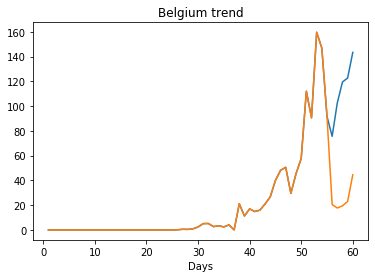

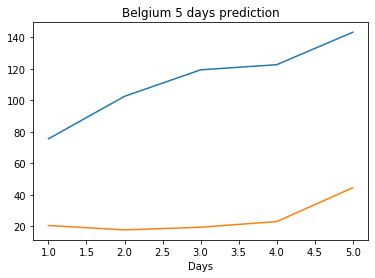

Creating directory ./offline8/Germany/training/
Germany
Saving the best model weights at Epoch [1], Best Valid Loss: 4316.4683
Saving the best model weights at Epoch [2], Best Valid Loss: 3530.7446
Saving the best model weights at Epoch [3], Best Valid Loss: 2616.9133
Saving the best model weights at Epoch [4], Best Valid Loss: 2009.3788
Saving the best model weights at Epoch [10], Best Valid Loss: 1761.0629
Saving the best model weights at Epoch [18], Best Valid Loss: 1726.1449
Saving the best model weights at Epoch [24], Best Valid Loss: 1645.8174
Saving the best model weights at Epoch [44], Best Valid Loss: 1585.5553
Saving the best model weights at Epoch [50], Best Valid Loss: 1534.0488
train error: 329.6657325667823
1534.048828125
Saving the best model weights at Epoch [1], Best Valid Loss: 2920.8247
Saving the best model weights at Epoch [9], Best Valid Loss: 2404.1362
Saving the best model weights at Epoch [12], Best Valid Loss: 2252.2559
train error: 609.6678128470031
2252.2558

Saving the best model weights at Epoch [15], Best Valid Loss: 1293.3026
train error: 546.7901565667355
1293.3026123046875
Saving the best model weights at Epoch [1], Best Valid Loss: 3241.3962
Saving the best model weights at Epoch [2], Best Valid Loss: 2835.3044
Saving the best model weights at Epoch [9], Best Valid Loss: 2746.4668
Saving the best model weights at Epoch [12], Best Valid Loss: 2121.2058
train error: 868.1779856489421
2121.205810546875
Saving the best model weights at Epoch [1], Best Valid Loss: 3674.9246
Saving the best model weights at Epoch [2], Best Valid Loss: 3516.4719
Saving the best model weights at Epoch [5], Best Valid Loss: 3372.4082
train error: 868.1779856489421
3372.408203125
Saving the best model weights at Epoch [1], Best Valid Loss: 4400.6089
Saving the best model weights at Epoch [2], Best Valid Loss: 3641.8032
Saving the best model weights at Epoch [3], Best Valid Loss: 779.9300
train error: 868.1779856489421
779.9299926757812
Saving the best model we

Saving the best model weights at Epoch [13], Best Valid Loss: 4295.7686
Saving the best model weights at Epoch [16], Best Valid Loss: 4254.6226
Saving the best model weights at Epoch [17], Best Valid Loss: 4220.3516
Saving the best model weights at Epoch [20], Best Valid Loss: 3738.4473
Saving the best model weights at Epoch [21], Best Valid Loss: 3357.1621
Saving the best model weights at Epoch [23], Best Valid Loss: 3304.8611
Saving the best model weights at Epoch [26], Best Valid Loss: 3185.7439
Saving the best model weights at Epoch [27], Best Valid Loss: 3171.5488
train error: 642.6944002093691
3171.548828125
Saving the best model weights at Epoch [1], Best Valid Loss: 4364.9668
Saving the best model weights at Epoch [3], Best Valid Loss: 4233.8540
Saving the best model weights at Epoch [9], Best Valid Loss: 4223.8555
Saving the best model weights at Epoch [28], Best Valid Loss: 4206.8916
Saving the best model weights at Epoch [44], Best Valid Loss: 4175.5781
Saving the best model

Saving the best model weights at Epoch [18], Best Valid Loss: 1636.7656
Saving the best model weights at Epoch [22], Best Valid Loss: 1470.7968
Saving the best model weights at Epoch [27], Best Valid Loss: 1353.7620
Saving the best model weights at Epoch [29], Best Valid Loss: 1259.1967
Saving the best model weights at Epoch [33], Best Valid Loss: 1239.6165
Saving the best model weights at Epoch [34], Best Valid Loss: 1118.8868
Saving the best model weights at Epoch [35], Best Valid Loss: 1045.9813
Saving the best model weights at Epoch [37], Best Valid Loss: 1023.0809
Saving the best model weights at Epoch [38], Best Valid Loss: 1013.8649
Saving the best model weights at Epoch [39], Best Valid Loss: 942.8305
Saving the best model weights at Epoch [40], Best Valid Loss: 782.2123
Saving the best model weights at Epoch [45], Best Valid Loss: 761.5095
Saving the best model weights at Epoch [46], Best Valid Loss: 738.3854
Saving the best model weights at Epoch [47], Best Valid Loss: 729.50

Saving the best model weights at Epoch [9], Best Valid Loss: 1737.9486
Saving the best model weights at Epoch [12], Best Valid Loss: 1615.5261
train error: 363.92192798238386
1615.526123046875
Saving the best model weights at Epoch [1], Best Valid Loss: 3089.4238
train error: 868.1779856489421
3089.423828125
Saving the best model weights at Epoch [1], Best Valid Loss: 5006.5679
Saving the best model weights at Epoch [2], Best Valid Loss: 2159.1853
Saving the best model weights at Epoch [11], Best Valid Loss: 2022.7438
Saving the best model weights at Epoch [13], Best Valid Loss: 1928.8812
Saving the best model weights at Epoch [18], Best Valid Loss: 1849.8037
Saving the best model weights at Epoch [21], Best Valid Loss: 1402.1205
Saving the best model weights at Epoch [22], Best Valid Loss: 1340.5116
Saving the best model weights at Epoch [23], Best Valid Loss: 1336.9086
Saving the best model weights at Epoch [27], Best Valid Loss: 1297.0526
Saving the best model weights at Epoch [28],

train error: 322.48412921031314
1143.1146240234375
Saving the best model weights at Epoch [1], Best Valid Loss: 4852.4556
Saving the best model weights at Epoch [2], Best Valid Loss: 3676.9673
Saving the best model weights at Epoch [3], Best Valid Loss: 3052.6299
Saving the best model weights at Epoch [5], Best Valid Loss: 2994.7224
Saving the best model weights at Epoch [9], Best Valid Loss: 2390.2629
Saving the best model weights at Epoch [24], Best Valid Loss: 2388.3098
Saving the best model weights at Epoch [31], Best Valid Loss: 2354.5403
Saving the best model weights at Epoch [36], Best Valid Loss: 1478.6794
Saving the best model weights at Epoch [37], Best Valid Loss: 1206.1991
Saving the best model weights at Epoch [40], Best Valid Loss: 922.8442
Saving the best model weights at Epoch [41], Best Valid Loss: 844.0303
Saving the best model weights at Epoch [47], Best Valid Loss: 732.4719
Saving the best model weights at Epoch [48], Best Valid Loss: 611.9458
Saving the best model 

Saving the best model weights at Epoch [2], Best Valid Loss: 4012.7290
Saving the best model weights at Epoch [3], Best Valid Loss: 3817.7454
Saving the best model weights at Epoch [8], Best Valid Loss: 3801.9890
Saving the best model weights at Epoch [12], Best Valid Loss: 3755.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 3674.8152
train error: 679.4252386382132
3674.815185546875
Saving the best model weights at Epoch [1], Best Valid Loss: 4874.2222
Saving the best model weights at Epoch [2], Best Valid Loss: 4447.7749
Saving the best model weights at Epoch [3], Best Valid Loss: 3912.9558
Saving the best model weights at Epoch [4], Best Valid Loss: 3459.8801
Saving the best model weights at Epoch [5], Best Valid Loss: 3407.6602
Saving the best model weights at Epoch [8], Best Valid Loss: 3308.9871
Saving the best model weights at Epoch [9], Best Valid Loss: 3178.1890
Saving the best model weights at Epoch [21], Best Valid Loss: 3072.4685
Saving the best model wei

Saving the best model weights at Epoch [4], Best Valid Loss: 4391.2104
Saving the best model weights at Epoch [5], Best Valid Loss: 4385.7070
Saving the best model weights at Epoch [6], Best Valid Loss: 4325.2012
Saving the best model weights at Epoch [7], Best Valid Loss: 4228.9038
Saving the best model weights at Epoch [9], Best Valid Loss: 4184.3315
Saving the best model weights at Epoch [16], Best Valid Loss: 4028.0291
Saving the best model weights at Epoch [20], Best Valid Loss: 3809.0774
Saving the best model weights at Epoch [21], Best Valid Loss: 3733.8328
Saving the best model weights at Epoch [31], Best Valid Loss: 3659.1477
Saving the best model weights at Epoch [32], Best Valid Loss: 3425.9595
Saving the best model weights at Epoch [33], Best Valid Loss: 3075.5300
Saving the best model weights at Epoch [34], Best Valid Loss: 2604.7559
train error: 722.479841521292
2604.755859375
Saving the best model weights at Epoch [1], Best Valid Loss: 4814.9917
Saving the best model wei

Saving the best model weights at Epoch [1], Best Valid Loss: 4513.6040
Saving the best model weights at Epoch [2], Best Valid Loss: 3642.3855
Saving the best model weights at Epoch [3], Best Valid Loss: 3441.9802
Saving the best model weights at Epoch [4], Best Valid Loss: 2683.7258
Saving the best model weights at Epoch [11], Best Valid Loss: 2407.6987
Saving the best model weights at Epoch [30], Best Valid Loss: 2406.3035
Saving the best model weights at Epoch [31], Best Valid Loss: 1890.6459
Saving the best model weights at Epoch [32], Best Valid Loss: 1815.1578
train error: 321.37290502317023
1815.1578369140625
Saving the best model weights at Epoch [1], Best Valid Loss: 4960.4136
Saving the best model weights at Epoch [2], Best Valid Loss: 4777.6499
Saving the best model weights at Epoch [3], Best Valid Loss: 4593.1812
Saving the best model weights at Epoch [4], Best Valid Loss: 4417.6855
Saving the best model weights at Epoch [5], Best Valid Loss: 4251.8853
Saving the best model 

Saving the best model weights at Epoch [1], Best Valid Loss: 4632.6611
Saving the best model weights at Epoch [2], Best Valid Loss: 3898.1716
Saving the best model weights at Epoch [3], Best Valid Loss: 3356.9614
Saving the best model weights at Epoch [4], Best Valid Loss: 2849.3384
Saving the best model weights at Epoch [5], Best Valid Loss: 2461.6113
Saving the best model weights at Epoch [6], Best Valid Loss: 2161.2473
Saving the best model weights at Epoch [8], Best Valid Loss: 2069.1003
Saving the best model weights at Epoch [10], Best Valid Loss: 1787.8199
Saving the best model weights at Epoch [13], Best Valid Loss: 1746.6282
train error: 218.51688984849235
1746.628173828125
Saving the best model weights at Epoch [1], Best Valid Loss: 3520.1980
Saving the best model weights at Epoch [2], Best Valid Loss: 2780.3955
Saving the best model weights at Epoch [3], Best Valid Loss: 2482.9451
Saving the best model weights at Epoch [7], Best Valid Loss: 2192.5032
Saving the best model wei

Saving the best model weights at Epoch [39], Best Valid Loss: 3654.0066
Saving the best model weights at Epoch [40], Best Valid Loss: 3583.4021
Saving the best model weights at Epoch [41], Best Valid Loss: 3520.5017
Saving the best model weights at Epoch [42], Best Valid Loss: 3464.0234
Saving the best model weights at Epoch [43], Best Valid Loss: 3403.1404
Saving the best model weights at Epoch [44], Best Valid Loss: 3341.2903
Saving the best model weights at Epoch [45], Best Valid Loss: 3288.5500
Saving the best model weights at Epoch [46], Best Valid Loss: 3258.1816
Saving the best model weights at Epoch [47], Best Valid Loss: 3186.1697
Saving the best model weights at Epoch [48], Best Valid Loss: 3138.0681
Saving the best model weights at Epoch [49], Best Valid Loss: 3091.8826
Saving the best model weights at Epoch [50], Best Valid Loss: 3052.7839
train error: 411.08124038802856
3052.783935546875
Saving the best model weights at Epoch [1], Best Valid Loss: 5129.6831
Saving the best

Saving the best model weights at Epoch [3], Best Valid Loss: 5042.3823
Saving the best model weights at Epoch [4], Best Valid Loss: 4997.0845
Saving the best model weights at Epoch [5], Best Valid Loss: 4934.7061
Saving the best model weights at Epoch [6], Best Valid Loss: 4848.0024
Saving the best model weights at Epoch [7], Best Valid Loss: 4719.8062
Saving the best model weights at Epoch [8], Best Valid Loss: 4566.7393
Saving the best model weights at Epoch [9], Best Valid Loss: 4430.0503
Saving the best model weights at Epoch [10], Best Valid Loss: 4285.8447
Saving the best model weights at Epoch [11], Best Valid Loss: 4176.8711
Saving the best model weights at Epoch [12], Best Valid Loss: 4067.0859
Saving the best model weights at Epoch [13], Best Valid Loss: 3889.0806
Saving the best model weights at Epoch [14], Best Valid Loss: 3713.7673
Saving the best model weights at Epoch [15], Best Valid Loss: 3645.7751
Saving the best model weights at Epoch [16], Best Valid Loss: 3375.8977

Saving the best model weights at Epoch [14], Best Valid Loss: 2343.8313
Saving the best model weights at Epoch [15], Best Valid Loss: 2294.2620
Saving the best model weights at Epoch [16], Best Valid Loss: 2259.5957
Saving the best model weights at Epoch [17], Best Valid Loss: 2195.1599
Saving the best model weights at Epoch [20], Best Valid Loss: 2193.8772
Saving the best model weights at Epoch [42], Best Valid Loss: 2131.0115
train error: 390.30444726987855
2131.011474609375
Saving the best model weights at Epoch [1], Best Valid Loss: 5037.8979
Saving the best model weights at Epoch [2], Best Valid Loss: 4765.1987
Saving the best model weights at Epoch [3], Best Valid Loss: 3951.7700
Saving the best model weights at Epoch [4], Best Valid Loss: 2849.0493
Saving the best model weights at Epoch [5], Best Valid Loss: 2079.7507
Saving the best model weights at Epoch [6], Best Valid Loss: 1860.8682
Saving the best model weights at Epoch [7], Best Valid Loss: 1546.7053
Saving the best model

Saving the best model weights at Epoch [33], Best Valid Loss: 4481.2578
Saving the best model weights at Epoch [34], Best Valid Loss: 4457.2808
Saving the best model weights at Epoch [35], Best Valid Loss: 4430.1392
Saving the best model weights at Epoch [36], Best Valid Loss: 4408.6201
Saving the best model weights at Epoch [37], Best Valid Loss: 4391.0596
Saving the best model weights at Epoch [38], Best Valid Loss: 4368.6094
Saving the best model weights at Epoch [39], Best Valid Loss: 4348.7759
Saving the best model weights at Epoch [40], Best Valid Loss: 4334.4678
Saving the best model weights at Epoch [41], Best Valid Loss: 4326.3643
Saving the best model weights at Epoch [42], Best Valid Loss: 4305.0151
Saving the best model weights at Epoch [43], Best Valid Loss: 4294.3130
Saving the best model weights at Epoch [44], Best Valid Loss: 4285.7471
Saving the best model weights at Epoch [45], Best Valid Loss: 4277.7197
Saving the best model weights at Epoch [46], Best Valid Loss: 42

Saving the best model weights at Epoch [40], Best Valid Loss: 1710.0192
Saving the best model weights at Epoch [44], Best Valid Loss: 1636.2688
Saving the best model weights at Epoch [45], Best Valid Loss: 1508.5520
train error: 324.1110737034769
1508.552001953125
Saving the best model weights at Epoch [1], Best Valid Loss: 5060.3120
Saving the best model weights at Epoch [2], Best Valid Loss: 4869.7944
Saving the best model weights at Epoch [3], Best Valid Loss: 4597.0854
Saving the best model weights at Epoch [4], Best Valid Loss: 4177.6401
Saving the best model weights at Epoch [5], Best Valid Loss: 3814.4226
Saving the best model weights at Epoch [6], Best Valid Loss: 3246.5388
Saving the best model weights at Epoch [14], Best Valid Loss: 3122.9893
Saving the best model weights at Epoch [15], Best Valid Loss: 2760.8567
Saving the best model weights at Epoch [16], Best Valid Loss: 2363.1453
Saving the best model weights at Epoch [17], Best Valid Loss: 2149.0347
Saving the best model

Saving the best model weights at Epoch [3], Best Valid Loss: 5100.4756
Saving the best model weights at Epoch [4], Best Valid Loss: 5086.0112
Saving the best model weights at Epoch [5], Best Valid Loss: 5071.6191
Saving the best model weights at Epoch [6], Best Valid Loss: 5057.1616
Saving the best model weights at Epoch [7], Best Valid Loss: 5042.5757
Saving the best model weights at Epoch [8], Best Valid Loss: 5027.9995
Saving the best model weights at Epoch [9], Best Valid Loss: 5012.6875
Saving the best model weights at Epoch [10], Best Valid Loss: 4997.1235
Saving the best model weights at Epoch [11], Best Valid Loss: 4980.9390
Saving the best model weights at Epoch [12], Best Valid Loss: 4964.1099
Saving the best model weights at Epoch [13], Best Valid Loss: 4945.8428
Saving the best model weights at Epoch [14], Best Valid Loss: 4926.4146
Saving the best model weights at Epoch [15], Best Valid Loss: 4905.2593
Saving the best model weights at Epoch [16], Best Valid Loss: 4867.8315

Saving the best model weights at Epoch [9], Best Valid Loss: 4507.9141
Saving the best model weights at Epoch [10], Best Valid Loss: 4415.2080
Saving the best model weights at Epoch [11], Best Valid Loss: 4332.3711
Saving the best model weights at Epoch [12], Best Valid Loss: 4234.7017
Saving the best model weights at Epoch [13], Best Valid Loss: 4144.7964
Saving the best model weights at Epoch [14], Best Valid Loss: 4062.9680
Saving the best model weights at Epoch [15], Best Valid Loss: 3989.0320
Saving the best model weights at Epoch [16], Best Valid Loss: 3927.5532
Saving the best model weights at Epoch [17], Best Valid Loss: 3862.7134
Saving the best model weights at Epoch [18], Best Valid Loss: 3807.2439
Saving the best model weights at Epoch [19], Best Valid Loss: 3762.8333
Saving the best model weights at Epoch [20], Best Valid Loss: 3710.8376
Saving the best model weights at Epoch [21], Best Valid Loss: 3678.6101
Saving the best model weights at Epoch [22], Best Valid Loss: 363

Saving the best model weights at Epoch [15], Best Valid Loss: 3961.6340
Saving the best model weights at Epoch [16], Best Valid Loss: 3875.7605
Saving the best model weights at Epoch [17], Best Valid Loss: 3786.7935
Saving the best model weights at Epoch [18], Best Valid Loss: 3706.9556
Saving the best model weights at Epoch [19], Best Valid Loss: 3661.4055
Saving the best model weights at Epoch [20], Best Valid Loss: 3639.3594
Saving the best model weights at Epoch [21], Best Valid Loss: 3575.1443
Saving the best model weights at Epoch [22], Best Valid Loss: 3542.2839
Saving the best model weights at Epoch [23], Best Valid Loss: 3500.2739
Saving the best model weights at Epoch [24], Best Valid Loss: 3477.9812
Saving the best model weights at Epoch [25], Best Valid Loss: 3374.0886
Saving the best model weights at Epoch [26], Best Valid Loss: 3230.3093
Saving the best model weights at Epoch [27], Best Valid Loss: 3053.4119
Saving the best model weights at Epoch [28], Best Valid Loss: 28

Saving the best model weights at Epoch [7], Best Valid Loss: 3601.0806
Saving the best model weights at Epoch [8], Best Valid Loss: 3102.2478
Saving the best model weights at Epoch [13], Best Valid Loss: 2942.6130
Saving the best model weights at Epoch [27], Best Valid Loss: 2805.3435
Saving the best model weights at Epoch [29], Best Valid Loss: 2519.1194
Saving the best model weights at Epoch [30], Best Valid Loss: 2384.7322
Saving the best model weights at Epoch [32], Best Valid Loss: 2262.3669
Saving the best model weights at Epoch [34], Best Valid Loss: 2222.6367
Saving the best model weights at Epoch [35], Best Valid Loss: 2185.7141
Saving the best model weights at Epoch [36], Best Valid Loss: 1794.2520
Saving the best model weights at Epoch [44], Best Valid Loss: 1640.9252
train error: 537.2340675122811
1640.9251708984375
Saving the best model weights at Epoch [1], Best Valid Loss: 5130.5713
Saving the best model weights at Epoch [2], Best Valid Loss: 5115.7764
Saving the best mo

Saving the best model weights at Epoch [33], Best Valid Loss: 3323.4719
Saving the best model weights at Epoch [34], Best Valid Loss: 3293.3347
Saving the best model weights at Epoch [35], Best Valid Loss: 3266.6418
Saving the best model weights at Epoch [36], Best Valid Loss: 3242.3926
Saving the best model weights at Epoch [37], Best Valid Loss: 3220.4011
Saving the best model weights at Epoch [38], Best Valid Loss: 3199.0840
Saving the best model weights at Epoch [39], Best Valid Loss: 3180.9226
Saving the best model weights at Epoch [40], Best Valid Loss: 3161.0530
Saving the best model weights at Epoch [41], Best Valid Loss: 3144.9785
Saving the best model weights at Epoch [42], Best Valid Loss: 3129.6501
Saving the best model weights at Epoch [43], Best Valid Loss: 3117.1113
Saving the best model weights at Epoch [44], Best Valid Loss: 3107.7817
Saving the best model weights at Epoch [45], Best Valid Loss: 3097.5557
Saving the best model weights at Epoch [46], Best Valid Loss: 30

Saving the best model weights at Epoch [32], Best Valid Loss: 4035.7527
Saving the best model weights at Epoch [33], Best Valid Loss: 4019.2075
Saving the best model weights at Epoch [34], Best Valid Loss: 4003.3787
Saving the best model weights at Epoch [35], Best Valid Loss: 3989.0962
Saving the best model weights at Epoch [36], Best Valid Loss: 3978.3657
Saving the best model weights at Epoch [37], Best Valid Loss: 3967.7961
Saving the best model weights at Epoch [38], Best Valid Loss: 3961.6399
Saving the best model weights at Epoch [39], Best Valid Loss: 3953.9434
Saving the best model weights at Epoch [40], Best Valid Loss: 3947.9336
Saving the best model weights at Epoch [41], Best Valid Loss: 3940.7485
Saving the best model weights at Epoch [42], Best Valid Loss: 3934.7993
Saving the best model weights at Epoch [43], Best Valid Loss: 3929.7429
Saving the best model weights at Epoch [44], Best Valid Loss: 3927.9661
Saving the best model weights at Epoch [45], Best Valid Loss: 39

Saving the best model weights at Epoch [46], Best Valid Loss: 4276.8237
Saving the best model weights at Epoch [47], Best Valid Loss: 4222.6870
Saving the best model weights at Epoch [48], Best Valid Loss: 4170.7944
Saving the best model weights at Epoch [49], Best Valid Loss: 4122.8657
Saving the best model weights at Epoch [50], Best Valid Loss: 4079.1189
train error: 682.3666780645198
4079.118896484375
Saving the best model weights at Epoch [1], Best Valid Loss: 5114.2100
Saving the best model weights at Epoch [2], Best Valid Loss: 5083.4170
Saving the best model weights at Epoch [3], Best Valid Loss: 5052.1226
Saving the best model weights at Epoch [4], Best Valid Loss: 5021.5352
Saving the best model weights at Epoch [5], Best Valid Loss: 4986.2495
Saving the best model weights at Epoch [6], Best Valid Loss: 4950.0479
Saving the best model weights at Epoch [7], Best Valid Loss: 4913.9517
Saving the best model weights at Epoch [8], Best Valid Loss: 4867.9058
Saving the best model w

Saving the best model weights at Epoch [7], Best Valid Loss: 4918.9316
Saving the best model weights at Epoch [8], Best Valid Loss: 4855.6562
Saving the best model weights at Epoch [9], Best Valid Loss: 4787.3066
Saving the best model weights at Epoch [10], Best Valid Loss: 4713.8159
Saving the best model weights at Epoch [11], Best Valid Loss: 4626.0210
Saving the best model weights at Epoch [12], Best Valid Loss: 4525.2524
Saving the best model weights at Epoch [13], Best Valid Loss: 4436.5640
Saving the best model weights at Epoch [14], Best Valid Loss: 4333.1968
Saving the best model weights at Epoch [15], Best Valid Loss: 4248.5874
Saving the best model weights at Epoch [16], Best Valid Loss: 4159.4141
Saving the best model weights at Epoch [17], Best Valid Loss: 4084.5603
Saving the best model weights at Epoch [18], Best Valid Loss: 4031.4041
Saving the best model weights at Epoch [19], Best Valid Loss: 3989.4314
Saving the best model weights at Epoch [20], Best Valid Loss: 3959.

Saving the best model weights at Epoch [23], Best Valid Loss: 4833.4712
Saving the best model weights at Epoch [24], Best Valid Loss: 4814.7925
Saving the best model weights at Epoch [25], Best Valid Loss: 4797.2554
Saving the best model weights at Epoch [26], Best Valid Loss: 4780.3335
Saving the best model weights at Epoch [27], Best Valid Loss: 4762.5249
Saving the best model weights at Epoch [28], Best Valid Loss: 4744.7954
Saving the best model weights at Epoch [29], Best Valid Loss: 4728.9531
Saving the best model weights at Epoch [30], Best Valid Loss: 4711.0415
Saving the best model weights at Epoch [31], Best Valid Loss: 4694.0249
Saving the best model weights at Epoch [32], Best Valid Loss: 4677.4653
Saving the best model weights at Epoch [33], Best Valid Loss: 4660.4077
Saving the best model weights at Epoch [34], Best Valid Loss: 4644.3511
Saving the best model weights at Epoch [35], Best Valid Loss: 4628.3887
Saving the best model weights at Epoch [36], Best Valid Loss: 46

Saving the best model weights at Epoch [47], Best Valid Loss: 3772.2844
Saving the best model weights at Epoch [48], Best Valid Loss: 3746.2283
Saving the best model weights at Epoch [49], Best Valid Loss: 3720.7864
Saving the best model weights at Epoch [50], Best Valid Loss: 3695.2739
train error: 525.0506715024962
3695.27392578125
Saving the best model weights at Epoch [1], Best Valid Loss: 5118.9565
Saving the best model weights at Epoch [2], Best Valid Loss: 5101.6338
Saving the best model weights at Epoch [3], Best Valid Loss: 5070.7222
Saving the best model weights at Epoch [4], Best Valid Loss: 5030.3135
Saving the best model weights at Epoch [5], Best Valid Loss: 4988.5830
Saving the best model weights at Epoch [6], Best Valid Loss: 4944.7476
Saving the best model weights at Epoch [7], Best Valid Loss: 4892.7002
Saving the best model weights at Epoch [8], Best Valid Loss: 4850.0562
Saving the best model weights at Epoch [9], Best Valid Loss: 4801.0347
Saving the best model wei

Saving the best model weights at Epoch [13], Best Valid Loss: 4478.7515
Saving the best model weights at Epoch [14], Best Valid Loss: 4424.8447
Saving the best model weights at Epoch [15], Best Valid Loss: 4369.2183
Saving the best model weights at Epoch [16], Best Valid Loss: 4314.9849
Saving the best model weights at Epoch [17], Best Valid Loss: 4261.8638
Saving the best model weights at Epoch [18], Best Valid Loss: 4212.7861
Saving the best model weights at Epoch [19], Best Valid Loss: 4163.5049
Saving the best model weights at Epoch [20], Best Valid Loss: 4101.1143
Saving the best model weights at Epoch [21], Best Valid Loss: 4050.5552
Saving the best model weights at Epoch [22], Best Valid Loss: 4000.6855
Saving the best model weights at Epoch [23], Best Valid Loss: 3951.8000
Saving the best model weights at Epoch [24], Best Valid Loss: 3903.8176
Saving the best model weights at Epoch [25], Best Valid Loss: 3857.0435
Saving the best model weights at Epoch [26], Best Valid Loss: 38

Saving the best model weights at Epoch [30], Best Valid Loss: 1188.0996
Saving the best model weights at Epoch [31], Best Valid Loss: 1146.4153
Saving the best model weights at Epoch [35], Best Valid Loss: 1103.9432
Saving the best model weights at Epoch [36], Best Valid Loss: 1073.8420
Saving the best model weights at Epoch [39], Best Valid Loss: 989.7804
Saving the best model weights at Epoch [40], Best Valid Loss: 972.0646
train error: 103.39677204931805
972.0646362304688
Saving the best model weights at Epoch [1], Best Valid Loss: 5084.7095
Saving the best model weights at Epoch [2], Best Valid Loss: 5032.3125
Saving the best model weights at Epoch [3], Best Valid Loss: 4972.7554
Saving the best model weights at Epoch [4], Best Valid Loss: 4904.2114
Saving the best model weights at Epoch [5], Best Valid Loss: 4832.3491
Saving the best model weights at Epoch [6], Best Valid Loss: 4755.4619
Saving the best model weights at Epoch [7], Best Valid Loss: 4671.9897
Saving the best model w

Saving the best model weights at Epoch [8], Best Valid Loss: 2860.7000
Saving the best model weights at Epoch [9], Best Valid Loss: 2679.3640
Saving the best model weights at Epoch [10], Best Valid Loss: 2426.4907
Saving the best model weights at Epoch [11], Best Valid Loss: 2301.2773
Saving the best model weights at Epoch [12], Best Valid Loss: 2154.9536
Saving the best model weights at Epoch [13], Best Valid Loss: 1873.0604
Saving the best model weights at Epoch [14], Best Valid Loss: 1740.3678
Saving the best model weights at Epoch [15], Best Valid Loss: 1539.7906
Saving the best model weights at Epoch [16], Best Valid Loss: 1424.8392
Saving the best model weights at Epoch [19], Best Valid Loss: 1277.4469
Saving the best model weights at Epoch [20], Best Valid Loss: 1209.7152
Saving the best model weights at Epoch [22], Best Valid Loss: 1161.0178
Saving the best model weights at Epoch [23], Best Valid Loss: 1086.9539
Saving the best model weights at Epoch [24], Best Valid Loss: 1027

Saving the best model weights at Epoch [45], Best Valid Loss: 5021.6235
Saving the best model weights at Epoch [46], Best Valid Loss: 5018.5288
Saving the best model weights at Epoch [47], Best Valid Loss: 5015.2046
Saving the best model weights at Epoch [48], Best Valid Loss: 5011.9619
Saving the best model weights at Epoch [49], Best Valid Loss: 5008.6221
Saving the best model weights at Epoch [50], Best Valid Loss: 5005.3120
train error: 815.3608189107794
5005.31201171875
Saving the best model weights at Epoch [1], Best Valid Loss: 5125.0557
Saving the best model weights at Epoch [2], Best Valid Loss: 5100.9062
Saving the best model weights at Epoch [3], Best Valid Loss: 5079.2715
Saving the best model weights at Epoch [4], Best Valid Loss: 5059.2886
Saving the best model weights at Epoch [5], Best Valid Loss: 5035.7065
Saving the best model weights at Epoch [6], Best Valid Loss: 5009.9033
Saving the best model weights at Epoch [7], Best Valid Loss: 4985.5078
Saving the best model w

Saving the best model weights at Epoch [16], Best Valid Loss: 5124.4897
Saving the best model weights at Epoch [17], Best Valid Loss: 5123.1431
Saving the best model weights at Epoch [18], Best Valid Loss: 5121.8125
Saving the best model weights at Epoch [19], Best Valid Loss: 5120.4219
Saving the best model weights at Epoch [20], Best Valid Loss: 5119.0312
Saving the best model weights at Epoch [21], Best Valid Loss: 5117.6431
Saving the best model weights at Epoch [22], Best Valid Loss: 5116.2695
Saving the best model weights at Epoch [23], Best Valid Loss: 5114.9854
Saving the best model weights at Epoch [24], Best Valid Loss: 5113.5898
Saving the best model weights at Epoch [25], Best Valid Loss: 5112.2178
Saving the best model weights at Epoch [26], Best Valid Loss: 5110.8687
Saving the best model weights at Epoch [27], Best Valid Loss: 5109.5049
Saving the best model weights at Epoch [28], Best Valid Loss: 5108.0903
Saving the best model weights at Epoch [29], Best Valid Loss: 51

Saving the best model weights at Epoch [49], Best Valid Loss: 4884.3472
Saving the best model weights at Epoch [50], Best Valid Loss: 4872.4810
train error: 786.1386886139711
4872.48095703125
Saving the best model weights at Epoch [1], Best Valid Loss: 5136.9204
Saving the best model weights at Epoch [2], Best Valid Loss: 5131.0083
Saving the best model weights at Epoch [3], Best Valid Loss: 5124.2769
Saving the best model weights at Epoch [4], Best Valid Loss: 5119.1030
Saving the best model weights at Epoch [5], Best Valid Loss: 5113.4995
Saving the best model weights at Epoch [6], Best Valid Loss: 5107.7456
Saving the best model weights at Epoch [7], Best Valid Loss: 5101.6729
Saving the best model weights at Epoch [8], Best Valid Loss: 5095.2827
Saving the best model weights at Epoch [9], Best Valid Loss: 5089.3970
Saving the best model weights at Epoch [10], Best Valid Loss: 5083.1250
Saving the best model weights at Epoch [11], Best Valid Loss: 5077.2617
Saving the best model wei

Saving the best model weights at Epoch [30], Best Valid Loss: 4951.0898
Saving the best model weights at Epoch [31], Best Valid Loss: 4937.4878
Saving the best model weights at Epoch [32], Best Valid Loss: 4923.0220
Saving the best model weights at Epoch [33], Best Valid Loss: 4907.5366
Saving the best model weights at Epoch [34], Best Valid Loss: 4890.9893
Saving the best model weights at Epoch [35], Best Valid Loss: 4873.4307
Saving the best model weights at Epoch [36], Best Valid Loss: 4854.5210
Saving the best model weights at Epoch [37], Best Valid Loss: 4833.8662
Saving the best model weights at Epoch [38], Best Valid Loss: 4812.4229
Saving the best model weights at Epoch [39], Best Valid Loss: 4788.9829
Saving the best model weights at Epoch [40], Best Valid Loss: 4762.8647
Saving the best model weights at Epoch [41], Best Valid Loss: 4734.7954
Saving the best model weights at Epoch [42], Best Valid Loss: 4705.5249
Saving the best model weights at Epoch [43], Best Valid Loss: 46

Saving the best model weights at Epoch [21], Best Valid Loss: 5109.8354
Saving the best model weights at Epoch [22], Best Valid Loss: 5108.2681
Saving the best model weights at Epoch [23], Best Valid Loss: 5106.7183
Saving the best model weights at Epoch [24], Best Valid Loss: 5105.1675
Saving the best model weights at Epoch [25], Best Valid Loss: 5103.6299
Saving the best model weights at Epoch [26], Best Valid Loss: 5102.0723
Saving the best model weights at Epoch [27], Best Valid Loss: 5100.5273
Saving the best model weights at Epoch [28], Best Valid Loss: 5098.9805
Saving the best model weights at Epoch [29], Best Valid Loss: 5097.4355
Saving the best model weights at Epoch [30], Best Valid Loss: 5095.8931
Saving the best model weights at Epoch [31], Best Valid Loss: 5094.3574
Saving the best model weights at Epoch [32], Best Valid Loss: 5092.8149
Saving the best model weights at Epoch [33], Best Valid Loss: 5091.2651
Saving the best model weights at Epoch [34], Best Valid Loss: 50

Saving the best model weights at Epoch [34], Best Valid Loss: 3634.7830
Saving the best model weights at Epoch [35], Best Valid Loss: 3560.1033
Saving the best model weights at Epoch [36], Best Valid Loss: 3531.9568
Saving the best model weights at Epoch [37], Best Valid Loss: 3463.1257
Saving the best model weights at Epoch [38], Best Valid Loss: 3448.5767
Saving the best model weights at Epoch [39], Best Valid Loss: 3390.3826
Saving the best model weights at Epoch [40], Best Valid Loss: 3330.5532
Saving the best model weights at Epoch [41], Best Valid Loss: 3322.1248
Saving the best model weights at Epoch [42], Best Valid Loss: 3256.2500
Saving the best model weights at Epoch [43], Best Valid Loss: 3224.7212
Saving the best model weights at Epoch [44], Best Valid Loss: 3177.2441
Saving the best model weights at Epoch [45], Best Valid Loss: 3108.1599
Saving the best model weights at Epoch [46], Best Valid Loss: 3083.6909
Saving the best model weights at Epoch [47], Best Valid Loss: 30

Saving the best model weights at Epoch [48], Best Valid Loss: 5091.0425
Saving the best model weights at Epoch [49], Best Valid Loss: 5089.9058
Saving the best model weights at Epoch [50], Best Valid Loss: 5088.8589
train error: 858.733796237093
5088.85888671875
Saving the best model weights at Epoch [1], Best Valid Loss: 5135.0098
Saving the best model weights at Epoch [2], Best Valid Loss: 5121.4639
Saving the best model weights at Epoch [3], Best Valid Loss: 5109.1128
Saving the best model weights at Epoch [4], Best Valid Loss: 5095.4722
Saving the best model weights at Epoch [5], Best Valid Loss: 5083.4839
Saving the best model weights at Epoch [6], Best Valid Loss: 5070.0967
Saving the best model weights at Epoch [7], Best Valid Loss: 5058.6792
Saving the best model weights at Epoch [8], Best Valid Loss: 5046.4038
Saving the best model weights at Epoch [9], Best Valid Loss: 5033.8286
Saving the best model weights at Epoch [10], Best Valid Loss: 5020.6890
Saving the best model weig

Saving the best model weights at Epoch [13], Best Valid Loss: 5092.0010
Saving the best model weights at Epoch [14], Best Valid Loss: 5087.9448
Saving the best model weights at Epoch [15], Best Valid Loss: 5084.0469
Saving the best model weights at Epoch [16], Best Valid Loss: 5080.1025
Saving the best model weights at Epoch [17], Best Valid Loss: 5076.0791
Saving the best model weights at Epoch [18], Best Valid Loss: 5072.2139
Saving the best model weights at Epoch [19], Best Valid Loss: 5068.2832
Saving the best model weights at Epoch [20], Best Valid Loss: 5064.3711
Saving the best model weights at Epoch [21], Best Valid Loss: 5060.3838
Saving the best model weights at Epoch [22], Best Valid Loss: 5056.3604
Saving the best model weights at Epoch [23], Best Valid Loss: 5052.4038
Saving the best model weights at Epoch [24], Best Valid Loss: 5048.3359
Saving the best model weights at Epoch [25], Best Valid Loss: 5044.3057
Saving the best model weights at Epoch [26], Best Valid Loss: 50

Saving the best model weights at Epoch [34], Best Valid Loss: 5034.1226
Saving the best model weights at Epoch [35], Best Valid Loss: 5030.7837
Saving the best model weights at Epoch [36], Best Valid Loss: 5027.4307
Saving the best model weights at Epoch [37], Best Valid Loss: 5024.0581
Saving the best model weights at Epoch [38], Best Valid Loss: 5020.6489
Saving the best model weights at Epoch [39], Best Valid Loss: 5017.2339
Saving the best model weights at Epoch [40], Best Valid Loss: 5013.8394
Saving the best model weights at Epoch [41], Best Valid Loss: 5010.3315
Saving the best model weights at Epoch [42], Best Valid Loss: 5006.8682
Saving the best model weights at Epoch [43], Best Valid Loss: 5003.3394
Saving the best model weights at Epoch [44], Best Valid Loss: 4999.7920
Saving the best model weights at Epoch [45], Best Valid Loss: 4996.2241
Saving the best model weights at Epoch [46], Best Valid Loss: 4992.6353
Saving the best model weights at Epoch [47], Best Valid Loss: 49

Saving the best model weights at Epoch [20], Best Valid Loss: 5087.6914
Saving the best model weights at Epoch [21], Best Valid Loss: 5085.4268
Saving the best model weights at Epoch [22], Best Valid Loss: 5083.1934
Saving the best model weights at Epoch [23], Best Valid Loss: 5080.9126
Saving the best model weights at Epoch [24], Best Valid Loss: 5078.6631
Saving the best model weights at Epoch [25], Best Valid Loss: 5076.4238
Saving the best model weights at Epoch [26], Best Valid Loss: 5074.1763
Saving the best model weights at Epoch [27], Best Valid Loss: 5071.9214
Saving the best model weights at Epoch [28], Best Valid Loss: 5069.6499
Saving the best model weights at Epoch [29], Best Valid Loss: 5067.4028
Saving the best model weights at Epoch [30], Best Valid Loss: 5065.1538
Saving the best model weights at Epoch [31], Best Valid Loss: 5062.9058
Saving the best model weights at Epoch [32], Best Valid Loss: 5060.6616
Saving the best model weights at Epoch [33], Best Valid Loss: 50

Saving the best model weights at Epoch [33], Best Valid Loss: 4576.7363
Saving the best model weights at Epoch [34], Best Valid Loss: 4562.8218
Saving the best model weights at Epoch [35], Best Valid Loss: 4539.5962
Saving the best model weights at Epoch [36], Best Valid Loss: 4528.5767
Saving the best model weights at Epoch [37], Best Valid Loss: 4507.7563
Saving the best model weights at Epoch [38], Best Valid Loss: 4496.4590
Saving the best model weights at Epoch [39], Best Valid Loss: 4477.5771
Saving the best model weights at Epoch [40], Best Valid Loss: 4468.4961
Saving the best model weights at Epoch [41], Best Valid Loss: 4451.2202
Saving the best model weights at Epoch [42], Best Valid Loss: 4445.1831
Saving the best model weights at Epoch [43], Best Valid Loss: 4433.4800
Saving the best model weights at Epoch [44], Best Valid Loss: 4421.1440
Saving the best model weights at Epoch [45], Best Valid Loss: 4405.5259
Saving the best model weights at Epoch [46], Best Valid Loss: 44

Saving the best model weights at Epoch [46], Best Valid Loss: 2146.2747
Saving the best model weights at Epoch [48], Best Valid Loss: 2053.4812
Saving the best model weights at Epoch [49], Best Valid Loss: 1939.0829
Saving the best model weights at Epoch [50], Best Valid Loss: 1846.5559
train error: 222.57473454511526
1846.555908203125
Saving the best model weights at Epoch [1], Best Valid Loss: 5140.9365
Saving the best model weights at Epoch [2], Best Valid Loss: 5139.4644
Saving the best model weights at Epoch [3], Best Valid Loss: 5138.0015
Saving the best model weights at Epoch [4], Best Valid Loss: 5136.5229
Saving the best model weights at Epoch [5], Best Valid Loss: 5135.0542
Saving the best model weights at Epoch [6], Best Valid Loss: 5133.5952
Saving the best model weights at Epoch [7], Best Valid Loss: 5132.1309
Saving the best model weights at Epoch [8], Best Valid Loss: 5130.6807
Saving the best model weights at Epoch [9], Best Valid Loss: 5129.2197
Saving the best model w

Saving the best model weights at Epoch [10], Best Valid Loss: 5011.1040
Saving the best model weights at Epoch [11], Best Valid Loss: 4997.1636
Saving the best model weights at Epoch [12], Best Valid Loss: 4979.6362
Saving the best model weights at Epoch [13], Best Valid Loss: 4964.5957
Saving the best model weights at Epoch [14], Best Valid Loss: 4948.2812
Saving the best model weights at Epoch [15], Best Valid Loss: 4933.0327
Saving the best model weights at Epoch [16], Best Valid Loss: 4914.7412
Saving the best model weights at Epoch [17], Best Valid Loss: 4897.1343
Saving the best model weights at Epoch [18], Best Valid Loss: 4879.7788
Saving the best model weights at Epoch [19], Best Valid Loss: 4860.4731
Saving the best model weights at Epoch [20], Best Valid Loss: 4838.0796
Saving the best model weights at Epoch [21], Best Valid Loss: 4821.1982
Saving the best model weights at Epoch [22], Best Valid Loss: 4794.6128
Saving the best model weights at Epoch [23], Best Valid Loss: 47

Saving the best model weights at Epoch [23], Best Valid Loss: 5011.1499
Saving the best model weights at Epoch [24], Best Valid Loss: 5005.1929
Saving the best model weights at Epoch [25], Best Valid Loss: 4999.0938
Saving the best model weights at Epoch [26], Best Valid Loss: 4993.1470
Saving the best model weights at Epoch [27], Best Valid Loss: 4987.3999
Saving the best model weights at Epoch [28], Best Valid Loss: 4980.9634
Saving the best model weights at Epoch [29], Best Valid Loss: 4974.7148
Saving the best model weights at Epoch [30], Best Valid Loss: 4968.5386
Saving the best model weights at Epoch [31], Best Valid Loss: 4962.2046
Saving the best model weights at Epoch [32], Best Valid Loss: 4956.1494
Saving the best model weights at Epoch [33], Best Valid Loss: 4949.6875
Saving the best model weights at Epoch [34], Best Valid Loss: 4943.1133
Saving the best model weights at Epoch [35], Best Valid Loss: 4936.6216
Saving the best model weights at Epoch [36], Best Valid Loss: 49

Saving the best model weights at Epoch [36], Best Valid Loss: 5051.0127
Saving the best model weights at Epoch [37], Best Valid Loss: 5048.7583
Saving the best model weights at Epoch [38], Best Valid Loss: 5046.5039
Saving the best model weights at Epoch [39], Best Valid Loss: 5044.2666
Saving the best model weights at Epoch [40], Best Valid Loss: 5042.0049
Saving the best model weights at Epoch [41], Best Valid Loss: 5039.7588
Saving the best model weights at Epoch [42], Best Valid Loss: 5037.5190
Saving the best model weights at Epoch [43], Best Valid Loss: 5035.2847
Saving the best model weights at Epoch [44], Best Valid Loss: 5033.0156
Saving the best model weights at Epoch [45], Best Valid Loss: 5030.7764
Saving the best model weights at Epoch [46], Best Valid Loss: 5028.5444
Saving the best model weights at Epoch [47], Best Valid Loss: 5026.2861
Saving the best model weights at Epoch [48], Best Valid Loss: 5024.0459
Saving the best model weights at Epoch [49], Best Valid Loss: 50

Saving the best model weights at Epoch [49], Best Valid Loss: 3901.2539
Saving the best model weights at Epoch [50], Best Valid Loss: 3886.8574
train error: 653.6857240850276
3886.857421875
Saving the best model weights at Epoch [1], Best Valid Loss: 5134.4077
Saving the best model weights at Epoch [2], Best Valid Loss: 5131.9741
Saving the best model weights at Epoch [3], Best Valid Loss: 5129.5698
Saving the best model weights at Epoch [4], Best Valid Loss: 5127.1147
Saving the best model weights at Epoch [5], Best Valid Loss: 5124.7031
Saving the best model weights at Epoch [6], Best Valid Loss: 5122.2603
Saving the best model weights at Epoch [7], Best Valid Loss: 5119.8369
Saving the best model weights at Epoch [8], Best Valid Loss: 5117.4136
Saving the best model weights at Epoch [9], Best Valid Loss: 5114.9946
Saving the best model weights at Epoch [10], Best Valid Loss: 5112.5820
Saving the best model weights at Epoch [11], Best Valid Loss: 5110.1641
Saving the best model weigh

Saving the best model weights at Epoch [12], Best Valid Loss: 4861.4858
Saving the best model weights at Epoch [13], Best Valid Loss: 4830.6758
Saving the best model weights at Epoch [14], Best Valid Loss: 4796.7378
Saving the best model weights at Epoch [15], Best Valid Loss: 4755.8672
Saving the best model weights at Epoch [16], Best Valid Loss: 4705.6138
Saving the best model weights at Epoch [17], Best Valid Loss: 4658.7021
Saving the best model weights at Epoch [18], Best Valid Loss: 4601.1543
Saving the best model weights at Epoch [19], Best Valid Loss: 4543.6484
Saving the best model weights at Epoch [20], Best Valid Loss: 4480.7861
Saving the best model weights at Epoch [21], Best Valid Loss: 4425.3472
Saving the best model weights at Epoch [22], Best Valid Loss: 4353.5518
Saving the best model weights at Epoch [23], Best Valid Loss: 4289.2993
Saving the best model weights at Epoch [24], Best Valid Loss: 4235.6860
Saving the best model weights at Epoch [25], Best Valid Loss: 41

Saving the best model weights at Epoch [29], Best Valid Loss: 5067.9868
Saving the best model weights at Epoch [30], Best Valid Loss: 5065.2261
Saving the best model weights at Epoch [31], Best Valid Loss: 5062.6421
Saving the best model weights at Epoch [32], Best Valid Loss: 5059.9370
Saving the best model weights at Epoch [33], Best Valid Loss: 5057.1035
Saving the best model weights at Epoch [34], Best Valid Loss: 5054.5015
Saving the best model weights at Epoch [35], Best Valid Loss: 5051.7964
Saving the best model weights at Epoch [36], Best Valid Loss: 5049.0103
Saving the best model weights at Epoch [37], Best Valid Loss: 5046.2607
Saving the best model weights at Epoch [38], Best Valid Loss: 5043.5249
Saving the best model weights at Epoch [39], Best Valid Loss: 5040.8491
Saving the best model weights at Epoch [40], Best Valid Loss: 5037.9893
Saving the best model weights at Epoch [41], Best Valid Loss: 5035.2744
Saving the best model weights at Epoch [42], Best Valid Loss: 50

Saving the best model weights at Epoch [42], Best Valid Loss: 5091.3491
Saving the best model weights at Epoch [43], Best Valid Loss: 5090.0166
Saving the best model weights at Epoch [44], Best Valid Loss: 5088.6987
Saving the best model weights at Epoch [45], Best Valid Loss: 5087.3682
Saving the best model weights at Epoch [46], Best Valid Loss: 5086.0425
Saving the best model weights at Epoch [47], Best Valid Loss: 5084.7280
Saving the best model weights at Epoch [48], Best Valid Loss: 5083.3926
Saving the best model weights at Epoch [49], Best Valid Loss: 5082.0586
Saving the best model weights at Epoch [50], Best Valid Loss: 5080.7402
train error: 849.6012218287497
5080.740234375
Saving the best model weights at Epoch [1], Best Valid Loss: 5141.1616
Saving the best model weights at Epoch [2], Best Valid Loss: 5138.2617
Saving the best model weights at Epoch [3], Best Valid Loss: 5135.3999
Saving the best model weights at Epoch [4], Best Valid Loss: 5132.5488
Saving the best model 

Saving the best model weights at Epoch [6], Best Valid Loss: 5139.2319
Saving the best model weights at Epoch [13], Best Valid Loss: 5139.1206
Saving the best model weights at Epoch [14], Best Valid Loss: 5138.9243
Saving the best model weights at Epoch [15], Best Valid Loss: 5138.7319
Saving the best model weights at Epoch [16], Best Valid Loss: 5138.5361
Saving the best model weights at Epoch [17], Best Valid Loss: 5138.1406
Saving the best model weights at Epoch [18], Best Valid Loss: 5137.7593
Saving the best model weights at Epoch [19], Best Valid Loss: 5137.3750
Saving the best model weights at Epoch [20], Best Valid Loss: 5137.0010
Saving the best model weights at Epoch [21], Best Valid Loss: 5136.5845
Saving the best model weights at Epoch [22], Best Valid Loss: 5136.1812
Saving the best model weights at Epoch [23], Best Valid Loss: 5135.7808
Saving the best model weights at Epoch [24], Best Valid Loss: 5135.3882
Saving the best model weights at Epoch [25], Best Valid Loss: 513

Saving the best model weights at Epoch [25], Best Valid Loss: 5056.9399
Saving the best model weights at Epoch [26], Best Valid Loss: 5053.2925
Saving the best model weights at Epoch [27], Best Valid Loss: 5050.9126
Saving the best model weights at Epoch [28], Best Valid Loss: 5047.2324
Saving the best model weights at Epoch [29], Best Valid Loss: 5044.3320
Saving the best model weights at Epoch [30], Best Valid Loss: 5041.2319
Saving the best model weights at Epoch [31], Best Valid Loss: 5037.2539
Saving the best model weights at Epoch [32], Best Valid Loss: 5029.8452
Saving the best model weights at Epoch [33], Best Valid Loss: 5014.7588
Saving the best model weights at Epoch [34], Best Valid Loss: 4994.1978
Saving the best model weights at Epoch [35], Best Valid Loss: 4978.5698
Saving the best model weights at Epoch [36], Best Valid Loss: 4965.5034
Saving the best model weights at Epoch [37], Best Valid Loss: 4956.6382
Saving the best model weights at Epoch [38], Best Valid Loss: 49

Saving the best model weights at Epoch [38], Best Valid Loss: 4975.0127
Saving the best model weights at Epoch [39], Best Valid Loss: 4969.5908
Saving the best model weights at Epoch [40], Best Valid Loss: 4964.1597
Saving the best model weights at Epoch [41], Best Valid Loss: 4957.7495
Saving the best model weights at Epoch [42], Best Valid Loss: 4950.8940
Saving the best model weights at Epoch [43], Best Valid Loss: 4943.8950
Saving the best model weights at Epoch [44], Best Valid Loss: 4937.4697
Saving the best model weights at Epoch [45], Best Valid Loss: 4931.3296
Saving the best model weights at Epoch [46], Best Valid Loss: 4925.4092
Saving the best model weights at Epoch [47], Best Valid Loss: 4919.8550
Saving the best model weights at Epoch [48], Best Valid Loss: 4914.5713
Saving the best model weights at Epoch [49], Best Valid Loss: 4909.3696
Saving the best model weights at Epoch [50], Best Valid Loss: 4903.9233
train error: 808.0122862283254
4903.92333984375
Saving the best 

Saving the best model weights at Epoch [1], Best Valid Loss: 5133.2788
Saving the best model weights at Epoch [2], Best Valid Loss: 5130.2744
Saving the best model weights at Epoch [3], Best Valid Loss: 5127.5044
Saving the best model weights at Epoch [4], Best Valid Loss: 5124.4644
Saving the best model weights at Epoch [5], Best Valid Loss: 5120.6890
Saving the best model weights at Epoch [6], Best Valid Loss: 5116.3486
Saving the best model weights at Epoch [7], Best Valid Loss: 5111.8628
Saving the best model weights at Epoch [8], Best Valid Loss: 5107.7065
Saving the best model weights at Epoch [9], Best Valid Loss: 5102.2500
Saving the best model weights at Epoch [10], Best Valid Loss: 5097.0703
Saving the best model weights at Epoch [11], Best Valid Loss: 5092.1318
Saving the best model weights at Epoch [12], Best Valid Loss: 5088.2861
Saving the best model weights at Epoch [13], Best Valid Loss: 5084.3374
Saving the best model weights at Epoch [14], Best Valid Loss: 5080.3047
S

Saving the best model weights at Epoch [14], Best Valid Loss: 5118.6875
Saving the best model weights at Epoch [15], Best Valid Loss: 5116.3828
Saving the best model weights at Epoch [16], Best Valid Loss: 5114.0454
Saving the best model weights at Epoch [17], Best Valid Loss: 5110.7056
Saving the best model weights at Epoch [18], Best Valid Loss: 5107.3809
Saving the best model weights at Epoch [19], Best Valid Loss: 5104.0532
Saving the best model weights at Epoch [20], Best Valid Loss: 5100.6948
Saving the best model weights at Epoch [21], Best Valid Loss: 5097.2266
Saving the best model weights at Epoch [22], Best Valid Loss: 5093.1050
Saving the best model weights at Epoch [23], Best Valid Loss: 5088.9873
Saving the best model weights at Epoch [24], Best Valid Loss: 5084.8999
Saving the best model weights at Epoch [25], Best Valid Loss: 5080.7700
Saving the best model weights at Epoch [26], Best Valid Loss: 5076.5205
Saving the best model weights at Epoch [27], Best Valid Loss: 50

Saving the best model weights at Epoch [27], Best Valid Loss: 3918.6550
Saving the best model weights at Epoch [28], Best Valid Loss: 3872.3782
Saving the best model weights at Epoch [29], Best Valid Loss: 3832.4797
Saving the best model weights at Epoch [30], Best Valid Loss: 3793.8337
Saving the best model weights at Epoch [31], Best Valid Loss: 3749.2551
Saving the best model weights at Epoch [32], Best Valid Loss: 3703.9817
Saving the best model weights at Epoch [33], Best Valid Loss: 3669.0857
Saving the best model weights at Epoch [34], Best Valid Loss: 3631.7898
Saving the best model weights at Epoch [35], Best Valid Loss: 3588.8547
Saving the best model weights at Epoch [36], Best Valid Loss: 3557.3855
Saving the best model weights at Epoch [37], Best Valid Loss: 3517.4226
Saving the best model weights at Epoch [38], Best Valid Loss: 3480.2766
Saving the best model weights at Epoch [39], Best Valid Loss: 3448.1313
Saving the best model weights at Epoch [40], Best Valid Loss: 34

Saving the best model weights at Epoch [40], Best Valid Loss: 5134.5898
Saving the best model weights at Epoch [41], Best Valid Loss: 5134.4448
Saving the best model weights at Epoch [42], Best Valid Loss: 5134.2891
Saving the best model weights at Epoch [43], Best Valid Loss: 5134.1406
Saving the best model weights at Epoch [44], Best Valid Loss: 5133.9941
Saving the best model weights at Epoch [45], Best Valid Loss: 5133.8374
Saving the best model weights at Epoch [46], Best Valid Loss: 5133.6875
Saving the best model weights at Epoch [47], Best Valid Loss: 5133.5391
Saving the best model weights at Epoch [48], Best Valid Loss: 5133.3921
Saving the best model weights at Epoch [49], Best Valid Loss: 5133.2349
Saving the best model weights at Epoch [50], Best Valid Loss: 5133.0825
train error: 862.3975393546915
5133.08251953125
Saving the best model weights at Epoch [1], Best Valid Loss: 5138.8003
Saving the best model weights at Epoch [2], Best Valid Loss: 5136.7578
Saving the best mo

Saving the best model weights at Epoch [3], Best Valid Loss: 5132.9897
Saving the best model weights at Epoch [4], Best Valid Loss: 5132.3535
Saving the best model weights at Epoch [5], Best Valid Loss: 5131.7593
Saving the best model weights at Epoch [6], Best Valid Loss: 5131.1040
Saving the best model weights at Epoch [7], Best Valid Loss: 5130.4360
Saving the best model weights at Epoch [8], Best Valid Loss: 5129.7476
Saving the best model weights at Epoch [9], Best Valid Loss: 5129.0562
Saving the best model weights at Epoch [10], Best Valid Loss: 5128.3750
Saving the best model weights at Epoch [11], Best Valid Loss: 5127.6431
Saving the best model weights at Epoch [12], Best Valid Loss: 5126.9756
Saving the best model weights at Epoch [13], Best Valid Loss: 5126.2417
Saving the best model weights at Epoch [14], Best Valid Loss: 5125.5596
Saving the best model weights at Epoch [15], Best Valid Loss: 5124.8765
Saving the best model weights at Epoch [16], Best Valid Loss: 5124.2007

Saving the best model weights at Epoch [16], Best Valid Loss: 5143.6890
Saving the best model weights at Epoch [17], Best Valid Loss: 5143.4644
Saving the best model weights at Epoch [18], Best Valid Loss: 5143.2437
Saving the best model weights at Epoch [19], Best Valid Loss: 5143.0225
Saving the best model weights at Epoch [20], Best Valid Loss: 5142.8022
Saving the best model weights at Epoch [21], Best Valid Loss: 5142.5835
Saving the best model weights at Epoch [22], Best Valid Loss: 5142.3643
Saving the best model weights at Epoch [23], Best Valid Loss: 5142.1460
Saving the best model weights at Epoch [24], Best Valid Loss: 5141.9282
Saving the best model weights at Epoch [25], Best Valid Loss: 5141.7114
Saving the best model weights at Epoch [26], Best Valid Loss: 5141.4961
Saving the best model weights at Epoch [27], Best Valid Loss: 5141.2788
Saving the best model weights at Epoch [28], Best Valid Loss: 5141.0640
Saving the best model weights at Epoch [29], Best Valid Loss: 51

Saving the best model weights at Epoch [29], Best Valid Loss: 5071.2876
Saving the best model weights at Epoch [30], Best Valid Loss: 5068.3945
Saving the best model weights at Epoch [31], Best Valid Loss: 5065.6143
Saving the best model weights at Epoch [32], Best Valid Loss: 5062.2998
Saving the best model weights at Epoch [33], Best Valid Loss: 5059.0054
Saving the best model weights at Epoch [34], Best Valid Loss: 5056.3589
Saving the best model weights at Epoch [35], Best Valid Loss: 5052.7036
Saving the best model weights at Epoch [36], Best Valid Loss: 5049.2207
Saving the best model weights at Epoch [37], Best Valid Loss: 5045.8267
Saving the best model weights at Epoch [38], Best Valid Loss: 5042.2690
Saving the best model weights at Epoch [39], Best Valid Loss: 5038.5874
Saving the best model weights at Epoch [40], Best Valid Loss: 5034.7437
Saving the best model weights at Epoch [41], Best Valid Loss: 5031.4976
Saving the best model weights at Epoch [42], Best Valid Loss: 50

Saving the best model weights at Epoch [42], Best Valid Loss: 5138.6201
Saving the best model weights at Epoch [43], Best Valid Loss: 5138.4385
Saving the best model weights at Epoch [44], Best Valid Loss: 5138.2500
Saving the best model weights at Epoch [45], Best Valid Loss: 5138.0820
Saving the best model weights at Epoch [46], Best Valid Loss: 5137.8882
Saving the best model weights at Epoch [47], Best Valid Loss: 5137.7056
Saving the best model weights at Epoch [48], Best Valid Loss: 5137.5283
Saving the best model weights at Epoch [49], Best Valid Loss: 5137.3477
Saving the best model weights at Epoch [50], Best Valid Loss: 5137.1587
train error: 864.3286878680669
5137.15869140625
Saving the best model weights at Epoch [1], Best Valid Loss: 5142.8408
Saving the best model weights at Epoch [2], Best Valid Loss: 5139.7109
Saving the best model weights at Epoch [3], Best Valid Loss: 5137.6313
Saving the best model weights at Epoch [4], Best Valid Loss: 5135.0186
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 5126.5610
Saving the best model weights at Epoch [6], Best Valid Loss: 5126.1616
Saving the best model weights at Epoch [7], Best Valid Loss: 5125.8022
Saving the best model weights at Epoch [8], Best Valid Loss: 5125.4009
Saving the best model weights at Epoch [9], Best Valid Loss: 5125.0220
Saving the best model weights at Epoch [10], Best Valid Loss: 5124.6323
Saving the best model weights at Epoch [11], Best Valid Loss: 5124.2622
Saving the best model weights at Epoch [12], Best Valid Loss: 5123.8755
Saving the best model weights at Epoch [13], Best Valid Loss: 5123.4839
Saving the best model weights at Epoch [14], Best Valid Loss: 5123.0986
Saving the best model weights at Epoch [15], Best Valid Loss: 5122.7319
Saving the best model weights at Epoch [16], Best Valid Loss: 5122.3315
Saving the best model weights at Epoch [17], Best Valid Loss: 5121.9497
Saving the best model weights at Epoch [18], Best Valid Loss: 5121.56

Saving the best model weights at Epoch [18], Best Valid Loss: 5138.7422
Saving the best model weights at Epoch [19], Best Valid Loss: 5138.5649
Saving the best model weights at Epoch [20], Best Valid Loss: 5138.3901
Saving the best model weights at Epoch [21], Best Valid Loss: 5138.2124
Saving the best model weights at Epoch [22], Best Valid Loss: 5138.0366
Saving the best model weights at Epoch [23], Best Valid Loss: 5137.8599
Saving the best model weights at Epoch [24], Best Valid Loss: 5137.6851
Saving the best model weights at Epoch [25], Best Valid Loss: 5137.5078
Saving the best model weights at Epoch [26], Best Valid Loss: 5137.3315
Saving the best model weights at Epoch [27], Best Valid Loss: 5137.1572
Saving the best model weights at Epoch [28], Best Valid Loss: 5136.9800
Saving the best model weights at Epoch [29], Best Valid Loss: 5136.8047
Saving the best model weights at Epoch [30], Best Valid Loss: 5136.6284
Saving the best model weights at Epoch [31], Best Valid Loss: 51

Saving the best model weights at Epoch [31], Best Valid Loss: 5088.3354
Saving the best model weights at Epoch [32], Best Valid Loss: 5086.7852
Saving the best model weights at Epoch [33], Best Valid Loss: 5085.3760
Saving the best model weights at Epoch [34], Best Valid Loss: 5083.6499
Saving the best model weights at Epoch [35], Best Valid Loss: 5082.1104
Saving the best model weights at Epoch [36], Best Valid Loss: 5080.4214
Saving the best model weights at Epoch [37], Best Valid Loss: 5078.9023
Saving the best model weights at Epoch [38], Best Valid Loss: 5077.5327
Saving the best model weights at Epoch [39], Best Valid Loss: 5075.8472
Saving the best model weights at Epoch [40], Best Valid Loss: 5074.3071
Saving the best model weights at Epoch [41], Best Valid Loss: 5072.6421
Saving the best model weights at Epoch [42], Best Valid Loss: 5070.9263
Saving the best model weights at Epoch [43], Best Valid Loss: 5069.6528
Saving the best model weights at Epoch [44], Best Valid Loss: 50

Saving the best model weights at Epoch [44], Best Valid Loss: 5141.1982
Saving the best model weights at Epoch [45], Best Valid Loss: 5141.0347
Saving the best model weights at Epoch [46], Best Valid Loss: 5140.8887
Saving the best model weights at Epoch [47], Best Valid Loss: 5140.7310
Saving the best model weights at Epoch [48], Best Valid Loss: 5140.5767
Saving the best model weights at Epoch [49], Best Valid Loss: 5140.4268
Saving the best model weights at Epoch [50], Best Valid Loss: 5140.2710
train error: 866.6620103785712
5140.27099609375
Saving the best model weights at Epoch [1], Best Valid Loss: 5147.2651
Saving the best model weights at Epoch [2], Best Valid Loss: 5146.5034
Saving the best model weights at Epoch [3], Best Valid Loss: 5145.6538
Saving the best model weights at Epoch [4], Best Valid Loss: 5144.7783
Saving the best model weights at Epoch [5], Best Valid Loss: 5144.0361
Saving the best model weights at Epoch [6], Best Valid Loss: 5143.0938
Saving the best model 

Saving the best model weights at Epoch [7], Best Valid Loss: 5142.7354
Saving the best model weights at Epoch [8], Best Valid Loss: 5142.4097
Saving the best model weights at Epoch [9], Best Valid Loss: 5142.0859
Saving the best model weights at Epoch [10], Best Valid Loss: 5141.7651
Saving the best model weights at Epoch [11], Best Valid Loss: 5141.4502
Saving the best model weights at Epoch [12], Best Valid Loss: 5141.1191
Saving the best model weights at Epoch [13], Best Valid Loss: 5140.8174
Saving the best model weights at Epoch [14], Best Valid Loss: 5140.4844
Saving the best model weights at Epoch [15], Best Valid Loss: 5140.1558
Saving the best model weights at Epoch [16], Best Valid Loss: 5139.8477
Saving the best model weights at Epoch [17], Best Valid Loss: 5139.5220
Saving the best model weights at Epoch [18], Best Valid Loss: 5139.1870
Saving the best model weights at Epoch [19], Best Valid Loss: 5138.8628
Saving the best model weights at Epoch [20], Best Valid Loss: 5138.

Saving the best model weights at Epoch [20], Best Valid Loss: 5137.4541
Saving the best model weights at Epoch [21], Best Valid Loss: 5137.3032
Saving the best model weights at Epoch [22], Best Valid Loss: 5137.1499
Saving the best model weights at Epoch [23], Best Valid Loss: 5136.9980
Saving the best model weights at Epoch [24], Best Valid Loss: 5136.8462
Saving the best model weights at Epoch [25], Best Valid Loss: 5136.6948
Saving the best model weights at Epoch [26], Best Valid Loss: 5136.5439
Saving the best model weights at Epoch [27], Best Valid Loss: 5136.3911
Saving the best model weights at Epoch [28], Best Valid Loss: 5136.2393
Saving the best model weights at Epoch [29], Best Valid Loss: 5136.0884
Saving the best model weights at Epoch [30], Best Valid Loss: 5135.9360
Saving the best model weights at Epoch [31], Best Valid Loss: 5135.7837
Saving the best model weights at Epoch [32], Best Valid Loss: 5135.6338
Saving the best model weights at Epoch [33], Best Valid Loss: 51

Saving the best model weights at Epoch [33], Best Valid Loss: 5122.7314
Saving the best model weights at Epoch [34], Best Valid Loss: 5122.1499
Saving the best model weights at Epoch [35], Best Valid Loss: 5121.5679
Saving the best model weights at Epoch [36], Best Valid Loss: 5120.9917
Saving the best model weights at Epoch [37], Best Valid Loss: 5120.3916
Saving the best model weights at Epoch [38], Best Valid Loss: 5119.8042
Saving the best model weights at Epoch [39], Best Valid Loss: 5119.2783
Saving the best model weights at Epoch [40], Best Valid Loss: 5118.6558
Saving the best model weights at Epoch [41], Best Valid Loss: 5117.9985
Saving the best model weights at Epoch [42], Best Valid Loss: 5117.4219
Saving the best model weights at Epoch [43], Best Valid Loss: 5116.9487
Saving the best model weights at Epoch [44], Best Valid Loss: 5116.3110
Saving the best model weights at Epoch [45], Best Valid Loss: 5115.7104
Saving the best model weights at Epoch [46], Best Valid Loss: 51

Saving the best model weights at Epoch [46], Best Valid Loss: 5140.8774
Saving the best model weights at Epoch [47], Best Valid Loss: 5140.7314
Saving the best model weights at Epoch [48], Best Valid Loss: 5140.5825
Saving the best model weights at Epoch [49], Best Valid Loss: 5140.4321
Saving the best model weights at Epoch [50], Best Valid Loss: 5140.2822
train error: 866.6816367690141
5140.2822265625
Saving the best model weights at Epoch [1], Best Valid Loss: 5132.5063
Saving the best model weights at Epoch [2], Best Valid Loss: 5129.8066
Saving the best model weights at Epoch [3], Best Valid Loss: 5126.7007
Saving the best model weights at Epoch [4], Best Valid Loss: 5123.2266
Saving the best model weights at Epoch [5], Best Valid Loss: 5120.5098
Saving the best model weights at Epoch [6], Best Valid Loss: 5117.5757
Saving the best model weights at Epoch [7], Best Valid Loss: 5114.8008
Saving the best model weights at Epoch [8], Best Valid Loss: 5111.9468
Saving the best model wei

Saving the best model weights at Epoch [9], Best Valid Loss: 5136.4829
Saving the best model weights at Epoch [10], Best Valid Loss: 5136.0952
Saving the best model weights at Epoch [11], Best Valid Loss: 5135.7085
Saving the best model weights at Epoch [12], Best Valid Loss: 5135.3120
Saving the best model weights at Epoch [13], Best Valid Loss: 5134.9058
Saving the best model weights at Epoch [14], Best Valid Loss: 5134.5161
Saving the best model weights at Epoch [15], Best Valid Loss: 5134.1235
Saving the best model weights at Epoch [16], Best Valid Loss: 5133.7520
Saving the best model weights at Epoch [17], Best Valid Loss: 5133.3491
Saving the best model weights at Epoch [18], Best Valid Loss: 5132.9570
Saving the best model weights at Epoch [19], Best Valid Loss: 5132.5562
Saving the best model weights at Epoch [20], Best Valid Loss: 5132.1680
Saving the best model weights at Epoch [21], Best Valid Loss: 5131.7759
Saving the best model weights at Epoch [22], Best Valid Loss: 513

Saving the best model weights at Epoch [22], Best Valid Loss: 5135.1284
Saving the best model weights at Epoch [23], Best Valid Loss: 5134.8042
Saving the best model weights at Epoch [24], Best Valid Loss: 5134.4795
Saving the best model weights at Epoch [25], Best Valid Loss: 5134.1519
Saving the best model weights at Epoch [26], Best Valid Loss: 5133.8271
Saving the best model weights at Epoch [27], Best Valid Loss: 5133.5034
Saving the best model weights at Epoch [28], Best Valid Loss: 5133.1777
Saving the best model weights at Epoch [29], Best Valid Loss: 5132.8516
Saving the best model weights at Epoch [30], Best Valid Loss: 5132.5269
Saving the best model weights at Epoch [31], Best Valid Loss: 5132.2017
Saving the best model weights at Epoch [32], Best Valid Loss: 5131.8779
Saving the best model weights at Epoch [33], Best Valid Loss: 5131.5537
Saving the best model weights at Epoch [34], Best Valid Loss: 5131.2310
Saving the best model weights at Epoch [35], Best Valid Loss: 51

Saving the best model weights at Epoch [35], Best Valid Loss: 5078.1792
Saving the best model weights at Epoch [36], Best Valid Loss: 5076.5562
Saving the best model weights at Epoch [37], Best Valid Loss: 5074.6602
Saving the best model weights at Epoch [38], Best Valid Loss: 5072.6782
Saving the best model weights at Epoch [39], Best Valid Loss: 5070.7852
Saving the best model weights at Epoch [40], Best Valid Loss: 5068.8457
Saving the best model weights at Epoch [41], Best Valid Loss: 5066.9419
Saving the best model weights at Epoch [42], Best Valid Loss: 5065.0767
Saving the best model weights at Epoch [43], Best Valid Loss: 5062.9707
Saving the best model weights at Epoch [44], Best Valid Loss: 5061.1035
Saving the best model weights at Epoch [45], Best Valid Loss: 5059.4429
Saving the best model weights at Epoch [46], Best Valid Loss: 5057.4414
Saving the best model weights at Epoch [47], Best Valid Loss: 5055.3584
Saving the best model weights at Epoch [48], Best Valid Loss: 50

Saving the best model weights at Epoch [48], Best Valid Loss: 5130.7349
Saving the best model weights at Epoch [49], Best Valid Loss: 5130.5815
Saving the best model weights at Epoch [50], Best Valid Loss: 5130.4150
train error: 864.2238378985362
5130.4150390625
Saving the best model weights at Epoch [1], Best Valid Loss: 5141.3501
Saving the best model weights at Epoch [2], Best Valid Loss: 5140.8276
Saving the best model weights at Epoch [3], Best Valid Loss: 5140.2446
Saving the best model weights at Epoch [4], Best Valid Loss: 5139.6064
Saving the best model weights at Epoch [5], Best Valid Loss: 5138.9805
Saving the best model weights at Epoch [6], Best Valid Loss: 5138.4106
Saving the best model weights at Epoch [7], Best Valid Loss: 5137.8018
Saving the best model weights at Epoch [8], Best Valid Loss: 5137.2368
Saving the best model weights at Epoch [9], Best Valid Loss: 5136.6729
Saving the best model weights at Epoch [10], Best Valid Loss: 5136.0015
Saving the best model weig

Saving the best model weights at Epoch [11], Best Valid Loss: 5144.8057
Saving the best model weights at Epoch [12], Best Valid Loss: 5144.6401
Saving the best model weights at Epoch [13], Best Valid Loss: 5144.4702
Saving the best model weights at Epoch [14], Best Valid Loss: 5144.3008
Saving the best model weights at Epoch [15], Best Valid Loss: 5144.1284
Saving the best model weights at Epoch [16], Best Valid Loss: 5143.9604
Saving the best model weights at Epoch [17], Best Valid Loss: 5143.7920
Saving the best model weights at Epoch [18], Best Valid Loss: 5143.6294
Saving the best model weights at Epoch [19], Best Valid Loss: 5143.4541
Saving the best model weights at Epoch [20], Best Valid Loss: 5143.2905
Saving the best model weights at Epoch [21], Best Valid Loss: 5143.1201
Saving the best model weights at Epoch [22], Best Valid Loss: 5142.9556
Saving the best model weights at Epoch [23], Best Valid Loss: 5142.7944
Saving the best model weights at Epoch [24], Best Valid Loss: 51

Saving the best model weights at Epoch [24], Best Valid Loss: 5134.2236
Saving the best model weights at Epoch [25], Best Valid Loss: 5133.9819
Saving the best model weights at Epoch [26], Best Valid Loss: 5133.7383
Saving the best model weights at Epoch [27], Best Valid Loss: 5133.4956
Saving the best model weights at Epoch [28], Best Valid Loss: 5133.2539
Saving the best model weights at Epoch [29], Best Valid Loss: 5133.0103
Saving the best model weights at Epoch [30], Best Valid Loss: 5132.7681
Saving the best model weights at Epoch [31], Best Valid Loss: 5132.5254
Saving the best model weights at Epoch [32], Best Valid Loss: 5132.2847
Saving the best model weights at Epoch [33], Best Valid Loss: 5132.0410
Saving the best model weights at Epoch [34], Best Valid Loss: 5131.7983
Saving the best model weights at Epoch [35], Best Valid Loss: 5131.5562
Saving the best model weights at Epoch [36], Best Valid Loss: 5131.3135
Saving the best model weights at Epoch [37], Best Valid Loss: 51

Saving the best model weights at Epoch [37], Best Valid Loss: 5039.3213
Saving the best model weights at Epoch [38], Best Valid Loss: 5036.7241
Saving the best model weights at Epoch [39], Best Valid Loss: 5034.0142
Saving the best model weights at Epoch [40], Best Valid Loss: 5031.2139
Saving the best model weights at Epoch [41], Best Valid Loss: 5028.3291
Saving the best model weights at Epoch [42], Best Valid Loss: 5025.5103
Saving the best model weights at Epoch [43], Best Valid Loss: 5023.0229
Saving the best model weights at Epoch [44], Best Valid Loss: 5019.9858
Saving the best model weights at Epoch [45], Best Valid Loss: 5017.2866
Saving the best model weights at Epoch [46], Best Valid Loss: 5014.4165
Saving the best model weights at Epoch [47], Best Valid Loss: 5011.6089
Saving the best model weights at Epoch [48], Best Valid Loss: 5008.6206
Saving the best model weights at Epoch [49], Best Valid Loss: 5005.8384
Saving the best model weights at Epoch [50], Best Valid Loss: 50

Saving the best model weights at Epoch [50], Best Valid Loss: 5101.6992
train error: 855.7964091578103
5101.69921875
Saving the best model weights at Epoch [1], Best Valid Loss: 5144.8936
Saving the best model weights at Epoch [2], Best Valid Loss: 5143.5649
Saving the best model weights at Epoch [3], Best Valid Loss: 5142.0132
Saving the best model weights at Epoch [4], Best Valid Loss: 5140.6729
Saving the best model weights at Epoch [5], Best Valid Loss: 5138.9976
Saving the best model weights at Epoch [6], Best Valid Loss: 5137.5171
Saving the best model weights at Epoch [7], Best Valid Loss: 5136.0791
Saving the best model weights at Epoch [8], Best Valid Loss: 5134.5884
Saving the best model weights at Epoch [9], Best Valid Loss: 5133.2236
Saving the best model weights at Epoch [10], Best Valid Loss: 5131.6821
Saving the best model weights at Epoch [11], Best Valid Loss: 5130.2383
Saving the best model weights at Epoch [12], Best Valid Loss: 5128.7026
Saving the best model weight

Saving the best model weights at Epoch [11], Best Valid Loss: 5130.4399
Saving the best model weights at Epoch [12], Best Valid Loss: 5130.1660
Saving the best model weights at Epoch [13], Best Valid Loss: 5129.8984
Saving the best model weights at Epoch [14], Best Valid Loss: 5129.6621
Saving the best model weights at Epoch [15], Best Valid Loss: 5129.3760
Saving the best model weights at Epoch [16], Best Valid Loss: 5129.1128
Saving the best model weights at Epoch [17], Best Valid Loss: 5128.8472
Saving the best model weights at Epoch [18], Best Valid Loss: 5128.6274
Saving the best model weights at Epoch [19], Best Valid Loss: 5128.3364
Saving the best model weights at Epoch [20], Best Valid Loss: 5128.1245
Saving the best model weights at Epoch [21], Best Valid Loss: 5127.8140
Saving the best model weights at Epoch [22], Best Valid Loss: 5127.5757
Saving the best model weights at Epoch [23], Best Valid Loss: 5127.3164
Saving the best model weights at Epoch [24], Best Valid Loss: 51

Saving the best model weights at Epoch [24], Best Valid Loss: 5124.0703
Saving the best model weights at Epoch [25], Best Valid Loss: 5123.6460
Saving the best model weights at Epoch [26], Best Valid Loss: 5123.2227
Saving the best model weights at Epoch [27], Best Valid Loss: 5122.7861
Saving the best model weights at Epoch [28], Best Valid Loss: 5122.3491
Saving the best model weights at Epoch [29], Best Valid Loss: 5121.9321
Saving the best model weights at Epoch [30], Best Valid Loss: 5121.4888
Saving the best model weights at Epoch [31], Best Valid Loss: 5121.0229
Saving the best model weights at Epoch [32], Best Valid Loss: 5120.5786
Saving the best model weights at Epoch [33], Best Valid Loss: 5120.1362
Saving the best model weights at Epoch [34], Best Valid Loss: 5119.7168
Saving the best model weights at Epoch [35], Best Valid Loss: 5119.2534
Saving the best model weights at Epoch [36], Best Valid Loss: 5118.7935
Saving the best model weights at Epoch [37], Best Valid Loss: 51

Saving the best model weights at Epoch [37], Best Valid Loss: 5140.0190
Saving the best model weights at Epoch [38], Best Valid Loss: 5139.9072
Saving the best model weights at Epoch [39], Best Valid Loss: 5139.7959
Saving the best model weights at Epoch [40], Best Valid Loss: 5139.6855
Saving the best model weights at Epoch [41], Best Valid Loss: 5139.5767
Saving the best model weights at Epoch [42], Best Valid Loss: 5139.4678
Saving the best model weights at Epoch [43], Best Valid Loss: 5139.3589
Saving the best model weights at Epoch [44], Best Valid Loss: 5139.2515
Saving the best model weights at Epoch [45], Best Valid Loss: 5139.1445
Saving the best model weights at Epoch [46], Best Valid Loss: 5139.0356
Saving the best model weights at Epoch [47], Best Valid Loss: 5138.9287
Saving the best model weights at Epoch [48], Best Valid Loss: 5138.8120
Saving the best model weights at Epoch [49], Best Valid Loss: 5138.6533
Saving the best model weights at Epoch [50], Best Valid Loss: 51

Saving the best model weights at Epoch [4], Best Valid Loss: 5128.7480
Saving the best model weights at Epoch [5], Best Valid Loss: 5128.5625
Saving the best model weights at Epoch [6], Best Valid Loss: 5128.3794
Saving the best model weights at Epoch [7], Best Valid Loss: 5128.1987
Saving the best model weights at Epoch [8], Best Valid Loss: 5128.0195
Saving the best model weights at Epoch [9], Best Valid Loss: 5127.8364
Saving the best model weights at Epoch [10], Best Valid Loss: 5127.6572
Saving the best model weights at Epoch [11], Best Valid Loss: 5127.4780
Saving the best model weights at Epoch [12], Best Valid Loss: 5127.2993
Saving the best model weights at Epoch [13], Best Valid Loss: 5127.1206
Saving the best model weights at Epoch [14], Best Valid Loss: 5126.9380
Saving the best model weights at Epoch [15], Best Valid Loss: 5126.7539
Saving the best model weights at Epoch [16], Best Valid Loss: 5126.5708
Saving the best model weights at Epoch [17], Best Valid Loss: 5126.388

Saving the best model weights at Epoch [17], Best Valid Loss: 5043.5605
Saving the best model weights at Epoch [18], Best Valid Loss: 5037.7388
Saving the best model weights at Epoch [19], Best Valid Loss: 5032.1011
Saving the best model weights at Epoch [20], Best Valid Loss: 5026.9746
Saving the best model weights at Epoch [21], Best Valid Loss: 5021.7397
Saving the best model weights at Epoch [22], Best Valid Loss: 5016.2144
Saving the best model weights at Epoch [23], Best Valid Loss: 5011.0649
Saving the best model weights at Epoch [24], Best Valid Loss: 5006.5542
Saving the best model weights at Epoch [25], Best Valid Loss: 5000.8813
Saving the best model weights at Epoch [26], Best Valid Loss: 4996.6206
Saving the best model weights at Epoch [27], Best Valid Loss: 4991.7783
Saving the best model weights at Epoch [28], Best Valid Loss: 4986.5952
Saving the best model weights at Epoch [29], Best Valid Loss: 4981.9917
Saving the best model weights at Epoch [30], Best Valid Loss: 49

Saving the best model weights at Epoch [30], Best Valid Loss: 5141.1431
Saving the best model weights at Epoch [31], Best Valid Loss: 5141.1099
Saving the best model weights at Epoch [32], Best Valid Loss: 5141.0742
Saving the best model weights at Epoch [33], Best Valid Loss: 5141.0400
Saving the best model weights at Epoch [34], Best Valid Loss: 5141.0054
Saving the best model weights at Epoch [35], Best Valid Loss: 5140.9707
Saving the best model weights at Epoch [36], Best Valid Loss: 5140.9375
Saving the best model weights at Epoch [37], Best Valid Loss: 5140.9023
Saving the best model weights at Epoch [38], Best Valid Loss: 5140.8696
Saving the best model weights at Epoch [39], Best Valid Loss: 5140.8335
Saving the best model weights at Epoch [40], Best Valid Loss: 5140.8003
Saving the best model weights at Epoch [41], Best Valid Loss: 5140.7666
Saving the best model weights at Epoch [42], Best Valid Loss: 5140.7319
Saving the best model weights at Epoch [43], Best Valid Loss: 51

Saving the best model weights at Epoch [42], Best Valid Loss: 5144.0400
Saving the best model weights at Epoch [43], Best Valid Loss: 5143.9927
Saving the best model weights at Epoch [44], Best Valid Loss: 5143.9448
Saving the best model weights at Epoch [45], Best Valid Loss: 5143.8979
Saving the best model weights at Epoch [46], Best Valid Loss: 5143.8491
Saving the best model weights at Epoch [47], Best Valid Loss: 5143.8008
Saving the best model weights at Epoch [48], Best Valid Loss: 5143.7539
Saving the best model weights at Epoch [49], Best Valid Loss: 5143.7065
Saving the best model weights at Epoch [50], Best Valid Loss: 5143.6587
train error: 866.344077135789
5143.65869140625
Saving the best model weights at Epoch [1], Best Valid Loss: 5138.8022
Saving the best model weights at Epoch [2], Best Valid Loss: 5138.5190
Saving the best model weights at Epoch [3], Best Valid Loss: 5138.1919
Saving the best model weights at Epoch [4], Best Valid Loss: 5137.8623
Saving the best model

Saving the best model weights at Epoch [5], Best Valid Loss: 5147.8408
Saving the best model weights at Epoch [6], Best Valid Loss: 5147.8306
Saving the best model weights at Epoch [7], Best Valid Loss: 5147.8213
Saving the best model weights at Epoch [8], Best Valid Loss: 5147.8125
Saving the best model weights at Epoch [9], Best Valid Loss: 5147.8022
Saving the best model weights at Epoch [10], Best Valid Loss: 5147.7935
Saving the best model weights at Epoch [11], Best Valid Loss: 5147.7847
Saving the best model weights at Epoch [12], Best Valid Loss: 5147.7759
Saving the best model weights at Epoch [13], Best Valid Loss: 5147.7656
Saving the best model weights at Epoch [14], Best Valid Loss: 5147.7573
Saving the best model weights at Epoch [15], Best Valid Loss: 5147.7476
Saving the best model weights at Epoch [16], Best Valid Loss: 5147.7383
Saving the best model weights at Epoch [17], Best Valid Loss: 5147.7295
Saving the best model weights at Epoch [18], Best Valid Loss: 5147.71

Saving the best model weights at Epoch [18], Best Valid Loss: 5145.4932
Saving the best model weights at Epoch [19], Best Valid Loss: 5145.4751
Saving the best model weights at Epoch [20], Best Valid Loss: 5145.4565
Saving the best model weights at Epoch [21], Best Valid Loss: 5145.4385
Saving the best model weights at Epoch [22], Best Valid Loss: 5145.4204
Saving the best model weights at Epoch [23], Best Valid Loss: 5145.4019
Saving the best model weights at Epoch [24], Best Valid Loss: 5145.3828
Saving the best model weights at Epoch [25], Best Valid Loss: 5145.3647
Saving the best model weights at Epoch [26], Best Valid Loss: 5145.3457
Saving the best model weights at Epoch [27], Best Valid Loss: 5145.3262
Saving the best model weights at Epoch [28], Best Valid Loss: 5145.3062
Saving the best model weights at Epoch [29], Best Valid Loss: 5145.2861
Saving the best model weights at Epoch [30], Best Valid Loss: 5145.2651
Saving the best model weights at Epoch [31], Best Valid Loss: 51

Saving the best model weights at Epoch [31], Best Valid Loss: 5130.9429
Saving the best model weights at Epoch [32], Best Valid Loss: 5130.5884
Saving the best model weights at Epoch [33], Best Valid Loss: 5130.1367
Saving the best model weights at Epoch [34], Best Valid Loss: 5129.7871
Saving the best model weights at Epoch [35], Best Valid Loss: 5129.3618
Saving the best model weights at Epoch [36], Best Valid Loss: 5128.9648
Saving the best model weights at Epoch [37], Best Valid Loss: 5128.5620
Saving the best model weights at Epoch [38], Best Valid Loss: 5128.0933
Saving the best model weights at Epoch [39], Best Valid Loss: 5127.7227
Saving the best model weights at Epoch [40], Best Valid Loss: 5127.3003
Saving the best model weights at Epoch [41], Best Valid Loss: 5126.8647
Saving the best model weights at Epoch [42], Best Valid Loss: 5126.4961
Saving the best model weights at Epoch [43], Best Valid Loss: 5126.0728
Saving the best model weights at Epoch [44], Best Valid Loss: 51

Saving the best model weights at Epoch [44], Best Valid Loss: 5135.9043
Saving the best model weights at Epoch [45], Best Valid Loss: 5135.8608
Saving the best model weights at Epoch [46], Best Valid Loss: 5135.8213
Saving the best model weights at Epoch [47], Best Valid Loss: 5135.7783
Saving the best model weights at Epoch [48], Best Valid Loss: 5135.7393
Saving the best model weights at Epoch [49], Best Valid Loss: 5135.6978
Saving the best model weights at Epoch [50], Best Valid Loss: 5135.6553
train error: 864.4052071134192
5135.6552734375
Saving the best model weights at Epoch [1], Best Valid Loss: 5119.5757
Saving the best model weights at Epoch [2], Best Valid Loss: 5119.2900
Saving the best model weights at Epoch [3], Best Valid Loss: 5119.0190
Saving the best model weights at Epoch [4], Best Valid Loss: 5118.7002
Saving the best model weights at Epoch [5], Best Valid Loss: 5118.4185
Saving the best model weights at Epoch [6], Best Valid Loss: 5118.1313
Saving the best model w

Saving the best model weights at Epoch [7], Best Valid Loss: 5138.7773
Saving the best model weights at Epoch [8], Best Valid Loss: 5138.7354
Saving the best model weights at Epoch [9], Best Valid Loss: 5138.6924
Saving the best model weights at Epoch [10], Best Valid Loss: 5138.6484
Saving the best model weights at Epoch [11], Best Valid Loss: 5138.6030
Saving the best model weights at Epoch [12], Best Valid Loss: 5138.5586
Saving the best model weights at Epoch [13], Best Valid Loss: 5138.5142
Saving the best model weights at Epoch [14], Best Valid Loss: 5138.4712
Saving the best model weights at Epoch [15], Best Valid Loss: 5138.4268
Saving the best model weights at Epoch [16], Best Valid Loss: 5138.3818
Saving the best model weights at Epoch [17], Best Valid Loss: 5138.3374
Saving the best model weights at Epoch [18], Best Valid Loss: 5138.2939
Saving the best model weights at Epoch [19], Best Valid Loss: 5138.2510
Saving the best model weights at Epoch [20], Best Valid Loss: 5138.

Saving the best model weights at Epoch [20], Best Valid Loss: 5141.1108
Saving the best model weights at Epoch [21], Best Valid Loss: 5141.0957
Saving the best model weights at Epoch [22], Best Valid Loss: 5141.0806
Saving the best model weights at Epoch [23], Best Valid Loss: 5141.0659
Saving the best model weights at Epoch [24], Best Valid Loss: 5141.0508
Saving the best model weights at Epoch [25], Best Valid Loss: 5141.0361
Saving the best model weights at Epoch [26], Best Valid Loss: 5141.0205
Saving the best model weights at Epoch [27], Best Valid Loss: 5141.0054
Saving the best model weights at Epoch [28], Best Valid Loss: 5140.9907
Saving the best model weights at Epoch [29], Best Valid Loss: 5140.9761
Saving the best model weights at Epoch [30], Best Valid Loss: 5140.9609
Saving the best model weights at Epoch [31], Best Valid Loss: 5140.9458
Saving the best model weights at Epoch [32], Best Valid Loss: 5140.9312
Saving the best model weights at Epoch [33], Best Valid Loss: 51

Saving the best model weights at Epoch [33], Best Valid Loss: 5136.6733
Saving the best model weights at Epoch [34], Best Valid Loss: 5136.4644
Saving the best model weights at Epoch [35], Best Valid Loss: 5136.2378
Saving the best model weights at Epoch [36], Best Valid Loss: 5136.0698
Saving the best model weights at Epoch [37], Best Valid Loss: 5135.8311
Saving the best model weights at Epoch [38], Best Valid Loss: 5135.6343
Saving the best model weights at Epoch [39], Best Valid Loss: 5135.4312
Saving the best model weights at Epoch [40], Best Valid Loss: 5135.2188
Saving the best model weights at Epoch [41], Best Valid Loss: 5135.0166
Saving the best model weights at Epoch [42], Best Valid Loss: 5134.8071
Saving the best model weights at Epoch [43], Best Valid Loss: 5134.6108
Saving the best model weights at Epoch [44], Best Valid Loss: 5134.3735
Saving the best model weights at Epoch [45], Best Valid Loss: 5134.1821
Saving the best model weights at Epoch [46], Best Valid Loss: 51

Saving the best model weights at Epoch [46], Best Valid Loss: 5145.5283
Saving the best model weights at Epoch [47], Best Valid Loss: 5145.4956
Saving the best model weights at Epoch [48], Best Valid Loss: 5145.4648
Saving the best model weights at Epoch [49], Best Valid Loss: 5145.4326
Saving the best model weights at Epoch [50], Best Valid Loss: 5145.4019
train error: 867.3841084173534
5145.40185546875
Saving the best model weights at Epoch [1], Best Valid Loss: 5146.4780
Saving the best model weights at Epoch [2], Best Valid Loss: 5146.4102
Saving the best model weights at Epoch [3], Best Valid Loss: 5146.3467
Saving the best model weights at Epoch [4], Best Valid Loss: 5146.2642
Saving the best model weights at Epoch [5], Best Valid Loss: 5146.1909
Saving the best model weights at Epoch [6], Best Valid Loss: 5146.1143
Saving the best model weights at Epoch [7], Best Valid Loss: 5146.0444
Saving the best model weights at Epoch [8], Best Valid Loss: 5145.9766
Saving the best model we

Saving the best model weights at Epoch [9], Best Valid Loss: 5133.5581
Saving the best model weights at Epoch [10], Best Valid Loss: 5133.5117
Saving the best model weights at Epoch [11], Best Valid Loss: 5133.4688
Saving the best model weights at Epoch [12], Best Valid Loss: 5133.4258
Saving the best model weights at Epoch [13], Best Valid Loss: 5133.3809
Saving the best model weights at Epoch [14], Best Valid Loss: 5133.3379
Saving the best model weights at Epoch [15], Best Valid Loss: 5133.2944
Saving the best model weights at Epoch [16], Best Valid Loss: 5133.2515
Saving the best model weights at Epoch [17], Best Valid Loss: 5133.2056
Saving the best model weights at Epoch [18], Best Valid Loss: 5133.1602
Saving the best model weights at Epoch [19], Best Valid Loss: 5133.1187
Saving the best model weights at Epoch [20], Best Valid Loss: 5133.0723
Saving the best model weights at Epoch [21], Best Valid Loss: 5133.0293
Saving the best model weights at Epoch [22], Best Valid Loss: 513

Saving the best model weights at Epoch [22], Best Valid Loss: 5143.7134
Saving the best model weights at Epoch [23], Best Valid Loss: 5143.7051
Saving the best model weights at Epoch [24], Best Valid Loss: 5143.6968
Saving the best model weights at Epoch [25], Best Valid Loss: 5143.6885
Saving the best model weights at Epoch [26], Best Valid Loss: 5143.6802
Saving the best model weights at Epoch [27], Best Valid Loss: 5143.6719
Saving the best model weights at Epoch [28], Best Valid Loss: 5143.6636
Saving the best model weights at Epoch [29], Best Valid Loss: 5143.6558
Saving the best model weights at Epoch [30], Best Valid Loss: 5143.6470
Saving the best model weights at Epoch [31], Best Valid Loss: 5143.6387
Saving the best model weights at Epoch [32], Best Valid Loss: 5143.6304
Saving the best model weights at Epoch [33], Best Valid Loss: 5143.6221
Saving the best model weights at Epoch [34], Best Valid Loss: 5143.6138
Saving the best model weights at Epoch [35], Best Valid Loss: 51

Saving the best model weights at Epoch [35], Best Valid Loss: 5135.6011
Saving the best model weights at Epoch [36], Best Valid Loss: 5135.4502
Saving the best model weights at Epoch [37], Best Valid Loss: 5135.3223
Saving the best model weights at Epoch [38], Best Valid Loss: 5135.1602
Saving the best model weights at Epoch [39], Best Valid Loss: 5135.0220
Saving the best model weights at Epoch [40], Best Valid Loss: 5134.8862
Saving the best model weights at Epoch [41], Best Valid Loss: 5134.7358
Saving the best model weights at Epoch [42], Best Valid Loss: 5134.5806
Saving the best model weights at Epoch [43], Best Valid Loss: 5134.4233
Saving the best model weights at Epoch [44], Best Valid Loss: 5134.2979
Saving the best model weights at Epoch [45], Best Valid Loss: 5134.1460
Saving the best model weights at Epoch [46], Best Valid Loss: 5134.0078
Saving the best model weights at Epoch [47], Best Valid Loss: 5133.8618
Saving the best model weights at Epoch [48], Best Valid Loss: 51

Saving the best model weights at Epoch [48], Best Valid Loss: 5144.5410
Saving the best model weights at Epoch [49], Best Valid Loss: 5144.5244
Saving the best model weights at Epoch [50], Best Valid Loss: 5144.5073
train error: 867.342352886148
5144.50732421875
Saving the best model weights at Epoch [1], Best Valid Loss: 5136.3335
Saving the best model weights at Epoch [2], Best Valid Loss: 5136.0386
Saving the best model weights at Epoch [3], Best Valid Loss: 5135.7837
Saving the best model weights at Epoch [4], Best Valid Loss: 5135.4697
Saving the best model weights at Epoch [5], Best Valid Loss: 5135.1499
Saving the best model weights at Epoch [6], Best Valid Loss: 5134.8657
Saving the best model weights at Epoch [7], Best Valid Loss: 5134.5991
Saving the best model weights at Epoch [8], Best Valid Loss: 5134.2793
Saving the best model weights at Epoch [9], Best Valid Loss: 5134.0073
Saving the best model weights at Epoch [10], Best Valid Loss: 5133.6914
Saving the best model weig

Saving the best model weights at Epoch [11], Best Valid Loss: 5144.2261
Saving the best model weights at Epoch [12], Best Valid Loss: 5144.1851
Saving the best model weights at Epoch [13], Best Valid Loss: 5144.1455
Saving the best model weights at Epoch [14], Best Valid Loss: 5144.1030
Saving the best model weights at Epoch [15], Best Valid Loss: 5144.0610
Saving the best model weights at Epoch [16], Best Valid Loss: 5144.0181
Saving the best model weights at Epoch [17], Best Valid Loss: 5143.9761
Saving the best model weights at Epoch [18], Best Valid Loss: 5143.9346
Saving the best model weights at Epoch [19], Best Valid Loss: 5143.8936
Saving the best model weights at Epoch [20], Best Valid Loss: 5143.8530
Saving the best model weights at Epoch [21], Best Valid Loss: 5143.8096
Saving the best model weights at Epoch [22], Best Valid Loss: 5143.7700
Saving the best model weights at Epoch [23], Best Valid Loss: 5143.7266
Saving the best model weights at Epoch [24], Best Valid Loss: 51

Saving the best model weights at Epoch [24], Best Valid Loss: 5139.0288
Saving the best model weights at Epoch [25], Best Valid Loss: 5139.0054
Saving the best model weights at Epoch [26], Best Valid Loss: 5138.9819
Saving the best model weights at Epoch [27], Best Valid Loss: 5138.9585
Saving the best model weights at Epoch [28], Best Valid Loss: 5138.9351
Saving the best model weights at Epoch [29], Best Valid Loss: 5138.9111
Saving the best model weights at Epoch [30], Best Valid Loss: 5138.8877
Saving the best model weights at Epoch [31], Best Valid Loss: 5138.8643
Saving the best model weights at Epoch [32], Best Valid Loss: 5138.8408
Saving the best model weights at Epoch [33], Best Valid Loss: 5138.8174
Saving the best model weights at Epoch [34], Best Valid Loss: 5138.7939
Saving the best model weights at Epoch [35], Best Valid Loss: 5138.7705
Saving the best model weights at Epoch [36], Best Valid Loss: 5138.7471
Saving the best model weights at Epoch [37], Best Valid Loss: 51

Saving the best model weights at Epoch [37], Best Valid Loss: 5129.8198
Saving the best model weights at Epoch [38], Best Valid Loss: 5129.6543
Saving the best model weights at Epoch [39], Best Valid Loss: 5129.5352
Saving the best model weights at Epoch [40], Best Valid Loss: 5129.3530
Saving the best model weights at Epoch [41], Best Valid Loss: 5129.2319
Saving the best model weights at Epoch [42], Best Valid Loss: 5129.0815
Saving the best model weights at Epoch [43], Best Valid Loss: 5128.9307
Saving the best model weights at Epoch [44], Best Valid Loss: 5128.7964
Saving the best model weights at Epoch [45], Best Valid Loss: 5128.6514
Saving the best model weights at Epoch [46], Best Valid Loss: 5128.4922
Saving the best model weights at Epoch [47], Best Valid Loss: 5128.3564
Saving the best model weights at Epoch [48], Best Valid Loss: 5128.2075
Saving the best model weights at Epoch [49], Best Valid Loss: 5128.0649
Saving the best model weights at Epoch [50], Best Valid Loss: 51

Saving the best model weights at Epoch [50], Best Valid Loss: 5145.7251
train error: 867.2056635752007
5145.72509765625
Saving the best model weights at Epoch [1], Best Valid Loss: 5146.7539
Saving the best model weights at Epoch [2], Best Valid Loss: 5146.6816
Saving the best model weights at Epoch [3], Best Valid Loss: 5146.6104
Saving the best model weights at Epoch [4], Best Valid Loss: 5146.5327
Saving the best model weights at Epoch [5], Best Valid Loss: 5146.4595
Saving the best model weights at Epoch [6], Best Valid Loss: 5146.3892
Saving the best model weights at Epoch [7], Best Valid Loss: 5146.3174
Saving the best model weights at Epoch [8], Best Valid Loss: 5146.2446
Saving the best model weights at Epoch [9], Best Valid Loss: 5146.1689
Saving the best model weights at Epoch [10], Best Valid Loss: 5146.0908
Saving the best model weights at Epoch [11], Best Valid Loss: 5146.0337
Saving the best model weights at Epoch [12], Best Valid Loss: 5145.9512
Saving the best model wei

Saving the best model weights at Epoch [13], Best Valid Loss: 5137.8110
Saving the best model weights at Epoch [14], Best Valid Loss: 5137.7500
Saving the best model weights at Epoch [15], Best Valid Loss: 5137.6909
Saving the best model weights at Epoch [16], Best Valid Loss: 5137.6309
Saving the best model weights at Epoch [17], Best Valid Loss: 5137.5737
Saving the best model weights at Epoch [18], Best Valid Loss: 5137.5142
Saving the best model weights at Epoch [19], Best Valid Loss: 5137.4531
Saving the best model weights at Epoch [20], Best Valid Loss: 5137.3940
Saving the best model weights at Epoch [21], Best Valid Loss: 5137.3345
Saving the best model weights at Epoch [22], Best Valid Loss: 5137.2759
Saving the best model weights at Epoch [23], Best Valid Loss: 5137.2183
Saving the best model weights at Epoch [24], Best Valid Loss: 5137.1616
Saving the best model weights at Epoch [25], Best Valid Loss: 5137.0972
Saving the best model weights at Epoch [26], Best Valid Loss: 51

Saving the best model weights at Epoch [26], Best Valid Loss: 5143.1323
Saving the best model weights at Epoch [27], Best Valid Loss: 5143.1104
Saving the best model weights at Epoch [28], Best Valid Loss: 5143.0884
Saving the best model weights at Epoch [29], Best Valid Loss: 5143.0664
Saving the best model weights at Epoch [30], Best Valid Loss: 5143.0449
Saving the best model weights at Epoch [31], Best Valid Loss: 5143.0229
Saving the best model weights at Epoch [32], Best Valid Loss: 5143.0015
Saving the best model weights at Epoch [33], Best Valid Loss: 5142.9800
Saving the best model weights at Epoch [34], Best Valid Loss: 5142.9585
Saving the best model weights at Epoch [35], Best Valid Loss: 5142.9365
Saving the best model weights at Epoch [36], Best Valid Loss: 5142.9150
Saving the best model weights at Epoch [37], Best Valid Loss: 5142.8931
Saving the best model weights at Epoch [38], Best Valid Loss: 5142.8711
Saving the best model weights at Epoch [39], Best Valid Loss: 51

Saving the best model weights at Epoch [39], Best Valid Loss: 5130.7368
Saving the best model weights at Epoch [40], Best Valid Loss: 5130.4658
Saving the best model weights at Epoch [41], Best Valid Loss: 5130.2183
Saving the best model weights at Epoch [42], Best Valid Loss: 5129.9292
Saving the best model weights at Epoch [43], Best Valid Loss: 5129.6831
Saving the best model weights at Epoch [44], Best Valid Loss: 5129.4116
Saving the best model weights at Epoch [45], Best Valid Loss: 5129.1240
Saving the best model weights at Epoch [46], Best Valid Loss: 5128.8760
Saving the best model weights at Epoch [47], Best Valid Loss: 5128.5869
Saving the best model weights at Epoch [48], Best Valid Loss: 5128.3359
Saving the best model weights at Epoch [49], Best Valid Loss: 5128.0991
Saving the best model weights at Epoch [50], Best Valid Loss: 5127.8057
train error: 862.289453459057
5127.8056640625
tensor([[58.7583, 72.3766, 82.6173, 75.9692, 58.8776]], device='cuda:0')
tensor([46.2963, 

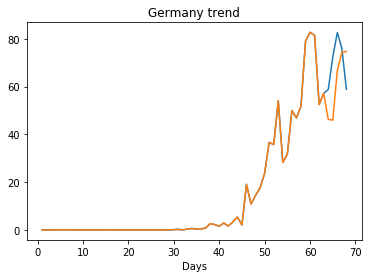

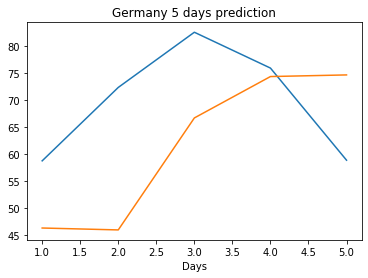

Creating directory ./offline8/US/training/
US
Saving the best model weights at Epoch [1], Best Valid Loss: 2909.1130
Saving the best model weights at Epoch [2], Best Valid Loss: 2629.1379
Saving the best model weights at Epoch [3], Best Valid Loss: 2133.9182
Saving the best model weights at Epoch [5], Best Valid Loss: 1344.0063
Saving the best model weights at Epoch [6], Best Valid Loss: 674.1206
Saving the best model weights at Epoch [8], Best Valid Loss: 548.7493
train error: 173.01916789243944
548.7493286132812
Saving the best model weights at Epoch [1], Best Valid Loss: 2634.3621
Saving the best model weights at Epoch [2], Best Valid Loss: 1777.6527
Saving the best model weights at Epoch [3], Best Valid Loss: 1616.3754
Saving the best model weights at Epoch [4], Best Valid Loss: 1284.5016
Saving the best model weights at Epoch [10], Best Valid Loss: 1220.7311
Saving the best model weights at Epoch [14], Best Valid Loss: 1098.9604
Saving the best model weights at Epoch [32], Best Va

Saving the best model weights at Epoch [1], Best Valid Loss: 3048.7085
train error: 290.99195187754594
3048.70849609375
Saving the best model weights at Epoch [1], Best Valid Loss: 3121.2290
Saving the best model weights at Epoch [2], Best Valid Loss: 2851.7991
train error: 290.99195187754594
2851.799072265625
Saving the best model weights at Epoch [1], Best Valid Loss: 2568.7993
Saving the best model weights at Epoch [4], Best Valid Loss: 1360.5310
Saving the best model weights at Epoch [7], Best Valid Loss: 1299.6664
train error: 290.99195187754606
1299.6663818359375
Saving the best model weights at Epoch [1], Best Valid Loss: 2731.5320
Saving the best model weights at Epoch [2], Best Valid Loss: 1418.6387
train error: 290.99195187754606
1418.638671875
Saving the best model weights at Epoch [1], Best Valid Loss: 2997.4382
Saving the best model weights at Epoch [4], Best Valid Loss: 2818.8220
train error: 290.99195187754606
2818.822021484375
Saving the best model weights at Epoch [1],

Saving the best model weights at Epoch [30], Best Valid Loss: 2725.4458
train error: 258.9257514853227
2725.44580078125
Saving the best model weights at Epoch [1], Best Valid Loss: 3003.5518
Saving the best model weights at Epoch [7], Best Valid Loss: 2947.9597
Saving the best model weights at Epoch [12], Best Valid Loss: 2937.2029
Saving the best model weights at Epoch [15], Best Valid Loss: 2915.3875
train error: 272.01633561284916
2915.387451171875
Saving the best model weights at Epoch [1], Best Valid Loss: 3380.4106
train error: 290.99195187754594
3380.41064453125
Saving the best model weights at Epoch [1], Best Valid Loss: 2881.9834
Saving the best model weights at Epoch [3], Best Valid Loss: 2817.6609
Saving the best model weights at Epoch [4], Best Valid Loss: 2741.0984
Saving the best model weights at Epoch [6], Best Valid Loss: 2706.9797
Saving the best model weights at Epoch [7], Best Valid Loss: 2687.2134
Saving the best model weights at Epoch [8], Best Valid Loss: 2554.541

Saving the best model weights at Epoch [3], Best Valid Loss: 1048.5143
Saving the best model weights at Epoch [5], Best Valid Loss: 995.0695
Saving the best model weights at Epoch [6], Best Valid Loss: 968.2890
Saving the best model weights at Epoch [7], Best Valid Loss: 838.2085
Saving the best model weights at Epoch [10], Best Valid Loss: 709.0200
Saving the best model weights at Epoch [24], Best Valid Loss: 577.0964
train error: 35.54975827842231
577.0963745117188
Saving the best model weights at Epoch [1], Best Valid Loss: 1639.9540
Saving the best model weights at Epoch [2], Best Valid Loss: 1481.5354
Saving the best model weights at Epoch [4], Best Valid Loss: 1475.0840
Saving the best model weights at Epoch [6], Best Valid Loss: 1404.6204
Saving the best model weights at Epoch [11], Best Valid Loss: 774.3245
Saving the best model weights at Epoch [31], Best Valid Loss: 731.0828
train error: 91.32624590024416
731.0828247070312
Saving the best model weights at Epoch [1], Best Vali

Saving the best model weights at Epoch [4], Best Valid Loss: 538.4567
train error: 290.99195187754606
538.4566650390625
Saving the best model weights at Epoch [1], Best Valid Loss: 3117.3906
Saving the best model weights at Epoch [2], Best Valid Loss: 1917.1074
Saving the best model weights at Epoch [7], Best Valid Loss: 1277.7587
Saving the best model weights at Epoch [12], Best Valid Loss: 1032.4364
train error: 112.79593701890707
1032.4364013671875
Saving the best model weights at Epoch [1], Best Valid Loss: 2313.5913
Saving the best model weights at Epoch [4], Best Valid Loss: 1858.5637
Saving the best model weights at Epoch [5], Best Valid Loss: 1527.7626
Saving the best model weights at Epoch [6], Best Valid Loss: 923.9717
Saving the best model weights at Epoch [14], Best Valid Loss: 868.5322
Saving the best model weights at Epoch [17], Best Valid Loss: 867.3426
Saving the best model weights at Epoch [18], Best Valid Loss: 742.7104
train error: 290.99195187754606
742.710388183593

Saving the best model weights at Epoch [2], Best Valid Loss: 3117.9587
Saving the best model weights at Epoch [3], Best Valid Loss: 2816.7112
Saving the best model weights at Epoch [4], Best Valid Loss: 2283.6755
Saving the best model weights at Epoch [10], Best Valid Loss: 1318.0011
Saving the best model weights at Epoch [11], Best Valid Loss: 1008.2365
Saving the best model weights at Epoch [13], Best Valid Loss: 687.7380
train error: 290.99195187754606
687.7379760742188
Saving the best model weights at Epoch [1], Best Valid Loss: 2700.2253
Saving the best model weights at Epoch [3], Best Valid Loss: 1854.9457
train error: 290.99195187754606
1854.9456787109375
Saving the best model weights at Epoch [1], Best Valid Loss: 3310.9246
Saving the best model weights at Epoch [2], Best Valid Loss: 3232.5063
Saving the best model weights at Epoch [3], Best Valid Loss: 3126.0278
Saving the best model weights at Epoch [4], Best Valid Loss: 2909.7761
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [16], Best Valid Loss: 2701.2439
Saving the best model weights at Epoch [17], Best Valid Loss: 1854.9232
Saving the best model weights at Epoch [23], Best Valid Loss: 1174.6517
Saving the best model weights at Epoch [35], Best Valid Loss: 985.7586
Saving the best model weights at Epoch [36], Best Valid Loss: 965.2307
Saving the best model weights at Epoch [37], Best Valid Loss: 770.3027
Saving the best model weights at Epoch [39], Best Valid Loss: 564.6581
train error: 133.0155715122819
564.6581420898438
Saving the best model weights at Epoch [1], Best Valid Loss: 3231.2966
Saving the best model weights at Epoch [2], Best Valid Loss: 3088.4617
Saving the best model weights at Epoch [3], Best Valid Loss: 2985.7708
Saving the best model weights at Epoch [4], Best Valid Loss: 2957.1313
Saving the best model weights at Epoch [5], Best Valid Loss: 2898.0251
Saving the best model weights at Epoch [6], Best Valid Loss: 2888.0923
Saving the best model wei

train error: 230.38627805207906
1281.5771484375
Saving the best model weights at Epoch [1], Best Valid Loss: 3214.8860
Saving the best model weights at Epoch [2], Best Valid Loss: 3014.8179
Saving the best model weights at Epoch [3], Best Valid Loss: 2849.0032
Saving the best model weights at Epoch [4], Best Valid Loss: 2766.5242
Saving the best model weights at Epoch [5], Best Valid Loss: 2750.4395
Saving the best model weights at Epoch [13], Best Valid Loss: 2729.8367
Saving the best model weights at Epoch [20], Best Valid Loss: 2719.0869
Saving the best model weights at Epoch [26], Best Valid Loss: 2273.2976
Saving the best model weights at Epoch [27], Best Valid Loss: 1465.6359
train error: 245.875539378116
1465.6358642578125
Saving the best model weights at Epoch [1], Best Valid Loss: 3073.0833
Saving the best model weights at Epoch [2], Best Valid Loss: 2984.2122
Saving the best model weights at Epoch [12], Best Valid Loss: 2970.7837
train error: 264.4782967190993
2970.7836914062

Saving the best model weights at Epoch [9], Best Valid Loss: 2816.5540
Saving the best model weights at Epoch [10], Best Valid Loss: 2751.9634
Saving the best model weights at Epoch [11], Best Valid Loss: 2699.4099
Saving the best model weights at Epoch [12], Best Valid Loss: 2626.2598
Saving the best model weights at Epoch [13], Best Valid Loss: 2566.9043
Saving the best model weights at Epoch [14], Best Valid Loss: 2508.9734
Saving the best model weights at Epoch [15], Best Valid Loss: 2452.8188
Saving the best model weights at Epoch [16], Best Valid Loss: 2392.5266
Saving the best model weights at Epoch [17], Best Valid Loss: 2311.2083
Saving the best model weights at Epoch [18], Best Valid Loss: 2237.9812
Saving the best model weights at Epoch [19], Best Valid Loss: 2172.6262
Saving the best model weights at Epoch [20], Best Valid Loss: 2106.1948
Saving the best model weights at Epoch [21], Best Valid Loss: 2043.8206
Saving the best model weights at Epoch [22], Best Valid Loss: 198

Saving the best model weights at Epoch [12], Best Valid Loss: 3140.1553
Saving the best model weights at Epoch [13], Best Valid Loss: 3127.4414
Saving the best model weights at Epoch [14], Best Valid Loss: 3116.4980
Saving the best model weights at Epoch [15], Best Valid Loss: 3105.5613
Saving the best model weights at Epoch [16], Best Valid Loss: 3096.3271
Saving the best model weights at Epoch [17], Best Valid Loss: 3087.3762
Saving the best model weights at Epoch [18], Best Valid Loss: 3077.9834
Saving the best model weights at Epoch [19], Best Valid Loss: 3069.9614
Saving the best model weights at Epoch [20], Best Valid Loss: 3061.6763
Saving the best model weights at Epoch [21], Best Valid Loss: 3054.2056
Saving the best model weights at Epoch [22], Best Valid Loss: 3047.1167
Saving the best model weights at Epoch [23], Best Valid Loss: 3040.1858
Saving the best model weights at Epoch [24], Best Valid Loss: 3034.4675
Saving the best model weights at Epoch [25], Best Valid Loss: 30

Saving the best model weights at Epoch [33], Best Valid Loss: 590.1057
Saving the best model weights at Epoch [41], Best Valid Loss: 569.6274
Saving the best model weights at Epoch [42], Best Valid Loss: 538.8893
Saving the best model weights at Epoch [43], Best Valid Loss: 516.0646
Saving the best model weights at Epoch [44], Best Valid Loss: 490.6497
Saving the best model weights at Epoch [45], Best Valid Loss: 477.6063
Saving the best model weights at Epoch [46], Best Valid Loss: 453.3090
Saving the best model weights at Epoch [47], Best Valid Loss: 437.2583
Saving the best model weights at Epoch [48], Best Valid Loss: 423.3193
train error: 16.90055001311461
423.3193359375
Saving the best model weights at Epoch [1], Best Valid Loss: 2456.6646
Saving the best model weights at Epoch [2], Best Valid Loss: 1597.6947
Saving the best model weights at Epoch [3], Best Valid Loss: 1450.0547
Saving the best model weights at Epoch [5], Best Valid Loss: 949.4125
Saving the best model weights at

Saving the best model weights at Epoch [29], Best Valid Loss: 2726.1760
Saving the best model weights at Epoch [30], Best Valid Loss: 2690.4336
Saving the best model weights at Epoch [31], Best Valid Loss: 2652.9915
Saving the best model weights at Epoch [32], Best Valid Loss: 2614.9114
Saving the best model weights at Epoch [33], Best Valid Loss: 2575.3511
Saving the best model weights at Epoch [34], Best Valid Loss: 2535.0974
Saving the best model weights at Epoch [35], Best Valid Loss: 2494.8918
Saving the best model weights at Epoch [36], Best Valid Loss: 2454.3064
Saving the best model weights at Epoch [37], Best Valid Loss: 2414.3887
Saving the best model weights at Epoch [38], Best Valid Loss: 2375.9277
Saving the best model weights at Epoch [39], Best Valid Loss: 2336.9949
Saving the best model weights at Epoch [40], Best Valid Loss: 2299.9363
Saving the best model weights at Epoch [41], Best Valid Loss: 2263.2129
Saving the best model weights at Epoch [42], Best Valid Loss: 22

Saving the best model weights at Epoch [30], Best Valid Loss: 2262.9878
Saving the best model weights at Epoch [31], Best Valid Loss: 2182.9688
Saving the best model weights at Epoch [32], Best Valid Loss: 2106.6296
Saving the best model weights at Epoch [33], Best Valid Loss: 2034.5648
Saving the best model weights at Epoch [34], Best Valid Loss: 1966.6129
Saving the best model weights at Epoch [35], Best Valid Loss: 1903.8213
Saving the best model weights at Epoch [36], Best Valid Loss: 1842.3223
Saving the best model weights at Epoch [37], Best Valid Loss: 1786.1395
Saving the best model weights at Epoch [38], Best Valid Loss: 1733.1766
Saving the best model weights at Epoch [39], Best Valid Loss: 1668.5637
Saving the best model weights at Epoch [40], Best Valid Loss: 1599.5231
Saving the best model weights at Epoch [41], Best Valid Loss: 1534.4105
Saving the best model weights at Epoch [42], Best Valid Loss: 1472.7303
Saving the best model weights at Epoch [43], Best Valid Loss: 14

Saving the best model weights at Epoch [40], Best Valid Loss: 1343.6781
Saving the best model weights at Epoch [42], Best Valid Loss: 1332.6211
Saving the best model weights at Epoch [43], Best Valid Loss: 1302.1377
Saving the best model weights at Epoch [44], Best Valid Loss: 1256.2306
Saving the best model weights at Epoch [46], Best Valid Loss: 1233.4877
Saving the best model weights at Epoch [47], Best Valid Loss: 1219.8461
Saving the best model weights at Epoch [48], Best Valid Loss: 1199.2225
Saving the best model weights at Epoch [49], Best Valid Loss: 1182.3993
train error: 75.7462497015552
1182.3992919921875
Saving the best model weights at Epoch [1], Best Valid Loss: 3357.8611
Saving the best model weights at Epoch [2], Best Valid Loss: 3335.1306
Saving the best model weights at Epoch [3], Best Valid Loss: 3311.1157
Saving the best model weights at Epoch [4], Best Valid Loss: 3284.6118
Saving the best model weights at Epoch [5], Best Valid Loss: 3251.5950
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 2093.9336
Saving the best model weights at Epoch [9], Best Valid Loss: 1645.0121
Saving the best model weights at Epoch [10], Best Valid Loss: 1339.9971
Saving the best model weights at Epoch [11], Best Valid Loss: 1116.1184
Saving the best model weights at Epoch [12], Best Valid Loss: 949.6093
Saving the best model weights at Epoch [13], Best Valid Loss: 820.9682
Saving the best model weights at Epoch [14], Best Valid Loss: 728.3277
Saving the best model weights at Epoch [15], Best Valid Loss: 645.3725
Saving the best model weights at Epoch [17], Best Valid Loss: 640.3882
Saving the best model weights at Epoch [19], Best Valid Loss: 593.4902
Saving the best model weights at Epoch [20], Best Valid Loss: 508.1143
Saving the best model weights at Epoch [21], Best Valid Loss: 474.0053
Saving the best model weights at Epoch [22], Best Valid Loss: 401.3767
Saving the best model weights at Epoch [23], Best Valid Loss: 398.8488
Savi

Saving the best model weights at Epoch [36], Best Valid Loss: 3201.1021
Saving the best model weights at Epoch [37], Best Valid Loss: 3199.5720
Saving the best model weights at Epoch [38], Best Valid Loss: 3197.0522
Saving the best model weights at Epoch [39], Best Valid Loss: 3193.5674
Saving the best model weights at Epoch [40], Best Valid Loss: 3191.2285
Saving the best model weights at Epoch [41], Best Valid Loss: 3190.1660
Saving the best model weights at Epoch [42], Best Valid Loss: 3186.8875
Saving the best model weights at Epoch [43], Best Valid Loss: 3184.9626
Saving the best model weights at Epoch [44], Best Valid Loss: 3182.9141
Saving the best model weights at Epoch [45], Best Valid Loss: 3180.8923
Saving the best model weights at Epoch [46], Best Valid Loss: 3178.9343
Saving the best model weights at Epoch [47], Best Valid Loss: 3178.5657
Saving the best model weights at Epoch [48], Best Valid Loss: 3174.8489
Saving the best model weights at Epoch [49], Best Valid Loss: 31

Saving the best model weights at Epoch [34], Best Valid Loss: 3102.6016
Saving the best model weights at Epoch [35], Best Valid Loss: 3083.8684
Saving the best model weights at Epoch [36], Best Valid Loss: 3060.7258
Saving the best model weights at Epoch [37], Best Valid Loss: 3039.7720
Saving the best model weights at Epoch [38], Best Valid Loss: 3012.9536
Saving the best model weights at Epoch [39], Best Valid Loss: 2987.0515
Saving the best model weights at Epoch [40], Best Valid Loss: 2956.3257
Saving the best model weights at Epoch [41], Best Valid Loss: 2923.6719
Saving the best model weights at Epoch [42], Best Valid Loss: 2886.3621
Saving the best model weights at Epoch [43], Best Valid Loss: 2844.2065
Saving the best model weights at Epoch [44], Best Valid Loss: 2787.8103
Saving the best model weights at Epoch [45], Best Valid Loss: 2702.0642
Saving the best model weights at Epoch [46], Best Valid Loss: 2603.3865
Saving the best model weights at Epoch [47], Best Valid Loss: 25

Saving the best model weights at Epoch [33], Best Valid Loss: 3268.2156
Saving the best model weights at Epoch [34], Best Valid Loss: 3265.1685
Saving the best model weights at Epoch [35], Best Valid Loss: 3261.8188
Saving the best model weights at Epoch [36], Best Valid Loss: 3258.7349
Saving the best model weights at Epoch [37], Best Valid Loss: 3255.4688
Saving the best model weights at Epoch [38], Best Valid Loss: 3252.6382
Saving the best model weights at Epoch [39], Best Valid Loss: 3248.5339
Saving the best model weights at Epoch [40], Best Valid Loss: 3245.0315
Saving the best model weights at Epoch [41], Best Valid Loss: 3240.9055
Saving the best model weights at Epoch [42], Best Valid Loss: 3236.6614
Saving the best model weights at Epoch [43], Best Valid Loss: 3231.5039
Saving the best model weights at Epoch [44], Best Valid Loss: 3227.0735
Saving the best model weights at Epoch [45], Best Valid Loss: 3220.4329
Saving the best model weights at Epoch [46], Best Valid Loss: 32

Saving the best model weights at Epoch [1], Best Valid Loss: 3309.6138
Saving the best model weights at Epoch [2], Best Valid Loss: 3191.3765
Saving the best model weights at Epoch [3], Best Valid Loss: 3008.7585
Saving the best model weights at Epoch [4], Best Valid Loss: 2512.7976
Saving the best model weights at Epoch [5], Best Valid Loss: 1236.0918
Saving the best model weights at Epoch [6], Best Valid Loss: 774.1863
Saving the best model weights at Epoch [7], Best Valid Loss: 669.0665
Saving the best model weights at Epoch [22], Best Valid Loss: 582.5104
Saving the best model weights at Epoch [26], Best Valid Loss: 535.7269
Saving the best model weights at Epoch [27], Best Valid Loss: 254.3168
train error: 81.58437498178473
254.3167724609375
Saving the best model weights at Epoch [1], Best Valid Loss: 3369.2786
Saving the best model weights at Epoch [2], Best Valid Loss: 3362.4673
Saving the best model weights at Epoch [3], Best Valid Loss: 3355.8591
Saving the best model weights 

Saving the best model weights at Epoch [5], Best Valid Loss: 2894.1152
Saving the best model weights at Epoch [6], Best Valid Loss: 2797.8774
Saving the best model weights at Epoch [7], Best Valid Loss: 2743.1782
Saving the best model weights at Epoch [8], Best Valid Loss: 2693.9048
Saving the best model weights at Epoch [11], Best Valid Loss: 2664.7781
Saving the best model weights at Epoch [14], Best Valid Loss: 2662.9011
Saving the best model weights at Epoch [21], Best Valid Loss: 2660.7615
Saving the best model weights at Epoch [22], Best Valid Loss: 2638.3315
Saving the best model weights at Epoch [23], Best Valid Loss: 2554.0562
Saving the best model weights at Epoch [24], Best Valid Loss: 2454.7195
Saving the best model weights at Epoch [25], Best Valid Loss: 2446.1404
Saving the best model weights at Epoch [29], Best Valid Loss: 2421.5105
Saving the best model weights at Epoch [30], Best Valid Loss: 2287.1194
Saving the best model weights at Epoch [31], Best Valid Loss: 2170.4

Saving the best model weights at Epoch [42], Best Valid Loss: 2377.2566
Saving the best model weights at Epoch [43], Best Valid Loss: 2316.6648
Saving the best model weights at Epoch [44], Best Valid Loss: 2220.7043
Saving the best model weights at Epoch [45], Best Valid Loss: 2081.9666
Saving the best model weights at Epoch [46], Best Valid Loss: 1924.4608
Saving the best model weights at Epoch [47], Best Valid Loss: 1777.5364
Saving the best model weights at Epoch [48], Best Valid Loss: 1643.4075
Saving the best model weights at Epoch [49], Best Valid Loss: 1524.0018
Saving the best model weights at Epoch [50], Best Valid Loss: 1415.6737
train error: 79.82701520337478
1415.6737060546875
Saving the best model weights at Epoch [1], Best Valid Loss: 3278.0605
Saving the best model weights at Epoch [2], Best Valid Loss: 3144.9089
Saving the best model weights at Epoch [3], Best Valid Loss: 3018.9509
Saving the best model weights at Epoch [4], Best Valid Loss: 2906.4216
Saving the best mo

Saving the best model weights at Epoch [41], Best Valid Loss: 1536.0930
Saving the best model weights at Epoch [42], Best Valid Loss: 1388.6211
Saving the best model weights at Epoch [43], Best Valid Loss: 1262.4191
Saving the best model weights at Epoch [44], Best Valid Loss: 1154.5527
Saving the best model weights at Epoch [45], Best Valid Loss: 1064.1656
Saving the best model weights at Epoch [46], Best Valid Loss: 982.7915
Saving the best model weights at Epoch [47], Best Valid Loss: 927.9982
Saving the best model weights at Epoch [48], Best Valid Loss: 866.6329
Saving the best model weights at Epoch [49], Best Valid Loss: 826.0594
Saving the best model weights at Epoch [50], Best Valid Loss: 794.8160
train error: 52.85191555556498
794.8159790039062
Saving the best model weights at Epoch [1], Best Valid Loss: 3361.8149
Saving the best model weights at Epoch [2], Best Valid Loss: 3343.6687
Saving the best model weights at Epoch [3], Best Valid Loss: 3325.0554
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 3240.0269
Saving the best model weights at Epoch [25], Best Valid Loss: 3235.5725
Saving the best model weights at Epoch [26], Best Valid Loss: 3231.4961
Saving the best model weights at Epoch [27], Best Valid Loss: 3227.2402
Saving the best model weights at Epoch [28], Best Valid Loss: 3223.2942
Saving the best model weights at Epoch [29], Best Valid Loss: 3219.5017
Saving the best model weights at Epoch [30], Best Valid Loss: 3216.0491
Saving the best model weights at Epoch [31], Best Valid Loss: 3212.8018
Saving the best model weights at Epoch [32], Best Valid Loss: 3197.5645
Saving the best model weights at Epoch [33], Best Valid Loss: 3183.5232
Saving the best model weights at Epoch [34], Best Valid Loss: 3170.8362
Saving the best model weights at Epoch [35], Best Valid Loss: 3156.6519
Saving the best model weights at Epoch [36], Best Valid Loss: 3144.2627
Saving the best model weights at Epoch [37], Best Valid Loss: 31

Saving the best model weights at Epoch [15], Best Valid Loss: 3228.8274
Saving the best model weights at Epoch [16], Best Valid Loss: 3221.1267
Saving the best model weights at Epoch [17], Best Valid Loss: 3213.5781
Saving the best model weights at Epoch [18], Best Valid Loss: 3206.6670
Saving the best model weights at Epoch [19], Best Valid Loss: 3199.3699
Saving the best model weights at Epoch [20], Best Valid Loss: 3192.0115
Saving the best model weights at Epoch [21], Best Valid Loss: 3185.6072
Saving the best model weights at Epoch [22], Best Valid Loss: 3176.0229
Saving the best model weights at Epoch [23], Best Valid Loss: 3161.5066
Saving the best model weights at Epoch [24], Best Valid Loss: 3147.1074
Saving the best model weights at Epoch [25], Best Valid Loss: 3133.9805
Saving the best model weights at Epoch [26], Best Valid Loss: 3118.9753
Saving the best model weights at Epoch [27], Best Valid Loss: 3105.0901
Saving the best model weights at Epoch [28], Best Valid Loss: 30

Saving the best model weights at Epoch [12], Best Valid Loss: 3132.9656
Saving the best model weights at Epoch [13], Best Valid Loss: 3113.2073
Saving the best model weights at Epoch [14], Best Valid Loss: 3094.1697
Saving the best model weights at Epoch [15], Best Valid Loss: 3072.4607
Saving the best model weights at Epoch [16], Best Valid Loss: 3052.1421
Saving the best model weights at Epoch [17], Best Valid Loss: 3032.2319
Saving the best model weights at Epoch [18], Best Valid Loss: 3011.8774
Saving the best model weights at Epoch [19], Best Valid Loss: 2992.6917
Saving the best model weights at Epoch [20], Best Valid Loss: 2972.2910
Saving the best model weights at Epoch [21], Best Valid Loss: 2955.0339
Saving the best model weights at Epoch [22], Best Valid Loss: 2936.2742
Saving the best model weights at Epoch [23], Best Valid Loss: 2917.4519
Saving the best model weights at Epoch [24], Best Valid Loss: 2900.0378
Saving the best model weights at Epoch [25], Best Valid Loss: 28

Saving the best model weights at Epoch [14], Best Valid Loss: 3304.3555
Saving the best model weights at Epoch [15], Best Valid Loss: 3300.0078
Saving the best model weights at Epoch [16], Best Valid Loss: 3295.4902
Saving the best model weights at Epoch [17], Best Valid Loss: 3291.5688
Saving the best model weights at Epoch [18], Best Valid Loss: 3287.7793
Saving the best model weights at Epoch [19], Best Valid Loss: 3283.4763
Saving the best model weights at Epoch [20], Best Valid Loss: 3279.6313
Saving the best model weights at Epoch [21], Best Valid Loss: 3275.9241
Saving the best model weights at Epoch [22], Best Valid Loss: 3272.1855
Saving the best model weights at Epoch [23], Best Valid Loss: 3268.7478
Saving the best model weights at Epoch [24], Best Valid Loss: 3265.6980
Saving the best model weights at Epoch [25], Best Valid Loss: 3262.3137
Saving the best model weights at Epoch [26], Best Valid Loss: 3258.9744
Saving the best model weights at Epoch [27], Best Valid Loss: 32

Saving the best model weights at Epoch [12], Best Valid Loss: 3139.9175
Saving the best model weights at Epoch [13], Best Valid Loss: 3106.6492
Saving the best model weights at Epoch [14], Best Valid Loss: 3066.3586
Saving the best model weights at Epoch [15], Best Valid Loss: 3026.6309
Saving the best model weights at Epoch [16], Best Valid Loss: 2980.6663
Saving the best model weights at Epoch [17], Best Valid Loss: 2937.3296
Saving the best model weights at Epoch [18], Best Valid Loss: 2891.1777
Saving the best model weights at Epoch [19], Best Valid Loss: 2849.3201
Saving the best model weights at Epoch [20], Best Valid Loss: 2801.0793
Saving the best model weights at Epoch [21], Best Valid Loss: 2760.5579
Saving the best model weights at Epoch [22], Best Valid Loss: 2720.9924
Saving the best model weights at Epoch [23], Best Valid Loss: 2689.4236
Saving the best model weights at Epoch [24], Best Valid Loss: 2659.2344
Saving the best model weights at Epoch [25], Best Valid Loss: 26

Saving the best model weights at Epoch [34], Best Valid Loss: 3222.6829
Saving the best model weights at Epoch [35], Best Valid Loss: 3218.2644
Saving the best model weights at Epoch [36], Best Valid Loss: 3213.6526
Saving the best model weights at Epoch [37], Best Valid Loss: 3209.2896
Saving the best model weights at Epoch [38], Best Valid Loss: 3204.8862
Saving the best model weights at Epoch [39], Best Valid Loss: 3200.8232
Saving the best model weights at Epoch [40], Best Valid Loss: 3196.3704
Saving the best model weights at Epoch [41], Best Valid Loss: 3191.8293
Saving the best model weights at Epoch [42], Best Valid Loss: 3187.5593
Saving the best model weights at Epoch [43], Best Valid Loss: 3183.2637
Saving the best model weights at Epoch [44], Best Valid Loss: 3179.1794
Saving the best model weights at Epoch [45], Best Valid Loss: 3174.7747
Saving the best model weights at Epoch [46], Best Valid Loss: 3170.4841
Saving the best model weights at Epoch [47], Best Valid Loss: 31

Saving the best model weights at Epoch [47], Best Valid Loss: 2840.5415
Saving the best model weights at Epoch [48], Best Valid Loss: 2829.2363
Saving the best model weights at Epoch [49], Best Valid Loss: 2817.6663
Saving the best model weights at Epoch [50], Best Valid Loss: 2805.8606
train error: 219.4890527711495
2805.860595703125
Saving the best model weights at Epoch [1], Best Valid Loss: 3371.2087
Saving the best model weights at Epoch [2], Best Valid Loss: 3365.2078
Saving the best model weights at Epoch [3], Best Valid Loss: 3350.9343
Saving the best model weights at Epoch [4], Best Valid Loss: 3335.9773
Saving the best model weights at Epoch [5], Best Valid Loss: 3320.3926
Saving the best model weights at Epoch [6], Best Valid Loss: 3299.2468
Saving the best model weights at Epoch [7], Best Valid Loss: 3285.3240
Saving the best model weights at Epoch [8], Best Valid Loss: 3270.4270
Saving the best model weights at Epoch [9], Best Valid Loss: 3251.8203
Saving the best model we

Saving the best model weights at Epoch [15], Best Valid Loss: 3243.0979
Saving the best model weights at Epoch [16], Best Valid Loss: 3230.1804
Saving the best model weights at Epoch [17], Best Valid Loss: 3217.0896
Saving the best model weights at Epoch [18], Best Valid Loss: 3203.3430
Saving the best model weights at Epoch [19], Best Valid Loss: 3189.4512
Saving the best model weights at Epoch [20], Best Valid Loss: 3175.4626
Saving the best model weights at Epoch [21], Best Valid Loss: 3161.2153
Saving the best model weights at Epoch [22], Best Valid Loss: 3146.6785
Saving the best model weights at Epoch [23], Best Valid Loss: 3131.7383
Saving the best model weights at Epoch [24], Best Valid Loss: 3115.8411
Saving the best model weights at Epoch [25], Best Valid Loss: 3099.7800
Saving the best model weights at Epoch [26], Best Valid Loss: 3082.6824
Saving the best model weights at Epoch [27], Best Valid Loss: 3066.2505
Saving the best model weights at Epoch [28], Best Valid Loss: 30

Saving the best model weights at Epoch [28], Best Valid Loss: 1283.6962
Saving the best model weights at Epoch [29], Best Valid Loss: 1261.3043
Saving the best model weights at Epoch [30], Best Valid Loss: 1236.5248
Saving the best model weights at Epoch [31], Best Valid Loss: 1218.0465
Saving the best model weights at Epoch [32], Best Valid Loss: 1198.6680
Saving the best model weights at Epoch [33], Best Valid Loss: 1178.0322
Saving the best model weights at Epoch [34], Best Valid Loss: 1155.1337
Saving the best model weights at Epoch [35], Best Valid Loss: 1143.1581
Saving the best model weights at Epoch [38], Best Valid Loss: 1099.1398
Saving the best model weights at Epoch [43], Best Valid Loss: 1093.8778
Saving the best model weights at Epoch [44], Best Valid Loss: 1079.5702
Saving the best model weights at Epoch [45], Best Valid Loss: 1070.2025
Saving the best model weights at Epoch [46], Best Valid Loss: 1055.1029
Saving the best model weights at Epoch [47], Best Valid Loss: 10

Saving the best model weights at Epoch [47], Best Valid Loss: 1165.1593
Saving the best model weights at Epoch [48], Best Valid Loss: 1144.7611
Saving the best model weights at Epoch [49], Best Valid Loss: 1122.3082
Saving the best model weights at Epoch [50], Best Valid Loss: 1102.1840
train error: 50.8567550570557
1102.1839599609375
Saving the best model weights at Epoch [1], Best Valid Loss: 3230.0569
Saving the best model weights at Epoch [2], Best Valid Loss: 3000.9119
Saving the best model weights at Epoch [3], Best Valid Loss: 2720.3809
Saving the best model weights at Epoch [4], Best Valid Loss: 2479.0872
Saving the best model weights at Epoch [5], Best Valid Loss: 2189.4771
Saving the best model weights at Epoch [6], Best Valid Loss: 1874.7783
Saving the best model weights at Epoch [7], Best Valid Loss: 1663.7606
Saving the best model weights at Epoch [8], Best Valid Loss: 1498.8663
Saving the best model weights at Epoch [9], Best Valid Loss: 1317.8519
Saving the best model we

Saving the best model weights at Epoch [26], Best Valid Loss: 3290.5352
Saving the best model weights at Epoch [27], Best Valid Loss: 3287.4314
Saving the best model weights at Epoch [28], Best Valid Loss: 3284.4431
Saving the best model weights at Epoch [29], Best Valid Loss: 3281.3855
Saving the best model weights at Epoch [30], Best Valid Loss: 3278.3977
Saving the best model weights at Epoch [31], Best Valid Loss: 3275.3013
Saving the best model weights at Epoch [32], Best Valid Loss: 3272.3086
Saving the best model weights at Epoch [33], Best Valid Loss: 3269.2776
Saving the best model weights at Epoch [34], Best Valid Loss: 3266.1951
Saving the best model weights at Epoch [35], Best Valid Loss: 3263.1582
Saving the best model weights at Epoch [36], Best Valid Loss: 3260.1726
Saving the best model weights at Epoch [37], Best Valid Loss: 3257.1199
Saving the best model weights at Epoch [38], Best Valid Loss: 3254.0547
Saving the best model weights at Epoch [39], Best Valid Loss: 32

Saving the best model weights at Epoch [39], Best Valid Loss: 3361.2791
Saving the best model weights at Epoch [40], Best Valid Loss: 3360.8508
Saving the best model weights at Epoch [41], Best Valid Loss: 3360.4231
Saving the best model weights at Epoch [42], Best Valid Loss: 3359.9961
Saving the best model weights at Epoch [43], Best Valid Loss: 3359.5676
Saving the best model weights at Epoch [44], Best Valid Loss: 3359.1431
Saving the best model weights at Epoch [45], Best Valid Loss: 3358.7126
Saving the best model weights at Epoch [46], Best Valid Loss: 3358.2849
Saving the best model weights at Epoch [47], Best Valid Loss: 3357.8572
Saving the best model weights at Epoch [48], Best Valid Loss: 3357.4336
Saving the best model weights at Epoch [49], Best Valid Loss: 3357.0024
Saving the best model weights at Epoch [50], Best Valid Loss: 3356.5742
train error: 287.36215252978235
3356.57421875
Saving the best model weights at Epoch [1], Best Valid Loss: 3377.4524
Saving the best mod

Saving the best model weights at Epoch [2], Best Valid Loss: 3376.1665
Saving the best model weights at Epoch [3], Best Valid Loss: 3375.5415
Saving the best model weights at Epoch [4], Best Valid Loss: 3374.8977
Saving the best model weights at Epoch [5], Best Valid Loss: 3374.2656
Saving the best model weights at Epoch [6], Best Valid Loss: 3373.6458
Saving the best model weights at Epoch [7], Best Valid Loss: 3373.0032
Saving the best model weights at Epoch [8], Best Valid Loss: 3372.3828
Saving the best model weights at Epoch [9], Best Valid Loss: 3371.7390
Saving the best model weights at Epoch [10], Best Valid Loss: 3371.1047
Saving the best model weights at Epoch [11], Best Valid Loss: 3370.4692
Saving the best model weights at Epoch [12], Best Valid Loss: 3369.8320
Saving the best model weights at Epoch [13], Best Valid Loss: 3369.2017
Saving the best model weights at Epoch [14], Best Valid Loss: 3368.5505
Saving the best model weights at Epoch [15], Best Valid Loss: 3367.9106


Saving the best model weights at Epoch [15], Best Valid Loss: 2826.6965
Saving the best model weights at Epoch [16], Best Valid Loss: 2737.0688
Saving the best model weights at Epoch [17], Best Valid Loss: 2618.1172
Saving the best model weights at Epoch [18], Best Valid Loss: 2494.4087
Saving the best model weights at Epoch [19], Best Valid Loss: 2360.5183
Saving the best model weights at Epoch [20], Best Valid Loss: 2244.0728
Saving the best model weights at Epoch [21], Best Valid Loss: 2121.4648
Saving the best model weights at Epoch [22], Best Valid Loss: 1990.1864
Saving the best model weights at Epoch [23], Best Valid Loss: 1885.6864
Saving the best model weights at Epoch [24], Best Valid Loss: 1765.1210
Saving the best model weights at Epoch [25], Best Valid Loss: 1667.1227
Saving the best model weights at Epoch [26], Best Valid Loss: 1595.6278
Saving the best model weights at Epoch [27], Best Valid Loss: 1488.6625
Saving the best model weights at Epoch [28], Best Valid Loss: 14

Saving the best model weights at Epoch [30], Best Valid Loss: 3262.5447
Saving the best model weights at Epoch [31], Best Valid Loss: 3257.1072
Saving the best model weights at Epoch [32], Best Valid Loss: 3249.9453
Saving the best model weights at Epoch [33], Best Valid Loss: 3243.5554
Saving the best model weights at Epoch [34], Best Valid Loss: 3236.1121
Saving the best model weights at Epoch [35], Best Valid Loss: 3228.6687
Saving the best model weights at Epoch [36], Best Valid Loss: 3220.8313
Saving the best model weights at Epoch [37], Best Valid Loss: 3212.5178
Saving the best model weights at Epoch [38], Best Valid Loss: 3203.9917
Saving the best model weights at Epoch [39], Best Valid Loss: 3195.2119
Saving the best model weights at Epoch [40], Best Valid Loss: 3184.9016
Saving the best model weights at Epoch [41], Best Valid Loss: 3174.4041
Saving the best model weights at Epoch [42], Best Valid Loss: 3163.3318
Saving the best model weights at Epoch [43], Best Valid Loss: 31

Saving the best model weights at Epoch [45], Best Valid Loss: 3325.7205
Saving the best model weights at Epoch [46], Best Valid Loss: 3324.6453
Saving the best model weights at Epoch [47], Best Valid Loss: 3323.5789
Saving the best model weights at Epoch [48], Best Valid Loss: 3322.5000
Saving the best model weights at Epoch [49], Best Valid Loss: 3321.4294
Saving the best model weights at Epoch [50], Best Valid Loss: 3320.3601
train error: 281.8770175660519
3320.360107421875
Saving the best model weights at Epoch [1], Best Valid Loss: 3373.1665
Saving the best model weights at Epoch [2], Best Valid Loss: 3372.1072
Saving the best model weights at Epoch [3], Best Valid Loss: 3371.0032
Saving the best model weights at Epoch [4], Best Valid Loss: 3369.9907
Saving the best model weights at Epoch [5], Best Valid Loss: 3368.9001
Saving the best model weights at Epoch [6], Best Valid Loss: 3367.9043
Saving the best model weights at Epoch [7], Best Valid Loss: 3366.8201
Saving the best model 

Saving the best model weights at Epoch [8], Best Valid Loss: 3363.3210
Saving the best model weights at Epoch [9], Best Valid Loss: 3362.2849
Saving the best model weights at Epoch [10], Best Valid Loss: 3361.2422
Saving the best model weights at Epoch [11], Best Valid Loss: 3360.2095
Saving the best model weights at Epoch [12], Best Valid Loss: 3359.1794
Saving the best model weights at Epoch [13], Best Valid Loss: 3358.1555
Saving the best model weights at Epoch [14], Best Valid Loss: 3357.1367
Saving the best model weights at Epoch [15], Best Valid Loss: 3356.0984
Saving the best model weights at Epoch [16], Best Valid Loss: 3355.0762
Saving the best model weights at Epoch [17], Best Valid Loss: 3354.0571
Saving the best model weights at Epoch [18], Best Valid Loss: 3353.0356
Saving the best model weights at Epoch [19], Best Valid Loss: 3352.0168
Saving the best model weights at Epoch [20], Best Valid Loss: 3351.0056
Saving the best model weights at Epoch [21], Best Valid Loss: 3349

Saving the best model weights at Epoch [20], Best Valid Loss: 3367.0935
Saving the best model weights at Epoch [21], Best Valid Loss: 3366.5586
Saving the best model weights at Epoch [22], Best Valid Loss: 3366.0330
Saving the best model weights at Epoch [23], Best Valid Loss: 3365.4895
Saving the best model weights at Epoch [24], Best Valid Loss: 3364.9568
Saving the best model weights at Epoch [25], Best Valid Loss: 3364.4302
Saving the best model weights at Epoch [26], Best Valid Loss: 3363.8938
Saving the best model weights at Epoch [27], Best Valid Loss: 3363.3633
Saving the best model weights at Epoch [28], Best Valid Loss: 3362.8406
Saving the best model weights at Epoch [29], Best Valid Loss: 3362.3047
Saving the best model weights at Epoch [30], Best Valid Loss: 3361.7766
Saving the best model weights at Epoch [31], Best Valid Loss: 3361.2493
Saving the best model weights at Epoch [32], Best Valid Loss: 3360.7227
Saving the best model weights at Epoch [33], Best Valid Loss: 33

Saving the best model weights at Epoch [31], Best Valid Loss: 3362.5547
Saving the best model weights at Epoch [32], Best Valid Loss: 3362.1125
Saving the best model weights at Epoch [33], Best Valid Loss: 3361.6782
Saving the best model weights at Epoch [34], Best Valid Loss: 3361.2312
Saving the best model weights at Epoch [35], Best Valid Loss: 3360.7915
Saving the best model weights at Epoch [36], Best Valid Loss: 3360.3625
Saving the best model weights at Epoch [37], Best Valid Loss: 3359.9141
Saving the best model weights at Epoch [38], Best Valid Loss: 3359.4771
Saving the best model weights at Epoch [39], Best Valid Loss: 3359.0493
Saving the best model weights at Epoch [40], Best Valid Loss: 3358.6033
Saving the best model weights at Epoch [41], Best Valid Loss: 3358.1677
Saving the best model weights at Epoch [42], Best Valid Loss: 3357.7329
Saving the best model weights at Epoch [43], Best Valid Loss: 3357.2988
Saving the best model weights at Epoch [44], Best Valid Loss: 33

Saving the best model weights at Epoch [44], Best Valid Loss: 2900.6912
Saving the best model weights at Epoch [45], Best Valid Loss: 2854.9900
Saving the best model weights at Epoch [46], Best Valid Loss: 2790.2971
Saving the best model weights at Epoch [47], Best Valid Loss: 2746.3958
Saving the best model weights at Epoch [48], Best Valid Loss: 2689.9158
Saving the best model weights at Epoch [49], Best Valid Loss: 2629.4080
Saving the best model weights at Epoch [50], Best Valid Loss: 2557.6055
train error: 210.93019247055054
2557.60546875
Saving the best model weights at Epoch [1], Best Valid Loss: 3373.3000
Saving the best model weights at Epoch [2], Best Valid Loss: 3372.6875
Saving the best model weights at Epoch [3], Best Valid Loss: 3372.0876
Saving the best model weights at Epoch [4], Best Valid Loss: 3371.4927
Saving the best model weights at Epoch [5], Best Valid Loss: 3370.8992
Saving the best model weights at Epoch [6], Best Valid Loss: 3370.2961
Saving the best model we

Saving the best model weights at Epoch [7], Best Valid Loss: 3282.8176
Saving the best model weights at Epoch [8], Best Valid Loss: 3269.2852
Saving the best model weights at Epoch [9], Best Valid Loss: 3257.4216
Saving the best model weights at Epoch [10], Best Valid Loss: 3244.7913
Saving the best model weights at Epoch [11], Best Valid Loss: 3233.5833
Saving the best model weights at Epoch [12], Best Valid Loss: 3221.7700
Saving the best model weights at Epoch [13], Best Valid Loss: 3207.8652
Saving the best model weights at Epoch [14], Best Valid Loss: 3196.0916
Saving the best model weights at Epoch [15], Best Valid Loss: 3185.5791
Saving the best model weights at Epoch [16], Best Valid Loss: 3172.1462
Saving the best model weights at Epoch [17], Best Valid Loss: 3156.0815
Saving the best model weights at Epoch [18], Best Valid Loss: 3144.5674
Saving the best model weights at Epoch [19], Best Valid Loss: 3129.3413
Saving the best model weights at Epoch [20], Best Valid Loss: 3113.

Saving the best model weights at Epoch [20], Best Valid Loss: 3356.9407
Saving the best model weights at Epoch [21], Best Valid Loss: 3355.9028
Saving the best model weights at Epoch [22], Best Valid Loss: 3354.8599
Saving the best model weights at Epoch [23], Best Valid Loss: 3353.8789
Saving the best model weights at Epoch [24], Best Valid Loss: 3352.8220
Saving the best model weights at Epoch [25], Best Valid Loss: 3351.8535
Saving the best model weights at Epoch [26], Best Valid Loss: 3350.8176
Saving the best model weights at Epoch [27], Best Valid Loss: 3349.7974
Saving the best model weights at Epoch [28], Best Valid Loss: 3348.7734
Saving the best model weights at Epoch [29], Best Valid Loss: 3347.7681
Saving the best model weights at Epoch [30], Best Valid Loss: 3346.7649
Saving the best model weights at Epoch [31], Best Valid Loss: 3345.8103
Saving the best model weights at Epoch [32], Best Valid Loss: 3344.7681
Saving the best model weights at Epoch [33], Best Valid Loss: 33

Saving the best model weights at Epoch [33], Best Valid Loss: 3355.7634
Saving the best model weights at Epoch [34], Best Valid Loss: 3355.2019
Saving the best model weights at Epoch [35], Best Valid Loss: 3354.6497
Saving the best model weights at Epoch [36], Best Valid Loss: 3354.0793
Saving the best model weights at Epoch [37], Best Valid Loss: 3353.5298
Saving the best model weights at Epoch [38], Best Valid Loss: 3352.9626
Saving the best model weights at Epoch [39], Best Valid Loss: 3352.4041
Saving the best model weights at Epoch [40], Best Valid Loss: 3351.8474
Saving the best model weights at Epoch [41], Best Valid Loss: 3351.2961
Saving the best model weights at Epoch [42], Best Valid Loss: 3350.7419
Saving the best model weights at Epoch [43], Best Valid Loss: 3350.1843
Saving the best model weights at Epoch [44], Best Valid Loss: 3349.6328
Saving the best model weights at Epoch [45], Best Valid Loss: 3349.0876
Saving the best model weights at Epoch [46], Best Valid Loss: 33

Saving the best model weights at Epoch [45], Best Valid Loss: 3332.9954
Saving the best model weights at Epoch [46], Best Valid Loss: 3331.9832
Saving the best model weights at Epoch [47], Best Valid Loss: 3330.9751
Saving the best model weights at Epoch [48], Best Valid Loss: 3329.9680
Saving the best model weights at Epoch [49], Best Valid Loss: 3328.9700
Saving the best model weights at Epoch [50], Best Valid Loss: 3327.9563
train error: 283.6241575061883
3327.956298828125
Saving the best model weights at Epoch [1], Best Valid Loss: 3376.2351
Saving the best model weights at Epoch [2], Best Valid Loss: 3374.5923
Saving the best model weights at Epoch [3], Best Valid Loss: 3372.9031
Saving the best model weights at Epoch [4], Best Valid Loss: 3371.2693
Saving the best model weights at Epoch [5], Best Valid Loss: 3369.6411
Saving the best model weights at Epoch [6], Best Valid Loss: 3368.0547
Saving the best model weights at Epoch [7], Best Valid Loss: 3366.4758
Saving the best model 

Saving the best model weights at Epoch [8], Best Valid Loss: 3365.4695
Saving the best model weights at Epoch [9], Best Valid Loss: 3364.8228
Saving the best model weights at Epoch [10], Best Valid Loss: 3364.1755
Saving the best model weights at Epoch [11], Best Valid Loss: 3363.5300
Saving the best model weights at Epoch [12], Best Valid Loss: 3362.8865
Saving the best model weights at Epoch [13], Best Valid Loss: 3362.2478
Saving the best model weights at Epoch [14], Best Valid Loss: 3361.6067
Saving the best model weights at Epoch [15], Best Valid Loss: 3360.9578
Saving the best model weights at Epoch [16], Best Valid Loss: 3360.3176
Saving the best model weights at Epoch [17], Best Valid Loss: 3359.6802
Saving the best model weights at Epoch [18], Best Valid Loss: 3359.0396
Saving the best model weights at Epoch [19], Best Valid Loss: 3358.4021
Saving the best model weights at Epoch [20], Best Valid Loss: 3357.7661
Saving the best model weights at Epoch [21], Best Valid Loss: 3357

Saving the best model weights at Epoch [21], Best Valid Loss: 3228.7468
Saving the best model weights at Epoch [22], Best Valid Loss: 3220.7747
Saving the best model weights at Epoch [23], Best Valid Loss: 3213.9233
Saving the best model weights at Epoch [24], Best Valid Loss: 3205.9795
Saving the best model weights at Epoch [25], Best Valid Loss: 3198.6040
Saving the best model weights at Epoch [26], Best Valid Loss: 3190.9429
Saving the best model weights at Epoch [27], Best Valid Loss: 3184.1646
Saving the best model weights at Epoch [28], Best Valid Loss: 3175.8469
Saving the best model weights at Epoch [29], Best Valid Loss: 3169.2952
Saving the best model weights at Epoch [30], Best Valid Loss: 3162.7556
Saving the best model weights at Epoch [31], Best Valid Loss: 3155.2598
Saving the best model weights at Epoch [32], Best Valid Loss: 3148.4861
Saving the best model weights at Epoch [33], Best Valid Loss: 3141.1824
Saving the best model weights at Epoch [34], Best Valid Loss: 31

Saving the best model weights at Epoch [34], Best Valid Loss: 3333.9861
Saving the best model weights at Epoch [35], Best Valid Loss: 3332.5657
Saving the best model weights at Epoch [36], Best Valid Loss: 3330.9070
Saving the best model weights at Epoch [37], Best Valid Loss: 3329.1755
Saving the best model weights at Epoch [38], Best Valid Loss: 3327.5789
Saving the best model weights at Epoch [39], Best Valid Loss: 3326.1172
Saving the best model weights at Epoch [40], Best Valid Loss: 3324.4080
Saving the best model weights at Epoch [41], Best Valid Loss: 3322.8223
Saving the best model weights at Epoch [42], Best Valid Loss: 3321.2727
Saving the best model weights at Epoch [43], Best Valid Loss: 3319.7283
Saving the best model weights at Epoch [44], Best Valid Loss: 3318.0962
Saving the best model weights at Epoch [45], Best Valid Loss: 3316.5813
Saving the best model weights at Epoch [46], Best Valid Loss: 3314.9353
Saving the best model weights at Epoch [47], Best Valid Loss: 33

Saving the best model weights at Epoch [47], Best Valid Loss: 3349.0457
Saving the best model weights at Epoch [48], Best Valid Loss: 3348.4849
Saving the best model weights at Epoch [49], Best Valid Loss: 3347.9231
Saving the best model weights at Epoch [50], Best Valid Loss: 3347.3630
train error: 286.9239194181405
3347.363037109375
Saving the best model weights at Epoch [1], Best Valid Loss: 3378.2524
Saving the best model weights at Epoch [2], Best Valid Loss: 3377.0923
Saving the best model weights at Epoch [3], Best Valid Loss: 3375.9712
Saving the best model weights at Epoch [4], Best Valid Loss: 3374.8425
Saving the best model weights at Epoch [5], Best Valid Loss: 3373.7375
Saving the best model weights at Epoch [6], Best Valid Loss: 3372.6794
Saving the best model weights at Epoch [7], Best Valid Loss: 3371.5398
Saving the best model weights at Epoch [8], Best Valid Loss: 3370.5024
Saving the best model weights at Epoch [9], Best Valid Loss: 3369.3523
Saving the best model we

Saving the best model weights at Epoch [10], Best Valid Loss: 3362.4597
Saving the best model weights at Epoch [11], Best Valid Loss: 3361.2595
Saving the best model weights at Epoch [12], Best Valid Loss: 3360.0632
Saving the best model weights at Epoch [13], Best Valid Loss: 3358.8660
Saving the best model weights at Epoch [14], Best Valid Loss: 3357.6719
Saving the best model weights at Epoch [15], Best Valid Loss: 3356.4805
Saving the best model weights at Epoch [16], Best Valid Loss: 3355.2993
Saving the best model weights at Epoch [17], Best Valid Loss: 3354.1033
Saving the best model weights at Epoch [18], Best Valid Loss: 3352.9211
Saving the best model weights at Epoch [19], Best Valid Loss: 3351.7332
Saving the best model weights at Epoch [20], Best Valid Loss: 3350.5579
Saving the best model weights at Epoch [21], Best Valid Loss: 3349.3728
Saving the best model weights at Epoch [22], Best Valid Loss: 3348.1931
Saving the best model weights at Epoch [23], Best Valid Loss: 33

Saving the best model weights at Epoch [23], Best Valid Loss: 3255.4255
Saving the best model weights at Epoch [24], Best Valid Loss: 3249.9319
Saving the best model weights at Epoch [25], Best Valid Loss: 3244.9802
Saving the best model weights at Epoch [26], Best Valid Loss: 3239.3860
Saving the best model weights at Epoch [27], Best Valid Loss: 3234.7649
Saving the best model weights at Epoch [28], Best Valid Loss: 3230.3049
Saving the best model weights at Epoch [29], Best Valid Loss: 3224.5515
Saving the best model weights at Epoch [30], Best Valid Loss: 3221.2993
Saving the best model weights at Epoch [31], Best Valid Loss: 3212.0989
Saving the best model weights at Epoch [32], Best Valid Loss: 3201.6011
Saving the best model weights at Epoch [33], Best Valid Loss: 3192.4009
Saving the best model weights at Epoch [34], Best Valid Loss: 3183.4517
Saving the best model weights at Epoch [35], Best Valid Loss: 3173.0273
Saving the best model weights at Epoch [36], Best Valid Loss: 31

Saving the best model weights at Epoch [36], Best Valid Loss: 3373.2200
Saving the best model weights at Epoch [37], Best Valid Loss: 3373.1719
Saving the best model weights at Epoch [38], Best Valid Loss: 3373.1179
Saving the best model weights at Epoch [39], Best Valid Loss: 3373.0664
Saving the best model weights at Epoch [40], Best Valid Loss: 3373.0168
Saving the best model weights at Epoch [41], Best Valid Loss: 3372.9656
Saving the best model weights at Epoch [42], Best Valid Loss: 3372.9146
Saving the best model weights at Epoch [43], Best Valid Loss: 3372.8691
Saving the best model weights at Epoch [44], Best Valid Loss: 3372.8171
Saving the best model weights at Epoch [45], Best Valid Loss: 3372.7649
Saving the best model weights at Epoch [46], Best Valid Loss: 3372.7117
Saving the best model weights at Epoch [47], Best Valid Loss: 3372.6609
Saving the best model weights at Epoch [48], Best Valid Loss: 3372.6106
Saving the best model weights at Epoch [49], Best Valid Loss: 33

Saving the best model weights at Epoch [49], Best Valid Loss: 3322.9744
Saving the best model weights at Epoch [50], Best Valid Loss: 3321.9673
train error: 283.6476241770801
3321.96728515625
Saving the best model weights at Epoch [1], Best Valid Loss: 3377.0369
Saving the best model weights at Epoch [2], Best Valid Loss: 3376.8516
Saving the best model weights at Epoch [3], Best Valid Loss: 3376.5759
Saving the best model weights at Epoch [4], Best Valid Loss: 3376.3423
Saving the best model weights at Epoch [5], Best Valid Loss: 3376.1289
Saving the best model weights at Epoch [6], Best Valid Loss: 3375.9382
Saving the best model weights at Epoch [7], Best Valid Loss: 3375.7727
Saving the best model weights at Epoch [8], Best Valid Loss: 3375.6113
Saving the best model weights at Epoch [9], Best Valid Loss: 3375.3044
Saving the best model weights at Epoch [10], Best Valid Loss: 3374.9656
Saving the best model weights at Epoch [11], Best Valid Loss: 3374.7371
Saving the best model wei

Saving the best model weights at Epoch [12], Best Valid Loss: 3357.3501
Saving the best model weights at Epoch [13], Best Valid Loss: 3356.6067
Saving the best model weights at Epoch [14], Best Valid Loss: 3355.9080
Saving the best model weights at Epoch [15], Best Valid Loss: 3355.1880
Saving the best model weights at Epoch [16], Best Valid Loss: 3354.5078
Saving the best model weights at Epoch [17], Best Valid Loss: 3353.8398
Saving the best model weights at Epoch [18], Best Valid Loss: 3353.1704
Saving the best model weights at Epoch [19], Best Valid Loss: 3352.5095
Saving the best model weights at Epoch [20], Best Valid Loss: 3351.8503
Saving the best model weights at Epoch [21], Best Valid Loss: 3351.1978
Saving the best model weights at Epoch [22], Best Valid Loss: 3350.5454
Saving the best model weights at Epoch [23], Best Valid Loss: 3349.8755
Saving the best model weights at Epoch [24], Best Valid Loss: 3349.2039
Saving the best model weights at Epoch [25], Best Valid Loss: 33

Saving the best model weights at Epoch [25], Best Valid Loss: 3078.5146
Saving the best model weights at Epoch [26], Best Valid Loss: 3066.5247
Saving the best model weights at Epoch [27], Best Valid Loss: 3048.9851
Saving the best model weights at Epoch [28], Best Valid Loss: 3035.7449
Saving the best model weights at Epoch [29], Best Valid Loss: 3019.8042
Saving the best model weights at Epoch [30], Best Valid Loss: 3007.0376
Saving the best model weights at Epoch [31], Best Valid Loss: 2992.9863
Saving the best model weights at Epoch [32], Best Valid Loss: 2982.1980
Saving the best model weights at Epoch [33], Best Valid Loss: 2965.9795
Saving the best model weights at Epoch [34], Best Valid Loss: 2952.2078
Saving the best model weights at Epoch [35], Best Valid Loss: 2936.1130
Saving the best model weights at Epoch [36], Best Valid Loss: 2923.7996
Saving the best model weights at Epoch [37], Best Valid Loss: 2907.2812
Saving the best model weights at Epoch [38], Best Valid Loss: 28

Saving the best model weights at Epoch [38], Best Valid Loss: 3201.2839
Saving the best model weights at Epoch [39], Best Valid Loss: 3196.6416
Saving the best model weights at Epoch [40], Best Valid Loss: 3192.0723
Saving the best model weights at Epoch [41], Best Valid Loss: 3187.2751
Saving the best model weights at Epoch [42], Best Valid Loss: 3182.9551
Saving the best model weights at Epoch [43], Best Valid Loss: 3177.8037
Saving the best model weights at Epoch [44], Best Valid Loss: 3173.0811
Saving the best model weights at Epoch [45], Best Valid Loss: 3168.3259
Saving the best model weights at Epoch [46], Best Valid Loss: 3163.3982
Saving the best model weights at Epoch [47], Best Valid Loss: 3158.5947
Saving the best model weights at Epoch [48], Best Valid Loss: 3153.6489
Saving the best model weights at Epoch [49], Best Valid Loss: 3148.7485
Saving the best model weights at Epoch [50], Best Valid Loss: 3143.8484
train error: 265.6555071165111
3143.848388671875
Saving the best

Saving the best model weights at Epoch [1], Best Valid Loss: 3373.0720
Saving the best model weights at Epoch [2], Best Valid Loss: 3372.9133
Saving the best model weights at Epoch [3], Best Valid Loss: 3372.7537
Saving the best model weights at Epoch [4], Best Valid Loss: 3372.5945
Saving the best model weights at Epoch [5], Best Valid Loss: 3372.4363
Saving the best model weights at Epoch [6], Best Valid Loss: 3372.2805
Saving the best model weights at Epoch [7], Best Valid Loss: 3372.1228
Saving the best model weights at Epoch [8], Best Valid Loss: 3371.9629
Saving the best model weights at Epoch [9], Best Valid Loss: 3371.8020
Saving the best model weights at Epoch [10], Best Valid Loss: 3371.6484
Saving the best model weights at Epoch [11], Best Valid Loss: 3371.4841
Saving the best model weights at Epoch [12], Best Valid Loss: 3371.3262
Saving the best model weights at Epoch [13], Best Valid Loss: 3371.1687
Saving the best model weights at Epoch [14], Best Valid Loss: 3371.0083
S

Saving the best model weights at Epoch [14], Best Valid Loss: 3373.0508
Saving the best model weights at Epoch [15], Best Valid Loss: 3372.9265
Saving the best model weights at Epoch [16], Best Valid Loss: 3372.8008
Saving the best model weights at Epoch [17], Best Valid Loss: 3372.6758
Saving the best model weights at Epoch [18], Best Valid Loss: 3372.5508
Saving the best model weights at Epoch [19], Best Valid Loss: 3372.4258
Saving the best model weights at Epoch [20], Best Valid Loss: 3372.3008
Saving the best model weights at Epoch [21], Best Valid Loss: 3372.1775
Saving the best model weights at Epoch [22], Best Valid Loss: 3372.0513
Saving the best model weights at Epoch [23], Best Valid Loss: 3371.9258
Saving the best model weights at Epoch [24], Best Valid Loss: 3371.8008
Saving the best model weights at Epoch [25], Best Valid Loss: 3371.6777
Saving the best model weights at Epoch [26], Best Valid Loss: 3371.5532
Saving the best model weights at Epoch [27], Best Valid Loss: 33

Saving the best model weights at Epoch [27], Best Valid Loss: 3364.6543
Saving the best model weights at Epoch [28], Best Valid Loss: 3363.8777
Saving the best model weights at Epoch [29], Best Valid Loss: 3362.9153
Saving the best model weights at Epoch [30], Best Valid Loss: 3362.1531
Saving the best model weights at Epoch [31], Best Valid Loss: 3361.0059
Saving the best model weights at Epoch [32], Best Valid Loss: 3360.1931
Saving the best model weights at Epoch [33], Best Valid Loss: 3359.2195
Saving the best model weights at Epoch [34], Best Valid Loss: 3358.3958
Saving the best model weights at Epoch [35], Best Valid Loss: 3357.2297
Saving the best model weights at Epoch [36], Best Valid Loss: 3356.5117
Saving the best model weights at Epoch [37], Best Valid Loss: 3355.5391
Saving the best model weights at Epoch [38], Best Valid Loss: 3354.3325
Saving the best model weights at Epoch [39], Best Valid Loss: 3353.3789
Saving the best model weights at Epoch [40], Best Valid Loss: 33

Saving the best model weights at Epoch [40], Best Valid Loss: 3372.3250
Saving the best model weights at Epoch [41], Best Valid Loss: 3372.1938
Saving the best model weights at Epoch [42], Best Valid Loss: 3372.0603
Saving the best model weights at Epoch [43], Best Valid Loss: 3371.9297
Saving the best model weights at Epoch [44], Best Valid Loss: 3371.8032
Saving the best model weights at Epoch [45], Best Valid Loss: 3371.6777
Saving the best model weights at Epoch [46], Best Valid Loss: 3371.5376
Saving the best model weights at Epoch [47], Best Valid Loss: 3371.4055
Saving the best model weights at Epoch [48], Best Valid Loss: 3371.2747
Saving the best model weights at Epoch [49], Best Valid Loss: 3371.1411
Saving the best model weights at Epoch [50], Best Valid Loss: 3371.0103
train error: 289.71318577033907
3371.01025390625
Saving the best model weights at Epoch [1], Best Valid Loss: 3378.7383
Saving the best model weights at Epoch [2], Best Valid Loss: 3378.0454
Saving the best m

Saving the best model weights at Epoch [2], Best Valid Loss: 3377.0059
Saving the best model weights at Epoch [3], Best Valid Loss: 3376.6716
Saving the best model weights at Epoch [4], Best Valid Loss: 3376.3828
Saving the best model weights at Epoch [5], Best Valid Loss: 3376.0027
Saving the best model weights at Epoch [6], Best Valid Loss: 3375.6667
Saving the best model weights at Epoch [7], Best Valid Loss: 3375.3086
Saving the best model weights at Epoch [8], Best Valid Loss: 3374.9978
Saving the best model weights at Epoch [9], Best Valid Loss: 3374.6118
Saving the best model weights at Epoch [10], Best Valid Loss: 3374.2556
Saving the best model weights at Epoch [11], Best Valid Loss: 3373.9343
Saving the best model weights at Epoch [12], Best Valid Loss: 3373.5415
Saving the best model weights at Epoch [13], Best Valid Loss: 3373.2051
Saving the best model weights at Epoch [14], Best Valid Loss: 3372.8054
Saving the best model weights at Epoch [15], Best Valid Loss: 3372.4731


Saving the best model weights at Epoch [15], Best Valid Loss: 3366.7017
Saving the best model weights at Epoch [16], Best Valid Loss: 3366.6079
Saving the best model weights at Epoch [17], Best Valid Loss: 3366.5142
Saving the best model weights at Epoch [18], Best Valid Loss: 3366.4204
Saving the best model weights at Epoch [19], Best Valid Loss: 3366.3262
Saving the best model weights at Epoch [20], Best Valid Loss: 3366.2324
Saving the best model weights at Epoch [21], Best Valid Loss: 3366.1392
Saving the best model weights at Epoch [22], Best Valid Loss: 3366.0449
Saving the best model weights at Epoch [23], Best Valid Loss: 3365.9529
Saving the best model weights at Epoch [24], Best Valid Loss: 3365.8579
Saving the best model weights at Epoch [25], Best Valid Loss: 3365.7637
Saving the best model weights at Epoch [26], Best Valid Loss: 3365.6699
Saving the best model weights at Epoch [27], Best Valid Loss: 3365.5762
Saving the best model weights at Epoch [28], Best Valid Loss: 33

Saving the best model weights at Epoch [28], Best Valid Loss: 3360.2263
Saving the best model weights at Epoch [29], Best Valid Loss: 3359.5063
Saving the best model weights at Epoch [30], Best Valid Loss: 3358.8411
Saving the best model weights at Epoch [31], Best Valid Loss: 3358.2468
Saving the best model weights at Epoch [32], Best Valid Loss: 3357.6091
Saving the best model weights at Epoch [33], Best Valid Loss: 3356.9734
Saving the best model weights at Epoch [34], Best Valid Loss: 3356.2263
Saving the best model weights at Epoch [35], Best Valid Loss: 3355.7009
Saving the best model weights at Epoch [36], Best Valid Loss: 3355.0352
Saving the best model weights at Epoch [37], Best Valid Loss: 3354.3601
Saving the best model weights at Epoch [38], Best Valid Loss: 3353.6978
Saving the best model weights at Epoch [39], Best Valid Loss: 3353.0864
Saving the best model weights at Epoch [40], Best Valid Loss: 3352.4255
Saving the best model weights at Epoch [41], Best Valid Loss: 33

Saving the best model weights at Epoch [41], Best Valid Loss: 3371.1196
Saving the best model weights at Epoch [42], Best Valid Loss: 3370.9829
Saving the best model weights at Epoch [43], Best Valid Loss: 3370.8398
Saving the best model weights at Epoch [44], Best Valid Loss: 3370.7048
Saving the best model weights at Epoch [45], Best Valid Loss: 3370.5642
Saving the best model weights at Epoch [46], Best Valid Loss: 3370.4285
Saving the best model weights at Epoch [47], Best Valid Loss: 3370.2969
Saving the best model weights at Epoch [48], Best Valid Loss: 3370.1470
Saving the best model weights at Epoch [49], Best Valid Loss: 3370.0203
Saving the best model weights at Epoch [50], Best Valid Loss: 3369.8777
train error: 289.2994051893536
3369.877685546875
Saving the best model weights at Epoch [1], Best Valid Loss: 3378.2856
Saving the best model weights at Epoch [2], Best Valid Loss: 3377.8828
Saving the best model weights at Epoch [3], Best Valid Loss: 3377.4727
Saving the best mo

Saving the best model weights at Epoch [4], Best Valid Loss: 3374.4587
Saving the best model weights at Epoch [5], Best Valid Loss: 3374.2781
Saving the best model weights at Epoch [6], Best Valid Loss: 3374.1086
Saving the best model weights at Epoch [7], Best Valid Loss: 3373.9282
Saving the best model weights at Epoch [8], Best Valid Loss: 3373.7610
Saving the best model weights at Epoch [9], Best Valid Loss: 3373.5818
Saving the best model weights at Epoch [10], Best Valid Loss: 3373.4050
Saving the best model weights at Epoch [11], Best Valid Loss: 3373.2446
Saving the best model weights at Epoch [12], Best Valid Loss: 3373.0603
Saving the best model weights at Epoch [13], Best Valid Loss: 3372.8904
Saving the best model weights at Epoch [14], Best Valid Loss: 3372.7102
Saving the best model weights at Epoch [15], Best Valid Loss: 3372.5403
Saving the best model weights at Epoch [16], Best Valid Loss: 3372.3613
Saving the best model weights at Epoch [17], Best Valid Loss: 3372.186

Saving the best model weights at Epoch [17], Best Valid Loss: 3374.7310
Saving the best model weights at Epoch [18], Best Valid Loss: 3374.6543
Saving the best model weights at Epoch [19], Best Valid Loss: 3374.5779
Saving the best model weights at Epoch [20], Best Valid Loss: 3374.5024
Saving the best model weights at Epoch [21], Best Valid Loss: 3374.4255
Saving the best model weights at Epoch [22], Best Valid Loss: 3374.3484
Saving the best model weights at Epoch [23], Best Valid Loss: 3374.2720
Saving the best model weights at Epoch [24], Best Valid Loss: 3374.1965
Saving the best model weights at Epoch [25], Best Valid Loss: 3374.1189
Saving the best model weights at Epoch [26], Best Valid Loss: 3374.0437
Saving the best model weights at Epoch [27], Best Valid Loss: 3373.9661
Saving the best model weights at Epoch [28], Best Valid Loss: 3373.8899
Saving the best model weights at Epoch [29], Best Valid Loss: 3373.8132
Saving the best model weights at Epoch [30], Best Valid Loss: 33

Saving the best model weights at Epoch [30], Best Valid Loss: 3365.3474
Saving the best model weights at Epoch [31], Best Valid Loss: 3364.9055
Saving the best model weights at Epoch [32], Best Valid Loss: 3364.4180
Saving the best model weights at Epoch [33], Best Valid Loss: 3364.0137
Saving the best model weights at Epoch [34], Best Valid Loss: 3363.5063
Saving the best model weights at Epoch [35], Best Valid Loss: 3363.1062
Saving the best model weights at Epoch [36], Best Valid Loss: 3362.6379
Saving the best model weights at Epoch [37], Best Valid Loss: 3362.2173
Saving the best model weights at Epoch [38], Best Valid Loss: 3361.8091
Saving the best model weights at Epoch [39], Best Valid Loss: 3361.3989
Saving the best model weights at Epoch [40], Best Valid Loss: 3360.9590
Saving the best model weights at Epoch [41], Best Valid Loss: 3360.4602
Saving the best model weights at Epoch [42], Best Valid Loss: 3360.0447
Saving the best model weights at Epoch [43], Best Valid Loss: 33

Saving the best model weights at Epoch [43], Best Valid Loss: 3365.4661
Saving the best model weights at Epoch [44], Best Valid Loss: 3365.3438
Saving the best model weights at Epoch [45], Best Valid Loss: 3365.2302
Saving the best model weights at Epoch [46], Best Valid Loss: 3365.1091
Saving the best model weights at Epoch [47], Best Valid Loss: 3364.9763
Saving the best model weights at Epoch [48], Best Valid Loss: 3364.8540
Saving the best model weights at Epoch [49], Best Valid Loss: 3364.7324
Saving the best model weights at Epoch [50], Best Valid Loss: 3364.6099
train error: 288.84979775538176
3364.60986328125
Saving the best model weights at Epoch [1], Best Valid Loss: 3373.0149
Saving the best model weights at Epoch [2], Best Valid Loss: 3372.1926
Saving the best model weights at Epoch [3], Best Valid Loss: 3371.3203
Saving the best model weights at Epoch [4], Best Valid Loss: 3370.5742
Saving the best model weights at Epoch [5], Best Valid Loss: 3369.7915
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 3378.7083
Saving the best model weights at Epoch [7], Best Valid Loss: 3378.6125
Saving the best model weights at Epoch [8], Best Valid Loss: 3378.5173
Saving the best model weights at Epoch [9], Best Valid Loss: 3378.4231
Saving the best model weights at Epoch [10], Best Valid Loss: 3378.3286
Saving the best model weights at Epoch [11], Best Valid Loss: 3378.2356
Saving the best model weights at Epoch [12], Best Valid Loss: 3378.1431
Saving the best model weights at Epoch [13], Best Valid Loss: 3378.0466
Saving the best model weights at Epoch [14], Best Valid Loss: 3377.9512
Saving the best model weights at Epoch [15], Best Valid Loss: 3377.8591
Saving the best model weights at Epoch [16], Best Valid Loss: 3377.7654
Saving the best model weights at Epoch [17], Best Valid Loss: 3377.6704
Saving the best model weights at Epoch [18], Best Valid Loss: 3377.5742
Saving the best model weights at Epoch [19], Best Valid Loss: 3377.4

Saving the best model weights at Epoch [19], Best Valid Loss: 3376.6719
Saving the best model weights at Epoch [20], Best Valid Loss: 3376.6465
Saving the best model weights at Epoch [21], Best Valid Loss: 3376.6211
Saving the best model weights at Epoch [22], Best Valid Loss: 3376.5957
Saving the best model weights at Epoch [23], Best Valid Loss: 3376.5701
Saving the best model weights at Epoch [24], Best Valid Loss: 3376.5447
Saving the best model weights at Epoch [25], Best Valid Loss: 3376.5193
Saving the best model weights at Epoch [26], Best Valid Loss: 3376.4939
Saving the best model weights at Epoch [27], Best Valid Loss: 3376.4680
Saving the best model weights at Epoch [28], Best Valid Loss: 3376.4431
Saving the best model weights at Epoch [29], Best Valid Loss: 3376.4172
Saving the best model weights at Epoch [30], Best Valid Loss: 3376.3923
Saving the best model weights at Epoch [31], Best Valid Loss: 3376.3672
Saving the best model weights at Epoch [32], Best Valid Loss: 33

Saving the best model weights at Epoch [32], Best Valid Loss: 3356.4368
Saving the best model weights at Epoch [33], Best Valid Loss: 3355.8442
Saving the best model weights at Epoch [34], Best Valid Loss: 3355.2239
Saving the best model weights at Epoch [35], Best Valid Loss: 3354.5442
Saving the best model weights at Epoch [36], Best Valid Loss: 3353.9087
Saving the best model weights at Epoch [37], Best Valid Loss: 3353.3164
Saving the best model weights at Epoch [38], Best Valid Loss: 3352.5571
Saving the best model weights at Epoch [39], Best Valid Loss: 3351.9829
Saving the best model weights at Epoch [40], Best Valid Loss: 3351.3064
Saving the best model weights at Epoch [41], Best Valid Loss: 3350.6750
Saving the best model weights at Epoch [42], Best Valid Loss: 3349.9590
Saving the best model weights at Epoch [43], Best Valid Loss: 3349.4707
Saving the best model weights at Epoch [44], Best Valid Loss: 3348.8064
Saving the best model weights at Epoch [45], Best Valid Loss: 33

Saving the best model weights at Epoch [45], Best Valid Loss: 3366.0476
Saving the best model weights at Epoch [46], Best Valid Loss: 3365.8418
Saving the best model weights at Epoch [47], Best Valid Loss: 3365.6340
Saving the best model weights at Epoch [48], Best Valid Loss: 3365.4197
Saving the best model weights at Epoch [49], Best Valid Loss: 3365.2117
Saving the best model weights at Epoch [50], Best Valid Loss: 3365.0007
train error: 288.55931616373556
3365.000732421875
Saving the best model weights at Epoch [1], Best Valid Loss: 3377.2695
Saving the best model weights at Epoch [2], Best Valid Loss: 3376.3489
Saving the best model weights at Epoch [3], Best Valid Loss: 3375.5005
Saving the best model weights at Epoch [4], Best Valid Loss: 3374.5466
Saving the best model weights at Epoch [5], Best Valid Loss: 3373.6587
Saving the best model weights at Epoch [6], Best Valid Loss: 3372.9023
Saving the best model weights at Epoch [7], Best Valid Loss: 3371.9485
Saving the best model

Saving the best model weights at Epoch [8], Best Valid Loss: 3373.2566
Saving the best model weights at Epoch [9], Best Valid Loss: 3373.1072
Saving the best model weights at Epoch [10], Best Valid Loss: 3372.9539
Saving the best model weights at Epoch [11], Best Valid Loss: 3372.8015
Saving the best model weights at Epoch [12], Best Valid Loss: 3372.6570
Saving the best model weights at Epoch [13], Best Valid Loss: 3372.4993
Saving the best model weights at Epoch [14], Best Valid Loss: 3372.3469
Saving the best model weights at Epoch [15], Best Valid Loss: 3372.1953
Saving the best model weights at Epoch [16], Best Valid Loss: 3372.0447
Saving the best model weights at Epoch [17], Best Valid Loss: 3371.8931
Saving the best model weights at Epoch [18], Best Valid Loss: 3371.7415
Saving the best model weights at Epoch [19], Best Valid Loss: 3371.5969
Saving the best model weights at Epoch [20], Best Valid Loss: 3371.4392
Saving the best model weights at Epoch [21], Best Valid Loss: 3371

Saving the best model weights at Epoch [21], Best Valid Loss: 3372.2493
Saving the best model weights at Epoch [22], Best Valid Loss: 3372.1528
Saving the best model weights at Epoch [23], Best Valid Loss: 3372.0566
Saving the best model weights at Epoch [24], Best Valid Loss: 3371.9602
Saving the best model weights at Epoch [25], Best Valid Loss: 3371.8640
Saving the best model weights at Epoch [26], Best Valid Loss: 3371.7676
Saving the best model weights at Epoch [27], Best Valid Loss: 3371.6716
Saving the best model weights at Epoch [28], Best Valid Loss: 3371.5750
Saving the best model weights at Epoch [29], Best Valid Loss: 3371.4790
Saving the best model weights at Epoch [30], Best Valid Loss: 3371.3826
Saving the best model weights at Epoch [31], Best Valid Loss: 3371.2864
Saving the best model weights at Epoch [32], Best Valid Loss: 3371.1899
Saving the best model weights at Epoch [33], Best Valid Loss: 3371.0957
Saving the best model weights at Epoch [34], Best Valid Loss: 33

Saving the best model weights at Epoch [34], Best Valid Loss: 3348.3516
Saving the best model weights at Epoch [35], Best Valid Loss: 3347.6067
Saving the best model weights at Epoch [36], Best Valid Loss: 3346.8501
Saving the best model weights at Epoch [37], Best Valid Loss: 3346.0547
Saving the best model weights at Epoch [38], Best Valid Loss: 3345.3196
Saving the best model weights at Epoch [39], Best Valid Loss: 3344.5715
Saving the best model weights at Epoch [40], Best Valid Loss: 3343.6797
Saving the best model weights at Epoch [41], Best Valid Loss: 3342.9067
Saving the best model weights at Epoch [42], Best Valid Loss: 3342.1208
Saving the best model weights at Epoch [43], Best Valid Loss: 3341.5176
Saving the best model weights at Epoch [44], Best Valid Loss: 3340.5955
Saving the best model weights at Epoch [45], Best Valid Loss: 3339.7747
Saving the best model weights at Epoch [46], Best Valid Loss: 3339.0239
Saving the best model weights at Epoch [47], Best Valid Loss: 33

Saving the best model weights at Epoch [47], Best Valid Loss: 3371.7590
Saving the best model weights at Epoch [48], Best Valid Loss: 3371.6687
Saving the best model weights at Epoch [49], Best Valid Loss: 3371.5916
Saving the best model weights at Epoch [50], Best Valid Loss: 3371.5071
train error: 290.06121924193576
3371.507080078125
Saving the best model weights at Epoch [1], Best Valid Loss: 3374.3977
Saving the best model weights at Epoch [2], Best Valid Loss: 3373.3992
Saving the best model weights at Epoch [3], Best Valid Loss: 3372.5007
Saving the best model weights at Epoch [4], Best Valid Loss: 3371.6316
Saving the best model weights at Epoch [5], Best Valid Loss: 3370.6062
Saving the best model weights at Epoch [6], Best Valid Loss: 3369.8032
Saving the best model weights at Epoch [7], Best Valid Loss: 3368.8796
Saving the best model weights at Epoch [8], Best Valid Loss: 3367.9998
Saving the best model weights at Epoch [9], Best Valid Loss: 3367.0271
Saving the best model w

Saving the best model weights at Epoch [10], Best Valid Loss: 3374.4080
Saving the best model weights at Epoch [11], Best Valid Loss: 3374.2068
Saving the best model weights at Epoch [12], Best Valid Loss: 3374.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 3373.7993
Saving the best model weights at Epoch [14], Best Valid Loss: 3373.5969
Saving the best model weights at Epoch [15], Best Valid Loss: 3373.4021
Saving the best model weights at Epoch [16], Best Valid Loss: 3373.1912
Saving the best model weights at Epoch [17], Best Valid Loss: 3372.9861
Saving the best model weights at Epoch [18], Best Valid Loss: 3372.7949
Saving the best model weights at Epoch [19], Best Valid Loss: 3372.5820
Saving the best model weights at Epoch [20], Best Valid Loss: 3372.3774
Saving the best model weights at Epoch [21], Best Valid Loss: 3372.1841
Saving the best model weights at Epoch [22], Best Valid Loss: 3371.9790
Saving the best model weights at Epoch [23], Best Valid Loss: 33

Saving the best model weights at Epoch [23], Best Valid Loss: 3375.5344
Saving the best model weights at Epoch [24], Best Valid Loss: 3375.5325
Saving the best model weights at Epoch [25], Best Valid Loss: 3375.5305
Saving the best model weights at Epoch [26], Best Valid Loss: 3375.5281
Saving the best model weights at Epoch [27], Best Valid Loss: 3375.5261
Saving the best model weights at Epoch [28], Best Valid Loss: 3375.5247
Saving the best model weights at Epoch [29], Best Valid Loss: 3375.5227
Saving the best model weights at Epoch [30], Best Valid Loss: 3375.5203
Saving the best model weights at Epoch [31], Best Valid Loss: 3375.5188
Saving the best model weights at Epoch [32], Best Valid Loss: 3375.5168
Saving the best model weights at Epoch [33], Best Valid Loss: 3375.5149
Saving the best model weights at Epoch [34], Best Valid Loss: 3375.5134
Saving the best model weights at Epoch [35], Best Valid Loss: 3375.5115
Saving the best model weights at Epoch [36], Best Valid Loss: 33

Saving the best model weights at Epoch [36], Best Valid Loss: 3375.1619
Saving the best model weights at Epoch [37], Best Valid Loss: 3374.9922
Saving the best model weights at Epoch [38], Best Valid Loss: 3374.8384
Saving the best model weights at Epoch [39], Best Valid Loss: 3374.6628
Saving the best model weights at Epoch [40], Best Valid Loss: 3374.5247
Saving the best model weights at Epoch [41], Best Valid Loss: 3374.3425
Saving the best model weights at Epoch [42], Best Valid Loss: 3374.1523
Saving the best model weights at Epoch [43], Best Valid Loss: 3373.9277
Saving the best model weights at Epoch [44], Best Valid Loss: 3373.7212
Saving the best model weights at Epoch [45], Best Valid Loss: 3373.5547
Saving the best model weights at Epoch [46], Best Valid Loss: 3373.3611
Saving the best model weights at Epoch [47], Best Valid Loss: 3373.1274
Saving the best model weights at Epoch [48], Best Valid Loss: 3372.9556
Saving the best model weights at Epoch [49], Best Valid Loss: 33

Saving the best model weights at Epoch [49], Best Valid Loss: 3366.8796
Saving the best model weights at Epoch [50], Best Valid Loss: 3366.8169
train error: 289.3804753126797
3366.81689453125
Saving the best model weights at Epoch [1], Best Valid Loss: 3368.0715
Saving the best model weights at Epoch [2], Best Valid Loss: 3367.8757
Saving the best model weights at Epoch [3], Best Valid Loss: 3367.6946
Saving the best model weights at Epoch [4], Best Valid Loss: 3367.2070
Saving the best model weights at Epoch [5], Best Valid Loss: 3366.7439
Saving the best model weights at Epoch [6], Best Valid Loss: 3366.1152
Saving the best model weights at Epoch [7], Best Valid Loss: 3365.4421
Saving the best model weights at Epoch [8], Best Valid Loss: 3364.9275
Saving the best model weights at Epoch [9], Best Valid Loss: 3364.4304
Saving the best model weights at Epoch [10], Best Valid Loss: 3363.9587
Saving the best model weights at Epoch [11], Best Valid Loss: 3363.5486
Saving the best model wei

Saving the best model weights at Epoch [12], Best Valid Loss: 3377.2852
Saving the best model weights at Epoch [13], Best Valid Loss: 3377.1731
Saving the best model weights at Epoch [14], Best Valid Loss: 3377.0281
Saving the best model weights at Epoch [15], Best Valid Loss: 3376.9016
Saving the best model weights at Epoch [16], Best Valid Loss: 3376.7681
Saving the best model weights at Epoch [17], Best Valid Loss: 3376.6404
Saving the best model weights at Epoch [18], Best Valid Loss: 3376.5005
Saving the best model weights at Epoch [19], Best Valid Loss: 3376.3594
Saving the best model weights at Epoch [20], Best Valid Loss: 3376.2219
Saving the best model weights at Epoch [21], Best Valid Loss: 3376.0825
Saving the best model weights at Epoch [22], Best Valid Loss: 3375.9180
Saving the best model weights at Epoch [23], Best Valid Loss: 3375.7488
Saving the best model weights at Epoch [24], Best Valid Loss: 3375.5916
Saving the best model weights at Epoch [25], Best Valid Loss: 33

Saving the best model weights at Epoch [33], Best Valid Loss: 3379.4421
Saving the best model weights at Epoch [34], Best Valid Loss: 3379.4036
Saving the best model weights at Epoch [35], Best Valid Loss: 3379.3650
Saving the best model weights at Epoch [36], Best Valid Loss: 3379.3262
Saving the best model weights at Epoch [37], Best Valid Loss: 3379.2876
Saving the best model weights at Epoch [38], Best Valid Loss: 3379.2485
Saving the best model weights at Epoch [39], Best Valid Loss: 3379.2097
Saving the best model weights at Epoch [40], Best Valid Loss: 3379.1711
Saving the best model weights at Epoch [41], Best Valid Loss: 3379.1321
Saving the best model weights at Epoch [42], Best Valid Loss: 3379.0930
Saving the best model weights at Epoch [43], Best Valid Loss: 3379.0547
Saving the best model weights at Epoch [44], Best Valid Loss: 3379.0154
Saving the best model weights at Epoch [45], Best Valid Loss: 3378.9763
Saving the best model weights at Epoch [46], Best Valid Loss: 33

Saving the best model weights at Epoch [46], Best Valid Loss: 3310.5847
Saving the best model weights at Epoch [47], Best Valid Loss: 3309.3386
Saving the best model weights at Epoch [48], Best Valid Loss: 3307.9609
Saving the best model weights at Epoch [49], Best Valid Loss: 3306.9509
Saving the best model weights at Epoch [50], Best Valid Loss: 3305.5613
train error: 284.26325481118465
3305.561279296875
Saving the best model weights at Epoch [1], Best Valid Loss: 3376.8918
Saving the best model weights at Epoch [2], Best Valid Loss: 3376.8865
Saving the best model weights at Epoch [3], Best Valid Loss: 3376.8806
Saving the best model weights at Epoch [4], Best Valid Loss: 3376.8748
Saving the best model weights at Epoch [5], Best Valid Loss: 3376.8689
Saving the best model weights at Epoch [6], Best Valid Loss: 3376.8630
Saving the best model weights at Epoch [7], Best Valid Loss: 3376.8572
Saving the best model weights at Epoch [8], Best Valid Loss: 3376.8513
Saving the best model 

Saving the best model weights at Epoch [9], Best Valid Loss: 3377.3242
Saving the best model weights at Epoch [10], Best Valid Loss: 3377.2810
Saving the best model weights at Epoch [11], Best Valid Loss: 3377.2468
Saving the best model weights at Epoch [12], Best Valid Loss: 3377.2029
Saving the best model weights at Epoch [13], Best Valid Loss: 3377.1599
Saving the best model weights at Epoch [14], Best Valid Loss: 3377.1243
Saving the best model weights at Epoch [15], Best Valid Loss: 3377.0867
Saving the best model weights at Epoch [16], Best Valid Loss: 3377.0398
Saving the best model weights at Epoch [17], Best Valid Loss: 3376.9985
Saving the best model weights at Epoch [18], Best Valid Loss: 3376.9595
Saving the best model weights at Epoch [19], Best Valid Loss: 3376.9167
Saving the best model weights at Epoch [20], Best Valid Loss: 3376.8774
Saving the best model weights at Epoch [21], Best Valid Loss: 3376.8357
Saving the best model weights at Epoch [22], Best Valid Loss: 337

Saving the best model weights at Epoch [22], Best Valid Loss: 3377.3508
Saving the best model weights at Epoch [23], Best Valid Loss: 3377.3411
Saving the best model weights at Epoch [24], Best Valid Loss: 3377.3306
Saving the best model weights at Epoch [25], Best Valid Loss: 3377.3201
Saving the best model weights at Epoch [26], Best Valid Loss: 3377.3103
Saving the best model weights at Epoch [27], Best Valid Loss: 3377.2993
Saving the best model weights at Epoch [28], Best Valid Loss: 3377.2896
Saving the best model weights at Epoch [29], Best Valid Loss: 3377.2791
Saving the best model weights at Epoch [30], Best Valid Loss: 3377.2688
Saving the best model weights at Epoch [31], Best Valid Loss: 3377.2590
Saving the best model weights at Epoch [32], Best Valid Loss: 3377.2485
Saving the best model weights at Epoch [33], Best Valid Loss: 3377.2380
Saving the best model weights at Epoch [34], Best Valid Loss: 3377.2278
Saving the best model weights at Epoch [35], Best Valid Loss: 33

Saving the best model weights at Epoch [35], Best Valid Loss: 3370.6008
Saving the best model weights at Epoch [36], Best Valid Loss: 3370.5852
Saving the best model weights at Epoch [37], Best Valid Loss: 3370.5701
Saving the best model weights at Epoch [38], Best Valid Loss: 3370.5544
Saving the best model weights at Epoch [39], Best Valid Loss: 3370.5391
Saving the best model weights at Epoch [40], Best Valid Loss: 3370.5234
Saving the best model weights at Epoch [41], Best Valid Loss: 3370.5083
Saving the best model weights at Epoch [42], Best Valid Loss: 3370.4922
Saving the best model weights at Epoch [43], Best Valid Loss: 3370.4773
Saving the best model weights at Epoch [44], Best Valid Loss: 3370.4617
Saving the best model weights at Epoch [45], Best Valid Loss: 3370.4460
Saving the best model weights at Epoch [46], Best Valid Loss: 3370.4309
Saving the best model weights at Epoch [47], Best Valid Loss: 3370.4153
Saving the best model weights at Epoch [48], Best Valid Loss: 33

Saving the best model weights at Epoch [48], Best Valid Loss: 3371.3000
Saving the best model weights at Epoch [49], Best Valid Loss: 3371.1821
Saving the best model weights at Epoch [50], Best Valid Loss: 3371.0369
train error: 289.7540846485583
3371.036865234375
Saving the best model weights at Epoch [1], Best Valid Loss: 3376.1013
Saving the best model weights at Epoch [2], Best Valid Loss: 3376.0891
Saving the best model weights at Epoch [3], Best Valid Loss: 3376.0779
Saving the best model weights at Epoch [4], Best Valid Loss: 3376.0657
Saving the best model weights at Epoch [5], Best Valid Loss: 3376.0540
Saving the best model weights at Epoch [6], Best Valid Loss: 3376.0417
Saving the best model weights at Epoch [7], Best Valid Loss: 3376.0298
Saving the best model weights at Epoch [8], Best Valid Loss: 3376.0181
Saving the best model weights at Epoch [9], Best Valid Loss: 3376.0059
Saving the best model weights at Epoch [10], Best Valid Loss: 3375.9941
Saving the best model we

Saving the best model weights at Epoch [11], Best Valid Loss: 3376.5212
Saving the best model weights at Epoch [12], Best Valid Loss: 3376.4536
Saving the best model weights at Epoch [13], Best Valid Loss: 3376.3972
Saving the best model weights at Epoch [14], Best Valid Loss: 3376.3201
Saving the best model weights at Epoch [15], Best Valid Loss: 3376.2722
Saving the best model weights at Epoch [16], Best Valid Loss: 3376.2048
Saving the best model weights at Epoch [17], Best Valid Loss: 3376.1523
Saving the best model weights at Epoch [18], Best Valid Loss: 3376.0840
Saving the best model weights at Epoch [19], Best Valid Loss: 3376.0239
Saving the best model weights at Epoch [20], Best Valid Loss: 3375.9609
Saving the best model weights at Epoch [21], Best Valid Loss: 3375.8931
Saving the best model weights at Epoch [22], Best Valid Loss: 3375.8301
Saving the best model weights at Epoch [23], Best Valid Loss: 3375.7832
Saving the best model weights at Epoch [24], Best Valid Loss: 33

Saving the best model weights at Epoch [24], Best Valid Loss: 3365.0532
Saving the best model weights at Epoch [25], Best Valid Loss: 3365.0337
Saving the best model weights at Epoch [26], Best Valid Loss: 3365.0117
Saving the best model weights at Epoch [27], Best Valid Loss: 3364.9907
Saving the best model weights at Epoch [28], Best Valid Loss: 3364.9712
Saving the best model weights at Epoch [29], Best Valid Loss: 3364.9500
Saving the best model weights at Epoch [30], Best Valid Loss: 3364.9282
Saving the best model weights at Epoch [31], Best Valid Loss: 3364.9080
Saving the best model weights at Epoch [32], Best Valid Loss: 3364.8867
Saving the best model weights at Epoch [33], Best Valid Loss: 3364.8672
Saving the best model weights at Epoch [34], Best Valid Loss: 3364.8455
Saving the best model weights at Epoch [35], Best Valid Loss: 3364.8242
Saving the best model weights at Epoch [36], Best Valid Loss: 3364.8035
Saving the best model weights at Epoch [37], Best Valid Loss: 33

Saving the best model weights at Epoch [37], Best Valid Loss: 3374.6243
Saving the best model weights at Epoch [38], Best Valid Loss: 3374.6145
Saving the best model weights at Epoch [39], Best Valid Loss: 3374.6047
Saving the best model weights at Epoch [40], Best Valid Loss: 3374.5950
Saving the best model weights at Epoch [41], Best Valid Loss: 3374.5852
Saving the best model weights at Epoch [42], Best Valid Loss: 3374.5754
Saving the best model weights at Epoch [43], Best Valid Loss: 3374.5657
Saving the best model weights at Epoch [44], Best Valid Loss: 3374.5559
Saving the best model weights at Epoch [45], Best Valid Loss: 3374.5461
Saving the best model weights at Epoch [46], Best Valid Loss: 3374.5364
Saving the best model weights at Epoch [47], Best Valid Loss: 3374.5266
Saving the best model weights at Epoch [48], Best Valid Loss: 3374.5164
Saving the best model weights at Epoch [49], Best Valid Loss: 3374.5071
Saving the best model weights at Epoch [50], Best Valid Loss: 33

Saving the best model weights at Epoch [50], Best Valid Loss: 3359.8516
train error: 287.95869869145713
3359.8515625
Saving the best model weights at Epoch [1], Best Valid Loss: 3373.9465
Saving the best model weights at Epoch [2], Best Valid Loss: 3373.9343
Saving the best model weights at Epoch [3], Best Valid Loss: 3373.9224
Saving the best model weights at Epoch [4], Best Valid Loss: 3373.9102
Saving the best model weights at Epoch [5], Best Valid Loss: 3373.8977
Saving the best model weights at Epoch [6], Best Valid Loss: 3373.8855
Saving the best model weights at Epoch [7], Best Valid Loss: 3373.8735
Saving the best model weights at Epoch [8], Best Valid Loss: 3373.8611
Saving the best model weights at Epoch [9], Best Valid Loss: 3373.8494
Saving the best model weights at Epoch [10], Best Valid Loss: 3373.8367
Saving the best model weights at Epoch [11], Best Valid Loss: 3373.8250
Saving the best model weights at Epoch [12], Best Valid Loss: 3373.8125
Saving the best model weight

Saving the best model weights at Epoch [13], Best Valid Loss: 3375.0149
Saving the best model weights at Epoch [14], Best Valid Loss: 3374.9548
Saving the best model weights at Epoch [15], Best Valid Loss: 3374.8718
Saving the best model weights at Epoch [16], Best Valid Loss: 3374.7876
Saving the best model weights at Epoch [17], Best Valid Loss: 3374.6951
Saving the best model weights at Epoch [18], Best Valid Loss: 3374.6133
Saving the best model weights at Epoch [19], Best Valid Loss: 3374.5359
Saving the best model weights at Epoch [20], Best Valid Loss: 3374.4673
Saving the best model weights at Epoch [21], Best Valid Loss: 3374.3750
Saving the best model weights at Epoch [22], Best Valid Loss: 3374.2954
Saving the best model weights at Epoch [23], Best Valid Loss: 3374.2283
Saving the best model weights at Epoch [24], Best Valid Loss: 3374.1550
Saving the best model weights at Epoch [25], Best Valid Loss: 3374.0571
Saving the best model weights at Epoch [26], Best Valid Loss: 33

Saving the best model weights at Epoch [26], Best Valid Loss: 3374.5884
Saving the best model weights at Epoch [27], Best Valid Loss: 3374.5618
Saving the best model weights at Epoch [28], Best Valid Loss: 3374.5349
Saving the best model weights at Epoch [29], Best Valid Loss: 3374.5071
Saving the best model weights at Epoch [30], Best Valid Loss: 3374.4797
Saving the best model weights at Epoch [31], Best Valid Loss: 3374.4531
Saving the best model weights at Epoch [32], Best Valid Loss: 3374.4258
Saving the best model weights at Epoch [33], Best Valid Loss: 3374.3984
Saving the best model weights at Epoch [34], Best Valid Loss: 3374.3716
Saving the best model weights at Epoch [35], Best Valid Loss: 3374.3438
Saving the best model weights at Epoch [36], Best Valid Loss: 3374.3171
Saving the best model weights at Epoch [37], Best Valid Loss: 3374.2922
Saving the best model weights at Epoch [38], Best Valid Loss: 3374.2625
Saving the best model weights at Epoch [39], Best Valid Loss: 33

Saving the best model weights at Epoch [39], Best Valid Loss: 3369.3704
Saving the best model weights at Epoch [40], Best Valid Loss: 3369.3586
Saving the best model weights at Epoch [41], Best Valid Loss: 3369.3477
Saving the best model weights at Epoch [42], Best Valid Loss: 3369.3359
Saving the best model weights at Epoch [43], Best Valid Loss: 3369.3250
Saving the best model weights at Epoch [44], Best Valid Loss: 3369.3132
Saving the best model weights at Epoch [45], Best Valid Loss: 3369.3025
Saving the best model weights at Epoch [46], Best Valid Loss: 3369.2910
Saving the best model weights at Epoch [47], Best Valid Loss: 3369.2798
Saving the best model weights at Epoch [48], Best Valid Loss: 3369.2688
Saving the best model weights at Epoch [49], Best Valid Loss: 3369.2571
Saving the best model weights at Epoch [50], Best Valid Loss: 3369.2458
train error: 289.1868626941179
3369.245849609375
Saving the best model weights at Epoch [1], Best Valid Loss: 3364.6267
Saving the best 

Saving the best model weights at Epoch [1], Best Valid Loss: 3374.9646
Saving the best model weights at Epoch [2], Best Valid Loss: 3374.9548
Saving the best model weights at Epoch [3], Best Valid Loss: 3374.9453
Saving the best model weights at Epoch [4], Best Valid Loss: 3374.9360
Saving the best model weights at Epoch [5], Best Valid Loss: 3374.9263
Saving the best model weights at Epoch [6], Best Valid Loss: 3374.9167
Saving the best model weights at Epoch [7], Best Valid Loss: 3374.9080
Saving the best model weights at Epoch [8], Best Valid Loss: 3374.8977
Saving the best model weights at Epoch [9], Best Valid Loss: 3374.8884
Saving the best model weights at Epoch [10], Best Valid Loss: 3374.8789
Saving the best model weights at Epoch [11], Best Valid Loss: 3374.8696
Saving the best model weights at Epoch [12], Best Valid Loss: 3374.8601
Saving the best model weights at Epoch [13], Best Valid Loss: 3374.8508
Saving the best model weights at Epoch [14], Best Valid Loss: 3374.8411
S

Saving the best model weights at Epoch [14], Best Valid Loss: 3371.3328
Saving the best model weights at Epoch [15], Best Valid Loss: 3371.2175
Saving the best model weights at Epoch [16], Best Valid Loss: 3371.1333
Saving the best model weights at Epoch [17], Best Valid Loss: 3371.0247
Saving the best model weights at Epoch [18], Best Valid Loss: 3370.9270
Saving the best model weights at Epoch [19], Best Valid Loss: 3370.8118
Saving the best model weights at Epoch [20], Best Valid Loss: 3370.7195
Saving the best model weights at Epoch [21], Best Valid Loss: 3370.6179
Saving the best model weights at Epoch [22], Best Valid Loss: 3370.5195
Saving the best model weights at Epoch [23], Best Valid Loss: 3370.4099
Saving the best model weights at Epoch [24], Best Valid Loss: 3370.3308
Saving the best model weights at Epoch [25], Best Valid Loss: 3370.2200
Saving the best model weights at Epoch [26], Best Valid Loss: 3370.1328
Saving the best model weights at Epoch [27], Best Valid Loss: 33

Saving the best model weights at Epoch [27], Best Valid Loss: 3368.3494
Saving the best model weights at Epoch [28], Best Valid Loss: 3368.3208
Saving the best model weights at Epoch [29], Best Valid Loss: 3368.2930
Saving the best model weights at Epoch [30], Best Valid Loss: 3368.2656
Saving the best model weights at Epoch [31], Best Valid Loss: 3368.2383
Saving the best model weights at Epoch [32], Best Valid Loss: 3368.2107
Saving the best model weights at Epoch [33], Best Valid Loss: 3368.1836
Saving the best model weights at Epoch [34], Best Valid Loss: 3368.1562
Saving the best model weights at Epoch [35], Best Valid Loss: 3368.1289
Saving the best model weights at Epoch [36], Best Valid Loss: 3368.1016
Saving the best model weights at Epoch [37], Best Valid Loss: 3368.0754
Saving the best model weights at Epoch [38], Best Valid Loss: 3368.0481
Saving the best model weights at Epoch [39], Best Valid Loss: 3368.0200
Saving the best model weights at Epoch [40], Best Valid Loss: 33

Saving the best model weights at Epoch [40], Best Valid Loss: 3375.1638
Saving the best model weights at Epoch [41], Best Valid Loss: 3375.1509
Saving the best model weights at Epoch [42], Best Valid Loss: 3375.1387
Saving the best model weights at Epoch [43], Best Valid Loss: 3375.1257
Saving the best model weights at Epoch [44], Best Valid Loss: 3375.1138
Saving the best model weights at Epoch [45], Best Valid Loss: 3375.1013
Saving the best model weights at Epoch [46], Best Valid Loss: 3375.0886
Saving the best model weights at Epoch [47], Best Valid Loss: 3375.0762
Saving the best model weights at Epoch [48], Best Valid Loss: 3375.0642
Saving the best model weights at Epoch [49], Best Valid Loss: 3375.0515
Saving the best model weights at Epoch [50], Best Valid Loss: 3375.0391
train error: 290.3012329058869
3375.0390625
Saving the best model weights at Epoch [1], Best Valid Loss: 3378.0520
Saving the best model weights at Epoch [2], Best Valid Loss: 3378.0398
Saving the best model 

Saving the best model weights at Epoch [3], Best Valid Loss: 3374.9265
Saving the best model weights at Epoch [4], Best Valid Loss: 3374.9211
Saving the best model weights at Epoch [5], Best Valid Loss: 3374.9158
Saving the best model weights at Epoch [6], Best Valid Loss: 3374.9106
Saving the best model weights at Epoch [7], Best Valid Loss: 3374.9050
Saving the best model weights at Epoch [8], Best Valid Loss: 3374.8997
Saving the best model weights at Epoch [9], Best Valid Loss: 3374.8943
Saving the best model weights at Epoch [10], Best Valid Loss: 3374.8892
Saving the best model weights at Epoch [11], Best Valid Loss: 3374.8835
Saving the best model weights at Epoch [12], Best Valid Loss: 3374.8782
Saving the best model weights at Epoch [13], Best Valid Loss: 3374.8728
Saving the best model weights at Epoch [14], Best Valid Loss: 3374.8672
Saving the best model weights at Epoch [15], Best Valid Loss: 3374.8621
Saving the best model weights at Epoch [16], Best Valid Loss: 3374.8572

Saving the best model weights at Epoch [16], Best Valid Loss: 3367.8469
Saving the best model weights at Epoch [17], Best Valid Loss: 3367.7634
Saving the best model weights at Epoch [18], Best Valid Loss: 3367.6587
Saving the best model weights at Epoch [19], Best Valid Loss: 3367.5613
Saving the best model weights at Epoch [20], Best Valid Loss: 3367.4485
Saving the best model weights at Epoch [21], Best Valid Loss: 3367.3555
Saving the best model weights at Epoch [22], Best Valid Loss: 3367.2712
Saving the best model weights at Epoch [23], Best Valid Loss: 3367.1582
Saving the best model weights at Epoch [24], Best Valid Loss: 3367.0662
Saving the best model weights at Epoch [25], Best Valid Loss: 3366.9666
Saving the best model weights at Epoch [26], Best Valid Loss: 3366.8625
Saving the best model weights at Epoch [27], Best Valid Loss: 3366.7683
Saving the best model weights at Epoch [28], Best Valid Loss: 3366.6829
Saving the best model weights at Epoch [29], Best Valid Loss: 33

Saving the best model weights at Epoch [29], Best Valid Loss: 3376.1157
Saving the best model weights at Epoch [30], Best Valid Loss: 3376.0981
Saving the best model weights at Epoch [31], Best Valid Loss: 3376.0798
Saving the best model weights at Epoch [32], Best Valid Loss: 3376.0610
Saving the best model weights at Epoch [33], Best Valid Loss: 3376.0422
Saving the best model weights at Epoch [34], Best Valid Loss: 3376.0251
Saving the best model weights at Epoch [35], Best Valid Loss: 3376.0078
Saving the best model weights at Epoch [36], Best Valid Loss: 3375.9890
Saving the best model weights at Epoch [37], Best Valid Loss: 3375.9695
Saving the best model weights at Epoch [38], Best Valid Loss: 3375.9517
Saving the best model weights at Epoch [39], Best Valid Loss: 3375.9343
Saving the best model weights at Epoch [40], Best Valid Loss: 3375.9153
Saving the best model weights at Epoch [41], Best Valid Loss: 3375.8970
Saving the best model weights at Epoch [42], Best Valid Loss: 33

Saving the best model weights at Epoch [42], Best Valid Loss: 3372.3599
Saving the best model weights at Epoch [43], Best Valid Loss: 3372.3484
Saving the best model weights at Epoch [44], Best Valid Loss: 3372.3372
Saving the best model weights at Epoch [45], Best Valid Loss: 3372.3259
Saving the best model weights at Epoch [46], Best Valid Loss: 3372.3142
Saving the best model weights at Epoch [47], Best Valid Loss: 3372.3027
Saving the best model weights at Epoch [48], Best Valid Loss: 3372.2915
Saving the best model weights at Epoch [49], Best Valid Loss: 3372.2800
Saving the best model weights at Epoch [50], Best Valid Loss: 3372.2688
train error: 289.8005682334463
3372.268798828125
Saving the best model weights at Epoch [1], Best Valid Loss: 3371.0320
Saving the best model weights at Epoch [2], Best Valid Loss: 3371.0098
Saving the best model weights at Epoch [3], Best Valid Loss: 3370.9868
Saving the best model weights at Epoch [4], Best Valid Loss: 3370.9653
Saving the best mod

Saving the best model weights at Epoch [5], Best Valid Loss: 3377.7517
Saving the best model weights at Epoch [6], Best Valid Loss: 3377.7400
Saving the best model weights at Epoch [7], Best Valid Loss: 3377.7283
Saving the best model weights at Epoch [8], Best Valid Loss: 3377.7161
Saving the best model weights at Epoch [9], Best Valid Loss: 3377.7043
Saving the best model weights at Epoch [10], Best Valid Loss: 3377.6926
Saving the best model weights at Epoch [11], Best Valid Loss: 3377.6804
Saving the best model weights at Epoch [12], Best Valid Loss: 3377.6687
Saving the best model weights at Epoch [13], Best Valid Loss: 3377.6570
Saving the best model weights at Epoch [14], Best Valid Loss: 3377.6450
Saving the best model weights at Epoch [15], Best Valid Loss: 3377.6333
Saving the best model weights at Epoch [16], Best Valid Loss: 3377.6211
Saving the best model weights at Epoch [17], Best Valid Loss: 3377.6094
Saving the best model weights at Epoch [18], Best Valid Loss: 3377.59

Saving the best model weights at Epoch [18], Best Valid Loss: 3376.8337
Saving the best model weights at Epoch [19], Best Valid Loss: 3376.7830
Saving the best model weights at Epoch [20], Best Valid Loss: 3376.7297
Saving the best model weights at Epoch [21], Best Valid Loss: 3376.6921
Saving the best model weights at Epoch [22], Best Valid Loss: 3376.6418
Saving the best model weights at Epoch [23], Best Valid Loss: 3376.5911
Saving the best model weights at Epoch [24], Best Valid Loss: 3376.5344
Saving the best model weights at Epoch [25], Best Valid Loss: 3376.4907
Saving the best model weights at Epoch [26], Best Valid Loss: 3376.4382
Saving the best model weights at Epoch [27], Best Valid Loss: 3376.3884
Saving the best model weights at Epoch [28], Best Valid Loss: 3376.3384
Saving the best model weights at Epoch [29], Best Valid Loss: 3376.2864
Saving the best model weights at Epoch [30], Best Valid Loss: 3376.2434
Saving the best model weights at Epoch [31], Best Valid Loss: 33

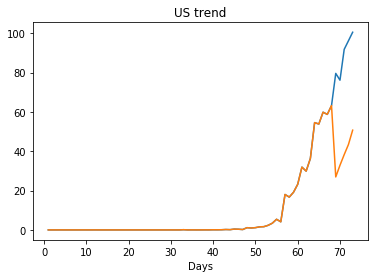

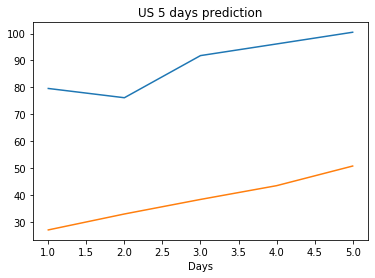

Creating directory ./offline8/Diamond Princess/training/
Diamond Princess
Saving the best model weights at Epoch [1], Best Valid Loss: 1639.1399
train error: 82733.48064769398
1639.139892578125
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
train error: 118822.28693181818
0.0
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
train error: 118822.28693181818
0.00037511586560867727
Saving the best model weights at Epoch [1], Best Valid Loss: 9212.7061
train error: 71304.05666675622
9212.7060546875
Saving the best model weights at Epoch [1], Best Vali

train error: 120608.19825883345
730.4752197265625
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
train error: 118822.28693181818
0.0
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
train error: 118822.28693181818
0.0
Saving the best model weights at Epoch [1], Best Valid Loss: 59.5605
train error: 96242.32780890031
59.56051254272461
Saving the best model weights at Epoch [1], Best Valid Loss: 68.5161
train error: 102967.61781961267
68.5161361694336
Saving the best model weights at Epoch [1], Best Valid Loss: 367.6965
train error: 76257.36670615456
367.6965026855469
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [6], Bes

train error: 85973.90368097479
15.380243301391602
Saving the best model weights at Epoch [1], Best Valid Loss: 393.1211
train error: 94041.33549689162
393.1210632324219
Saving the best model weights at Epoch [1], Best Valid Loss: 28.2907
train error: 27157.899826396595
28.29073143005371
Saving the best model weights at Epoch [1], Best Valid Loss: 97.9130
Saving the best model weights at Epoch [47], Best Valid Loss: 48.4853
Saving the best model weights at Epoch [48], Best Valid Loss: 8.2498
train error: 58600.52222928134
8.249839782714844
Saving the best model weights at Epoch [1], Best Valid Loss: 863.8232
train error: 100743.79068350146
863.8232421875
Saving the best model weights at Epoch [1], Best Valid Loss: 30.7861
train error: 26717.89474877444
30.78614616394043
Saving the best model weights at Epoch [1], Best Valid Loss: 29.3943
train error: 47537.866286508615
29.3942928314209
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
train error: 118822.28693181818
0.

train error: 105219.62320778587
0.4082582890987396
Saving the best model weights at Epoch [1], Best Valid Loss: 13.1306
train error: 98553.11675193092
13.130553245544434
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4624
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
train error: 88954.93754597139
0.0
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9427
train error: 64892.756591834805
0.9427068829536438
Saving the best model weights at Epoch [1], Best Valid Loss: 13.7996
train error: 34803.06238626689
13.79957103729248
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1400
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0010
train error: 74428.50552614829
0.0009935437701642513
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1367
train error: 59849.889715612524
1.1366922855377197
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3260
train error: 25461.371707742863
0.3260039091

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0218
Saving the best model weights at E

train error: 116530.2545859597
0.02780250646173954
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1493
train error: 89837.60939105804
0.14933310449123383
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0119
train error: 118490.70717560161
0.011888297274708748
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0287
train error: 112796.26103895361
0.028657054528594017
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0324
train error: 66767.84752607583
0.03238667920231819
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0148
train error: 118594.94711483609
0.01482089888304472
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
train error: 118822.28693181818
0.0
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3653
train error: 114629.28037331322
0.36530065536499023
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0018
train error: 118703.63584899902
0.0017804260132834315
Sav

train error: 118778.07829497755
0.012025137431919575
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0082
train error: 118796.97544235195
0.008209220133721828
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0037
train error: 118605.79195690155
0.003748388262465596
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0032
train error: 118795.45172833075
0.0031750656198710203
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0094
train error: 118708.96571772477
0.009420255199074745
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0104
train error: 118287.03297909824
0.01035234984010458
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0017
train error: 118808.52078709447
0.0017449865117669106
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0026
train error: 118758.51501386544
0.0026475104968994856
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0061
train error: 118380.1871580210

train error: 118797.73275049539
0.0029517028015106916
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0154
train error: 118806.6566279213
0.015393855050206184
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0168
train error: 118799.39576839063
0.016795629635453224
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0269
train error: 118787.38420731643
0.02686162106692791
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0006
train error: 118818.35386417322
0.0005838210927322507
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0066
train error: 118812.72936001983
0.006647885777056217
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
train error: 118822.28693181818
0.0
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0063
train error: 118810.22351632724
0.006322360131889582
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0051
train error: 118811.73028346723
0.005103410687297

/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:88: RuntimeWarning: invalid value encountered in double_scalars


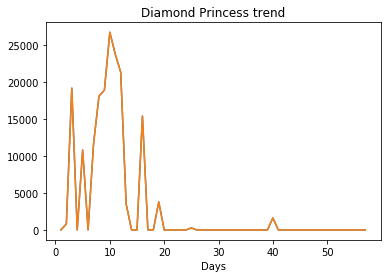

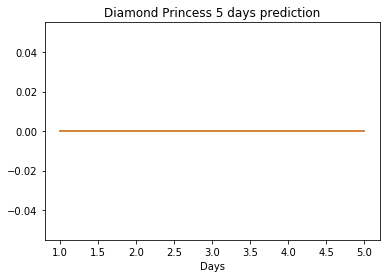

In [32]:
# optimization grid
lr_list = [0.1,0.01,0.001,1e-4,1e-5,1e-6]
hidden_lst = [1,2,3,4,5]
hState_lst = [10,30,50,100]
momentumS = [0.1,0.5,0.9]
tloss = []
ntloss = []

country_result = dict()
#optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
best_error = 1e10
country_file_path = ("./country_file8.txt")
for i in range(len(countries)):
    if i in skip_countries:
        continue # too little data 
        
    country_result[countries[i]] = [] # store best validation parameter, test loss, test result
    best_error = 1e10
    
    best_param = [0,0,0]

    learning_rate = lr_list[0] # to be changed/optimized 
    hidden_dim = hidden_lst[0]
    hidden_state = hState_lst[0]
    
    
    model_name = countries[i]
    output_file_path = "./offline8/" + model_name + "/training/"
    directory = os.path.dirname(output_file_path)
    if not os.path.exists(directory):
        print("Creating directory %s" % output_file_path)
        os.makedirs(directory)
    else:
         print("Directory %s exists" % output_file_path)

    print(countries[i])
    train_dataset = torch.utils.data.TensorDataset(torch.tensor(country_train_X[i]).unsqueeze_(2).unsqueeze_(2).float(), torch.tensor(country_train_Y[i]).unsqueeze_(1).float())
    train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)

    # load validation
    valid_dataset = torch.utils.data.TensorDataset(torch.tensor(country_valid_X[i]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_valid_Y[i]).unsqueeze_(0).float())
    valid_loader = torch.utils.data.DataLoader(dataset=valid_dataset, batch_size=batch_size, shuffle=False)

    # load test
    test_dataset = torch.utils.data.TensorDataset(torch.tensor(country_test_X[i]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_test_Y[i]).unsqueeze_(0).float())
    test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)
    
    bestmodel = 0
    country_file = open(country_file_path,"a")
    # optimize (learning rate, hidden layer, hidden state, activation)
    for j in range(len(lr_list)):
        for k in range(len(hidden_lst)): # hidden layer
            for m in range(len(hState_lst)): # hidden state
                for s in range(len(momentumS)):
                # train
                # specific parameters
                    learning_rate = lr_list[j]
                    hidden_dim = hState_lst[m]
                    num_layers = hidden_lst[k]
                    momentum = momentumS[s]
                    #lstm_input_size = len()

                    net =  LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)
                    #print(net)
                    model = net.to(device)

                    #
                    optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=momentum)
                    # to be changed/optimized 

                    model, err = train_model(train_loader, valid_loader, model, device, criterion,  optimizer, num_epochs, output_file_path,learning_rate,hidden_dim,num_layers,momentum)
                    print(err)
                    if err < best_error:
                        best_error = err
                        best_param = [lr_list[j],hidden_lst[k],hState_lst[m],momentum]
                        bestmodel = model
    
    country_result[countries[i]].append(best_param)
    
    # test data
    pred,final_loss = test_model(test_loader,bestmodel,device,criterion)
    print("test loss: ",final_loss)
    country_result[countries[i]].append([pred.tolist(),country_test_Y[i].tolist()])
    country_result[countries[i]].append(final_loss)
    torch.save(bestmodel.state_dict(), output_file_path+countries[i]+".th")
    
    tloss.append(final_loss)
    ntloss.append(final_loss/max(country_test_Y[i]))
    
    print("%s, %s, %s, %s" % (countries[i], pred.tolist(), final_loss,best_param), file=country_file)
                   
    country_file.close()
    graph_country(i,pred.tolist(),graph_dir)

In [33]:
import json
with open("country_summary_8.js",'w+') as outfile:
    json.dump(country_result, outfile , sort_keys = True , indent = 4, separators = (",",": "))


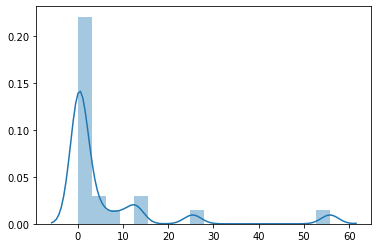

In [34]:
#country_test_Y[0]
sns.distplot(np.array(ntloss)); # normalized loss

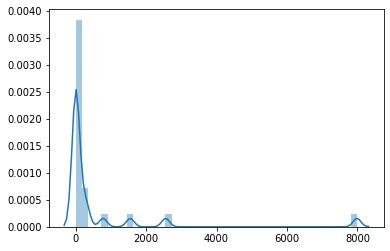

In [35]:
sns.distplot(np.array(tloss)); # not normalized loss